In [1]:
import copy
import numpy as np
from numalogic.connectors._config import Pivot
from pydruid.utils.aggregators import doublesum
import matplotlib.pyplot as plt
from numalogic.connectors import DruidFetcher
import logging
import os
import unittest
import time
from datetime import datetime, timedelta
from unittest.mock import patch, Mock
import pandas as pd
from fakeredis import FakeStrictRedis, FakeServer
from freezegun import freeze_time
from omegaconf import OmegaConf
from orjson import orjson
from pynumaflow.mapper import Datum
from redis import RedisError
from numalogic._constants import TESTS_DIR
from numalogic.config import NumalogicConf, ModelInfo
from numalogic.config import TrainerConf, LightningTrainerConf
from numalogic.connectors import RedisConf, DruidConf, DruidFetcherConf, PrometheusFetcher
from numalogic.connectors.druid import DruidFetcher
from numalogic.tools.exceptions import (
    ConfigNotFoundError,
    DruidFetcherError,
    PrometheusFetcherError,
)
from numalogic.udfs import StreamConf, PipelineConf, MLPipelineConf
from numalogic.udfs.tools import TrainMsgDeduplicator
from numalogic.udfs.trainer import DruidTrainerUDF, PromTrainerUDF
from numalogic.udfs import StreamConf, InferenceUDF, MLPipelineConf
import matplotlib.pyplot as plt
from tqdm import tqdm
logging.basicConfig(level=logging.DEBUG)
%load_ext autoreload

10 hour comparison

osam_path_2_hrs = '/Users/ssrigiri1/Desktop/temp/10 hour/numalogic-osam-fci-druid-publisher/numalogic_osam_fci_druid_publisher_10.csv'
numa_path_2_hrs = '/Users/ssrigiri1/Desktop/temp/10 hour/odl-osam-sw1-fci-output/odl-osam-sw1-fci-output_10.csv'

In [2]:
fetcher = DruidFetcher("https://obelix.odldruid-prd.a.intuit.com/", "druid/v2")
conf_1 = OmegaConf.load(os.path.join(TESTS_DIR, "udfs", "resources", "_config.yaml"))
schema = OmegaConf.structured(PipelineConf)
conf_1 = OmegaConf.merge(schema, conf_1)
pl_conf = PipelineConf(**OmegaConf.merge(schema, conf_1))
input_features = ["failed", "degraded"]

anomaly_time_periods_osam = {}
anomaly_time_periods_numalogic = {}




In [3]:
import matplotlib.dates as mdates
import matplotlib.ticker as ticker

def get_dfs(osam_path, numa_path):
    df_osam = pd.read_csv(osam_path)
    df_numalogic = pd.read_csv(numa_path)

    # Sort the df according to __time column
    df_osam = df_osam.sort_values(by=['__time'])
    df_numalogic = df_numalogic.sort_values(by=['__time'])

    df_osam = df_osam[df_osam['__time']!='__time']
    df_numalogic = df_numalogic[df_numalogic['__time']!='__time']

    print("df_osam.shape: ", df_osam.shape, "df_numalogic.shape: ", df_numalogic.shape)

    return df_osam, df_numalogic

def store_copies(df_osam, df_numalogic):
    return copy.deepcopy(df_osam), copy.deepcopy(df_numalogic)

def get_model_id_stats_comparison(df_osam, df_numalogic):
    result_dict = {}
    unique_model_ids_osam = df_osam.modelId.unique()
    unique_model_ids_numalogic = df_numalogic.modelId.unique()

    common_model_ids = np.intersect1d(unique_model_ids_osam, unique_model_ids_numalogic)

    print("------------")
    print("Number of unique model_ids in OSAM: ", unique_model_ids_osam.shape)
    print("Number of unique model_ids in Numalogic: ", unique_model_ids_numalogic.shape)
    print("Number of Intersecting model_ids: ",common_model_ids.shape)
    print("Number of Non-Intersecting model_ids: ",np.setxor1d(unique_model_ids_osam, unique_model_ids_numalogic).shape)

    print("")

    anomaly_points_osam = df_osam[df_osam['anomaly'].astype(float)>anomaly_threshold]
    anomaly_points_numalogic = df_numalogic[df_numalogic['anomaly'].astype(float)>anomaly_threshold]

    print("Number of anomaly points in OSAM: ", anomaly_points_osam.shape)
    print("Number of anomaly points in Numalogic: ", anomaly_points_numalogic.shape)

    unique_anomaly_modelIds_osam = anomaly_points_osam['modelId'].unique().tolist()
    unique_anomaly_modelIds_numalogic = anomaly_points_numalogic['modelId'].unique().tolist()

    print("Number of UNIQUE anomaly points in OSAM: ", len(unique_anomaly_modelIds_osam))
    print("Number of UNIQUE anomaly points in Numalogic: ", len(unique_anomaly_modelIds_numalogic))

    combined_unique_anomaly_modelIds = list(set(unique_anomaly_modelIds_osam) | set(unique_anomaly_modelIds_numalogic))


    result_dict["unique_model_ids_osam"] = unique_model_ids_osam
    result_dict["unique_model_ids_numalogic"] = unique_model_ids_numalogic
    result_dict["common_model_ids"] = np.intersect1d(unique_model_ids_osam, unique_model_ids_numalogic)
    result_dict["non_intersecting_unique_model_ids"] = np.setxor1d(unique_model_ids_osam, unique_model_ids_numalogic)

    result_dict["unique_anomaly_modelIds_osam"] = unique_anomaly_modelIds_osam
    result_dict["unique_anomaly_modelIds_numalogic"] = unique_anomaly_modelIds_numalogic
    result_dict["combined_unique_anomaly_modelIds"] = combined_unique_anomaly_modelIds

    print("Total combined UNIQUE model_ids to investigate: ", len(combined_unique_anomaly_modelIds))
    print("------------")

    return result_dict

def print_non_intersecting_model_ids(df_osam, df_numalogic):
    print(np.setxor1d(df_osam, df_numalogic))

def get_dfs_for_a_key(df_osam, df_numalogic, key):
    df_osam_key = df_osam[df_osam['modelId'] == key]
    df_numalogic_key = df_numalogic[df_numalogic['modelId'] == key]
    return df_osam_key, df_numalogic_key

def plot_scores(df_osam, df_numalogic, override=False):
    if (plot_graphs==False) and (override==False):
        return

    fig, ax = plt.subplots(figsize=(15,10))

    lapse = 100
    if override:
        lapse = 1000

    # Convert timestamps to datetime and plot
    ax.plot(pd.to_datetime(df_osam['__time'].astype(int), unit='ms'), df_osam['anomaly'].astype(float), label='osam', color='red')
    ax.plot(pd.to_datetime(df_numalogic['__time'].astype(int), unit='ms'), df_numalogic['anomaly'].astype(float), label='numalogic', color='blue')

    # Set x-axis major ticks every 10 minutes
    ax.xaxis.set_major_locator(mdates.MinuteLocator(interval=lapse))
    ax.xaxis.set_major_formatter(mdates.DateFormatter('%D::%H::%M::00'))

    # Rotate x-axis labels for better visibility
    plt.xticks(rotation=45)

    ax.legend()
    ax.set_title('Line plot of anomaly vs time')
    ax.set_xlabel('time')
    ax.set_ylabel('anomaly')

    plt.show()


def get_anomaly_periods_for_a_key(df_osam, df_numalogic):
    # osam_anomaly_list = df_osam['anomaly'].tolist()
    # numa_anomaly_list = df_numalogic['anomaly'].tolist()
    time_periods_list_osam = []
    time_periods_list_numalogic = []
    num_of_time_periods_osam = 0
    num_of_time_periods_numalogic = 0
    start_tp_time = 0
    end_tp_time = 0
    temp_tp = 0
    cnt = 0

    for idx, row in df_osam.iterrows():
        anom_score = float(row['anomaly'])
        temp_tp = row['__time']
        if anom_score >= anomaly_threshold:
            cnt += 1
            if start_tp_time == 0:
                start_tp_time = temp_tp
        else:
            if cnt >= allowed_continuity:
                num_of_time_periods_osam += 1
                end_tp_time = temp_tp
                time_periods_list_osam.append((start_tp_time, end_tp_time))
            cnt = 0
            start_tp_time = 0
            end_tp_time = 0

    if cnt >= allowed_continuity:
        num_of_time_periods_osam += 1
        end_tp_time = temp_tp
        time_periods_list_osam.append((start_tp_time, end_tp_time))

    cnt = 0
    start_tp_time = 0
    end_tp_time = 0

    for idx, row in df_numalogic.iterrows():
        anom_score = float(row['anomaly'])
        temp_tp = row['__time']
        if anom_score >= anomaly_threshold:
            cnt += 1
            if start_tp_time == 0:
                start_tp_time = temp_tp
        else:
            if cnt >= allowed_continuity:
                num_of_time_periods_numalogic += 1
                end_tp_time = temp_tp
                time_periods_list_numalogic.append((start_tp_time, end_tp_time))
            cnt = 0
            start_tp_time = 0
            end_tp_time = 0

    if cnt >= allowed_continuity:
        num_of_time_periods_numalogic += 1
        end_tp_time = temp_tp
        time_periods_list_osam.append((start_tp_time, end_tp_time))
    cnt = 0
    start_tp_time = 0
    end_tp_time = 0

    return time_periods_list_osam, time_periods_list_numalogic

def analyze(tmp_global_df_osam, tmp_global_df_numalogic):
    total_num_tp_osam, total_num_tp_numa = 0, 0

    result_dict = get_model_id_stats_comparison(tmp_global_df_osam, tmp_global_df_numalogic)

    for k in tqdm(result_dict["combined_unique_anomaly_modelIds"]):
        df_osam, df_numalogic = get_dfs_for_a_key(tmp_global_df_osam, tmp_global_df_numalogic, k)
        tmp_tp_osam, tmp_tp_numa = get_anomaly_periods_for_a_key(df_osam, df_numalogic)

        if len(tmp_tp_osam)>0:
            anomaly_time_periods_osam[k] = tmp_tp_osam

        if len(tmp_tp_numa)>0:
            anomaly_time_periods_numalogic[k] = tmp_tp_numa



        total_num_tp_osam += len(tmp_tp_osam)
        total_num_tp_numa += len(tmp_tp_numa)
        if len(tmp_tp_osam) + len(tmp_tp_numa) > 0:
            anomalies_list.append(k)
            plot_scores(df_osam, df_numalogic)
            print('key: ', k)
            print("Anomaly tp for this graph from OSAM: ", len(tmp_tp_osam))
            print("Anomaly tp for this graph from Numa: ", len(tmp_tp_numa))
        else:
            no_anomalies_list.append(k)

    print("Total Number of anomaly tp for OSAM: ", total_num_tp_osam)
    print("Total Number of anomaly tp for Numalogic: ", total_num_tp_numa)

    result_dict["anomalies_list"] = anomalies_list
    result_dict["no_anomalies_list"] = no_anomalies_list
    return result_dict

def quality_analysis(summary, plot):
    for key in summary["anomalies_list"]:
        print("------------------------------------------------------------        ModelId: "+ key+ "       ---------------------------------------------")
        verify_obj = QualityVerifier(key)
        verify_obj.get_data_for_serviceAlias()
        if verify_obj.df_numalogic_output.shape[0] > 0:
            if plot:
                verify_obj.plot_df()
                verify_obj.plot_anomaly_scores()
                verify_obj.plot_scores_separately()
            verify_obj_dict[key] = verify_obj
            print("------------------------------------------------------------")


def merge_intervals(intervals):
    # Converting time from milliseconds to datetime format and sorting the intervals
    intervals = sorted((datetime.fromtimestamp(int(start)//1000), datetime.fromtimestamp(int(end)//1000)) for start, end in intervals)

    result = []

    current_start, current_end = intervals[0]

    for start, end in intervals[1:]:
        if current_end >= start - timedelta(minutes=2):
            current_end = max(current_end, end)
        else:
            result.append((current_start, current_end))
            current_start, current_end = start, end

    # Adding the last interval
    result.append((current_start, current_end))
    result = [(int(start.timestamp()*1000), int(end.timestamp()*1000)) for start, end in result]
    return result

def is_overlapping(interval1, interval2):
    start1, end1 = interval1
    start2, end2 = interval2

    start1 = int(start1)
    start2 = int(start2)
    end1 = int(end1)
    end2 = int(end2)

    # Two intervals overlap if start of interval1 is less than end of interval2
    # and start of interval2 is less than end of interval1.
    return start1 < end2 and start2 < end1

In [5]:
from numalogic.connectors.druid._druid import TIMEOUT
from pydruid.utils.dimensions import DimensionSpec
from pydruid.utils.filters import Filter
import numalogic
from numalogic.connectors import DruidFetcher
from numalogic.udfs.tools import _LOGGER
import pytz
from numalogic.connectors.druid import make_filter_pairs, build_params
from typing import Optional

class DruidChunkFetcher(DruidFetcher):

    def build_params(
        self,
        datasource: str,
        dimensions: list[str],
        filter_pairs: dict,
        granularity: str,
        hours: float,
        delay: float,
        reference_dt: Optional[datetime] = None,
    ) -> dict:

        _filter = Filter(
            type="and",
            fields=[Filter(type="selector", dimension=k, value=v) for k, v in filter_pairs.items()],
        )
        reference_dt = reference_dt or datetime.now(pytz.utc)
        end_dt = reference_dt - timedelta(hours=delay)
        _LOGGER.debug("Querying with end_dt: %s, that is with delay of %s hrs", end_dt, delay)

        start_dt = end_dt - timedelta(hours=hours)

        intervals = [f"{start_dt.isoformat()}/{end_dt.isoformat()}"]
        dimension_specs = map(lambda d: DimensionSpec(dimension=d, output_name=d), dimensions)

        return {
            "datasource": datasource,
            "granularity": granularity,
            "intervals": intervals,
            "filter": _filter,
            "columns": dimensions,
            "context": {"timeout": TIMEOUT, "configIds": list(filter_pairs), "source": "numalogic"},
        }


    def get_datasource_params_dict(
        self,
        datasources: Optional[list[str]],
        filter_keys: Optional[list[str]],
        filter_values: Optional[list[str]],
        dimensions: Optional[list[str]],
        delay: float = 3.0,
        granularity: str = "minute",
        aggregations: Optional[dict] = None,
        post_aggregations: Optional[dict] = None,
        group_by: Optional[list[str]] = None,
        pivot: Optional[Pivot] = None,
        hours: float = 12.0,
        chunked_hours: float = 0.05,
        time_machine_delta: float = 0,
    ):


        self.group_by = group_by
        self.pivot = pivot
        _start_time = time.perf_counter()
        filter_pairs = make_filter_pairs(filter_keys, filter_values)
        self.filter_pairs = filter_pairs

        hours_elapsed = 0
        chunked_dfs = []
        qparams = []
        curr_time = datetime.now(pytz.utc) - timedelta(hours=time_machine_delta)
        datasource_params_dict = {}

#         initializing datasource_params_dict. It is key, value pair of datasource and a list to store all params
        for datasource in datasources:
            datasource_params_dict[datasource] = []

        while hours_elapsed < hours:
            ref_dt = curr_time - timedelta(hours=hours_elapsed)
            for datasource in datasources:
                params = self.build_params(
                            datasource=datasource,
                            dimensions=dimensions,
                            filter_pairs=filter_pairs,
                            granularity=granularity,
                            hours=min(chunked_hours, hours - hours_elapsed),
                            delay=delay,
                            reference_dt=ref_dt,
                        )
                datasource_params_dict[datasource].append(params)
            hours_elapsed += chunked_hours

        self.datasource_params_dict = datasource_params_dict

        return self.datasource_params_dict

    def _fetch(self, **query_params) -> pd.DataFrame:
        try:
            start_time = time.time()
            response = self.client.scan(**query_params)
            print("--- %s seconds ---" % (time.time() - start_time))
        except Exception as err:
            raise DruidFetcherError("Druid Exception:\n") from err
        return response.export_pandas()

    def fetch_chunked_data(self, query_params):
        df = self._fetch(**query_params)
        if df.empty or df.shape[0] == 0:
            logging.warning("No data found for keys %s", self.filter_pairs)
            return pd.DataFrame()

        if self.group_by:
            df = df.groupby(by=self.group_by).sum().reset_index()

        pivot = self.pivot
        if pivot and pivot.columns:
            df = df.pivot(
                index=pivot.index,
                columns=pivot.columns,
                values=pivot.value,
            )
            df.columns = df.columns.map("{0[1]}".format)
            df.reset_index(inplace=True)

        return df

    def fetch_druid_data(self):
        for key in self.datasource_params_dict:
            params = self.datasource_params_dict[key]
            for param in params:
                try:
                    df = self.fetch_chunked_data(param)
                    str_intervals = '-'.join(str(x) for x in param["intervals"])
                    str_intervals = str_intervals.replace('.','-')
                    str_intervals = str_intervals.replace(':','-')
                    str_intervals = str_intervals.replace('+','-')
                    str_intervals = str_intervals.replace('/','<-->')
                    df.to_csv(key+"/"+str_intervals+".csv")
                    print("Saved file: ", key+"/"+str_intervals)
                except Exception:
                    print(Exception)
                    df = self.fetch_chunked_data(param)
                    str_intervals = '-'.join(str(x) for x in param["intervals"])
                    str_intervals = str_intervals.replace('.','-')
                    str_intervals = str_intervals.replace(':','-')
                    str_intervals = str_intervals.replace('+','-')
                    str_intervals = str_intervals.replace('/','<-->')
                    df.to_csv(key+"/"+str_intervals+".csv")
                    print("Saved file: ", key+"/"+str_intervals)
                # df.to_csv("x.csv")
                time.sleep(2)

class QualityVerifier(DruidChunkFetcher):

    def __init__(self, serviceAlias):
        temp_keys = serviceAlias.split(':')
        self.modelId = serviceAlias
        self.configID = temp_keys[0]
        self.dynamic_keys = temp_keys[2:]
        self.static_keys = pl_conf.stream_confs[self.configID]['composite_keys']

    def get_data_for_serviceAlias(self):

        # This will only work for FCI
        delay = 3
        fetcher_conf = pl_conf.druid_conf['fetcher']
        df = fetcher.fetch(
            datasource=fetcher_conf['datasource'],
            dimensions=fetcher_conf['dimensions'],
            filter_keys=self.static_keys,
            filter_values=self.dynamic_keys,
            aggregations={"count": doublesum("count")},
            pivot=Pivot(index="timestamp",columns=["ciStatus"], value=["count"], ),
            hours=240,
            delay=delay
        )
        time.sleep(2)

        ref_dt = datetime.now(pytz.utc) - timedelta(hours=delay)
        osam_output_params = self.build_params(
            datasource="odl-osam-sw1-fci-output",
            dimensions=["__time","anomaly", "modelId","configId", "uuid"],
            filter_pairs=make_filter_pairs(["env", "modelId"], ["prd", self.modelId]),
            granularity="minute",
            hours=240,
            delay=delay,
            reference_dt=ref_dt
        )
        numalogic_output_params = self.build_params(
            datasource="numalogic-osam-fci-druid-publisher",
            dimensions=["__time","anomaly", "modelId","configId", "uuid"],
            filter_pairs=make_filter_pairs(["env", "modelId"], ["prd", self.modelId]),
            granularity="minute",
            hours=240,
            delay=delay,
            reference_dt=ref_dt
        )


        df["timestamp"] = pd.to_datetime(df['timestamp']/1000,unit='s')
        for col in ["failed", "degraded"]:
            if col not in df.columns:
                df[col]=0.0

        self.df_training = df
        self.osam_output_params = osam_output_params
        self.numalogic_output_params = numalogic_output_params
        self.df_osam_output = self.fetch_scan_query(**self.osam_output_params)
        time.sleep(2)
        self.df_numalogic_output = self.fetch_scan_query(**self.numalogic_output_params)

    def fetch_scan_query(self, **query_params) -> pd.DataFrame:
        try:
            start_time = time.time()
            response = fetcher.client.scan(**query_params)
            print("--- %s seconds ---" % (time.time() - start_time))
        except Exception as err:
            raise DruidFetcherError("Druid Exception:\n") from err
        df = response.export_pandas()
        if df.shape[0]>2:
            df = df.sort_values(by=['__time'])
        return df



    def plot_df(self):
        for input_feature in input_features:
            fig, ax = plt.subplots(figsize=(15,10))

            ax.plot(self.df_training['timestamp'],self.df_training[input_feature].astype(float), label=input_feature, color='yellow')
            ax.xaxis.set_major_locator(mdates.MinuteLocator(interval=1000))
            ax.xaxis.set_major_formatter(mdates.DateFormatter('%Y-%m-%d %H:%M'))
            plt.gcf().autofmt_xdate()
            plt.xticks(rotation=45)
            plt.legend()
            plt.title('Training data for ' + input_feature)
            plt.xlabel('time')
            plt.ylabel(input_feature+'_count')
            plt.show()
            print("self.df_training shape ", self.df_training.shape[0])

            plt.figure(figsize=(15,10))
            counts, bins, bars = plt.hist(self.df_training[input_feature].astype(float), bins=128, edgecolor='black') # adjust the number of bins according to your data
            print("Sum of histogram frequencies: ", np.sum(counts))
            print("Number of non-NaN records in column x: ", self.df_training[input_feature].dropna().shape[0])
            plt.title('Histogram of '+input_feature)
            plt.xlabel('value')
            plt.ylabel('Frequency')

            plt.show()

    def plot_anomaly_scores(self):
        plot_scores(self.df_osam_output, self.df_numalogic_output, True)
        return

    def plot_scores_separately(self):
        fig, ax = plt.subplots(figsize=(15,10))

        ax.plot(pd.to_datetime(self.df_numalogic_output['__time'].astype(int), unit='ms'), self.df_numalogic_output['anomaly'])
        ax.title.set_text('numalogic anomaly scores')
        ax.xaxis.set_major_locator(mdates.MinuteLocator(interval=1000))
        ax.xaxis.set_major_formatter(mdates.DateFormatter('%Y-%m-%d %H:%M'))
        ax.set_xlabel('time')
        ax.set_ylabel('anomaly')
        ax.set_ylim([0,10])
        plt.gcf().autofmt_xdate()

        plt.show()


        fig, ax = plt.subplots(figsize=(15,10))

        ax.plot(pd.to_datetime(self.df_osam_output['__time'].astype(int), unit='ms'), self.df_osam_output['anomaly'])
        ax.title.set_text('osam anomaly scores')
        ax.xaxis.set_major_locator(mdates.MinuteLocator(interval=1000))
        ax.xaxis.set_major_formatter(mdates.DateFormatter('%Y-%m-%d %H:%M'))
        ax.set_xlabel('time')
        ax.set_ylabel('anomaly')
        ax.set_ylim([0,10])
        plt.gcf().autofmt_xdate()

        plt.show()




In [6]:
store_df_osam = pd.DataFrame({})
store_df_numalogic = pd.DataFrame({})

global_df_osam, global_df_numalogic = get_dfs(
    '/Users/ssrigiri1/Desktop/temp/10 hour/odl-osam-sw1-fci-output/odl-osam-sw1-fci-output_10.csv',
    '/Users/ssrigiri1/Desktop/temp/10 hour/numalogic-osam-fci-druid-publisher/numalogic_osam_fci_druid_publisher_10.csv'
)

store_df_osam, store_df_numalogic = store_copies(global_df_osam, global_df_numalogic)

df_osam.shape:  (19584442, 6) df_numalogic.shape:  (18718101, 6)


------------
Number of unique model_ids in OSAM:  (50341,)
Number of unique model_ids in Numalogic:  (48338,)
Number of Intersecting model_ids:  (48278,)
Number of Non-Intersecting model_ids:  (2123,)

Number of anomaly points in OSAM:  (901, 6)
Number of anomaly points in Numalogic:  (2299, 6)
Number of UNIQUE anomaly points in OSAM:  73
Number of UNIQUE anomaly points in Numalogic:  220
Total combined UNIQUE model_ids to investigate:  248
------------


  0%|          | 0/248 [00:00<?, ?it/s]DEBUG:matplotlib.pyplot:Loaded backend module://matplotlib_inline.backend_inline version unknown.
DEBUG:matplotlib.pyplot:Loaded backend module://matplotlib_inline.backend_inline version unknown.
DEBUG:matplotlib.font_manager:findfont: Matching sans\-serif:style=normal:variant=normal:weight=normal:stretch=normal:size=10.0.
DEBUG:matplotlib.font_manager:findfont: score(FontEntry(fname='/Users/ssrigiri1/Library/Caches/pypoetry/virtualenvs/numalogic-I2QKDQ5F-py3.10/lib/python3.10/site-packages/matplotlib/mpl-data/fonts/ttf/DejaVuSansMono.ttf', name='DejaVu Sans Mono', style='normal', variant='normal', weight=400, stretch='normal', size='scalable')) = 10.05
DEBUG:matplotlib.font_manager:findfont: score(FontEntry(fname='/Users/ssrigiri1/Library/Caches/pypoetry/virtualenvs/numalogic-I2QKDQ5F-py3.10/lib/python3.10/site-packages/matplotlib/mpl-data/fonts/ttf/STIXGeneralItalic.ttf', name='STIXGeneral', style='italic', variant='normal', weight=400, stretch=

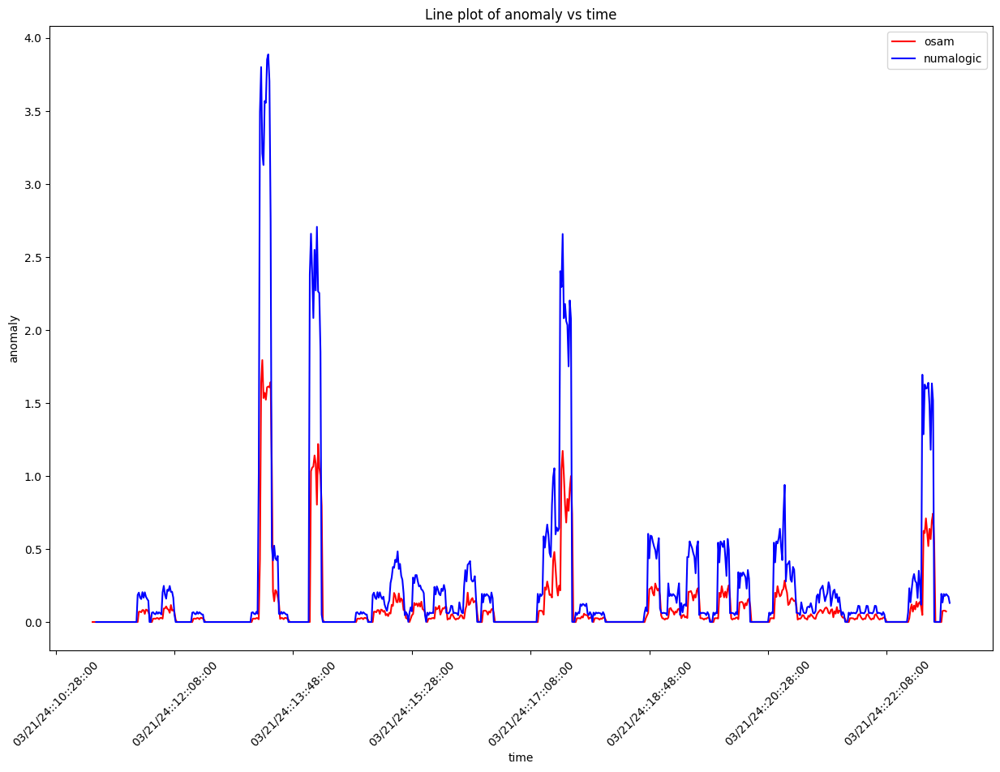

  0%|          | 1/248 [00:03<16:13,  3.94s/it]

key:  fciPlugin:requestsFailed:5984175597303660107:collab-vep-ui
Anomaly tp for this graph from OSAM:  0
Anomaly tp for this graph from Numa:  1


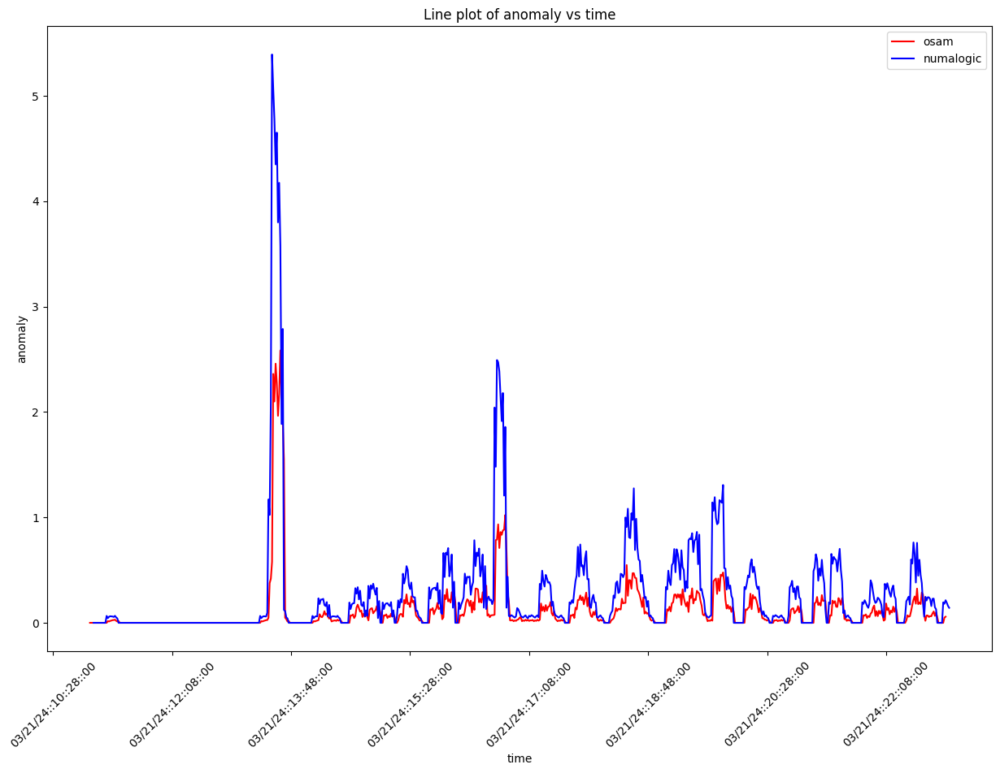

  1%|          | 2/248 [00:06<13:46,  3.36s/it]

key:  fciPluginAppInteractions:metrics:3678332588046106875:5984175597303660107:qbaa.fai.bankconnections-ui.ProcessOfxFileCall
Anomaly tp for this graph from OSAM:  0
Anomaly tp for this graph from Numa:  1


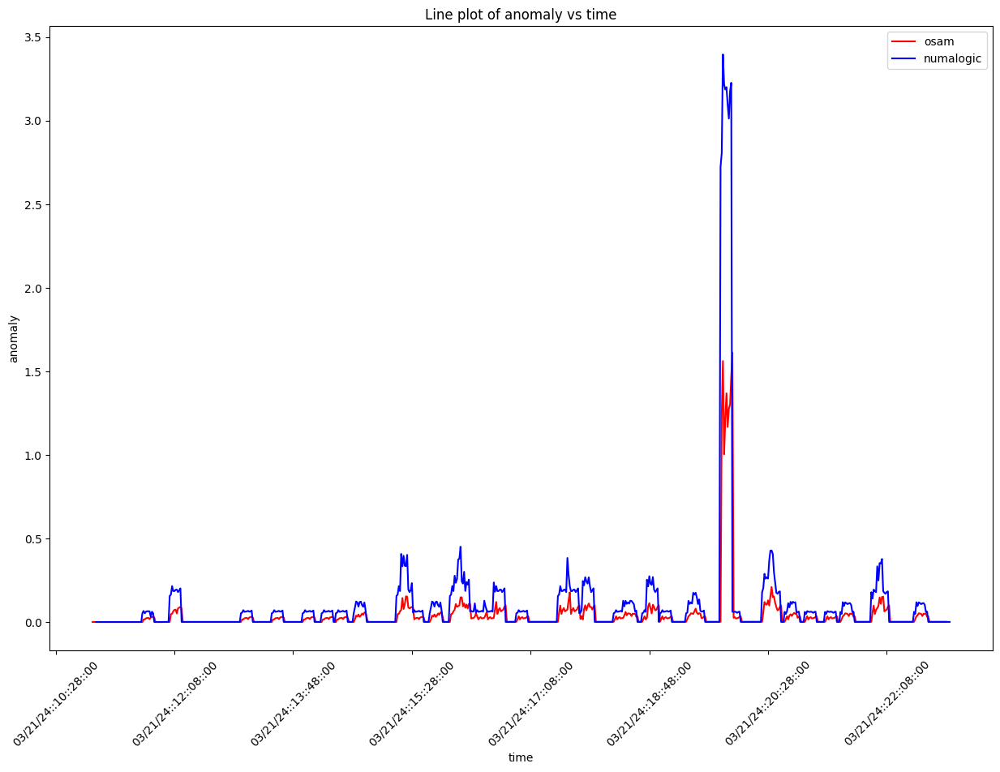

  1%|          | 3/248 [00:09<12:41,  3.11s/it]

key:  fci:interactionsFailed:4831254092648450521:personalinfo-taxpayer-entry-views-0.personalinfo.Next
Anomaly tp for this graph from OSAM:  0
Anomaly tp for this graph from Numa:  1


  2%|▏         | 5/248 [00:14<11:04,  2.74s/it]

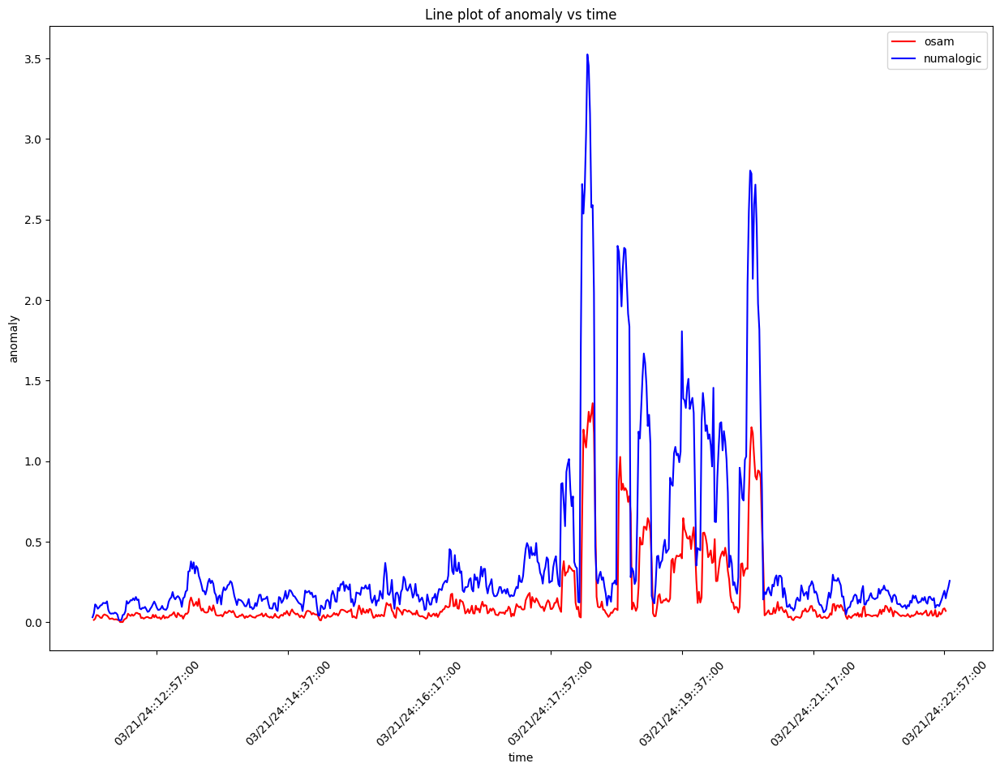

  2%|▏         | 6/248 [00:17<11:07,  2.76s/it]

key:  fciPlugin:requestsFailed:4831254092648450521:vep-collab-smlk-ui
Anomaly tp for this graph from OSAM:  0
Anomaly tp for this graph from Numa:  1


  3%|▎         | 7/248 [00:19<10:40,  2.66s/it]

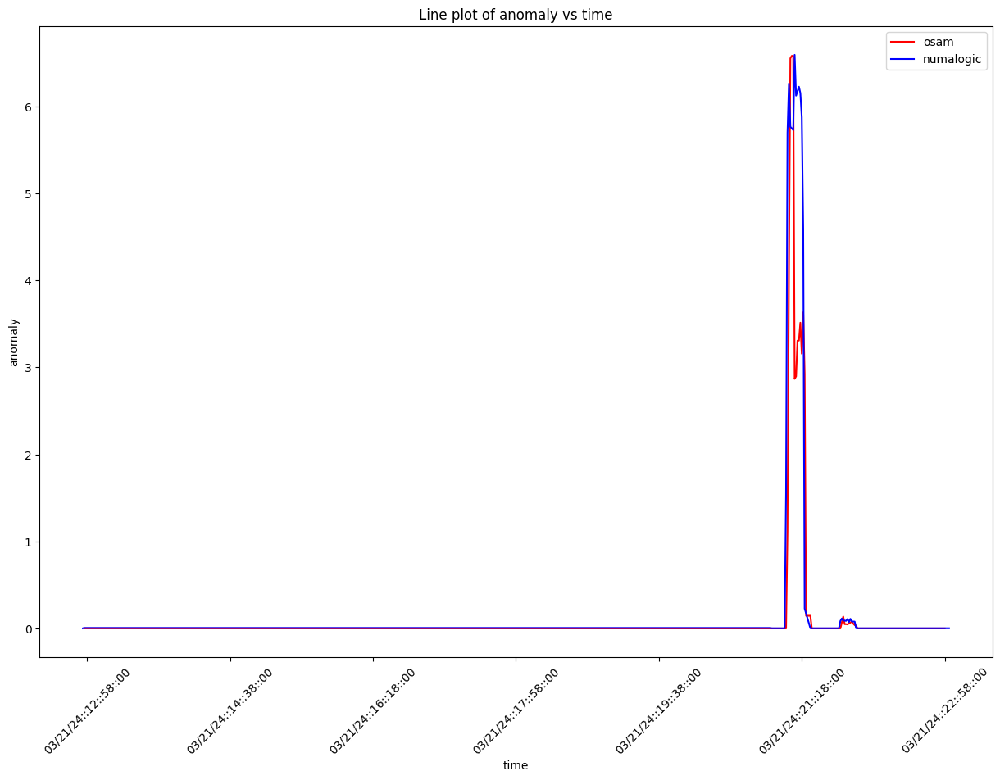

  3%|▎         | 8/248 [00:22<10:47,  2.70s/it]

key:  fciPluginAppInteractions:metrics:5551830033781551331:6344463568198587497:itsdeductible__personal_info_loaded
Anomaly tp for this graph from OSAM:  2
Anomaly tp for this graph from Numa:  1


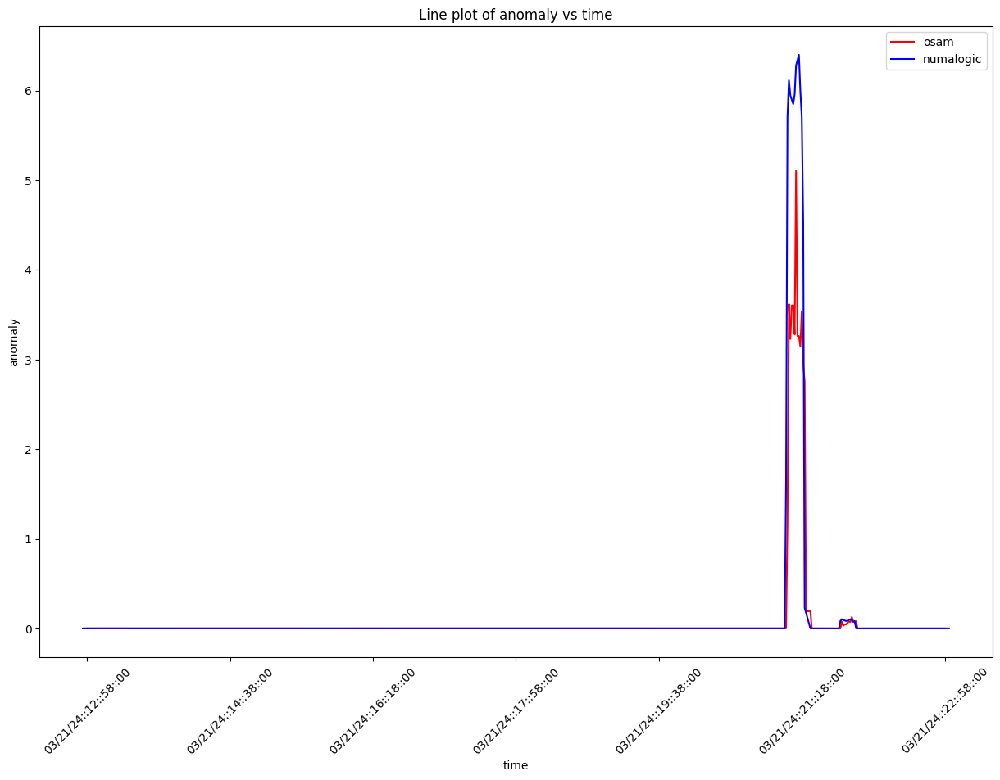

  4%|▎         | 9/248 [00:25<10:49,  2.72s/it]

key:  fci:interactionsFailed:6344463568198587497:itsdeductible__personal_info_loaded
Anomaly tp for this graph from OSAM:  1
Anomaly tp for this graph from Numa:  1


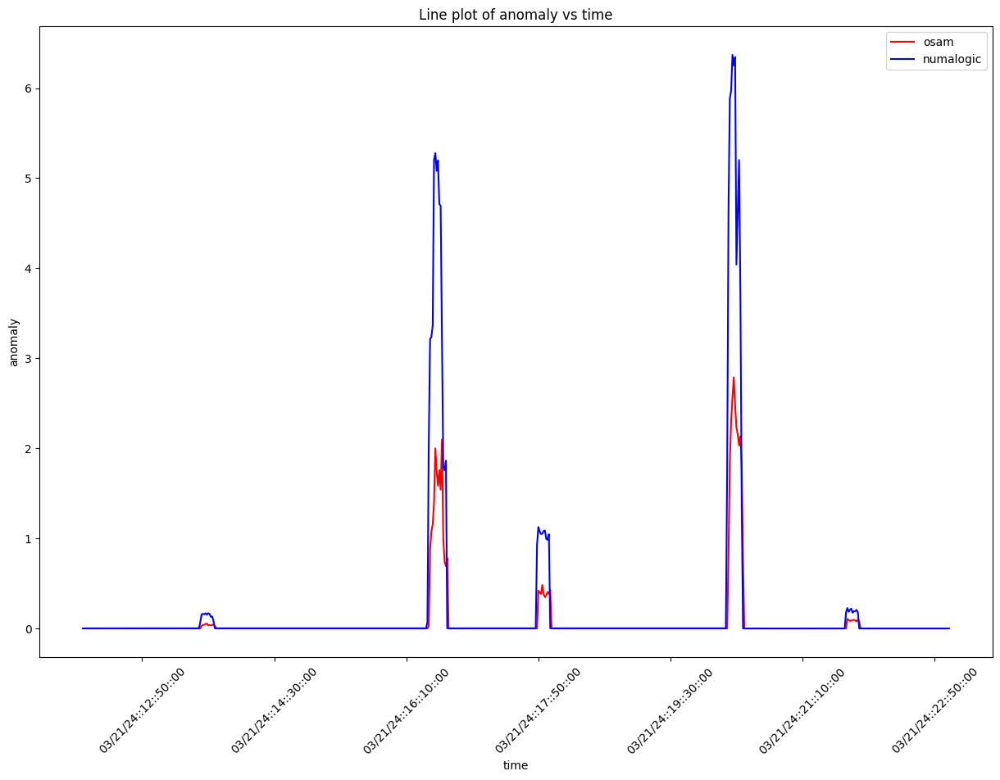

  4%|▍         | 10/248 [00:28<10:55,  2.75s/it]

key:  fciPluginInteractions:metrics:2525411083745874319:get-smart-compose-prediction
Anomaly tp for this graph from OSAM:  0
Anomaly tp for this graph from Numa:  2


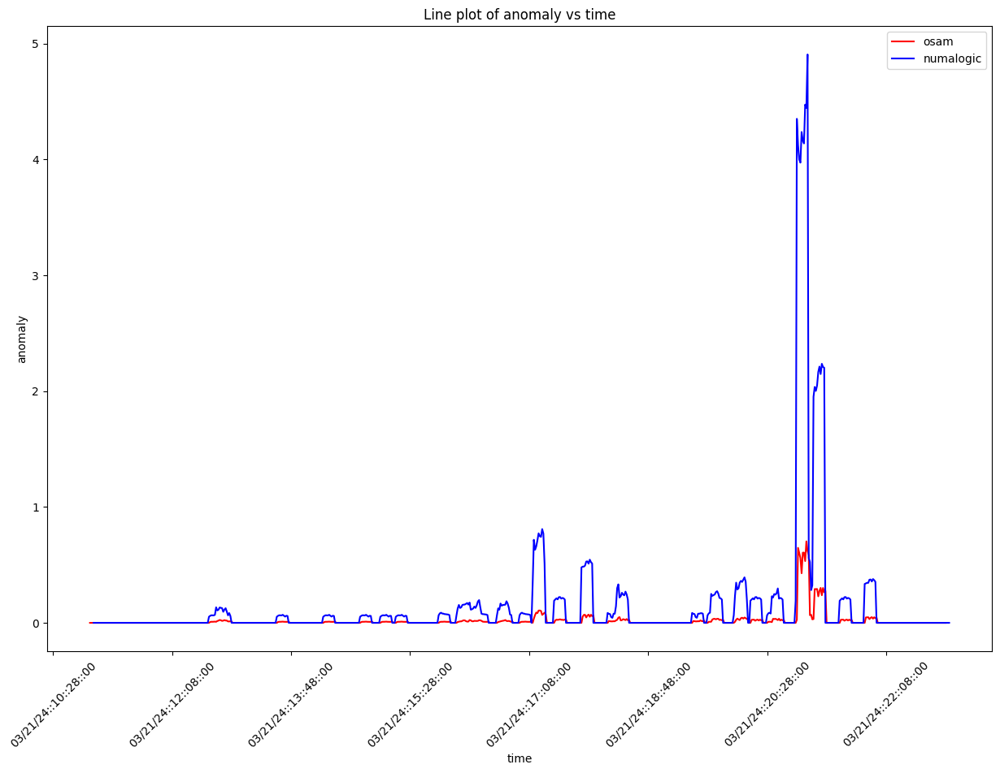

  4%|▍         | 11/248 [00:31<11:01,  2.79s/it]

key:  fci:interactionsFailed:5984175597303660107:qbaa.fai.reconcile-ui.getReconTxnList
Anomaly tp for this graph from OSAM:  0
Anomaly tp for this graph from Numa:  1


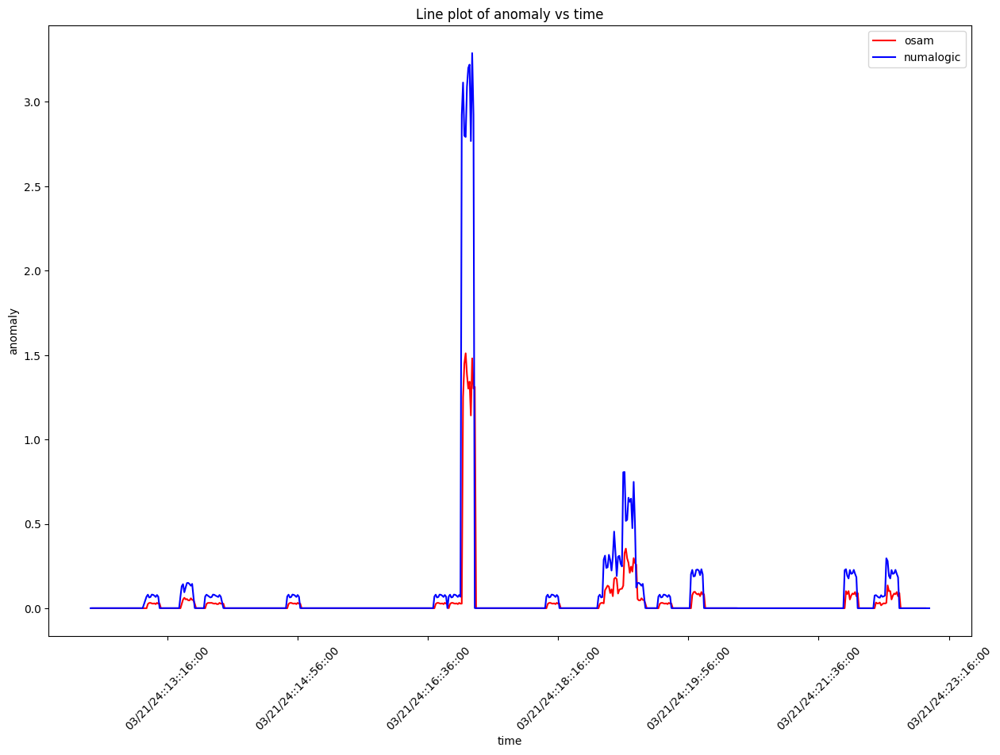

  5%|▍         | 12/248 [00:34<10:59,  2.79s/it]

key:  fciPluginInteractions:metrics:3101871835697829167:transferToVoicemail
Anomaly tp for this graph from OSAM:  0
Anomaly tp for this graph from Numa:  1


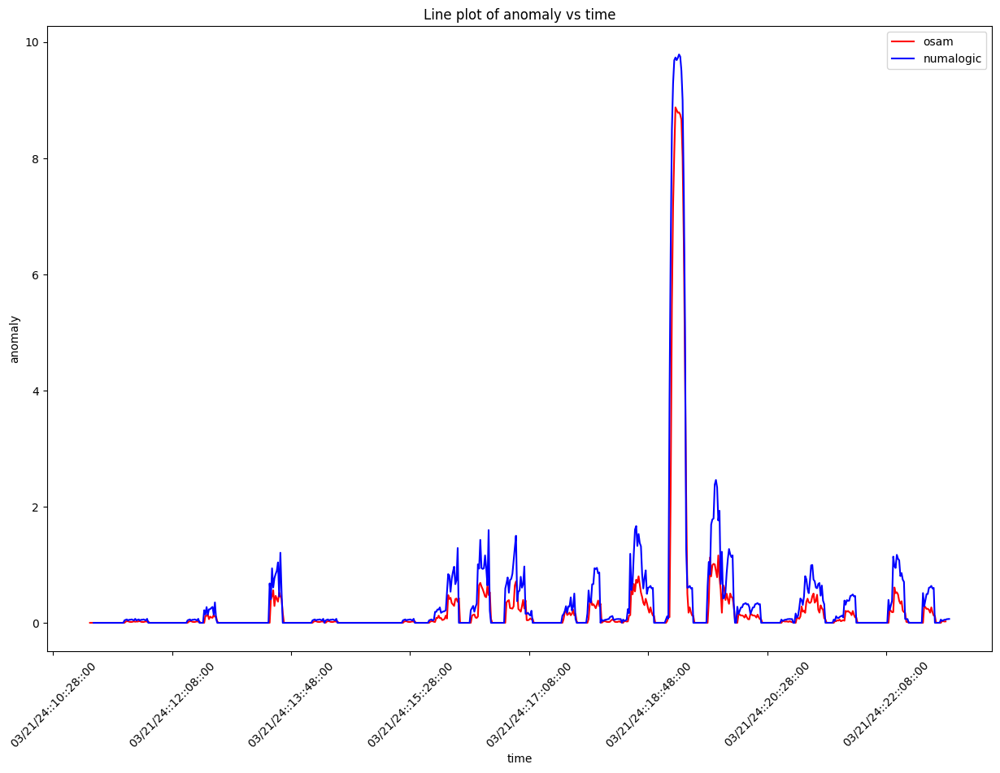

  5%|▌         | 13/248 [00:37<11:13,  2.87s/it]

key:  fciPluginAppInteractions:metrics:3750390182735137211:5984175597303660107:DRILLDOWN_REPORT_FETCH
Anomaly tp for this graph from OSAM:  1
Anomaly tp for this graph from Numa:  1


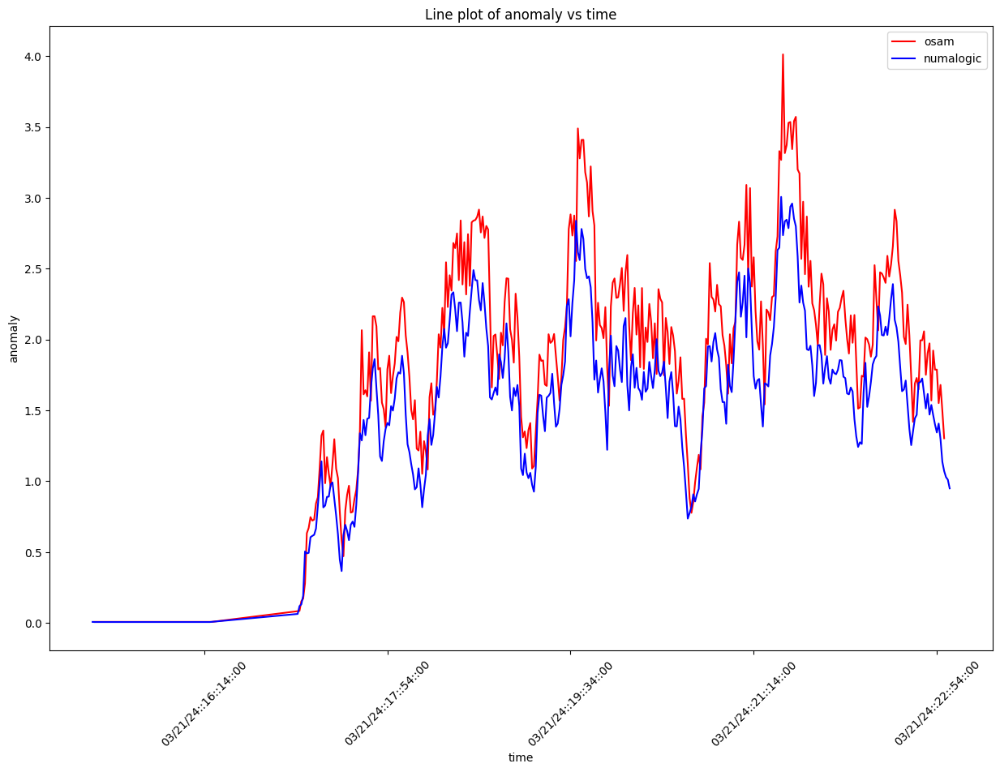

  6%|▌         | 14/248 [00:40<11:25,  2.93s/it]

key:  fciPluginAppInteractions:metrics:2453353489468585843:5984175597303660107:paymentMethodMonolithOnSearch
Anomaly tp for this graph from OSAM:  2
Anomaly tp for this graph from Numa:  0


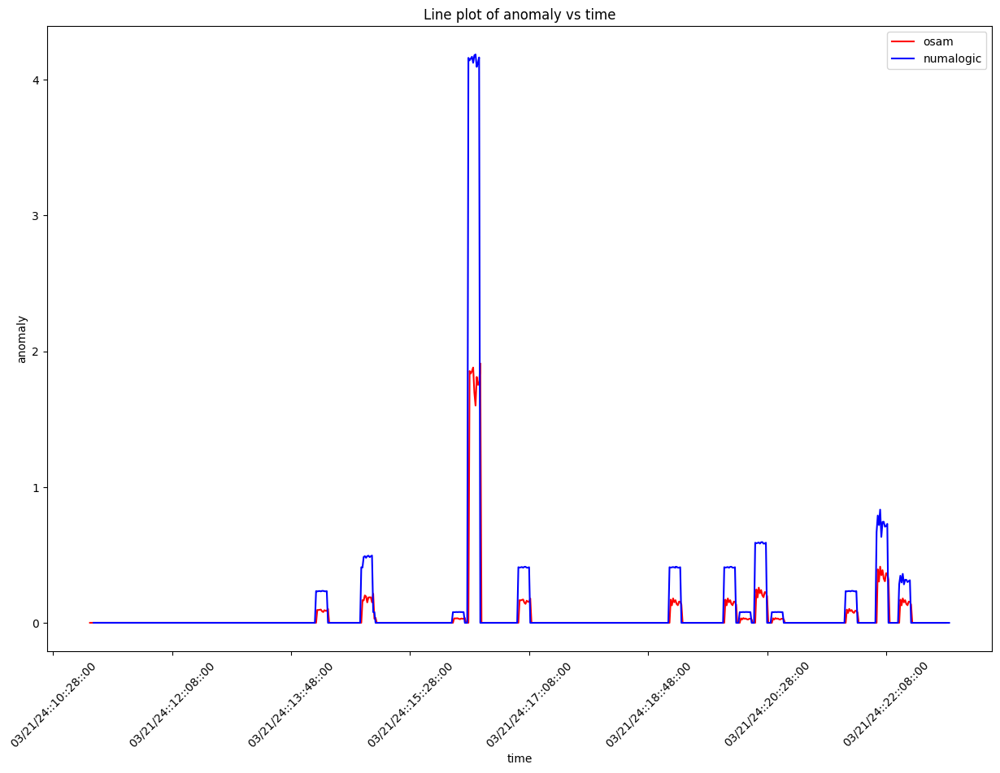

  6%|▌         | 15/248 [00:43<11:39,  3.00s/it]

key:  fciPluginAsset:metricsFailed:8290018606576915479
Anomaly tp for this graph from OSAM:  0
Anomaly tp for this graph from Numa:  1


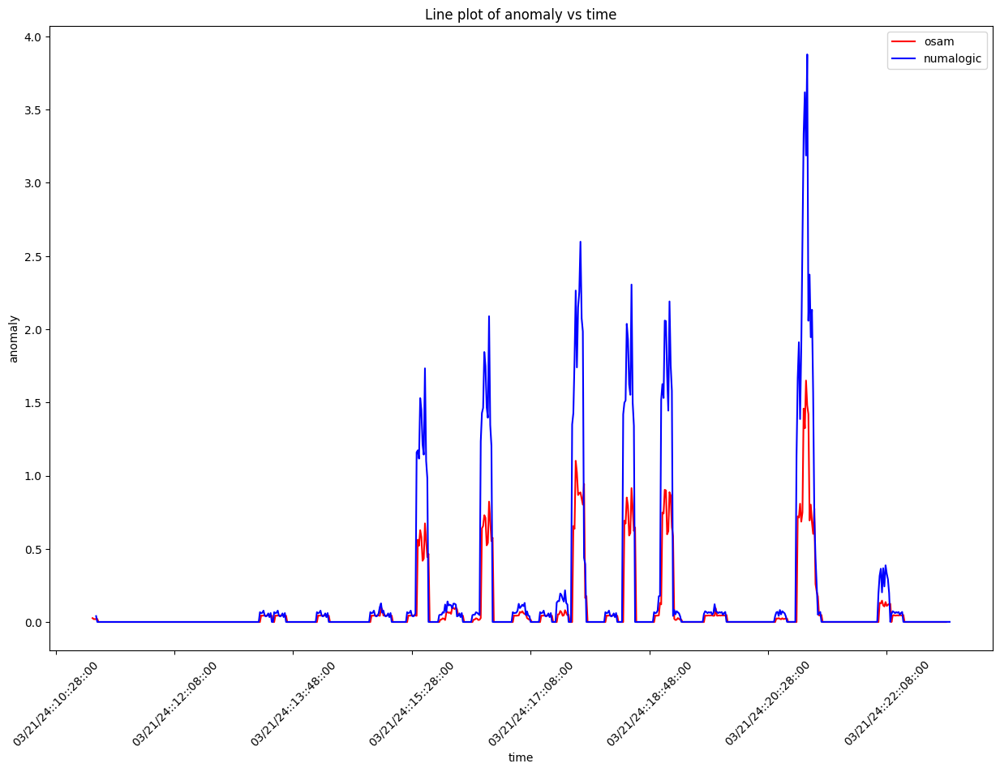

  6%|▋         | 16/248 [00:46<11:55,  3.08s/it]

key:  fciPluginInteractions:metrics:1012201608902407753:lookup-address-ss
Anomaly tp for this graph from OSAM:  0
Anomaly tp for this graph from Numa:  1


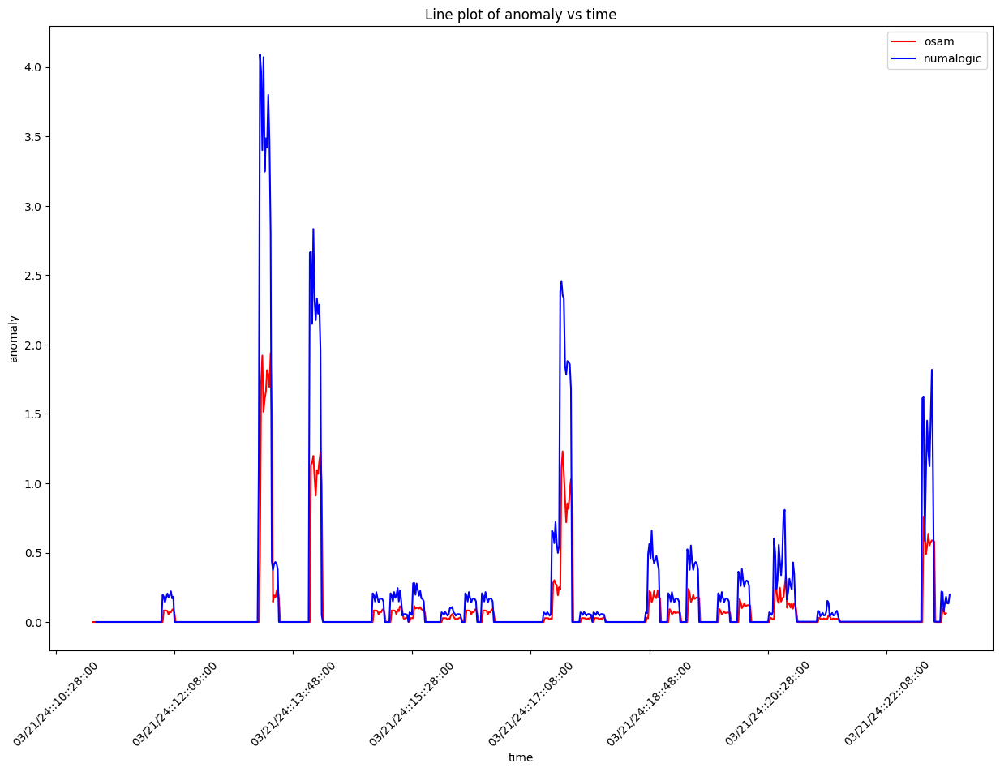

  7%|▋         | 17/248 [00:49<12:00,  3.12s/it]

key:  fci:interactionsFailed:5984175597303660107:Collab_Vep_UI_GET_CONFIG_FILE
Anomaly tp for this graph from OSAM:  0
Anomaly tp for this graph from Numa:  1


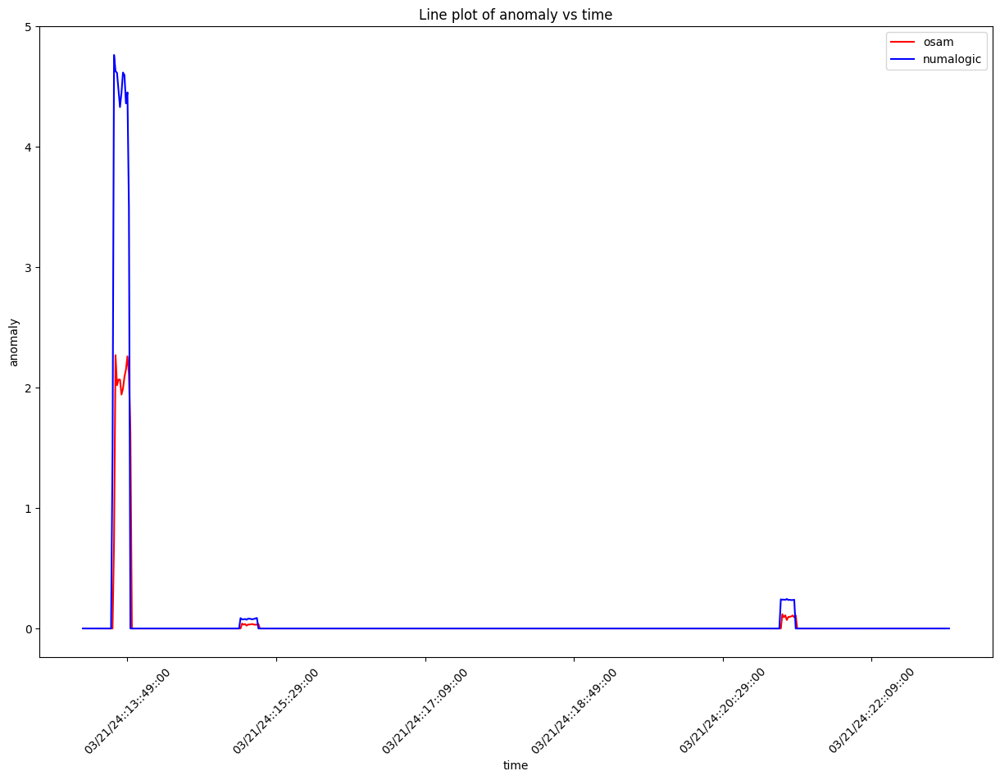

  7%|▋         | 18/248 [00:53<12:18,  3.21s/it]

key:  fci:interactionsFailed:4831254092648450521:w-2-post-main-entry-celebration-empathy-views-0.irsw2.Prev
Anomaly tp for this graph from OSAM:  0
Anomaly tp for this graph from Numa:  1


  8%|▊         | 19/248 [00:56<11:50,  3.10s/it]

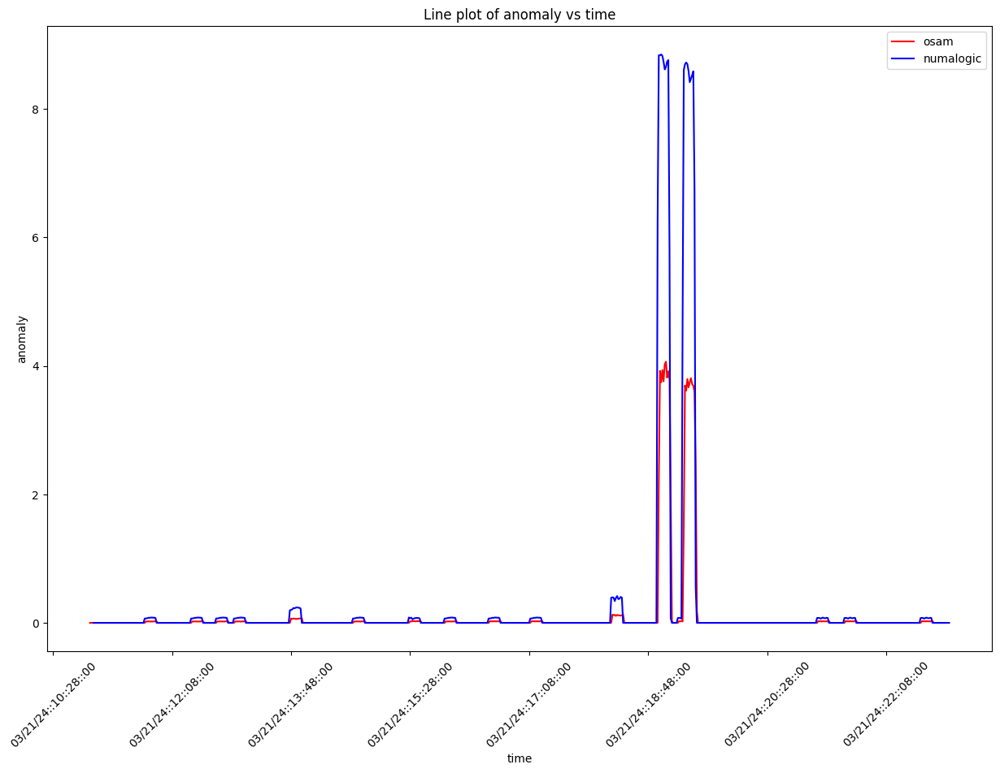

  8%|▊         | 20/248 [00:59<11:53,  3.13s/it]

key:  fci:interactionsFailed:5984175597303660107:newAccountMlSuggestedIds
Anomaly tp for this graph from OSAM:  2
Anomaly tp for this graph from Numa:  2


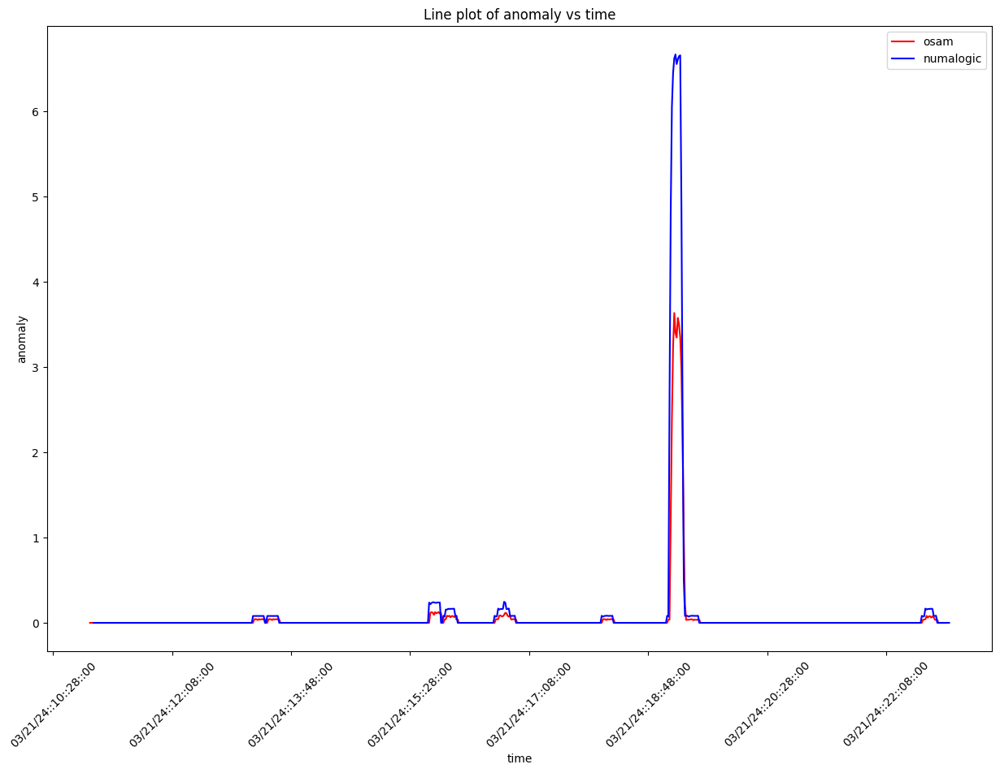

  8%|▊         | 21/248 [01:02<11:54,  3.15s/it]

key:  fci:interactionsFailed:5984175597303660107:PAGINATE_REPORT
Anomaly tp for this graph from OSAM:  1
Anomaly tp for this graph from Numa:  1


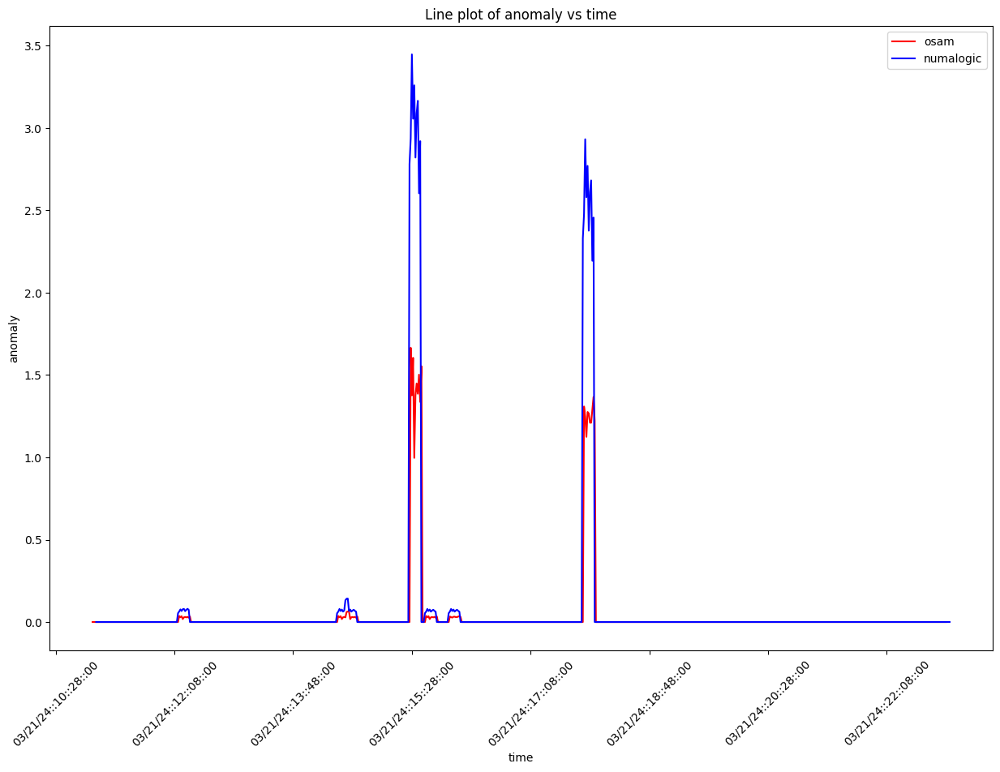

  9%|▉         | 22/248 [01:05<11:59,  3.18s/it]

key:  fciPluginInteractions:metrics:8217961012385696693:Collab_Docmgmt_UI_Get_Folder_Metadata_By_Id_Elastic_Search
Anomaly tp for this graph from OSAM:  0
Anomaly tp for this graph from Numa:  1


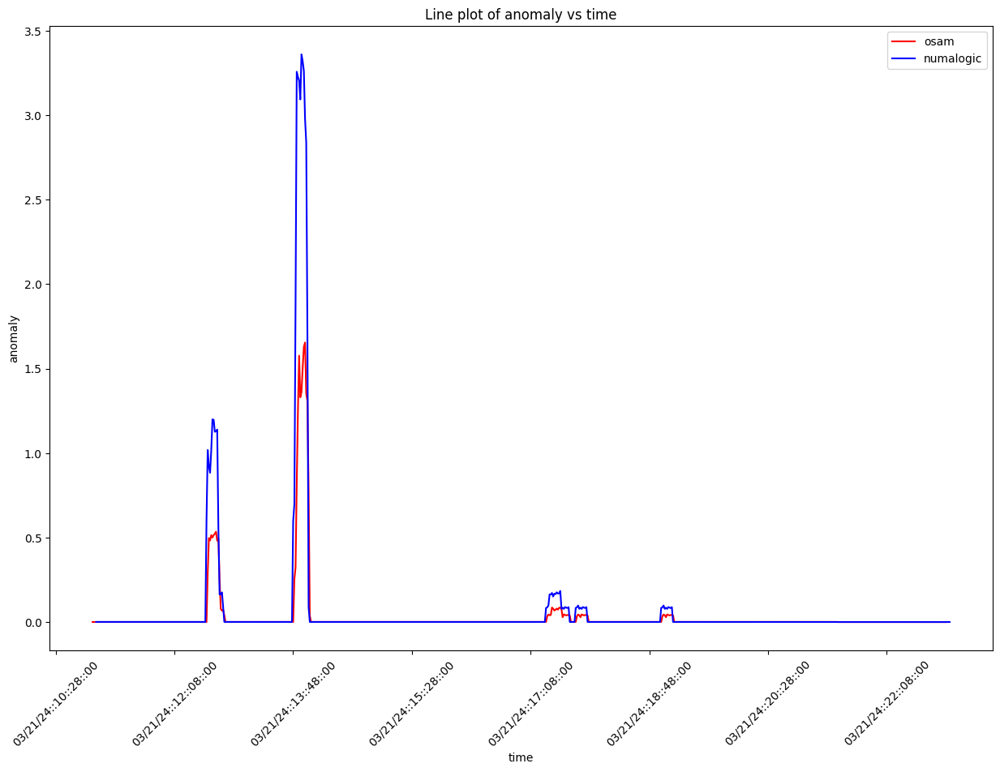

  9%|▉         | 23/248 [01:08<11:46,  3.14s/it]

key:  fciPluginInteractions:metrics:4398908529054951215:PAGE_LIVE_PREVIEW
Anomaly tp for this graph from OSAM:  0
Anomaly tp for this graph from Numa:  1


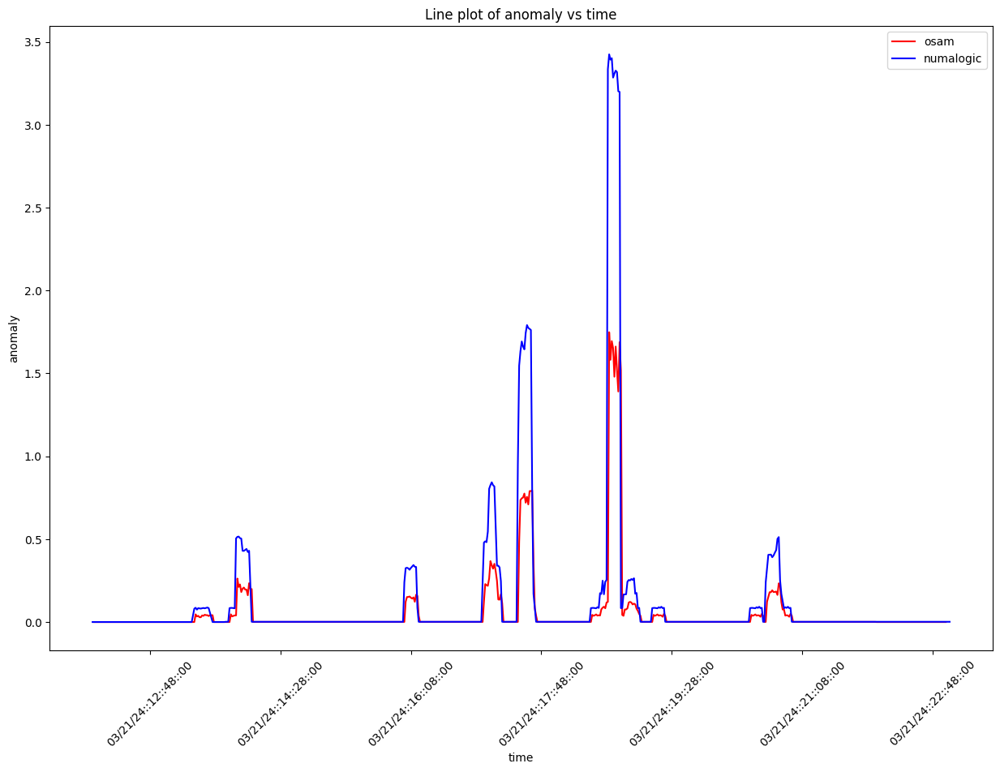

 10%|▉         | 24/248 [01:11<11:44,  3.14s/it]

key:  fciPluginAppInteractions:metrics:2453353489679220423:5984175597303660107:REVIEW_RECIPIENTS
Anomaly tp for this graph from OSAM:  0
Anomaly tp for this graph from Numa:  1


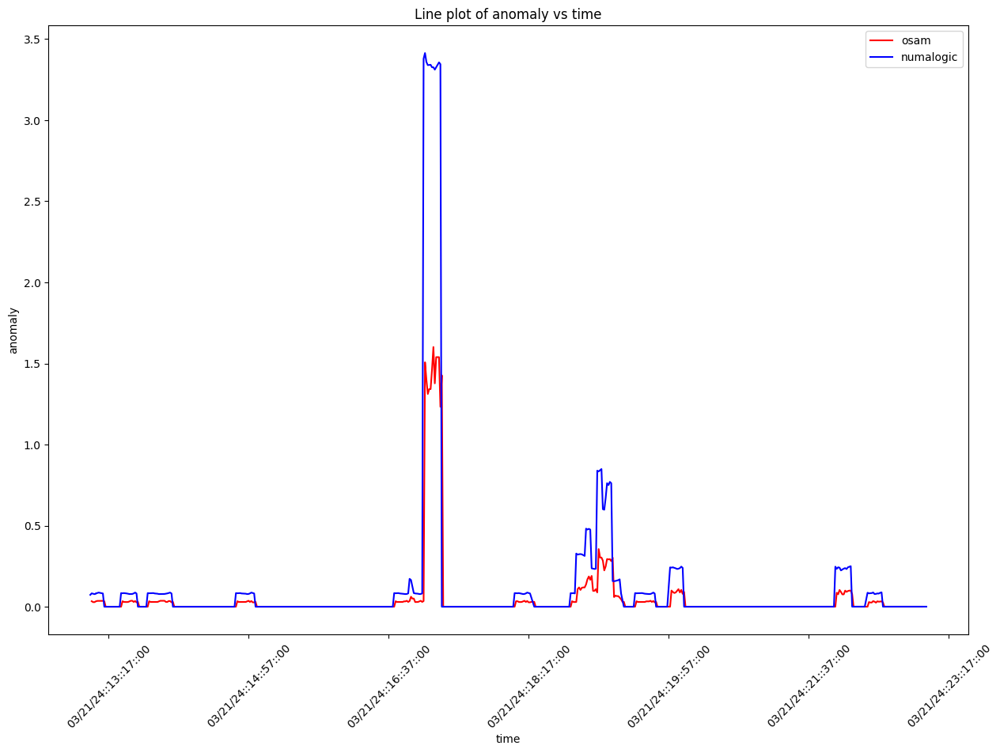

 10%|█         | 25/248 [01:15<11:56,  3.21s/it]

key:  fciPluginAppInteractions:metrics:3101871835697829167:1876892737053055605:transferToVoicemail
Anomaly tp for this graph from OSAM:  0
Anomaly tp for this graph from Numa:  1


 10%|█         | 26/248 [01:17<11:20,  3.07s/it]

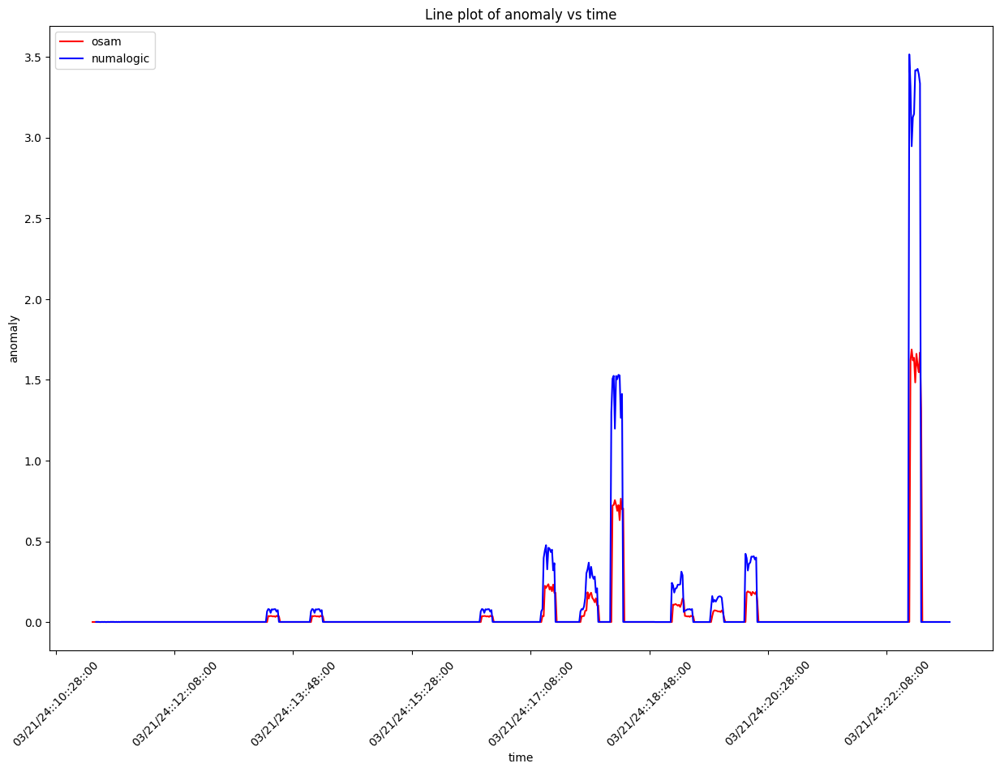

 11%|█         | 27/248 [01:21<11:15,  3.06s/it]

key:  fciPluginInteractions:metrics:8217961012385696693:Collab_Docmgmt_UI_Get_Files_By_Ids_Elastic_Search
Anomaly tp for this graph from OSAM:  0
Anomaly tp for this graph from Numa:  1


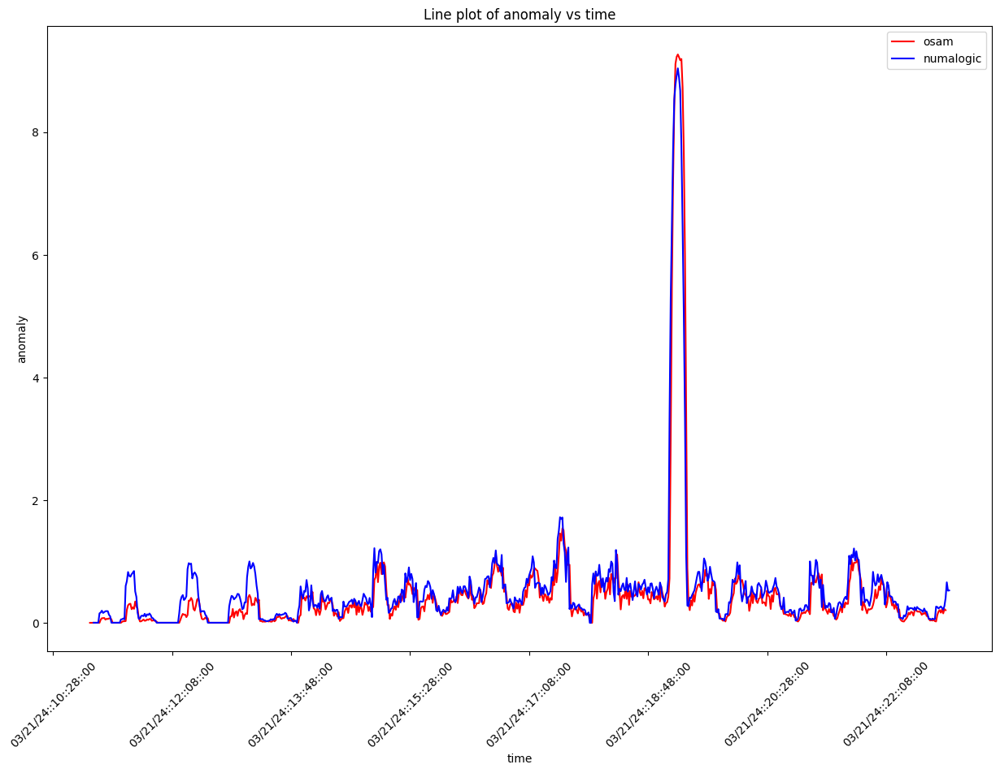

 11%|█▏        | 28/248 [01:24<11:27,  3.13s/it]

key:  fciPluginAppInteractions:metrics:3750390182735137211:5984175597303660107:EXECUTE_PAGINATED_REPORT
Anomaly tp for this graph from OSAM:  1
Anomaly tp for this graph from Numa:  1


 12%|█▏        | 30/248 [01:29<10:36,  2.92s/it]

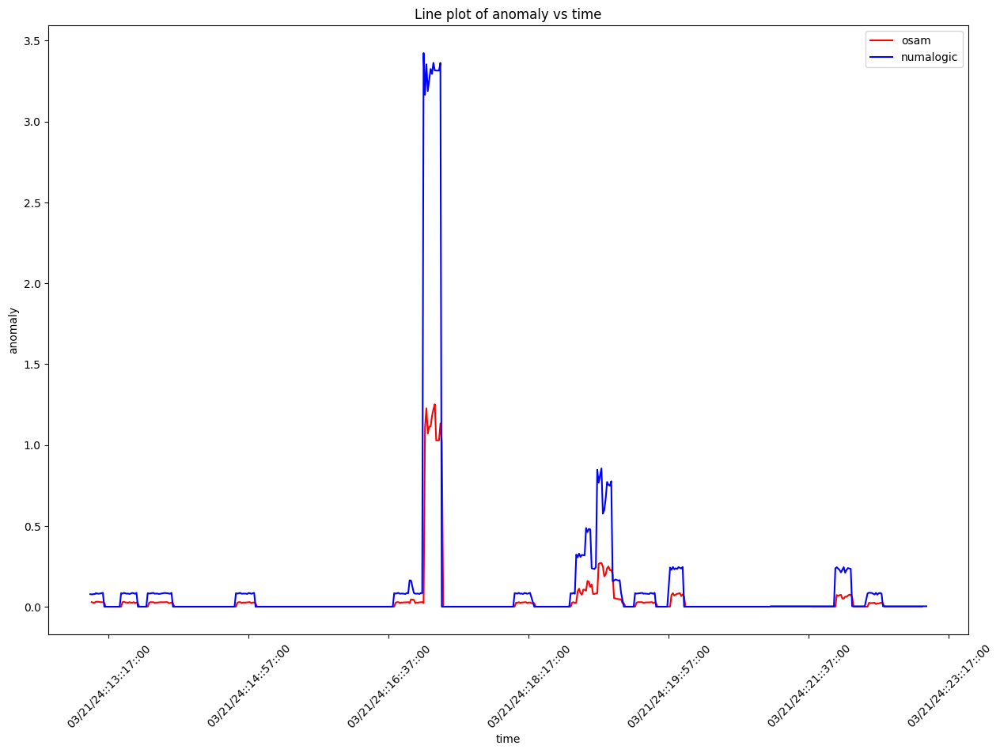

 12%|█▎        | 31/248 [01:32<10:48,  2.99s/it]

key:  fci:interactionsFailed:1876892737053055605:transferToVoicemail
Anomaly tp for this graph from OSAM:  0
Anomaly tp for this graph from Numa:  1


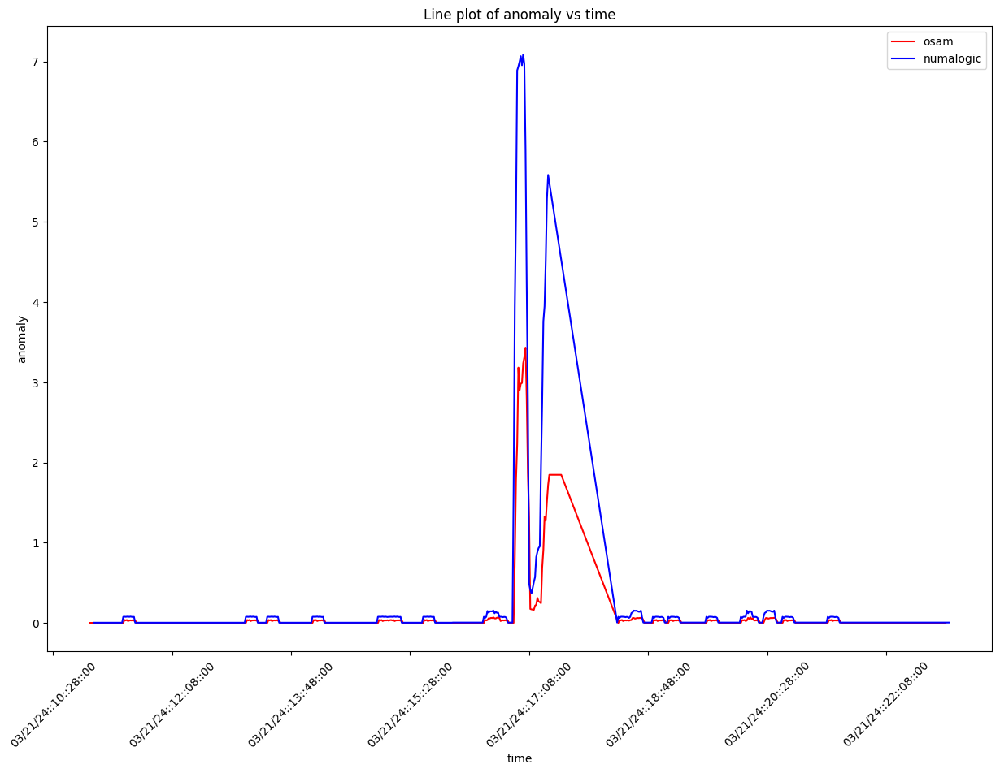

 13%|█▎        | 32/248 [01:35<10:47,  3.00s/it]

key:  fciPluginAppInteractions:metrics:579856044409078427:5477520638979968238:GenAi Explanations
Anomaly tp for this graph from OSAM:  1
Anomaly tp for this graph from Numa:  2


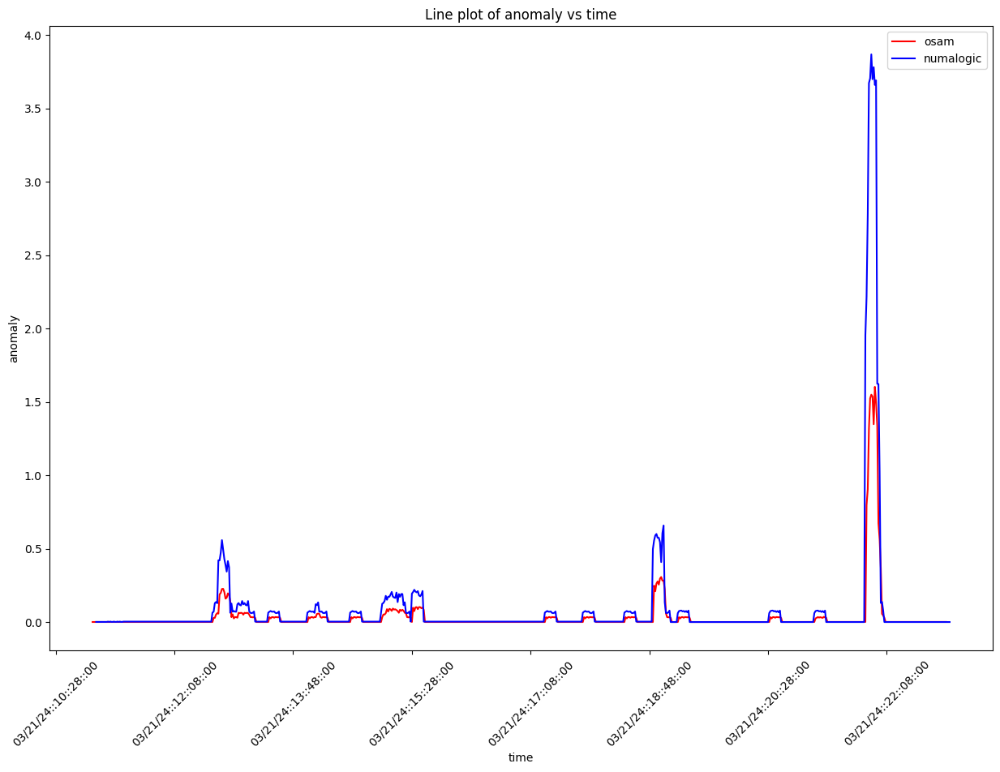

 13%|█▎        | 33/248 [01:38<10:44,  3.00s/it]

key:  fciPlugin:requestsFailed:868086420502860411:iep-workspace
Anomaly tp for this graph from OSAM:  0
Anomaly tp for this graph from Numa:  1


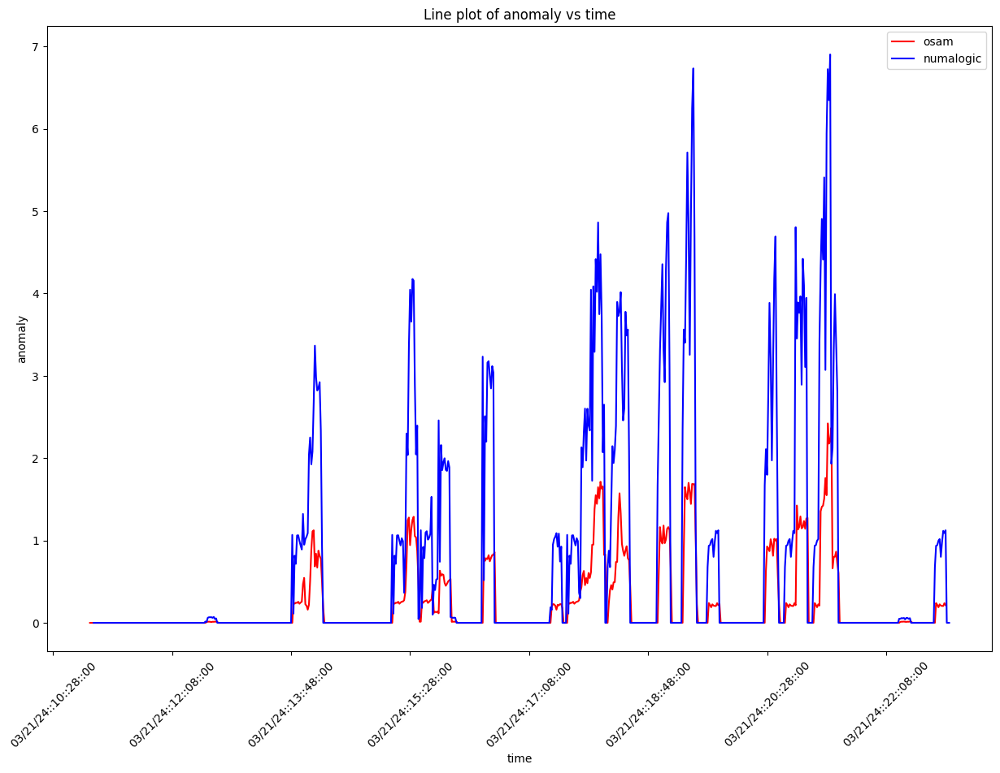

 14%|█▎        | 34/248 [01:41<10:40,  2.99s/it]

key:  fciPluginInteractions:metrics:2453353489468585843:cachedContactOnSearch
Anomaly tp for this graph from OSAM:  0
Anomaly tp for this graph from Numa:  13


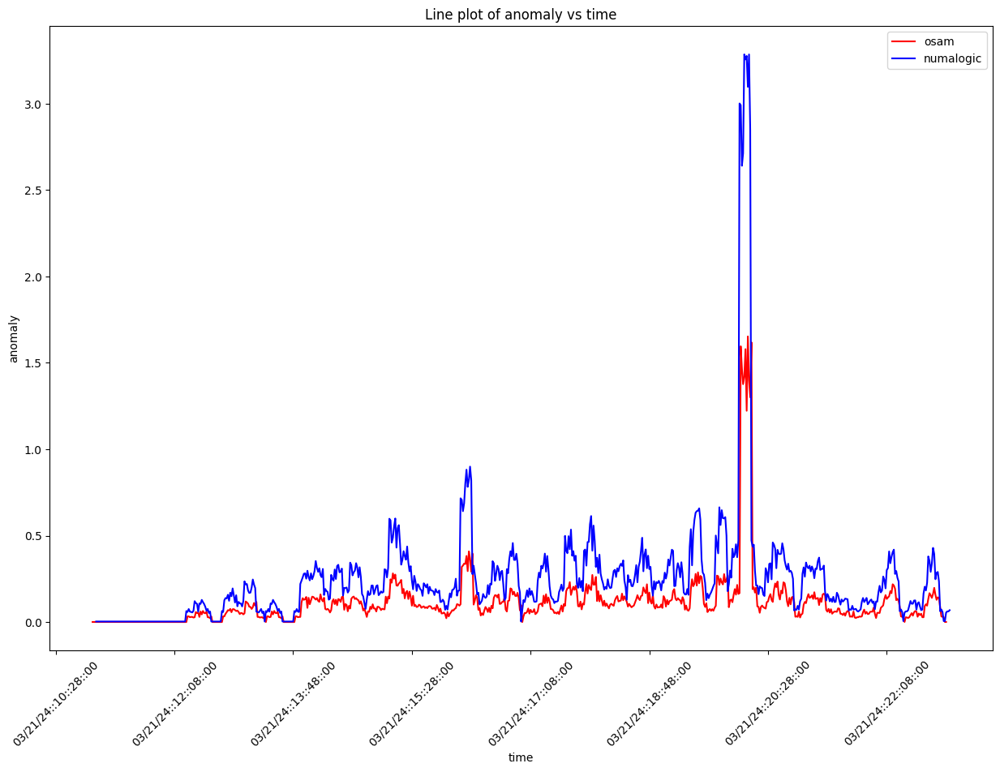

 14%|█▍        | 35/248 [01:45<10:47,  3.04s/it]

key:  fciPluginAppInteractions:metrics:5695945221779243793:5984175597303660107:personal_info_card_loaded
Anomaly tp for this graph from OSAM:  0
Anomaly tp for this graph from Numa:  1


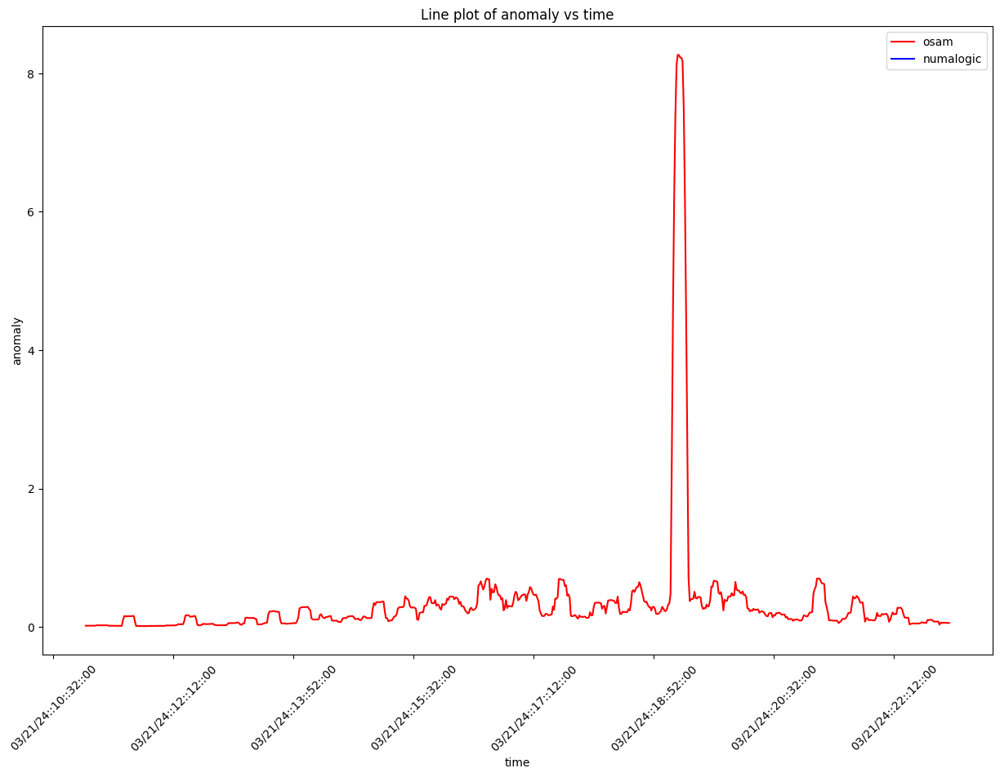

 15%|█▍        | 36/248 [01:47<10:37,  3.01s/it]

key:  fciPlugin:requests:5984175597303660107:crb-core
Anomaly tp for this graph from OSAM:  1
Anomaly tp for this graph from Numa:  0


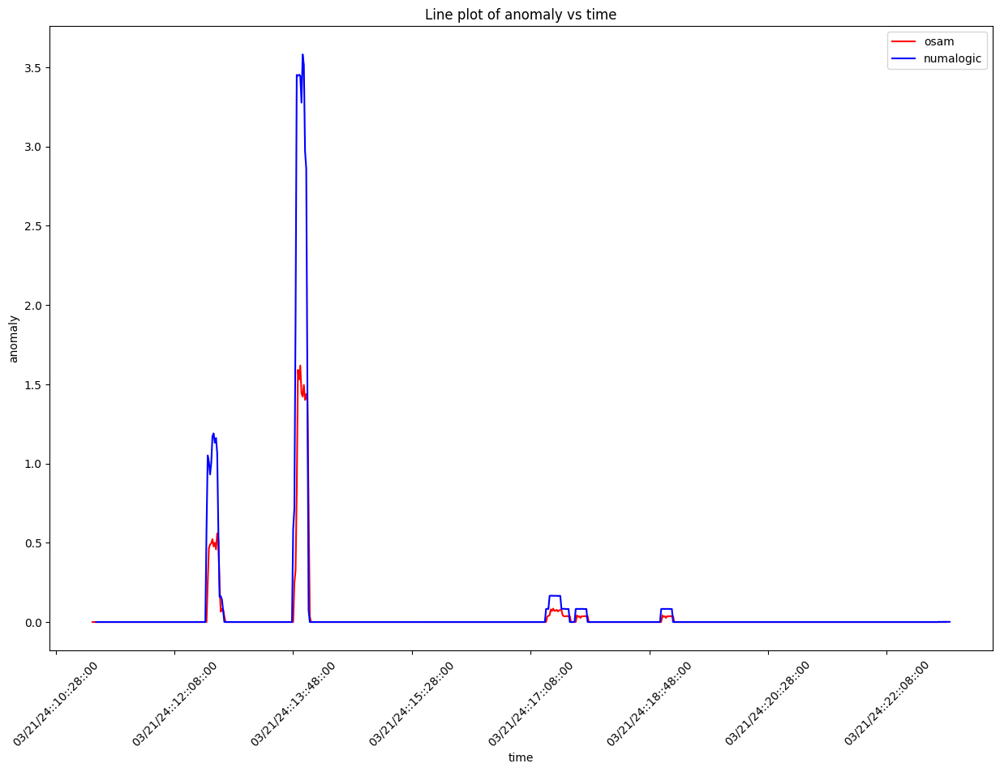

 15%|█▍        | 37/248 [01:51<11:11,  3.18s/it]

key:  fciPluginAppInteractions:metrics:4398908529054951215:5984175597303660107:PAGE_LIVE_PREVIEW
Anomaly tp for this graph from OSAM:  0
Anomaly tp for this graph from Numa:  1


 15%|█▌        | 38/248 [01:54<10:46,  3.08s/it]

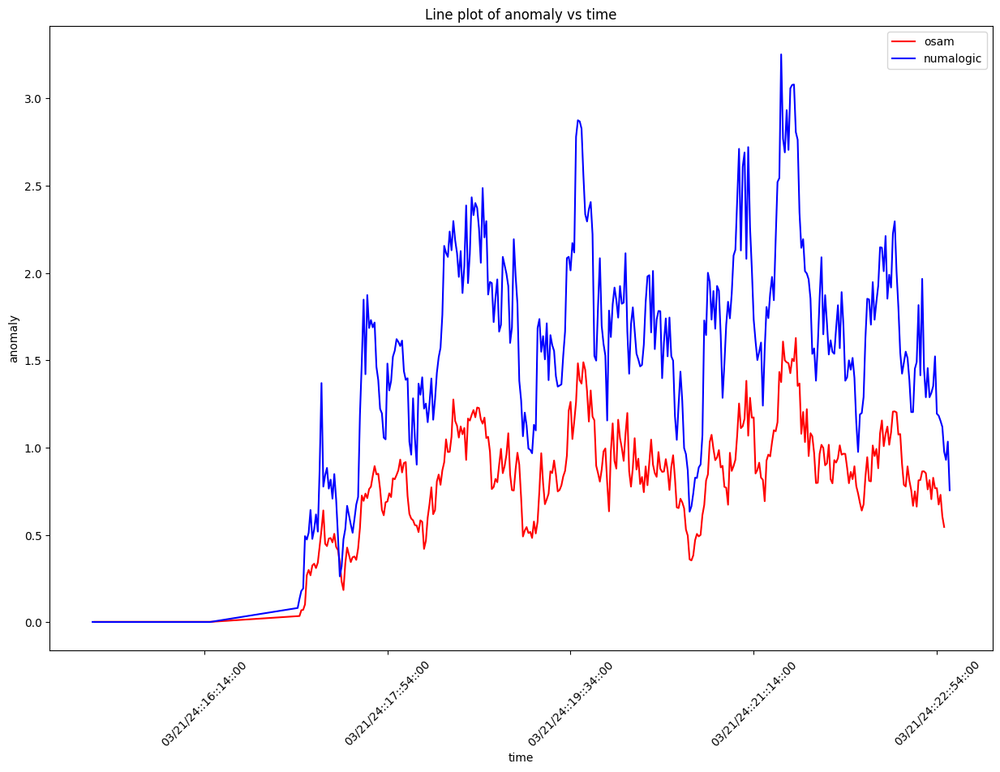

 16%|█▌        | 39/248 [01:57<10:44,  3.08s/it]

key:  fci:interactionsFailed:5984175597303660107:paymentMethodMonolithOnSearch
Anomaly tp for this graph from OSAM:  0
Anomaly tp for this graph from Numa:  1


 16%|█▌        | 40/248 [02:00<10:17,  2.97s/it]

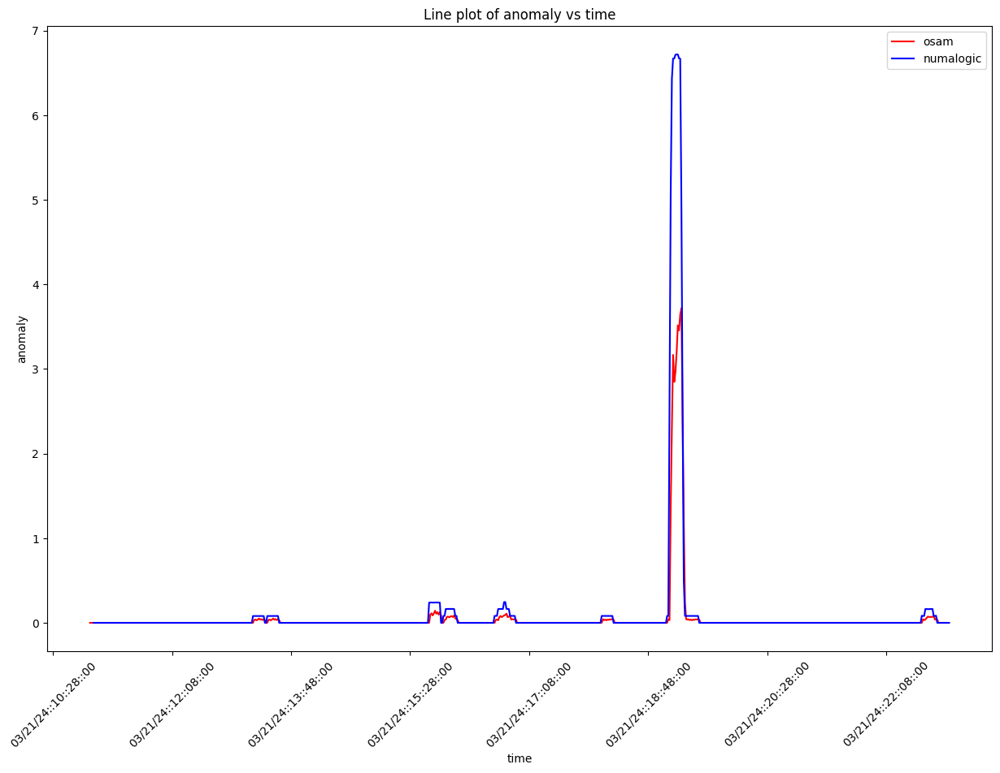

 17%|█▋        | 41/248 [02:03<10:14,  2.97s/it]

key:  fciPluginAppInteractions:metrics:3750390182735137211:5984175597303660107:PAGINATE_REPORT
Anomaly tp for this graph from OSAM:  1
Anomaly tp for this graph from Numa:  1


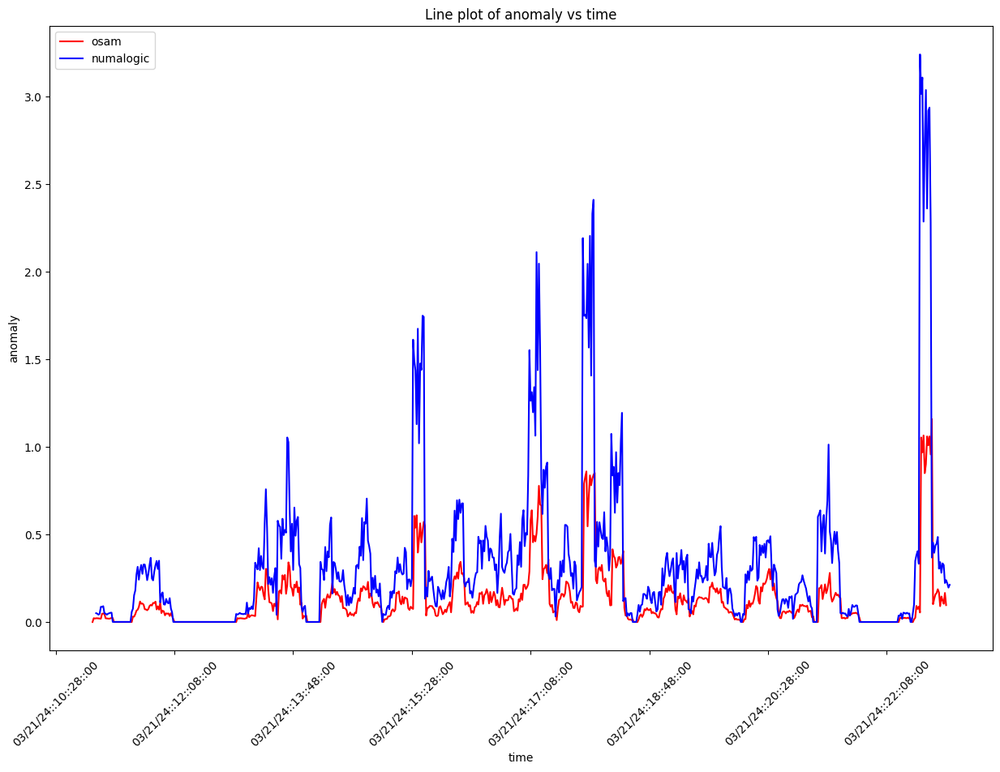

 17%|█▋        | 42/248 [02:06<10:14,  2.98s/it]

key:  fciPlugin:requestsFailed:5984175597303660107:collab-docmgmt-ui
Anomaly tp for this graph from OSAM:  0
Anomaly tp for this graph from Numa:  1


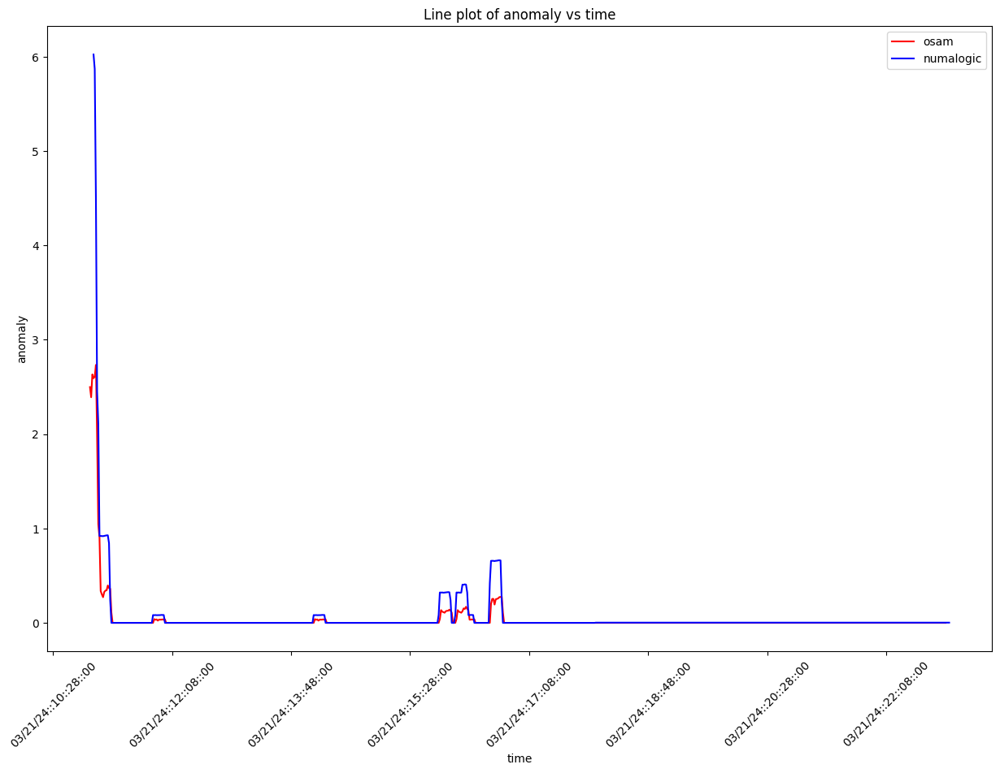

 17%|█▋        | 43/248 [02:09<10:04,  2.95s/it]

key:  fci:interactionsFailed:5984175597303660107:trsnsactionsfc-update-style-preferences
Anomaly tp for this graph from OSAM:  0
Anomaly tp for this graph from Numa:  1


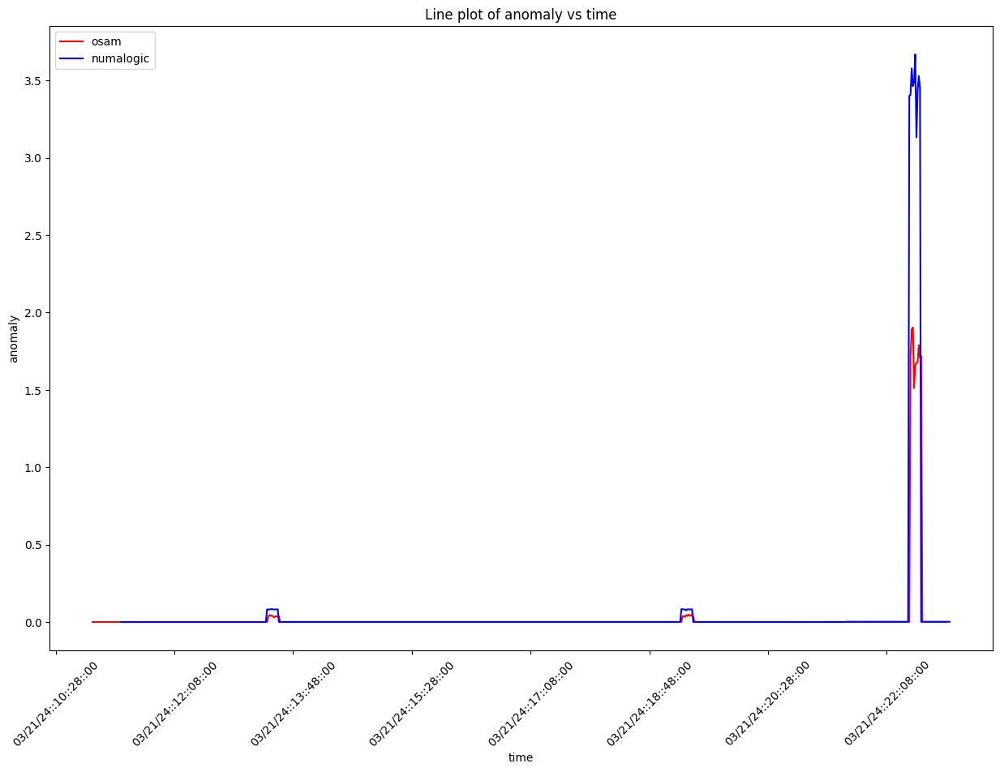

 18%|█▊        | 44/248 [02:11<09:58,  2.93s/it]

key:  fciPluginAppInteractions:metrics:8217961012385696693:868086420502860411:Collab_Docmgmt_UI_Get_Files_By_Ids_Elastic_Search
Anomaly tp for this graph from OSAM:  0
Anomaly tp for this graph from Numa:  1


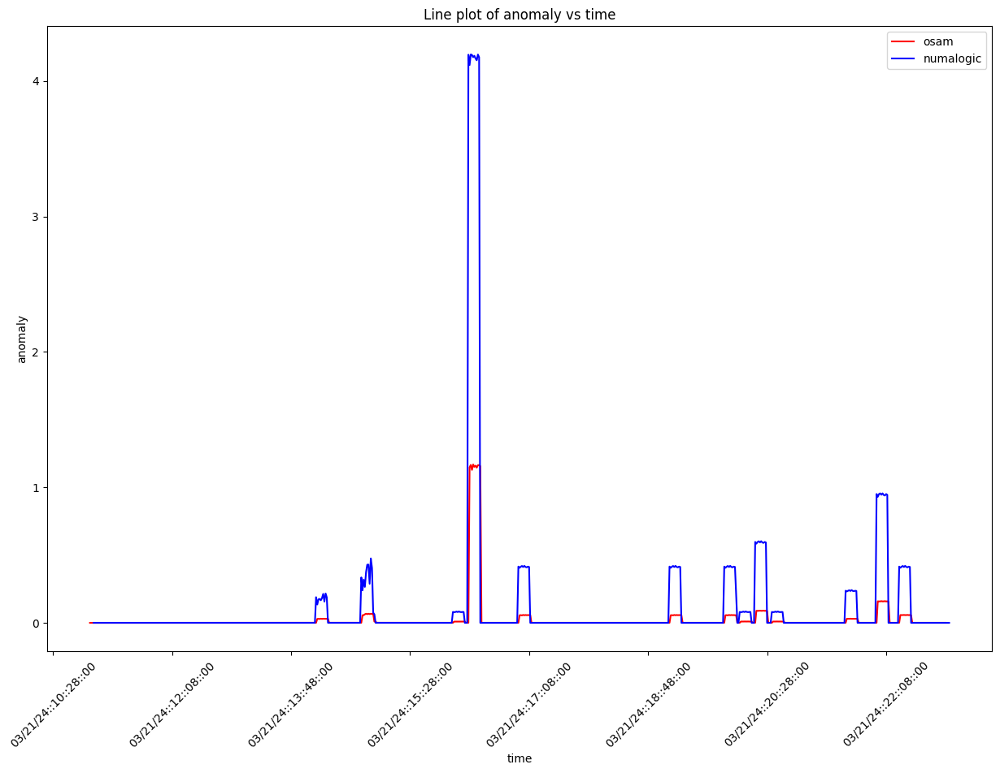

 18%|█▊        | 45/248 [02:14<09:51,  2.91s/it]

key:  fciAsset:assetFailed:8434133794656866131
Anomaly tp for this graph from OSAM:  0
Anomaly tp for this graph from Numa:  1


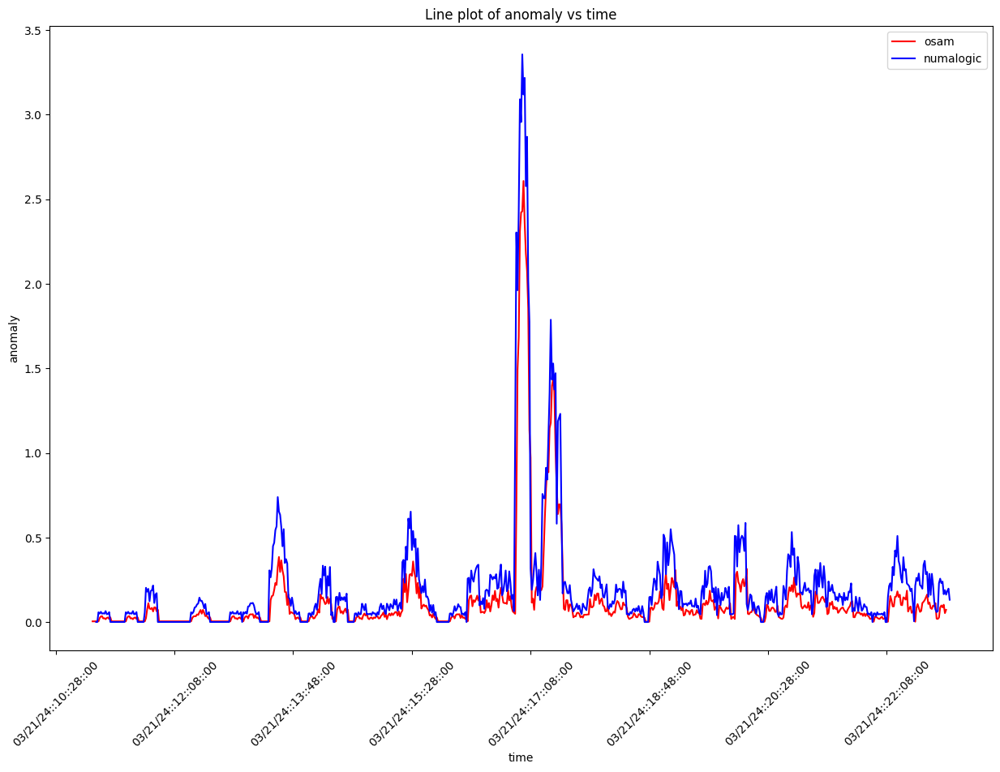

 19%|█▊        | 46/248 [02:17<09:48,  2.91s/it]

key:  fciPlugin:requestsFailed:5477520638979968238:tto-shell-ui
Anomaly tp for this graph from OSAM:  0
Anomaly tp for this graph from Numa:  1


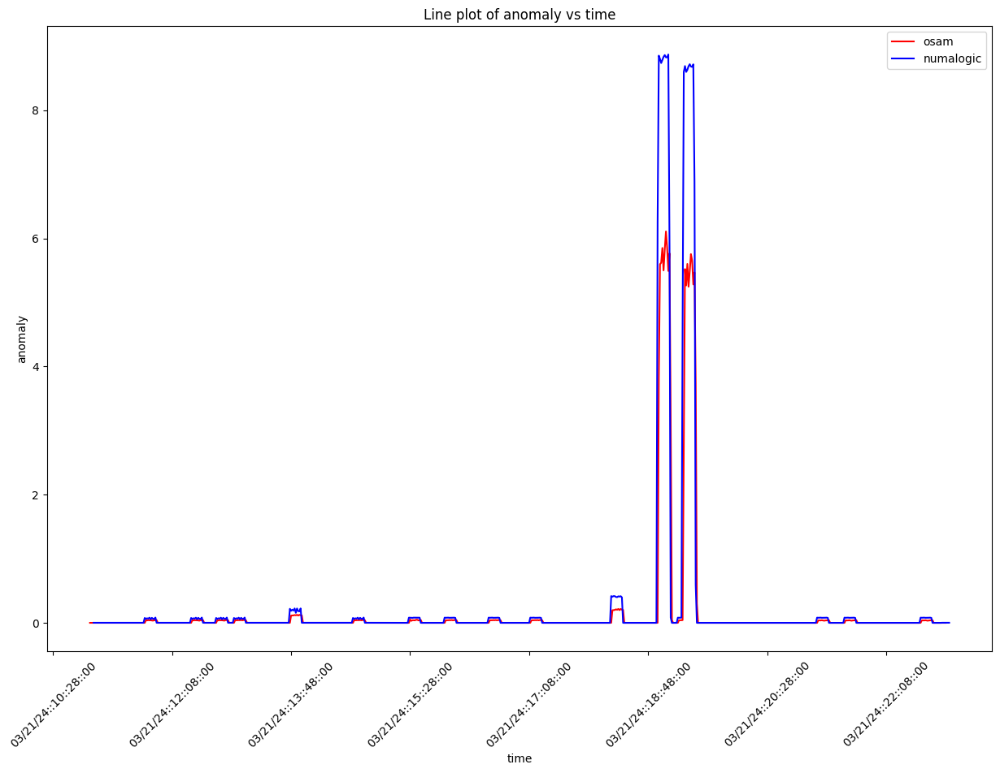

 19%|█▉        | 47/248 [02:20<09:33,  2.85s/it]

key:  fciPluginAppInteractions:metrics:2453353489468585843:5984175597303660107:newAccountMlSuggestedIds
Anomaly tp for this graph from OSAM:  2
Anomaly tp for this graph from Numa:  2


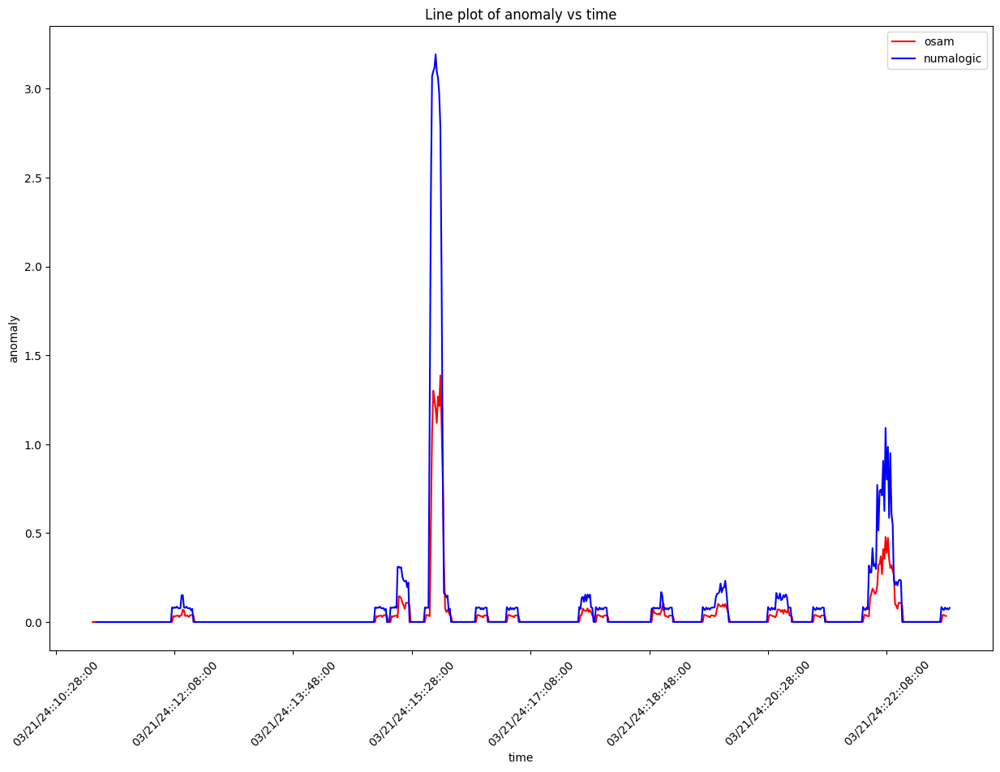

 19%|█▉        | 48/248 [02:23<09:20,  2.80s/it]

key:  fci:interactionsFailed:5984175597303660107:TXP/expenses-forms-ui/onLineItemsProductChange
Anomaly tp for this graph from OSAM:  0
Anomaly tp for this graph from Numa:  1


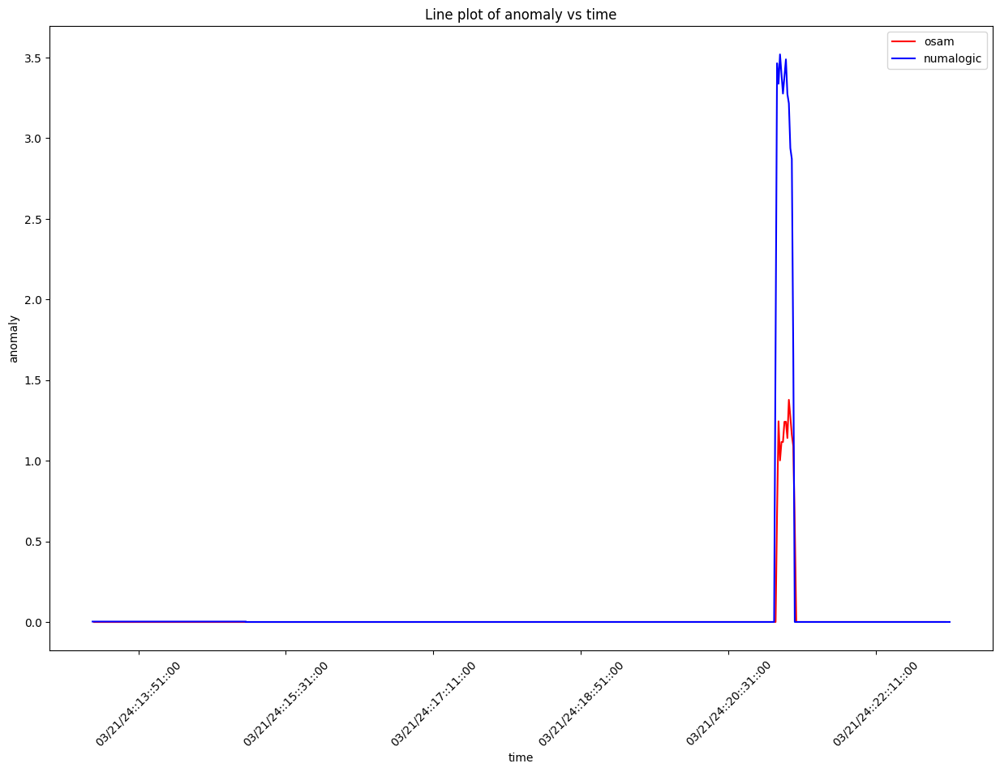

 20%|█▉        | 49/248 [02:25<09:17,  2.80s/it]

key:  fci:interactionsFailed:5477520638979968238:player_topic_educatorexpenses
Anomaly tp for this graph from OSAM:  0
Anomaly tp for this graph from Numa:  1


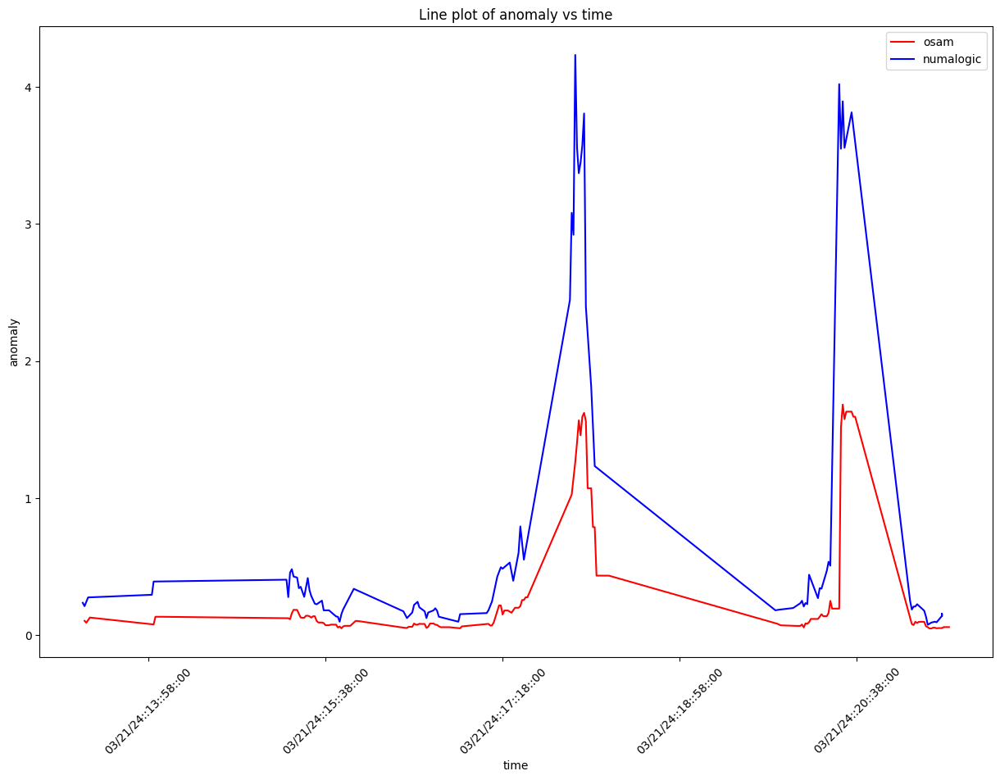

 20%|██        | 50/248 [02:28<09:12,  2.79s/it]

key:  fci:interactionsFailed:5984175597303660107:Smartdocs_Web_Platform_FCI_IMPORT_DOCUMENT
Anomaly tp for this graph from OSAM:  0
Anomaly tp for this graph from Numa:  2


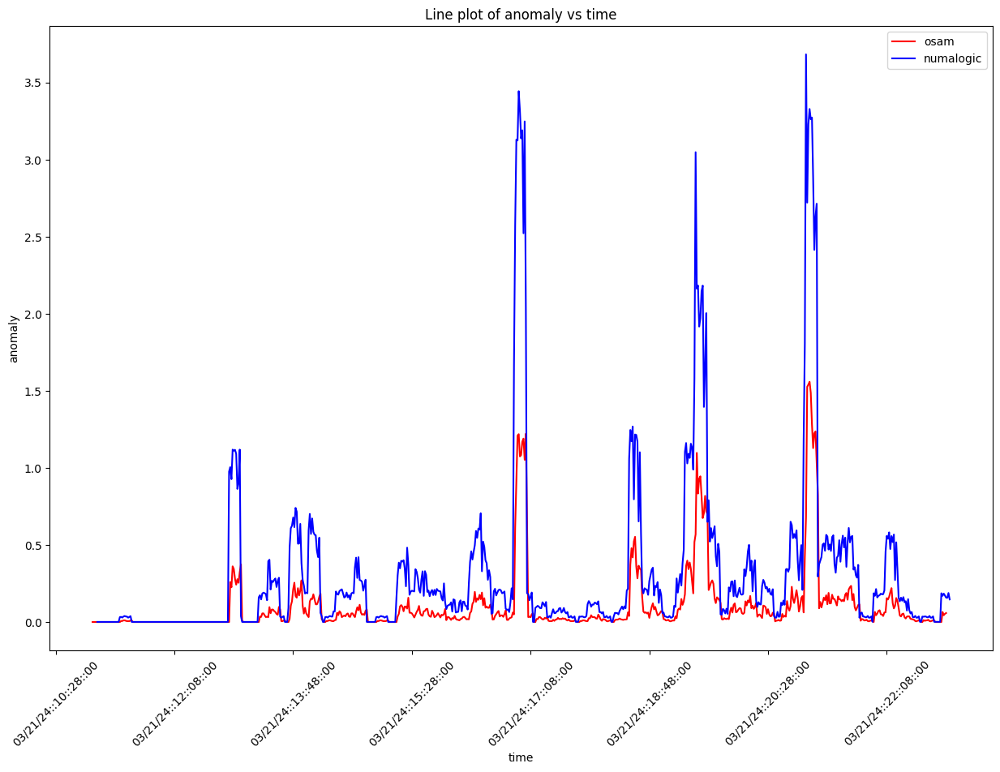

 21%|██        | 51/248 [02:31<09:13,  2.81s/it]

key:  fci:interactionsFailed:1876892737053055605:resumeAllConnections
Anomaly tp for this graph from OSAM:  0
Anomaly tp for this graph from Numa:  2


 21%|██        | 52/248 [02:34<08:55,  2.73s/it]

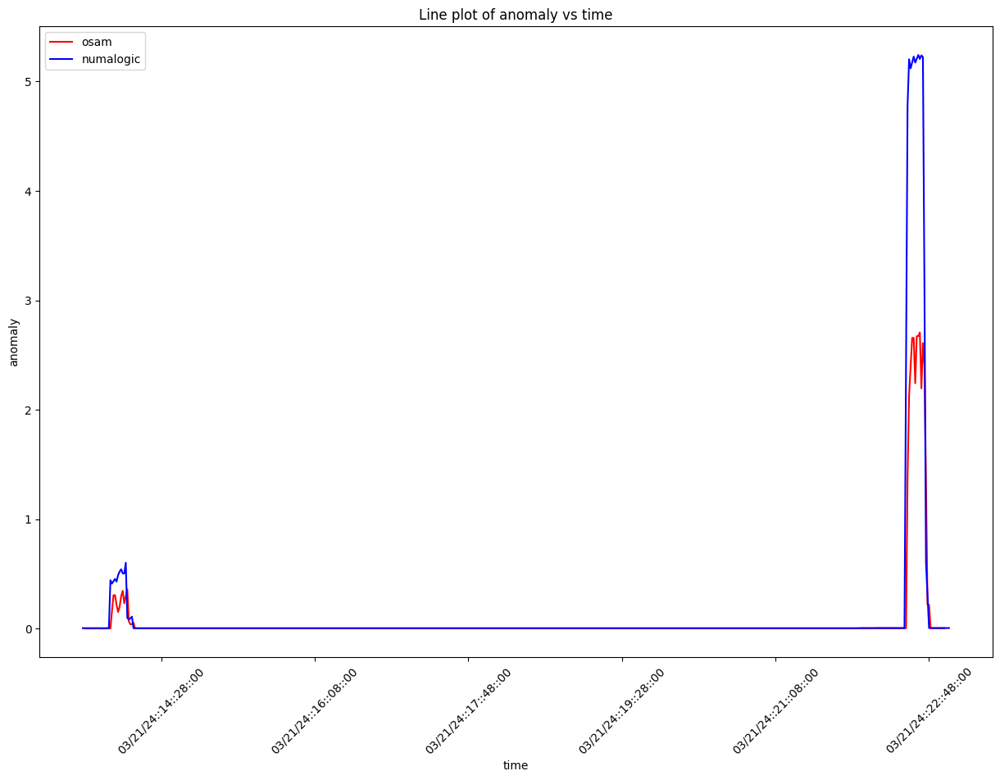

 21%|██▏       | 53/248 [02:36<08:53,  2.74s/it]

key:  fciPluginInteractions:metrics:3966562964805320729:Customer_info_gathering_Update_Specification
Anomaly tp for this graph from OSAM:  0
Anomaly tp for this graph from Numa:  1


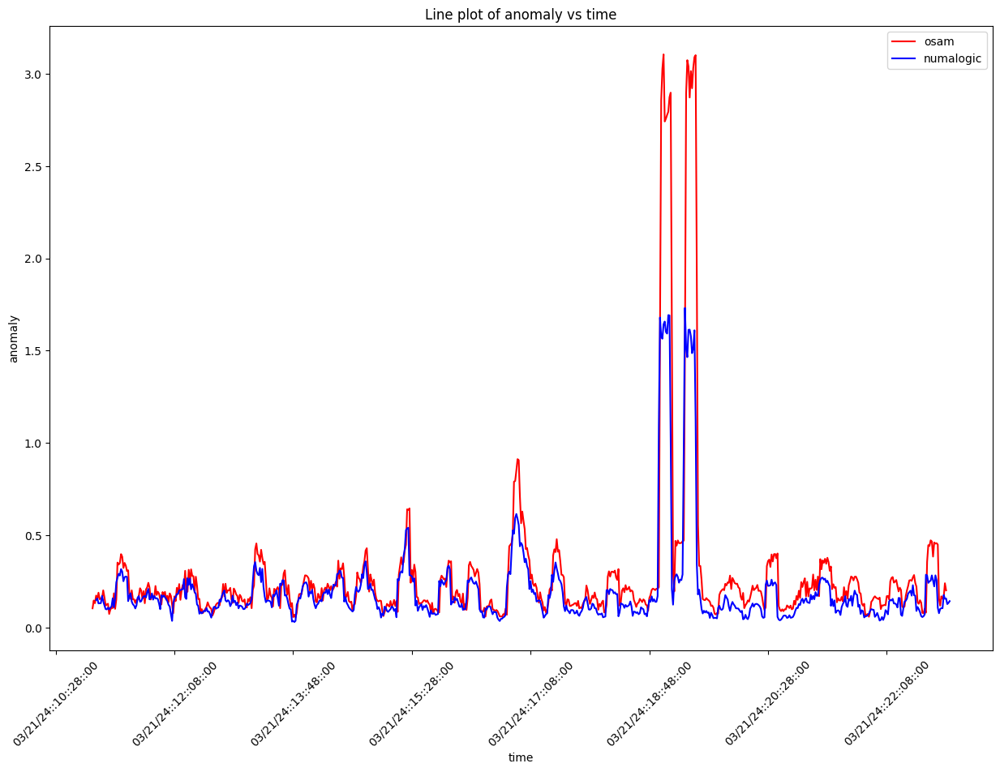

 22%|██▏       | 54/248 [02:39<08:52,  2.74s/it]

key:  fciPluginInteractions:metrics:2453353489468585843:productServiceOnSearch
Anomaly tp for this graph from OSAM:  1
Anomaly tp for this graph from Numa:  0


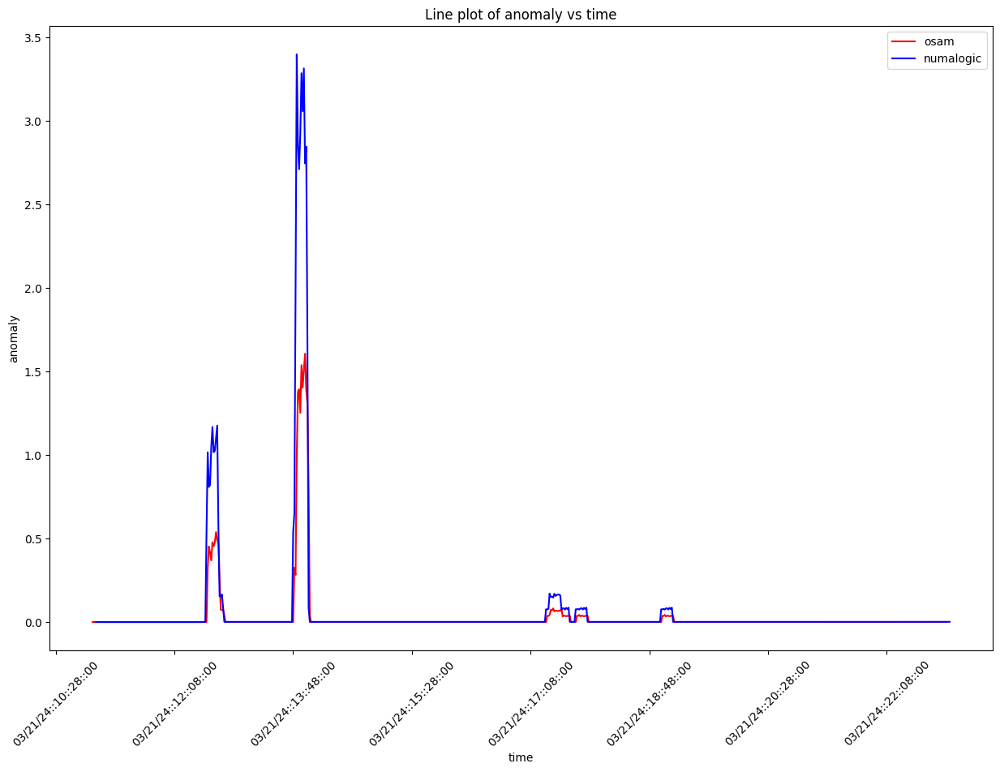

 22%|██▏       | 55/248 [02:42<09:02,  2.81s/it]

key:  fci:interactionsFailed:5984175597303660107:PAGE_LIVE_PREVIEW
Anomaly tp for this graph from OSAM:  0
Anomaly tp for this graph from Numa:  1


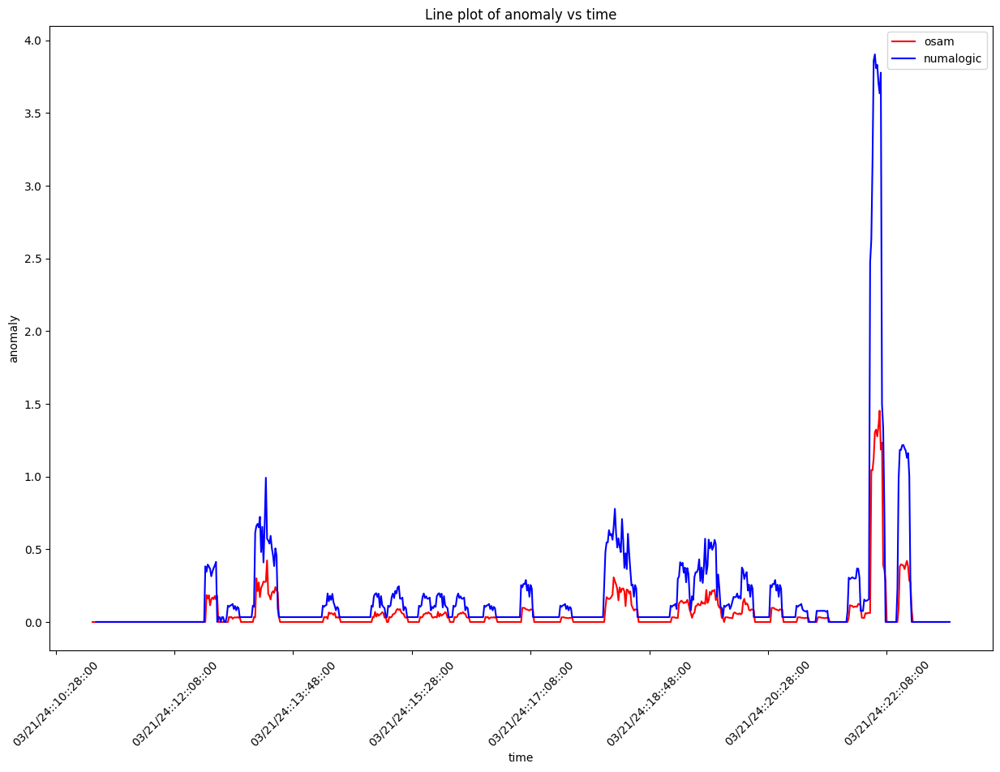

 23%|██▎       | 56/248 [02:45<09:05,  2.84s/it]

key:  fci:interactionsFailed:1156316797376513545:contact-profile:profile-modal:submit
Anomaly tp for this graph from OSAM:  0
Anomaly tp for this graph from Numa:  1


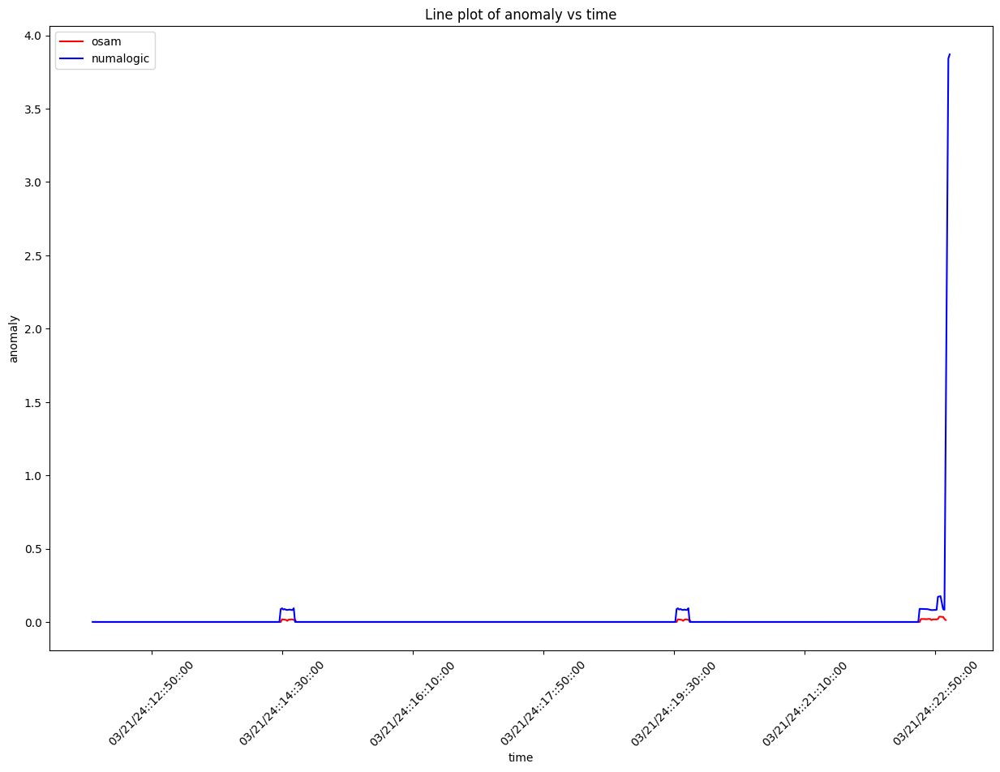

 23%|██▎       | 57/248 [02:48<09:04,  2.85s/it]

key:  fciPlugin:requestsFailed:6560636350152934195:search-widget
Anomaly tp for this graph from OSAM:  1
Anomaly tp for this graph from Numa:  0


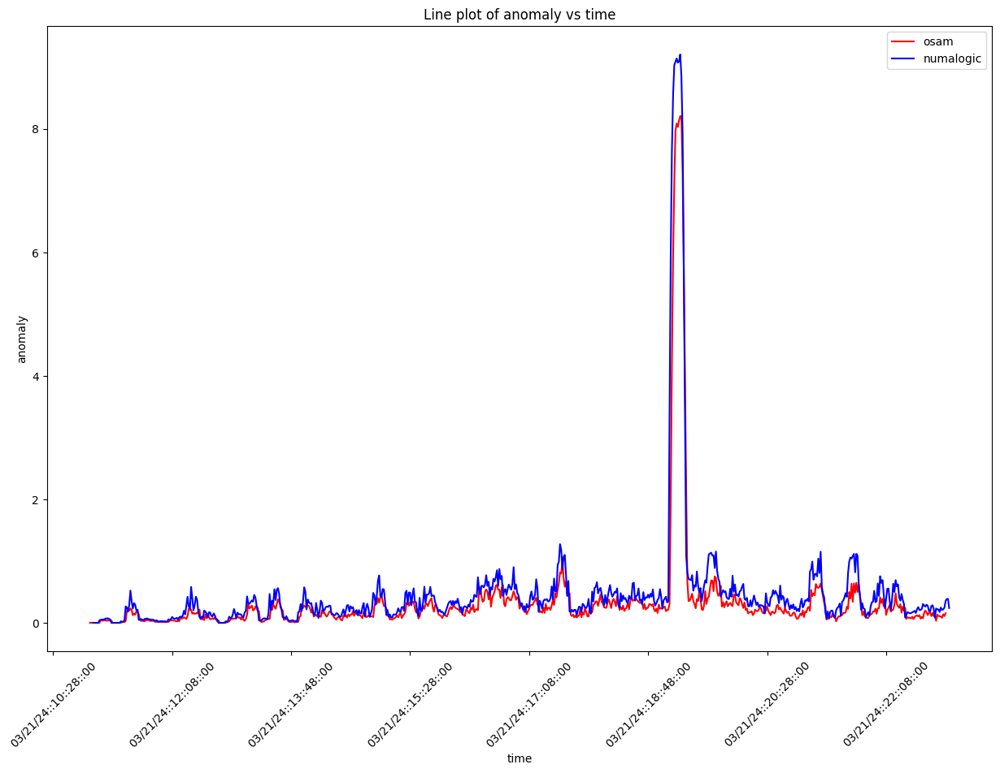

 23%|██▎       | 58/248 [02:51<09:03,  2.86s/it]

key:  fciPlugin:requestsFailed:5984175597303660107:crb-core
Anomaly tp for this graph from OSAM:  1
Anomaly tp for this graph from Numa:  1


 24%|██▍       | 59/248 [02:53<08:48,  2.80s/it]

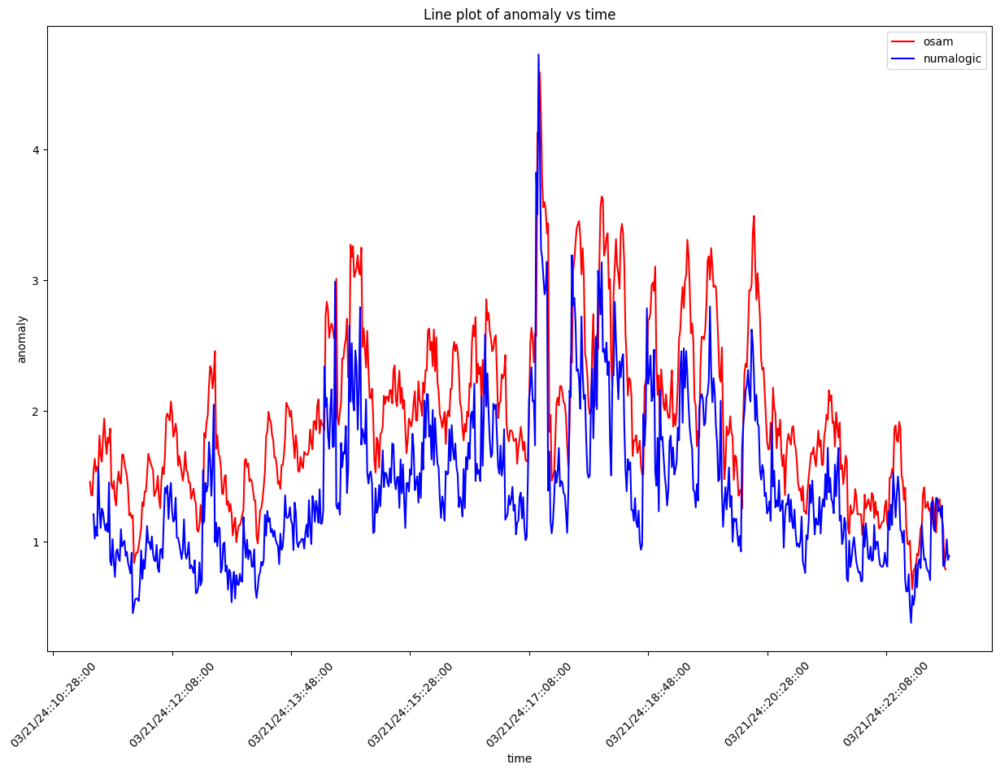

 24%|██▍       | 60/248 [02:56<08:53,  2.84s/it]

key:  fci:interactionsFailed:2091939619214868921:ShellABTestDelegateInitialize
Anomaly tp for this graph from OSAM:  9
Anomaly tp for this graph from Numa:  1


 25%|██▍       | 61/248 [02:59<08:33,  2.75s/it]

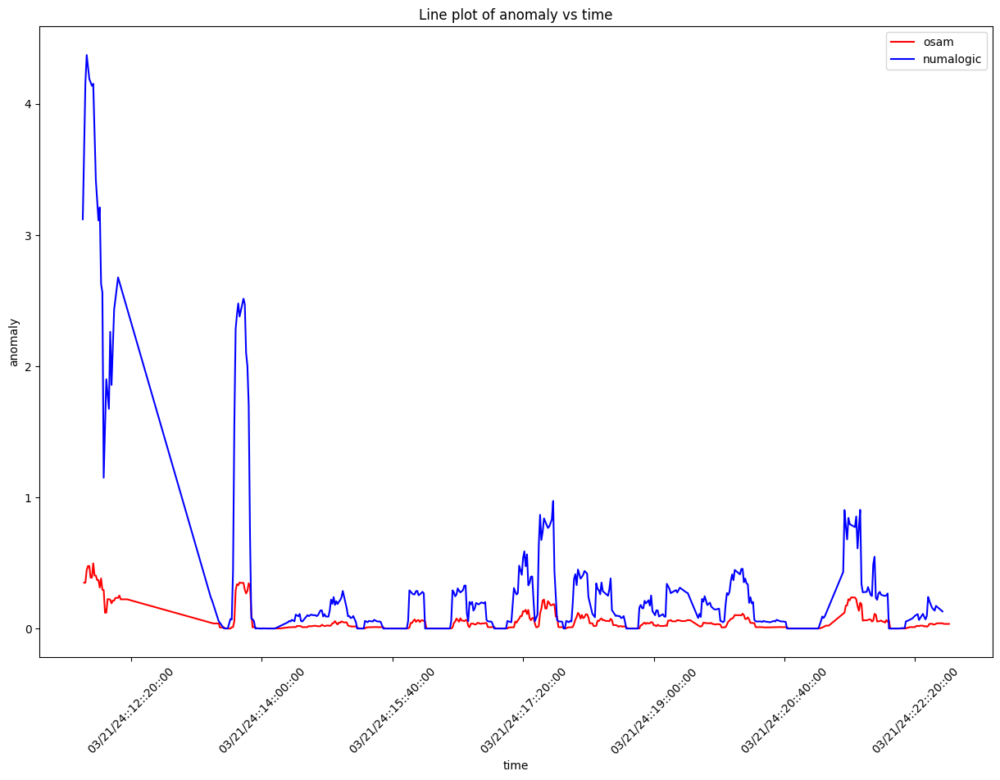

 25%|██▌       | 62/248 [03:02<08:41,  2.80s/it]

key:  fci:interactionsFailed:5984175597303660107:qba-workflow-ui.job_saveComplete
Anomaly tp for this graph from OSAM:  0
Anomaly tp for this graph from Numa:  1


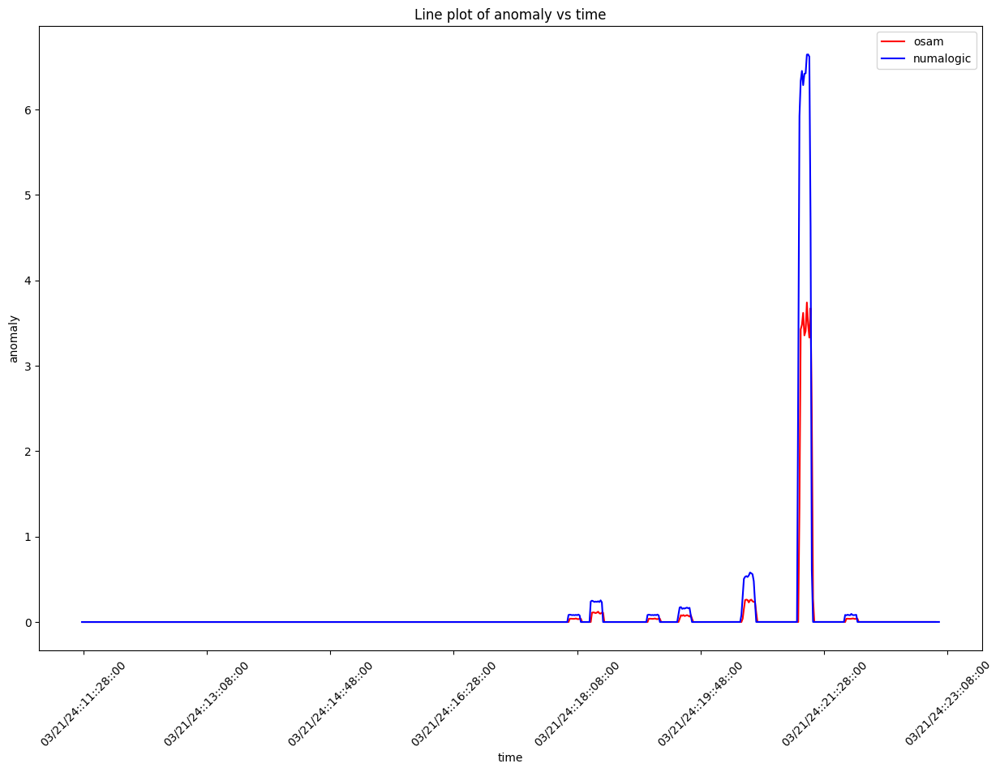

 25%|██▌       | 63/248 [03:04<08:32,  2.77s/it]

key:  fci:interactionsFailed:6344463568198587497:itsdeductible__homepage_data_loaded
Anomaly tp for this graph from OSAM:  1
Anomaly tp for this graph from Numa:  1


 26%|██▌       | 64/248 [03:07<08:15,  2.70s/it]

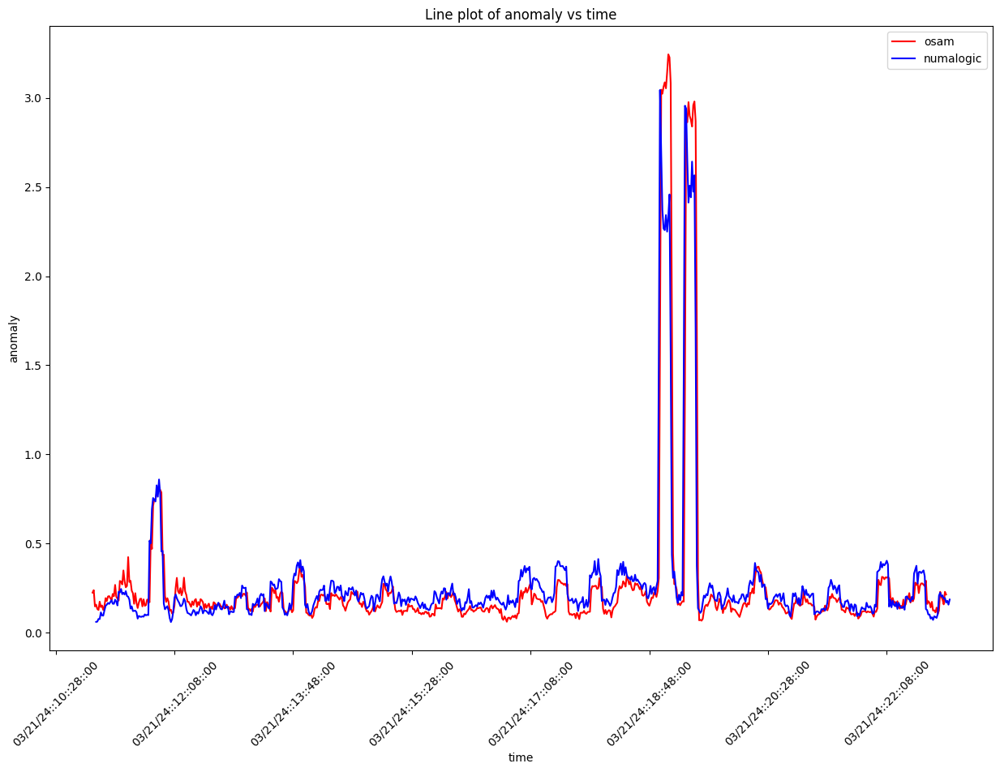

 26%|██▌       | 65/248 [03:10<08:14,  2.70s/it]

key:  fciPluginAppInteractions:metrics:2453353489468585843:5984175597303660107:accountsOnSearch
Anomaly tp for this graph from OSAM:  1
Anomaly tp for this graph from Numa:  0


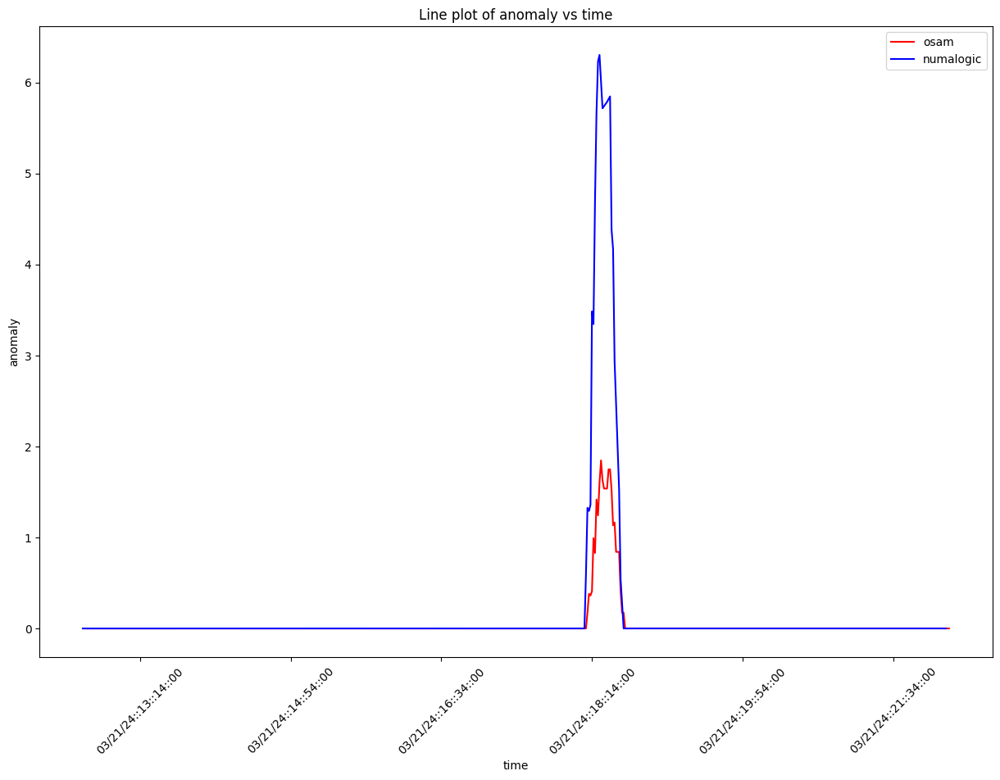

 27%|██▋       | 66/248 [03:12<08:14,  2.71s/it]

key:  fciPluginAsset:metricsFailed:8145903419052279917
Anomaly tp for this graph from OSAM:  0
Anomaly tp for this graph from Numa:  1


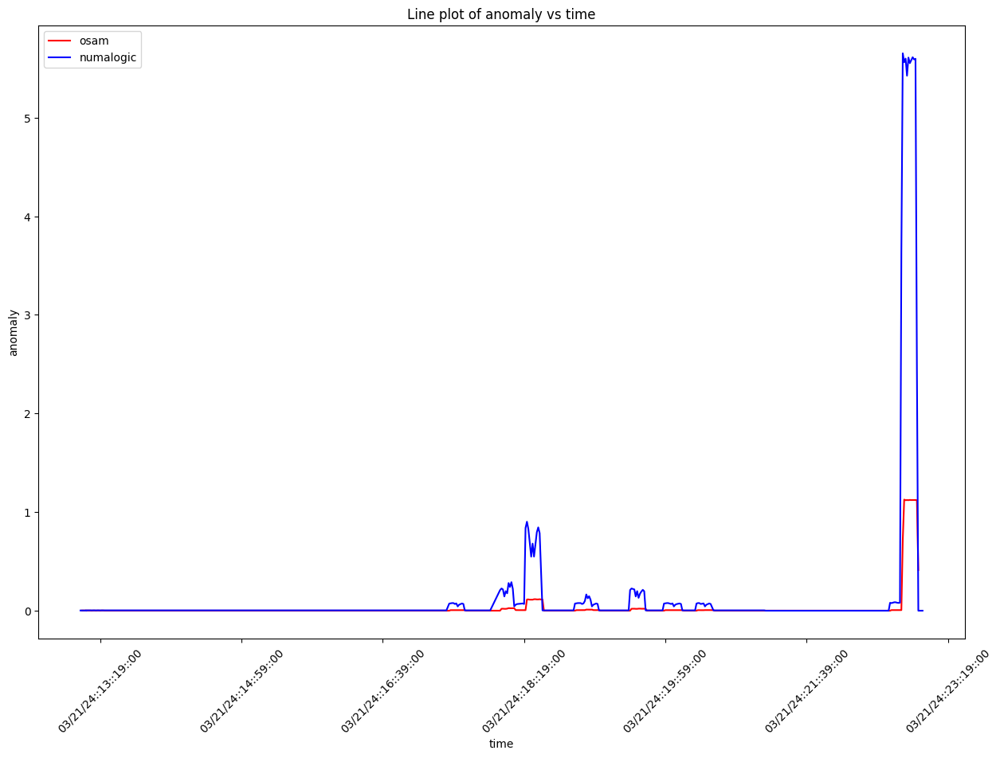

 27%|██▋       | 67/248 [03:16<09:19,  3.09s/it]

key:  fciAsset:assetFailed:8506191388536189707
Anomaly tp for this graph from OSAM:  0
Anomaly tp for this graph from Numa:  1


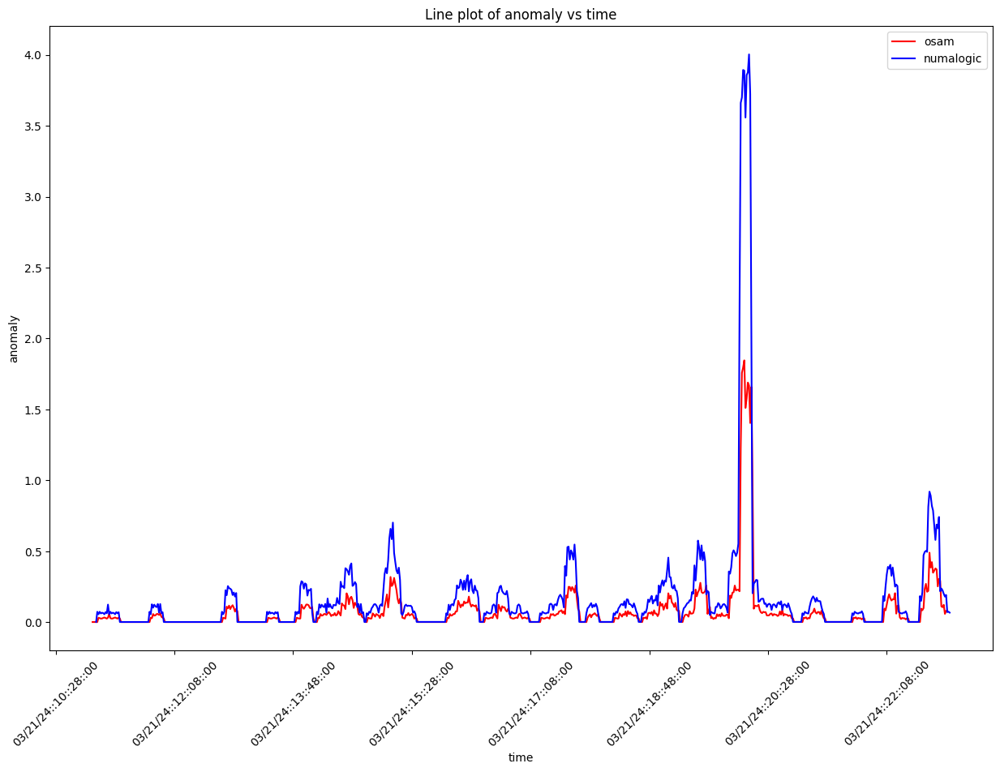

 27%|██▋       | 68/248 [03:20<09:26,  3.15s/it]

key:  fci:interactionsFailed:5984175597303660107:dcg_card_load
Anomaly tp for this graph from OSAM:  0
Anomaly tp for this graph from Numa:  1


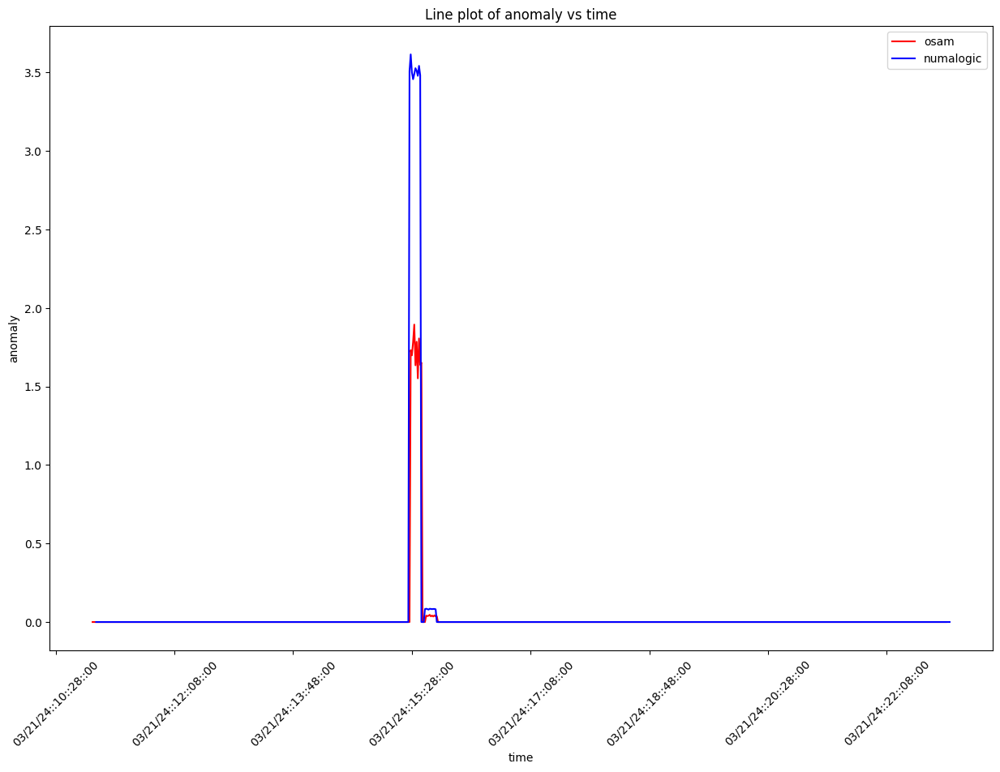

 28%|██▊       | 69/248 [03:23<09:05,  3.05s/it]

key:  fci:interactionsFailed:868086420502860411:Collab_Docmgmt_UI_Get_Folder_Metadata_By_Id_Elastic_Search
Anomaly tp for this graph from OSAM:  0
Anomaly tp for this graph from Numa:  1


 29%|██▊       | 71/248 [03:28<08:13,  2.79s/it]

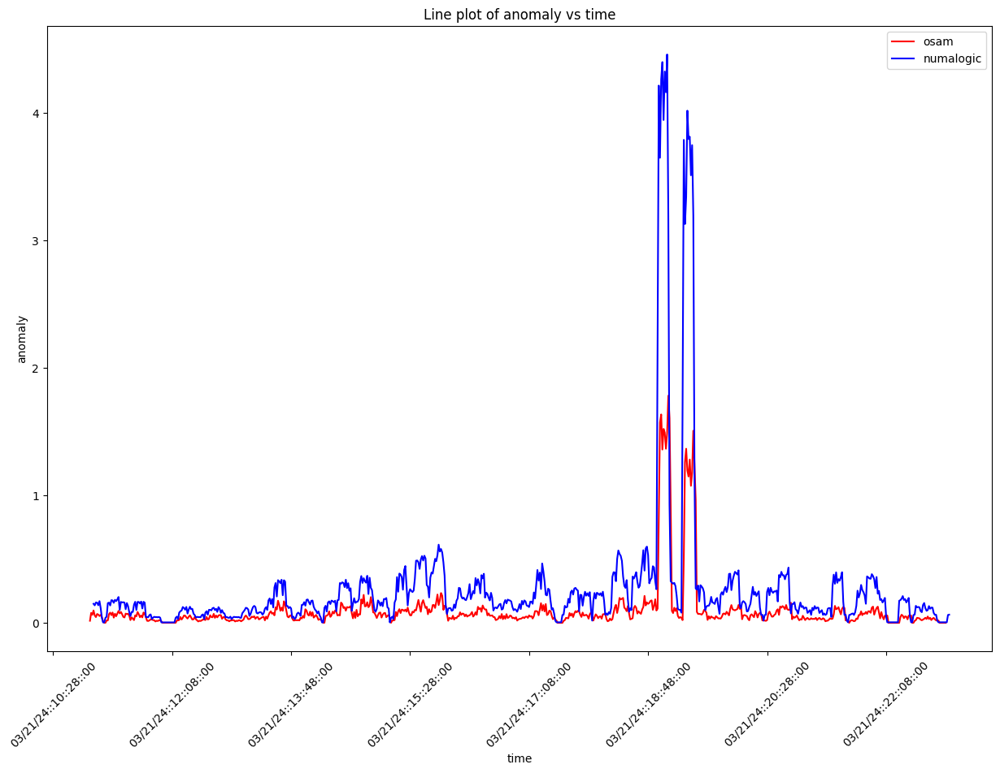

 29%|██▉       | 72/248 [03:31<08:16,  2.82s/it]

key:  fci:interactionsFailed:5984175597303660107:ceres_get_recent_transactions
Anomaly tp for this graph from OSAM:  0
Anomaly tp for this graph from Numa:  2


 29%|██▉       | 73/248 [03:33<08:01,  2.75s/it]

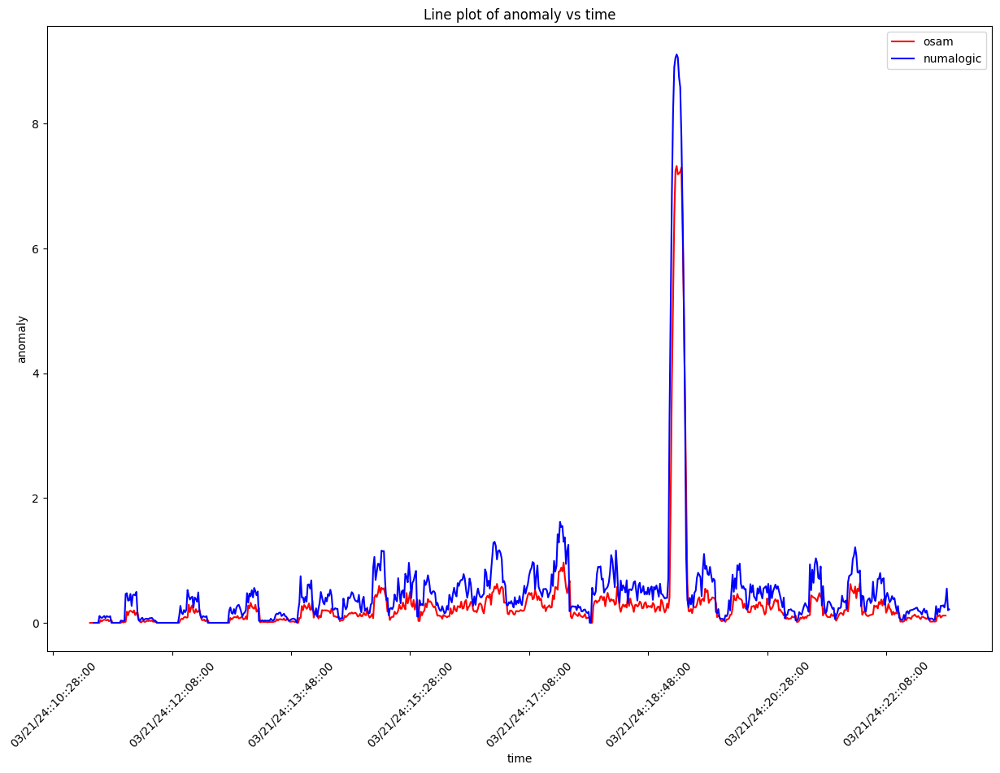

 30%|██▉       | 74/248 [03:36<08:05,  2.79s/it]

key:  fci:interactionsFailed:5984175597303660107:EXECUTE_PAGINATED_REPORT
Anomaly tp for this graph from OSAM:  1
Anomaly tp for this graph from Numa:  1


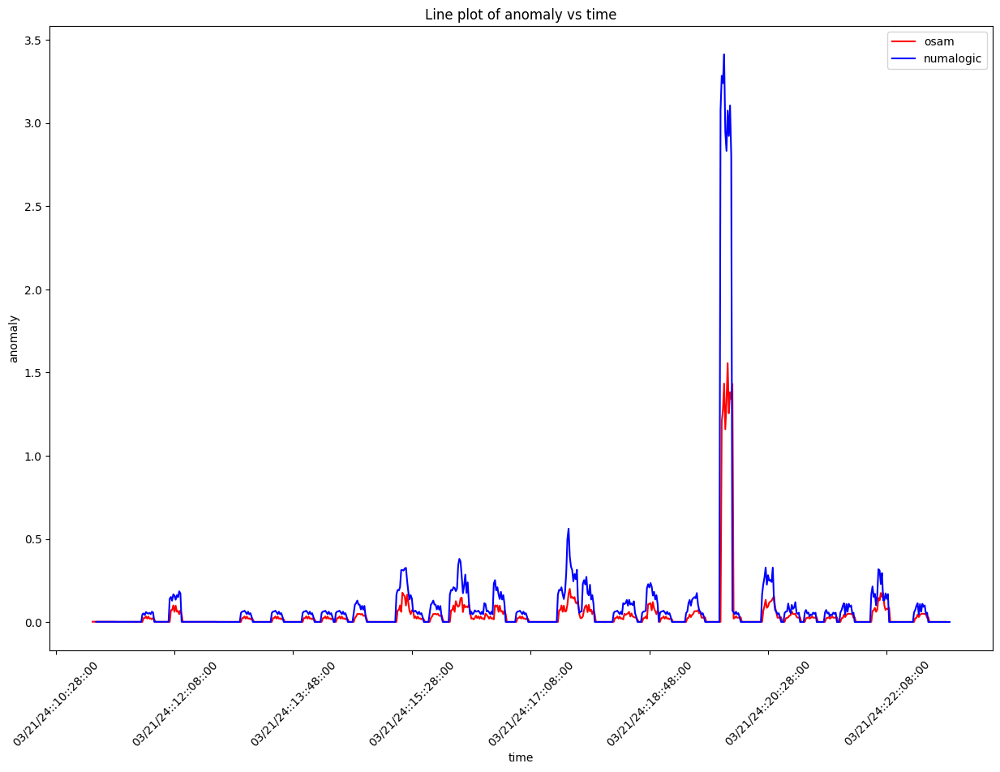

 30%|███       | 75/248 [03:39<07:59,  2.77s/it]

key:  fciPluginAppInteractions:metrics:5119484469024512735:4831254092648450521:personalinfo-taxpayer-entry-views-0.personalinfo.Next
Anomaly tp for this graph from OSAM:  0
Anomaly tp for this graph from Numa:  1


 31%|███       | 76/248 [03:41<07:37,  2.66s/it]

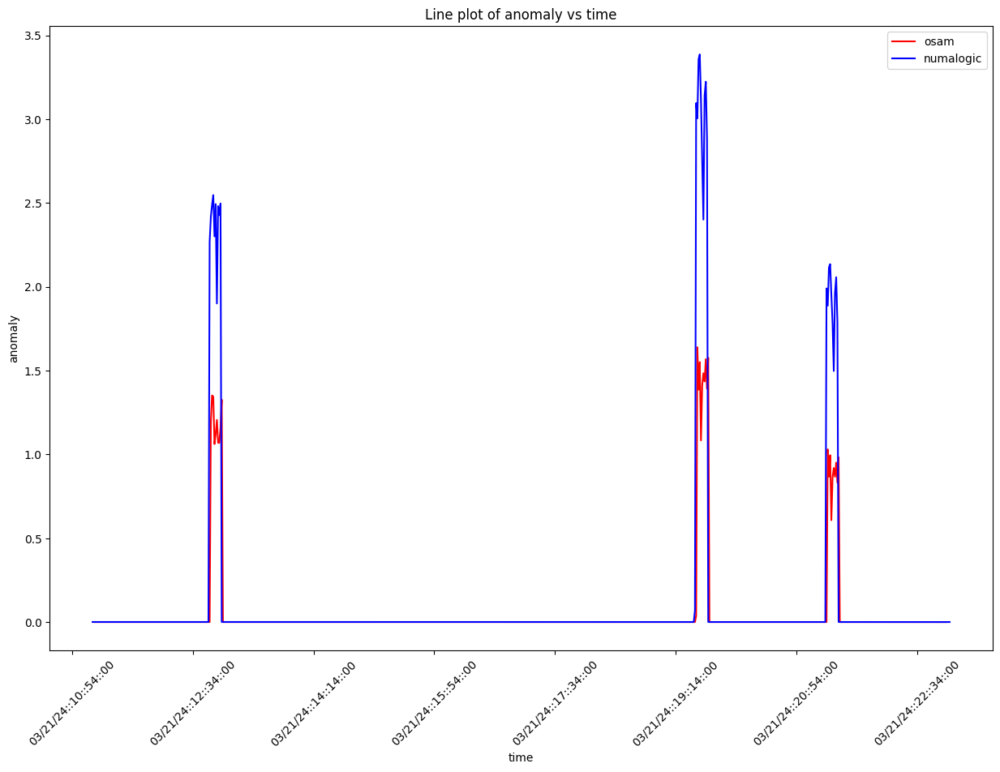

 31%|███       | 77/248 [03:44<07:41,  2.70s/it]

key:  fciPluginAsset:metricsFailed:5479772439188364105
Anomaly tp for this graph from OSAM:  0
Anomaly tp for this graph from Numa:  1


 31%|███▏      | 78/248 [03:47<07:38,  2.70s/it]

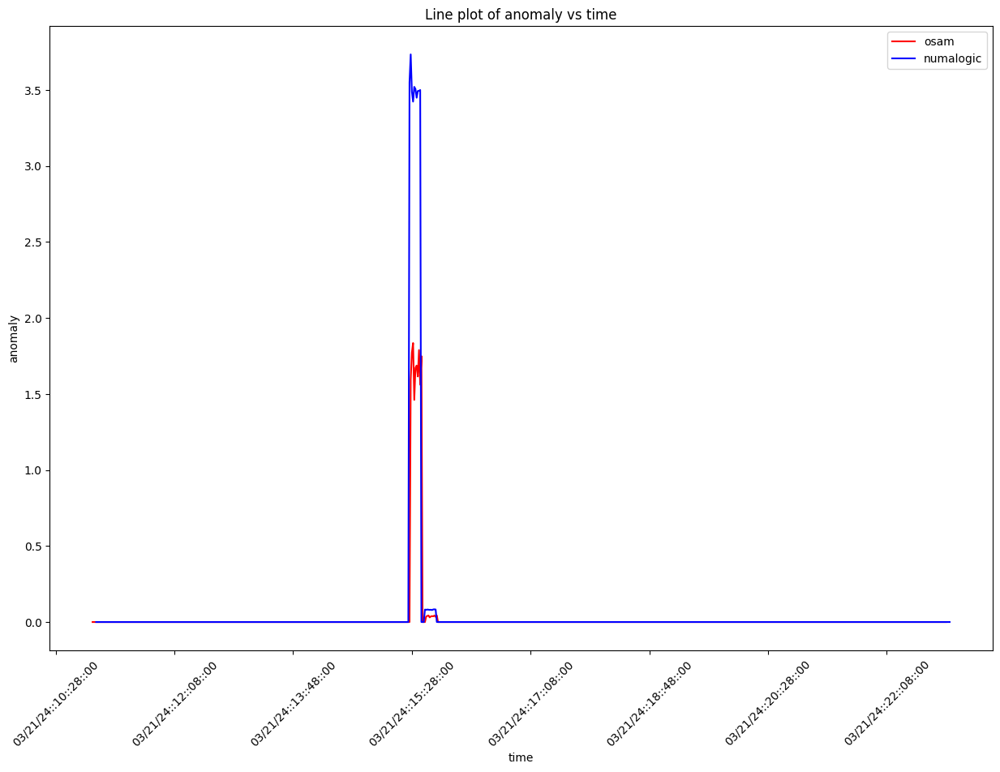

 32%|███▏      | 79/248 [03:49<07:36,  2.70s/it]

key:  fciPluginAppInteractions:metrics:8217961012385696693:868086420502860411:Collab_Docmgmt_UI_Get_Folder_Metadata_By_Id_Elastic_Search
Anomaly tp for this graph from OSAM:  0
Anomaly tp for this graph from Numa:  1


 32%|███▏      | 80/248 [03:52<07:20,  2.62s/it]

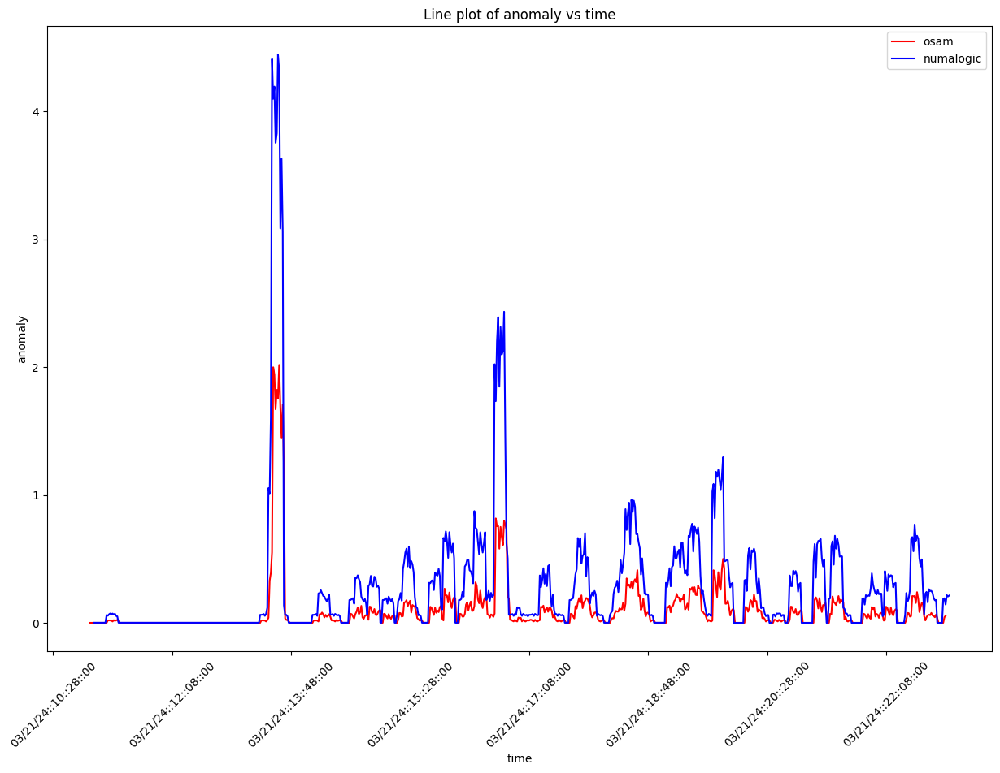

 33%|███▎      | 81/248 [03:54<07:21,  2.64s/it]

key:  fci:interactionsFailed:5984175597303660107:qbaa.fai.bankconnections-ui.ProcessOfxFileCall
Anomaly tp for this graph from OSAM:  0
Anomaly tp for this graph from Numa:  1


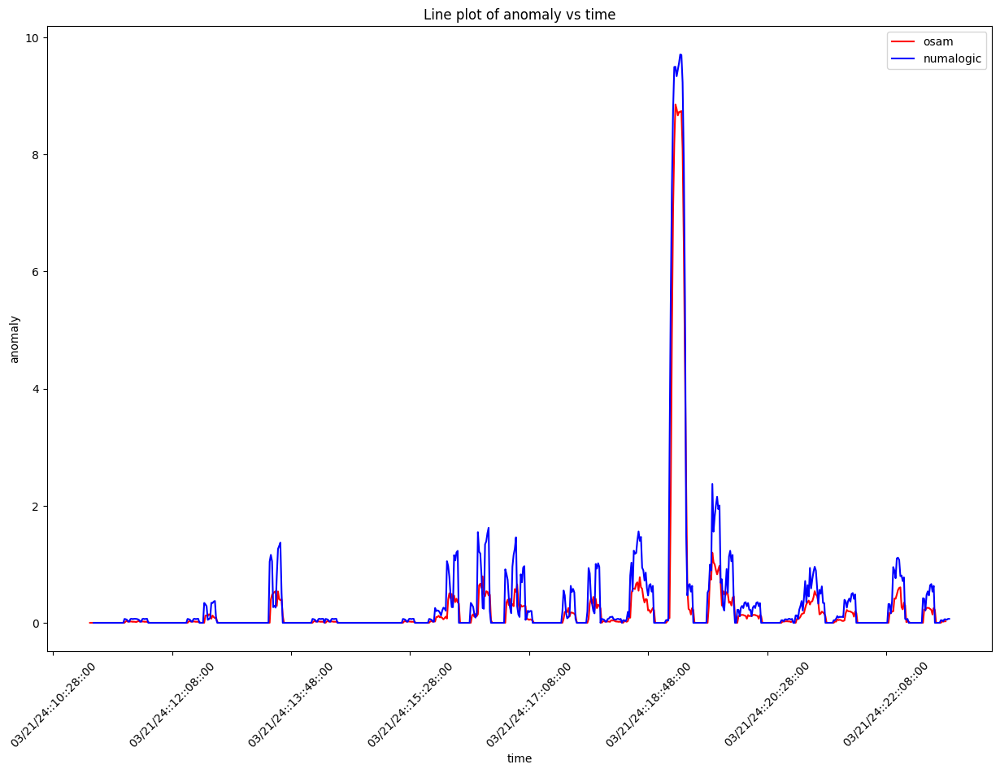

 33%|███▎      | 82/248 [03:57<07:23,  2.67s/it]

key:  fciPluginInteractions:metrics:3750390182735137211:DRILLDOWN_REPORT_FETCH
Anomaly tp for this graph from OSAM:  1
Anomaly tp for this graph from Numa:  1


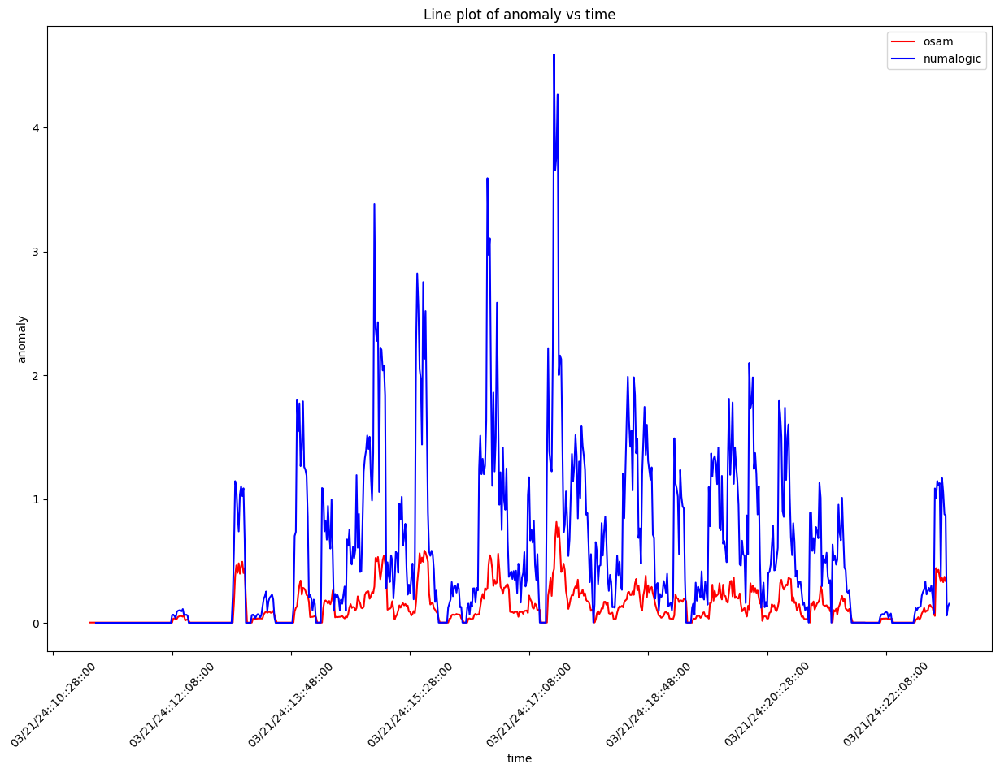

 33%|███▎      | 83/248 [04:00<07:23,  2.69s/it]

key:  fci:interactionsFailed:8938536952929487393:search_widget_autosuggest_load
Anomaly tp for this graph from OSAM:  0
Anomaly tp for this graph from Numa:  1


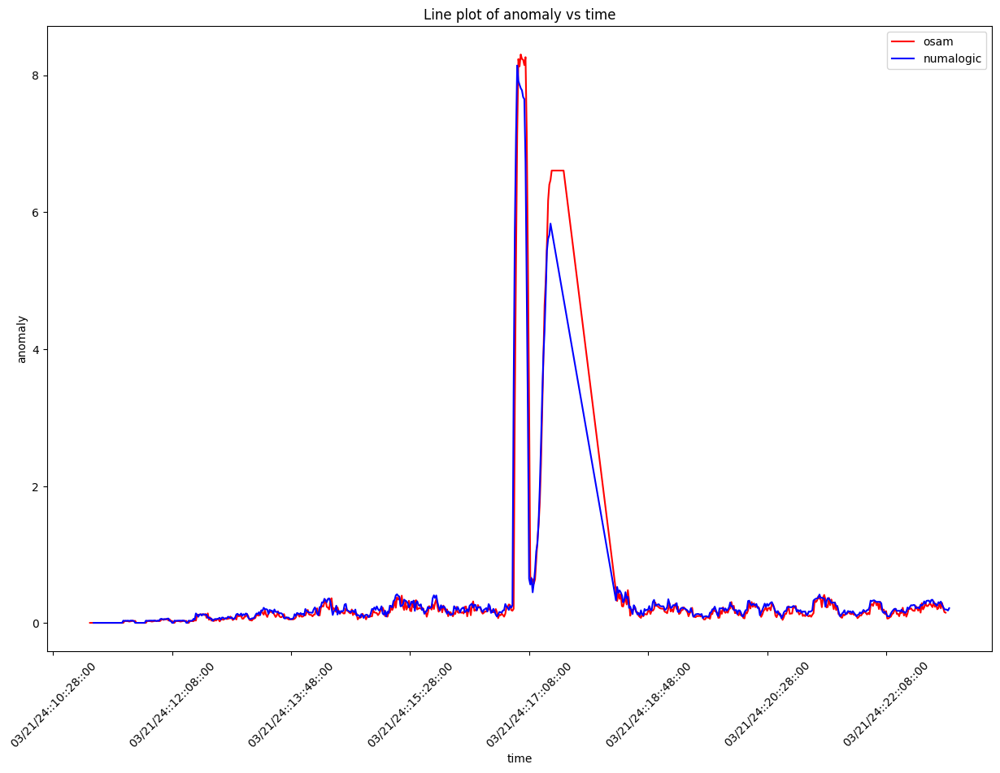

 34%|███▍      | 84/248 [04:03<07:29,  2.74s/it]

key:  fciPluginInteractions:metrics:579856044409078427:GenAi Explanations
Anomaly tp for this graph from OSAM:  2
Anomaly tp for this graph from Numa:  2


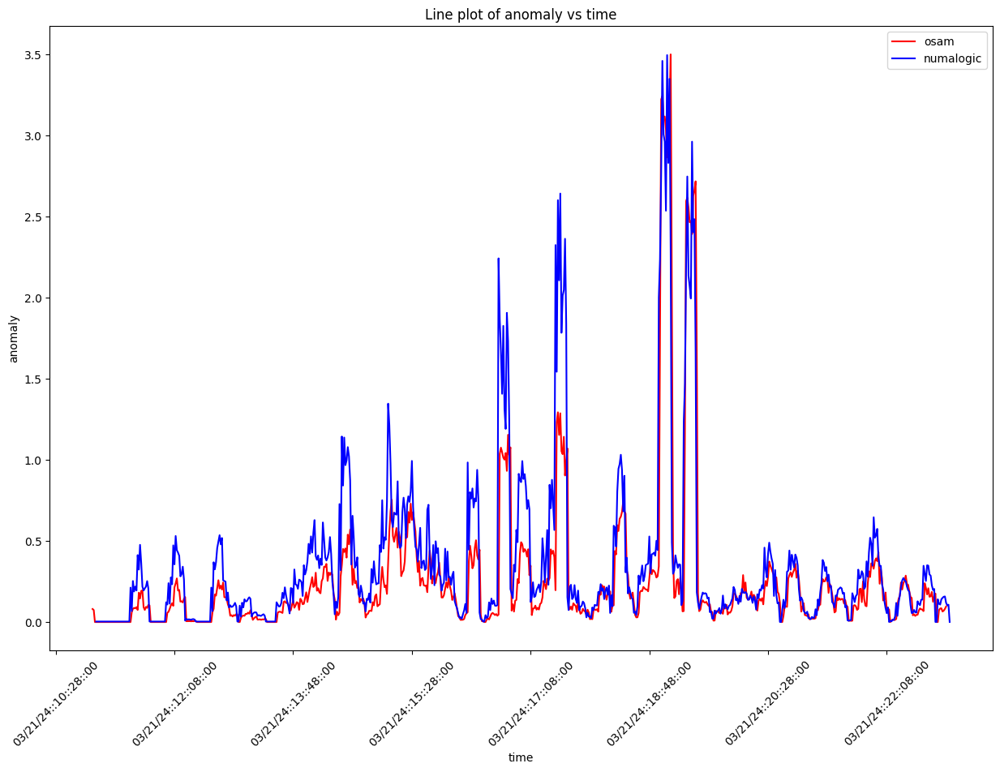

 34%|███▍      | 85/248 [04:06<07:27,  2.75s/it]

key:  fciPluginInteractions:metrics:2453353489468585843:klassOnSearch
Anomaly tp for this graph from OSAM:  2
Anomaly tp for this graph from Numa:  0


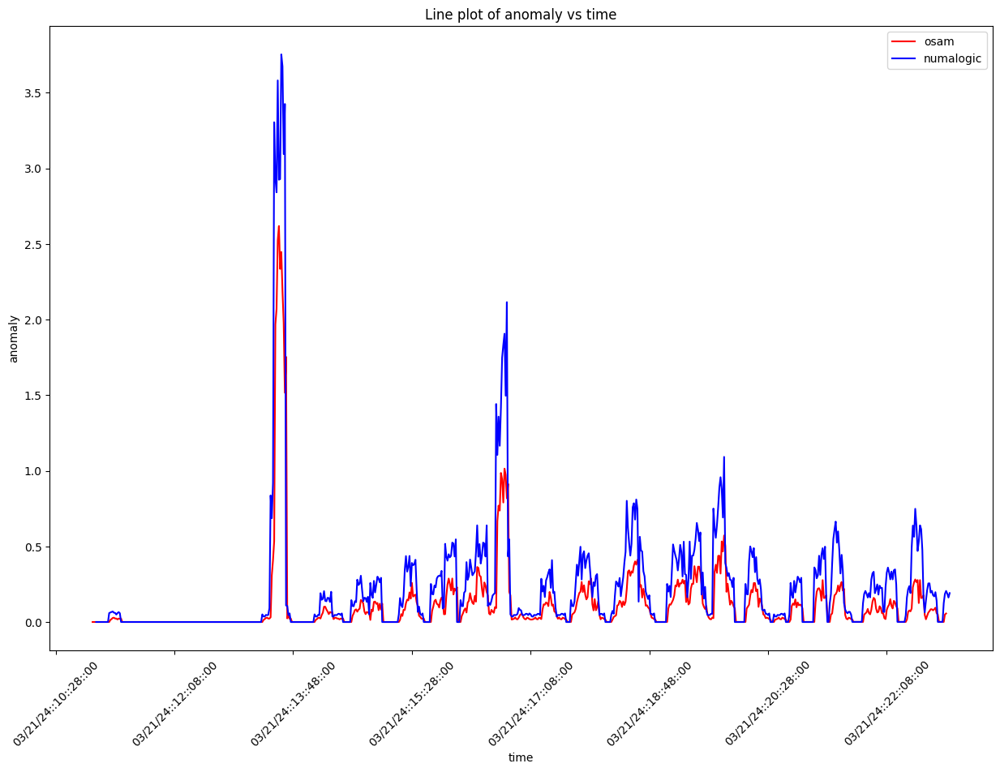

 35%|███▍      | 86/248 [04:08<07:23,  2.74s/it]

key:  fciPluginAppInteractions:metrics:3678332588046106875:5984175597303660107:qbaa.fai.bankconnections-ui.ProcessOfxFile
Anomaly tp for this graph from OSAM:  0
Anomaly tp for this graph from Numa:  1


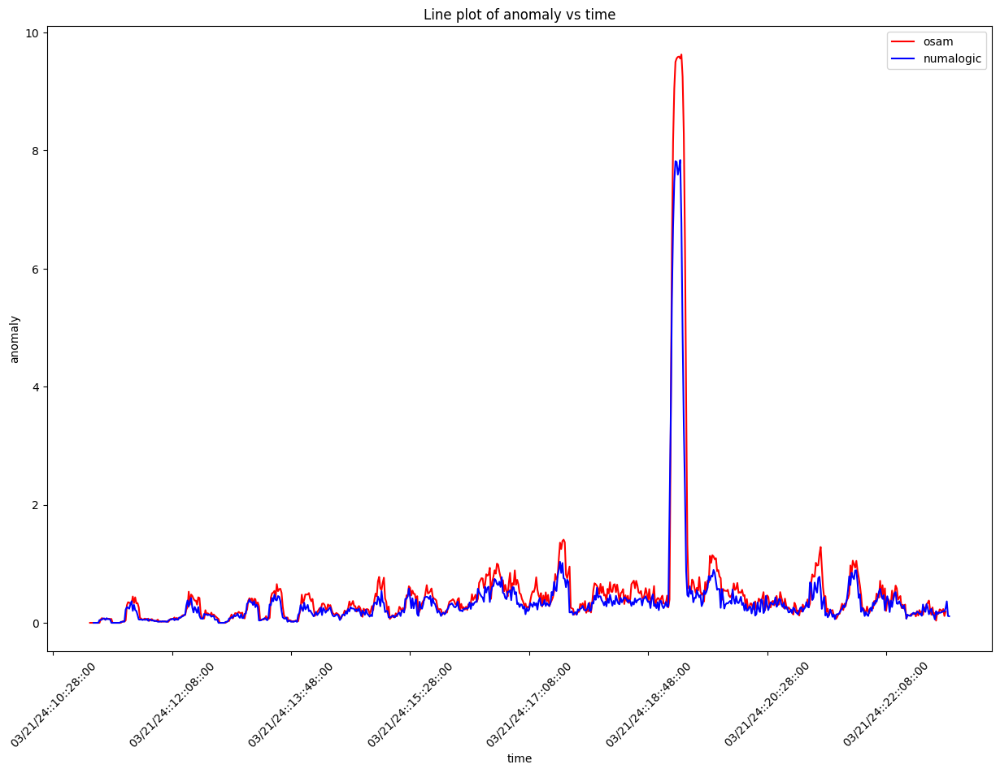

 35%|███▌      | 87/248 [04:11<07:22,  2.75s/it]

key:  fciPluginAsset:metricsFailed:3750390182735137211
Anomaly tp for this graph from OSAM:  1
Anomaly tp for this graph from Numa:  1


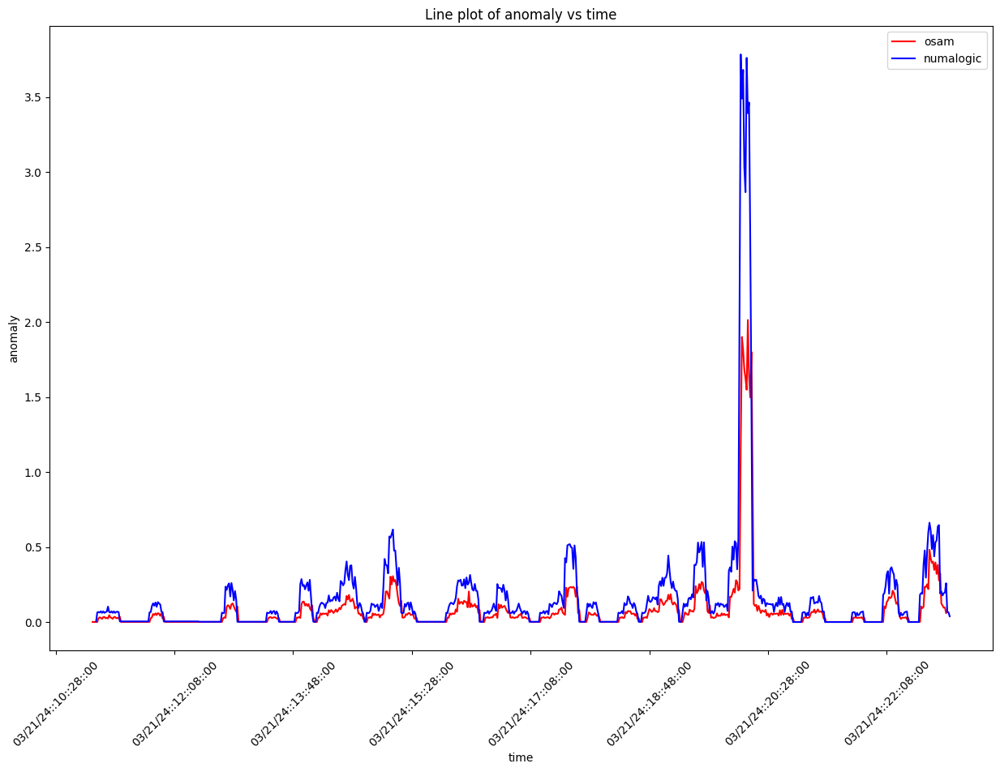

 35%|███▌      | 88/248 [04:14<07:21,  2.76s/it]

key:  fciPluginAppInteractions:metrics:7785615448133772557:5984175597303660107:dcg_card_load
Anomaly tp for this graph from OSAM:  0
Anomaly tp for this graph from Numa:  2


 36%|███▋      | 90/248 [04:19<06:47,  2.58s/it]

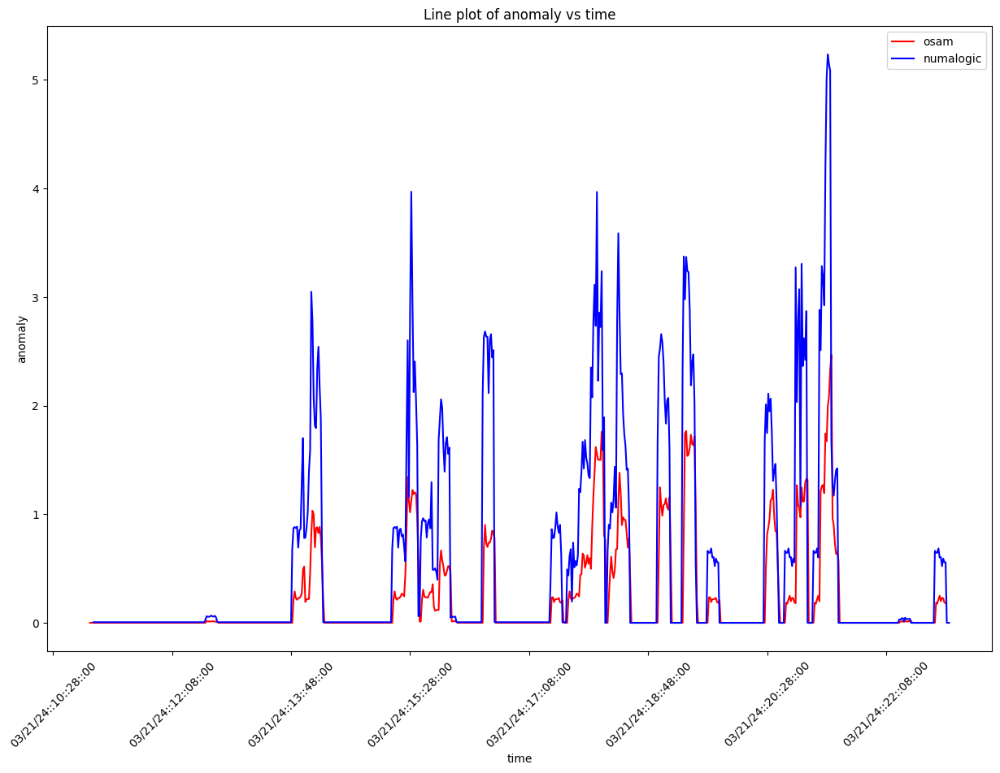

 37%|███▋      | 91/248 [04:21<06:52,  2.63s/it]

key:  fciPluginAppInteractions:metrics:2453353489468585843:5984175597303660107:cachedContactOnSearch
Anomaly tp for this graph from OSAM:  0
Anomaly tp for this graph from Numa:  2


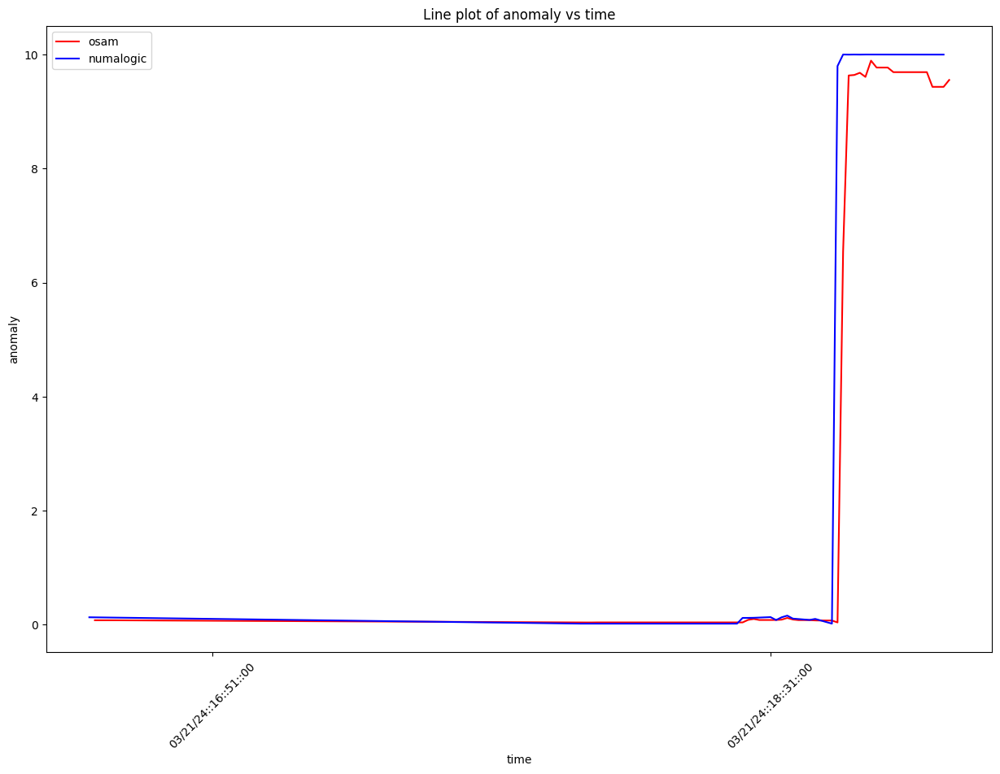

 37%|███▋      | 92/248 [04:24<07:06,  2.73s/it]

key:  fciPluginAsset:metricsFailed:2021007925287075287
Anomaly tp for this graph from OSAM:  2
Anomaly tp for this graph from Numa:  0


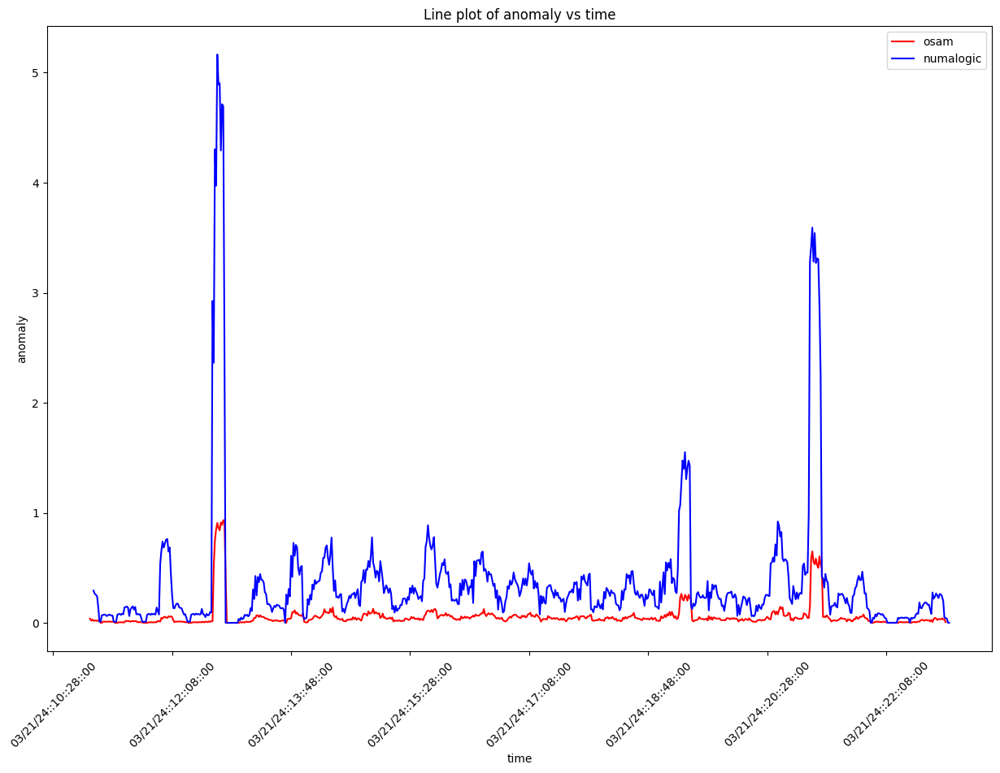

 38%|███▊      | 93/248 [04:27<07:00,  2.71s/it]

key:  fci:interactionsFailed:5984175597303660107:qbaa.fai.reconcile-ui.getStatementsStatus
Anomaly tp for this graph from OSAM:  0
Anomaly tp for this graph from Numa:  2


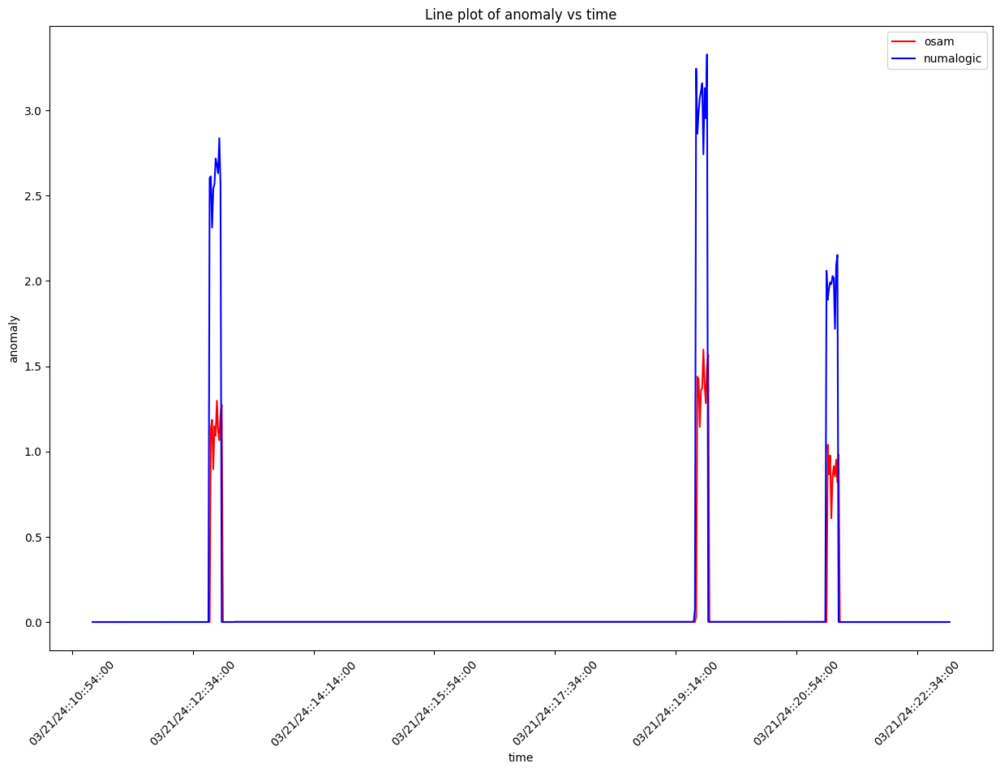

 38%|███▊      | 94/248 [04:30<07:02,  2.74s/it]

key:  fciPluginInteractions:metrics:5479772439188364105:EXPERT_SEARCH_INTERACTION
Anomaly tp for this graph from OSAM:  0
Anomaly tp for this graph from Numa:  1


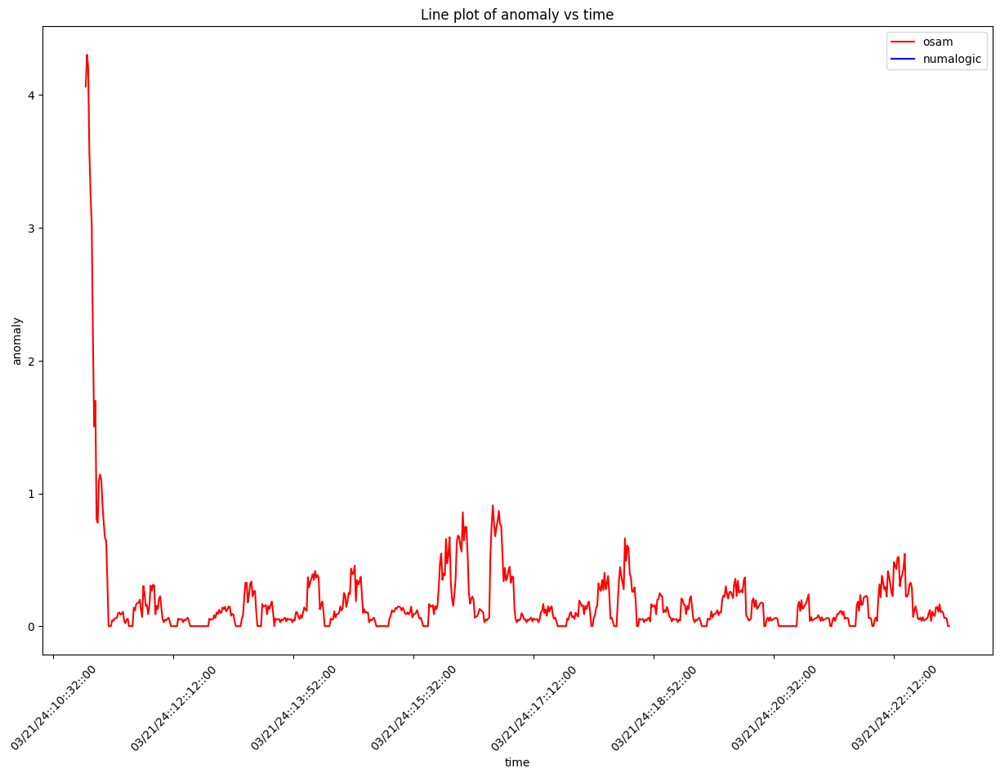

 38%|███▊      | 95/248 [04:33<07:01,  2.76s/it]

key:  fciPluginAsset:metricsFailedAEV2:435740856470293685
Anomaly tp for this graph from OSAM:  1
Anomaly tp for this graph from Numa:  0


 39%|███▉      | 97/248 [04:37<06:31,  2.59s/it]

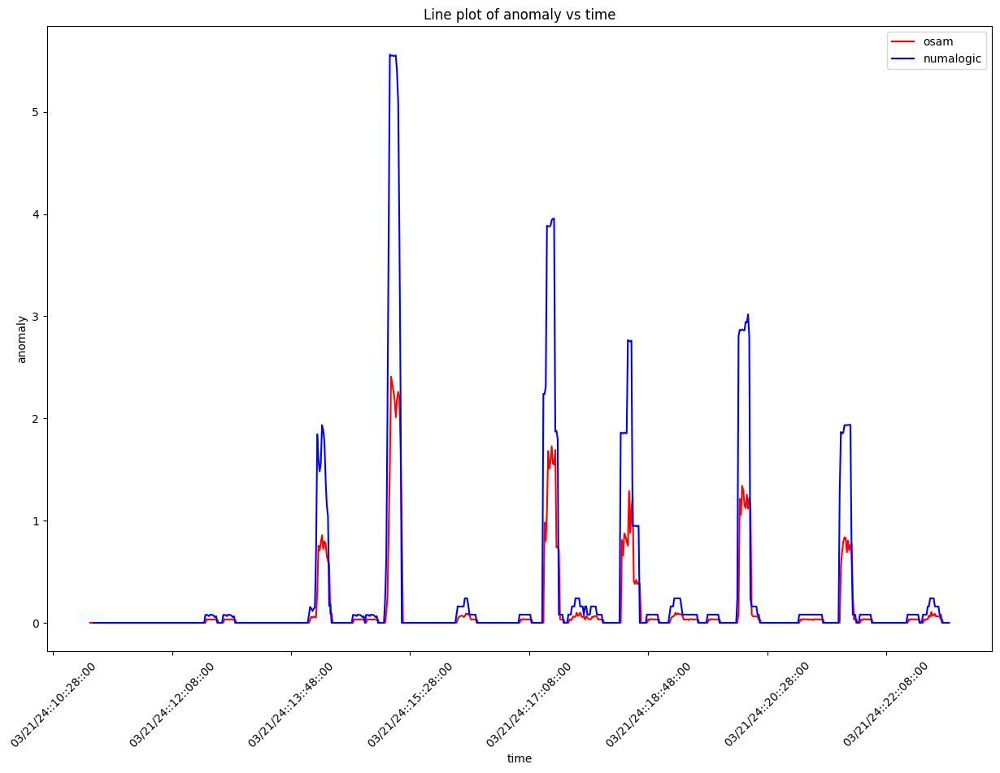

 40%|███▉      | 98/248 [04:40<06:34,  2.63s/it]

key:  fciPluginInteractions:metrics:7785615448133772557:assign_pay_schedule
Anomaly tp for this graph from OSAM:  0
Anomaly tp for this graph from Numa:  2


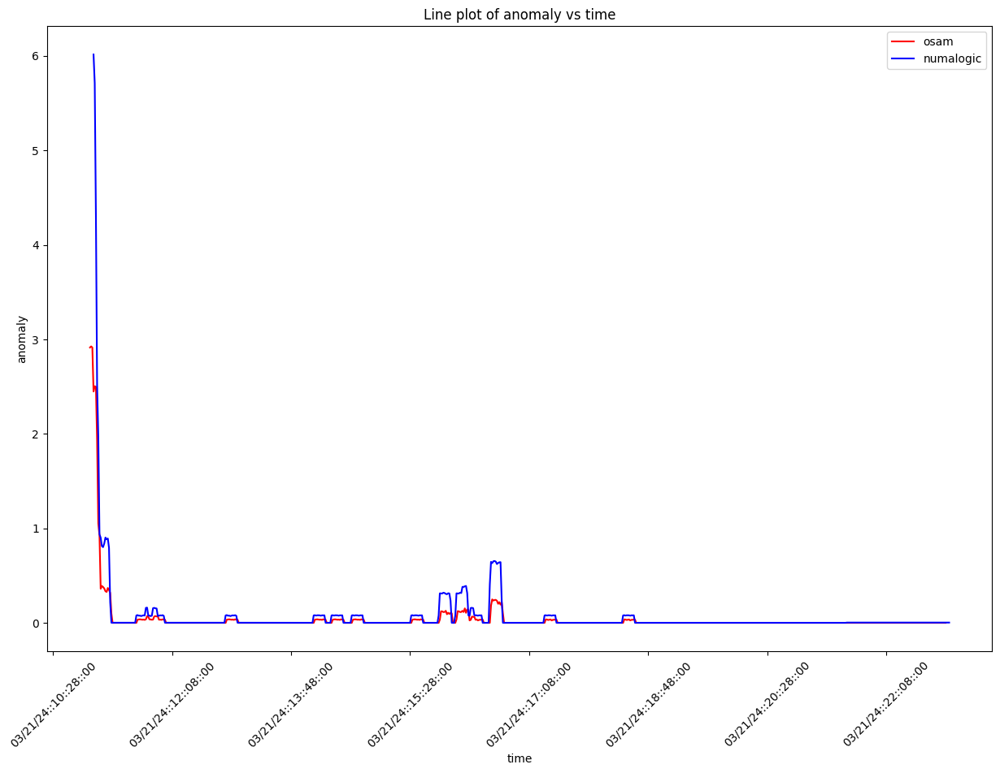

 40%|███▉      | 99/248 [04:43<06:32,  2.63s/it]

key:  fciPluginAppInteractions:metrics:435740856470293685:5984175597303660107:TemplatePrefSaveInteraction
Anomaly tp for this graph from OSAM:  0
Anomaly tp for this graph from Numa:  1


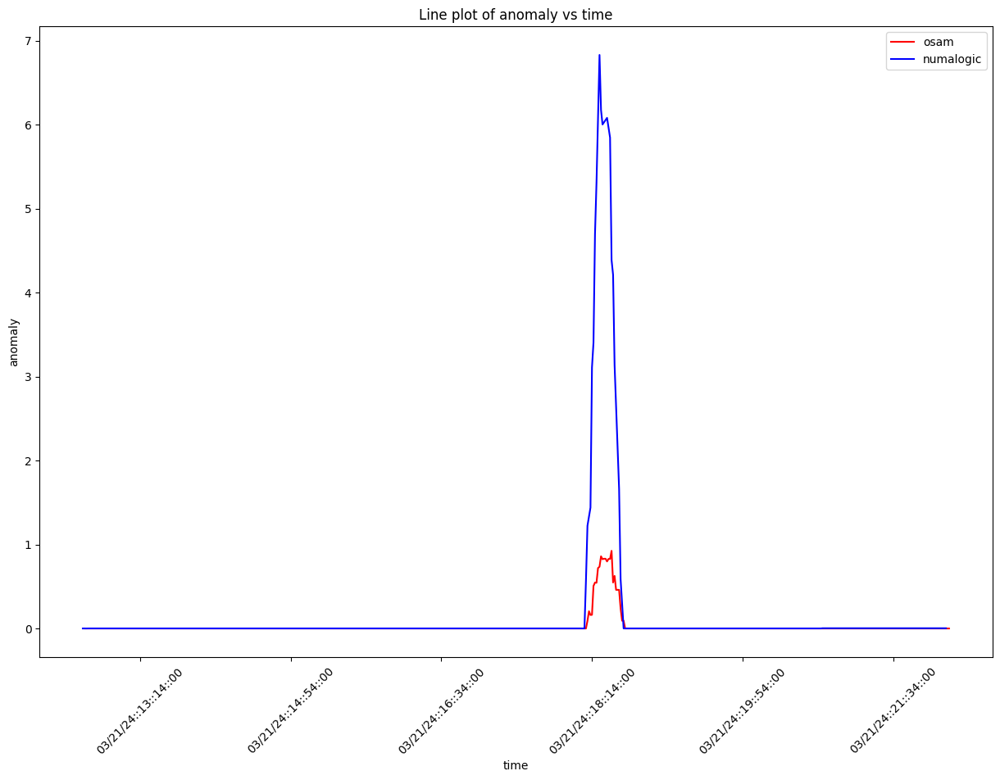

 40%|████      | 100/248 [04:46<06:32,  2.65s/it]

key:  fciPlugin:requestsFailed:5984175597303660107:batch-transactions-ui
Anomaly tp for this graph from OSAM:  0
Anomaly tp for this graph from Numa:  1


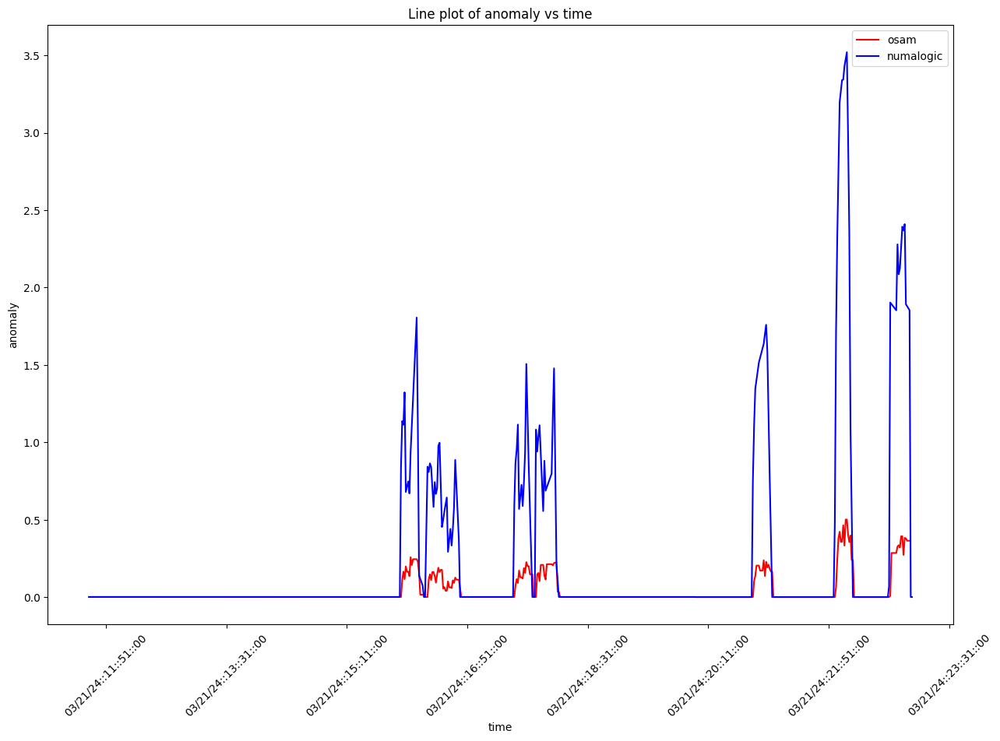

 41%|████      | 101/248 [04:48<06:34,  2.68s/it]

key:  fci:interactionsFailed:5477520638979968238:player_topic_gamblingwinningsandlosses
Anomaly tp for this graph from OSAM:  0
Anomaly tp for this graph from Numa:  1


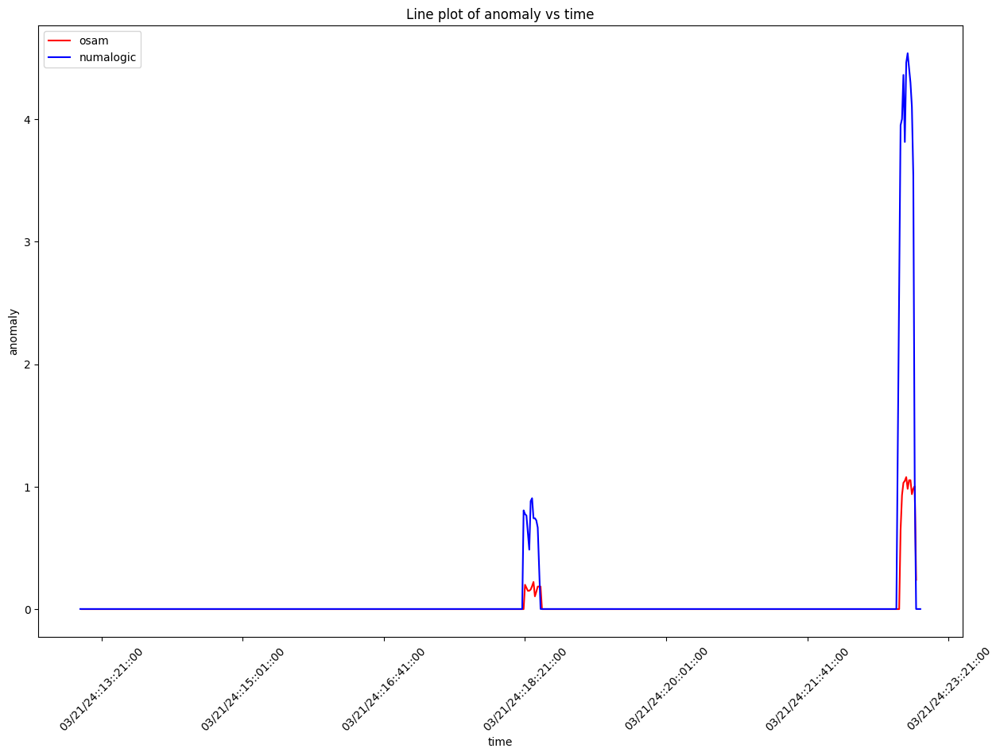

 41%|████      | 102/248 [04:51<06:34,  2.70s/it]

key:  fciPluginAppInteractions:metrics:3101871836022059397:8506191388536189707:search_widget_autosuggest_load
Anomaly tp for this graph from OSAM:  0
Anomaly tp for this graph from Numa:  1


 42%|████▏     | 103/248 [04:54<06:28,  2.68s/it]

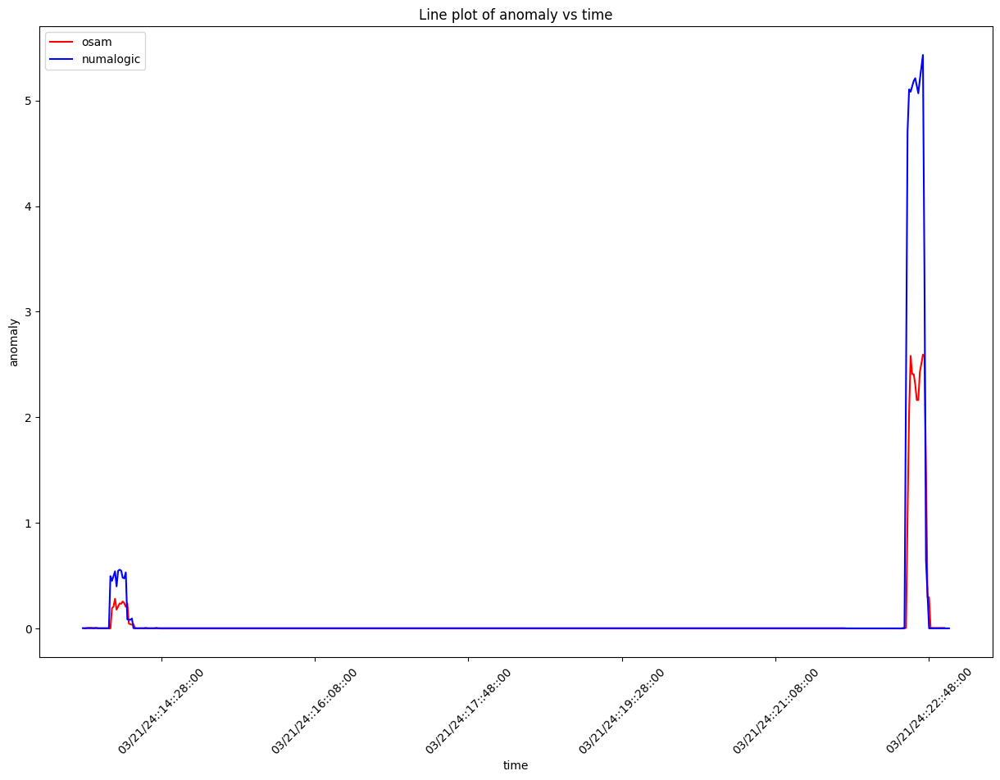

 42%|████▏     | 104/248 [04:56<06:25,  2.68s/it]

key:  fciPluginAppInteractions:metrics:3966562964805320729:868086420502860411:Customer_info_gathering_Update_Specification
Anomaly tp for this graph from OSAM:  0
Anomaly tp for this graph from Numa:  1


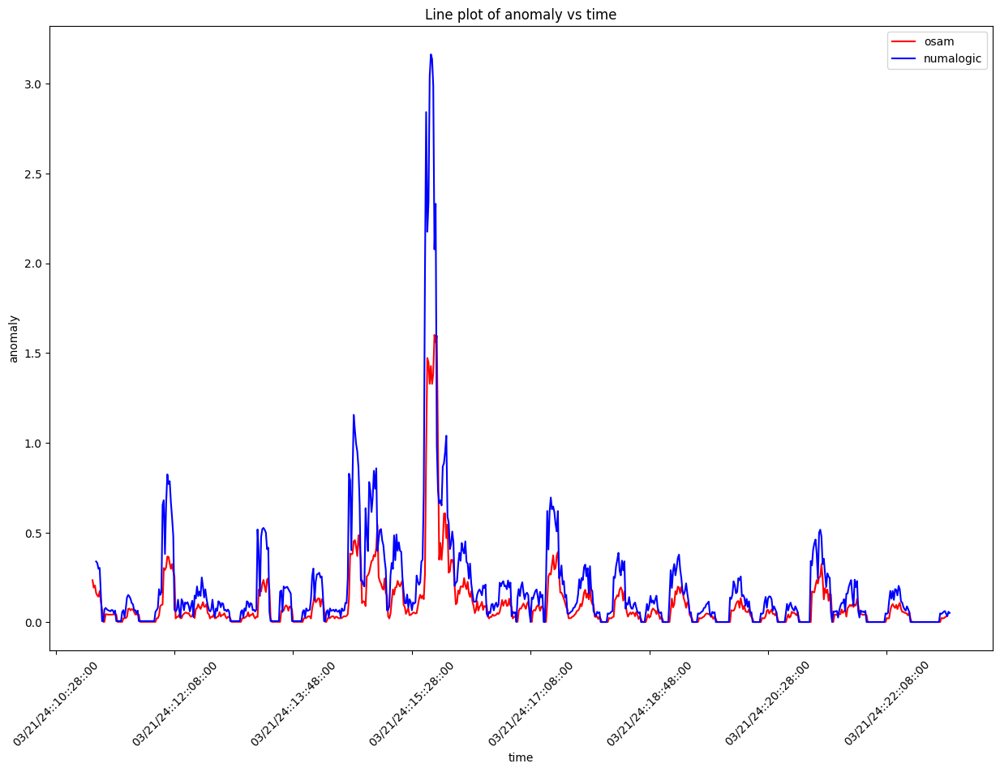

 42%|████▏     | 105/248 [04:59<06:24,  2.69s/it]

key:  fciPluginAppInteractions:metrics:3244861123818975982:5984175597303660107:qbaa.fai.reconcile-ui.getStatementsFromDocumentService
Anomaly tp for this graph from OSAM:  0
Anomaly tp for this graph from Numa:  1


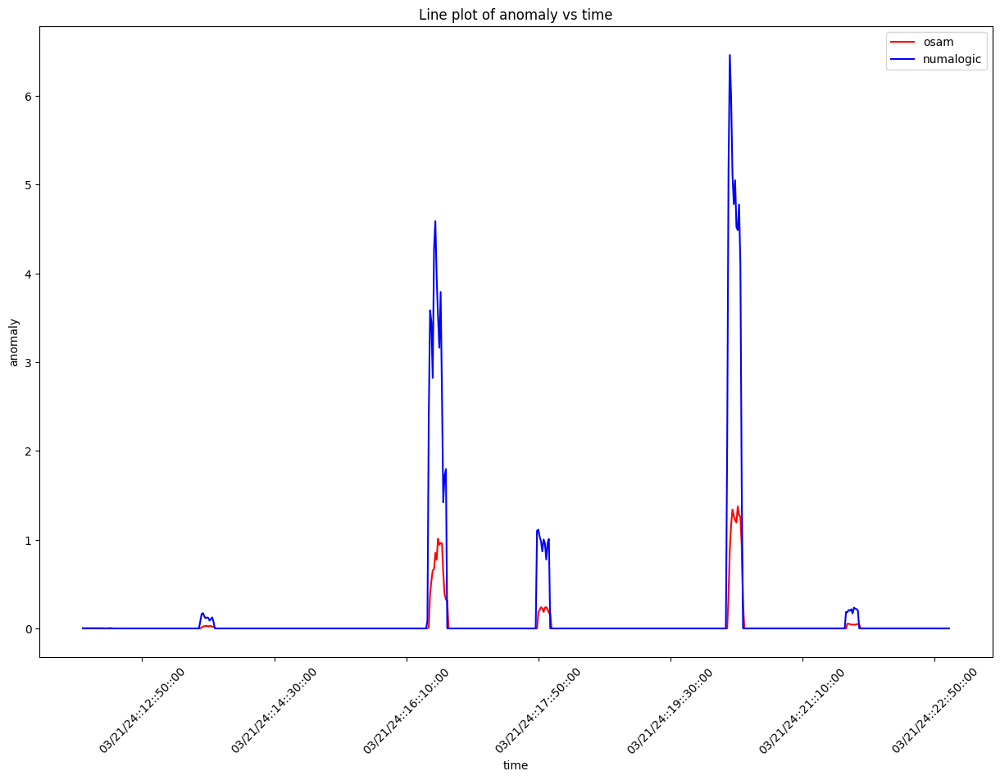

 43%|████▎     | 106/248 [05:02<06:21,  2.69s/it]

key:  fci:interactionsFailed:868086420502860411:get-smart-compose-prediction
Anomaly tp for this graph from OSAM:  0
Anomaly tp for this graph from Numa:  2


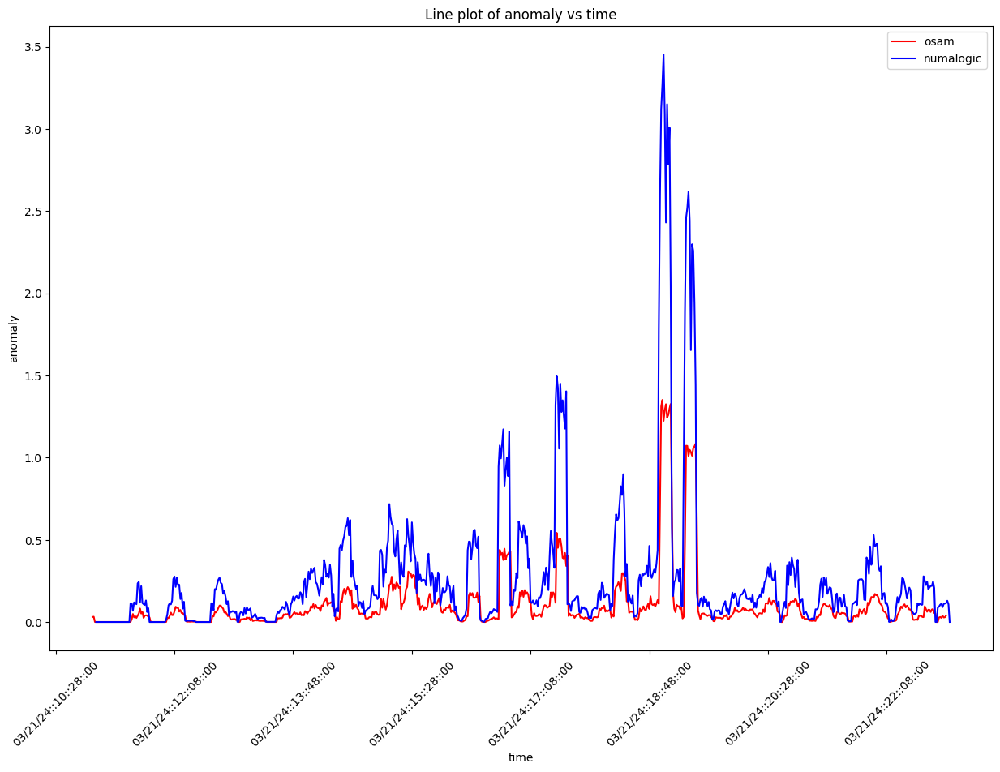

 43%|████▎     | 107/248 [05:04<06:20,  2.70s/it]

key:  fci:interactionsFailed:5984175597303660107:klassOnSearch
Anomaly tp for this graph from OSAM:  0
Anomaly tp for this graph from Numa:  1


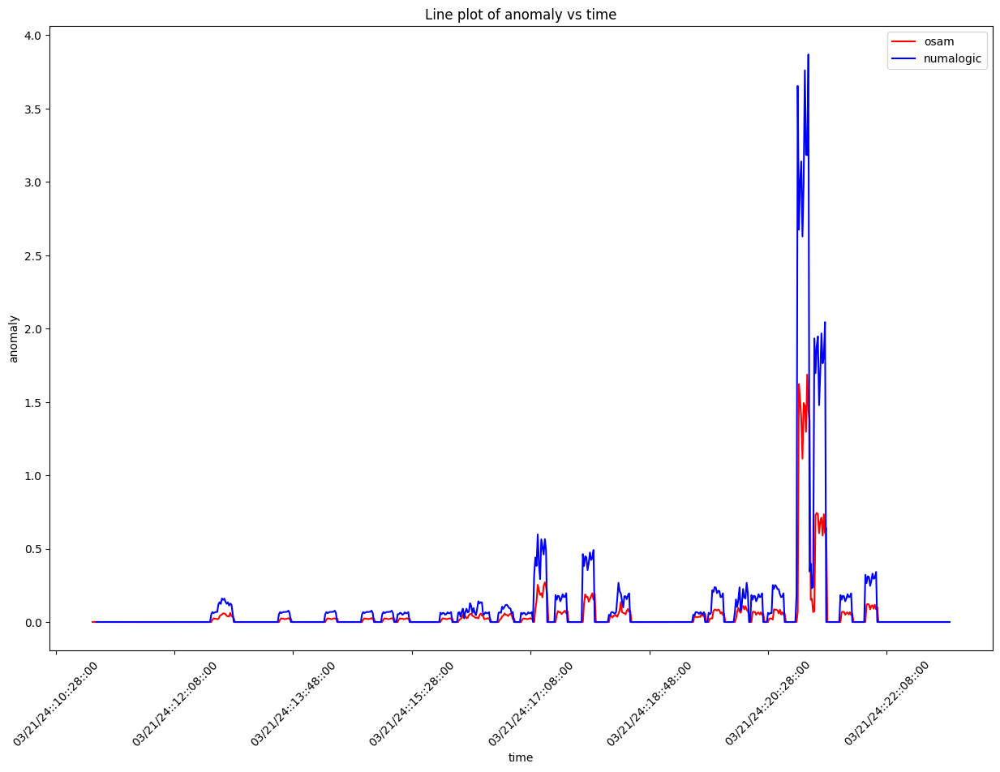

 44%|████▎     | 108/248 [05:07<06:18,  2.70s/it]

key:  fciPluginAppInteractions:metrics:3244861123818975982:5984175597303660107:qbaa.fai.reconcile-ui.getReconTxnList
Anomaly tp for this graph from OSAM:  0
Anomaly tp for this graph from Numa:  1


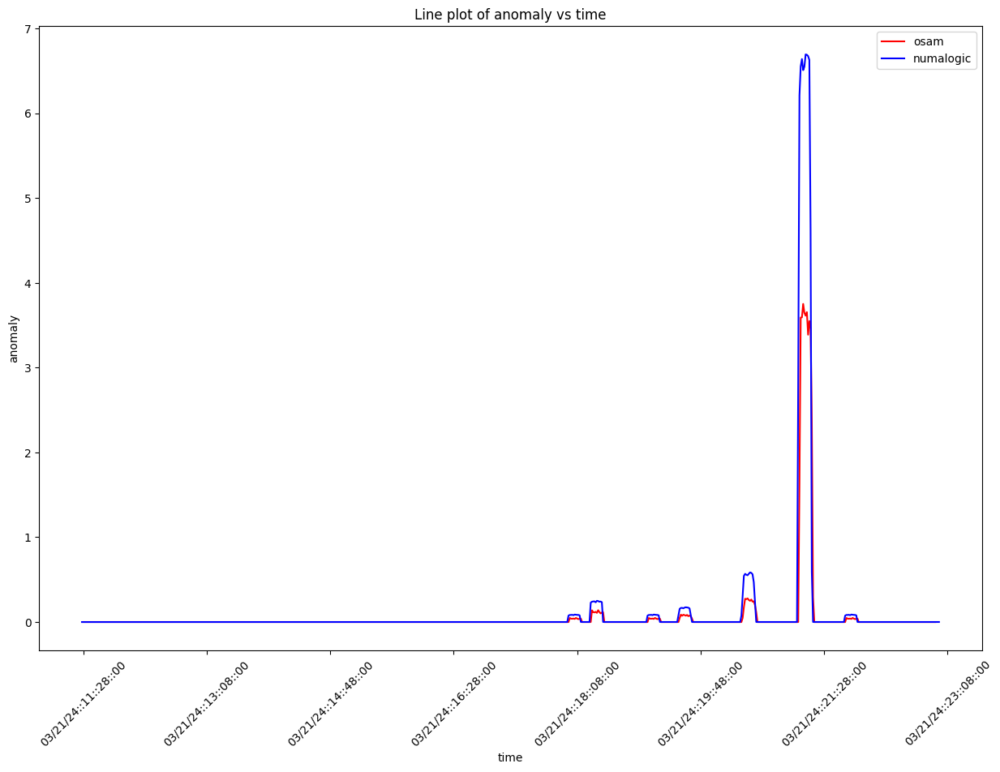

 44%|████▍     | 109/248 [05:10<06:14,  2.70s/it]

key:  fciPluginAppInteractions:metrics:5551830033781551331:6344463568198587497:itsdeductible__homepage_data_loaded
Anomaly tp for this graph from OSAM:  1
Anomaly tp for this graph from Numa:  1


 44%|████▍     | 110/248 [05:12<06:02,  2.62s/it]

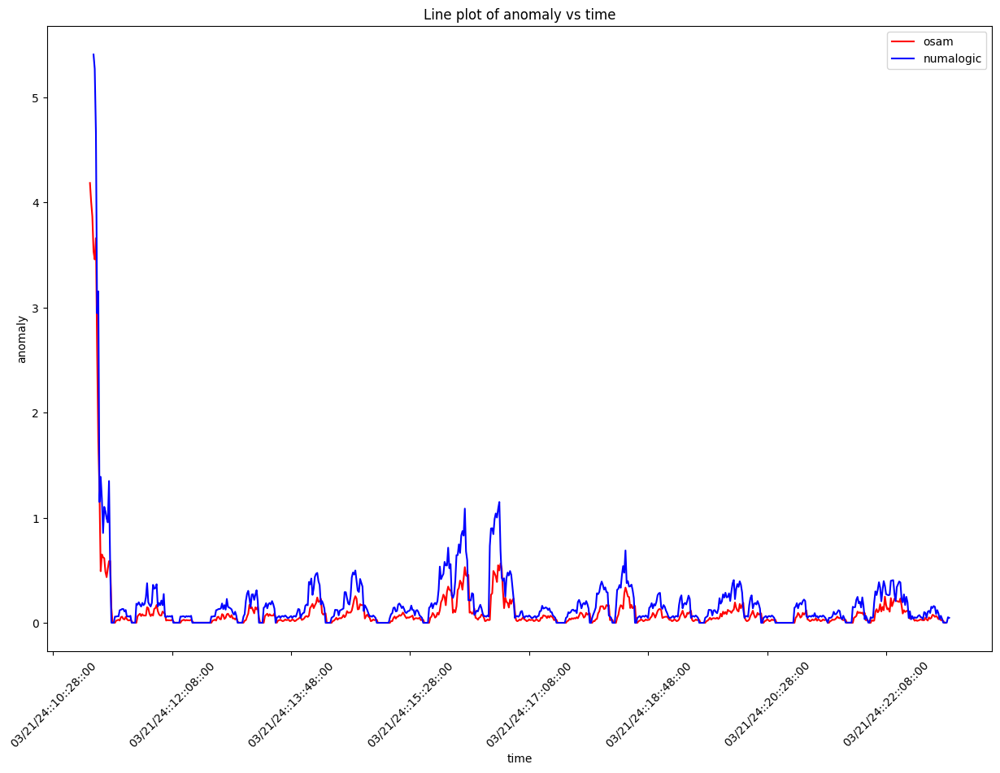

 45%|████▍     | 111/248 [05:15<06:03,  2.65s/it]

key:  fciPluginAsset:metricsFailed:435740856470293685
Anomaly tp for this graph from OSAM:  1
Anomaly tp for this graph from Numa:  1


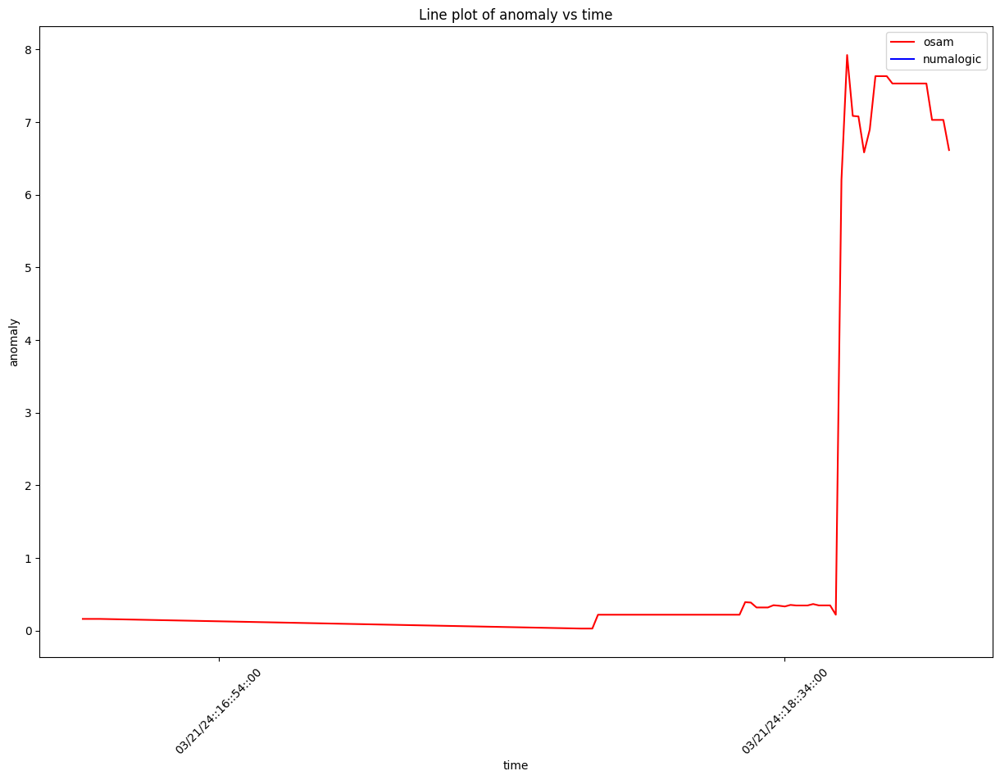

 45%|████▌     | 112/248 [05:18<05:59,  2.64s/it]

key:  fciPluginAsset:metricsFailedAEV2:2021007925287075287
Anomaly tp for this graph from OSAM:  1
Anomaly tp for this graph from Numa:  0


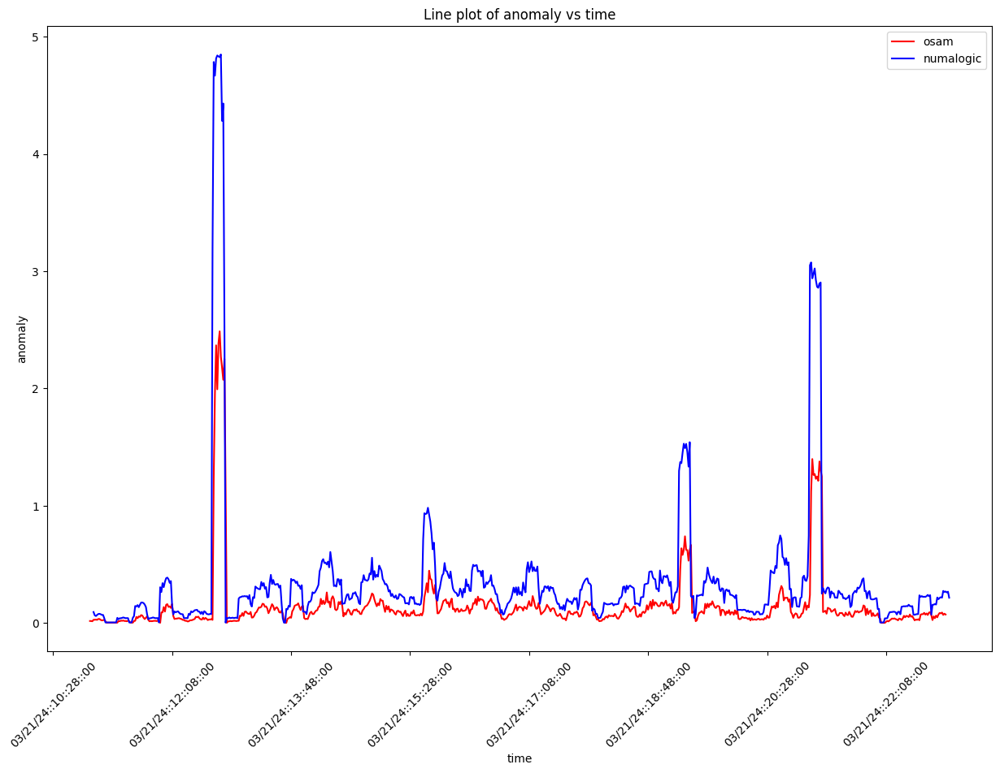

 46%|████▌     | 113/248 [05:20<06:01,  2.68s/it]

key:  fciPluginAppInteractions:metrics:3244861123818975982:5984175597303660107:qbaa.fai.reconcile-ui.IntiStatements
Anomaly tp for this graph from OSAM:  0
Anomaly tp for this graph from Numa:  1


 46%|████▌     | 114/248 [05:23<06:12,  2.78s/it]

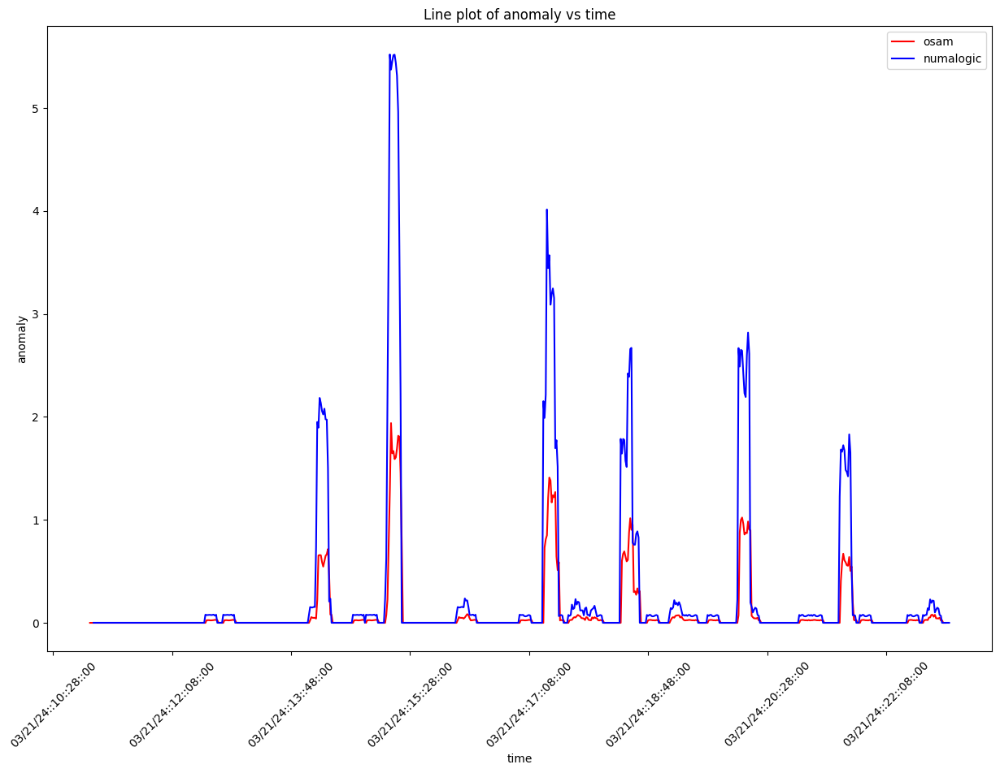

 46%|████▋     | 115/248 [05:27<06:37,  2.99s/it]

key:  fci:interactionsFailed:5984175597303660107:assign_pay_schedule
Anomaly tp for this graph from OSAM:  0
Anomaly tp for this graph from Numa:  2


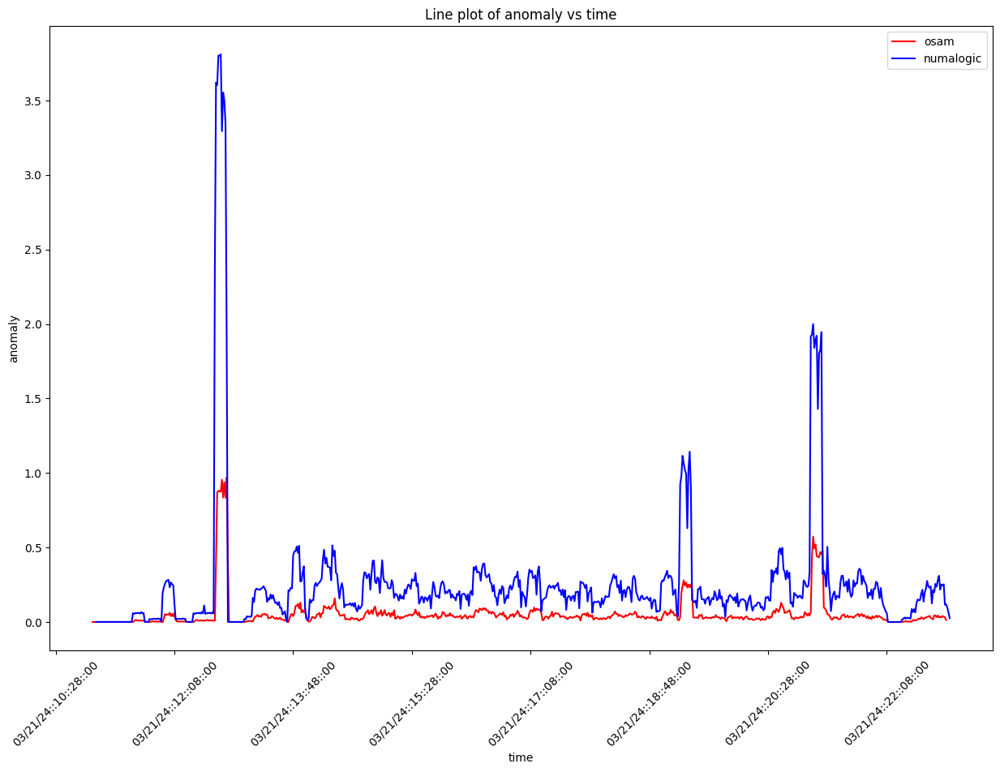

 47%|████▋     | 116/248 [05:30<06:27,  2.94s/it]

key:  fci:interactionsFailed:5984175597303660107:qbaa.fai.reconcile-ui.getBankAccountDetails
Anomaly tp for this graph from OSAM:  0
Anomaly tp for this graph from Numa:  1


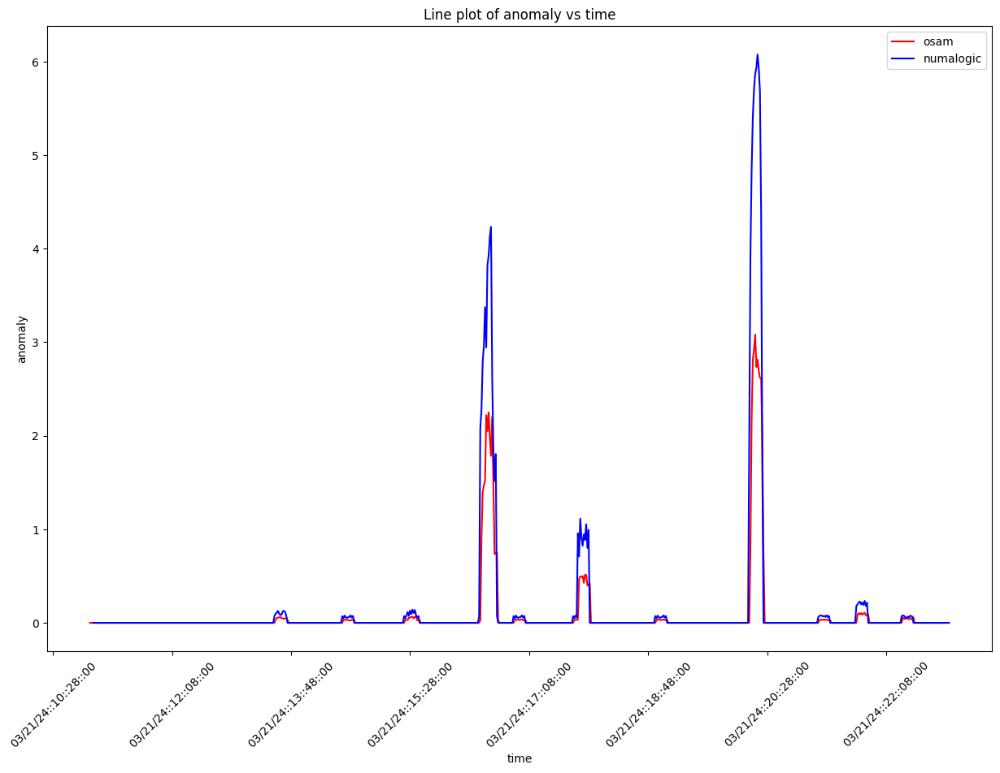

 47%|████▋     | 117/248 [05:32<06:15,  2.86s/it]

key:  fciPluginAsset:metricsFailed:2525411083745874319
Anomaly tp for this graph from OSAM:  0
Anomaly tp for this graph from Numa:  2


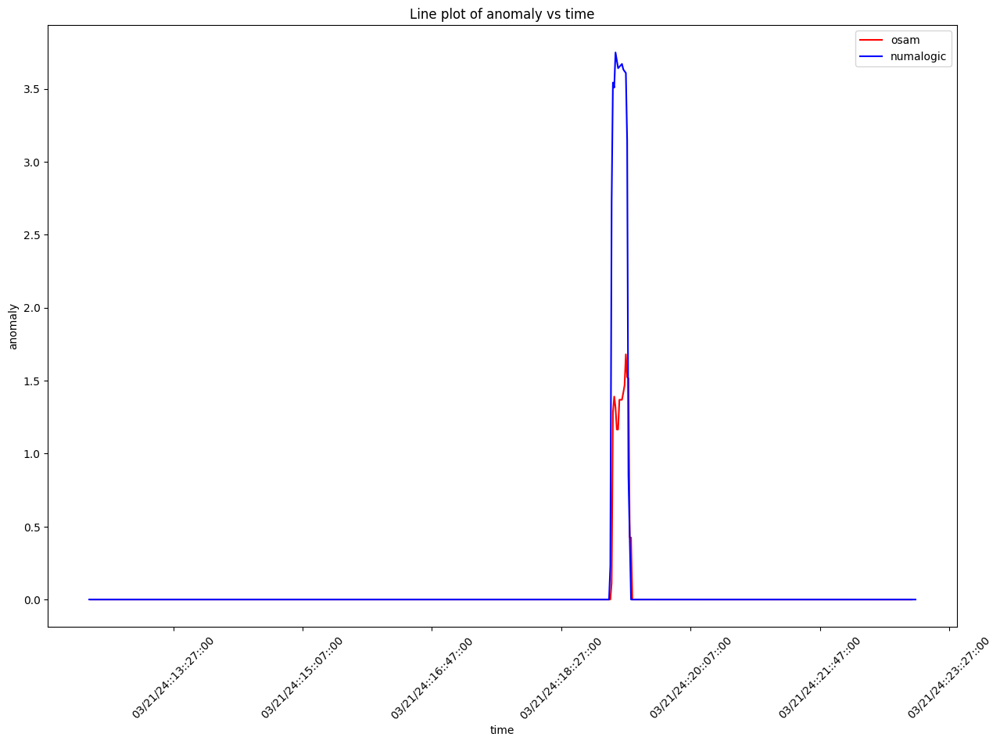

 48%|████▊     | 118/248 [05:35<06:05,  2.81s/it]

key:  fci:interactionsFailed:5477520638979968238:player_topic_pa_w2
Anomaly tp for this graph from OSAM:  0
Anomaly tp for this graph from Numa:  1


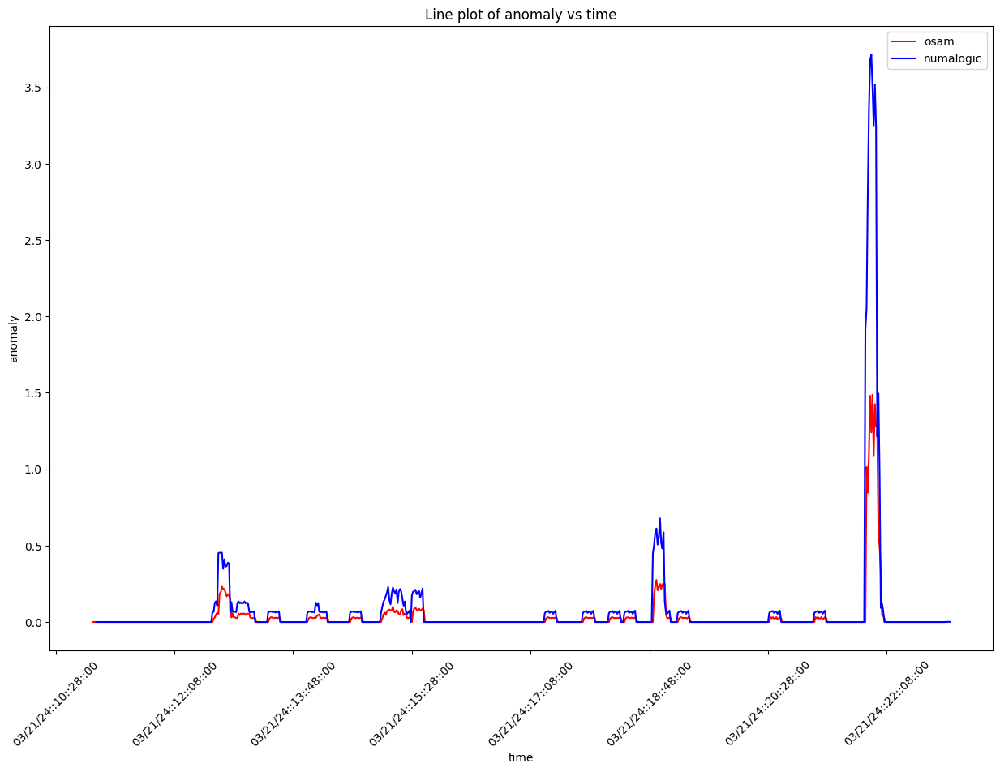

 48%|████▊     | 119/248 [05:38<06:05,  2.83s/it]

key:  fciPluginAsset:metricsFailed:6632693943554216361
Anomaly tp for this graph from OSAM:  0
Anomaly tp for this graph from Numa:  1


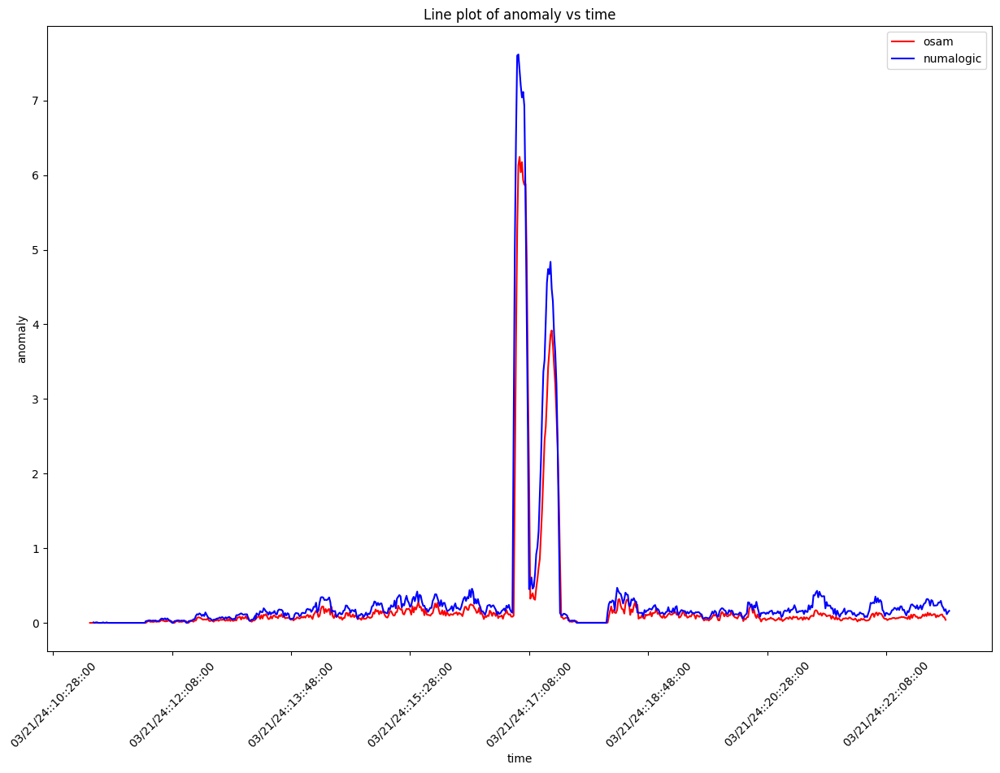

 48%|████▊     | 120/248 [05:41<05:58,  2.80s/it]

key:  fciPlugin:requestsFailed:4831254092648450521:tto-shell-ui
Anomaly tp for this graph from OSAM:  2
Anomaly tp for this graph from Numa:  2


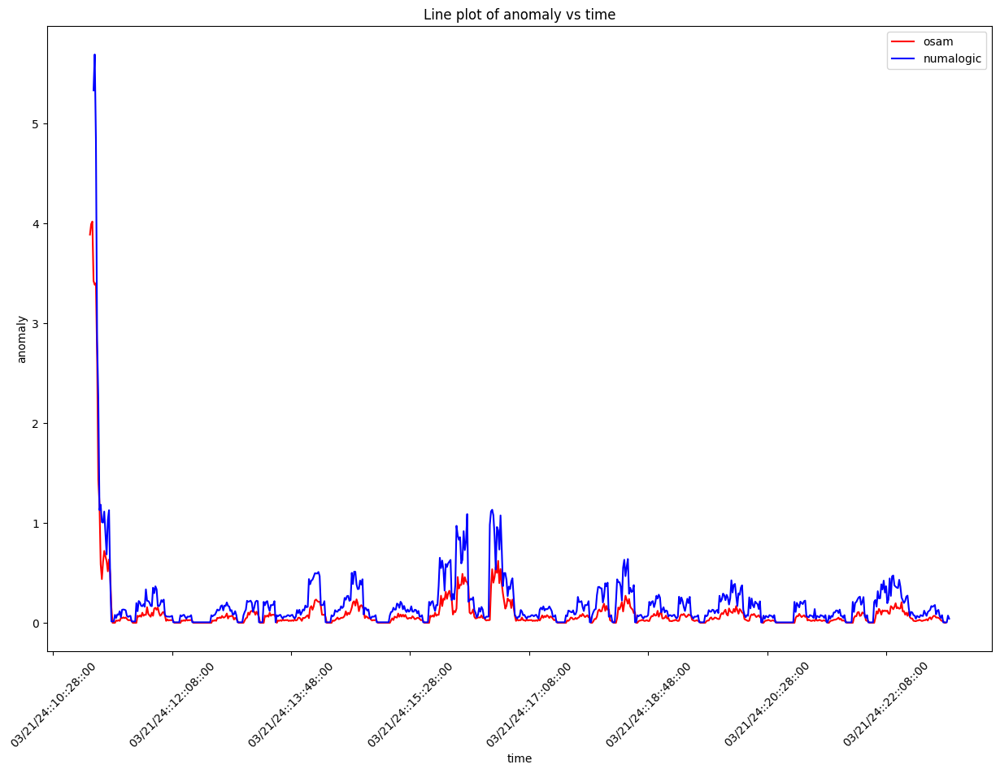

 49%|████▉     | 121/248 [05:43<05:53,  2.78s/it]

key:  fciPlugin:requestsFailed:5984175597303660107:transactions-sfc-ui-v2
Anomaly tp for this graph from OSAM:  1
Anomaly tp for this graph from Numa:  1


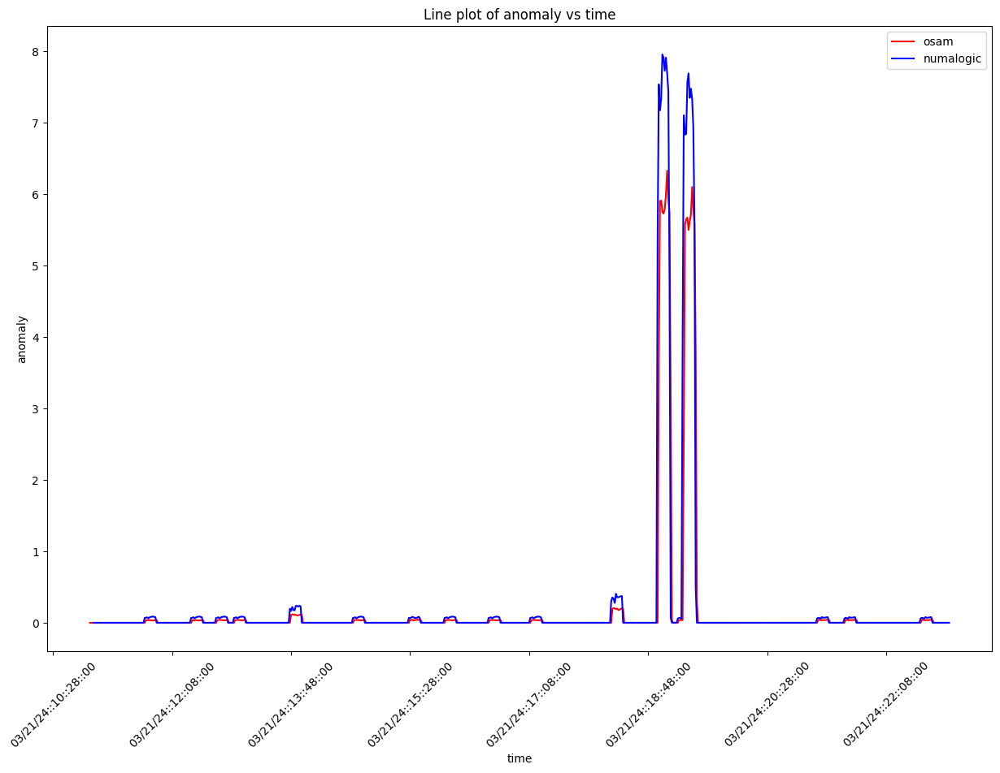

 49%|████▉     | 122/248 [05:46<05:48,  2.77s/it]

key:  fciPluginInteractions:metrics:2453353489468585843:newAccountMlSuggestedIds
Anomaly tp for this graph from OSAM:  2
Anomaly tp for this graph from Numa:  2


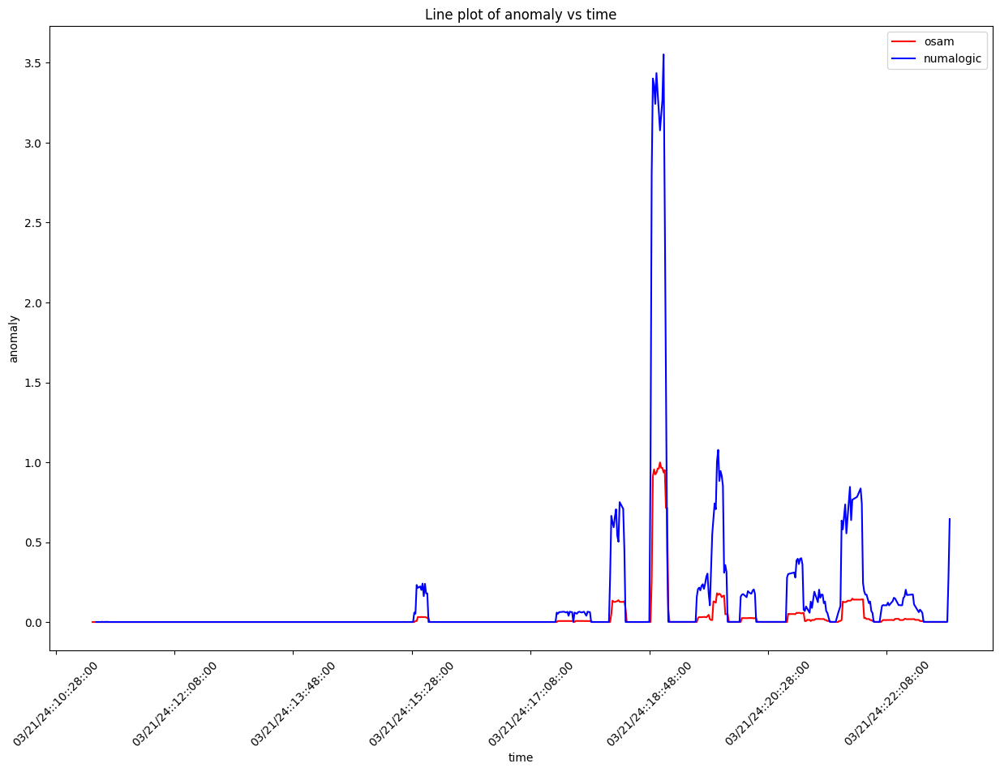

 50%|████▉     | 123/248 [05:49<05:44,  2.75s/it]

key:  fciAsset:assetFailed:5047426874833558809
Anomaly tp for this graph from OSAM:  0
Anomaly tp for this graph from Numa:  1


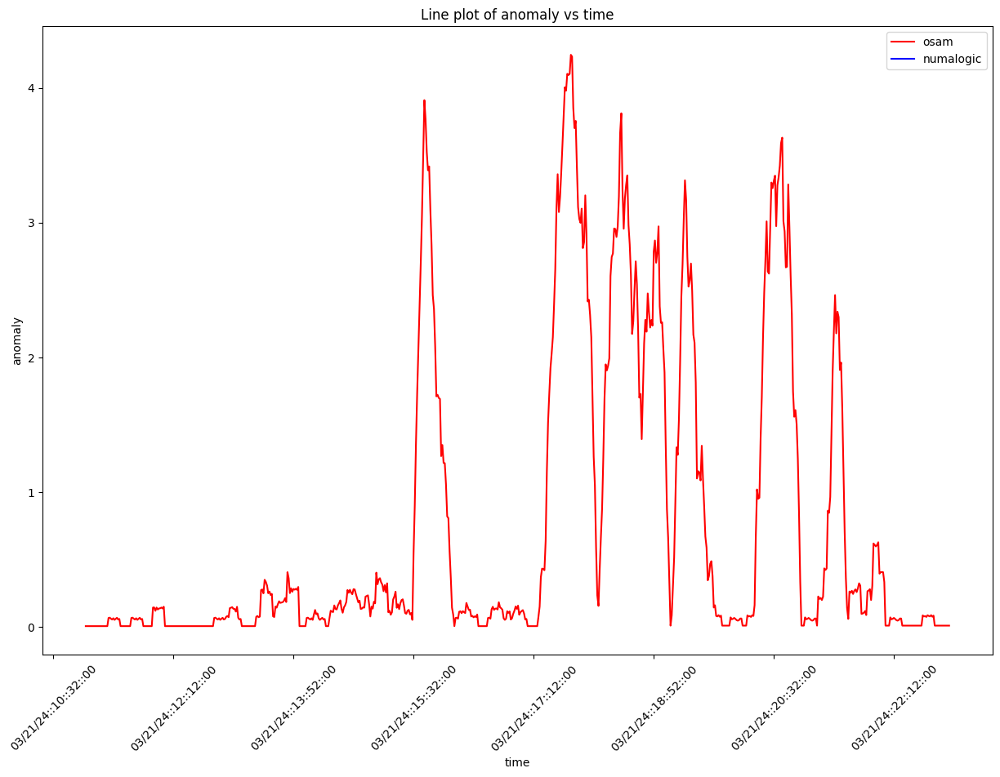

 50%|█████     | 124/248 [05:52<05:41,  2.75s/it]

key:  fciPluginAsset:metricsFailedAEV2:937892214703082231
Anomaly tp for this graph from OSAM:  7
Anomaly tp for this graph from Numa:  0


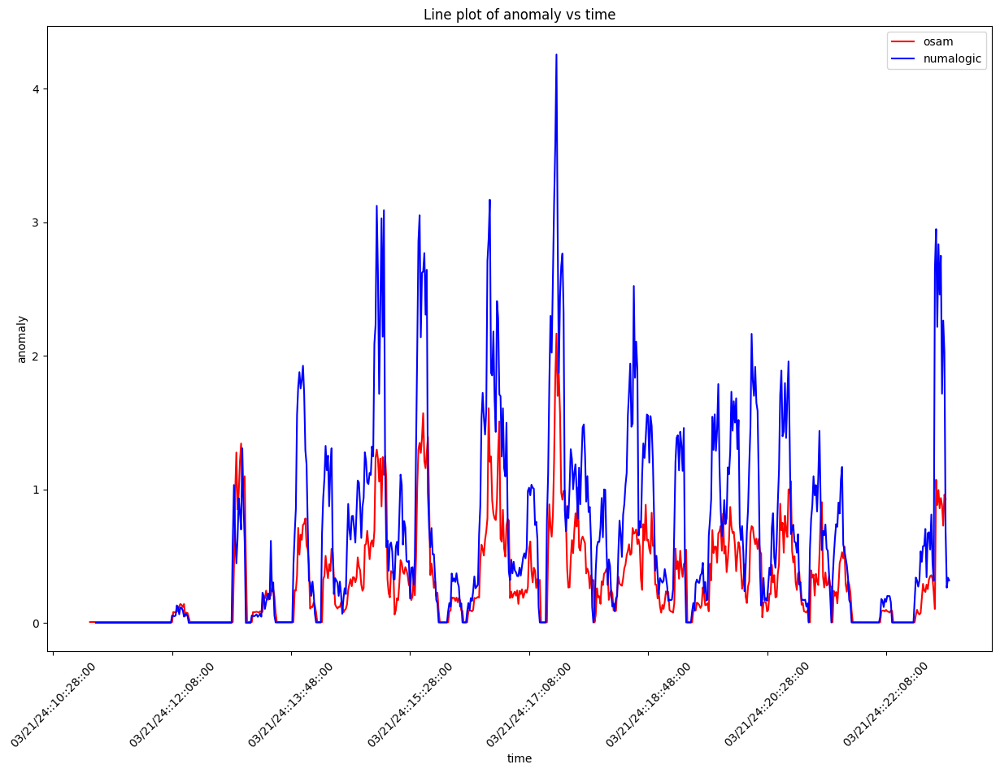

 50%|█████     | 125/248 [05:54<05:42,  2.78s/it]

key:  fciPluginAppInteractions:metrics:3101871836022059397:8938536952929487393:search_widget_autosuggest_load
Anomaly tp for this graph from OSAM:  0
Anomaly tp for this graph from Numa:  1


 51%|█████     | 126/248 [05:57<05:27,  2.68s/it]

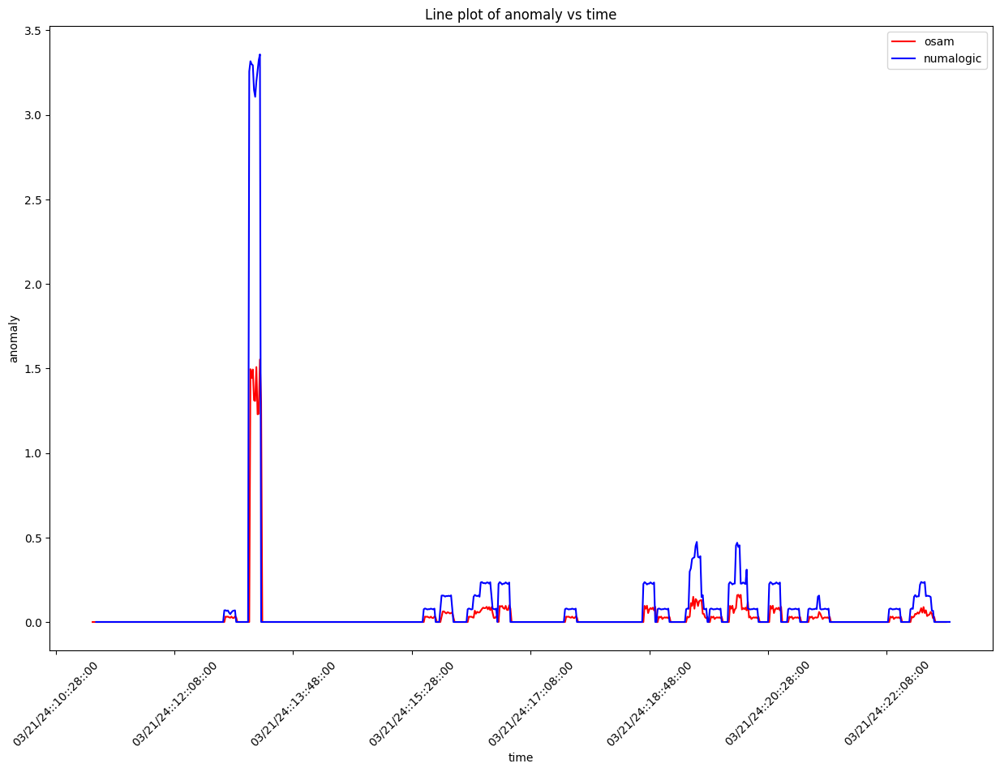

 51%|█████     | 127/248 [06:00<05:26,  2.70s/it]

key:  fci:interactionsFailed:5984175597306586857:SH_LOAD_AUTOSUGGEST
Anomaly tp for this graph from OSAM:  0
Anomaly tp for this graph from Numa:  1


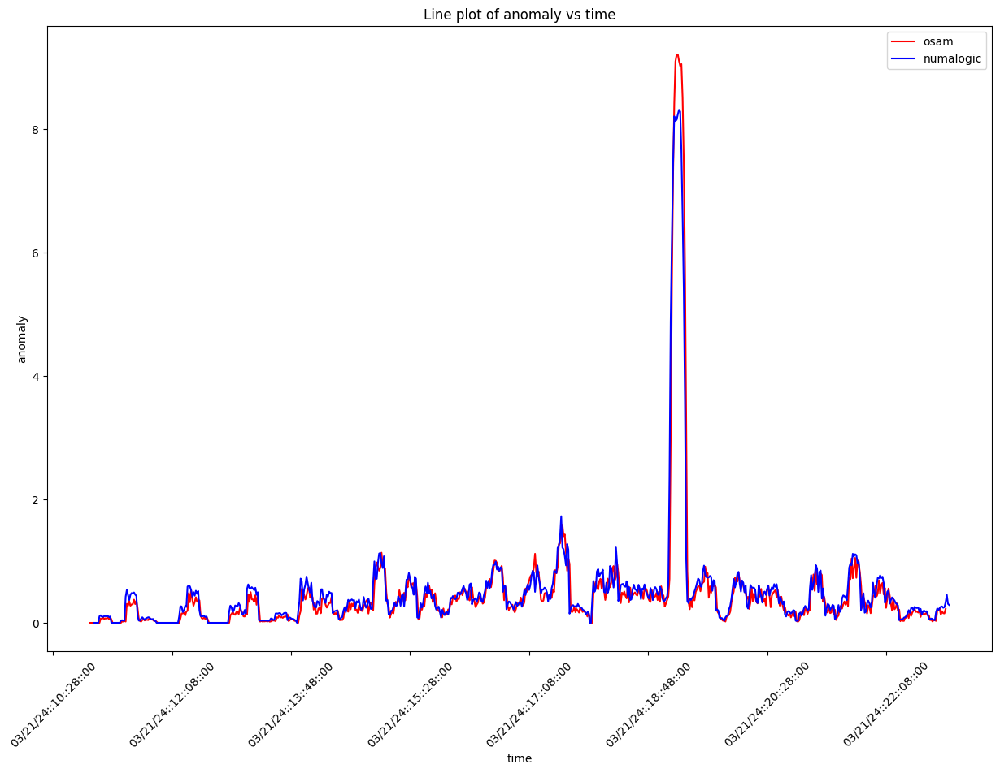

 52%|█████▏    | 128/248 [06:02<05:26,  2.72s/it]

key:  fciPluginInteractions:metrics:3750390182735137211:EXECUTE_PAGINATED_REPORT
Anomaly tp for this graph from OSAM:  1
Anomaly tp for this graph from Numa:  1


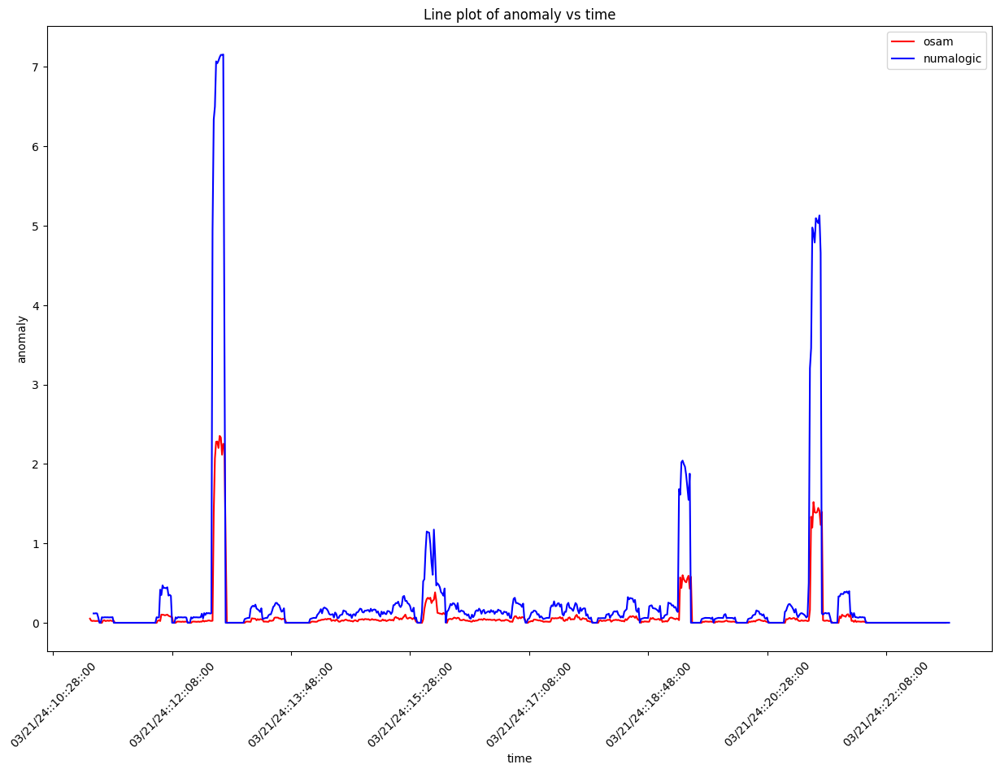

 52%|█████▏    | 129/248 [06:05<05:25,  2.73s/it]

key:  fciPluginInteractions:metrics:3244861123818975982:qbaa.fai.reconcile-ui.getStatementsShowViewStatementsBtn
Anomaly tp for this graph from OSAM:  0
Anomaly tp for this graph from Numa:  2


 52%|█████▏    | 130/248 [06:08<05:12,  2.65s/it]

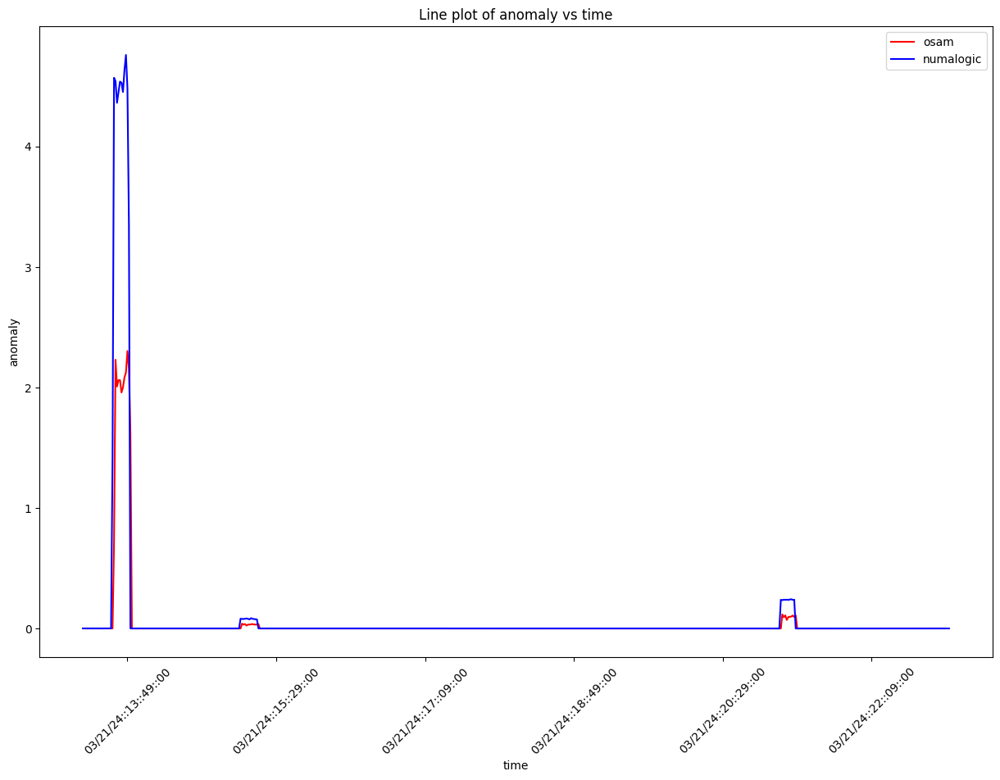

 53%|█████▎    | 131/248 [06:10<05:12,  2.67s/it]

key:  fciPluginAppInteractions:metrics:5119484469024512735:4831254092648450521:w-2-post-main-entry-celebration-empathy-views-0.irsw2.Prev
Anomaly tp for this graph from OSAM:  0
Anomaly tp for this graph from Numa:  1


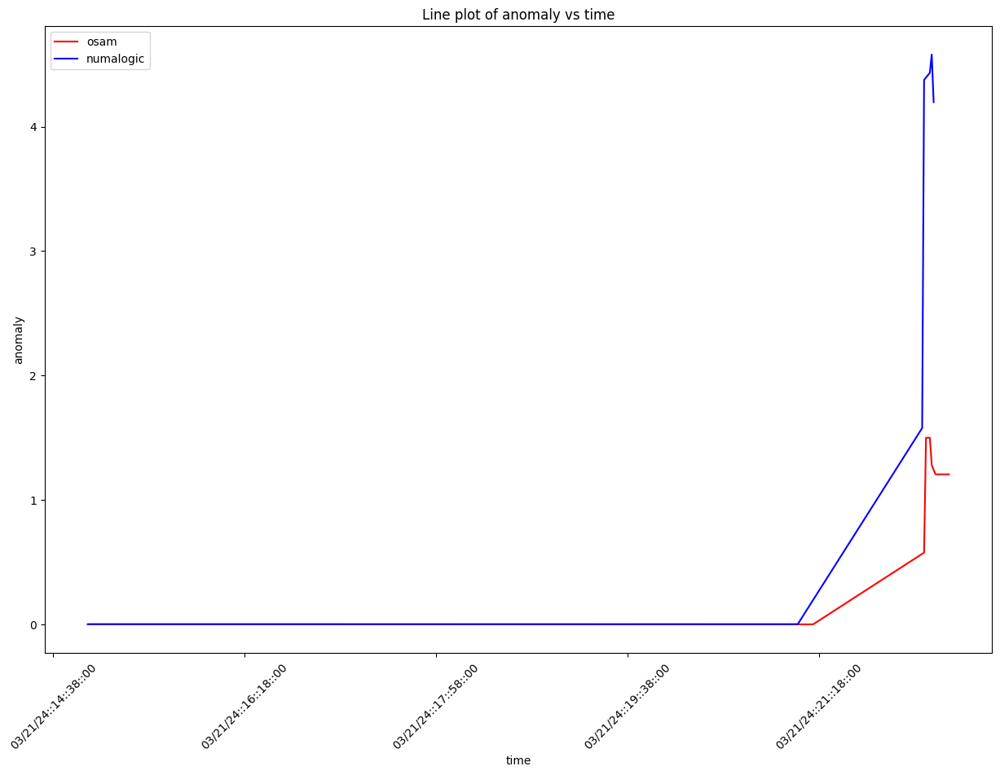

 53%|█████▎    | 132/248 [06:13<05:10,  2.67s/it]

key:  fci:interactionsFailed:5477520638979968238:player_topic_il_educationexpense
Anomaly tp for this graph from OSAM:  1
Anomaly tp for this graph from Numa:  0


 54%|█████▎    | 133/248 [06:15<04:58,  2.60s/it]

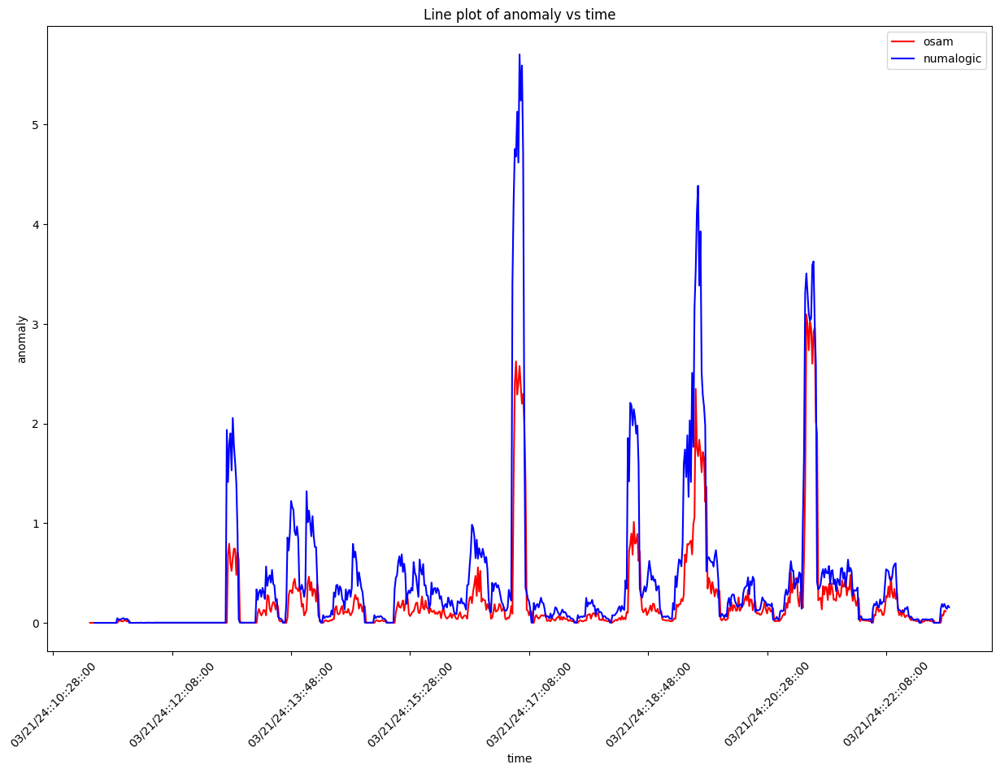

 54%|█████▍    | 134/248 [06:18<05:00,  2.64s/it]

key:  fciPluginAppInteractions:metrics:3101871835697829167:1876892737053055605:resumeAllConnections
Anomaly tp for this graph from OSAM:  0
Anomaly tp for this graph from Numa:  3


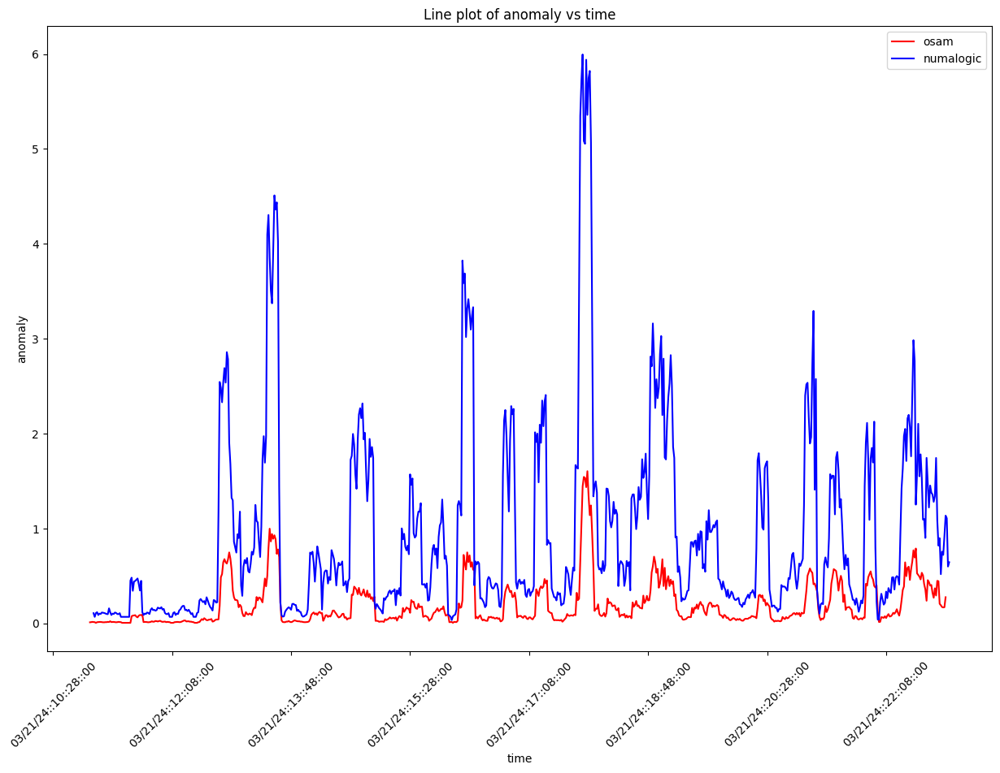

 54%|█████▍    | 135/248 [06:21<05:02,  2.68s/it]

key:  fci:interactionsFailed:5333405450904137335:FullService_initialize_widget
Anomaly tp for this graph from OSAM:  0
Anomaly tp for this graph from Numa:  3


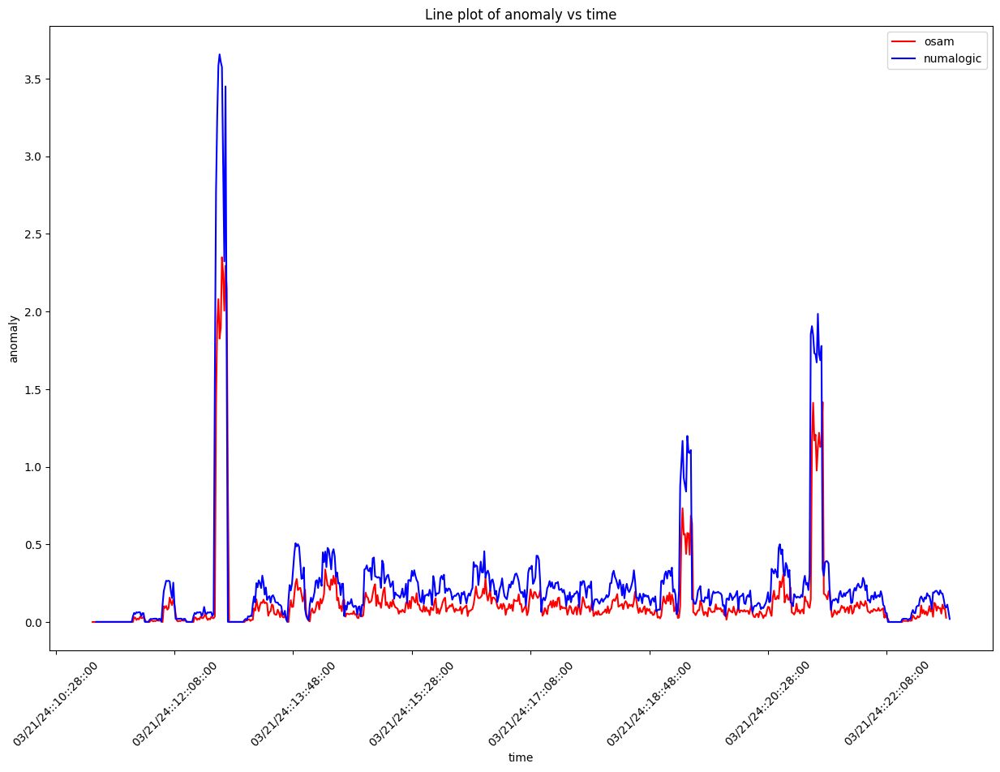

 55%|█████▍    | 136/248 [06:24<05:02,  2.70s/it]

key:  fciPluginAppInteractions:metrics:3244861123818975982:5984175597303660107:qbaa.fai.reconcile-ui.getBankAccountDetails
Anomaly tp for this graph from OSAM:  0
Anomaly tp for this graph from Numa:  1


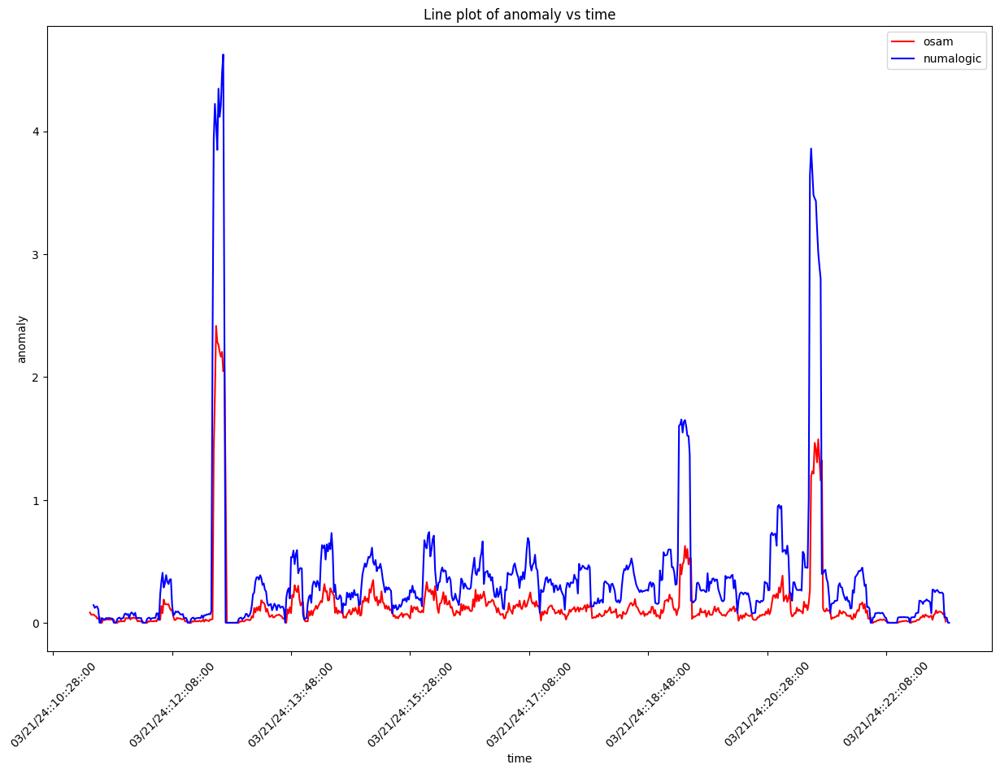

 55%|█████▌    | 137/248 [06:26<05:00,  2.71s/it]

key:  fciPluginAppInteractions:metrics:3244861123818975982:5984175597303660107:qbaa.fai.reconcile-ui.getStatementsStatus
Anomaly tp for this graph from OSAM:  0
Anomaly tp for this graph from Numa:  2


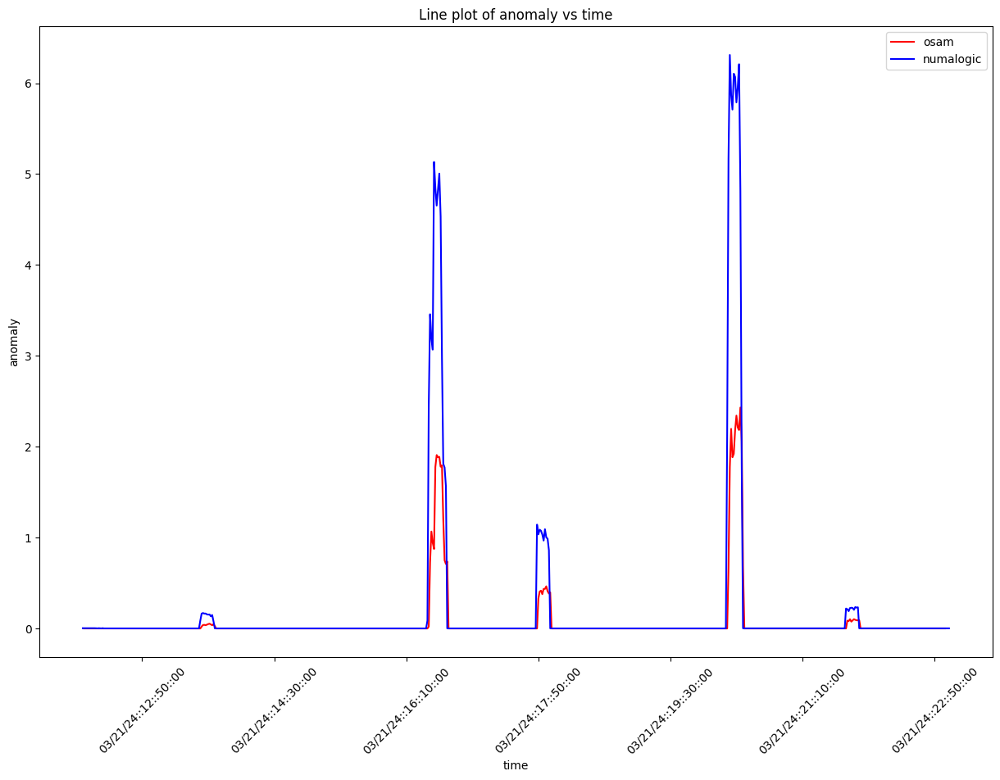

 56%|█████▌    | 138/248 [06:29<04:58,  2.71s/it]

key:  fciPluginAppInteractions:metrics:2525411083745874319:868086420502860411:get-smart-compose-prediction
Anomaly tp for this graph from OSAM:  0
Anomaly tp for this graph from Numa:  2


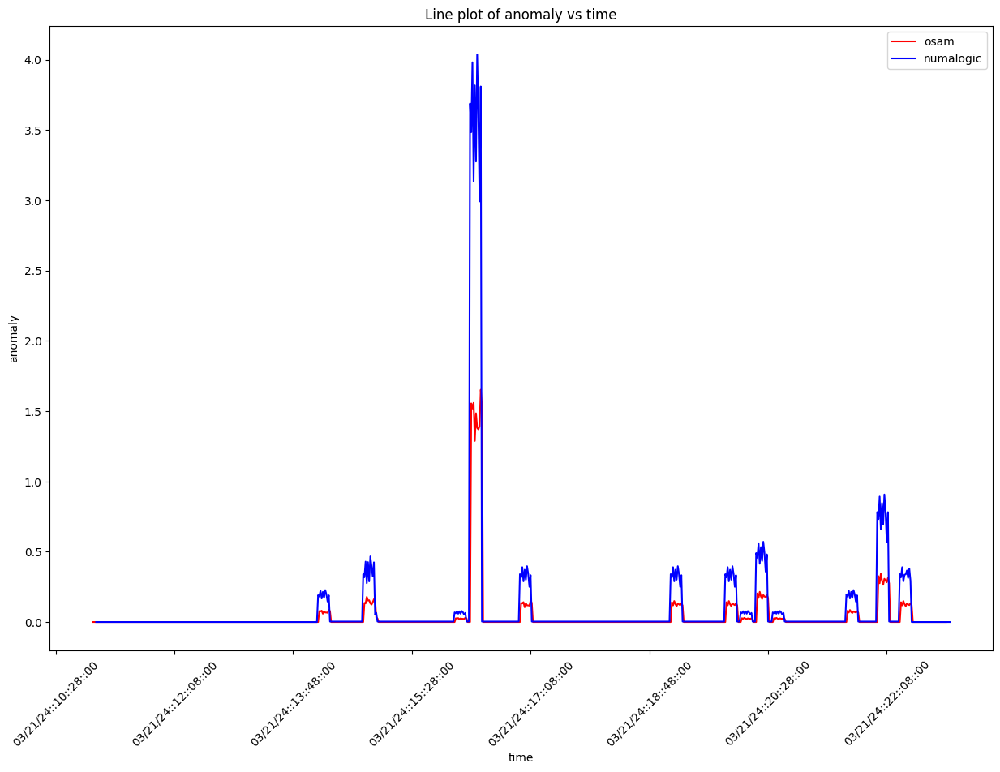

 56%|█████▌    | 139/248 [06:32<05:00,  2.76s/it]

key:  fciPlugin:requestsFailed:8434133794656866131:customer-info-center
Anomaly tp for this graph from OSAM:  0
Anomaly tp for this graph from Numa:  1


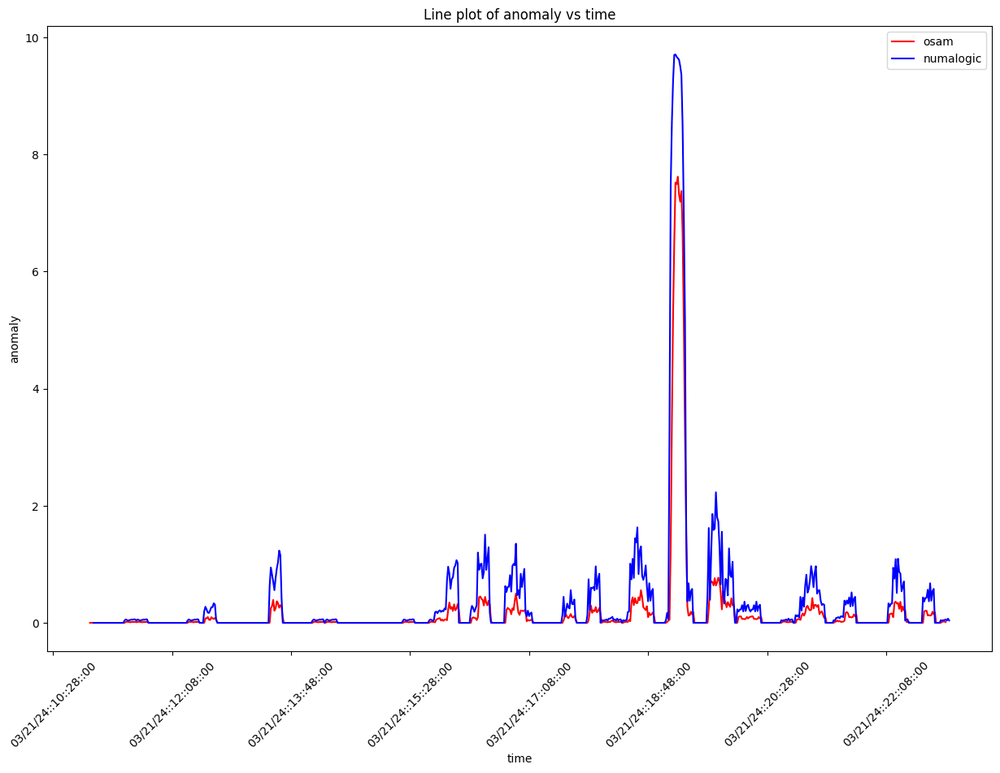

 56%|█████▋    | 140/248 [06:35<04:57,  2.75s/it]

key:  fci:interactionsFailed:5984175597303660107:DRILLDOWN_REPORT_FETCH
Anomaly tp for this graph from OSAM:  1
Anomaly tp for this graph from Numa:  1


 57%|█████▋    | 141/248 [06:37<04:42,  2.64s/it]

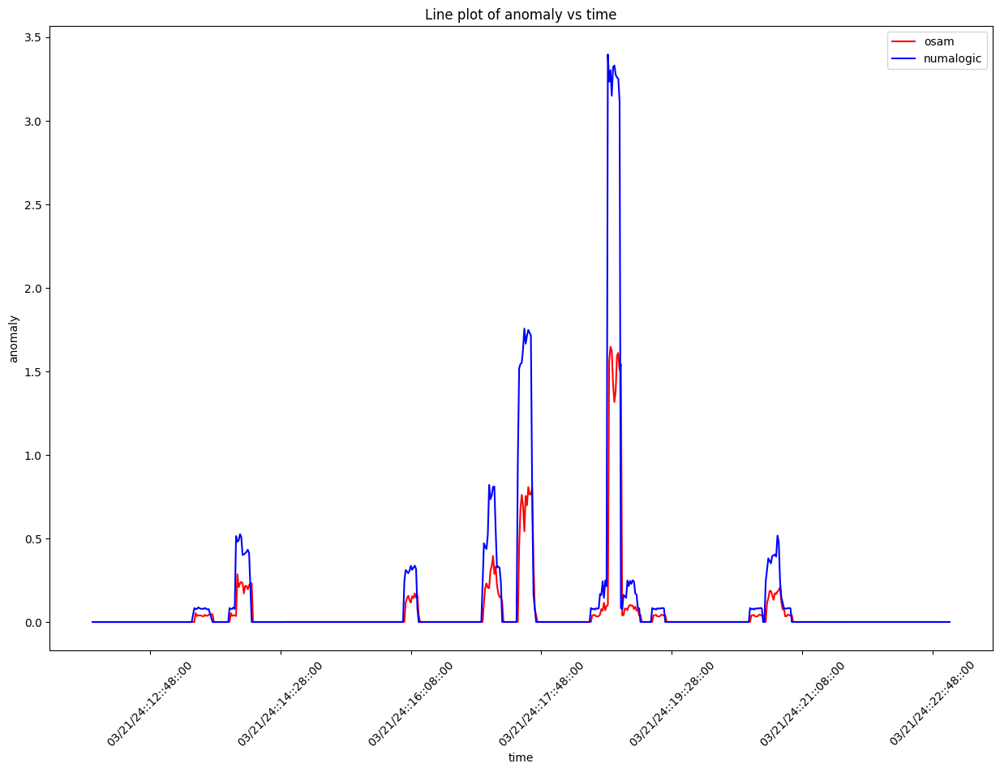

 57%|█████▋    | 142/248 [06:40<04:45,  2.69s/it]

key:  fciPluginInteractions:metrics:2453353489679220423:REVIEW_RECIPIENTS
Anomaly tp for this graph from OSAM:  0
Anomaly tp for this graph from Numa:  1


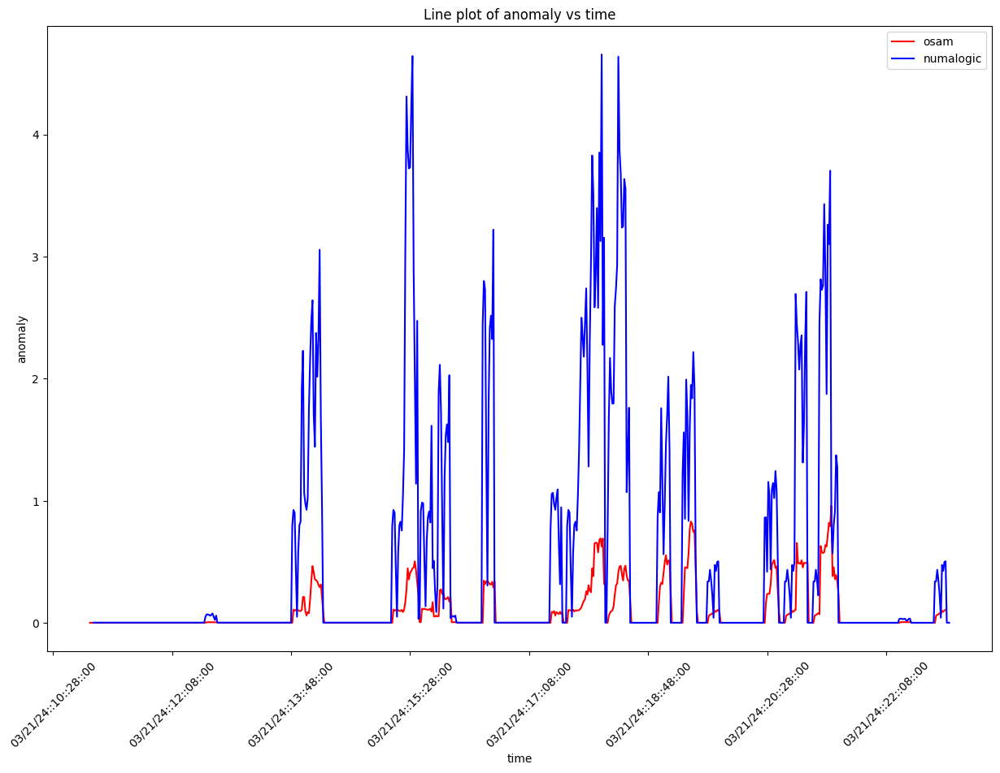

 58%|█████▊    | 143/248 [06:43<04:41,  2.68s/it]

key:  fci:interactionsFailed:5984175597303660107:cachedContactOnSearch
Anomaly tp for this graph from OSAM:  0
Anomaly tp for this graph from Numa:  4


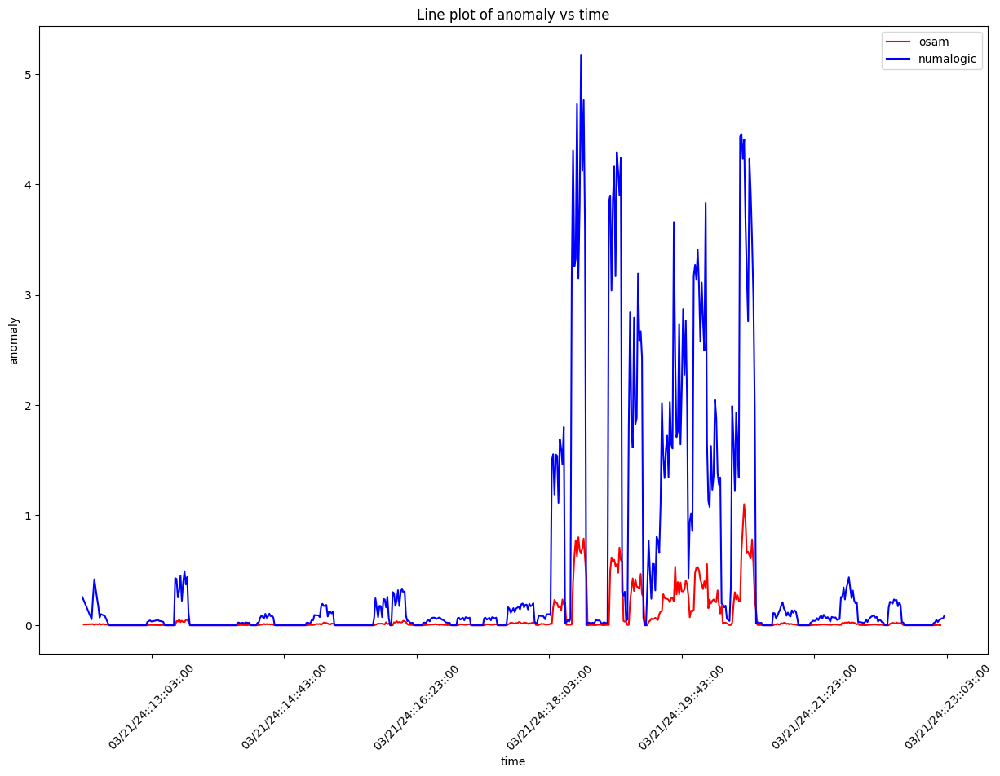

 58%|█████▊    | 144/248 [06:45<04:39,  2.69s/it]

key:  fci:interactionsFailed:4831254092648450521:CB_INIT_CODE_TO_DISPLAY_CODE
Anomaly tp for this graph from OSAM:  0
Anomaly tp for this graph from Numa:  5


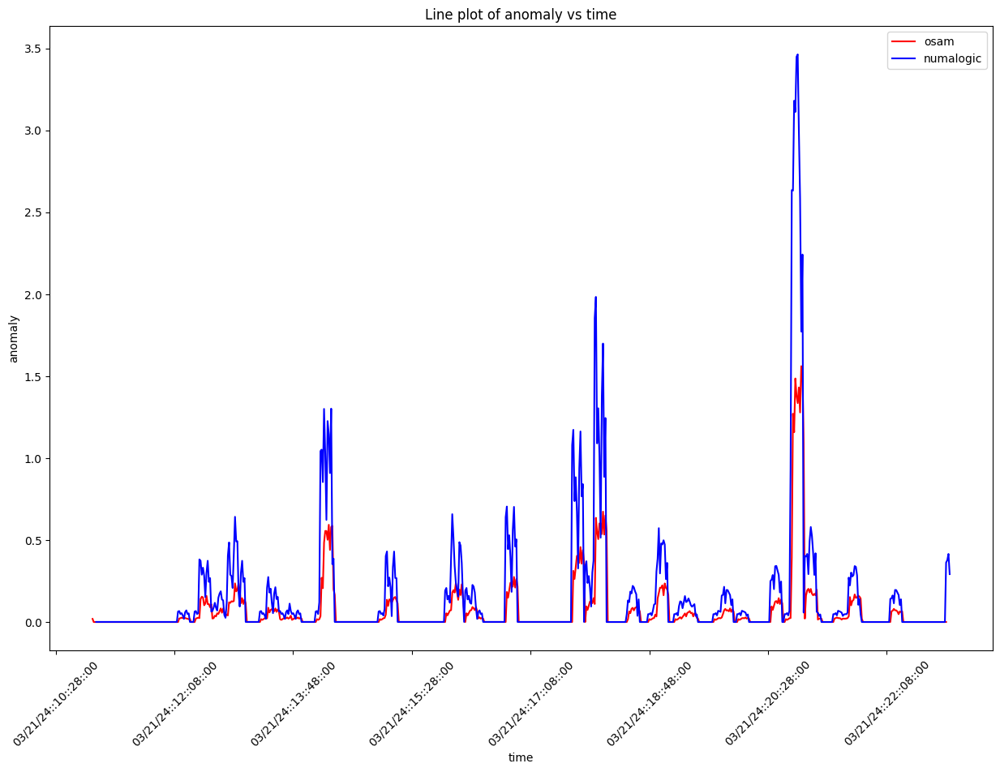

 58%|█████▊    | 145/248 [06:48<04:36,  2.69s/it]

key:  fci:interactionsFailed:5984175597303660107:qbaa.fci.datain-ui.PaginationSelected
Anomaly tp for this graph from OSAM:  0
Anomaly tp for this graph from Numa:  1


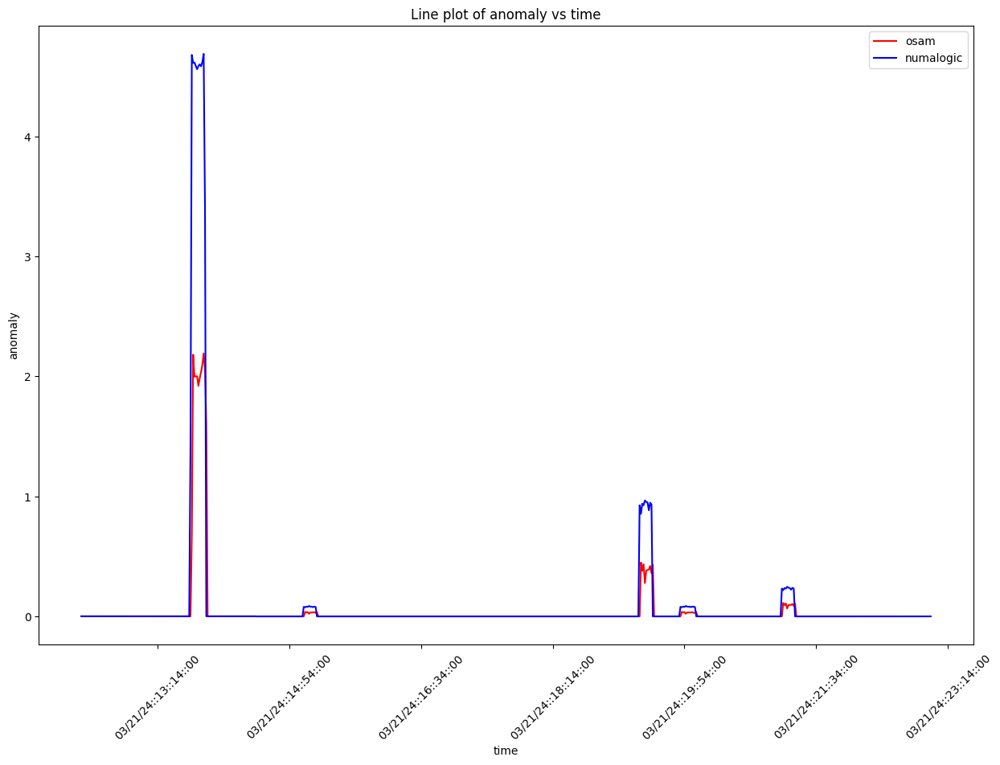

 59%|█████▉    | 146/248 [06:51<04:33,  2.68s/it]

key:  fciPluginInteractions:metrics:5119484469024512735:w-2-post-main-entry-celebration-empathy-views-0.irsw2.Prev
Anomaly tp for this graph from OSAM:  0
Anomaly tp for this graph from Numa:  1


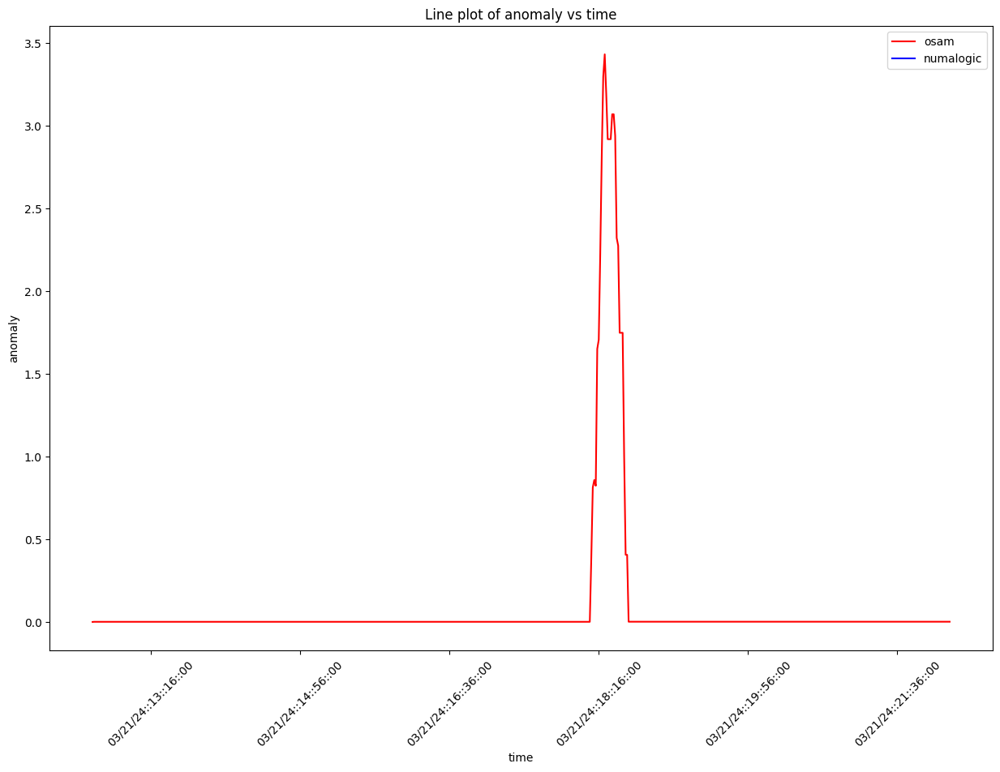

 59%|█████▉    | 147/248 [06:53<04:33,  2.71s/it]

key:  fciPluginAsset:metricsFailedAEV2:8145903419052279917
Anomaly tp for this graph from OSAM:  1
Anomaly tp for this graph from Numa:  0


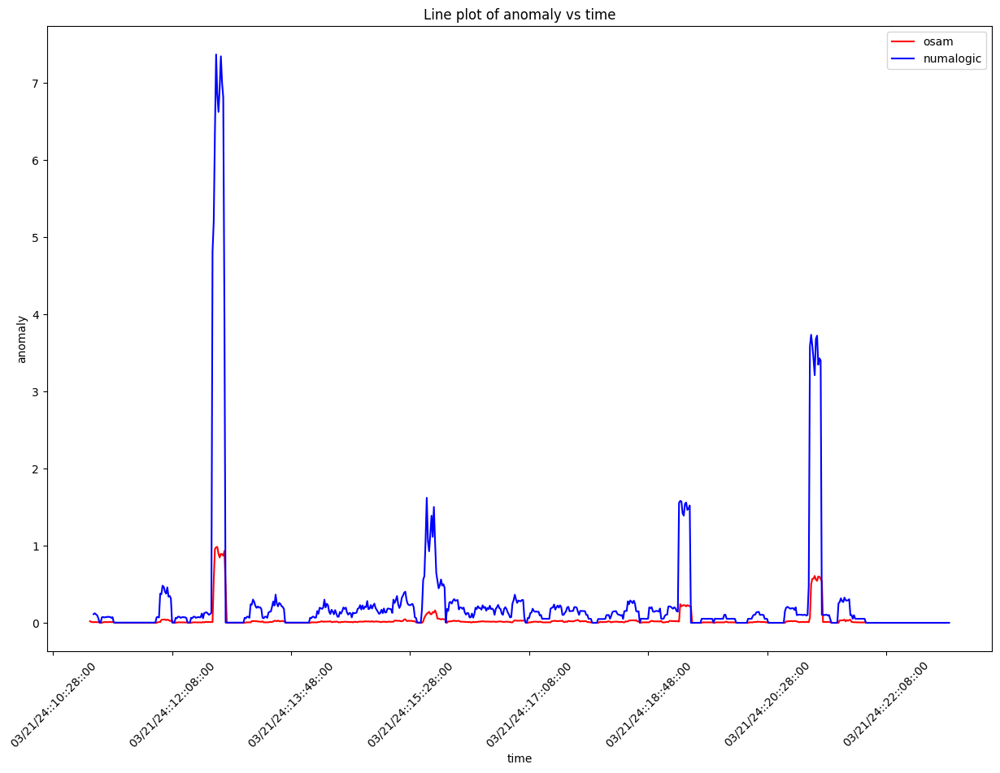

 60%|█████▉    | 148/248 [06:56<04:32,  2.73s/it]

key:  fci:interactionsFailed:5984175597303660107:qbaa.fai.reconcile-ui.getStatementsShowViewStatementsBtn
Anomaly tp for this graph from OSAM:  0
Anomaly tp for this graph from Numa:  2


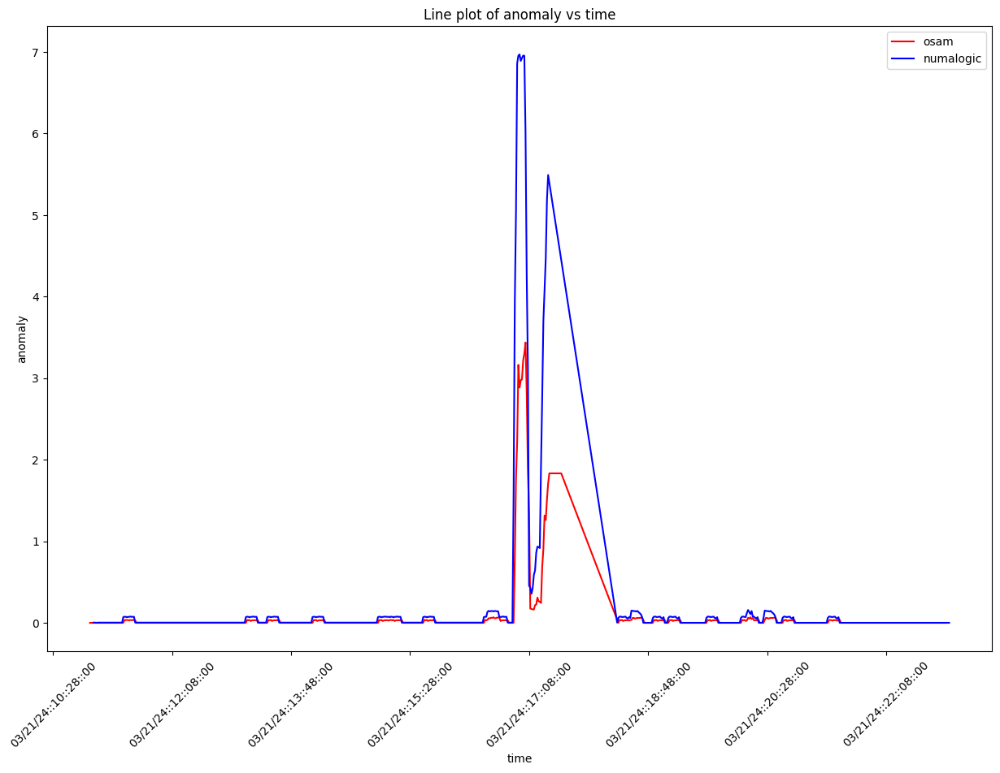

 60%|██████    | 149/248 [06:59<04:30,  2.73s/it]

key:  fci:interactionsFailed:5477520638979968238:GenAi Explanations
Anomaly tp for this graph from OSAM:  1
Anomaly tp for this graph from Numa:  2


 60%|██████    | 150/248 [07:01<04:19,  2.65s/it]

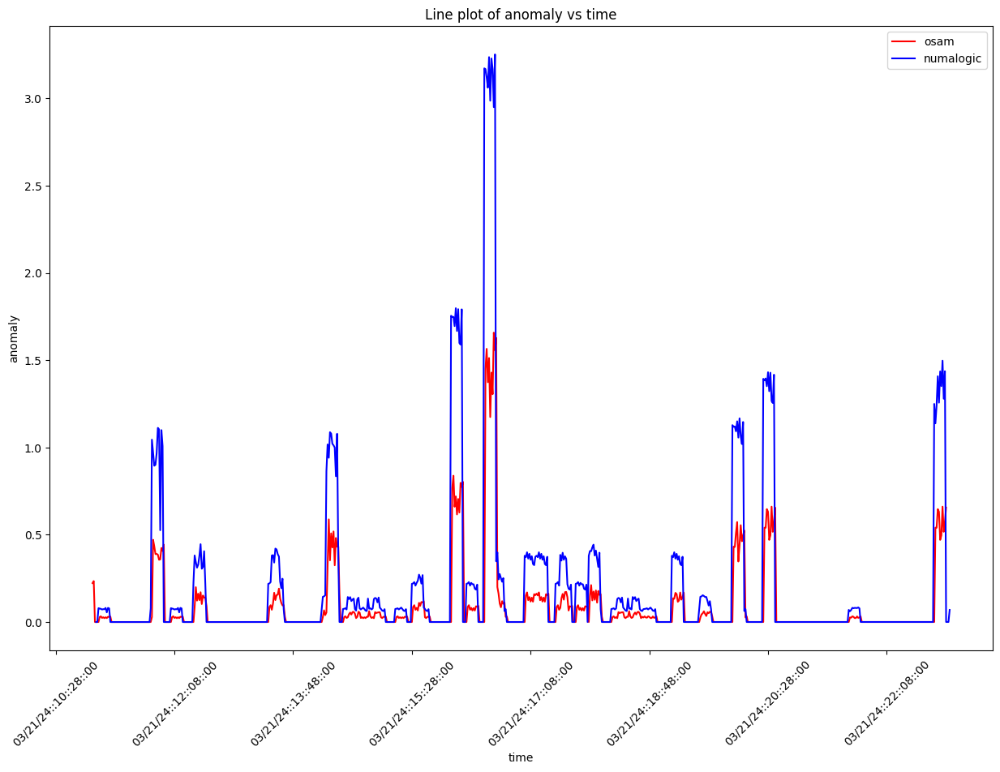

 61%|██████    | 151/248 [07:04<04:21,  2.70s/it]

key:  fci:interactionsFailed:5984175597303660107:clientListSearch_load
Anomaly tp for this graph from OSAM:  0
Anomaly tp for this graph from Numa:  1


 61%|██████▏   | 152/248 [07:07<04:11,  2.62s/it]

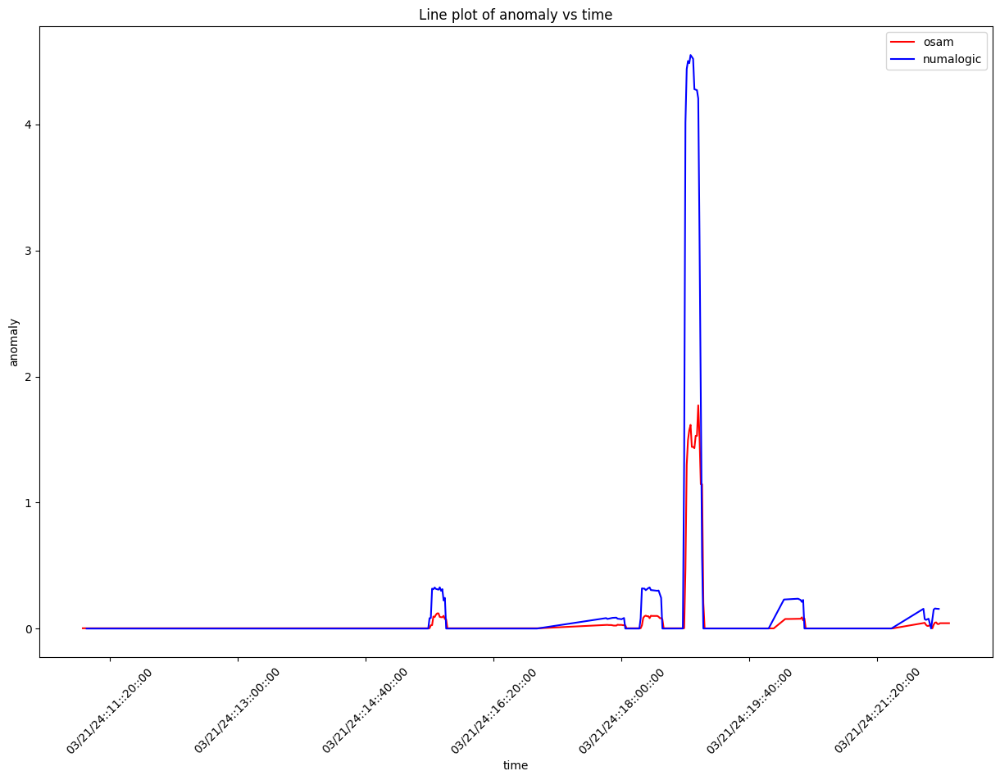

 62%|██████▏   | 153/248 [07:09<04:10,  2.63s/it]

key:  fciPluginAsset:metricsFailed:6704751537736876537
Anomaly tp for this graph from OSAM:  0
Anomaly tp for this graph from Numa:  1


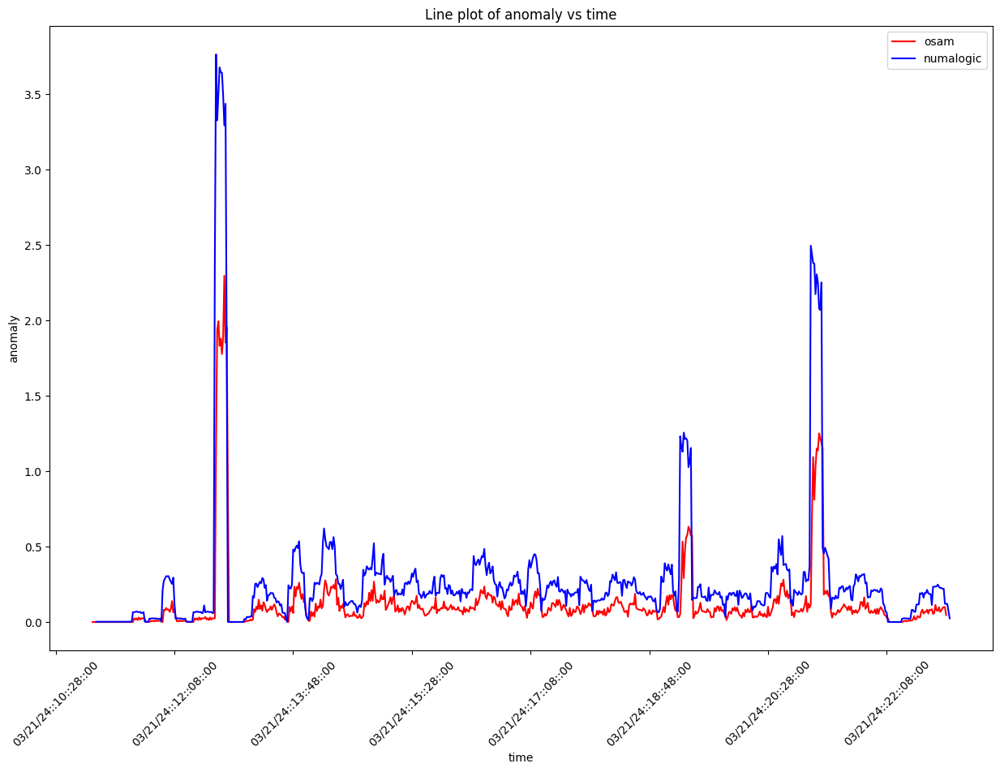

 62%|██████▏   | 154/248 [07:12<04:10,  2.67s/it]

key:  fciPluginInteractions:metrics:3244861123818975982:qbaa.fai.reconcile-ui.getBankAccountDetails
Anomaly tp for this graph from OSAM:  0
Anomaly tp for this graph from Numa:  1


 62%|██████▎   | 155/248 [07:14<03:59,  2.58s/it]

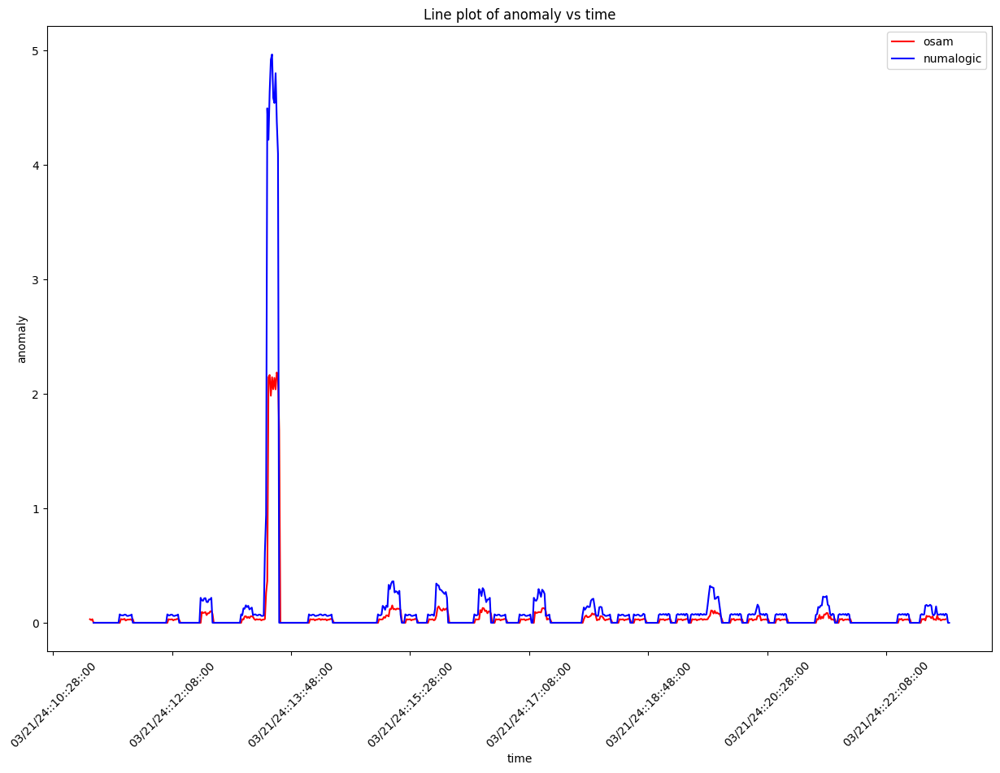

 63%|██████▎   | 156/248 [07:17<04:00,  2.62s/it]

key:  fci:interactionsFailed:5333405450904137335:FullService_load_webview
Anomaly tp for this graph from OSAM:  0
Anomaly tp for this graph from Numa:  1


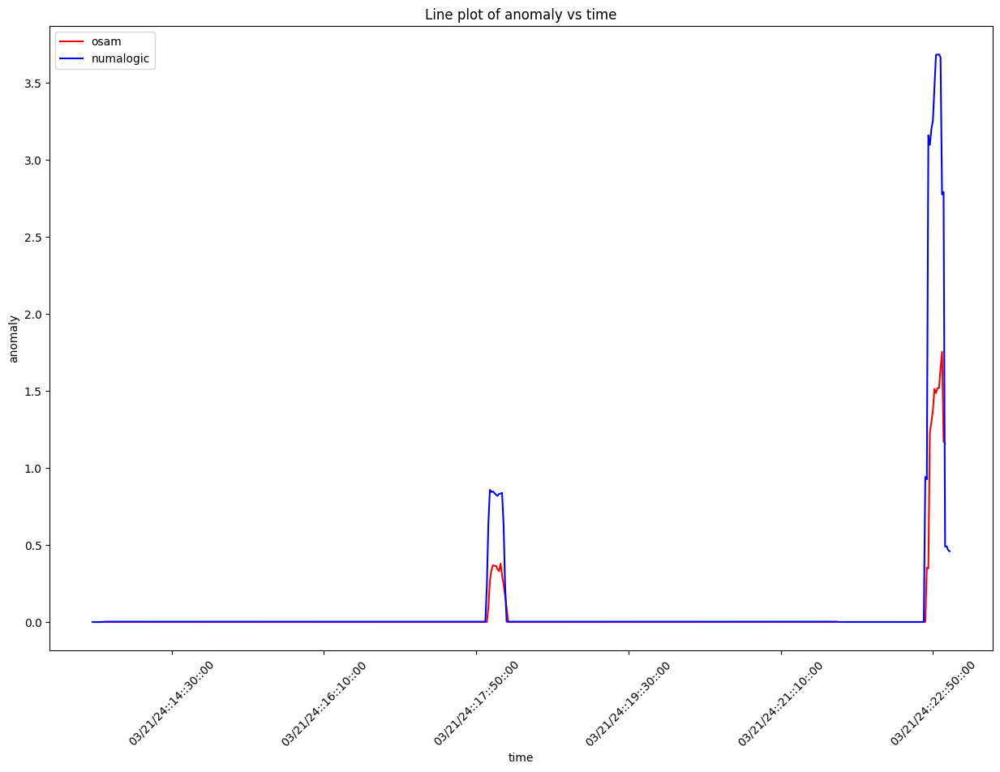

 63%|██████▎   | 157/248 [07:20<03:59,  2.63s/it]

key:  fciPluginAppInteractions:metrics:5119484469024512735:4831254092648450521:CompleteCheckLandingTable-Page-views-0.il_completecheck.CallTopic
Anomaly tp for this graph from OSAM:  0
Anomaly tp for this graph from Numa:  1


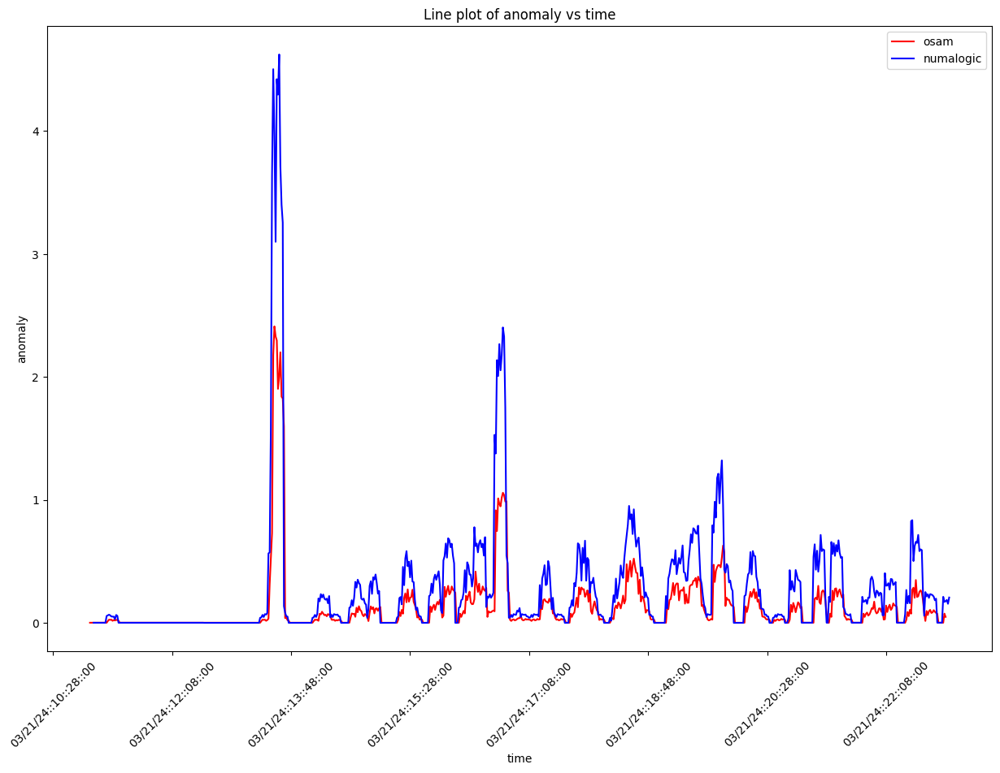

 64%|██████▎   | 158/248 [07:23<03:59,  2.66s/it]

key:  fciPluginInteractions:metrics:3678332588046106875:qbaa.fai.bankconnections-ui.ProcessOfxFile
Anomaly tp for this graph from OSAM:  0
Anomaly tp for this graph from Numa:  1


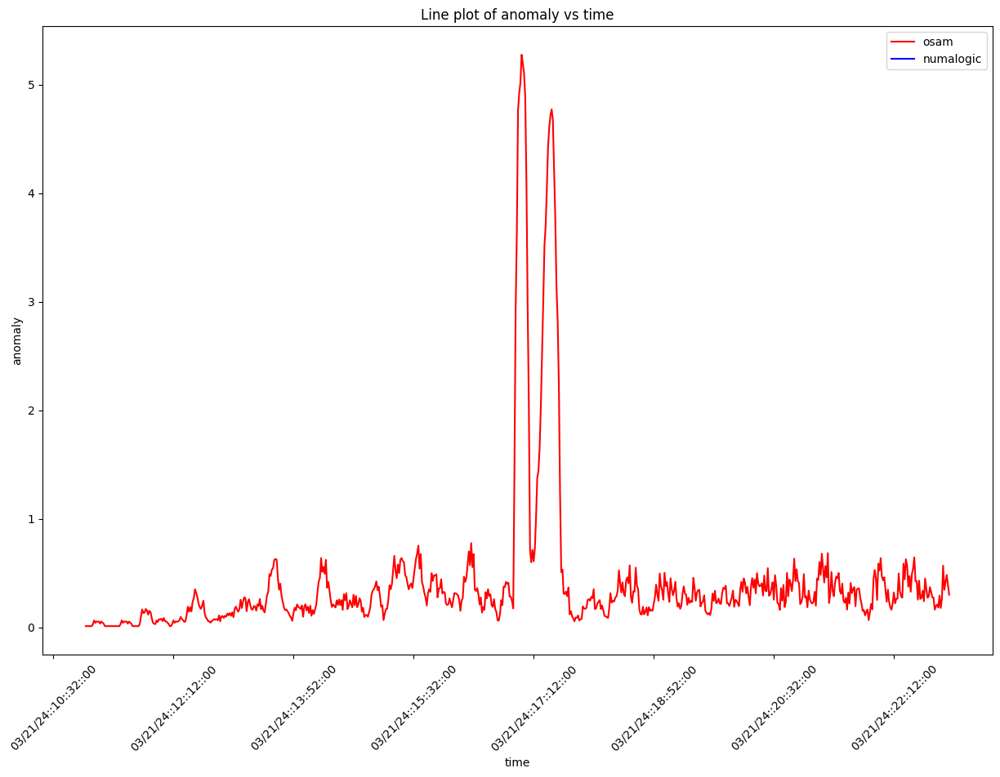

 64%|██████▍   | 159/248 [07:25<03:57,  2.67s/it]

key:  fciPluginAsset:metricsFailedAEV2:579856044409078427
Anomaly tp for this graph from OSAM:  2
Anomaly tp for this graph from Numa:  0


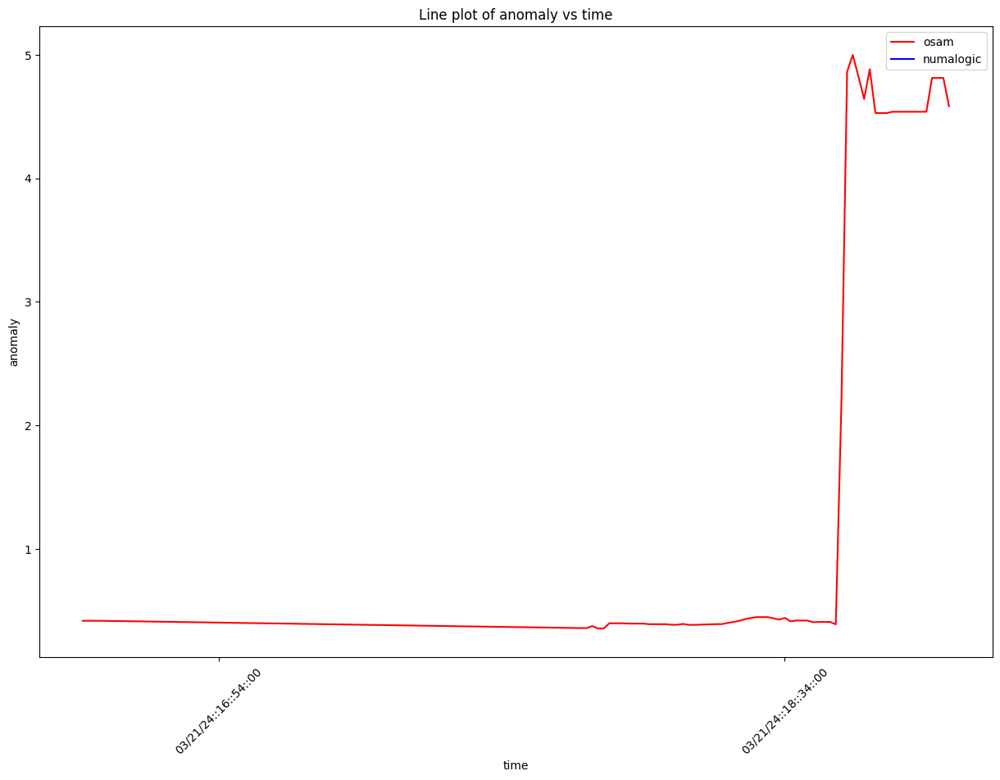

 65%|██████▍   | 160/248 [07:28<03:51,  2.64s/it]

key:  fciPlugin:requests:8650306576776437609:content-studio-plugin
Anomaly tp for this graph from OSAM:  1
Anomaly tp for this graph from Numa:  0


 65%|██████▌   | 162/248 [07:33<03:39,  2.55s/it]

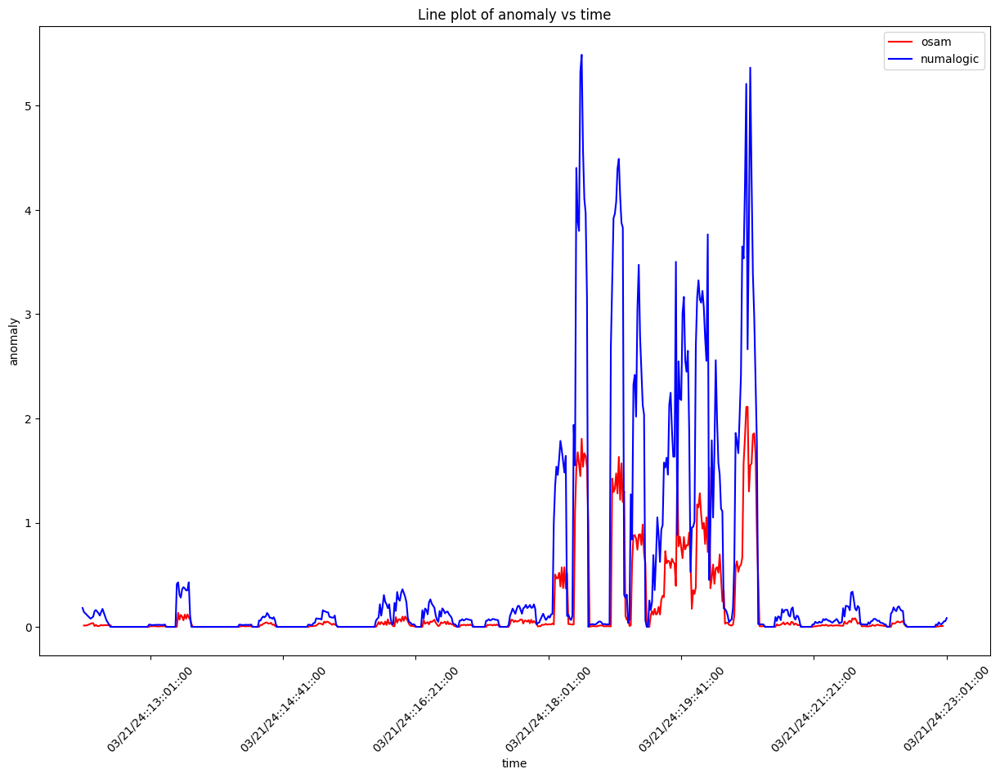

 66%|██████▌   | 163/248 [07:35<03:41,  2.61s/it]

key:  fciPluginInteractions:metrics:6056233191676083953:CB_INIT_CODE_TO_DISPLAY_CODE
Anomaly tp for this graph from OSAM:  0
Anomaly tp for this graph from Numa:  5


 66%|██████▌   | 164/248 [07:38<03:35,  2.56s/it]

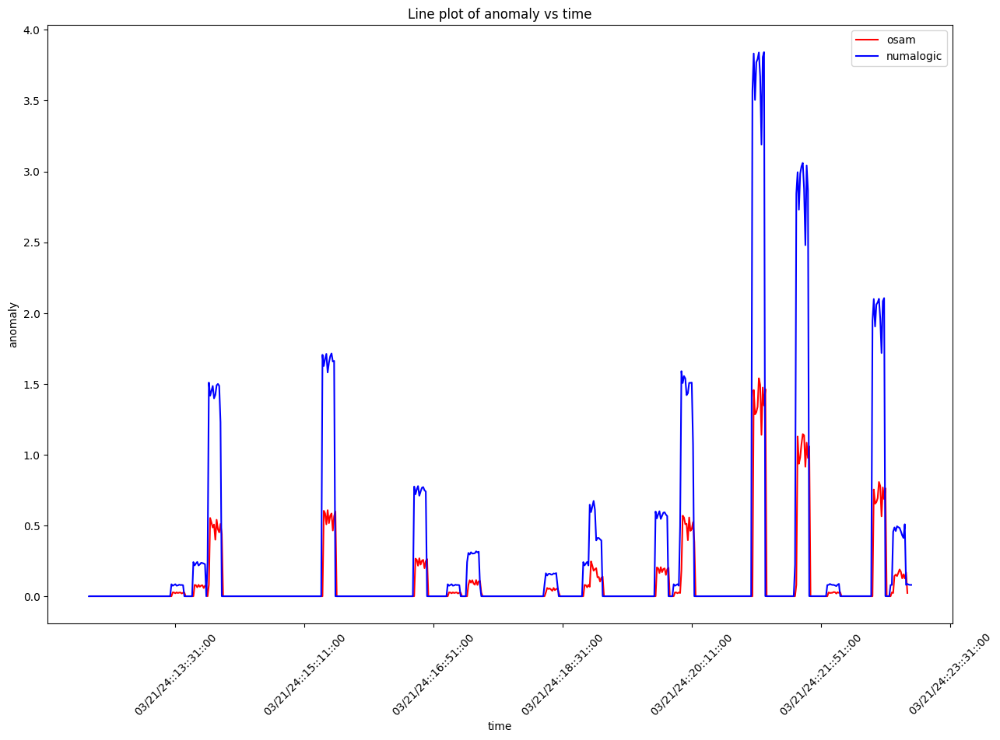

 67%|██████▋   | 165/248 [07:41<03:37,  2.62s/it]

key:  fci:interactionsFailed:1876892737053055605:destroyAgentConnection
Anomaly tp for this graph from OSAM:  0
Anomaly tp for this graph from Numa:  1


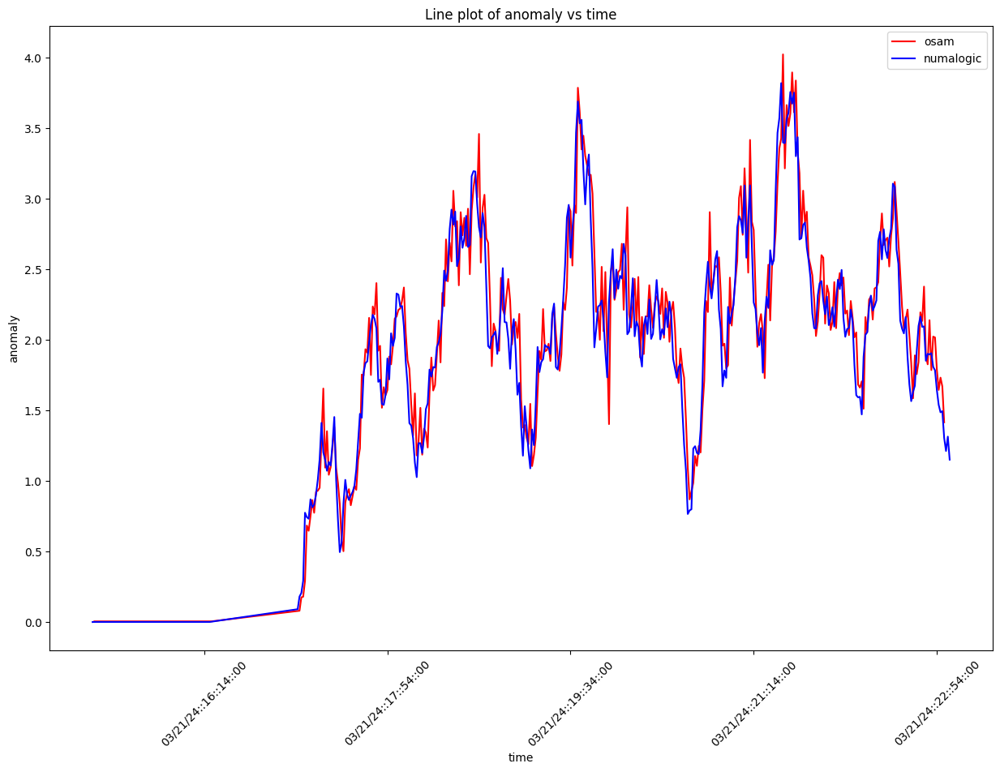

 67%|██████▋   | 166/248 [07:43<03:34,  2.62s/it]

key:  fciPluginInteractions:metrics:2453353489468585843:paymentMethodMonolithOnSearch
Anomaly tp for this graph from OSAM:  3
Anomaly tp for this graph from Numa:  3


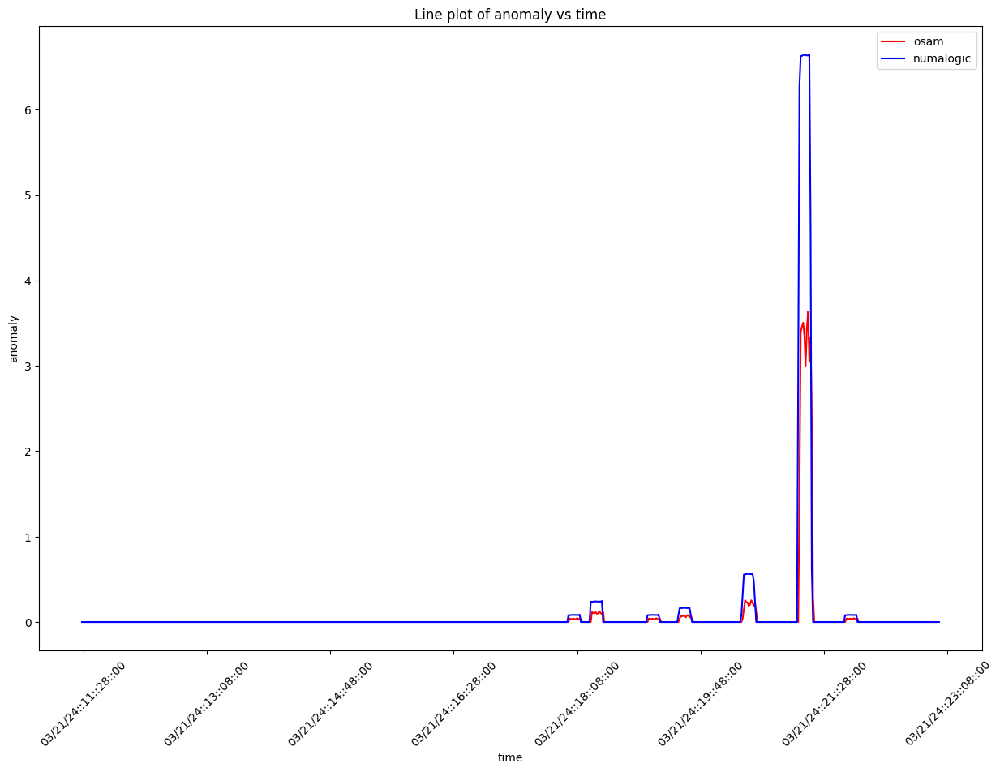

 67%|██████▋   | 167/248 [07:46<03:35,  2.65s/it]

key:  fciPluginInteractions:metrics:5551830033781551331:itsdeductible__homepage_data_loaded
Anomaly tp for this graph from OSAM:  1
Anomaly tp for this graph from Numa:  1


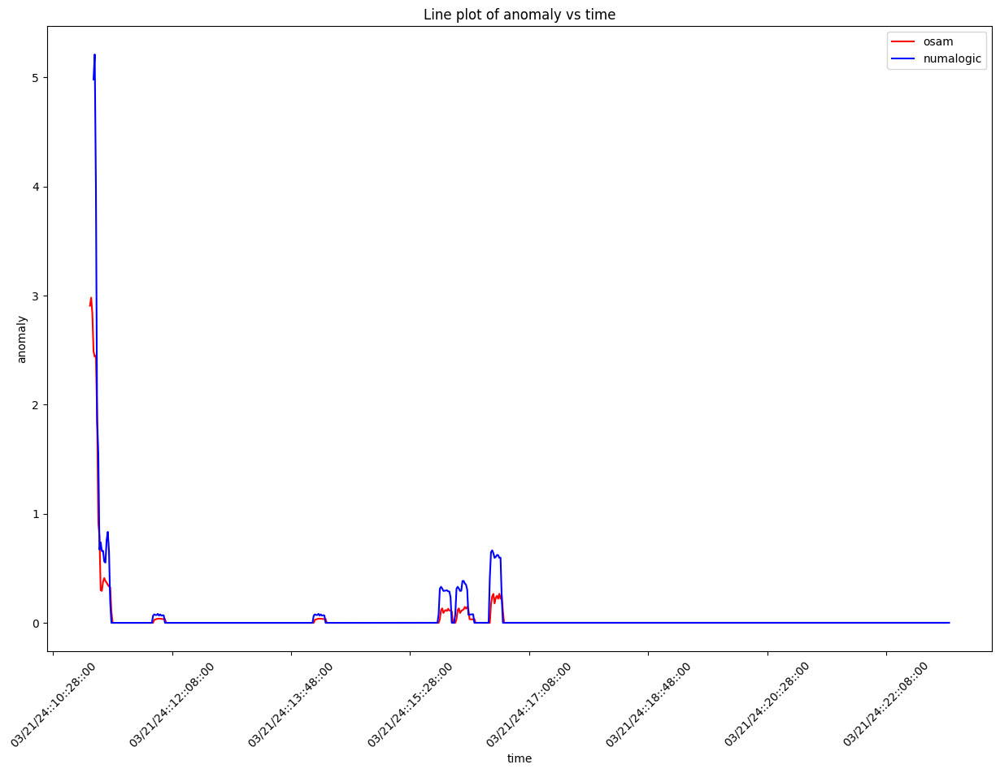

 68%|██████▊   | 168/248 [07:49<03:34,  2.68s/it]

key:  fciPluginInteractions:metrics:435740856470293685:trsnsactionsfc-update-style-preferences
Anomaly tp for this graph from OSAM:  0
Anomaly tp for this graph from Numa:  1


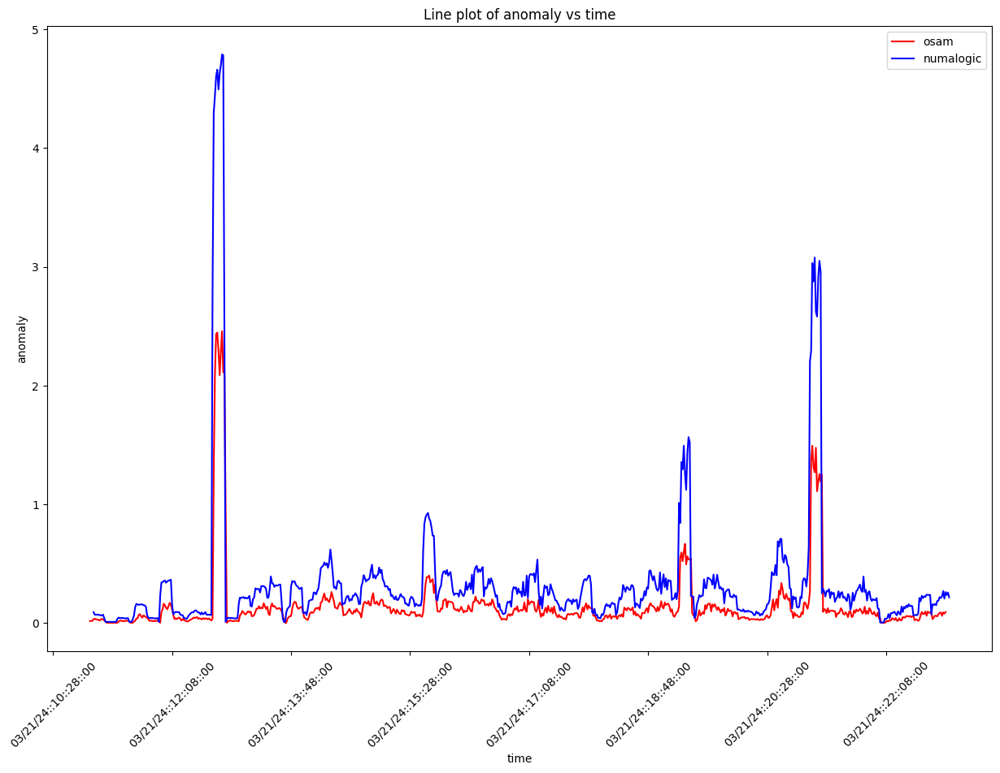

 68%|██████▊   | 169/248 [07:51<03:32,  2.69s/it]

key:  fciPluginInteractions:metrics:3244861123818975982:qbaa.fai.reconcile-ui.IntiStatements
Anomaly tp for this graph from OSAM:  0
Anomaly tp for this graph from Numa:  1


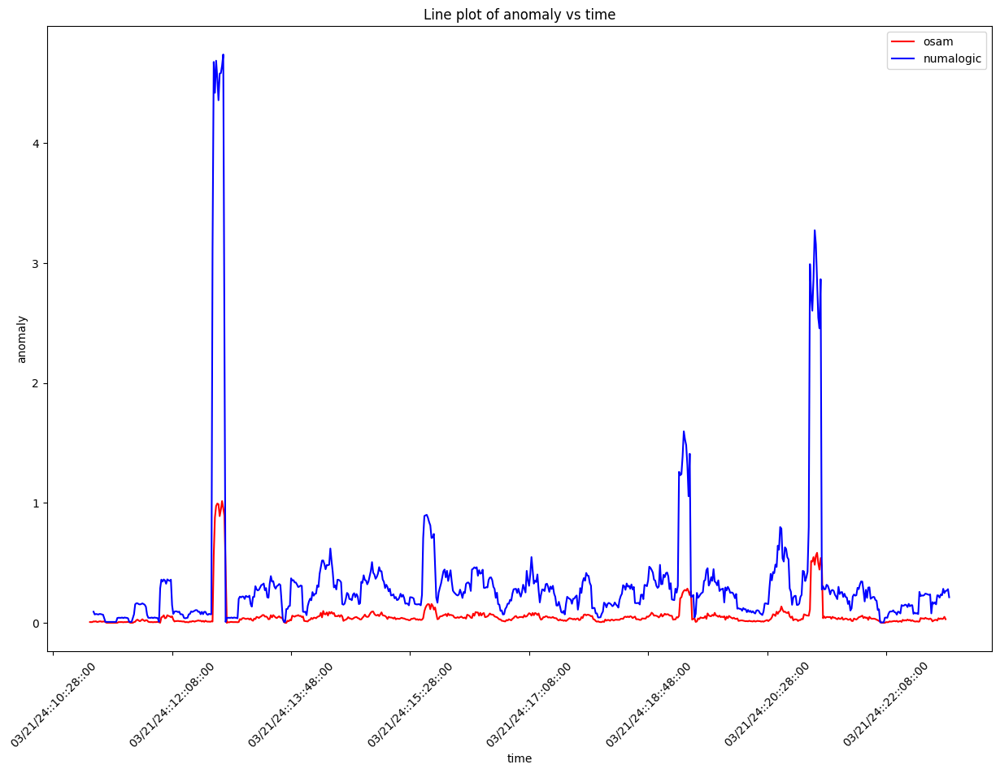

 69%|██████▊   | 170/248 [07:54<03:31,  2.71s/it]

key:  fci:interactionsFailed:5984175597303660107:qbaa.fai.reconcile-ui.IntiStatements
Anomaly tp for this graph from OSAM:  0
Anomaly tp for this graph from Numa:  1


 69%|██████▉   | 171/248 [07:57<03:21,  2.61s/it]

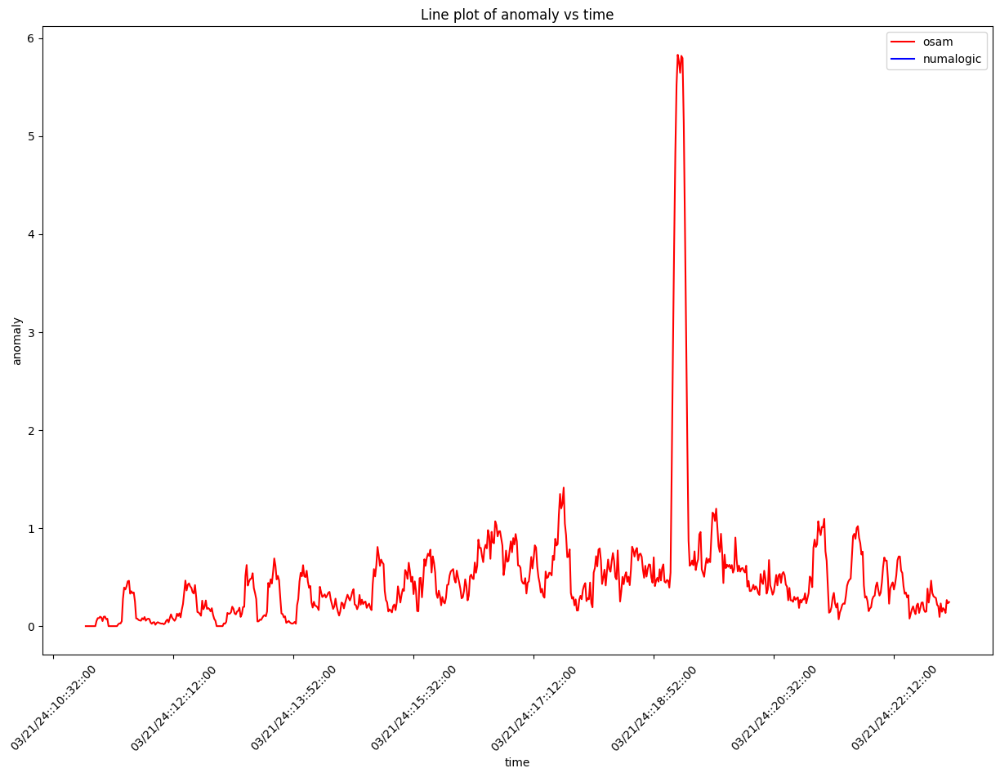

 69%|██████▉   | 172/248 [07:59<03:19,  2.63s/it]

key:  fciPluginAsset:metricsFailedAEV2:3750390182735137211
Anomaly tp for this graph from OSAM:  1
Anomaly tp for this graph from Numa:  0


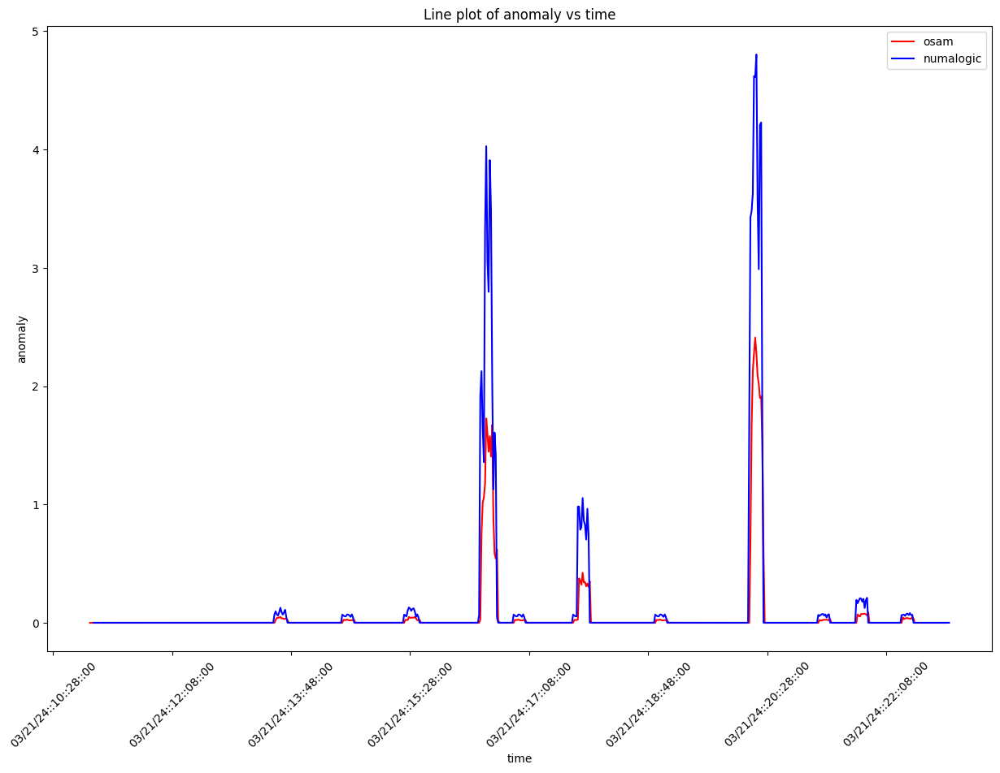

 70%|██████▉   | 173/248 [08:02<03:19,  2.66s/it]

key:  fciPlugin:requestsFailed:868086420502860411:vep-snippets
Anomaly tp for this graph from OSAM:  0
Anomaly tp for this graph from Numa:  2


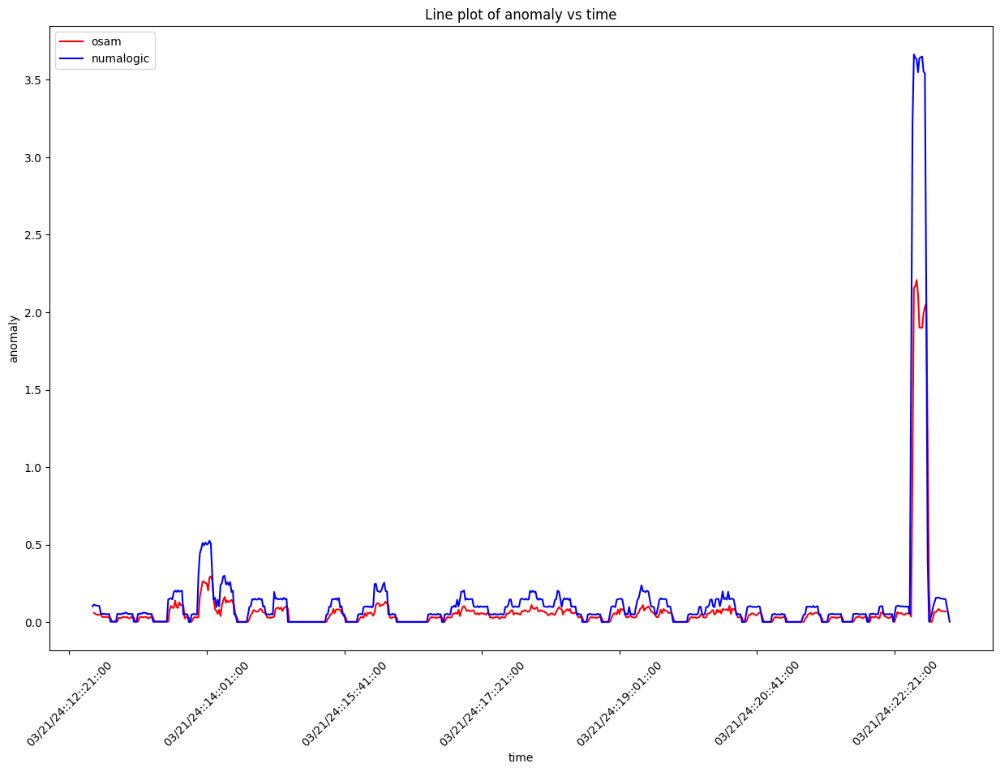

 70%|███████   | 174/248 [08:05<03:18,  2.69s/it]

key:  fciPlugin:requestsFailed:868086420502860411:customer-info-gathering-ui
Anomaly tp for this graph from OSAM:  0
Anomaly tp for this graph from Numa:  1


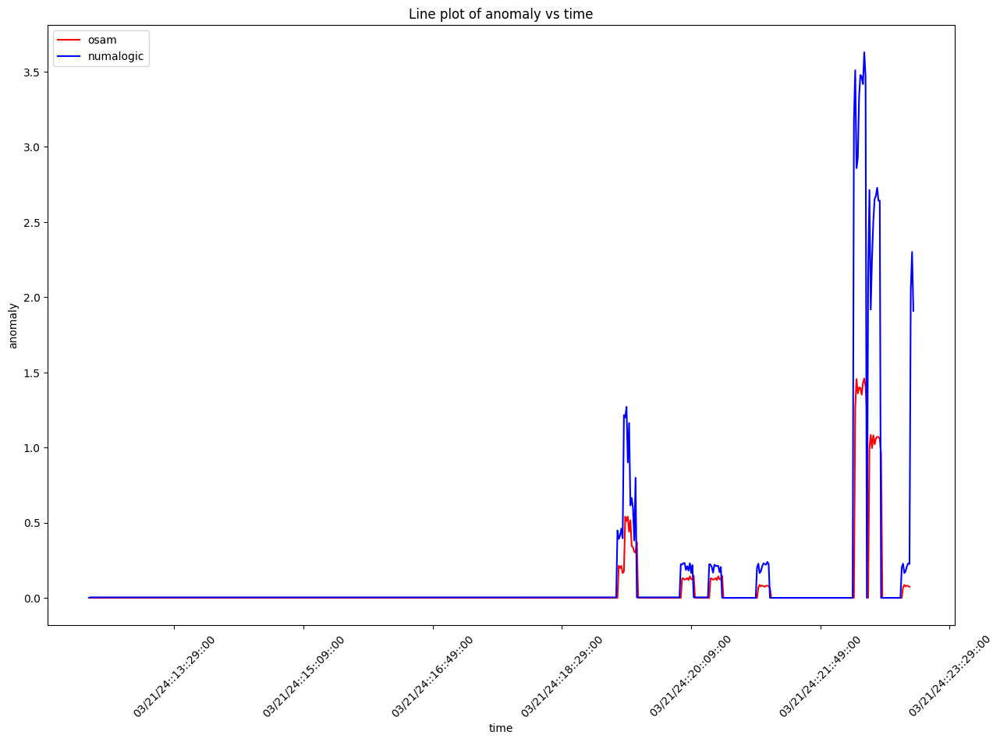

 71%|███████   | 175/248 [08:07<03:16,  2.69s/it]

key:  fciPluginAppInteractions:metrics:3101871836022059397:868086420502860411:search_widget_autosuggest_load
Anomaly tp for this graph from OSAM:  0
Anomaly tp for this graph from Numa:  1


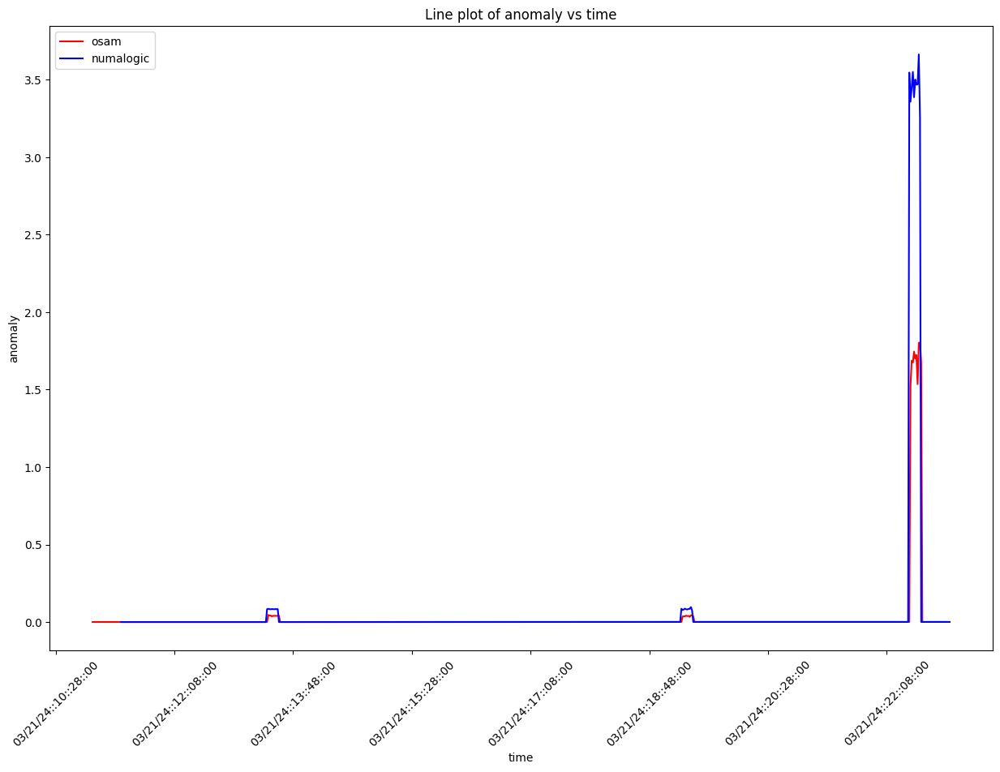

 71%|███████   | 176/248 [08:10<03:16,  2.73s/it]

key:  fci:interactionsFailed:868086420502860411:Collab_Docmgmt_UI_Get_Files_By_Ids_Elastic_Search
Anomaly tp for this graph from OSAM:  0
Anomaly tp for this graph from Numa:  1


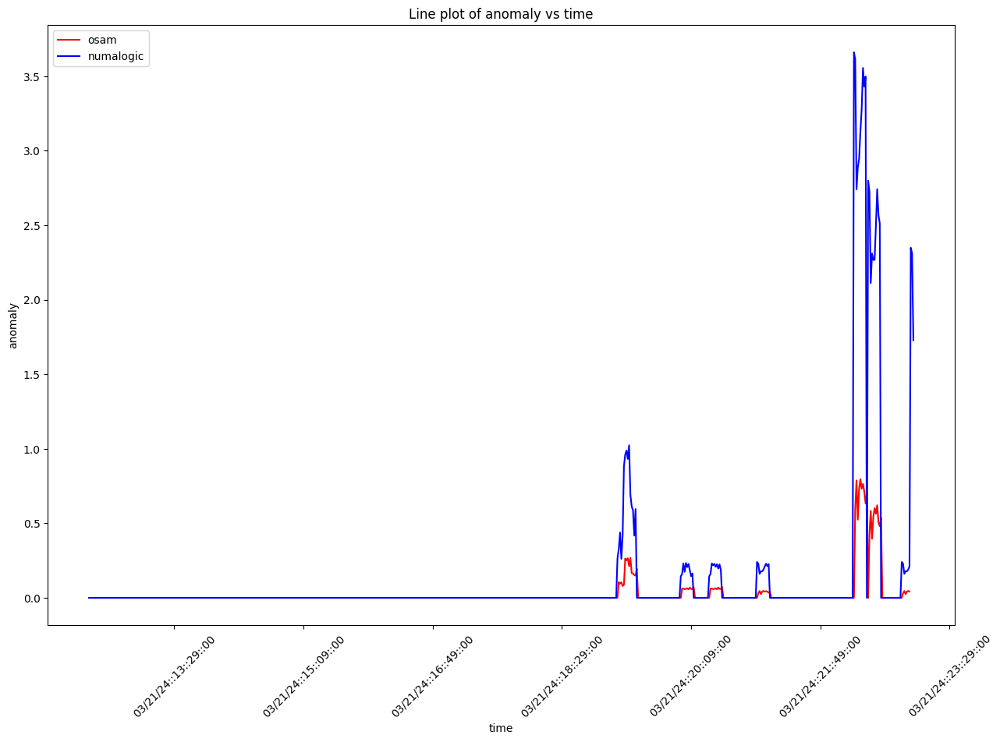

 71%|███████▏  | 177/248 [08:13<03:14,  2.73s/it]

key:  fci:interactionsFailed:868086420502860411:search_widget_autosuggest_load
Anomaly tp for this graph from OSAM:  0
Anomaly tp for this graph from Numa:  1


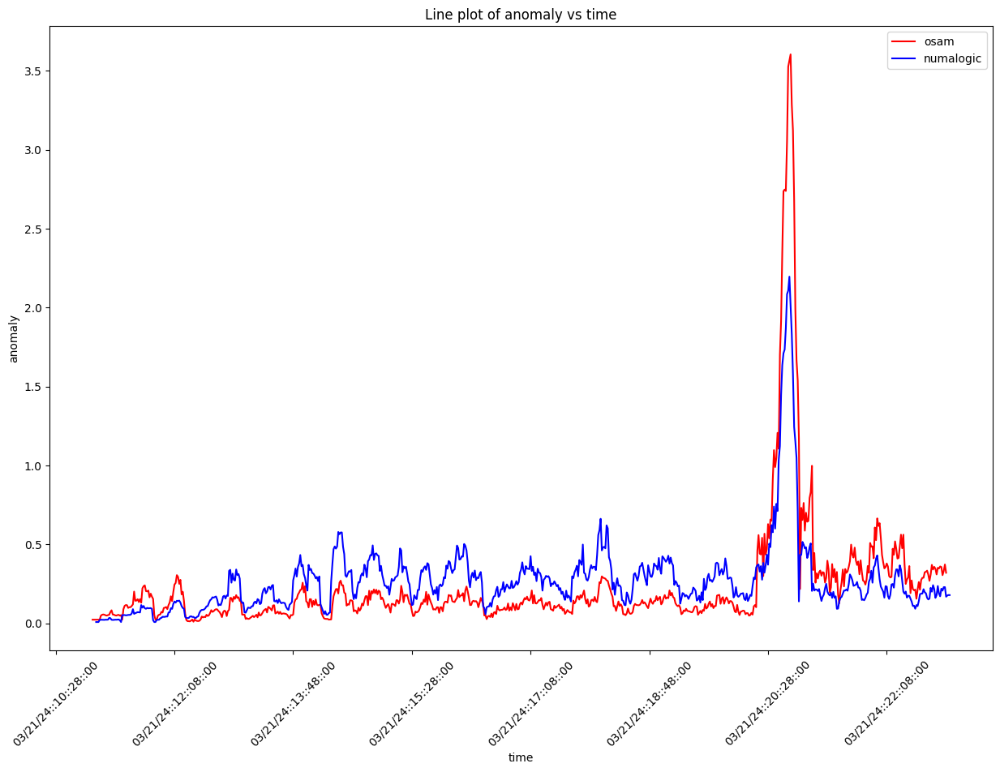

 72%|███████▏  | 178/248 [08:16<03:12,  2.75s/it]

key:  fciPluginAppInteractions:metrics:5047426875404986759:5984175597303660107:TXP/expenses-forms-ui/saveTxn_customized
Anomaly tp for this graph from OSAM:  1
Anomaly tp for this graph from Numa:  0


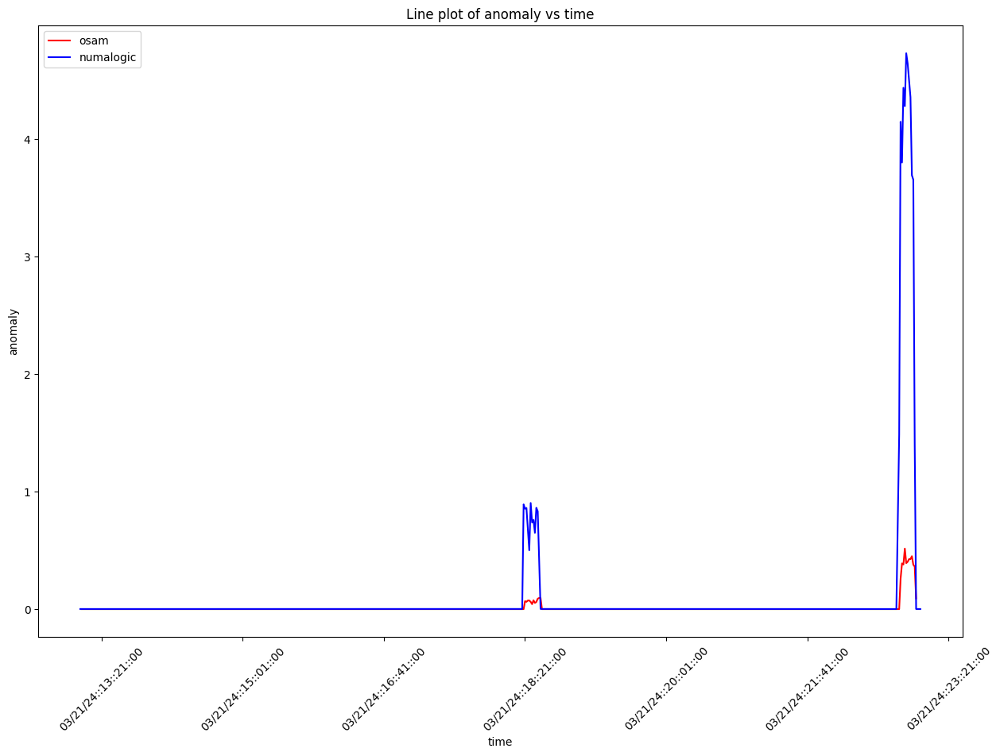

 72%|███████▏  | 179/248 [08:18<03:07,  2.72s/it]

key:  fci:interactionsFailed:8506191388536189707:search_widget_autosuggest_load
Anomaly tp for this graph from OSAM:  0
Anomaly tp for this graph from Numa:  1


 73%|███████▎  | 181/248 [08:24<02:56,  2.63s/it]

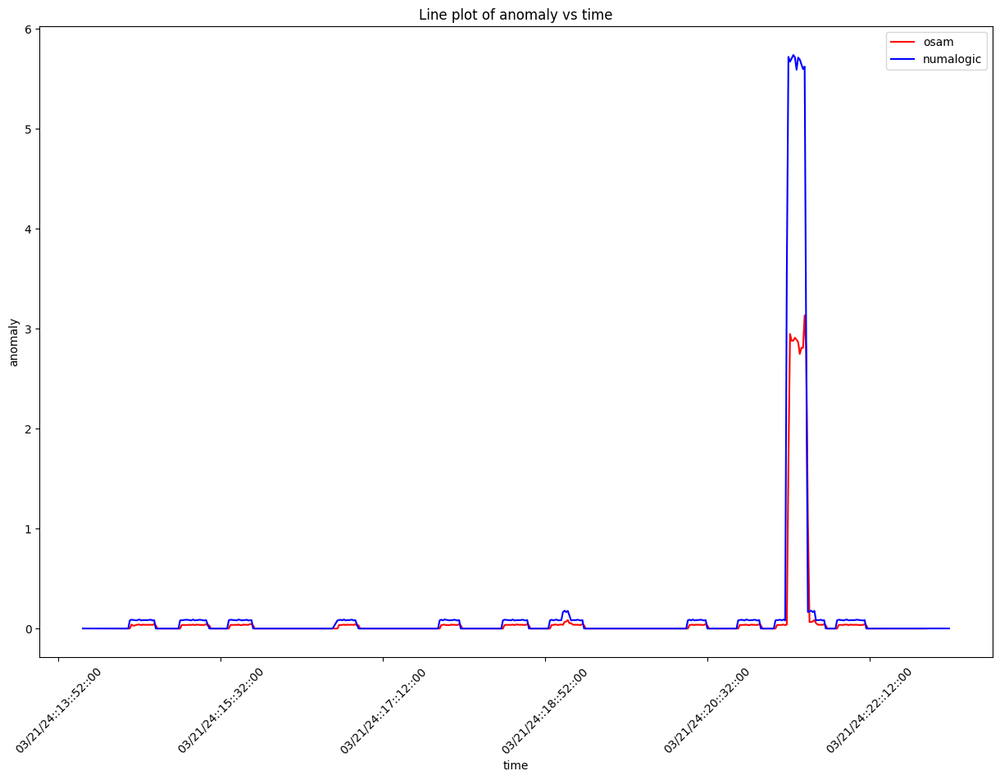

 73%|███████▎  | 182/248 [08:26<02:54,  2.64s/it]

key:  fci:interactionsFailed:868086420502860411:conferenceConnections
Anomaly tp for this graph from OSAM:  0
Anomaly tp for this graph from Numa:  1


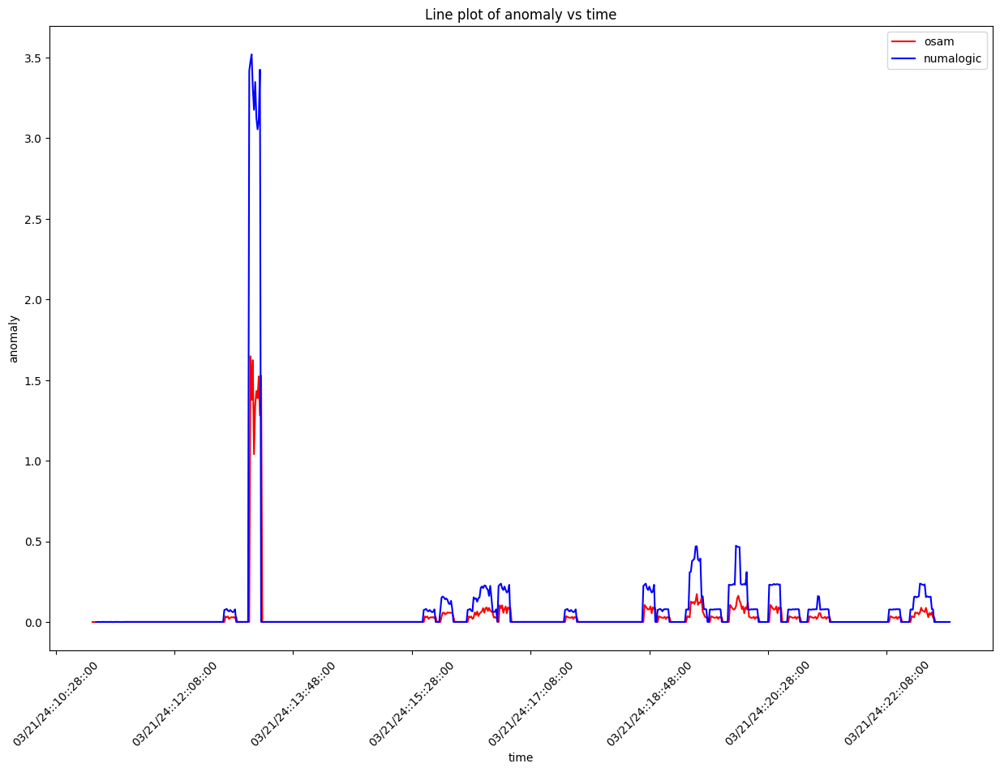

 74%|███████▍  | 183/248 [08:29<02:53,  2.67s/it]

key:  fciPluginAppInteractions:metrics:147510480122425241:5984175597306586857:SH_LOAD_AUTOSUGGEST
Anomaly tp for this graph from OSAM:  0
Anomaly tp for this graph from Numa:  1


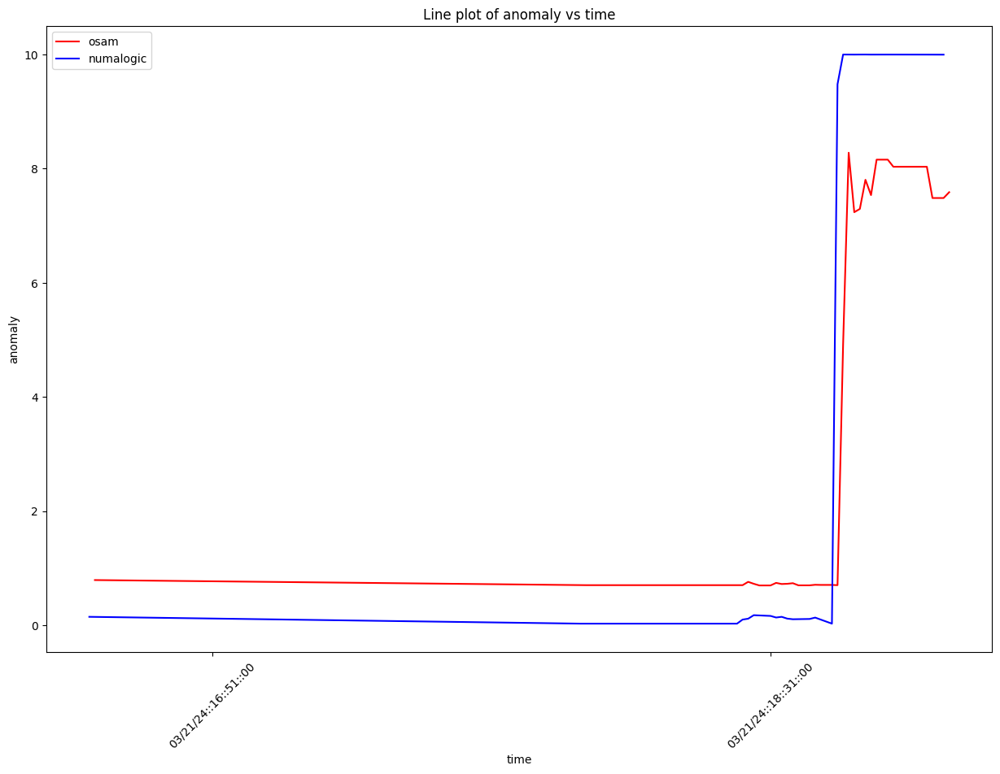

 74%|███████▍  | 184/248 [08:32<02:50,  2.67s/it]

key:  fciAsset:assetFailed:8650306576776437609
Anomaly tp for this graph from OSAM:  2
Anomaly tp for this graph from Numa:  0


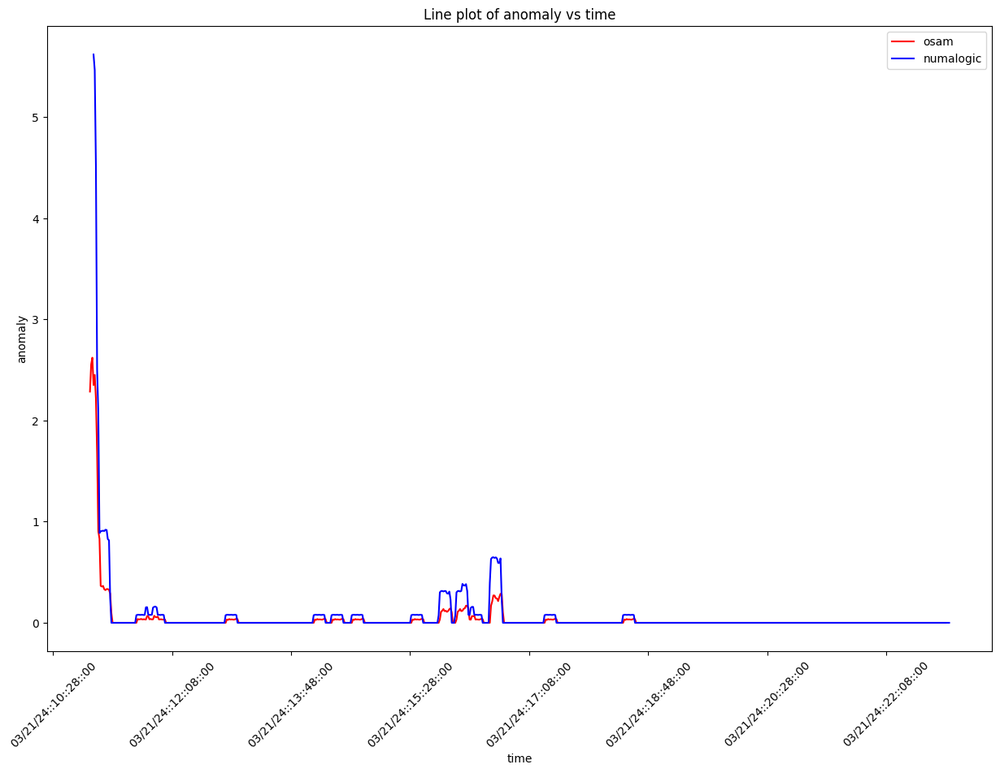

 75%|███████▍  | 185/248 [08:34<02:48,  2.68s/it]

key:  fci:interactionsFailed:5984175597303660107:TemplatePrefSaveInteraction
Anomaly tp for this graph from OSAM:  0
Anomaly tp for this graph from Numa:  1


 75%|███████▌  | 186/248 [08:37<02:42,  2.61s/it]

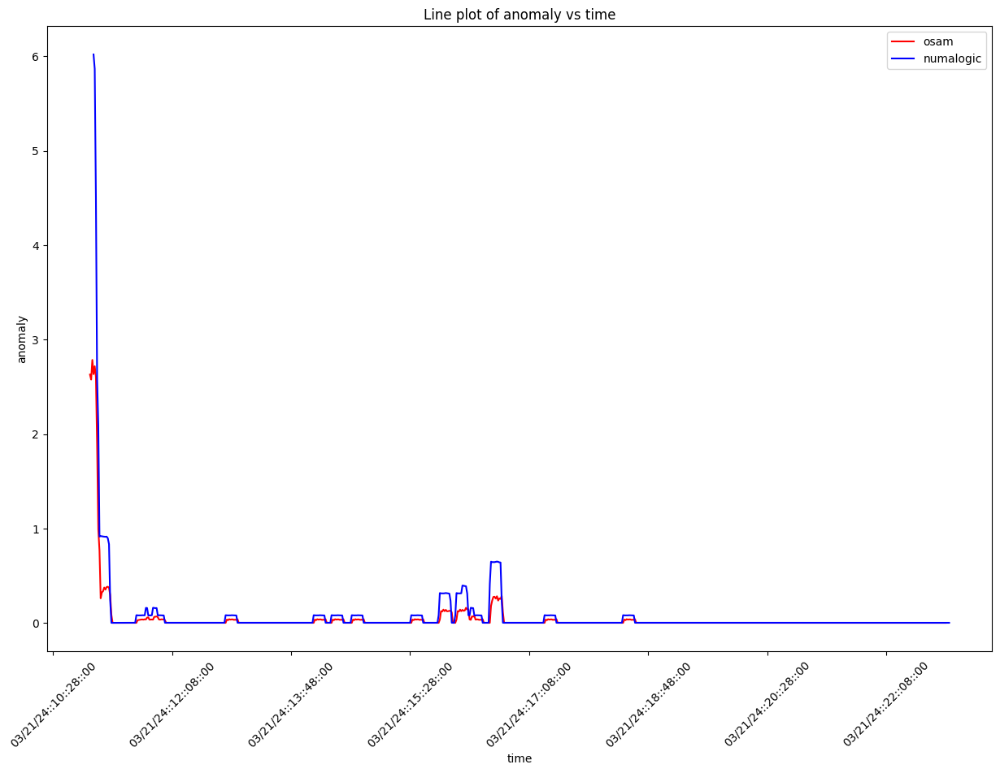

 75%|███████▌  | 187/248 [08:40<02:42,  2.66s/it]

key:  fciPluginInteractions:metrics:435740856470293685:TemplatePrefSaveInteraction
Anomaly tp for this graph from OSAM:  0
Anomaly tp for this graph from Numa:  1


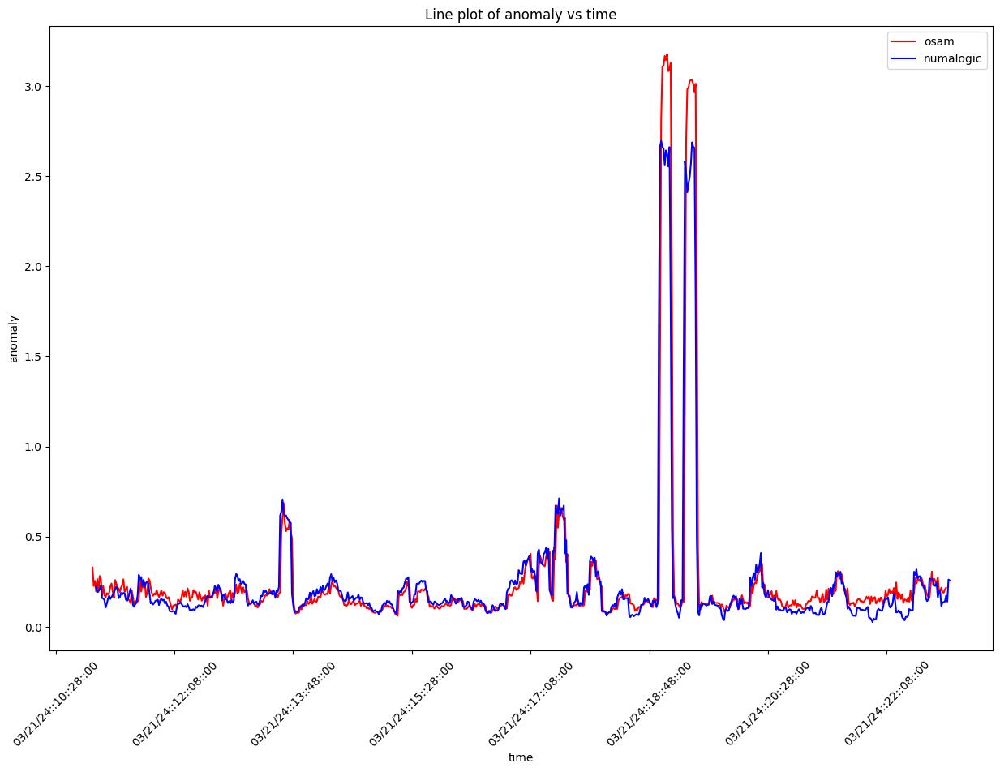

 76%|███████▌  | 188/248 [08:42<02:41,  2.69s/it]

key:  fciPluginInteractions:metrics:2453353489468585843:contactOnSearch
Anomaly tp for this graph from OSAM:  2
Anomaly tp for this graph from Numa:  0


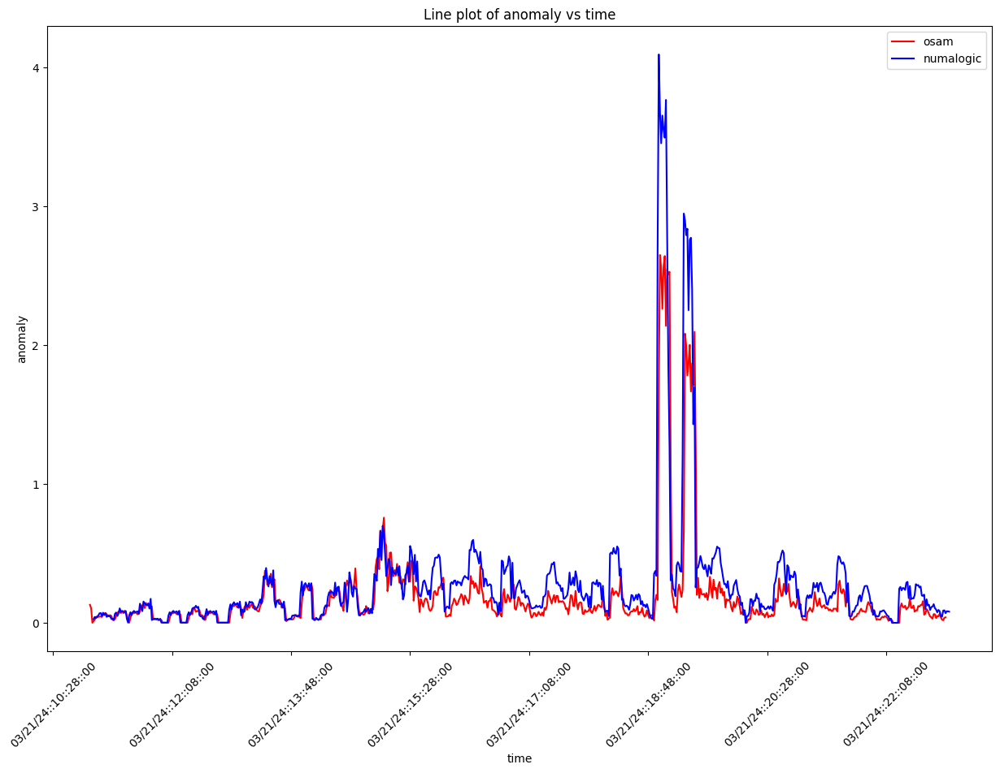

 76%|███████▌  | 189/248 [08:45<02:40,  2.72s/it]

key:  fciPluginInteractions:metrics:7857673042555304003:tableOnSearch
Anomaly tp for this graph from OSAM:  0
Anomaly tp for this graph from Numa:  1


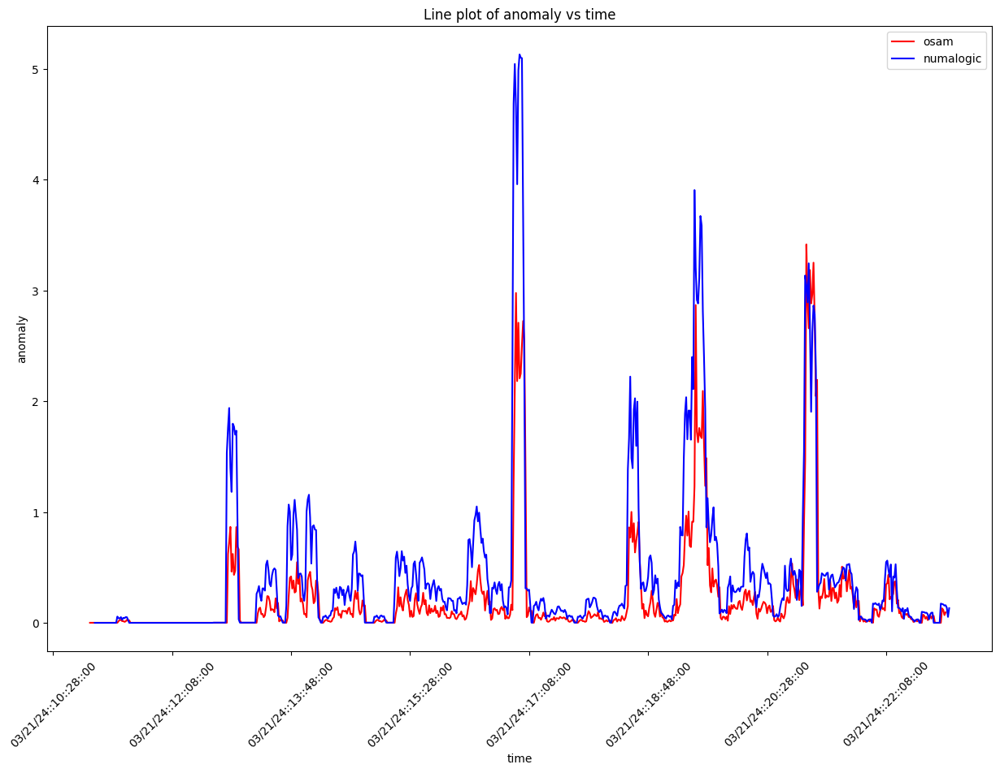

 77%|███████▋  | 190/248 [08:48<02:37,  2.72s/it]

key:  fciPluginInteractions:metrics:3101871835697829167:resumeAllConnections
Anomaly tp for this graph from OSAM:  0
Anomaly tp for this graph from Numa:  2


 77%|███████▋  | 191/248 [08:50<02:31,  2.66s/it]

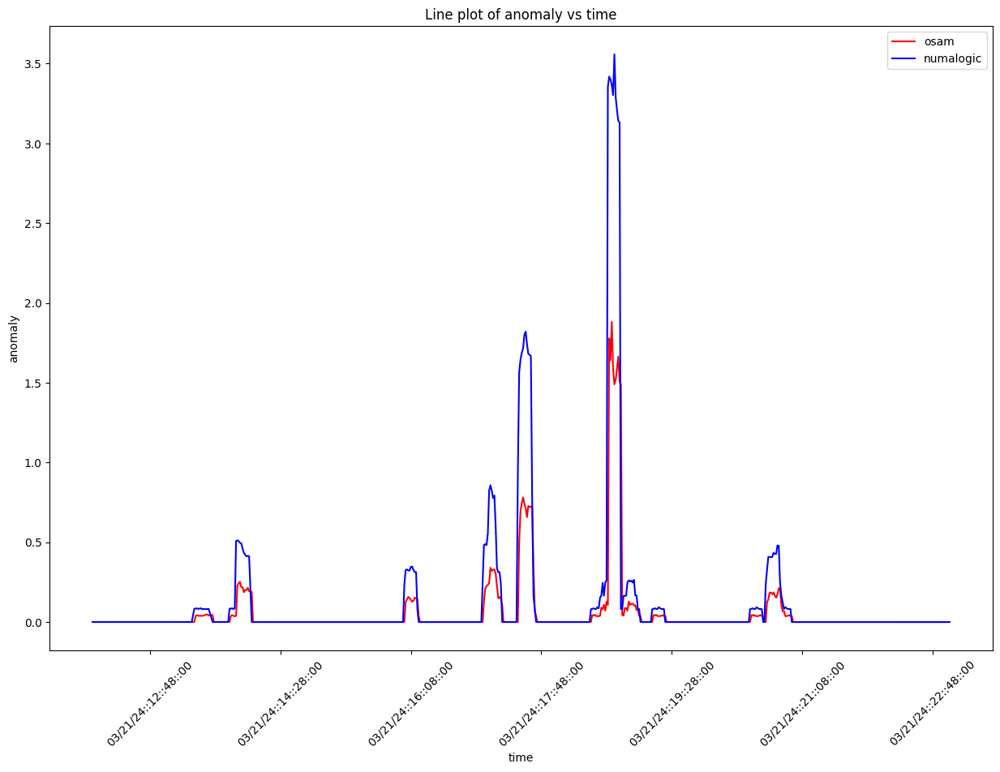

 77%|███████▋  | 192/248 [08:53<02:31,  2.71s/it]

key:  fci:interactionsFailed:5984175597303660107:REVIEW_RECIPIENTS
Anomaly tp for this graph from OSAM:  0
Anomaly tp for this graph from Numa:  1


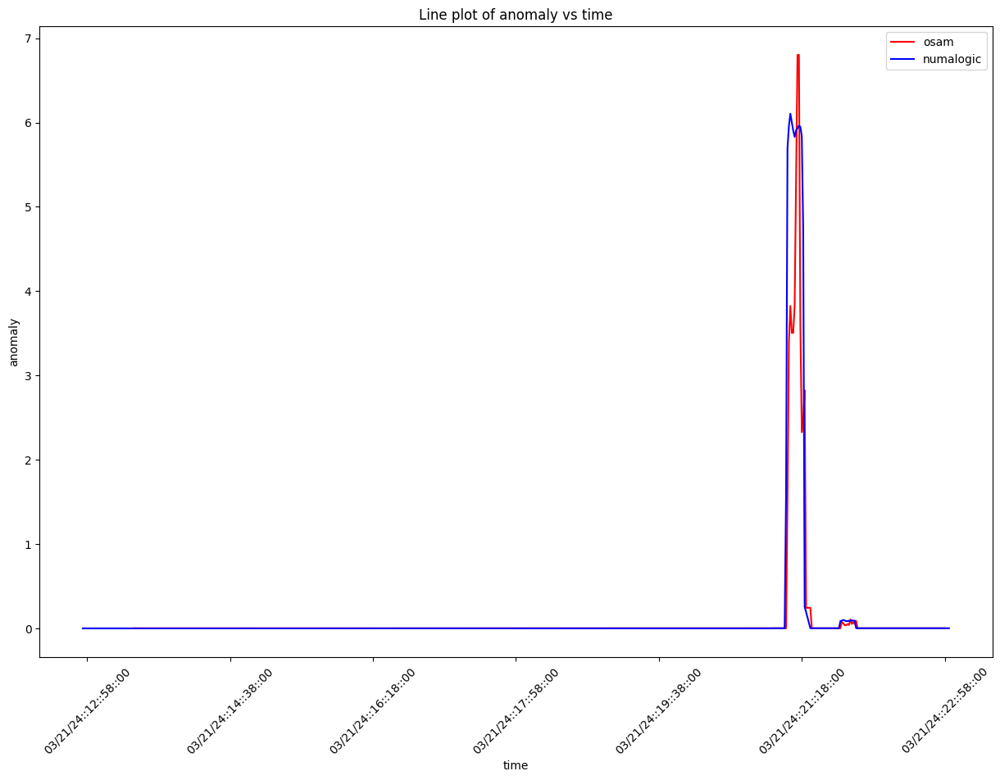

 78%|███████▊  | 193/248 [08:56<02:31,  2.76s/it]

key:  fciPluginInteractions:metrics:5551830033781551331:itsdeductible__personal_info_loaded
Anomaly tp for this graph from OSAM:  1
Anomaly tp for this graph from Numa:  1


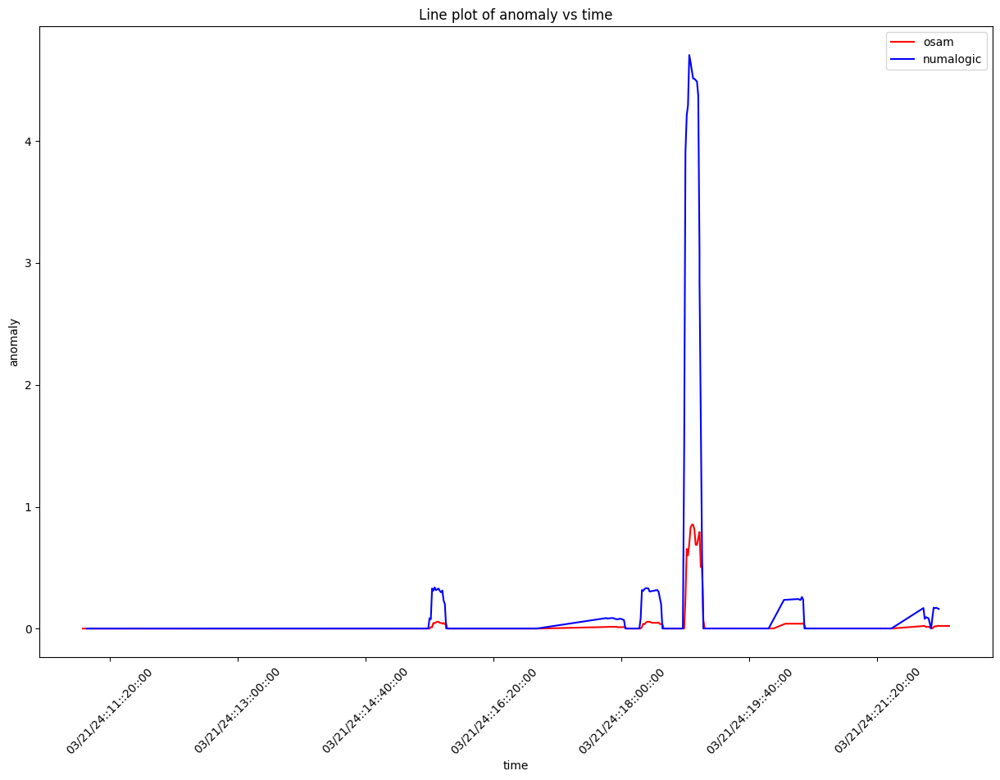

 78%|███████▊  | 194/248 [08:59<02:28,  2.74s/it]

key:  fciPlugin:requestsFailed:5047426874833558809:a4a-tac
Anomaly tp for this graph from OSAM:  0
Anomaly tp for this graph from Numa:  1


 79%|███████▊  | 195/248 [09:01<02:25,  2.74s/it]

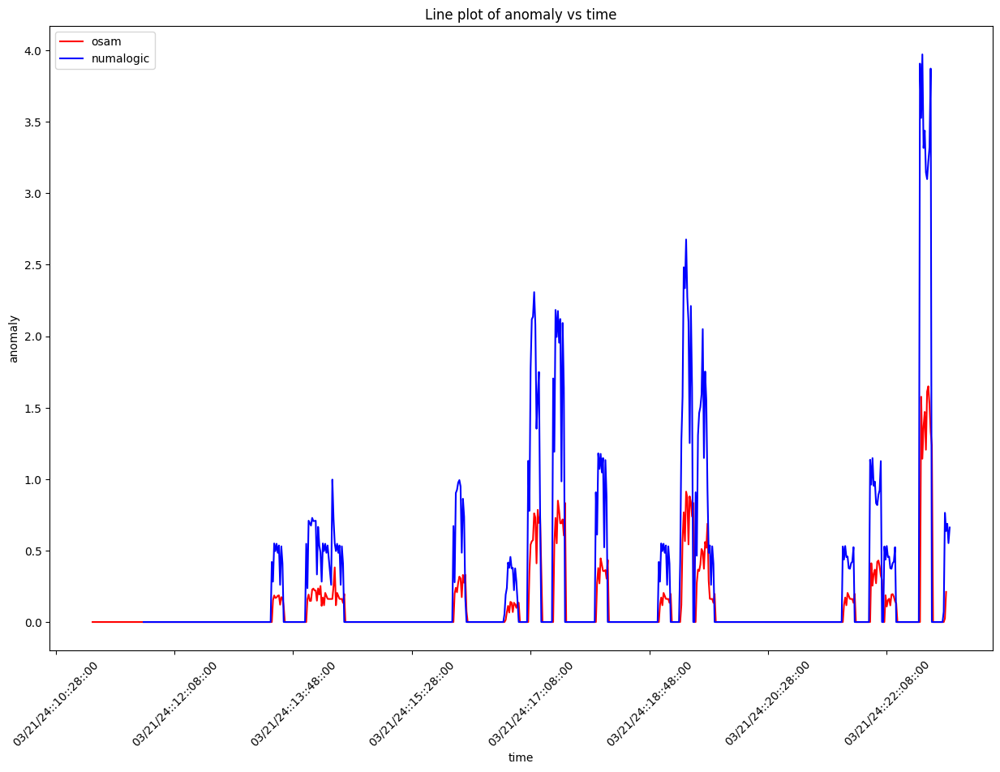

 79%|███████▉  | 196/248 [09:04<02:21,  2.72s/it]

key:  fciPluginInteractions:metrics:8217961012385696693:Collab_Docmgmt_UI_Delete_Document
Anomaly tp for this graph from OSAM:  0
Anomaly tp for this graph from Numa:  1


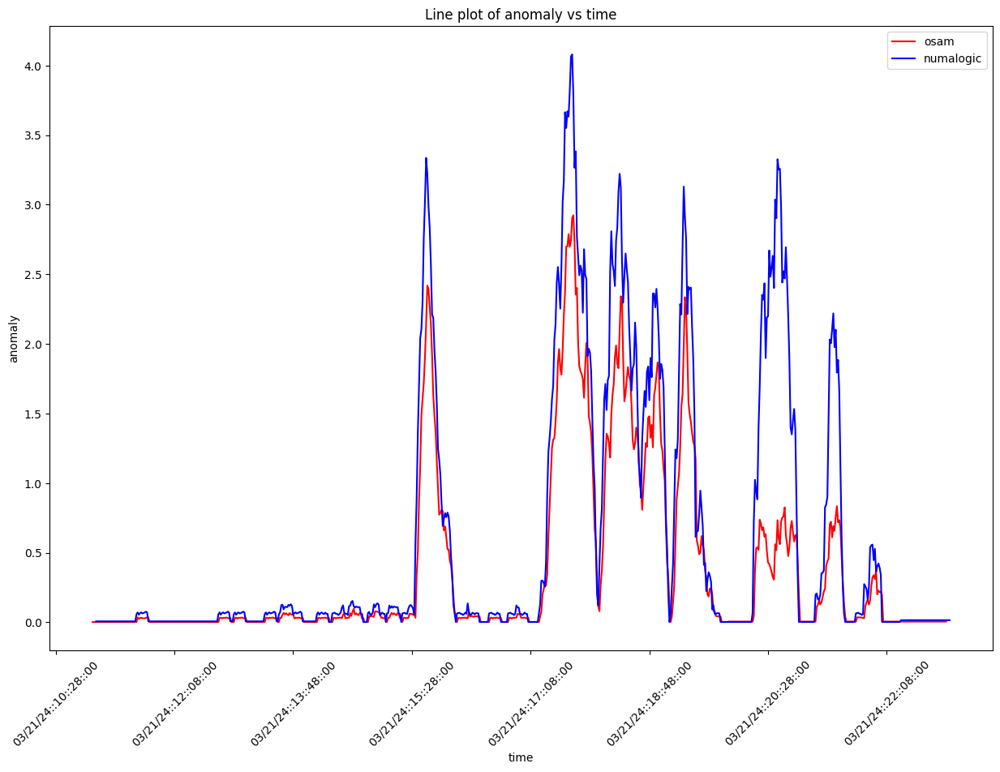

 79%|███████▉  | 197/248 [09:07<02:19,  2.73s/it]

key:  fciPluginInteractions:metrics:937892214703082231:BANKING_CARD_LOAD
Anomaly tp for this graph from OSAM:  0
Anomaly tp for this graph from Numa:  4


 80%|███████▉  | 198/248 [09:09<02:12,  2.66s/it]

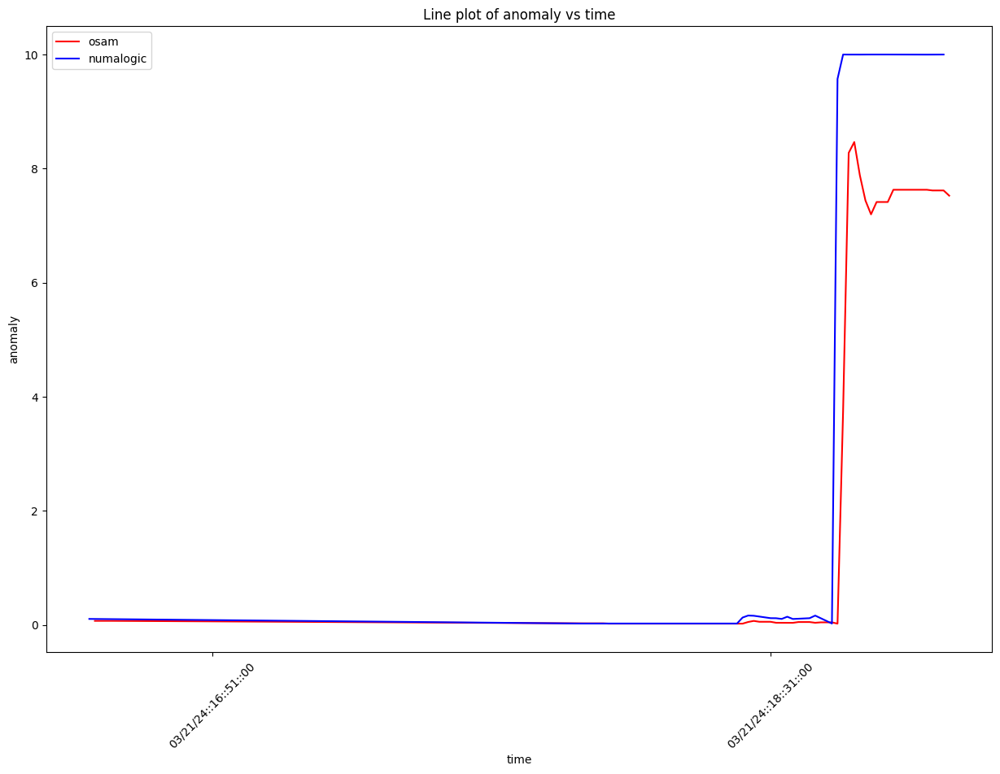

 80%|████████  | 199/248 [09:12<02:09,  2.65s/it]

key:  fciPlugin:requestsFailed:8650306576776437609:content-studio-plugin
Anomaly tp for this graph from OSAM:  2
Anomaly tp for this graph from Numa:  0


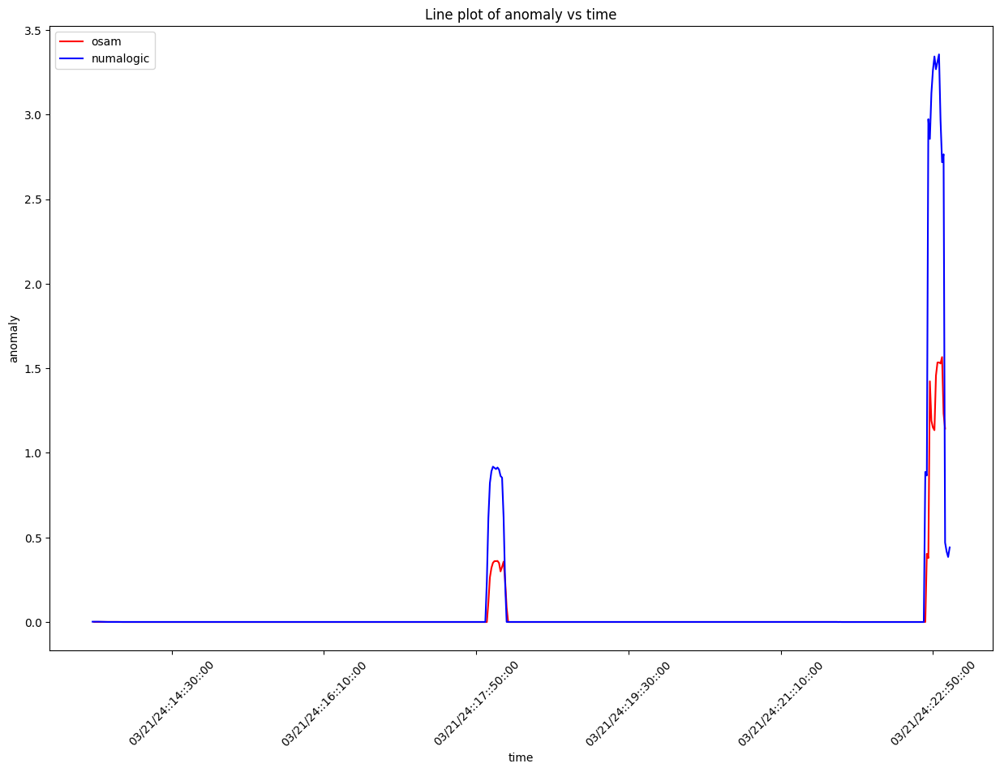

 81%|████████  | 200/248 [09:15<02:09,  2.69s/it]

key:  fciPluginInteractions:metrics:5119484469024512735:CompleteCheckLandingTable-Page-views-0.il_completecheck.CallTopic
Anomaly tp for this graph from OSAM:  0
Anomaly tp for this graph from Numa:  1


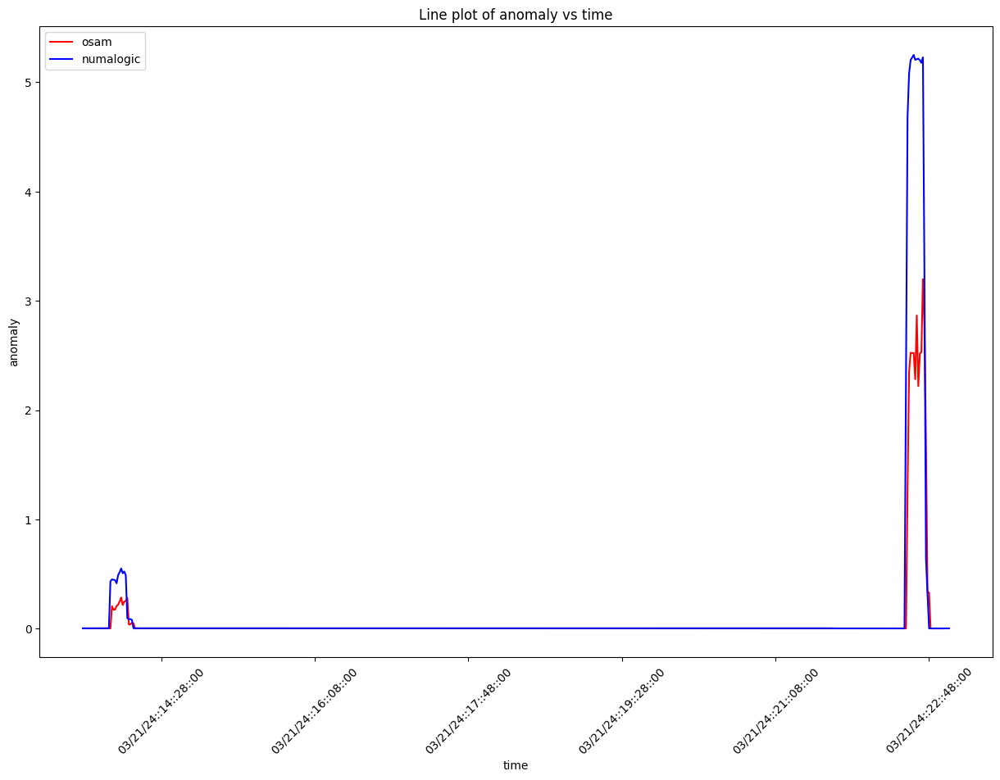

 81%|████████  | 201/248 [09:17<02:05,  2.68s/it]

key:  fci:interactionsFailed:868086420502860411:Customer_info_gathering_Update_Specification
Anomaly tp for this graph from OSAM:  0
Anomaly tp for this graph from Numa:  1


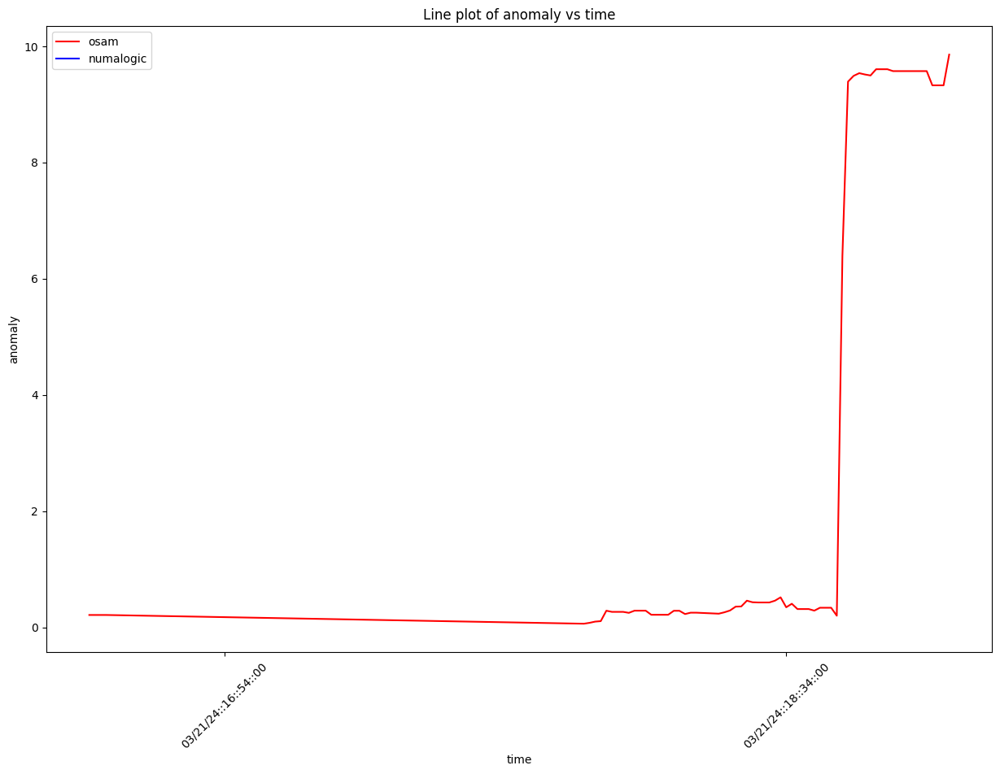

 81%|████████▏ | 202/248 [09:20<02:04,  2.70s/it]

key:  fciAsset:asset:8650306576776437609
Anomaly tp for this graph from OSAM:  1
Anomaly tp for this graph from Numa:  0


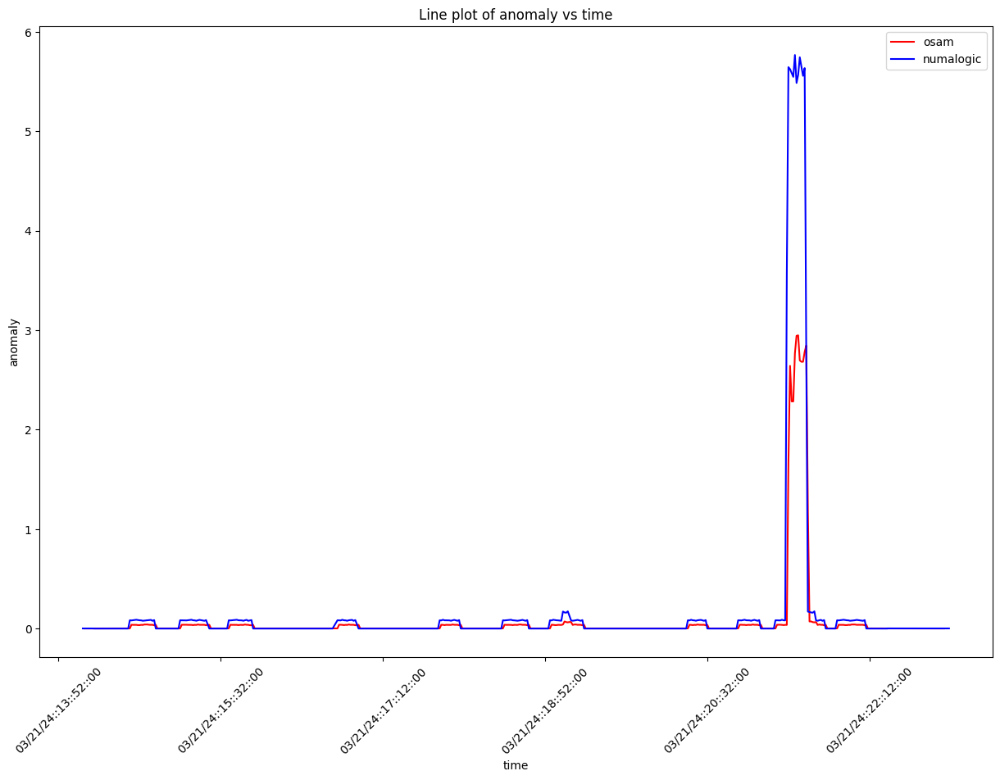

 82%|████████▏ | 203/248 [09:23<02:02,  2.73s/it]

key:  fciPluginAppInteractions:metrics:3101871835697829167:868086420502860411:conferenceConnections
Anomaly tp for this graph from OSAM:  0
Anomaly tp for this graph from Numa:  1


 82%|████████▏ | 204/248 [09:26<01:57,  2.67s/it]

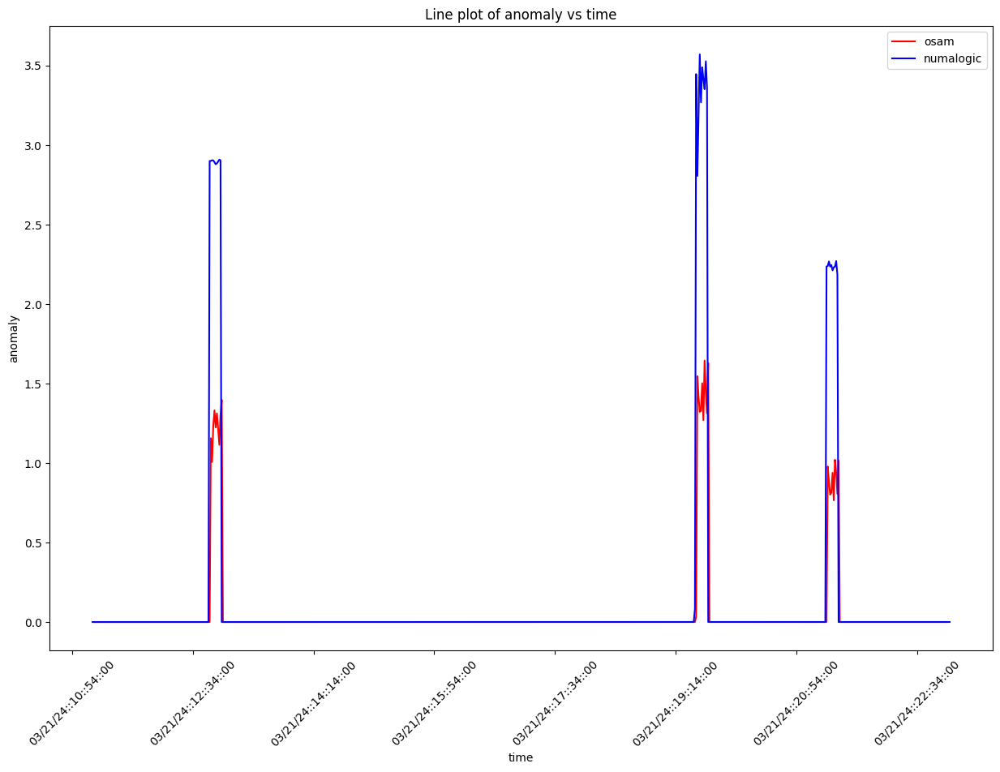

 83%|████████▎ | 205/248 [09:28<01:55,  2.70s/it]

key:  fciPluginAppInteractions:metrics:5479772439188364105:868086420502860411:EXPERT_SEARCH_INTERACTION
Anomaly tp for this graph from OSAM:  0
Anomaly tp for this graph from Numa:  1


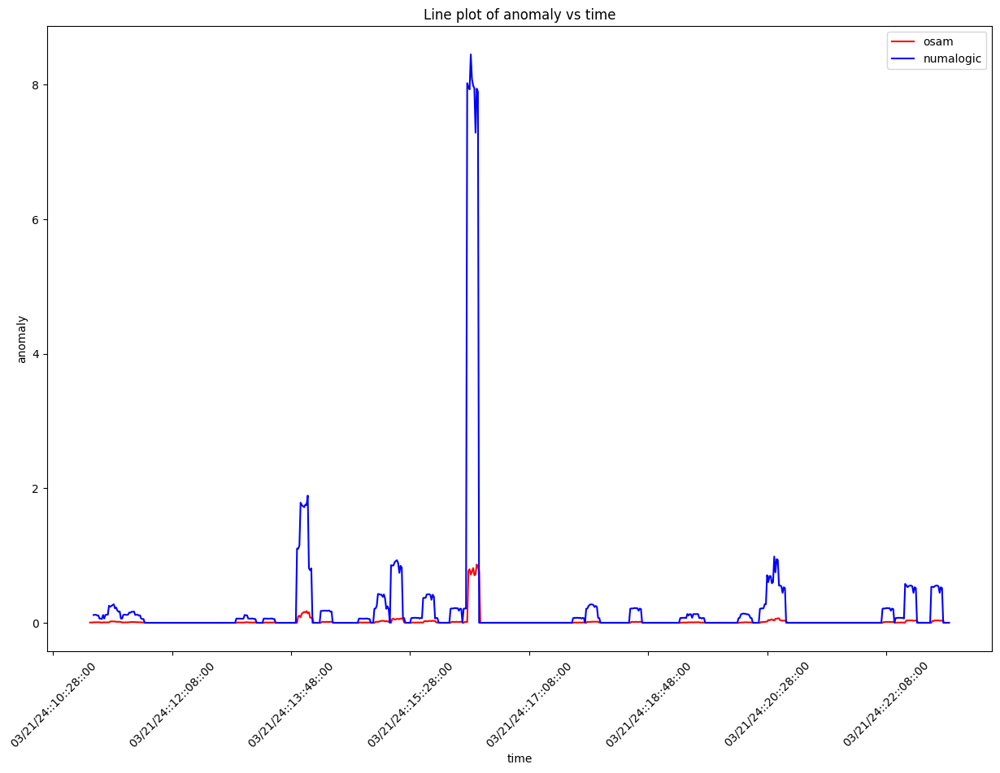

 83%|████████▎ | 206/248 [09:31<01:56,  2.78s/it]

key:  fciPluginAsset:metricsFailed:3390102212540743511
Anomaly tp for this graph from OSAM:  0
Anomaly tp for this graph from Numa:  1


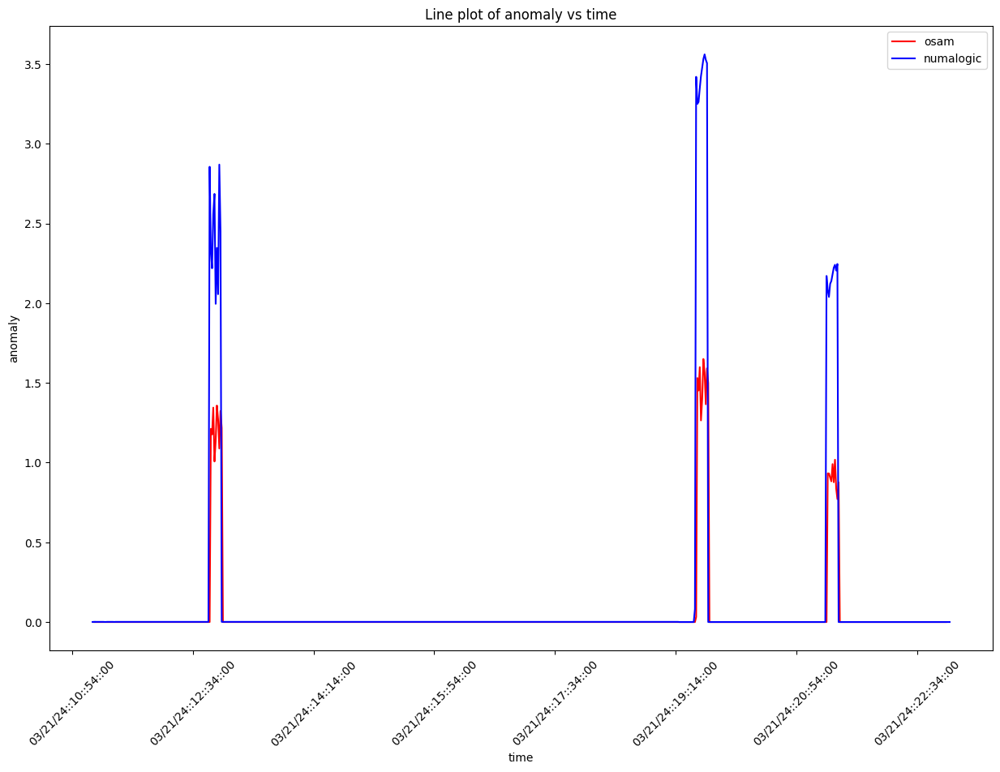

 83%|████████▎ | 207/248 [09:34<01:54,  2.78s/it]

key:  fciPlugin:requestsFailed:868086420502860411:expert-search-list
Anomaly tp for this graph from OSAM:  0
Anomaly tp for this graph from Numa:  1


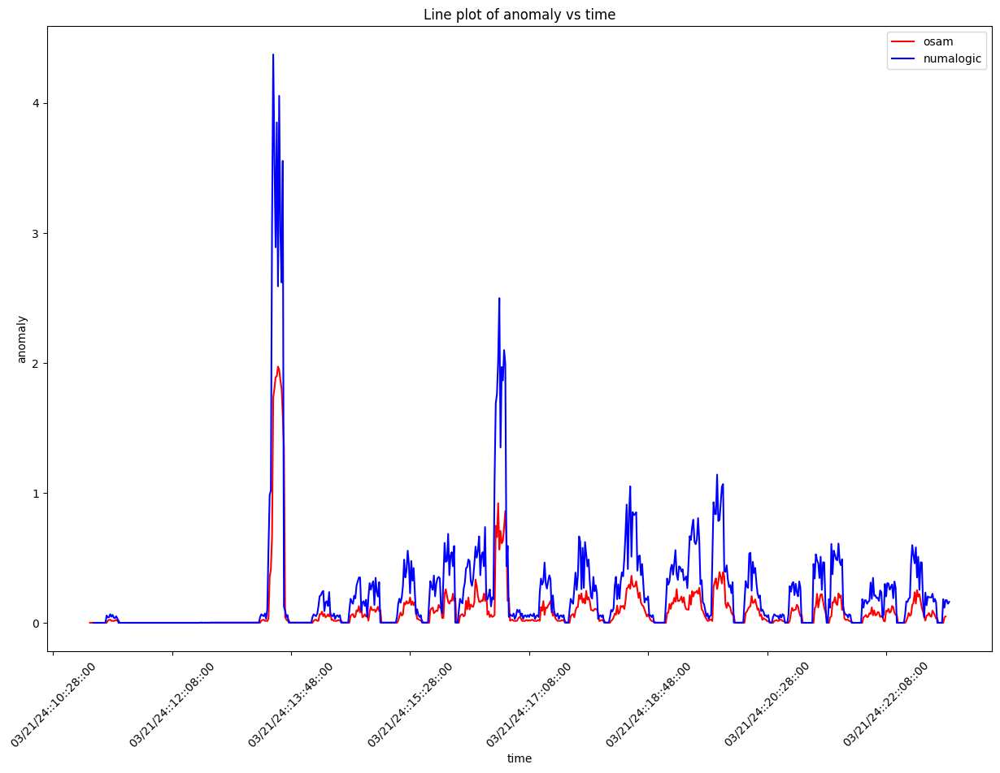

 84%|████████▍ | 208/248 [09:37<01:57,  2.94s/it]

key:  fci:interactionsFailed:5984175597303660107:qbaa.fai.bankconnections-ui.ProcessOfxFile
Anomaly tp for this graph from OSAM:  0
Anomaly tp for this graph from Numa:  1


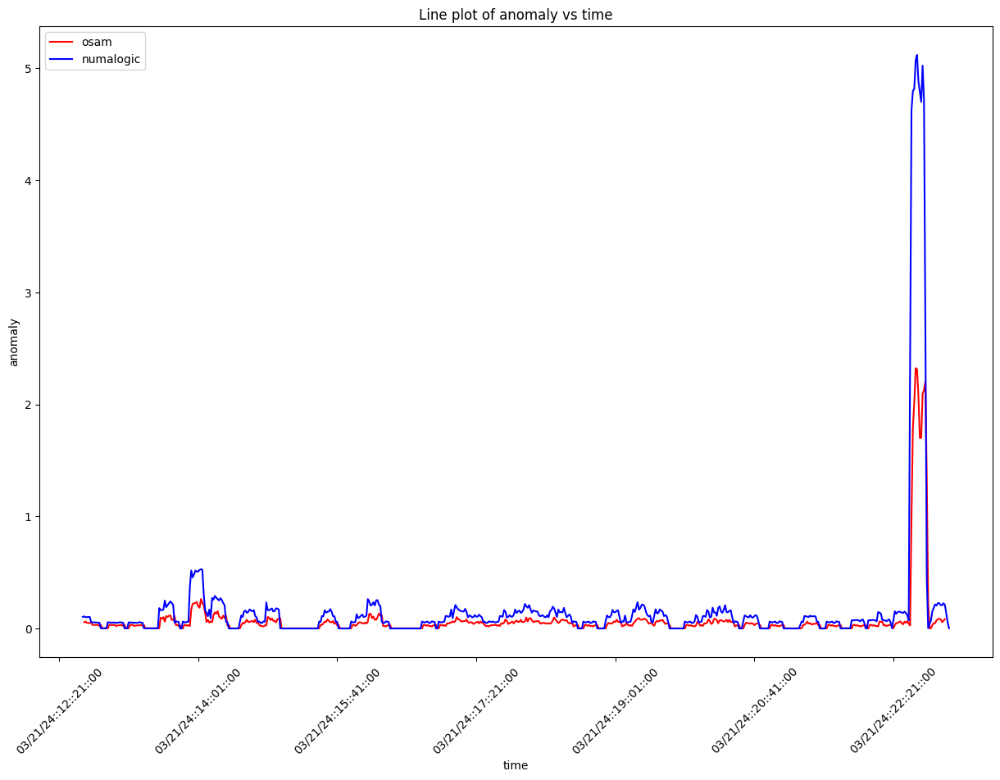

 84%|████████▍ | 209/248 [09:41<02:01,  3.12s/it]

key:  fciPluginAsset:metricsFailed:3966562964805320729
Anomaly tp for this graph from OSAM:  0
Anomaly tp for this graph from Numa:  1


 85%|████████▍ | 210/248 [09:44<01:55,  3.03s/it]

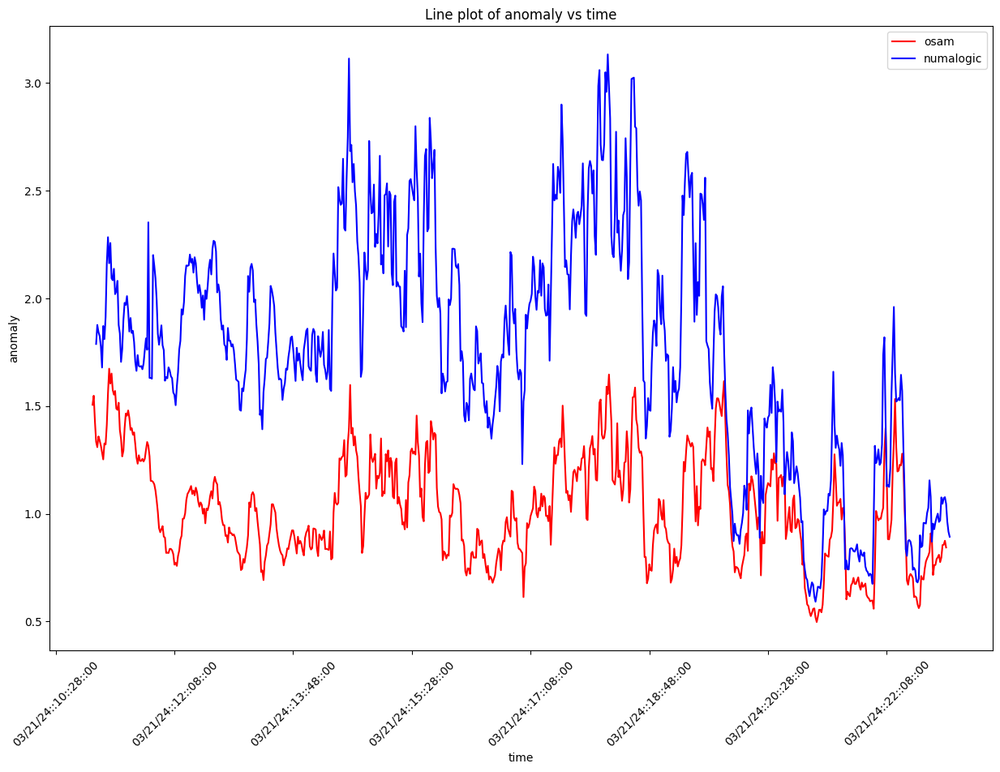

 85%|████████▌ | 211/248 [09:46<01:48,  2.93s/it]

key:  fci:interactionsFailed:2091939619214868921:Sync
Anomaly tp for this graph from OSAM:  0
Anomaly tp for this graph from Numa:  1


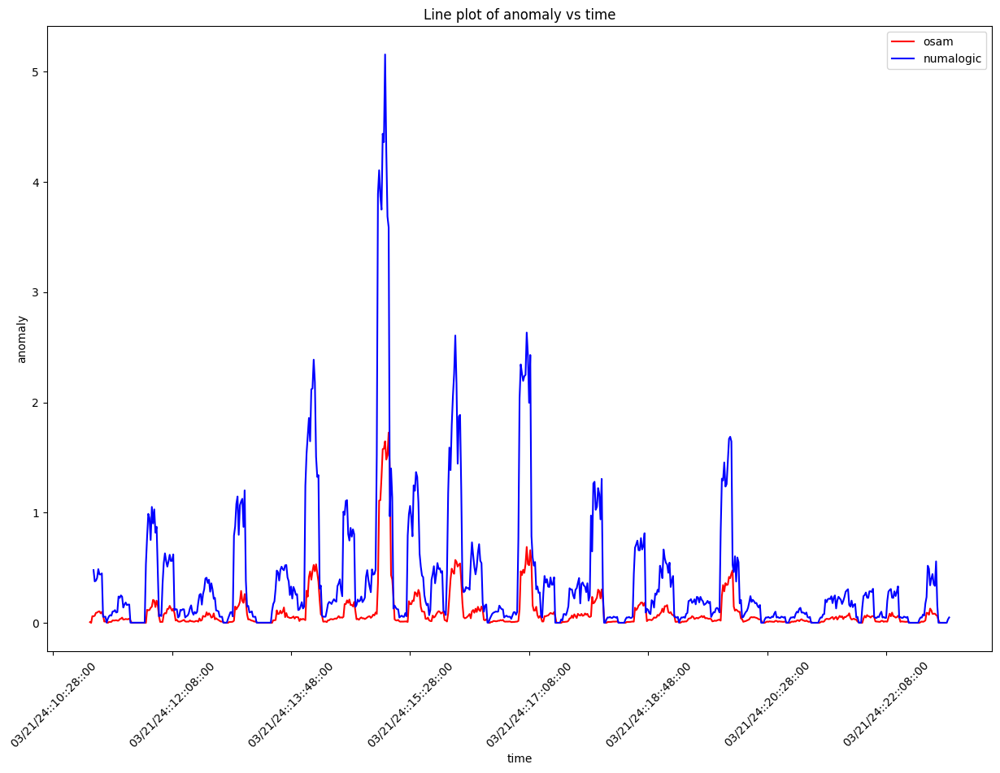

 85%|████████▌ | 212/248 [09:49<01:43,  2.89s/it]

key:  fci:interactionsFailed:1156316797376513545:campaigns-edit:subject:save
Anomaly tp for this graph from OSAM:  0
Anomaly tp for this graph from Numa:  1


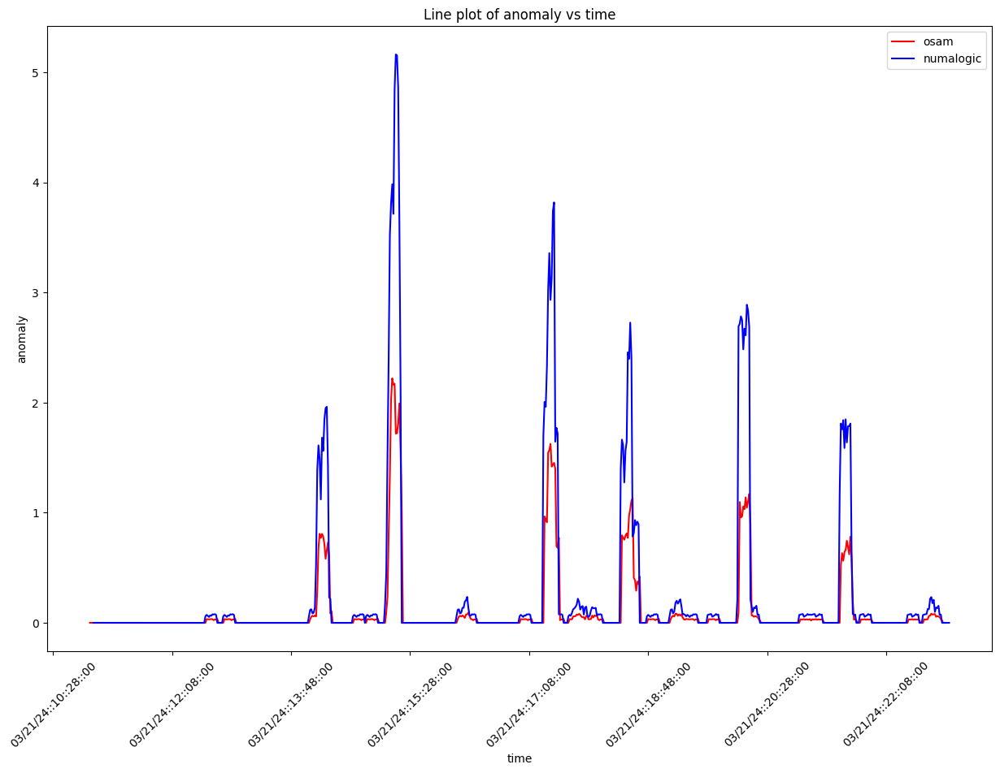

 86%|████████▌ | 213/248 [09:52<01:42,  2.94s/it]

key:  fciPluginAppInteractions:metrics:7785615448133772557:5984175597303660107:assign_pay_schedule
Anomaly tp for this graph from OSAM:  0
Anomaly tp for this graph from Numa:  2


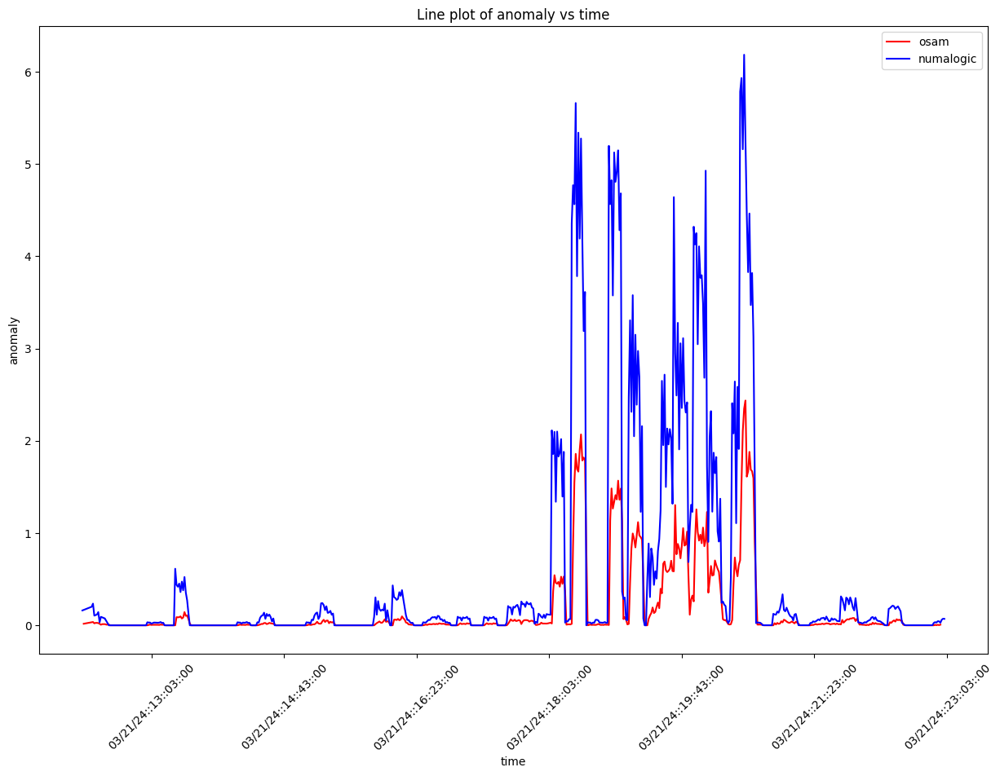

 86%|████████▋ | 214/248 [09:55<01:38,  2.90s/it]

key:  fciPluginAppInteractions:metrics:6056233191676083953:4831254092648450521:CB_INIT_CODE_TO_DISPLAY_CODE
Anomaly tp for this graph from OSAM:  0
Anomaly tp for this graph from Numa:  4


 87%|████████▋ | 215/248 [09:58<01:32,  2.79s/it]

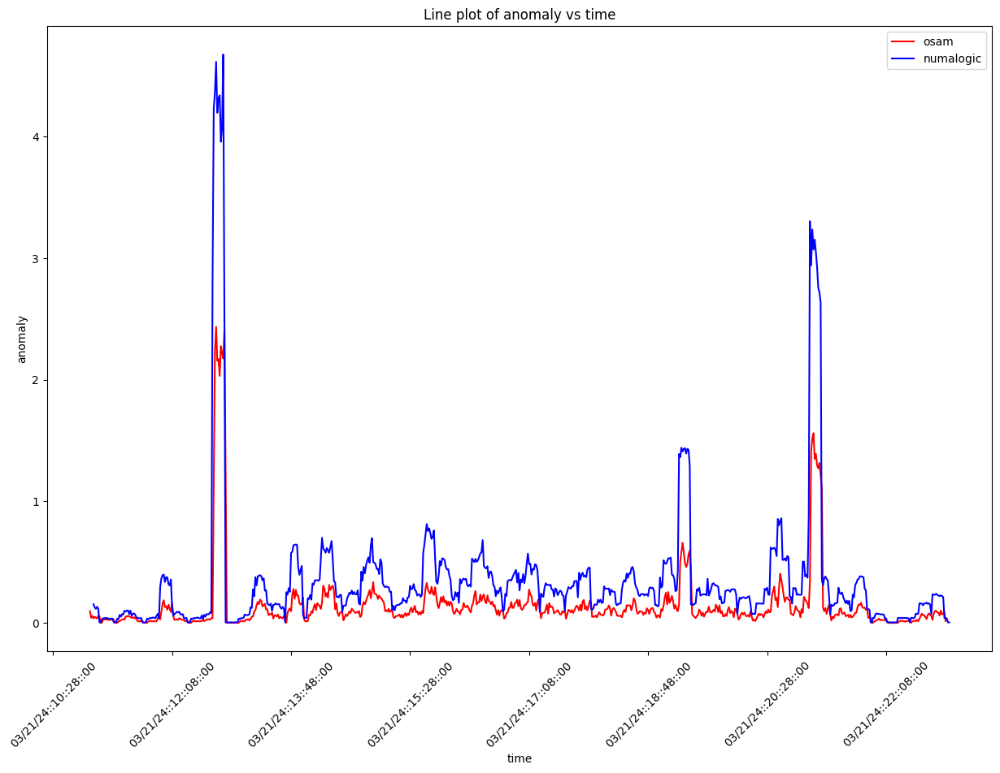

 87%|████████▋ | 216/248 [10:00<01:28,  2.78s/it]

key:  fciPluginInteractions:metrics:3244861123818975982:qbaa.fai.reconcile-ui.getStatementsStatus
Anomaly tp for this graph from OSAM:  0
Anomaly tp for this graph from Numa:  2


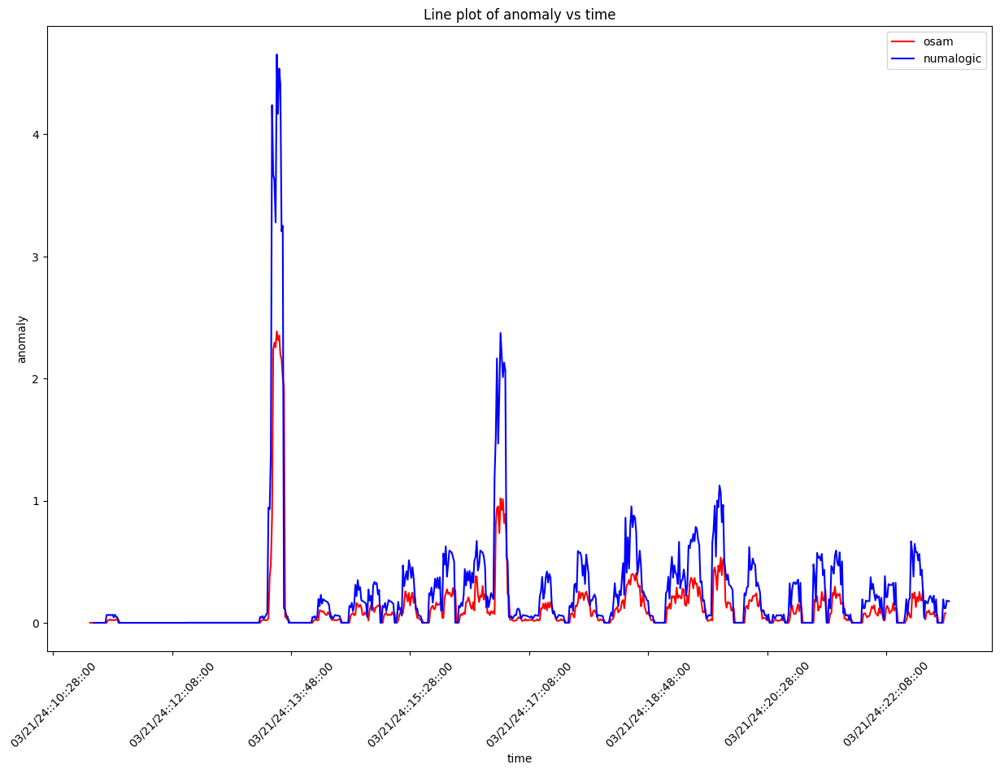

 88%|████████▊ | 217/248 [10:03<01:26,  2.79s/it]

key:  fciPluginInteractions:metrics:3678332588046106875:qbaa.fai.bankconnections-ui.ProcessOfxFileCall
Anomaly tp for this graph from OSAM:  0
Anomaly tp for this graph from Numa:  1


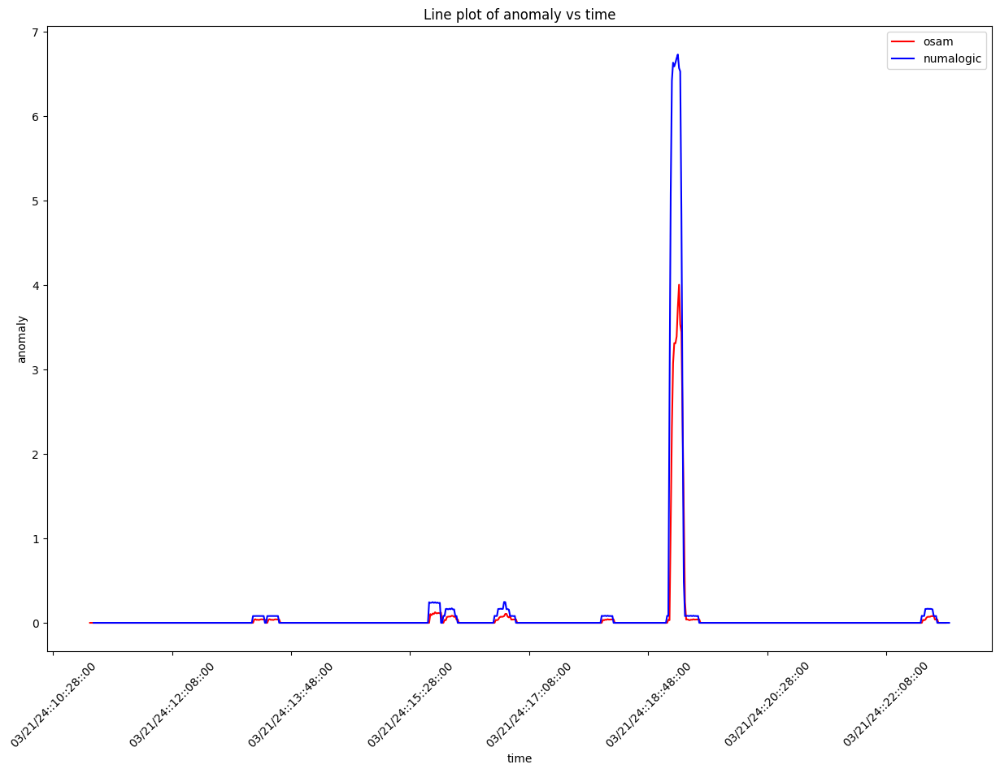

 88%|████████▊ | 218/248 [10:06<01:24,  2.80s/it]

key:  fciPluginInteractions:metrics:3750390182735137211:PAGINATE_REPORT
Anomaly tp for this graph from OSAM:  1
Anomaly tp for this graph from Numa:  1


 88%|████████▊ | 219/248 [10:08<01:18,  2.70s/it]

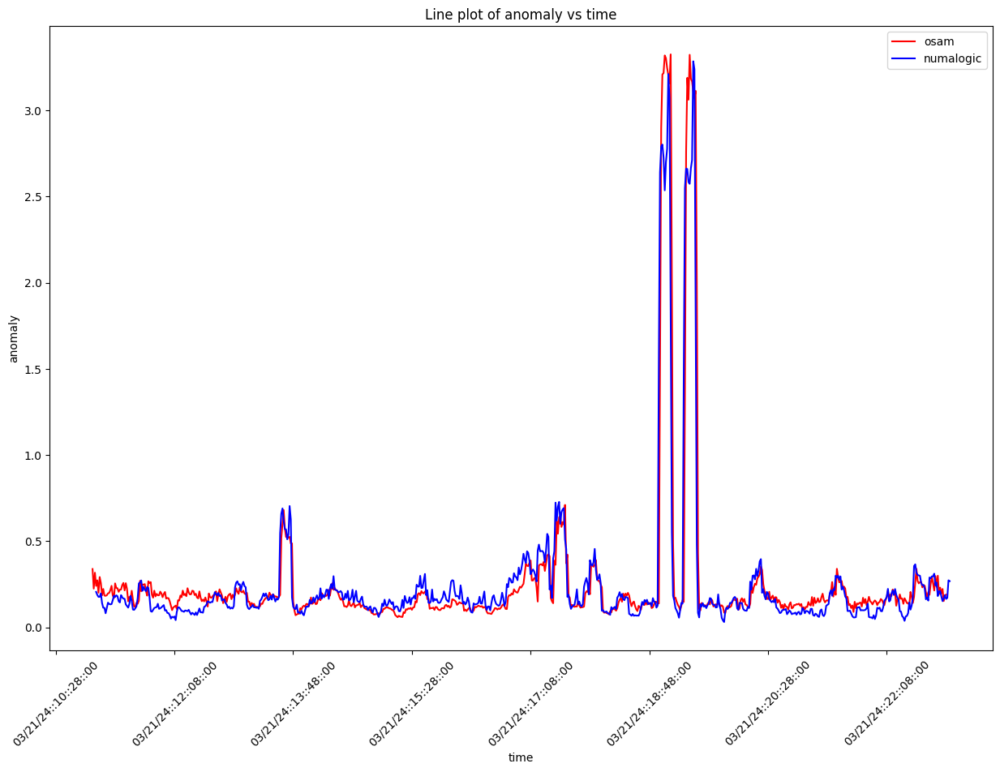

 89%|████████▊ | 220/248 [10:11<01:17,  2.75s/it]

key:  fciPluginAppInteractions:metrics:2453353489468585843:5984175597303660107:contactOnSearch
Anomaly tp for this graph from OSAM:  2
Anomaly tp for this graph from Numa:  0


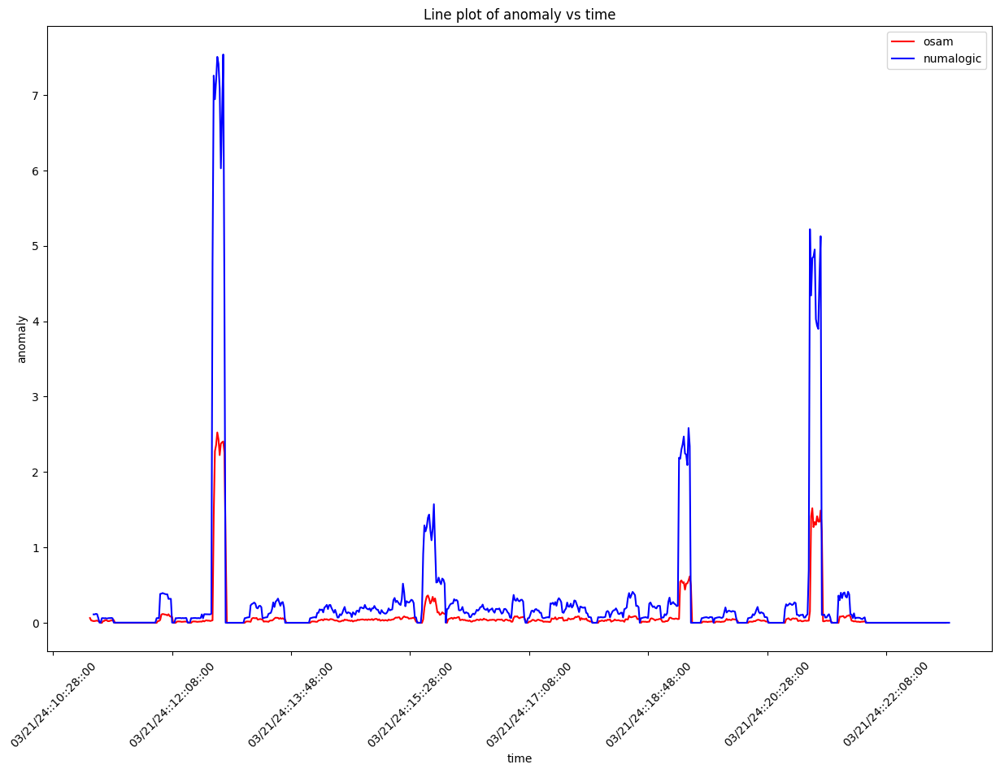

 89%|████████▉ | 221/248 [10:14<01:13,  2.74s/it]

key:  fciPluginAppInteractions:metrics:3244861123818975982:5984175597303660107:qbaa.fai.reconcile-ui.getStatementsShowViewStatementsBtn
Anomaly tp for this graph from OSAM:  0
Anomaly tp for this graph from Numa:  2


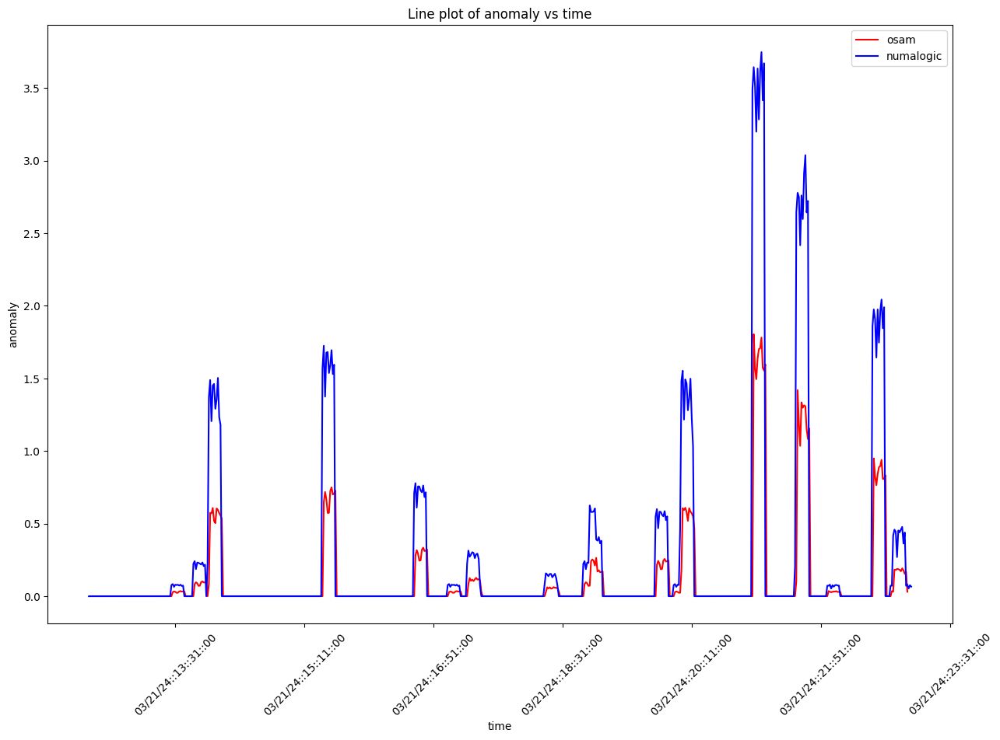

 90%|████████▉ | 222/248 [10:17<01:11,  2.74s/it]

key:  fciPluginAppInteractions:metrics:3101871835697829167:1876892737053055605:destroyAgentConnection
Anomaly tp for this graph from OSAM:  0
Anomaly tp for this graph from Numa:  1


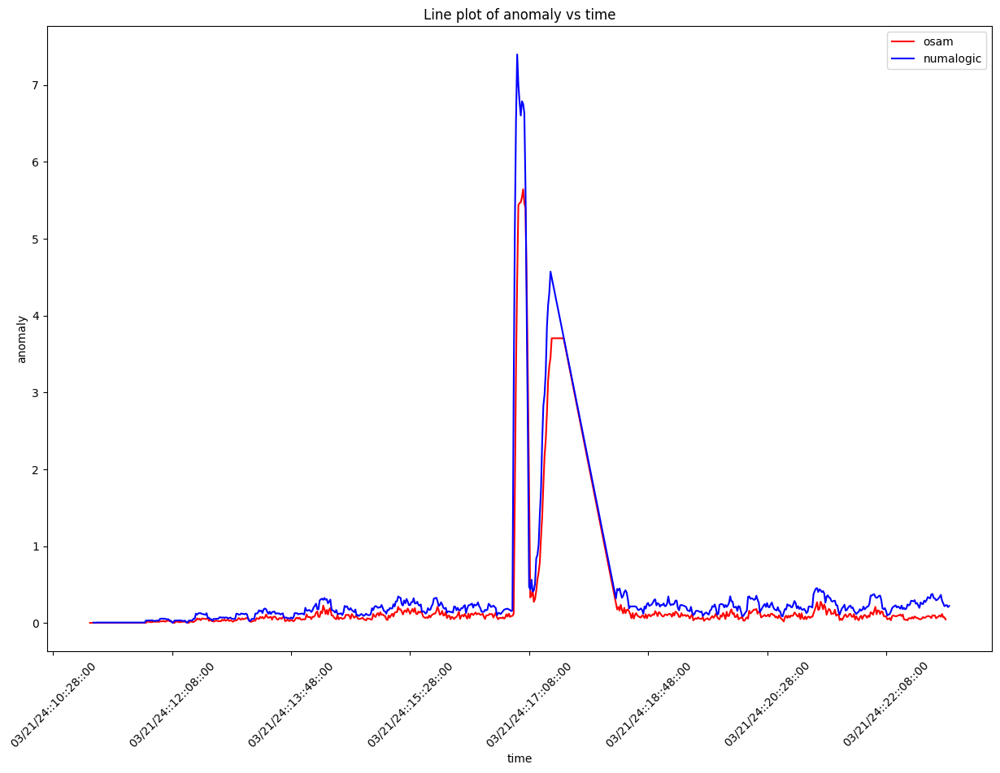

 90%|████████▉ | 223/248 [10:20<01:08,  2.75s/it]

key:  fci:interactionsFailed:4831254092648450521:GenAi Explanations
Anomaly tp for this graph from OSAM:  2
Anomaly tp for this graph from Numa:  2


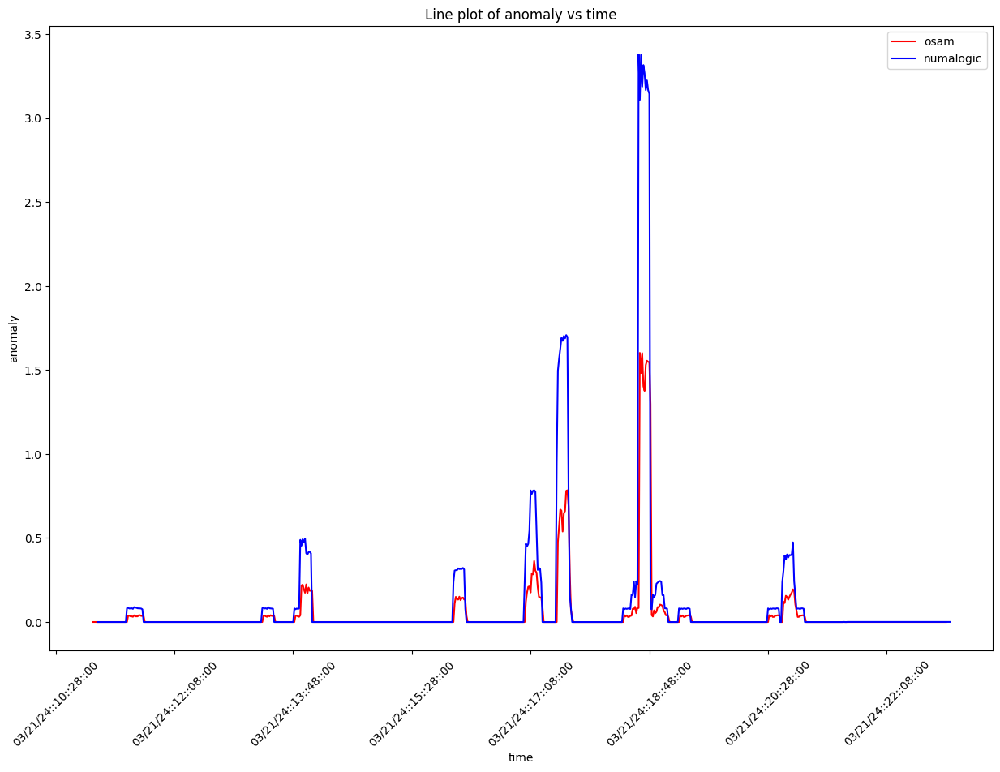

 90%|█████████ | 224/248 [10:22<01:06,  2.78s/it]

key:  fciPlugin:requestsFailed:5984175597303660107:contractors-form1099-ui
Anomaly tp for this graph from OSAM:  0
Anomaly tp for this graph from Numa:  1


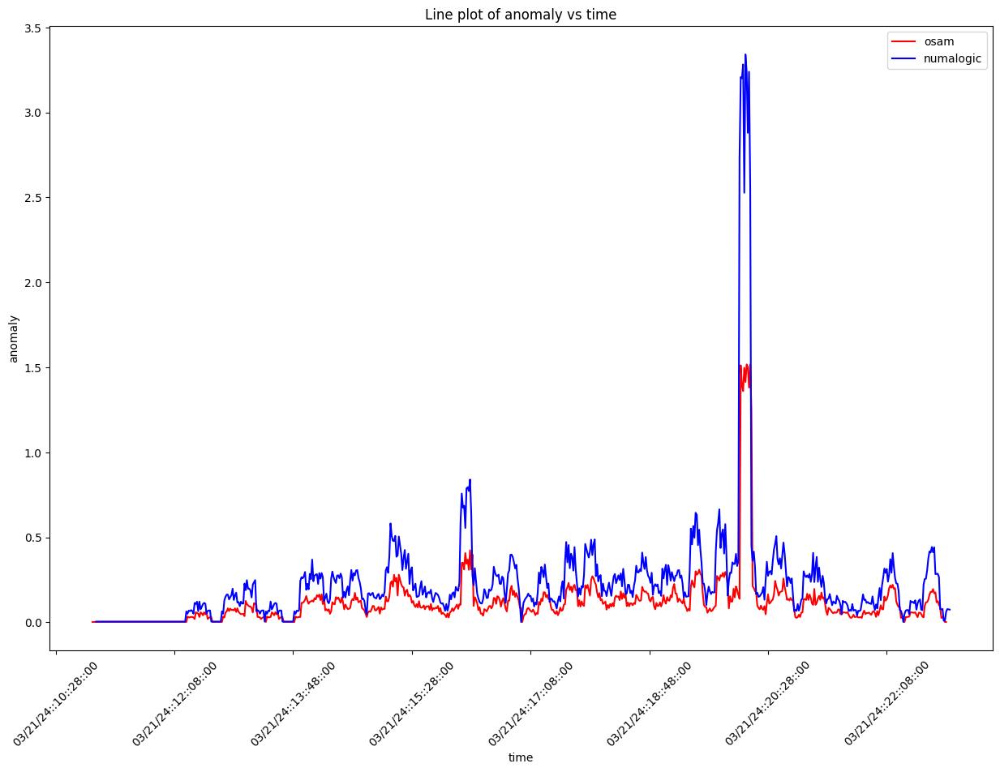

 91%|█████████ | 225/248 [10:25<01:04,  2.79s/it]

key:  fci:interactionsFailed:5984175597303660107:personal_info_card_loaded
Anomaly tp for this graph from OSAM:  0
Anomaly tp for this graph from Numa:  1


 92%|█████████▏| 227/248 [10:30<00:54,  2.61s/it]

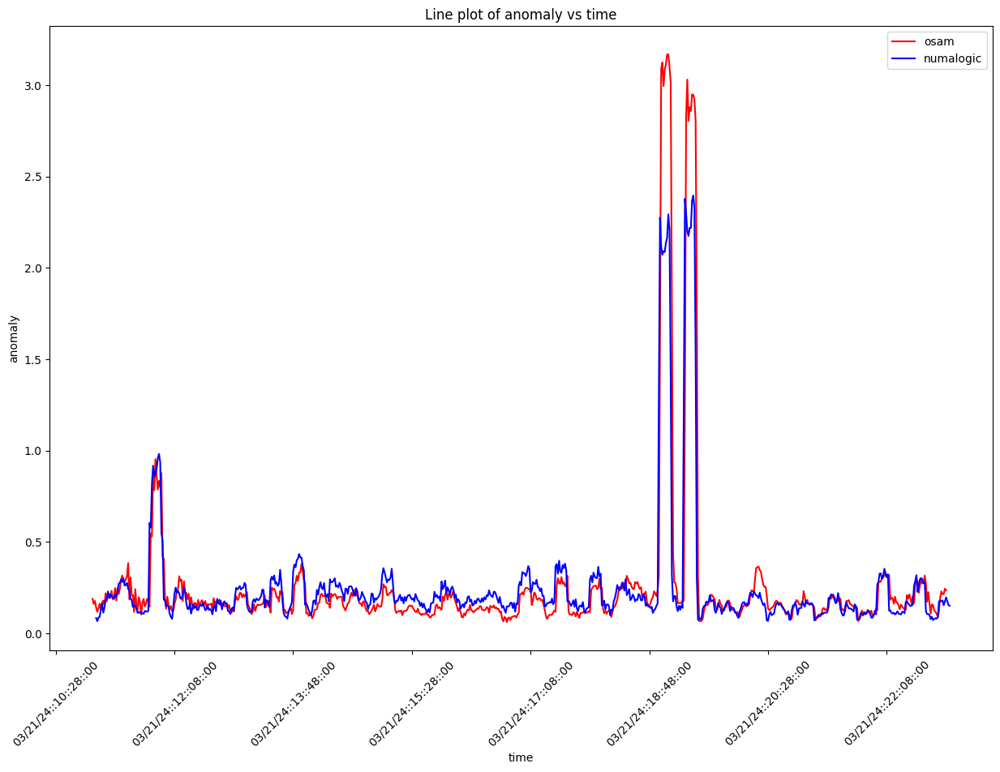

 92%|█████████▏| 228/248 [10:33<00:52,  2.65s/it]

key:  fciPluginInteractions:metrics:2453353489468585843:accountsOnSearch
Anomaly tp for this graph from OSAM:  1
Anomaly tp for this graph from Numa:  0


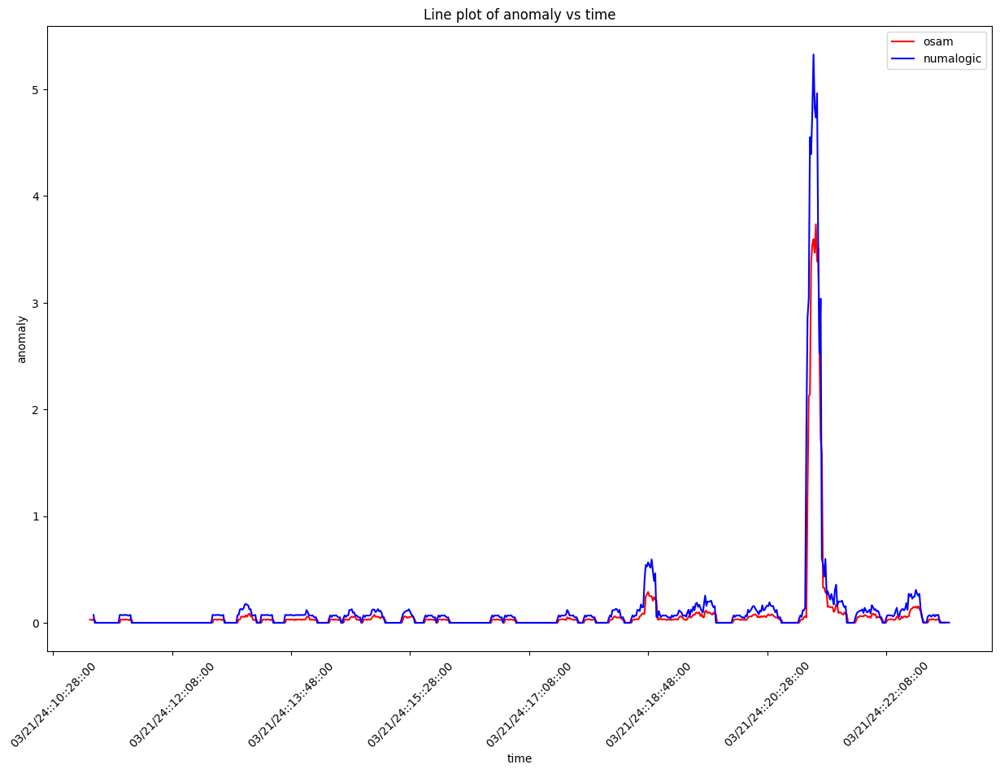

 92%|█████████▏| 229/248 [10:36<00:50,  2.68s/it]

key:  fci:interactionsFailed:5333405450904137335:triton_android_send_ice_event
Anomaly tp for this graph from OSAM:  1
Anomaly tp for this graph from Numa:  1


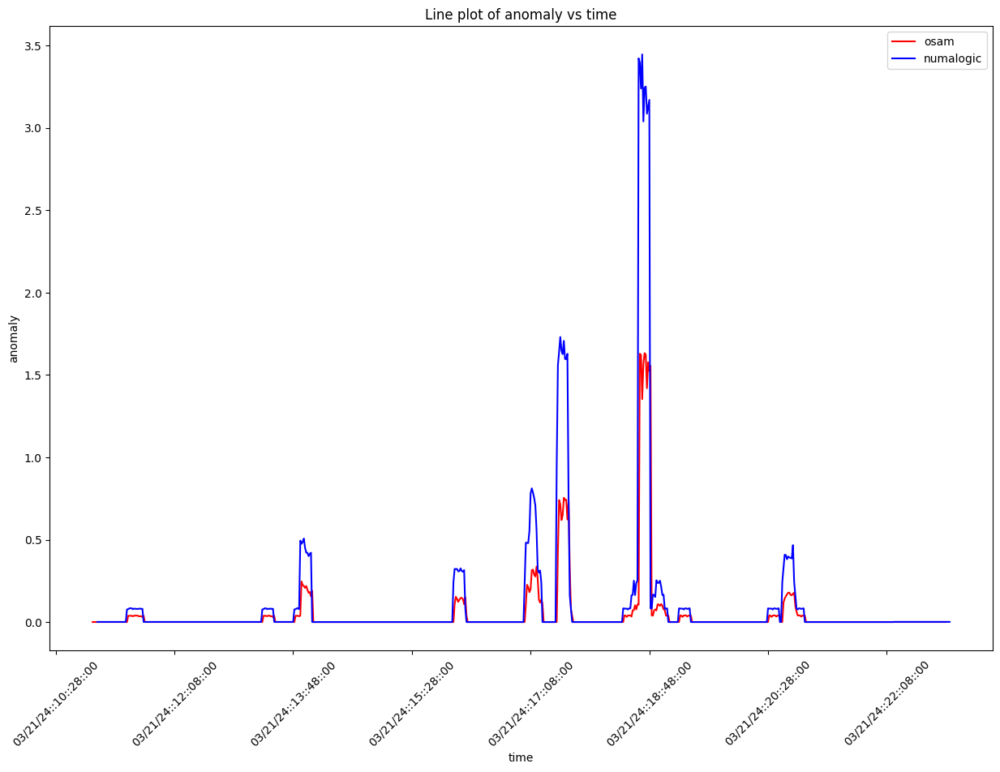

 93%|█████████▎| 230/248 [10:38<00:48,  2.67s/it]

key:  fciPluginAsset:metricsFailed:2453353489679220423
Anomaly tp for this graph from OSAM:  0
Anomaly tp for this graph from Numa:  1


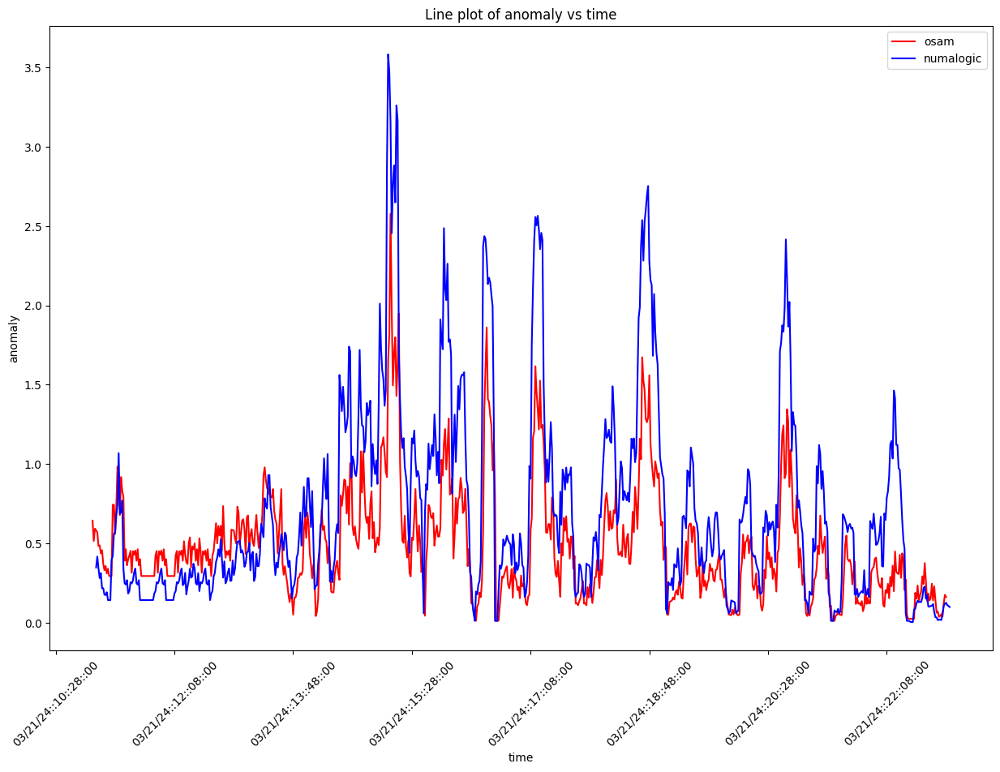

 93%|█████████▎| 231/248 [10:41<00:45,  2.68s/it]

key:  fciPluginInteractions:metrics:579856044523690907:shcs-wr-content-fetch
Anomaly tp for this graph from OSAM:  0
Anomaly tp for this graph from Numa:  1


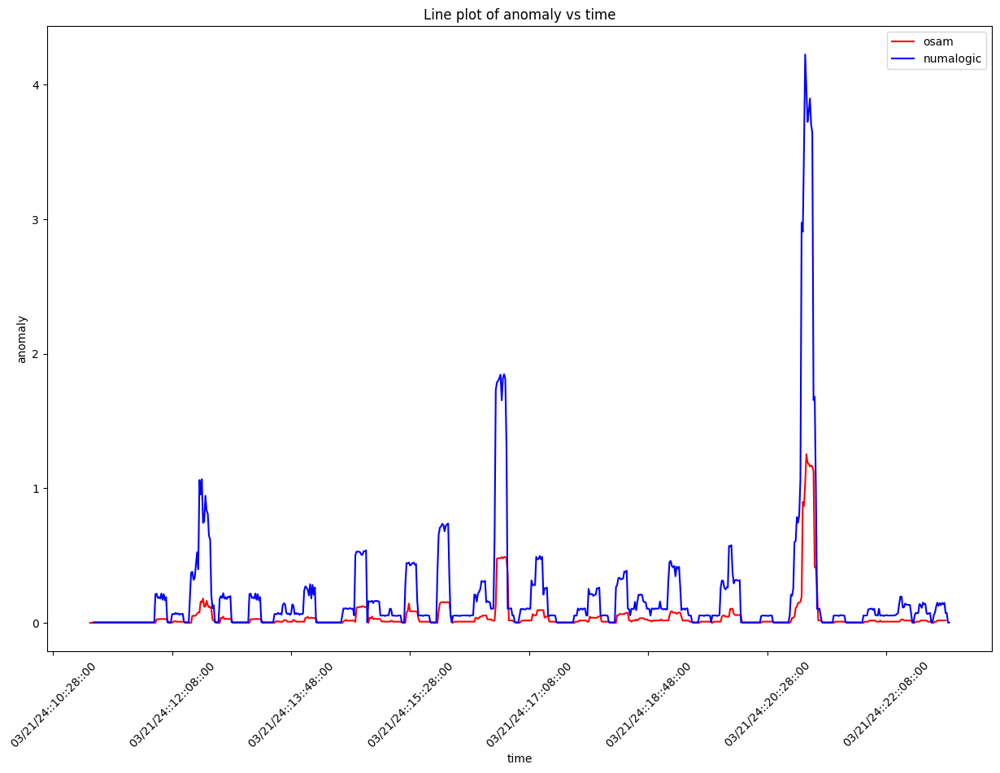

 94%|█████████▎| 232/248 [10:44<00:43,  2.74s/it]

key:  fciAsset:assetFailed:7425327478457217537
Anomaly tp for this graph from OSAM:  0
Anomaly tp for this graph from Numa:  1


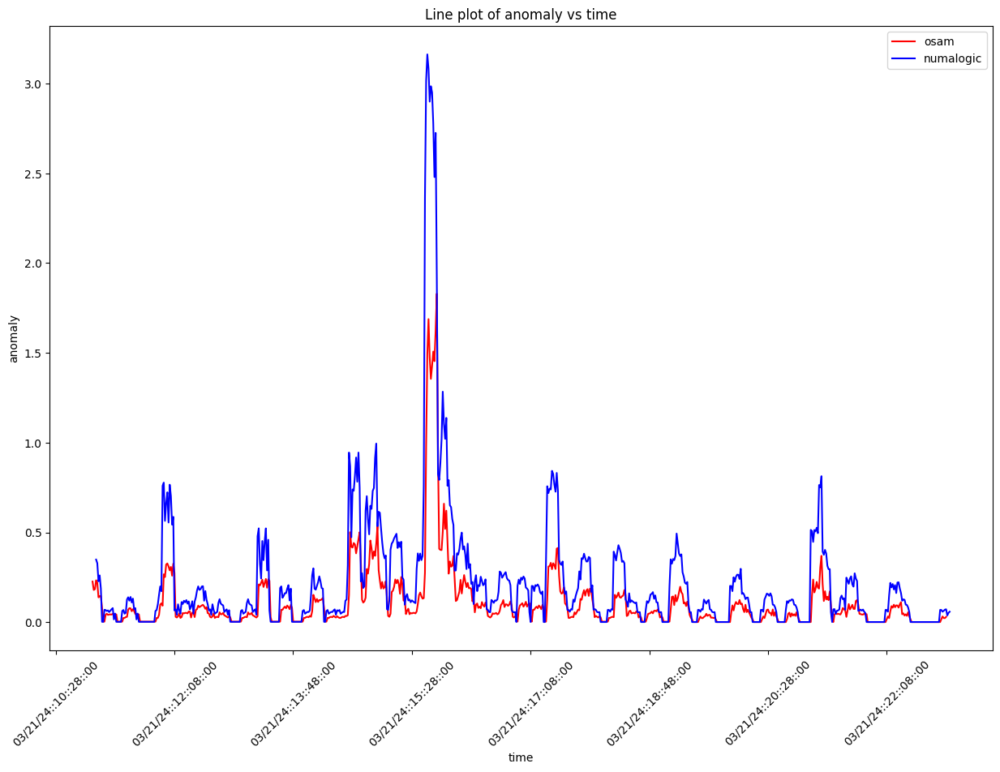

 94%|█████████▍| 233/248 [10:47<00:42,  2.81s/it]

key:  fciPluginInteractions:metrics:3244861123818975982:qbaa.fai.reconcile-ui.getStatementsFromDocumentService
Anomaly tp for this graph from OSAM:  0
Anomaly tp for this graph from Numa:  1


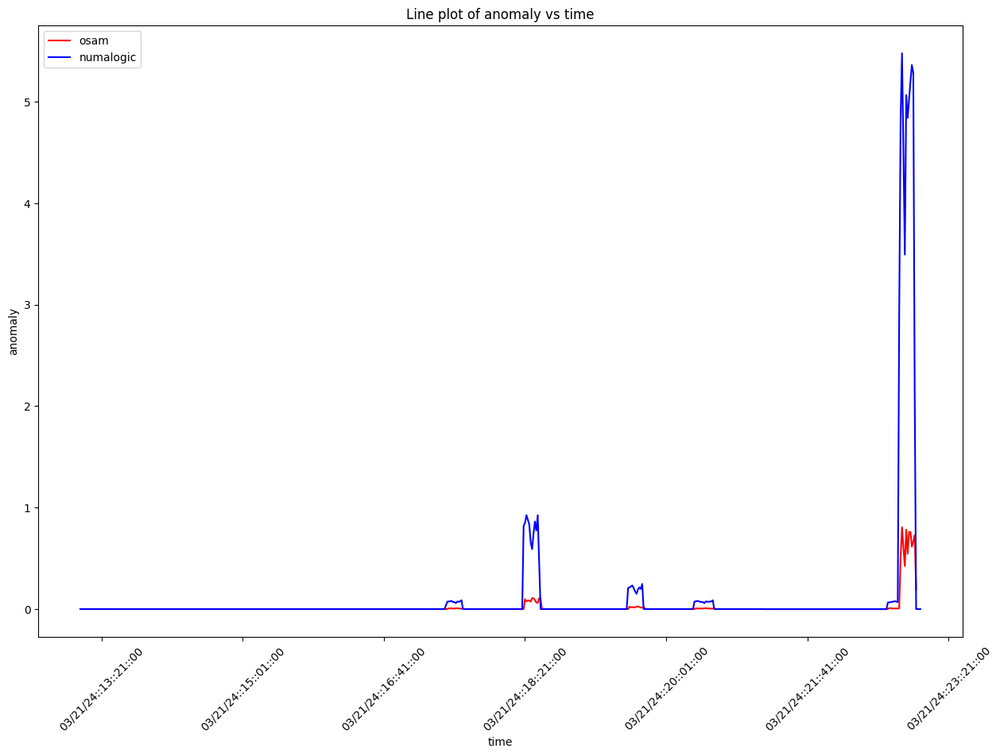

 94%|█████████▍| 234/248 [10:50<00:39,  2.81s/it]

key:  fciPlugin:requestsFailed:8506191388536189707:search-widget
Anomaly tp for this graph from OSAM:  0
Anomaly tp for this graph from Numa:  1


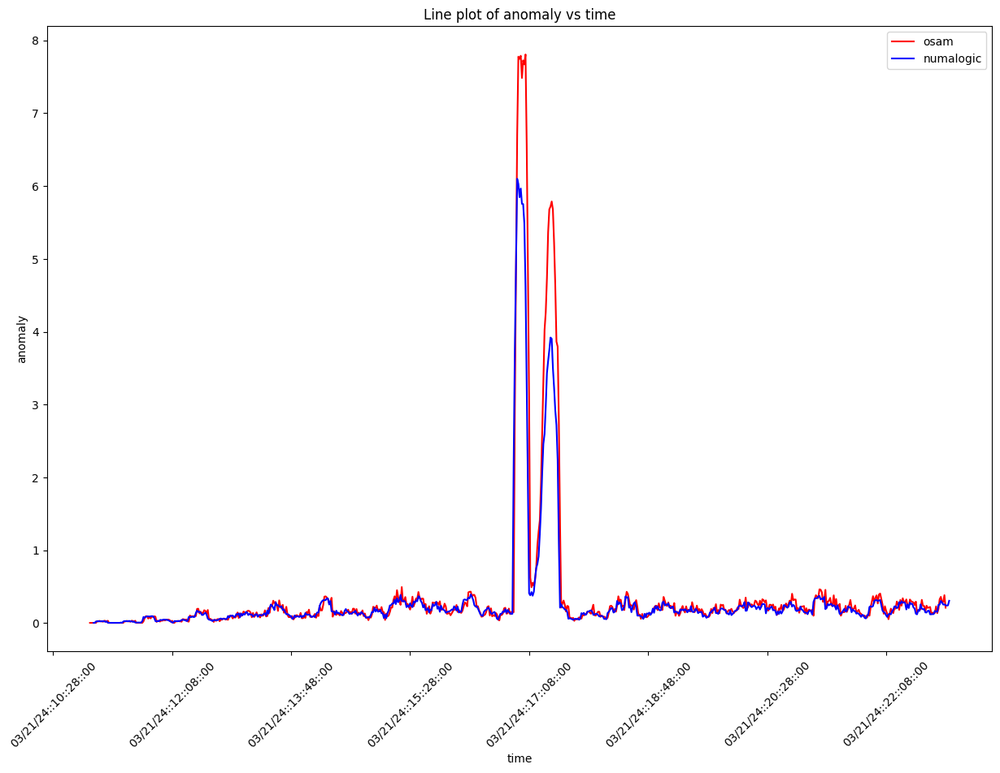

 95%|█████████▍| 235/248 [10:52<00:35,  2.77s/it]

key:  fciPluginAsset:metricsFailed:579856044409078427
Anomaly tp for this graph from OSAM:  2
Anomaly tp for this graph from Numa:  2


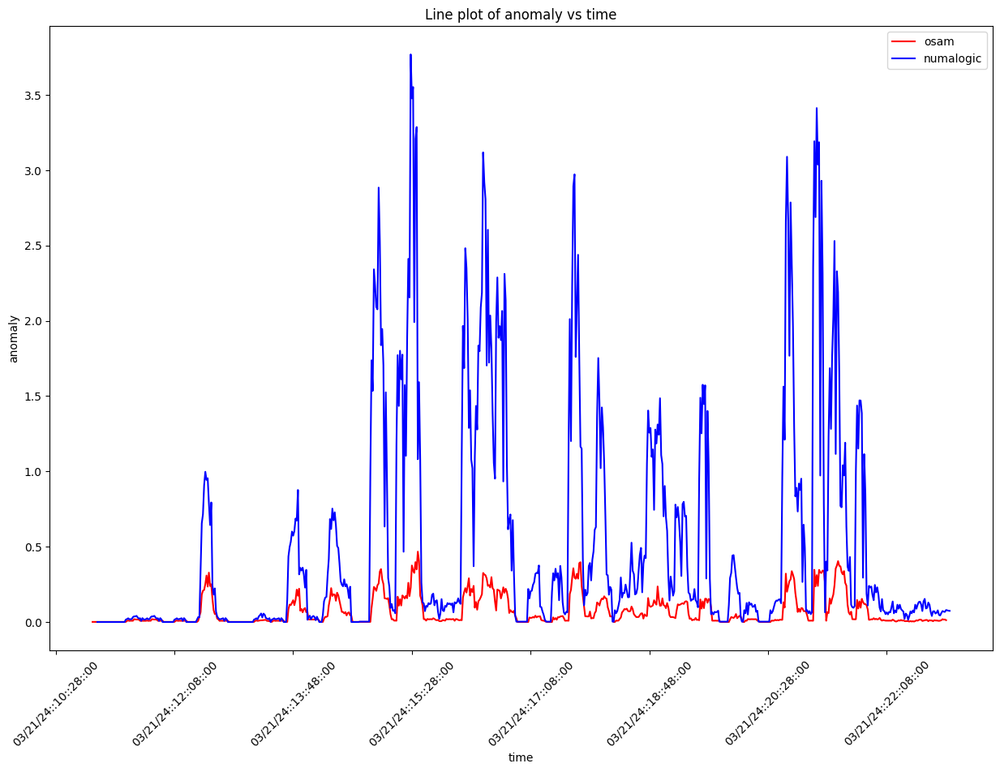

 95%|█████████▌| 236/248 [10:55<00:33,  2.76s/it]

key:  fci:interactionsFailed:5984175597303660107:lookup-address-ss
Anomaly tp for this graph from OSAM:  0
Anomaly tp for this graph from Numa:  2


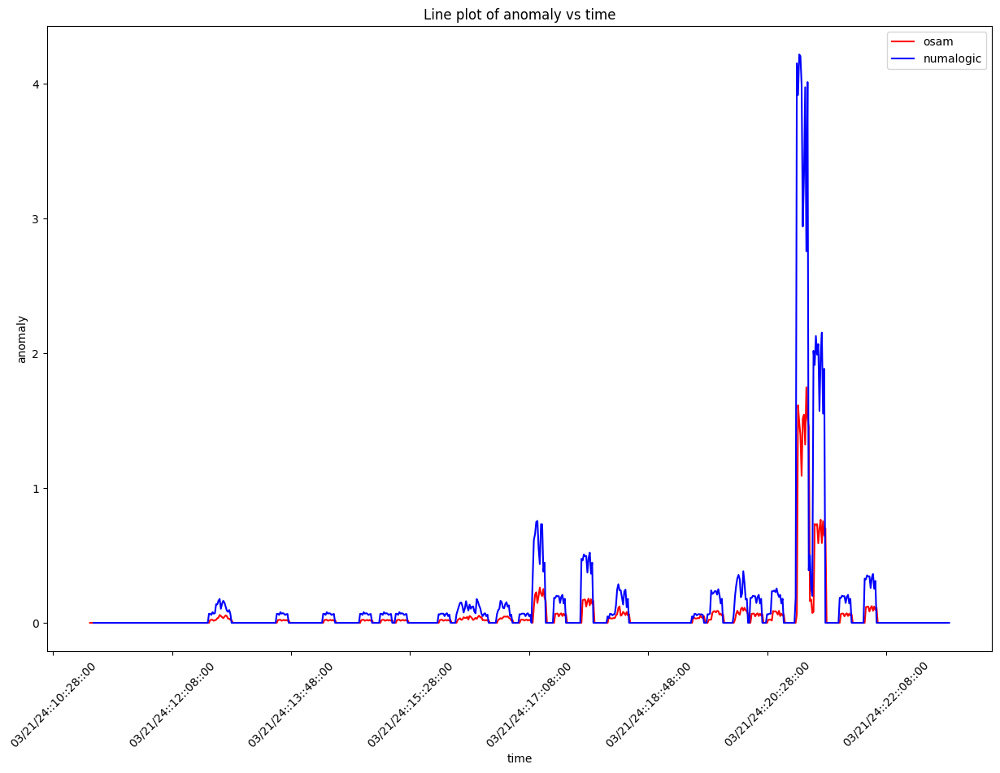

 96%|█████████▌| 237/248 [10:58<00:30,  2.79s/it]

key:  fciPluginInteractions:metrics:3244861123818975982:qbaa.fai.reconcile-ui.getReconTxnList
Anomaly tp for this graph from OSAM:  0
Anomaly tp for this graph from Numa:  1


 96%|█████████▌| 238/248 [11:00<00:26,  2.68s/it]

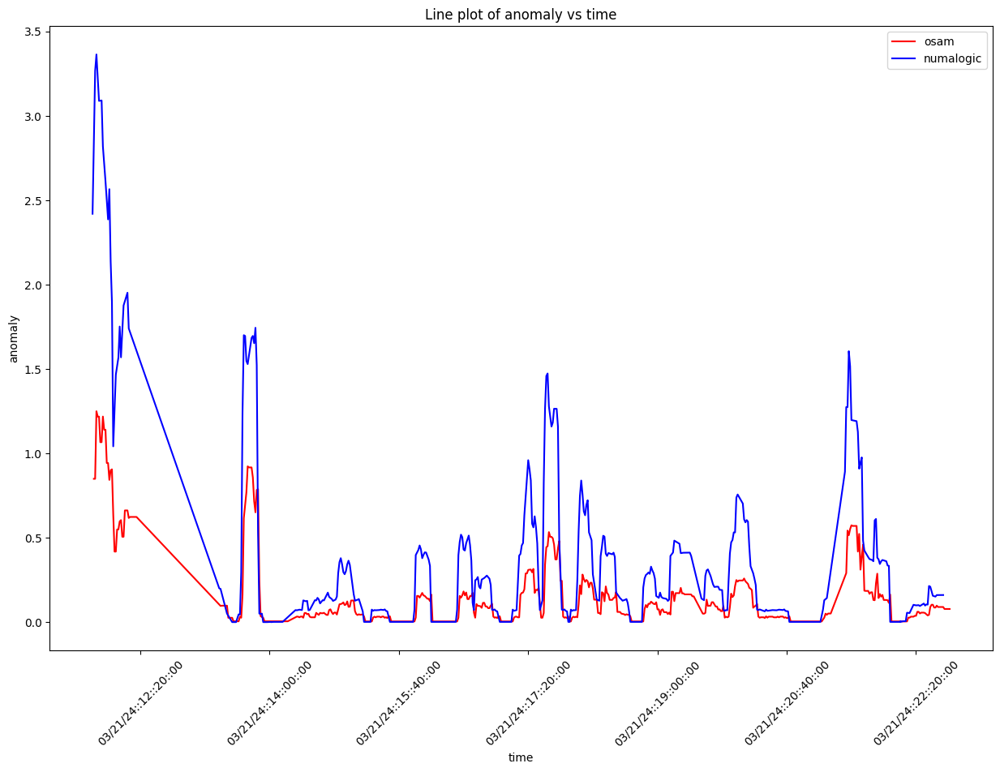

 96%|█████████▋| 239/248 [11:03<00:24,  2.67s/it]

key:  fciPluginInteractions:metrics:1155190896715678000:qba-workflow-ui.job_saveComplete
Anomaly tp for this graph from OSAM:  0
Anomaly tp for this graph from Numa:  1


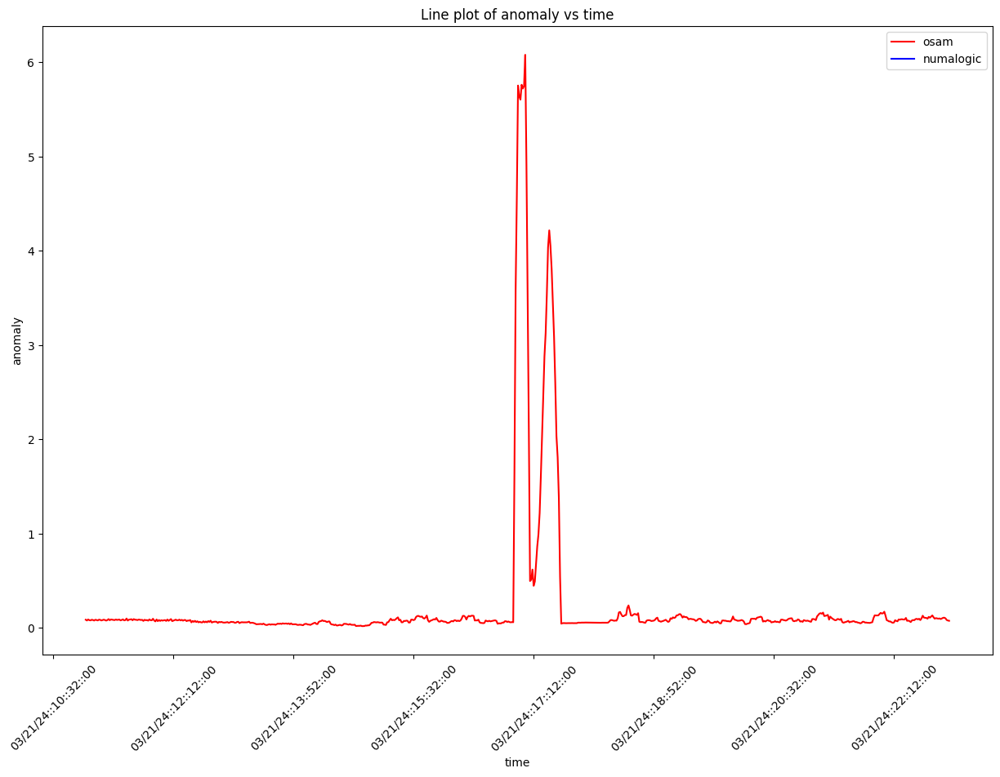

 97%|█████████▋| 240/248 [11:06<00:21,  2.70s/it]

key:  fciPlugin:requests:4831254092648450521:tto-shell-ui
Anomaly tp for this graph from OSAM:  2
Anomaly tp for this graph from Numa:  0


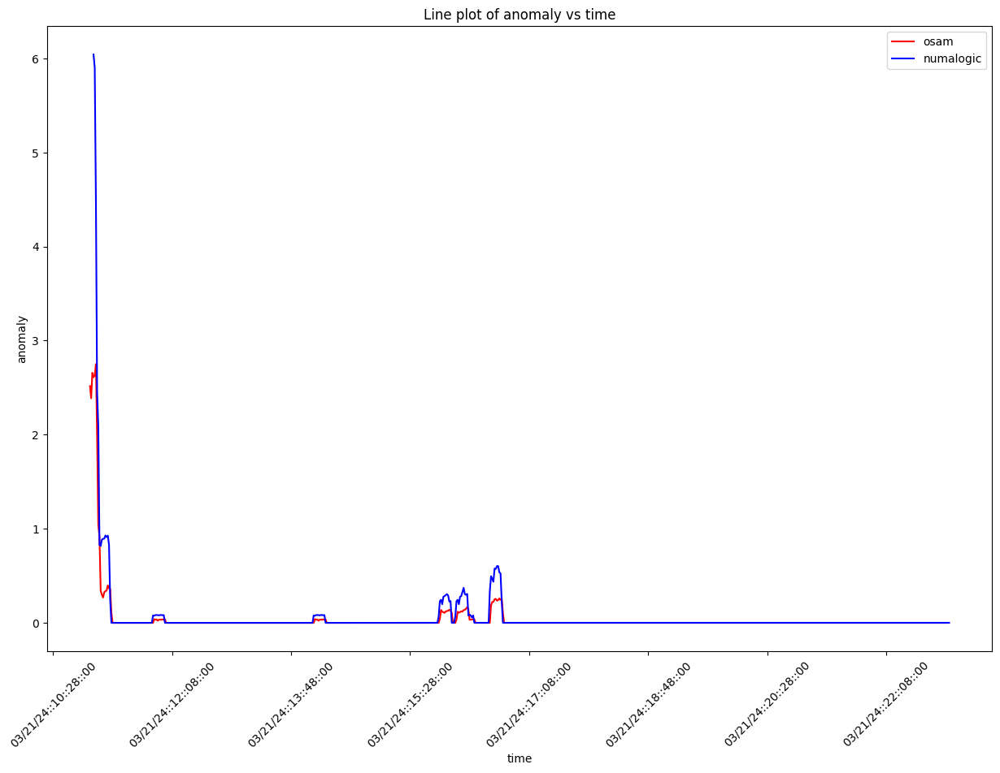

 97%|█████████▋| 241/248 [11:08<00:18,  2.70s/it]

key:  fciPluginAppInteractions:metrics:435740856470293685:5984175597303660107:trsnsactionsfc-update-style-preferences
Anomaly tp for this graph from OSAM:  0
Anomaly tp for this graph from Numa:  1


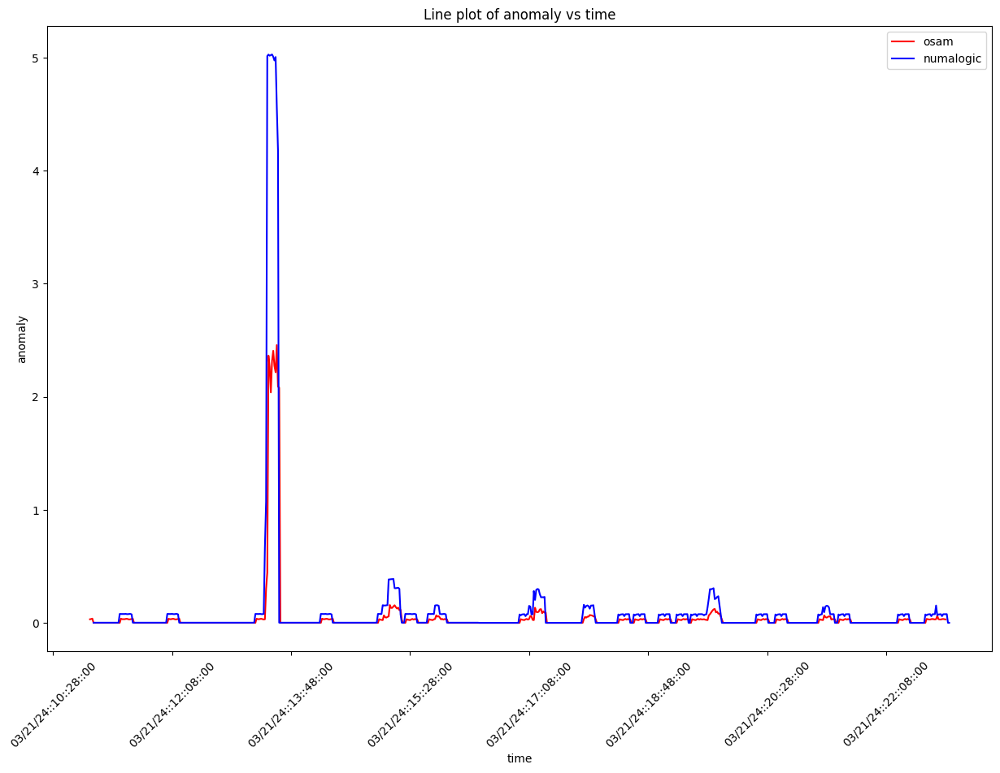

 98%|█████████▊| 242/248 [11:11<00:16,  2.69s/it]

key:  fci:interactionsFailed:5333405450904137335:FullService_prepare_webview_session
Anomaly tp for this graph from OSAM:  0
Anomaly tp for this graph from Numa:  1


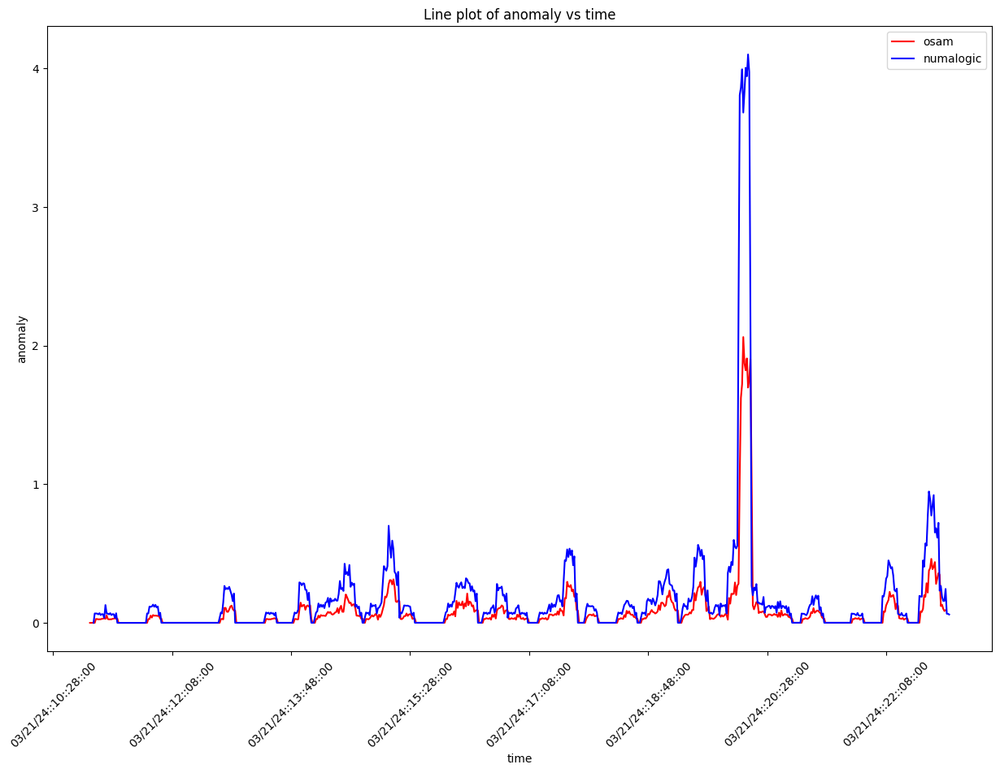

 98%|█████████▊| 243/248 [11:14<00:13,  2.70s/it]

key:  fciPluginInteractions:metrics:7785615448133772557:dcg_card_load
Anomaly tp for this graph from OSAM:  0
Anomaly tp for this graph from Numa:  1


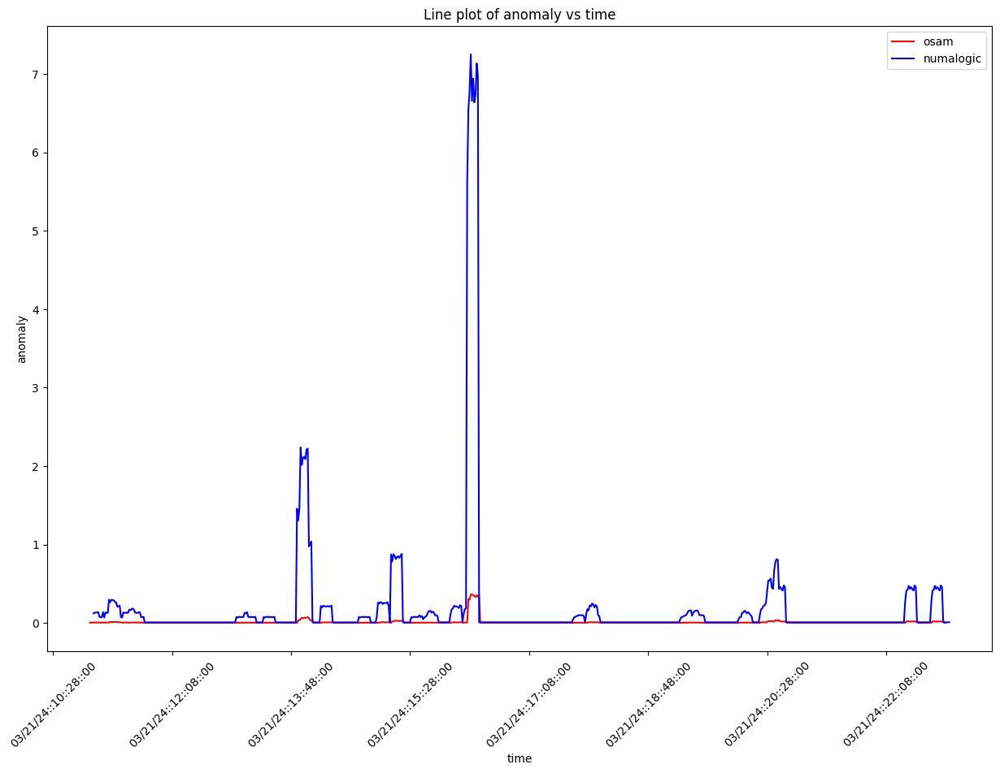

 98%|█████████▊| 244/248 [11:17<00:11,  2.75s/it]

key:  fciPlugin:requestsFailed:5984175597303660107:dp-app-hub-ui
Anomaly tp for this graph from OSAM:  0
Anomaly tp for this graph from Numa:  1


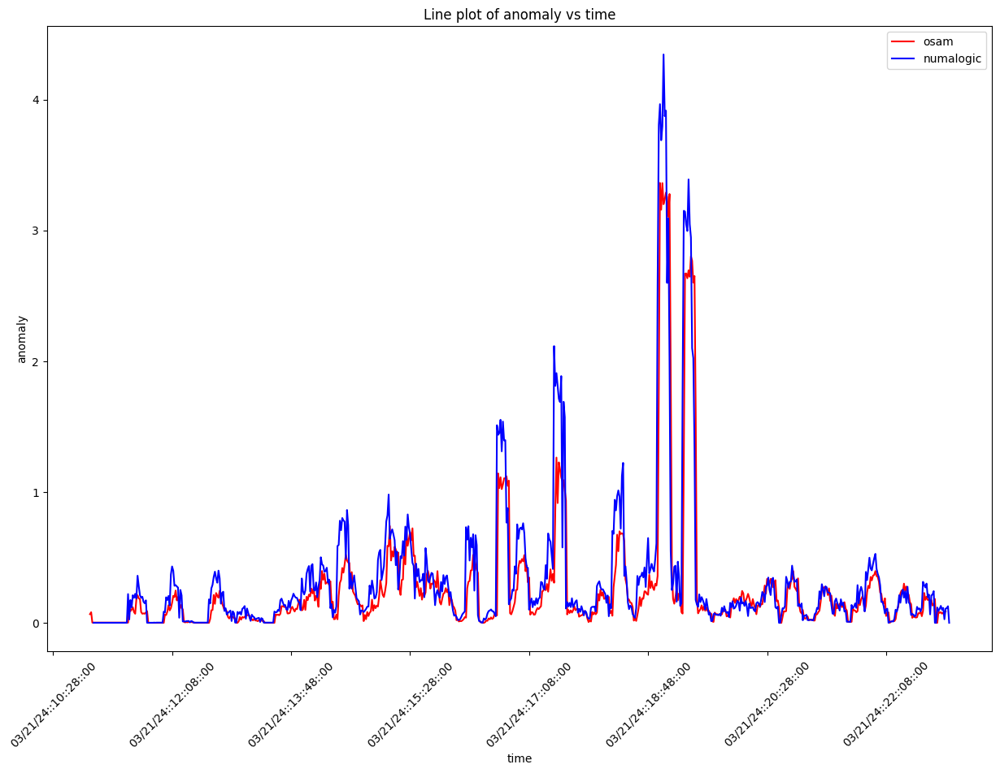

 99%|█████████▉| 245/248 [11:19<00:08,  2.76s/it]

key:  fciPluginAppInteractions:metrics:2453353489468585843:5984175597303660107:klassOnSearch
Anomaly tp for this graph from OSAM:  1
Anomaly tp for this graph from Numa:  2


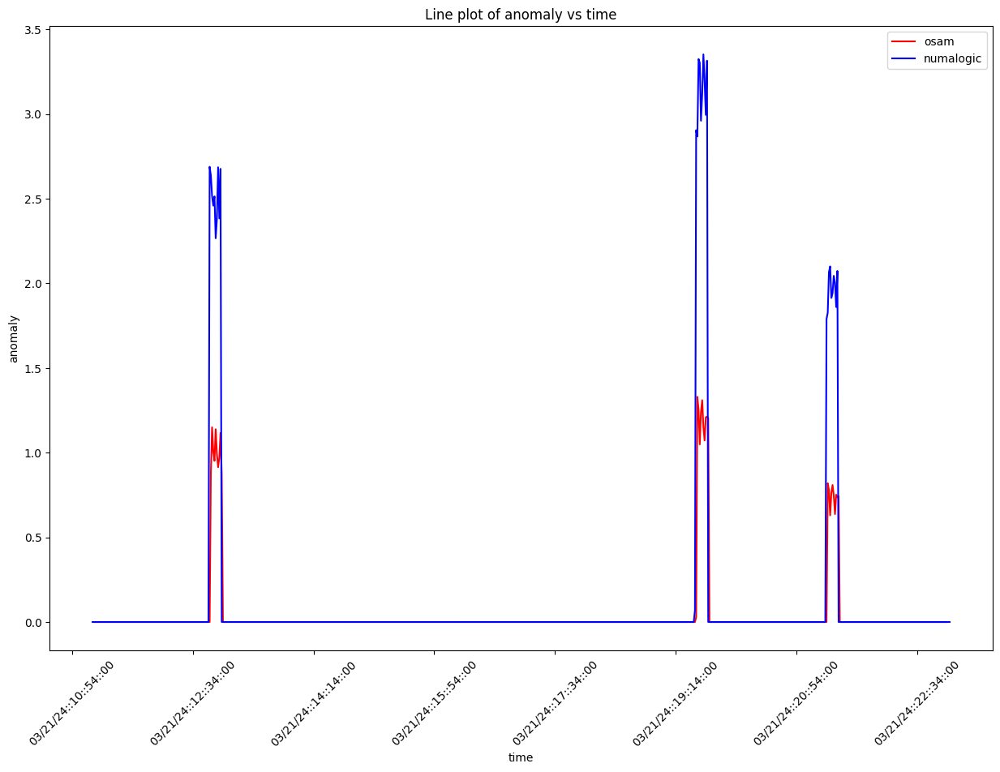

 99%|█████████▉| 246/248 [11:22<00:05,  2.77s/it]

key:  fci:interactionsFailed:868086420502860411:EXPERT_SEARCH_INTERACTION
Anomaly tp for this graph from OSAM:  0
Anomaly tp for this graph from Numa:  1


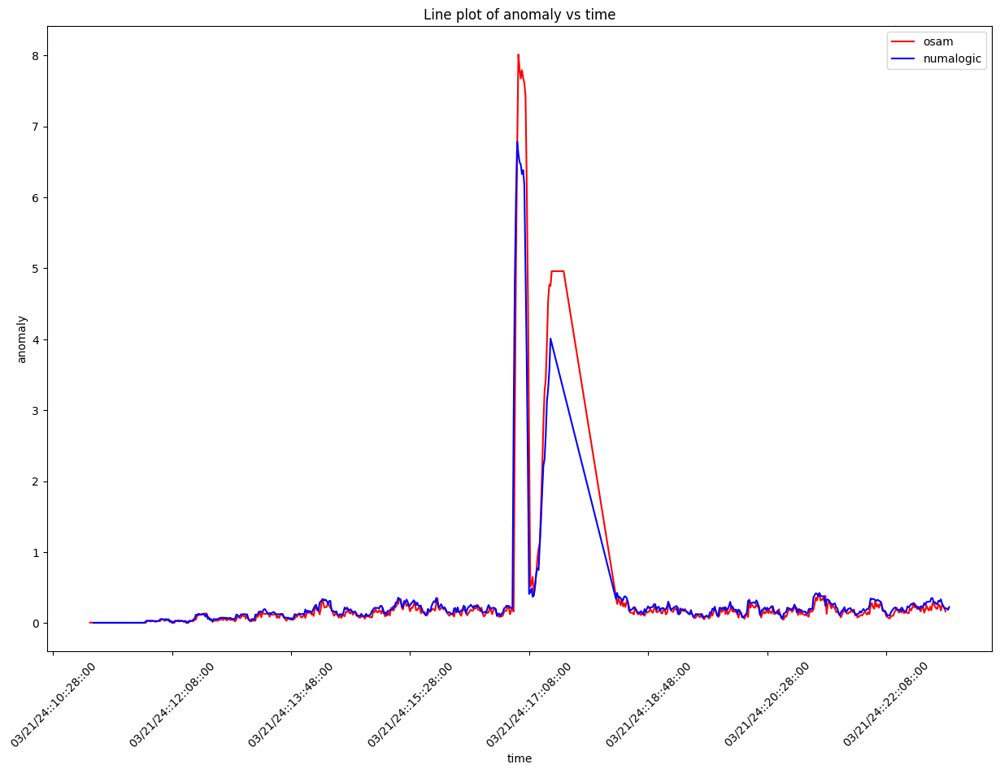

100%|█████████▉| 247/248 [11:25<00:02,  2.76s/it]

key:  fciPluginAppInteractions:metrics:579856044409078427:4831254092648450521:GenAi Explanations
Anomaly tp for this graph from OSAM:  2
Anomaly tp for this graph from Numa:  2


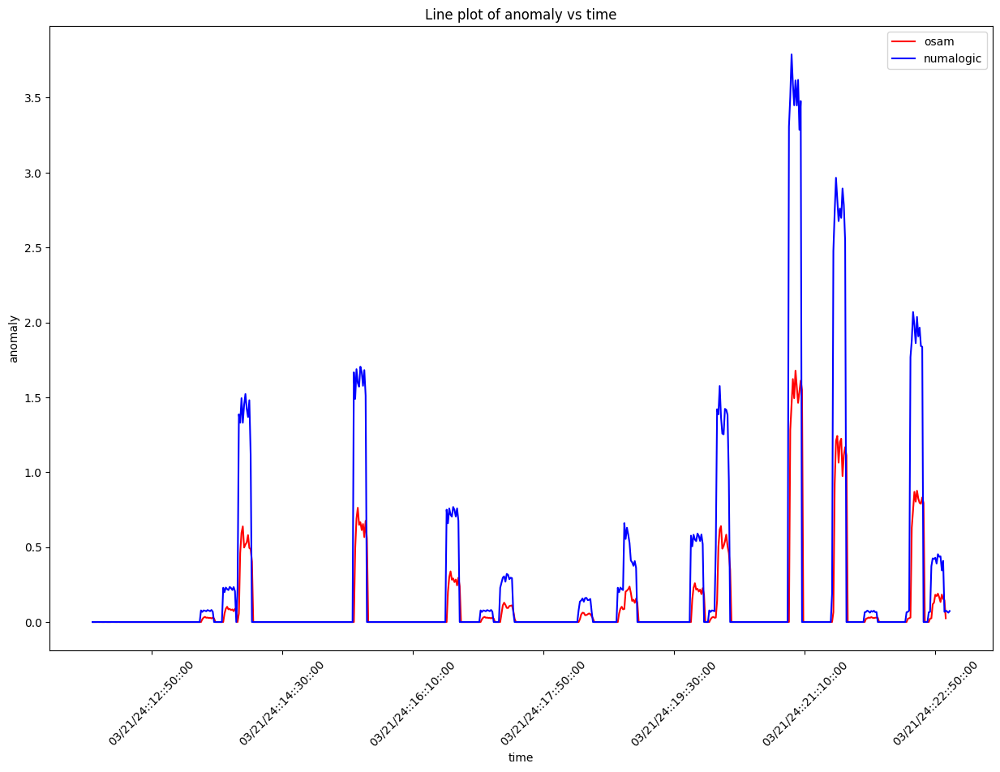

100%|██████████| 248/248 [11:28<00:00,  2.78s/it]

key:  fciPluginInteractions:metrics:3101871835697829167:destroyAgentConnection
Anomaly tp for this graph from OSAM:  0
Anomaly tp for this graph from Numa:  1
Total Number of anomaly tp for OSAM:  90
Total Number of anomaly tp for Numalogic:  242


In [7]:
anomaly_threshold = 3
allowed_continuity = 3
gap_allowed = 3
no_anomalies_list = []
anomalies_list = []
plot_graphs = True

summary = analyze(global_df_osam, global_df_numalogic)

DEBUG:numalogic.connectors.druid._druid:Querying with end_dt: 2024-03-29 03:27:20.262911+00:00, that is with delay of 3 hrs


------------------------------------------------------------        ModelId: fciPlugin:requestsFailed:5984175597303660107:collab-vep-ui       ---------------------------------------------


DEBUG:numalogic.connectors.druid._druid:Druid params: {'datasource': 'tech-ip-customer-interaction-metrics', 'granularity': 'minute', 'intervals': ['2024-03-19T03:27:20.262911+00:00/2024-03-29T03:27:20.262911+00:00'], 'aggregations': {'count': {'type': 'doubleSum', 'fieldName': 'count', 'name': 'count'}}, 'post_aggregations': {}, 'filter': <pydruid.utils.filters.Filter object at 0x14743d240>, 'dimensions': <map object at 0x14743d9c0>, 'context': {'timeout': 10000, 'configIds': ['assetId', 'pluginId'], 'source': 'numalogic'}}, fetch time: 1.3356s
DEBUG:numalogic.udfs.tools:Querying with end_dt: 2024-03-29 00:27:23.601195+00:00, that is with delay of 3 hrs
DEBUG:numalogic.udfs.tools:Querying with end_dt: 2024-03-29 00:27:23.601195+00:00, that is with delay of 3 hrs


--- 9.317320108413696 seconds ---
--- 6.802999973297119 seconds ---


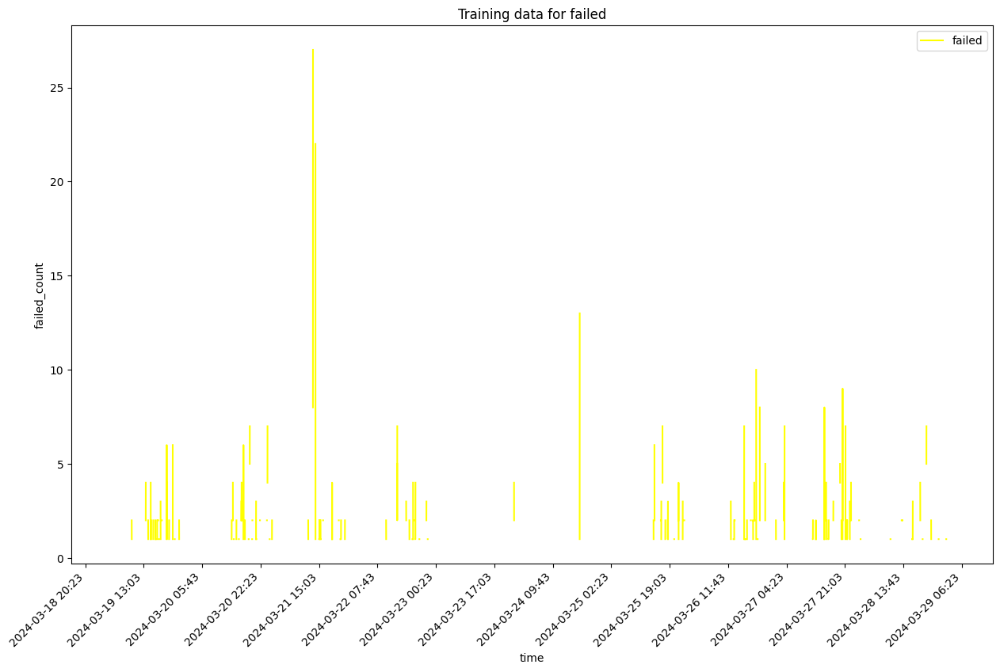

self.df_training shape  12531
Sum of histogram frequencies:  883.0
Number of non-NaN records in column x:  883


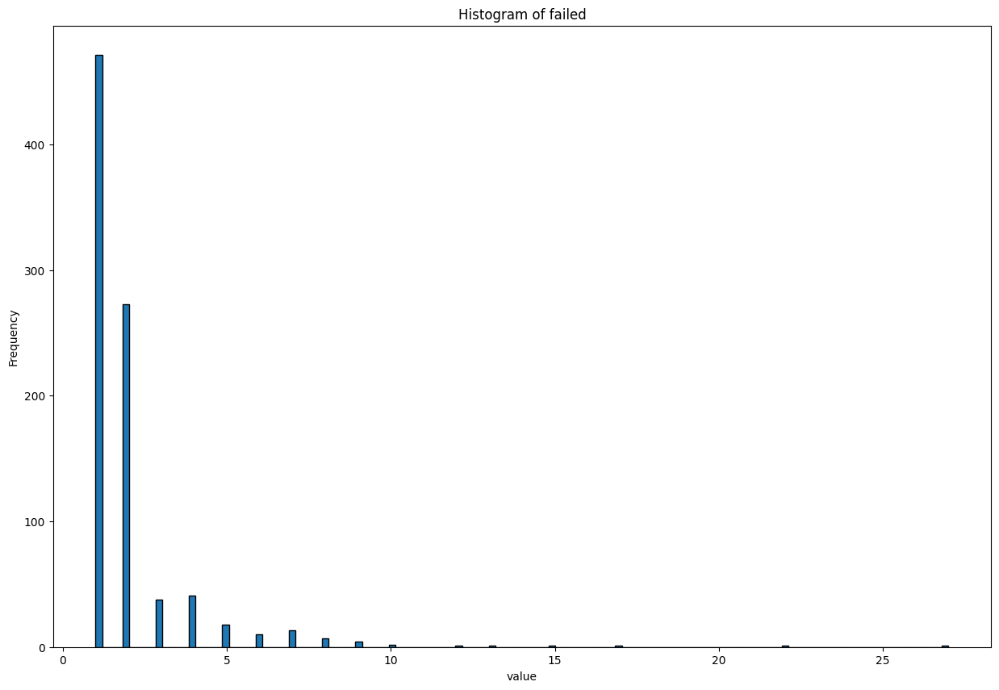

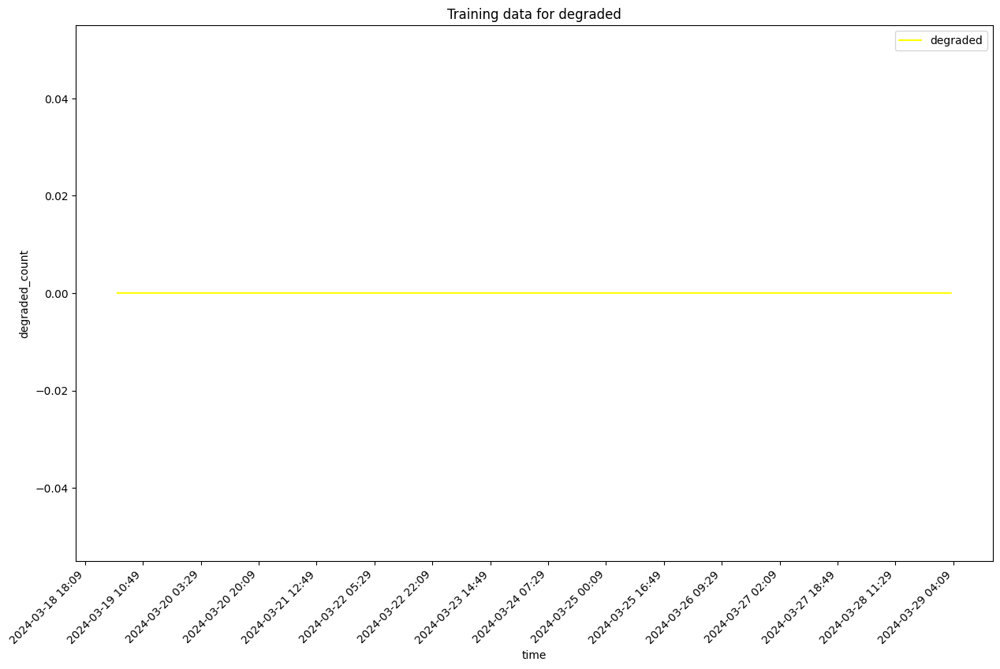

self.df_training shape  12531
Sum of histogram frequencies:  12531.0
Number of non-NaN records in column x:  12531


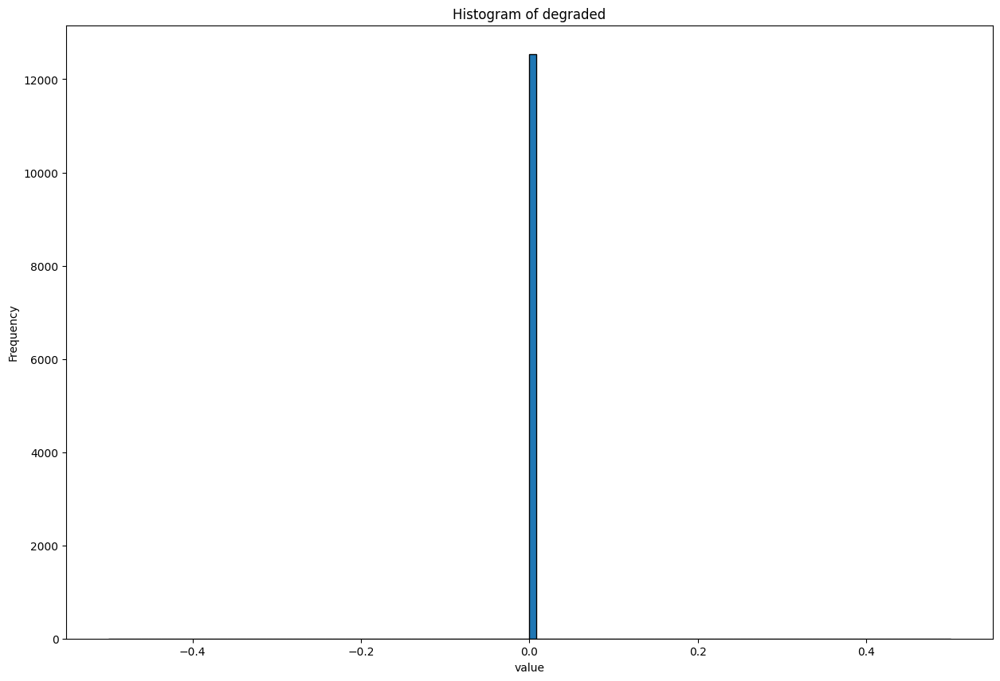

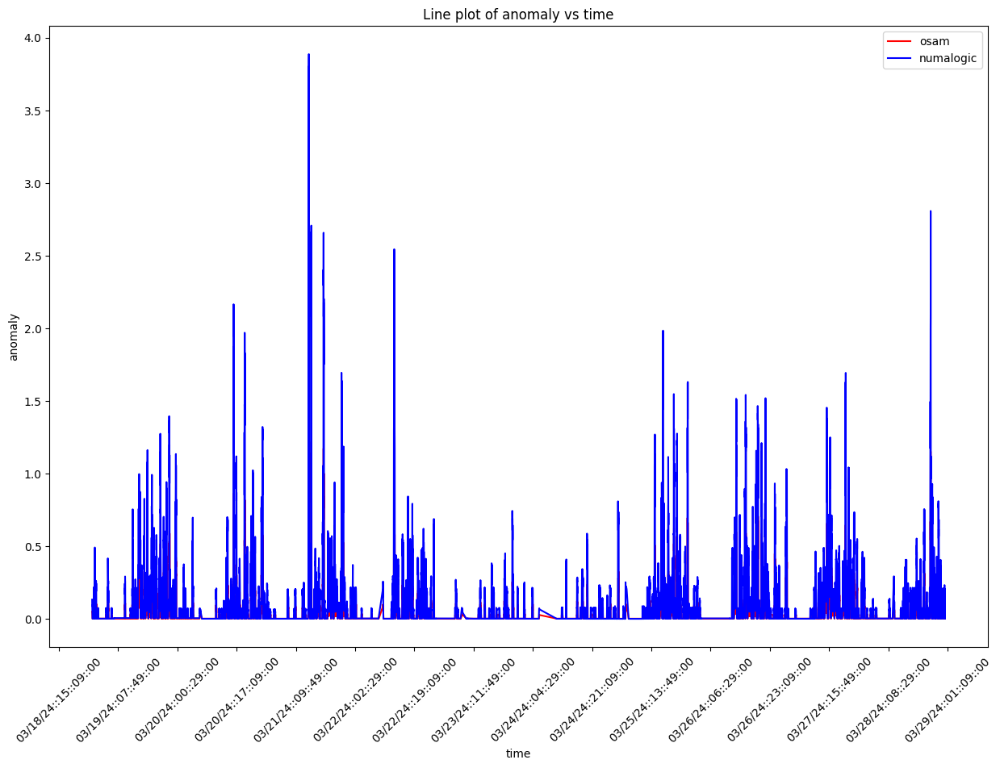

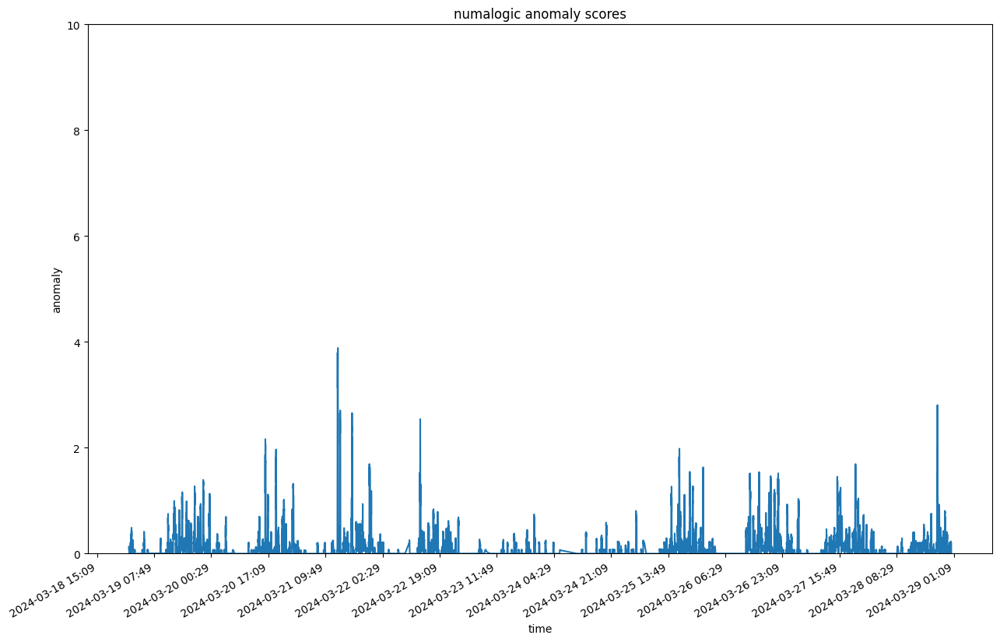

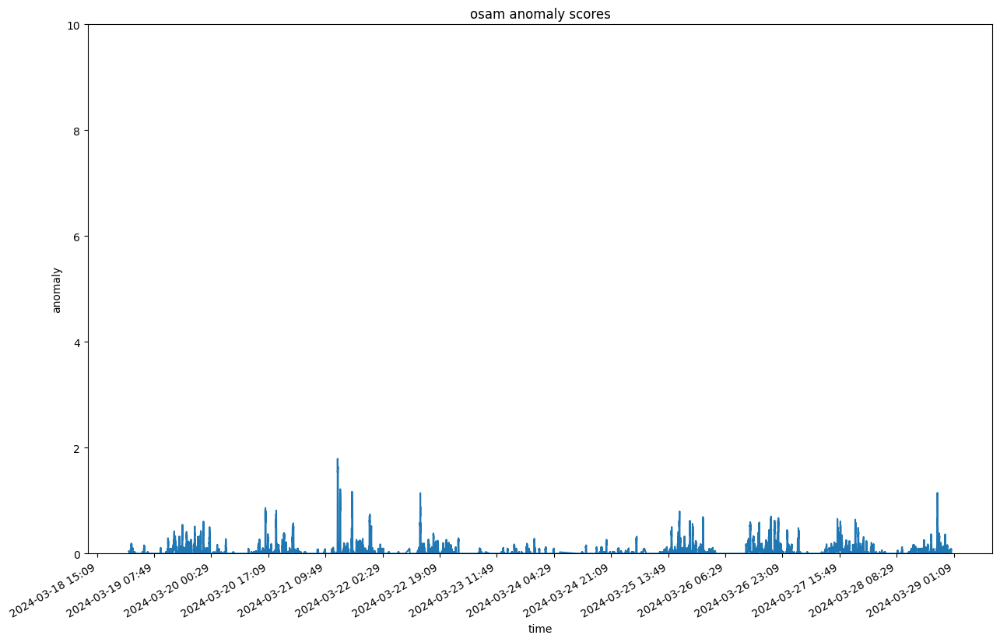

DEBUG:numalogic.connectors.druid._druid:Querying with end_dt: 2024-03-29 03:27:43.939325+00:00, that is with delay of 3 hrs


------------------------------------------------------------
------------------------------------------------------------        ModelId: fciPluginAppInteractions:metrics:3678332588046106875:5984175597303660107:qbaa.fai.bankconnections-ui.ProcessOfxFileCall       ---------------------------------------------


DEBUG:numalogic.connectors.druid._druid:Druid params: {'datasource': 'tech-ip-customer-interaction-metrics', 'granularity': 'minute', 'intervals': ['2024-03-19T03:27:43.939325+00:00/2024-03-29T03:27:43.939325+00:00'], 'aggregations': {'count': {'type': 'doubleSum', 'fieldName': 'count', 'name': 'count'}}, 'post_aggregations': {}, 'filter': <pydruid.utils.filters.Filter object at 0x147422fb0>, 'dimensions': <map object at 0x147423130>, 'context': {'timeout': 10000, 'configIds': ['pluginAssetId', 'assetId', 'interactionName'], 'source': 'numalogic'}}, fetch time: 1.0220s
DEBUG:numalogic.udfs.tools:Querying with end_dt: 2024-03-29 00:27:46.966268+00:00, that is with delay of 3 hrs
DEBUG:numalogic.udfs.tools:Querying with end_dt: 2024-03-29 00:27:46.966268+00:00, that is with delay of 3 hrs


--- 3.5117881298065186 seconds ---
--- 9.185940980911255 seconds ---


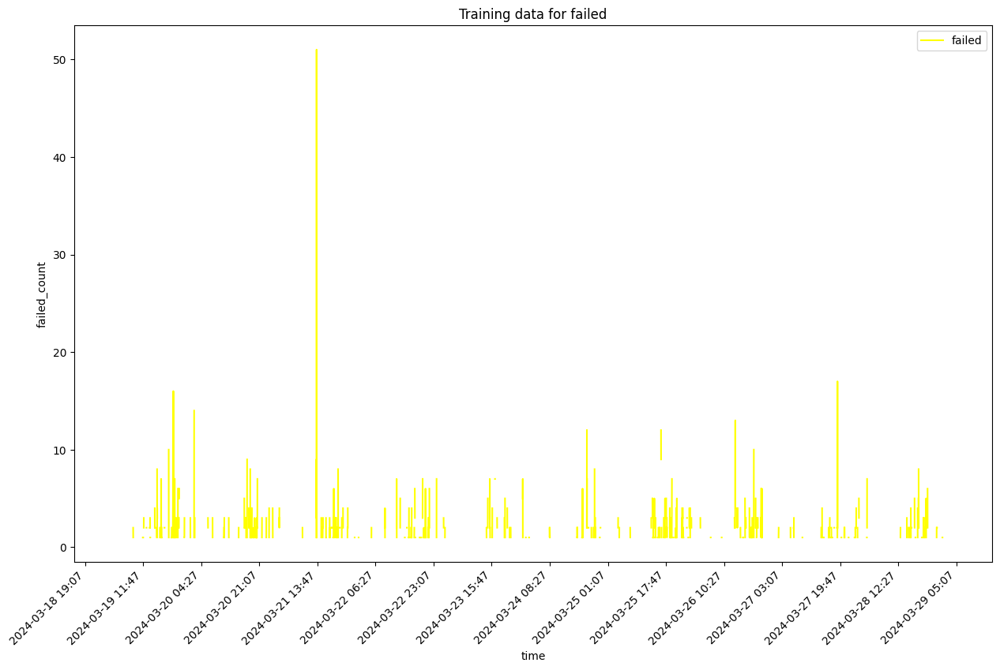

self.df_training shape  13294
Sum of histogram frequencies:  1274.0
Number of non-NaN records in column x:  1274


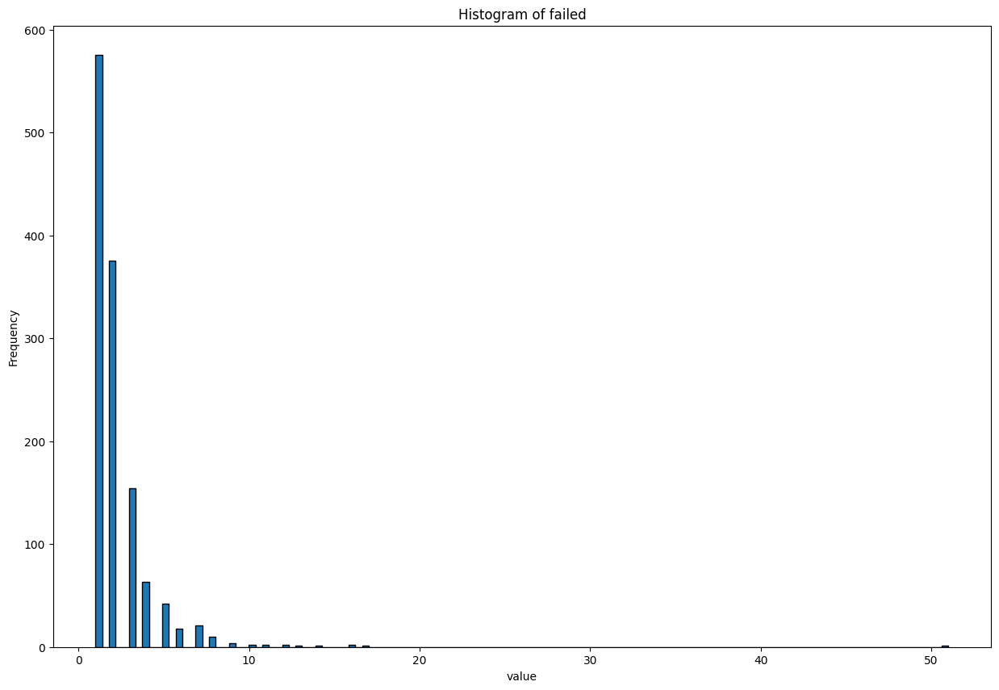

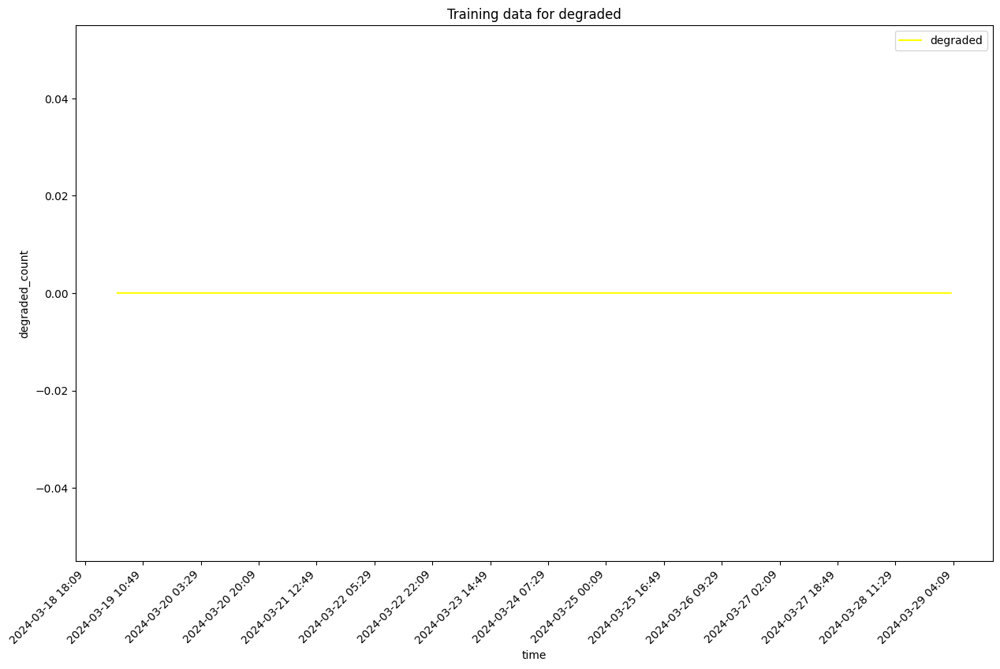

self.df_training shape  13294
Sum of histogram frequencies:  13294.0
Number of non-NaN records in column x:  13294


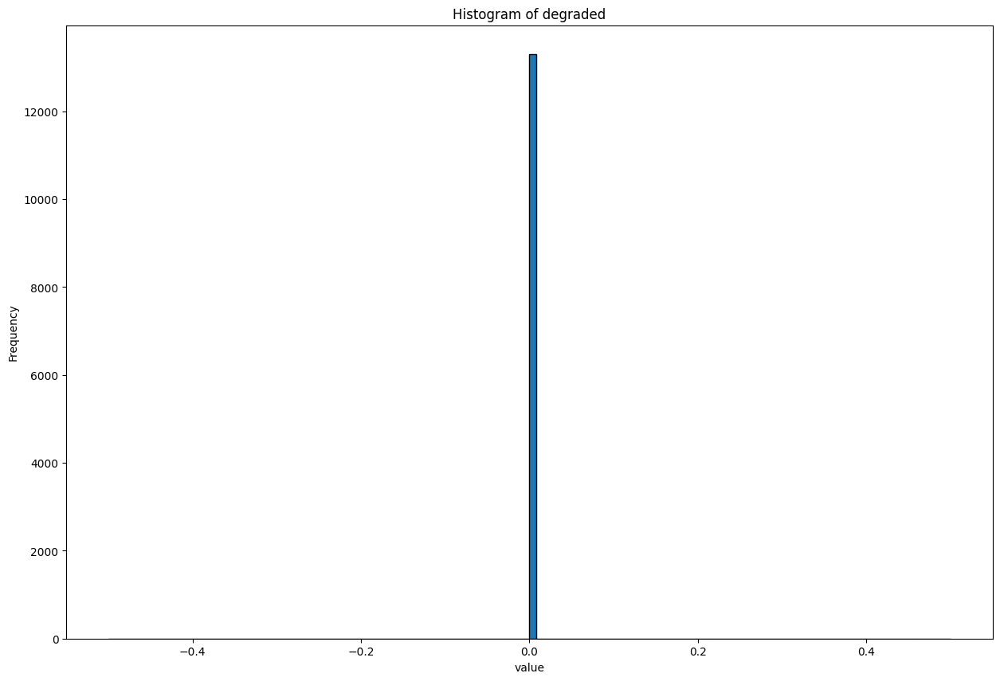

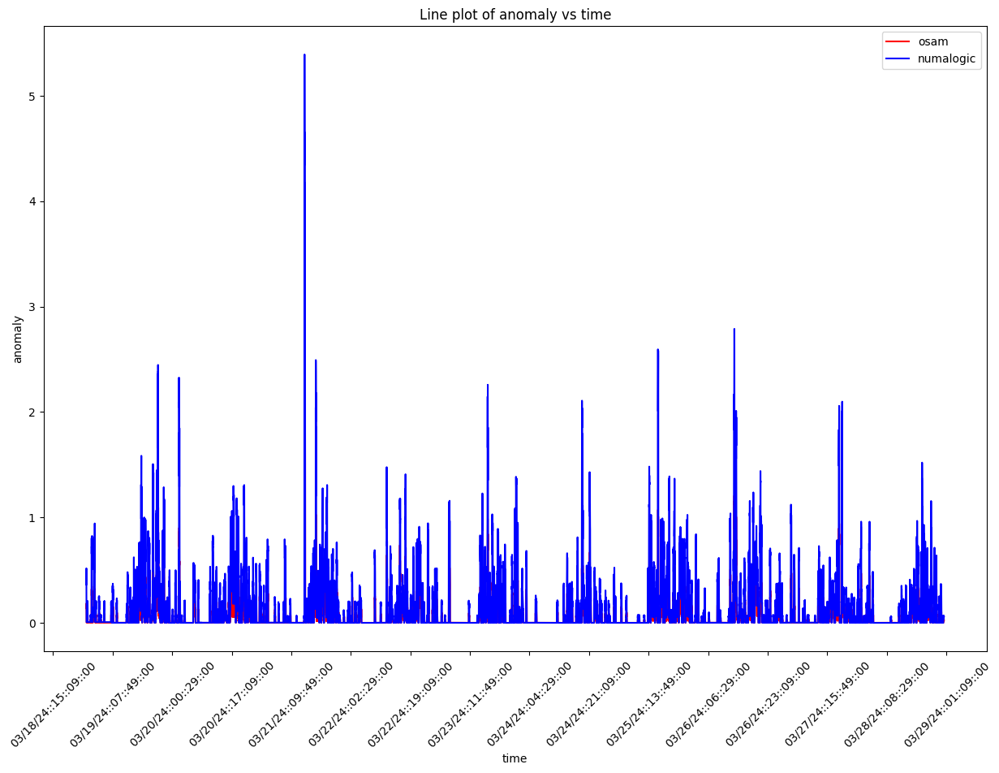

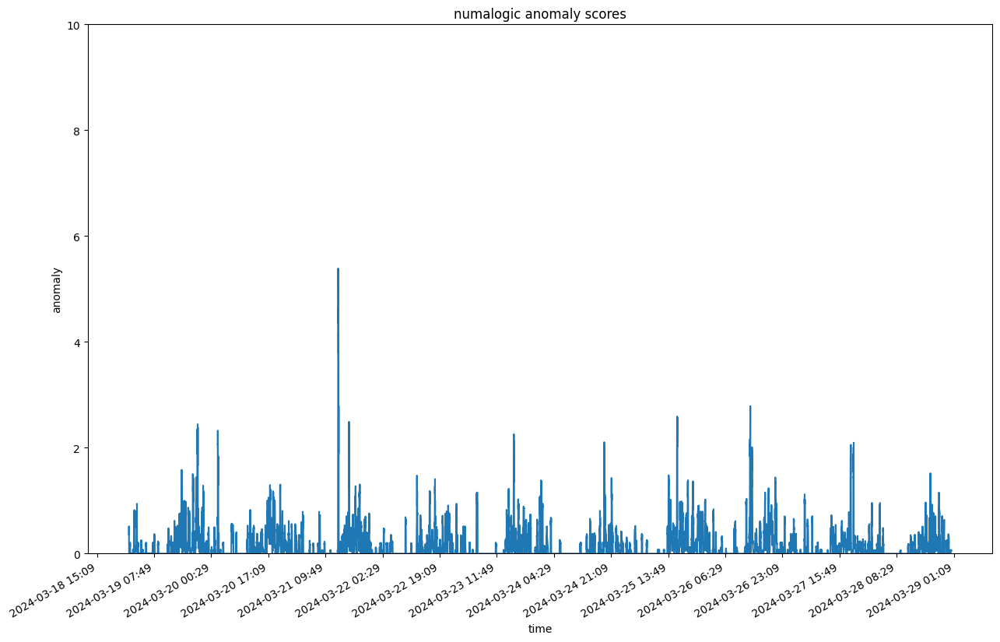

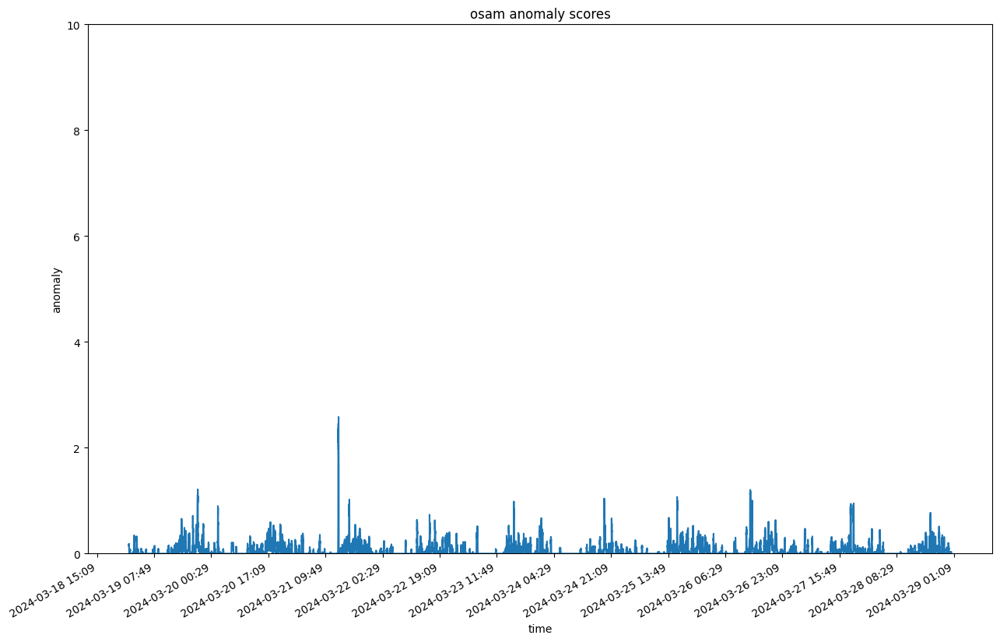

DEBUG:numalogic.connectors.druid._druid:Querying with end_dt: 2024-03-29 03:28:03.980225+00:00, that is with delay of 3 hrs


------------------------------------------------------------
------------------------------------------------------------        ModelId: fci:interactionsFailed:4831254092648450521:personalinfo-taxpayer-entry-views-0.personalinfo.Next       ---------------------------------------------


DEBUG:numalogic.connectors.druid._druid:Druid params: {'datasource': 'tech-ip-customer-interaction-metrics', 'granularity': 'minute', 'intervals': ['2024-03-19T03:28:03.980225+00:00/2024-03-29T03:28:03.980225+00:00'], 'aggregations': {'count': {'type': 'doubleSum', 'fieldName': 'count', 'name': 'count'}}, 'post_aggregations': {}, 'filter': <pydruid.utils.filters.Filter object at 0x2cb83e290>, 'dimensions': <map object at 0x2cb83c5b0>, 'context': {'timeout': 10000, 'configIds': ['assetId', 'interactionName'], 'source': 'numalogic'}}, fetch time: 0.8880s
DEBUG:numalogic.udfs.tools:Querying with end_dt: 2024-03-29 00:28:06.874044+00:00, that is with delay of 3 hrs
DEBUG:numalogic.udfs.tools:Querying with end_dt: 2024-03-29 00:28:06.874044+00:00, that is with delay of 3 hrs


--- 3.287288188934326 seconds ---
--- 2.7721071243286133 seconds ---


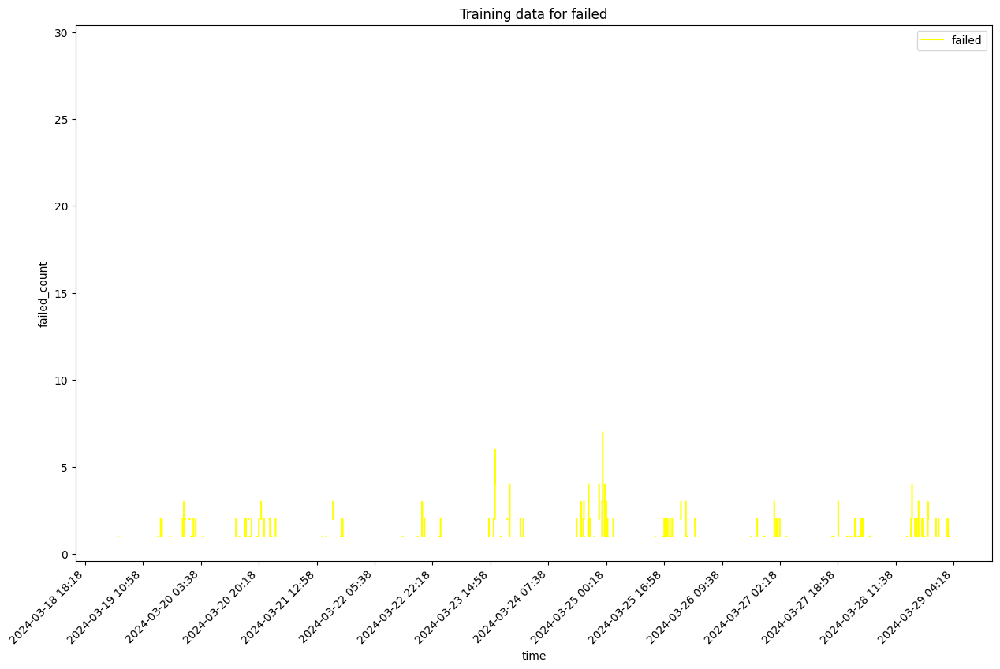

self.df_training shape  14382
Sum of histogram frequencies:  1169.0
Number of non-NaN records in column x:  1169


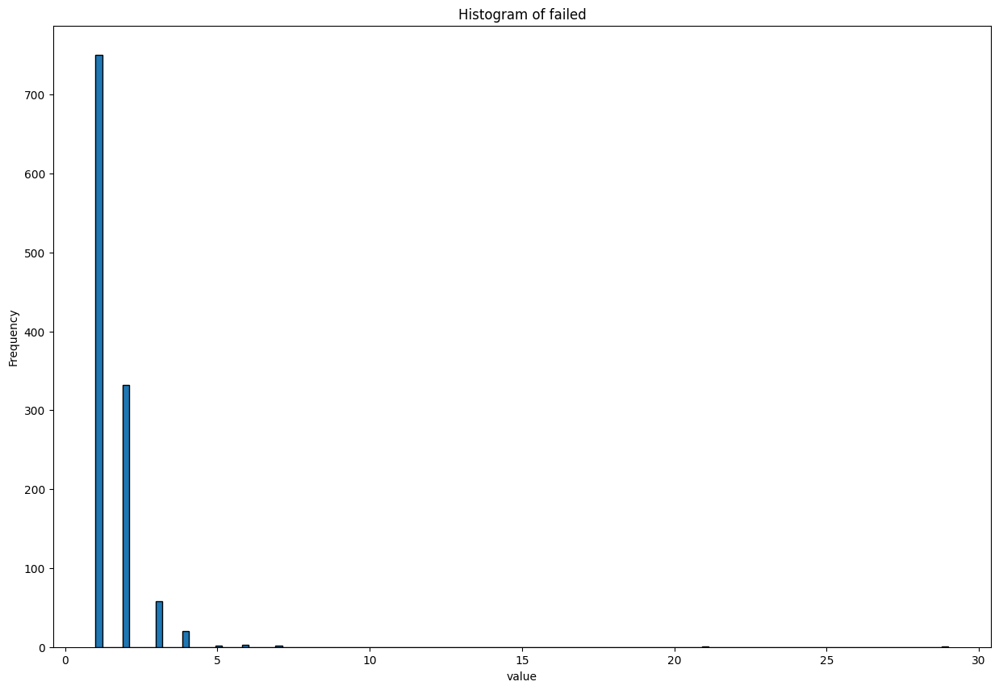

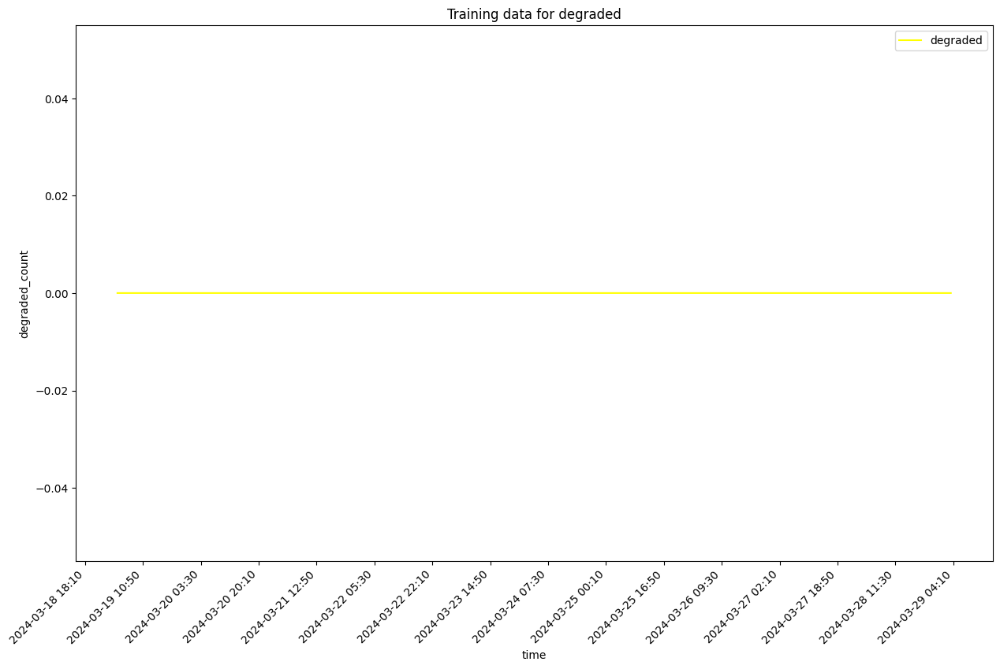

self.df_training shape  14382
Sum of histogram frequencies:  14382.0
Number of non-NaN records in column x:  14382


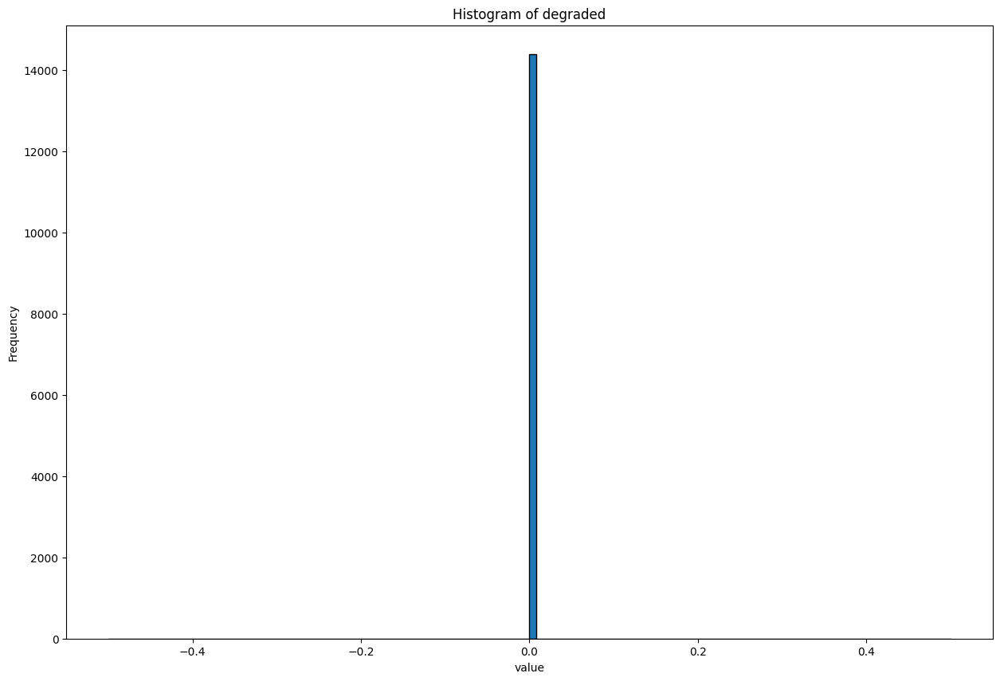

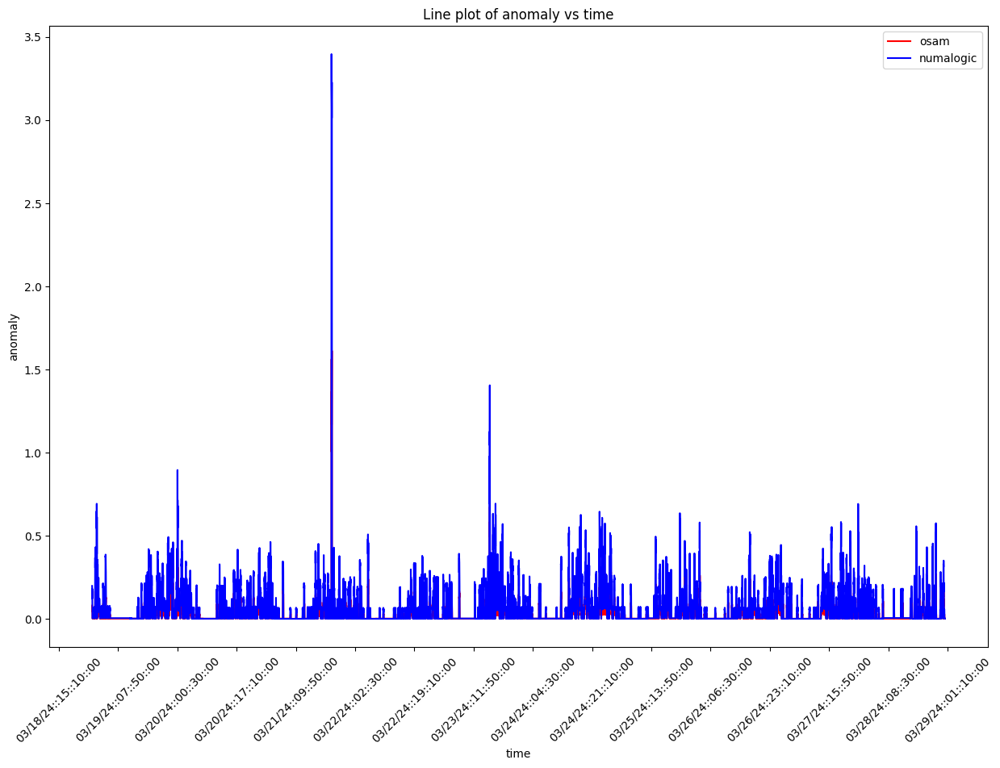

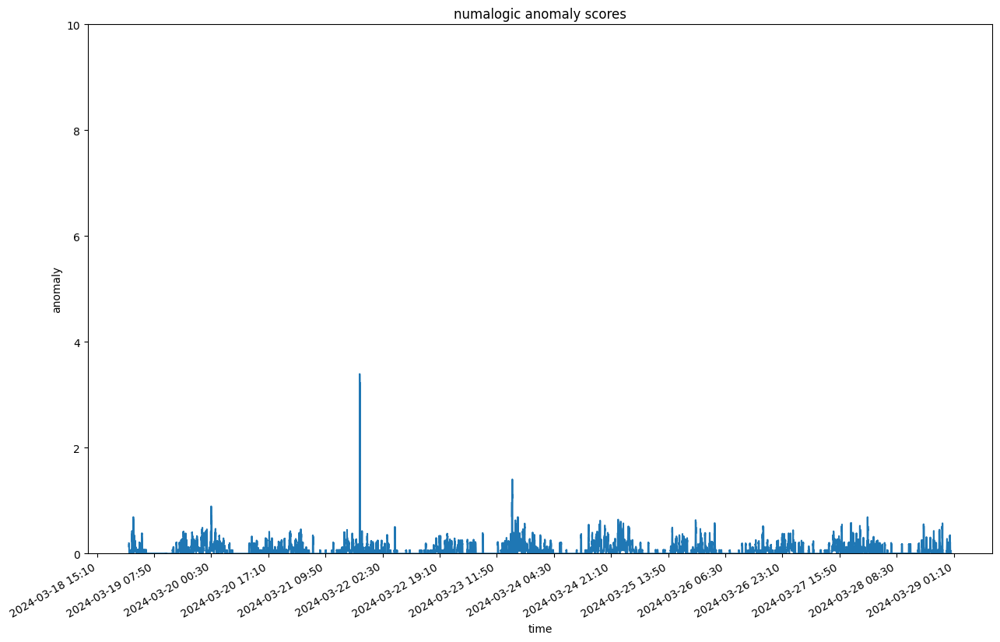

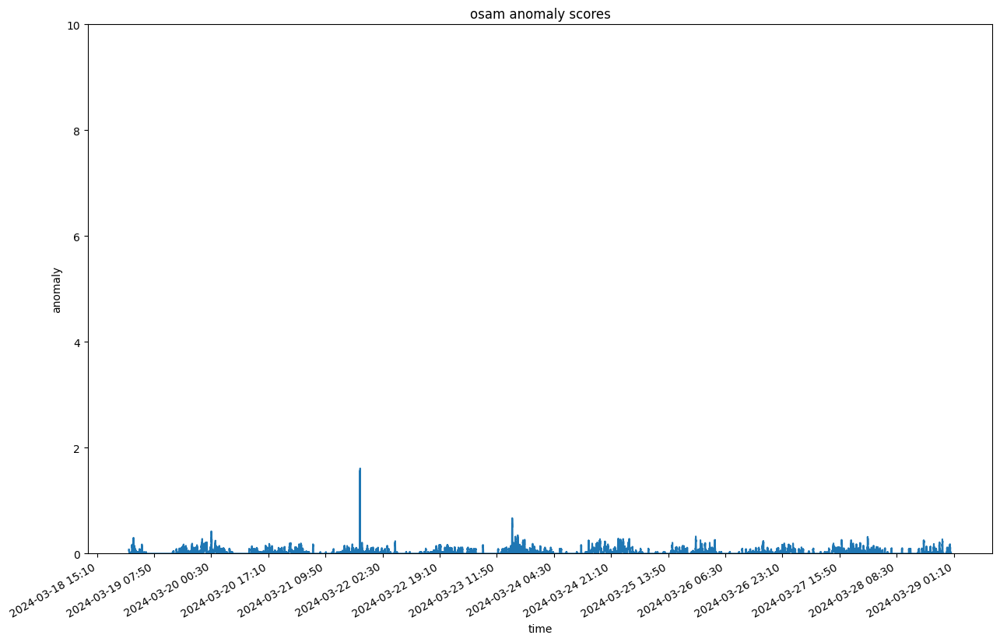

DEBUG:numalogic.connectors.druid._druid:Querying with end_dt: 2024-03-29 03:28:17.383917+00:00, that is with delay of 3 hrs


------------------------------------------------------------
------------------------------------------------------------        ModelId: fciPlugin:requestsFailed:4831254092648450521:vep-collab-smlk-ui       ---------------------------------------------


DEBUG:numalogic.connectors.druid._druid:Druid params: {'datasource': 'tech-ip-customer-interaction-metrics', 'granularity': 'minute', 'intervals': ['2024-03-19T03:28:17.383917+00:00/2024-03-29T03:28:17.383917+00:00'], 'aggregations': {'count': {'type': 'doubleSum', 'fieldName': 'count', 'name': 'count'}}, 'post_aggregations': {}, 'filter': <pydruid.utils.filters.Filter object at 0x2cb4f1810>, 'dimensions': <map object at 0x2cb4f1c30>, 'context': {'timeout': 10000, 'configIds': ['assetId', 'pluginId'], 'source': 'numalogic'}}, fetch time: 0.9884s
DEBUG:numalogic.udfs.tools:Querying with end_dt: 2024-03-29 00:28:20.373107+00:00, that is with delay of 3 hrs
DEBUG:numalogic.udfs.tools:Querying with end_dt: 2024-03-29 00:28:20.373107+00:00, that is with delay of 3 hrs


--- 4.363499164581299 seconds ---
--- 1.9501469135284424 seconds ---


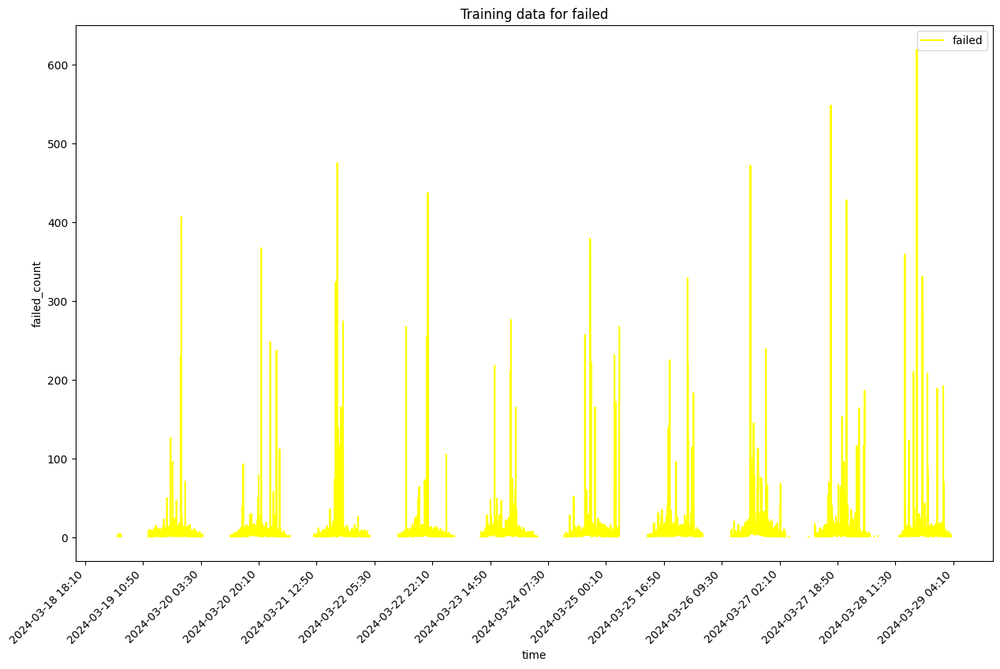

self.df_training shape  11077
Sum of histogram frequencies:  8735.0
Number of non-NaN records in column x:  8735


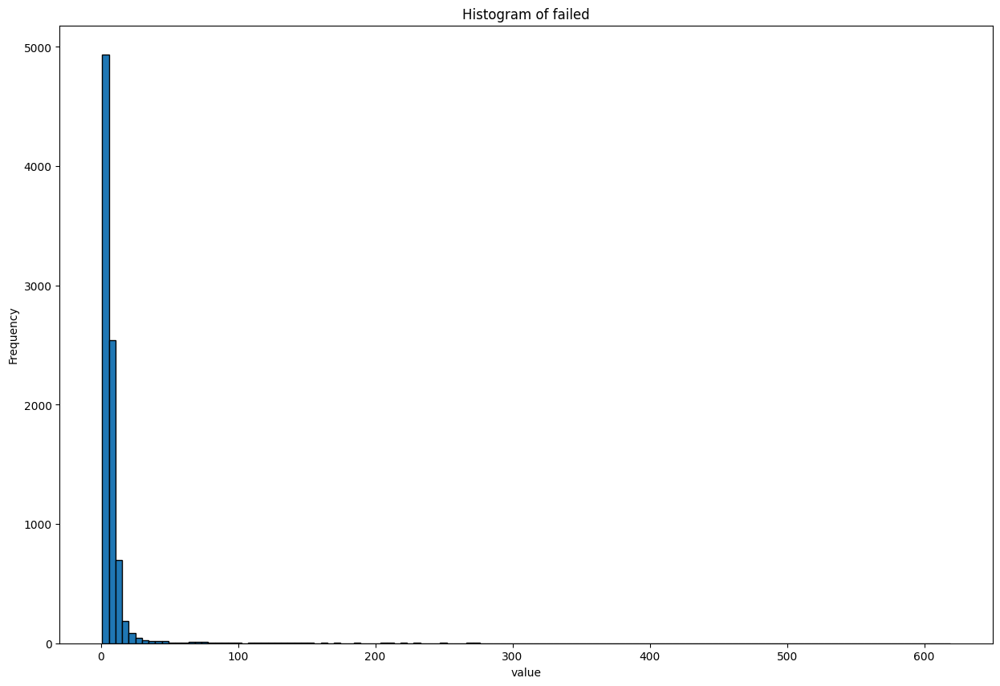

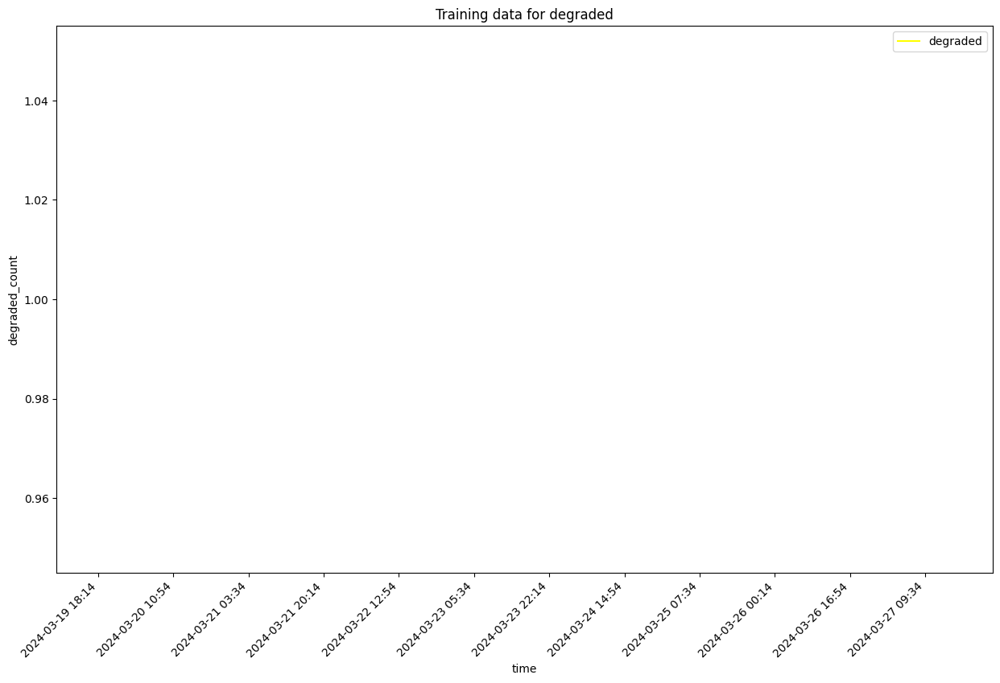

self.df_training shape  11077
Sum of histogram frequencies:  11.0
Number of non-NaN records in column x:  11


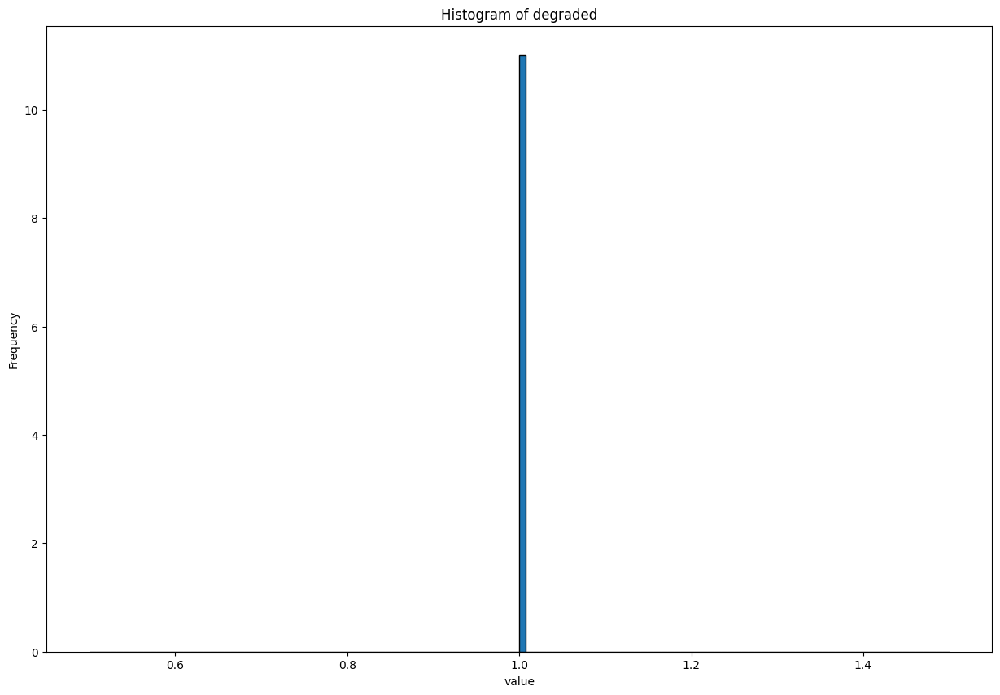

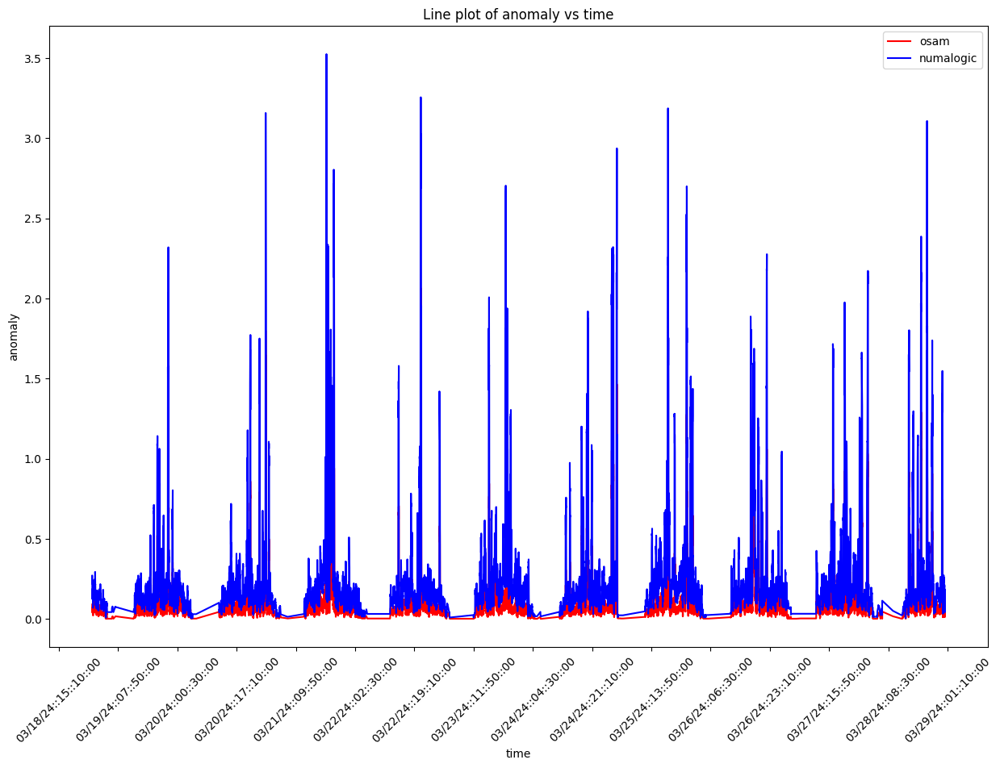

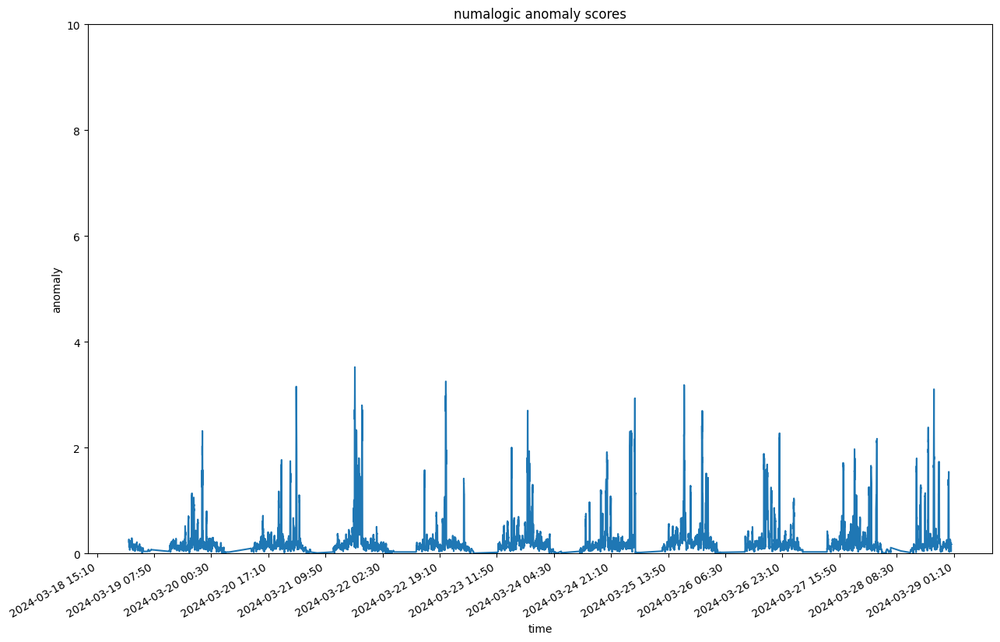

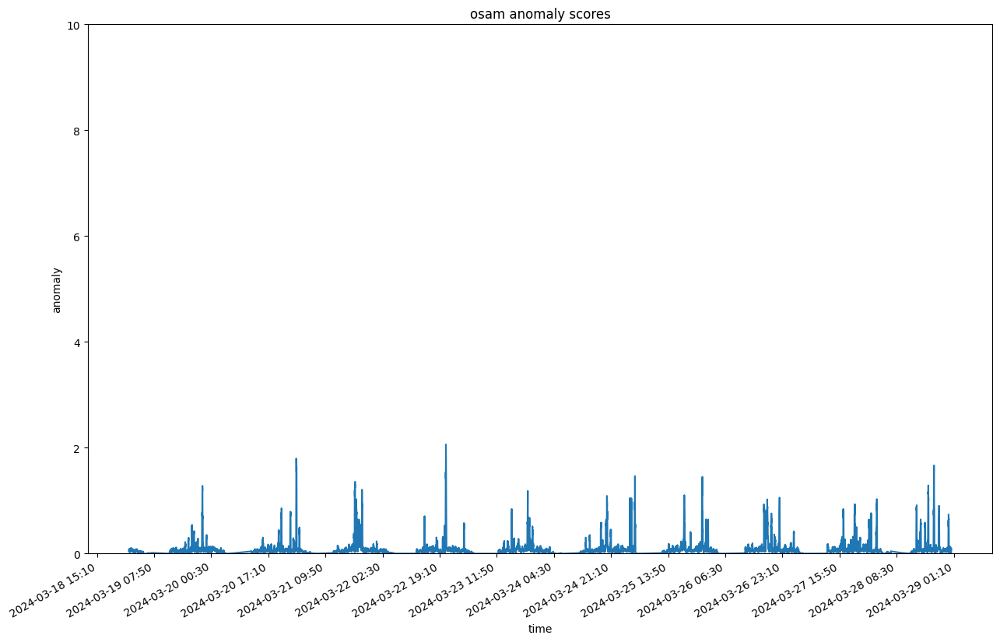

DEBUG:numalogic.connectors.druid._druid:Querying with end_dt: 2024-03-29 03:28:31.071433+00:00, that is with delay of 3 hrs


------------------------------------------------------------
------------------------------------------------------------        ModelId: fciPluginAppInteractions:metrics:5551830033781551331:6344463568198587497:itsdeductible__personal_info_loaded       ---------------------------------------------


DEBUG:numalogic.connectors.druid._druid:Druid params: {'datasource': 'tech-ip-customer-interaction-metrics', 'granularity': 'minute', 'intervals': ['2024-03-19T03:28:31.071433+00:00/2024-03-29T03:28:31.071433+00:00'], 'aggregations': {'count': {'type': 'doubleSum', 'fieldName': 'count', 'name': 'count'}}, 'post_aggregations': {}, 'filter': <pydruid.utils.filters.Filter object at 0x2cb300100>, 'dimensions': <map object at 0x2cb303f40>, 'context': {'timeout': 10000, 'configIds': ['pluginAssetId', 'assetId', 'interactionName'], 'source': 'numalogic'}}, fetch time: 0.6557s
DEBUG:numalogic.udfs.tools:Querying with end_dt: 2024-03-29 00:28:33.731242+00:00, that is with delay of 3 hrs
DEBUG:numalogic.udfs.tools:Querying with end_dt: 2024-03-29 00:28:33.731242+00:00, that is with delay of 3 hrs


--- 2.478748083114624 seconds ---
--- 4.0448479652404785 seconds ---


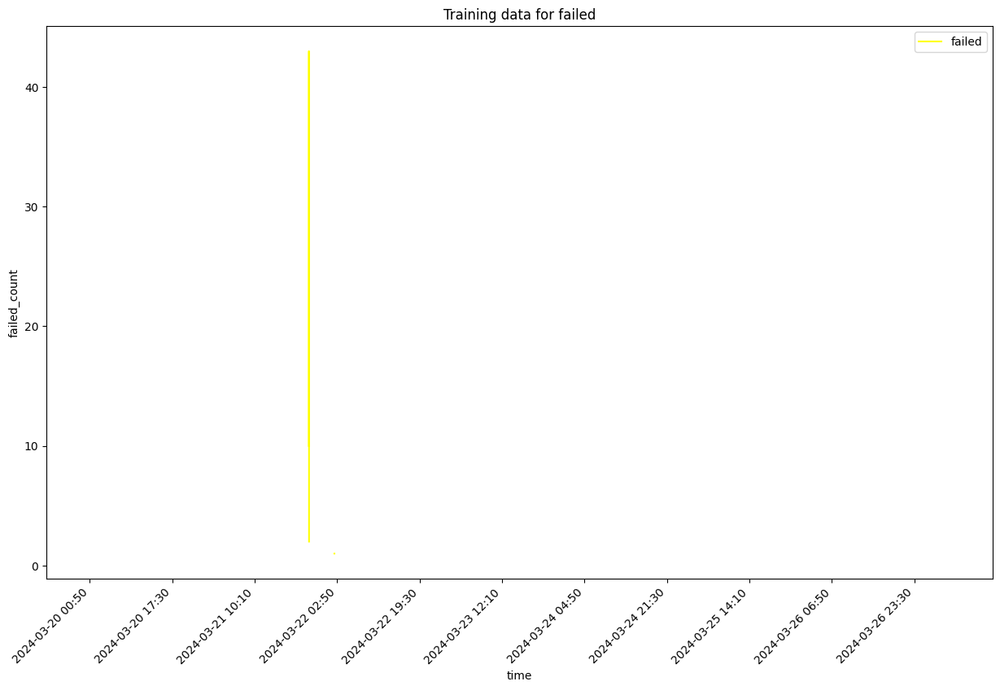

self.df_training shape  7392
Sum of histogram frequencies:  28.0
Number of non-NaN records in column x:  28


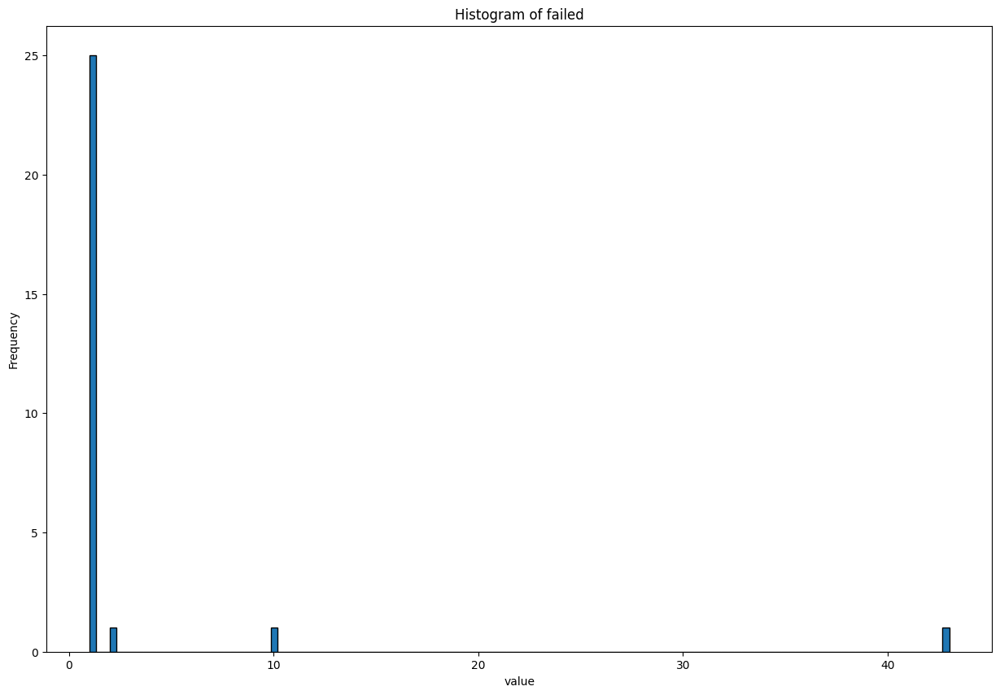

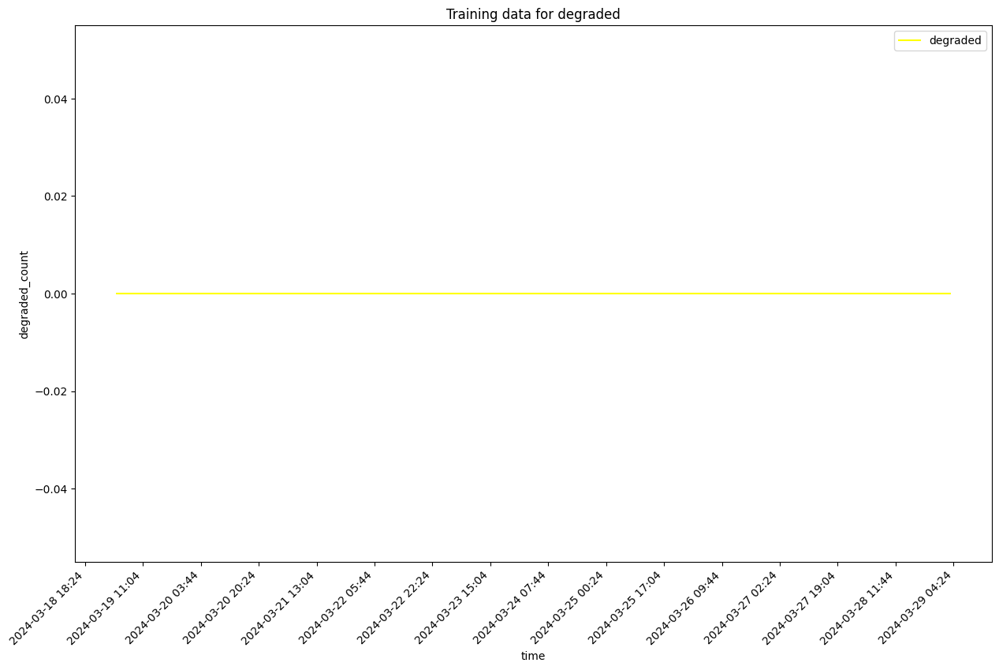

self.df_training shape  7392
Sum of histogram frequencies:  7392.0
Number of non-NaN records in column x:  7392


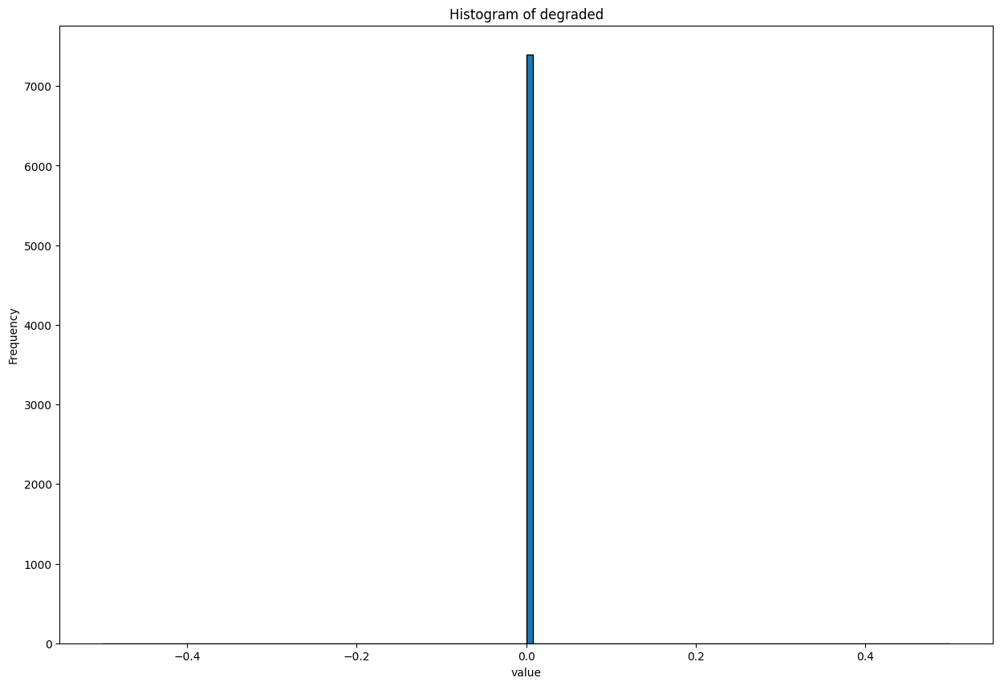

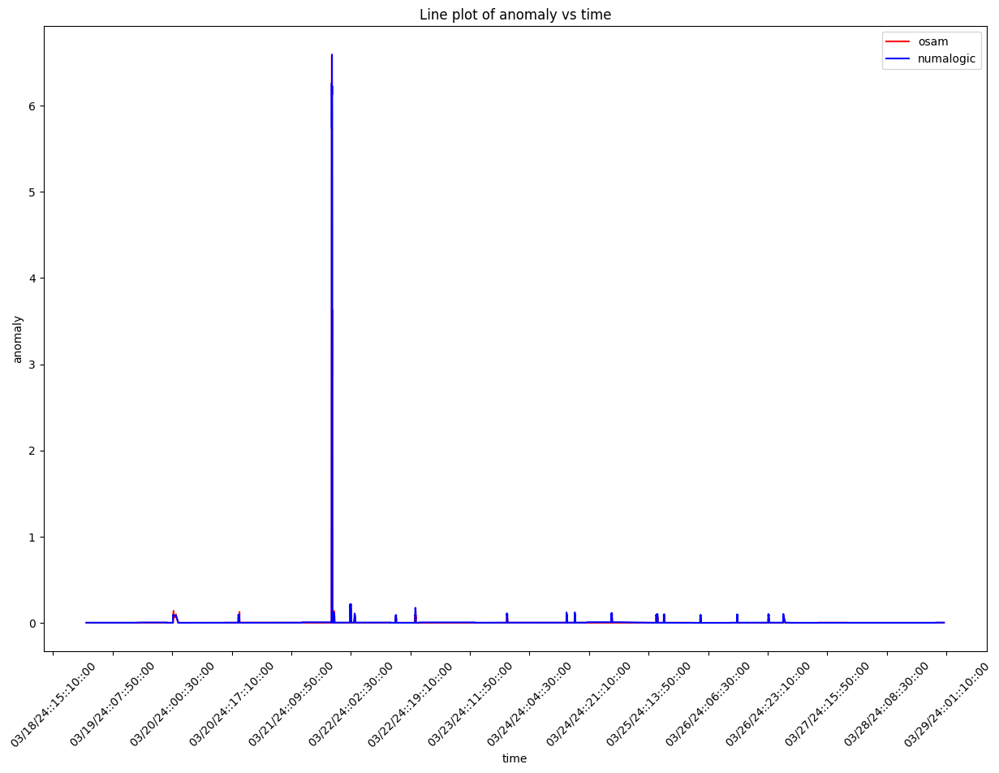

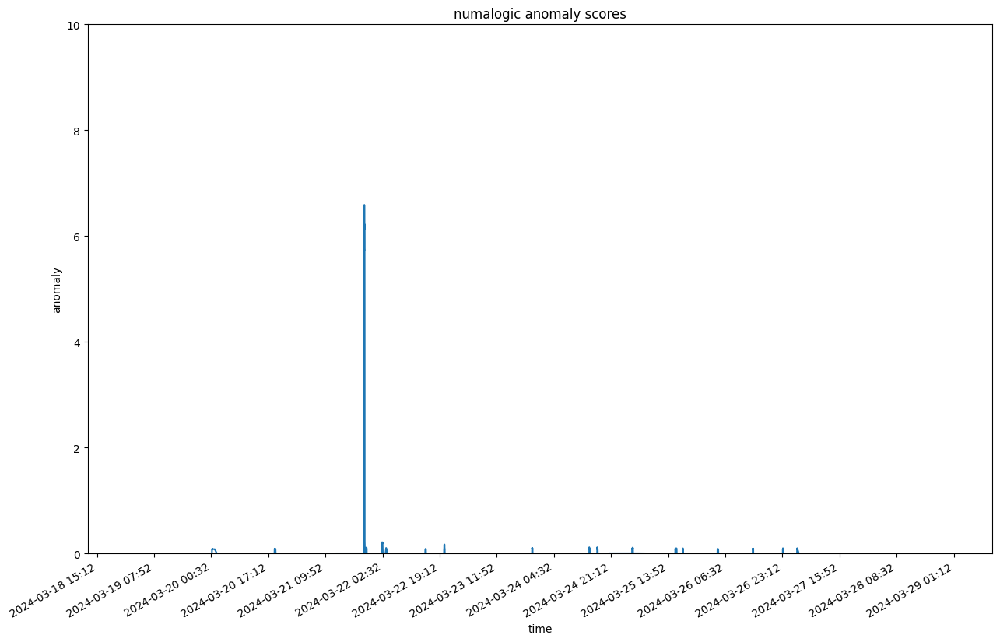

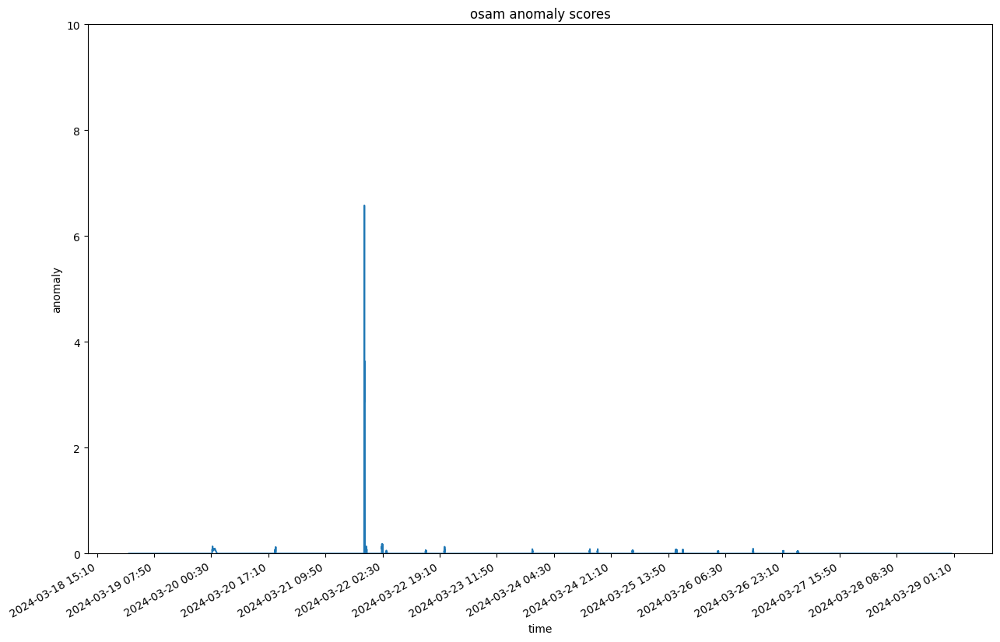

DEBUG:numalogic.connectors.druid._druid:Querying with end_dt: 2024-03-29 03:28:44.309840+00:00, that is with delay of 3 hrs


------------------------------------------------------------
------------------------------------------------------------        ModelId: fci:interactionsFailed:6344463568198587497:itsdeductible__personal_info_loaded       ---------------------------------------------


DEBUG:numalogic.connectors.druid._druid:Druid params: {'datasource': 'tech-ip-customer-interaction-metrics', 'granularity': 'minute', 'intervals': ['2024-03-19T03:28:44.309840+00:00/2024-03-29T03:28:44.309840+00:00'], 'aggregations': {'count': {'type': 'doubleSum', 'fieldName': 'count', 'name': 'count'}}, 'post_aggregations': {}, 'filter': <pydruid.utils.filters.Filter object at 0x1472f8a30>, 'dimensions': <map object at 0x1472f8190>, 'context': {'timeout': 10000, 'configIds': ['assetId', 'interactionName'], 'source': 'numalogic'}}, fetch time: 0.7614s
DEBUG:numalogic.udfs.tools:Querying with end_dt: 2024-03-29 00:28:47.072412+00:00, that is with delay of 3 hrs
DEBUG:numalogic.udfs.tools:Querying with end_dt: 2024-03-29 00:28:47.072412+00:00, that is with delay of 3 hrs


--- 2.0388717651367188 seconds ---
--- 3.9501137733459473 seconds ---


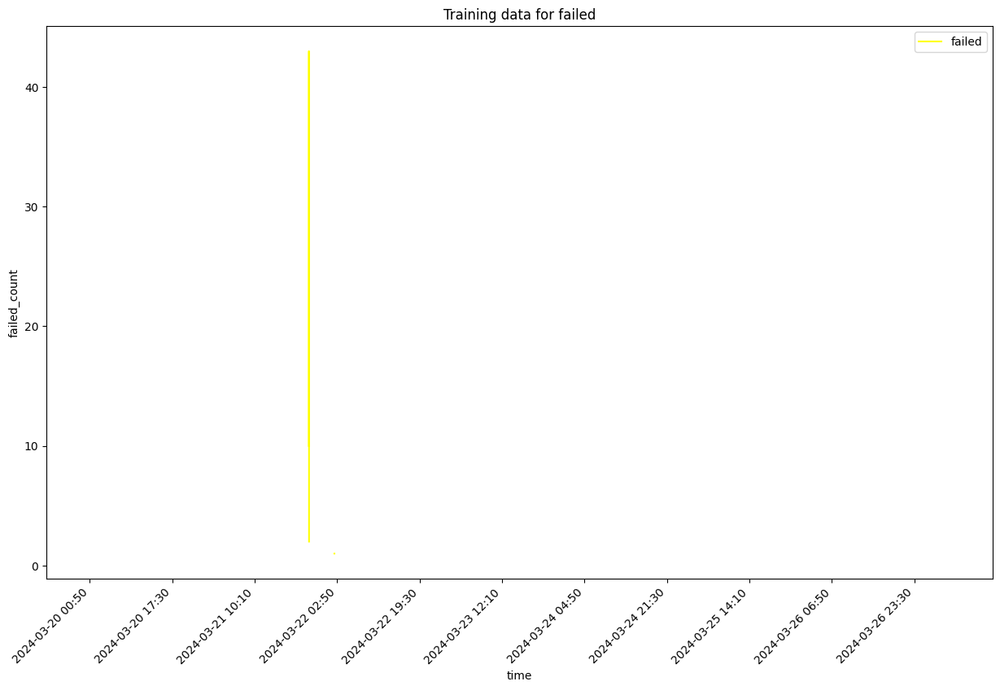

self.df_training shape  7392
Sum of histogram frequencies:  28.0
Number of non-NaN records in column x:  28


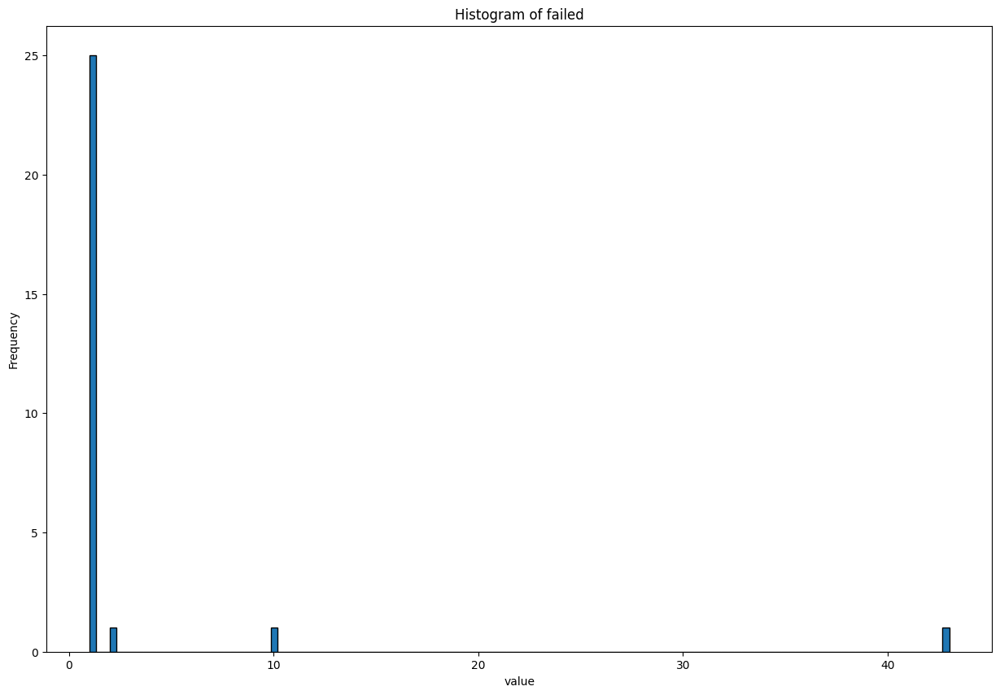

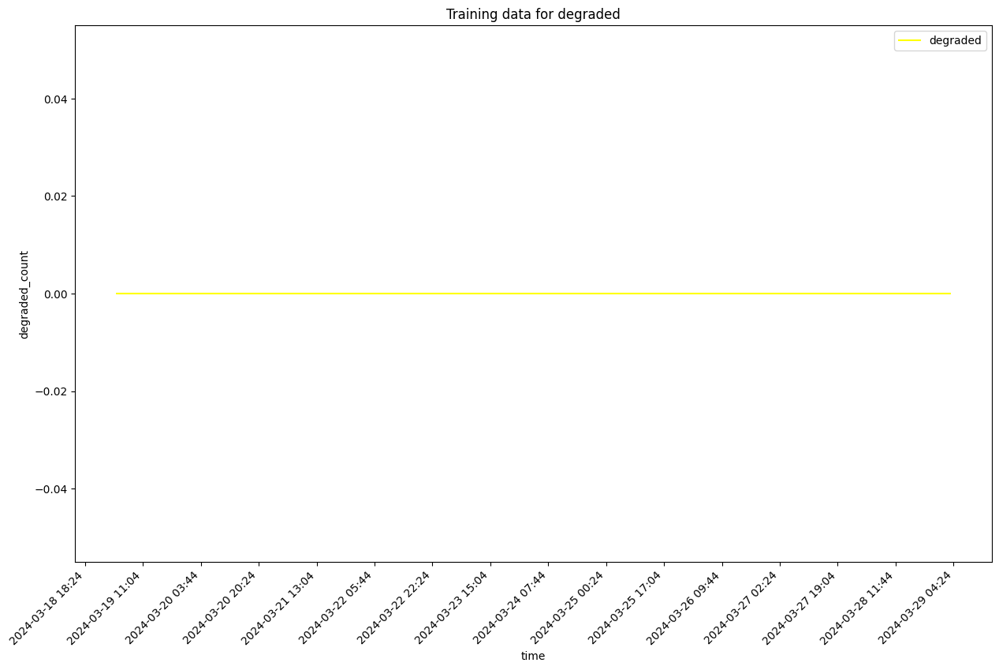

self.df_training shape  7392
Sum of histogram frequencies:  7392.0
Number of non-NaN records in column x:  7392


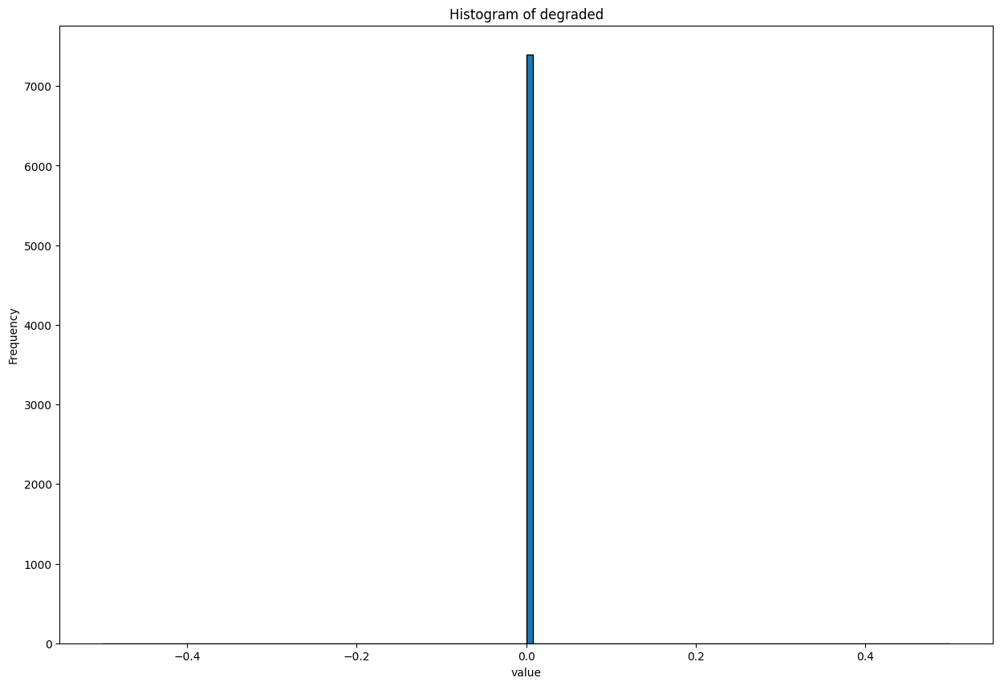

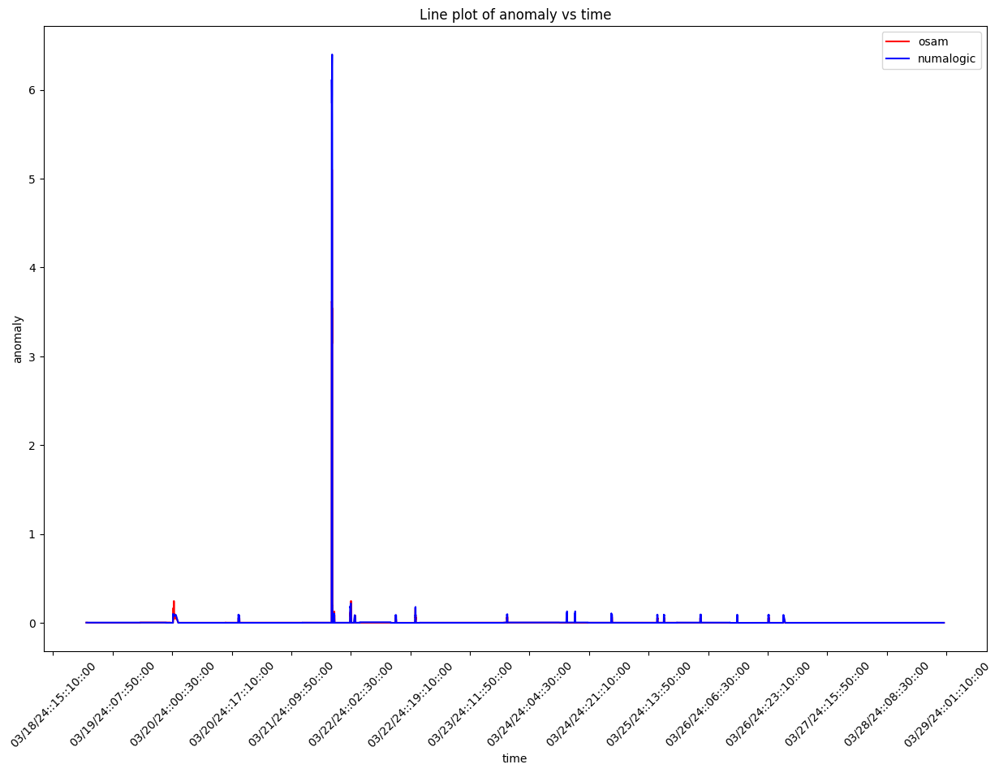

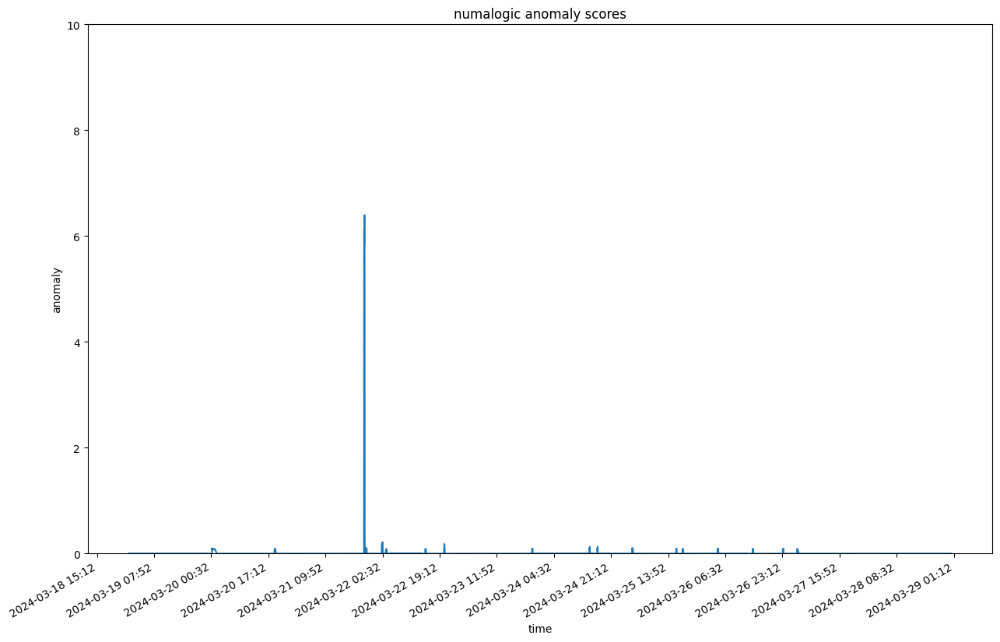

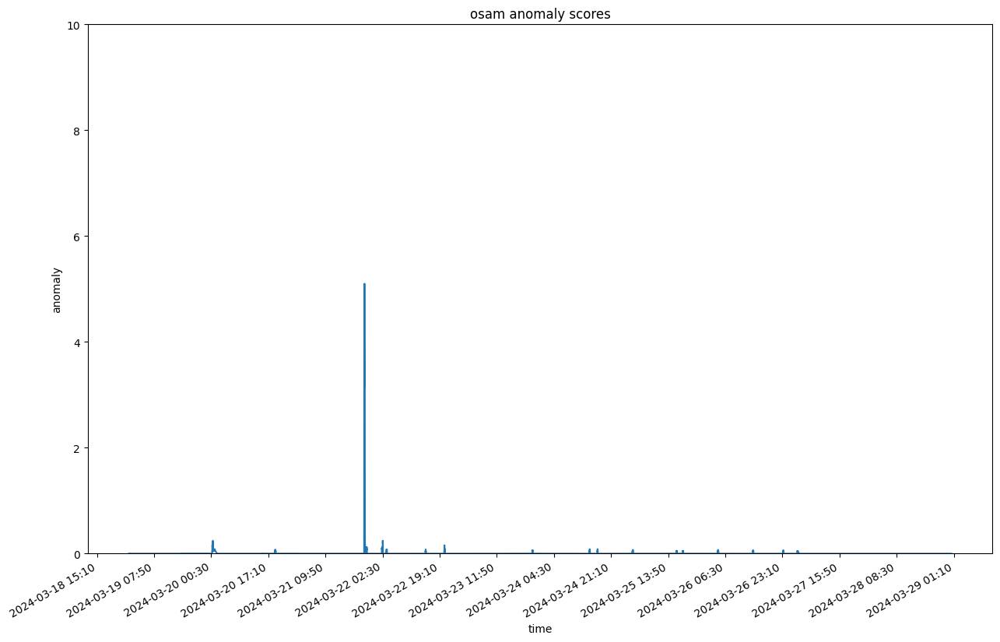

DEBUG:numalogic.connectors.druid._druid:Querying with end_dt: 2024-03-29 03:28:57.397836+00:00, that is with delay of 3 hrs


------------------------------------------------------------
------------------------------------------------------------        ModelId: fciPluginInteractions:metrics:2525411083745874319:get-smart-compose-prediction       ---------------------------------------------


DEBUG:numalogic.connectors.druid._druid:Druid params: {'datasource': 'tech-ip-customer-interaction-metrics', 'granularity': 'minute', 'intervals': ['2024-03-19T03:28:57.397836+00:00/2024-03-29T03:28:57.397836+00:00'], 'aggregations': {'count': {'type': 'doubleSum', 'fieldName': 'count', 'name': 'count'}}, 'post_aggregations': {}, 'filter': <pydruid.utils.filters.Filter object at 0x2cb150790>, 'dimensions': <map object at 0x1472e2110>, 'context': {'timeout': 10000, 'configIds': ['pluginAssetId', 'interactionName'], 'source': 'numalogic'}}, fetch time: 0.7758s
DEBUG:numalogic.udfs.tools:Querying with end_dt: 2024-03-29 00:29:00.177070+00:00, that is with delay of 3 hrs
DEBUG:numalogic.udfs.tools:Querying with end_dt: 2024-03-29 00:29:00.177070+00:00, that is with delay of 3 hrs


--- 2.3588128089904785 seconds ---
--- 4.6190338134765625 seconds ---


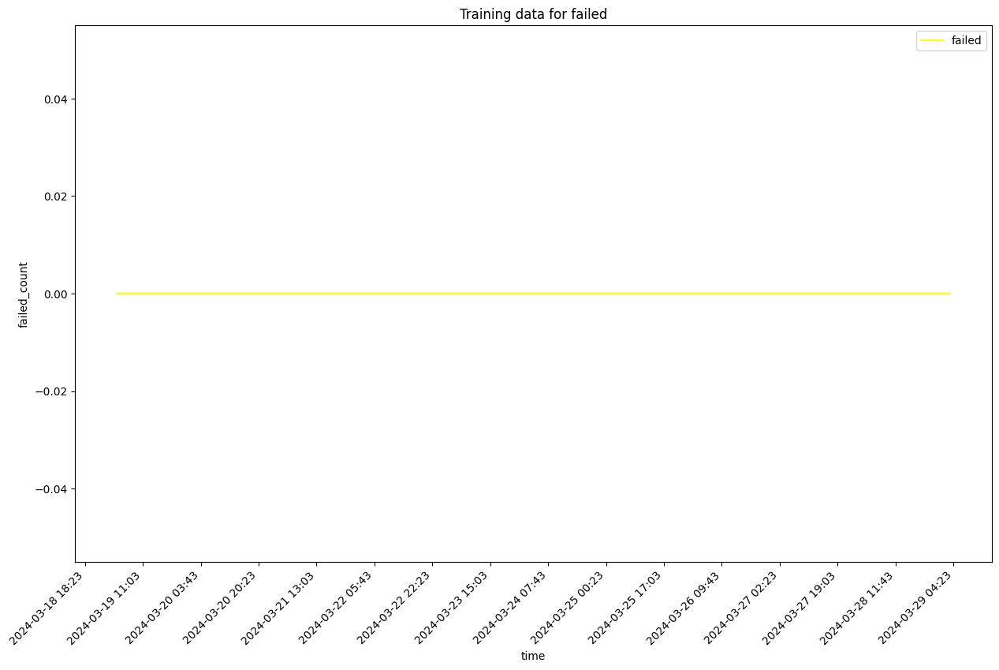

self.df_training shape  7735
Sum of histogram frequencies:  7735.0
Number of non-NaN records in column x:  7735


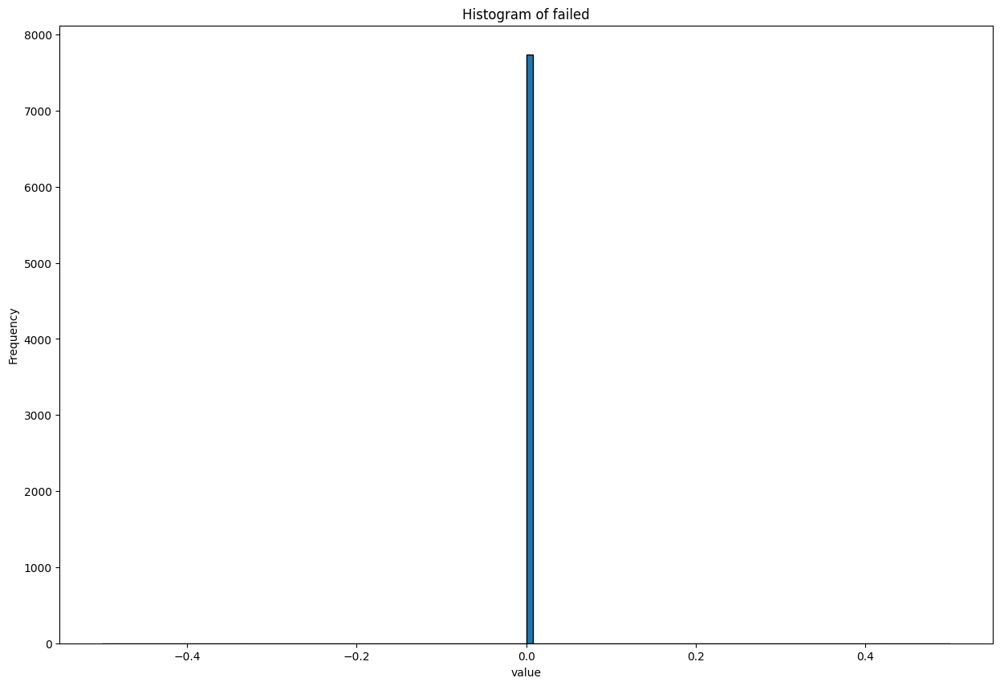

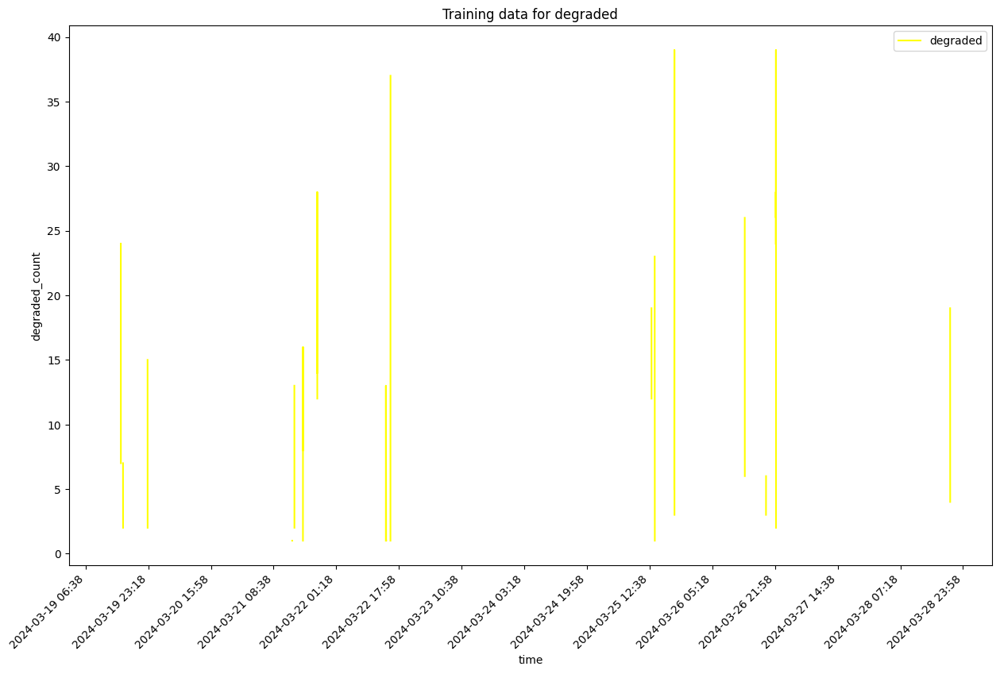

self.df_training shape  7735
Sum of histogram frequencies:  70.0
Number of non-NaN records in column x:  70


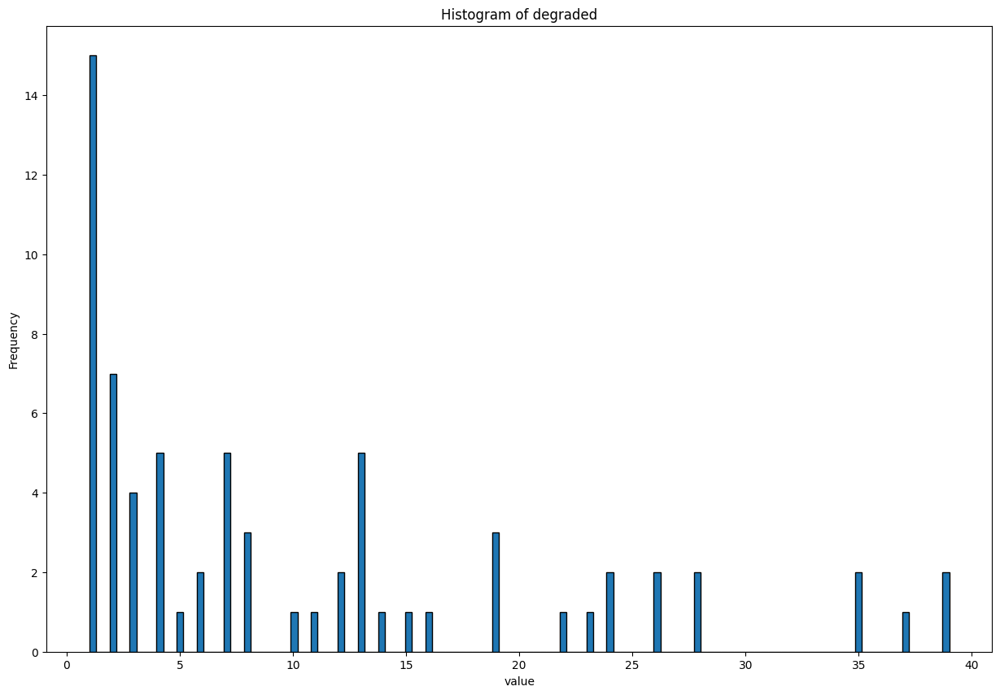

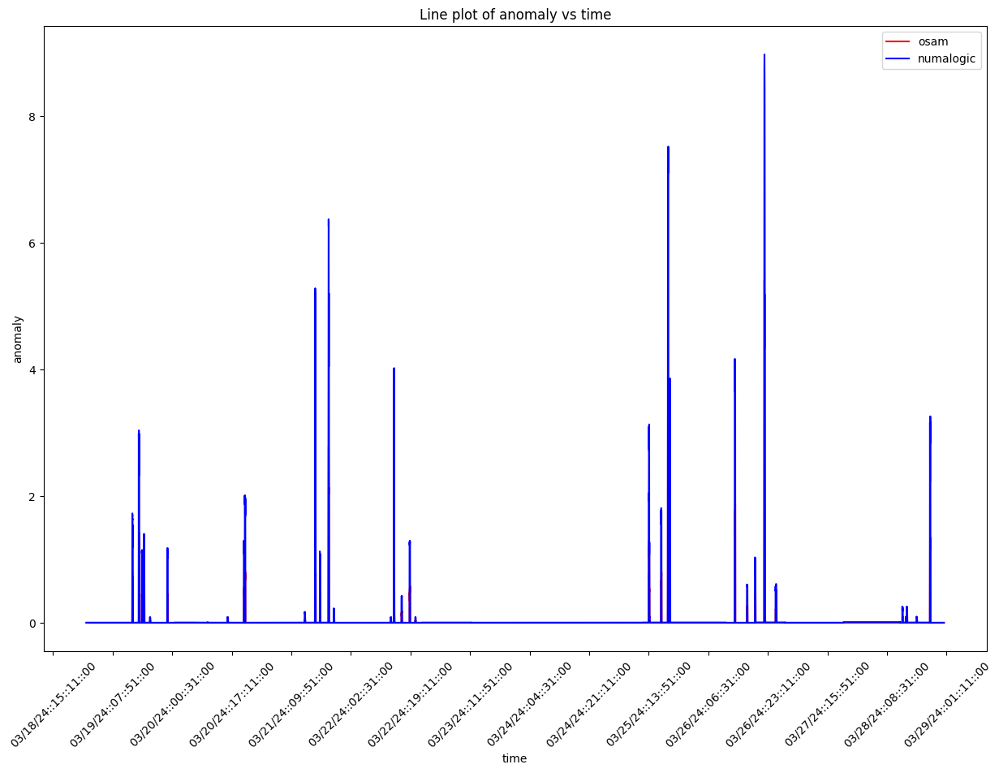

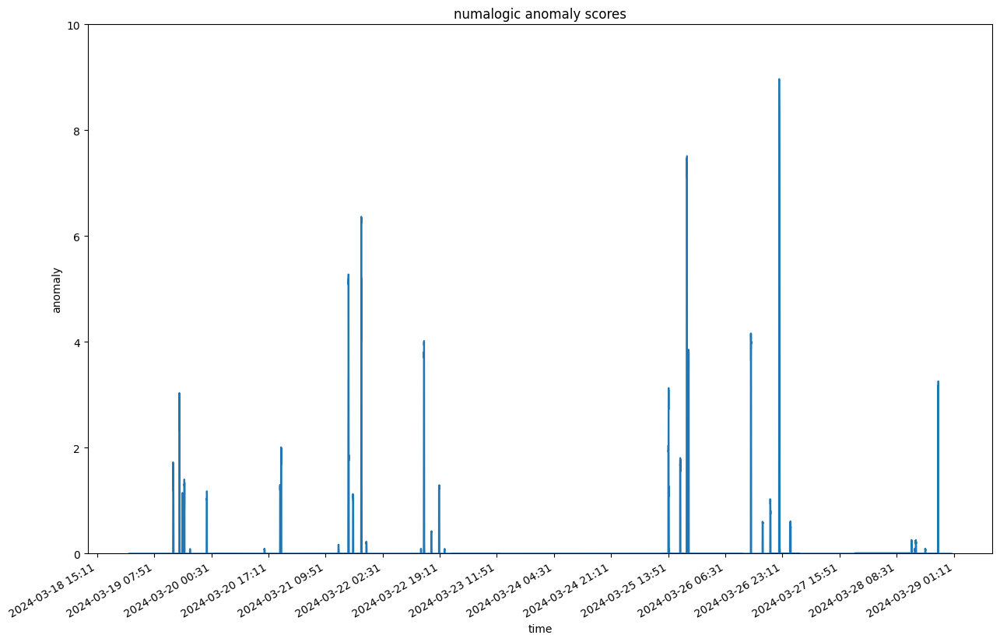

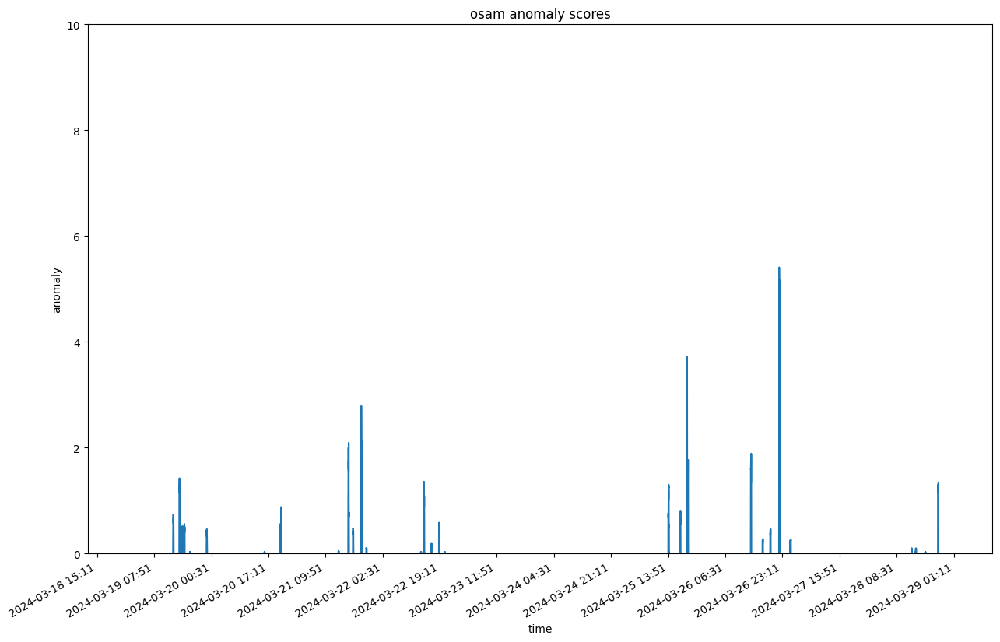

DEBUG:numalogic.connectors.druid._druid:Querying with end_dt: 2024-03-29 03:29:11.461354+00:00, that is with delay of 3 hrs


------------------------------------------------------------
------------------------------------------------------------        ModelId: fci:interactionsFailed:5984175597303660107:qbaa.fai.reconcile-ui.getReconTxnList       ---------------------------------------------


DEBUG:numalogic.connectors.druid._druid:Druid params: {'datasource': 'tech-ip-customer-interaction-metrics', 'granularity': 'minute', 'intervals': ['2024-03-19T03:29:11.461354+00:00/2024-03-29T03:29:11.461354+00:00'], 'aggregations': {'count': {'type': 'doubleSum', 'fieldName': 'count', 'name': 'count'}}, 'post_aggregations': {}, 'filter': <pydruid.utils.filters.Filter object at 0x2cb9785b0>, 'dimensions': <map object at 0x2cba9fac0>, 'context': {'timeout': 10000, 'configIds': ['assetId', 'interactionName'], 'source': 'numalogic'}}, fetch time: 1.4479s
DEBUG:numalogic.udfs.tools:Querying with end_dt: 2024-03-29 00:29:14.913534+00:00, that is with delay of 3 hrs
DEBUG:numalogic.udfs.tools:Querying with end_dt: 2024-03-29 00:29:14.913534+00:00, that is with delay of 3 hrs


--- 4.342220783233643 seconds ---
--- 4.804966688156128 seconds ---


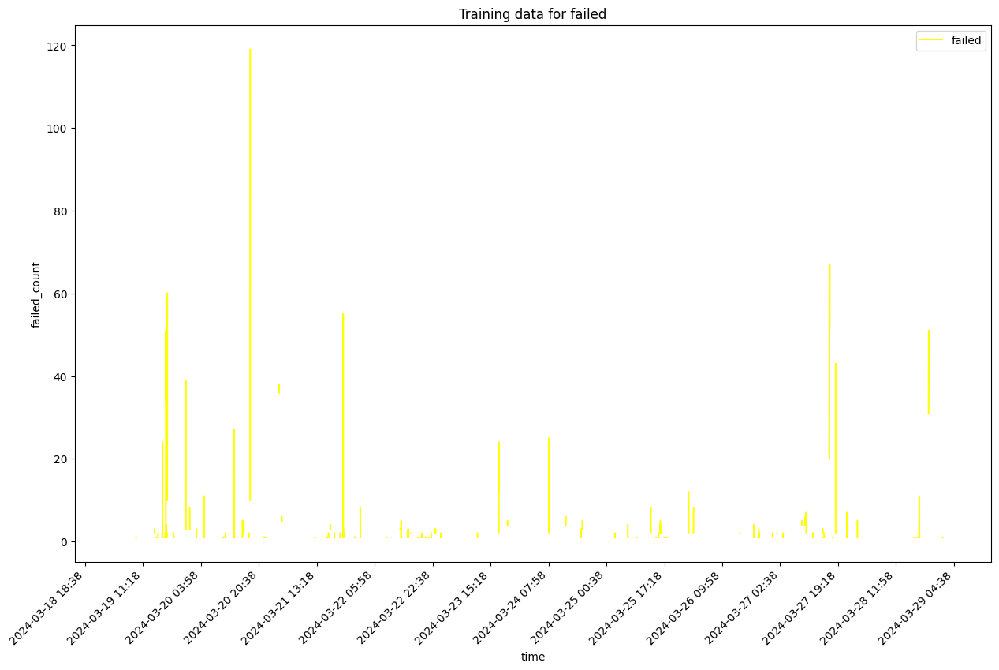

self.df_training shape  14400
Sum of histogram frequencies:  619.0
Number of non-NaN records in column x:  619


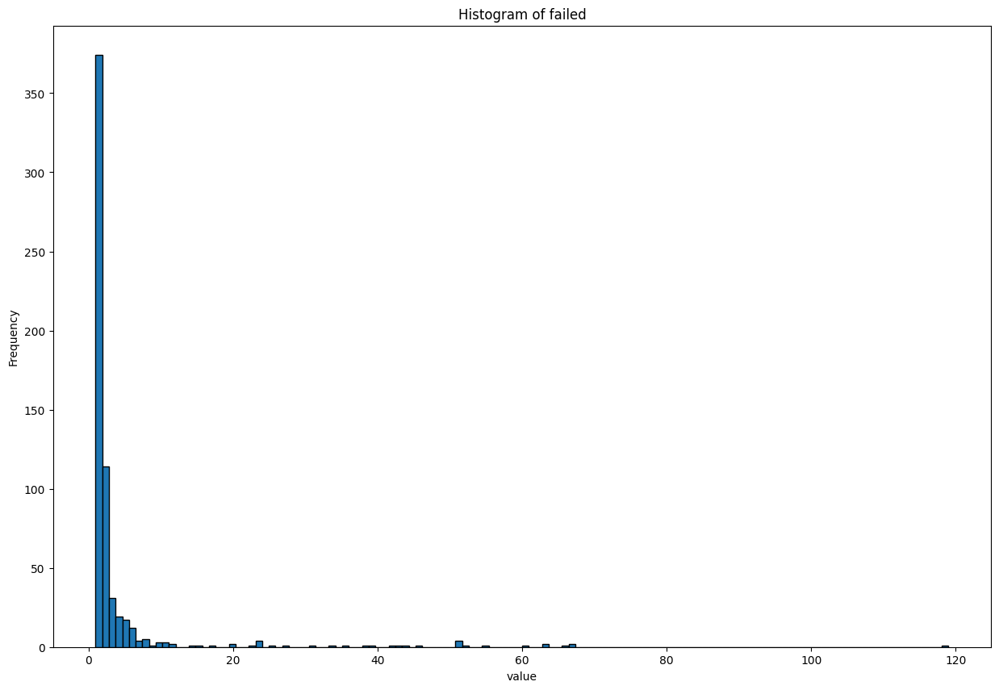

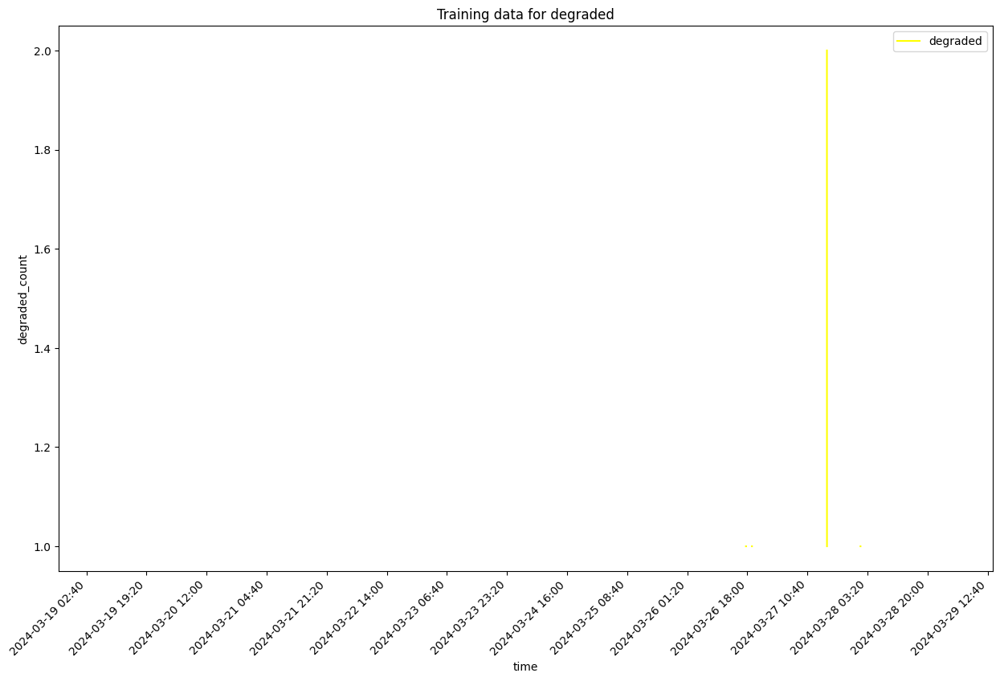

self.df_training shape  14400
Sum of histogram frequencies:  132.0
Number of non-NaN records in column x:  132


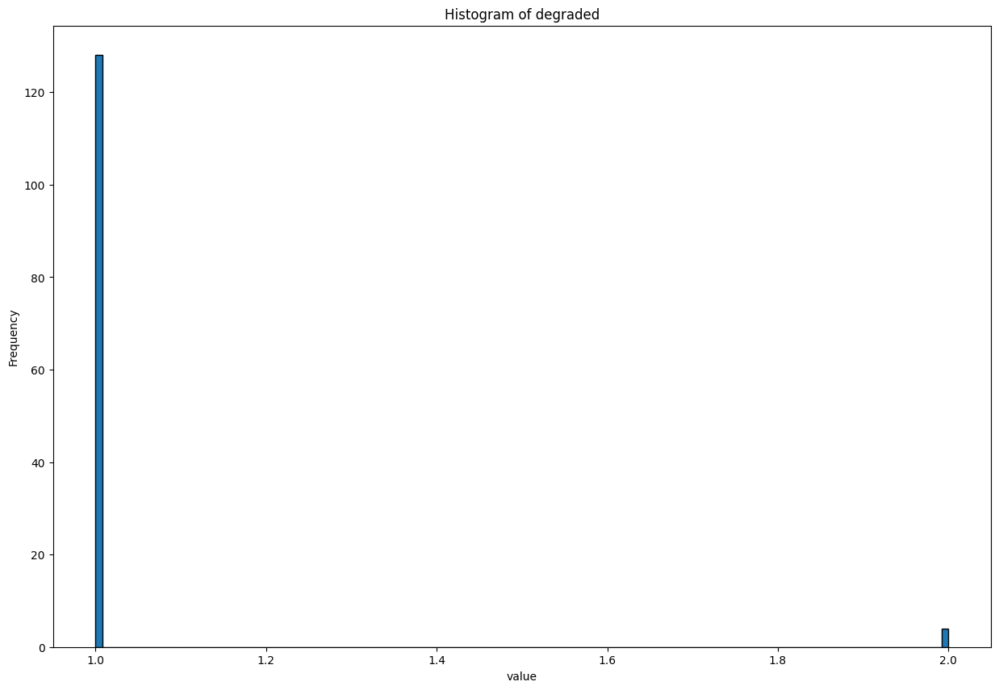

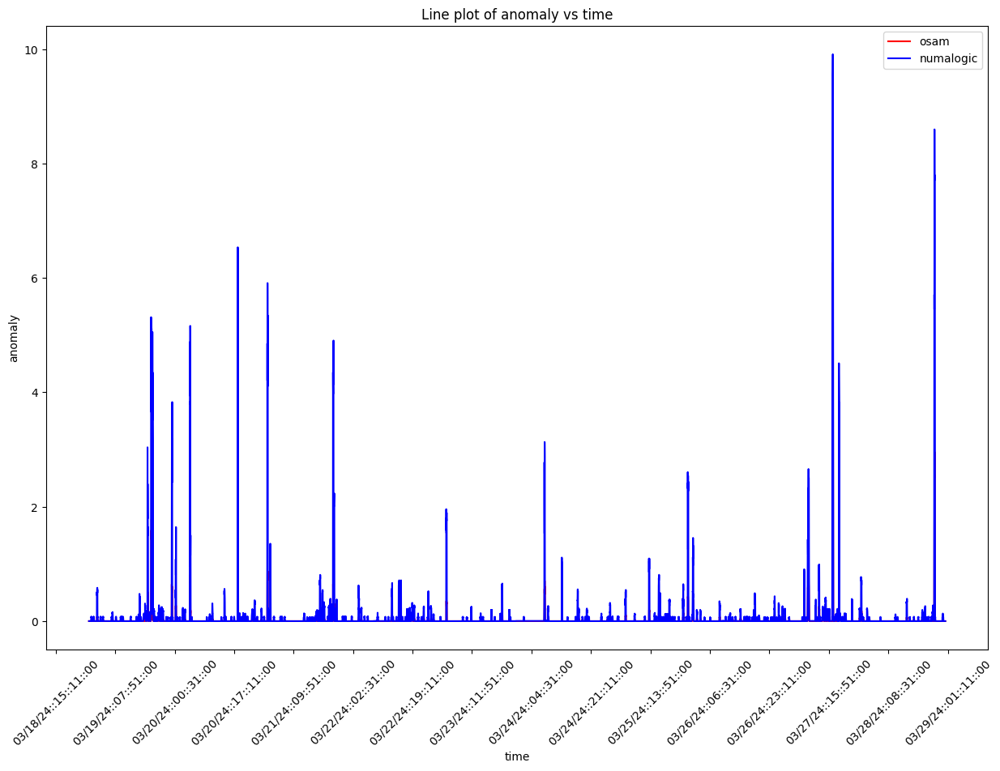

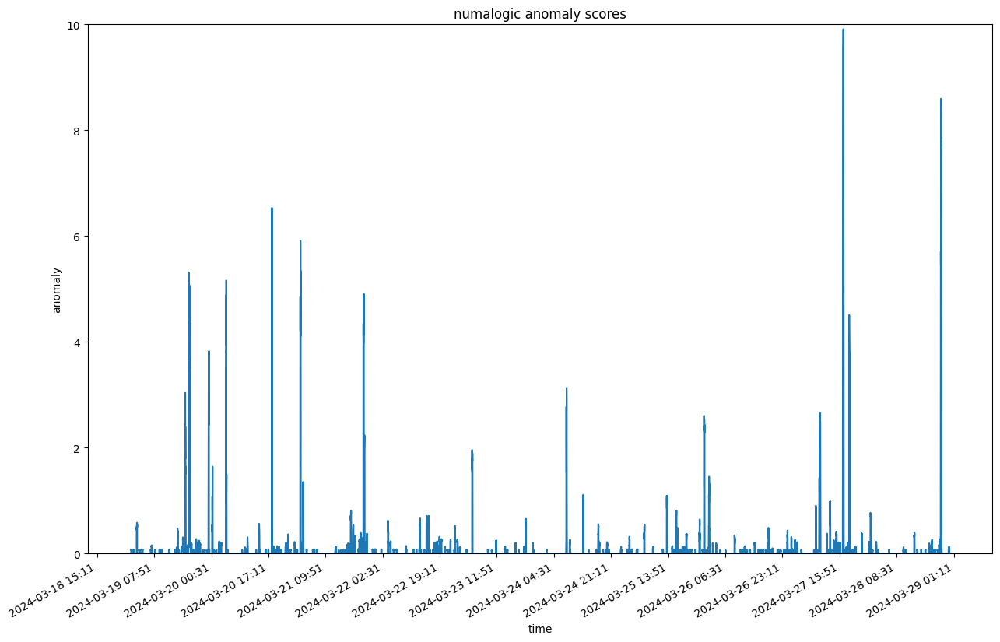

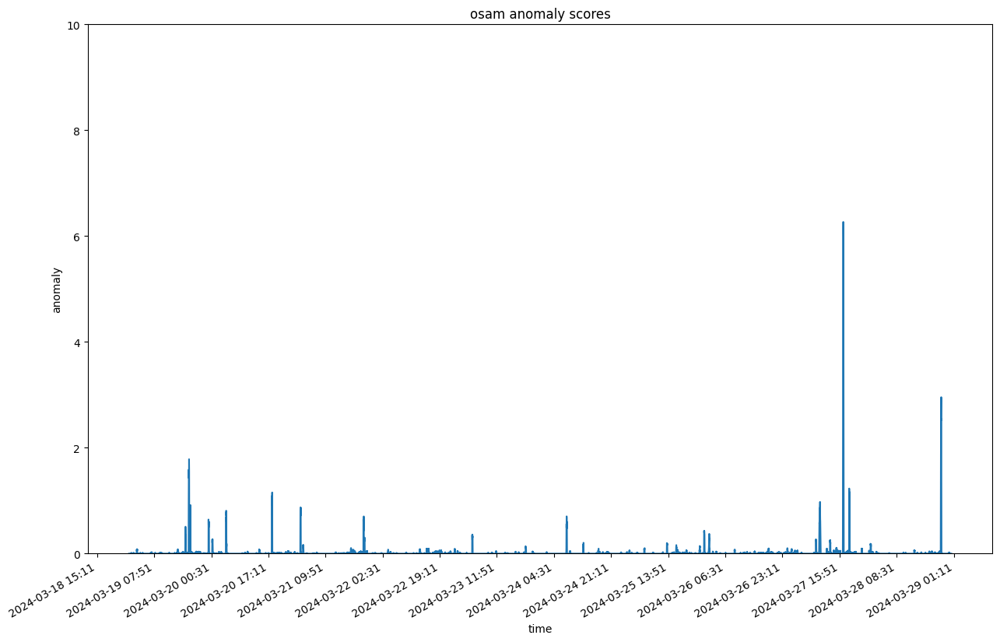

DEBUG:numalogic.connectors.druid._druid:Querying with end_dt: 2024-03-29 03:29:28.682012+00:00, that is with delay of 3 hrs


------------------------------------------------------------
------------------------------------------------------------        ModelId: fciPluginInteractions:metrics:3101871835697829167:transferToVoicemail       ---------------------------------------------


DEBUG:numalogic.connectors.druid._druid:Druid params: {'datasource': 'tech-ip-customer-interaction-metrics', 'granularity': 'minute', 'intervals': ['2024-03-19T03:29:28.682012+00:00/2024-03-29T03:29:28.682012+00:00'], 'aggregations': {'count': {'type': 'doubleSum', 'fieldName': 'count', 'name': 'count'}}, 'post_aggregations': {}, 'filter': <pydruid.utils.filters.Filter object at 0x2cb3477c0>, 'dimensions': <map object at 0x2cb90a590>, 'context': {'timeout': 10000, 'configIds': ['pluginAssetId', 'interactionName'], 'source': 'numalogic'}}, fetch time: 0.8962s
DEBUG:numalogic.udfs.tools:Querying with end_dt: 2024-03-29 00:29:31.581276+00:00, that is with delay of 3 hrs
DEBUG:numalogic.udfs.tools:Querying with end_dt: 2024-03-29 00:29:31.581276+00:00, that is with delay of 3 hrs


--- 1.9700901508331299 seconds ---
--- 3.5966620445251465 seconds ---


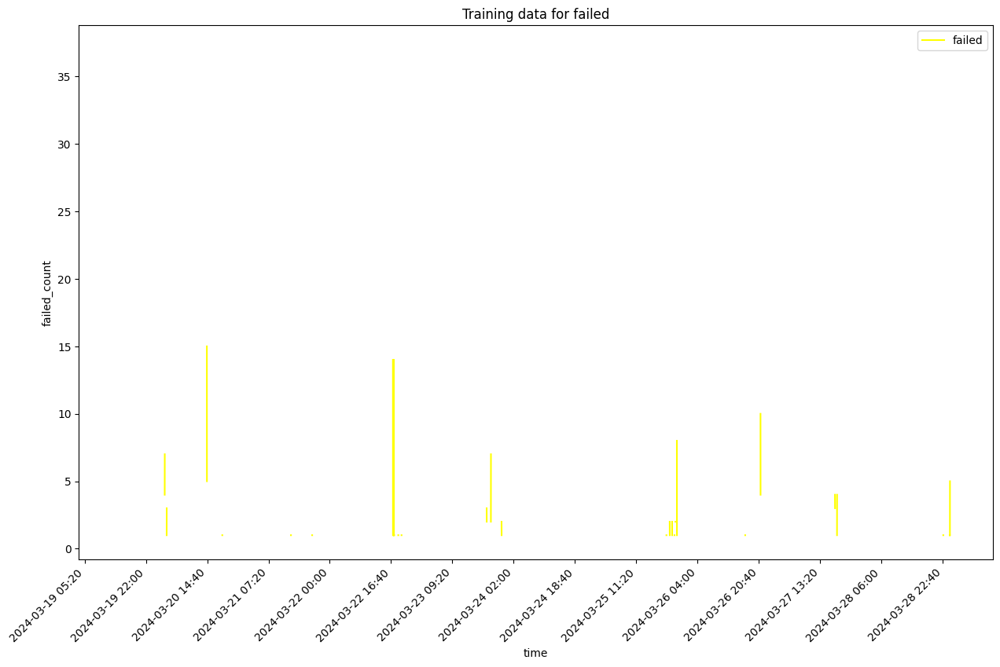

self.df_training shape  8741
Sum of histogram frequencies:  319.0
Number of non-NaN records in column x:  319


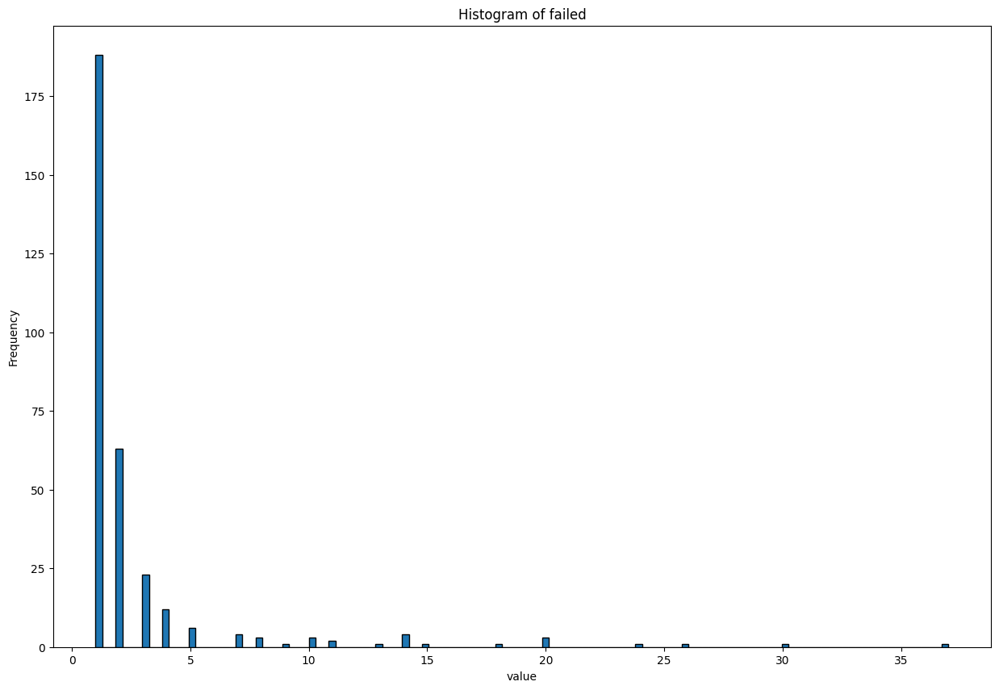

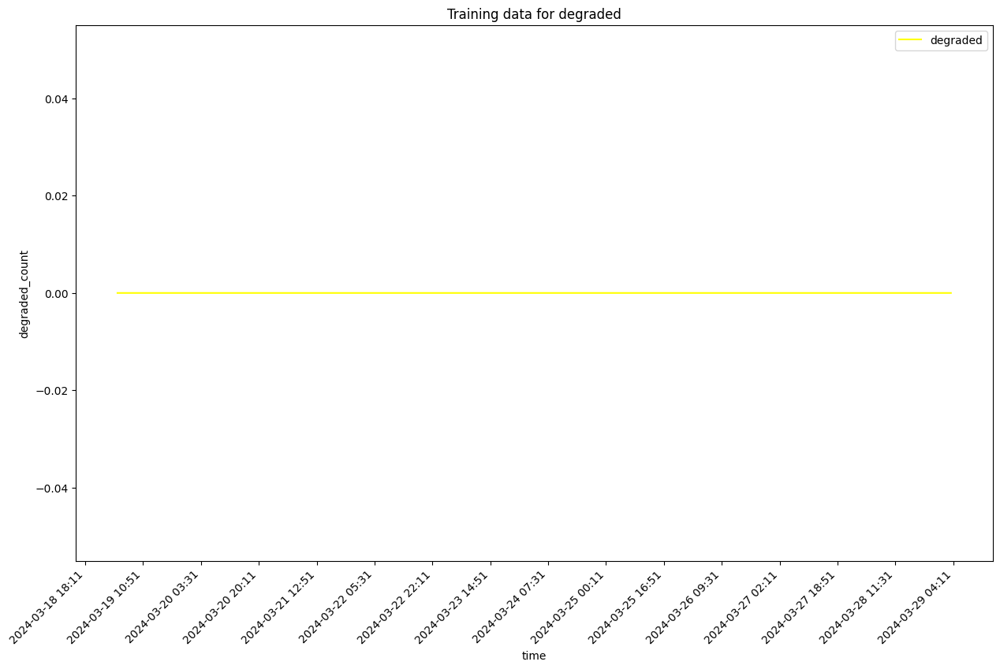

self.df_training shape  8741
Sum of histogram frequencies:  8741.0
Number of non-NaN records in column x:  8741


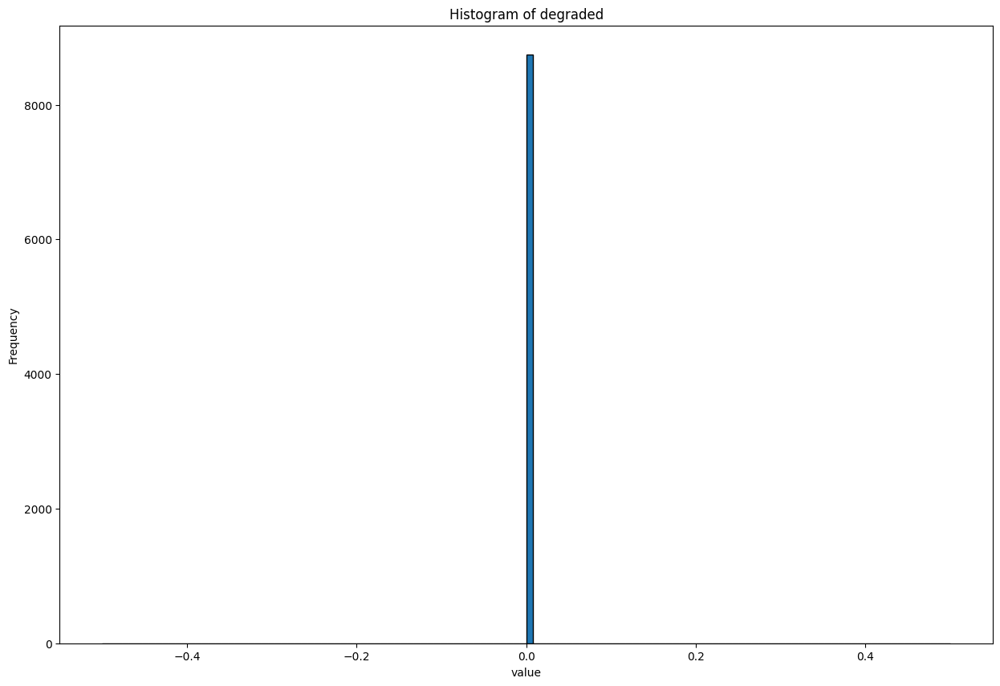

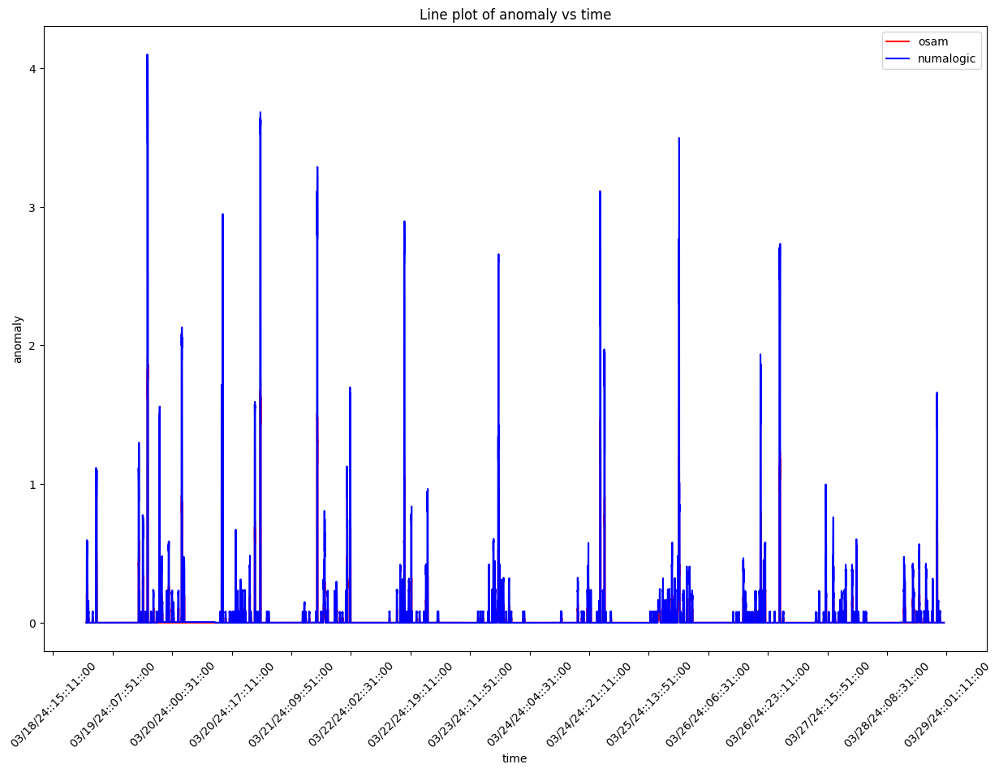

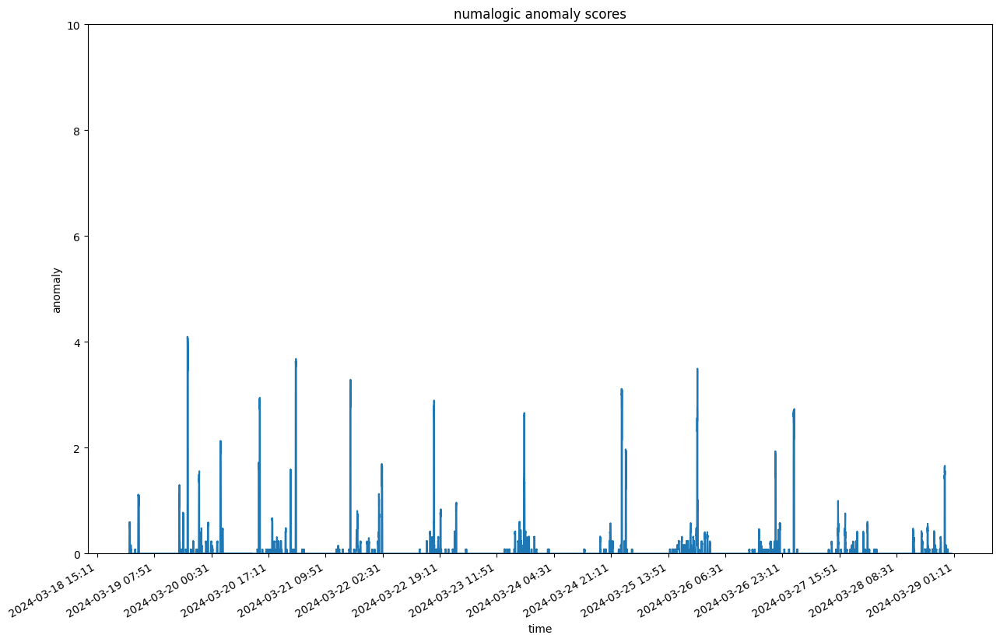

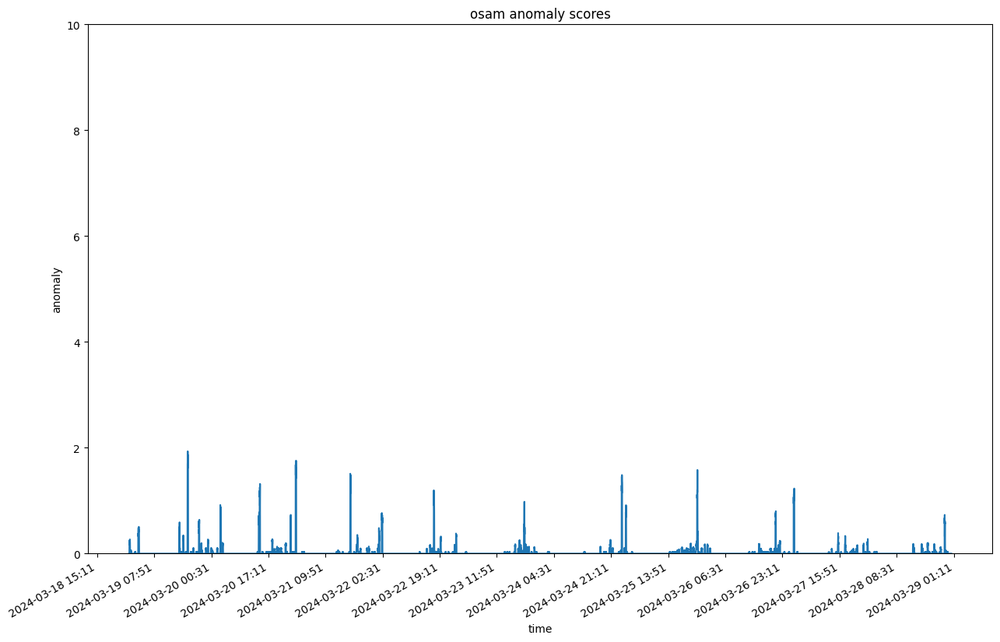

DEBUG:numalogic.connectors.druid._druid:Querying with end_dt: 2024-03-29 03:29:41.614912+00:00, that is with delay of 3 hrs


------------------------------------------------------------
------------------------------------------------------------        ModelId: fciPluginAppInteractions:metrics:3750390182735137211:5984175597303660107:DRILLDOWN_REPORT_FETCH       ---------------------------------------------


DEBUG:numalogic.connectors.druid._druid:Druid params: {'datasource': 'tech-ip-customer-interaction-metrics', 'granularity': 'minute', 'intervals': ['2024-03-19T03:29:41.614912+00:00/2024-03-29T03:29:41.614912+00:00'], 'aggregations': {'count': {'type': 'doubleSum', 'fieldName': 'count', 'name': 'count'}}, 'post_aggregations': {}, 'filter': <pydruid.utils.filters.Filter object at 0x2cb6c7d60>, 'dimensions': <map object at 0x2cb6c4df0>, 'context': {'timeout': 10000, 'configIds': ['pluginAssetId', 'assetId', 'interactionName'], 'source': 'numalogic'}}, fetch time: 0.8991s
DEBUG:numalogic.udfs.tools:Querying with end_dt: 2024-03-29 00:29:44.514791+00:00, that is with delay of 3 hrs
DEBUG:numalogic.udfs.tools:Querying with end_dt: 2024-03-29 00:29:44.514791+00:00, that is with delay of 3 hrs


--- 3.807584047317505 seconds ---
--- 2.1307790279388428 seconds ---


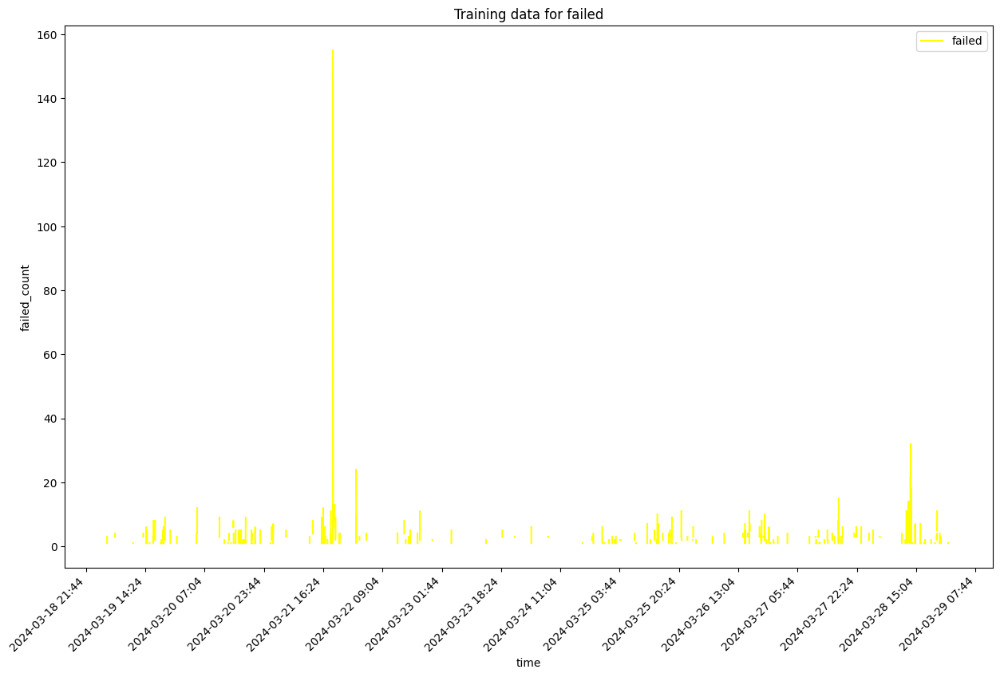

self.df_training shape  14400
Sum of histogram frequencies:  882.0
Number of non-NaN records in column x:  882


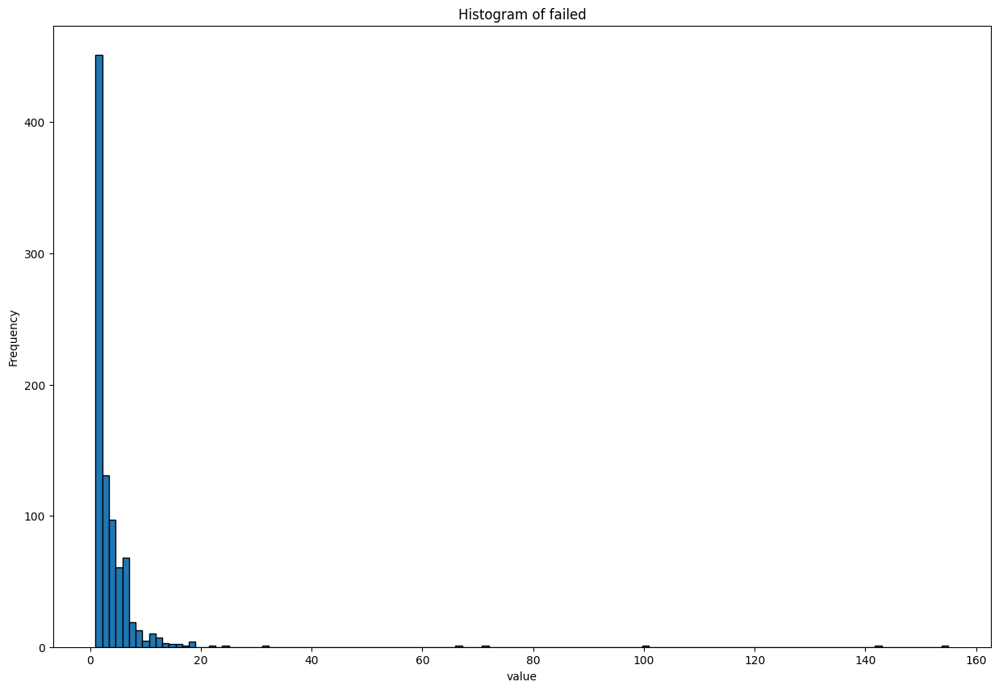

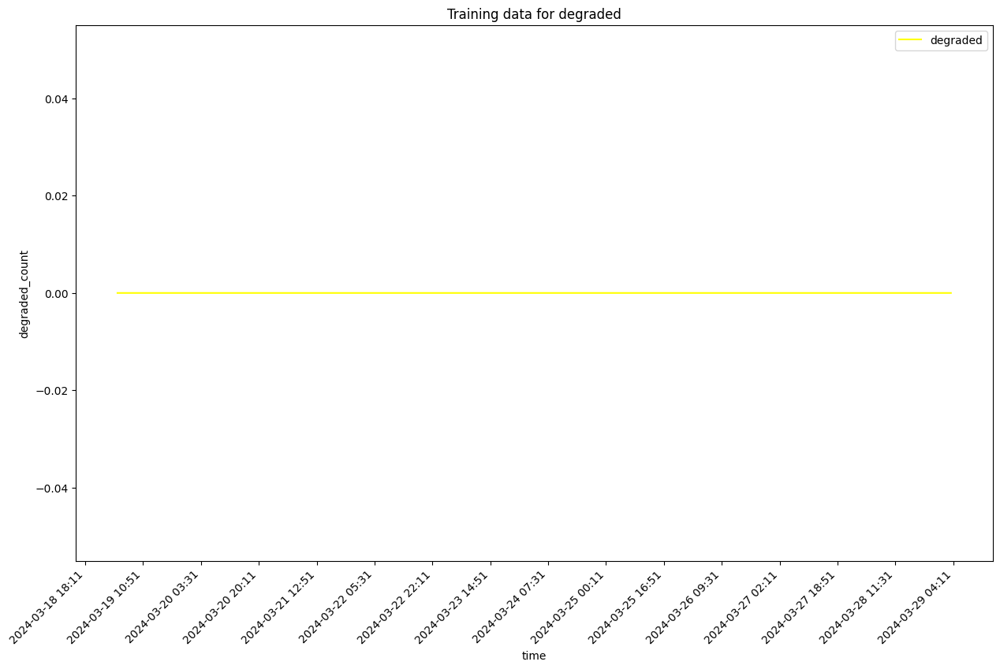

self.df_training shape  14400
Sum of histogram frequencies:  14400.0
Number of non-NaN records in column x:  14400


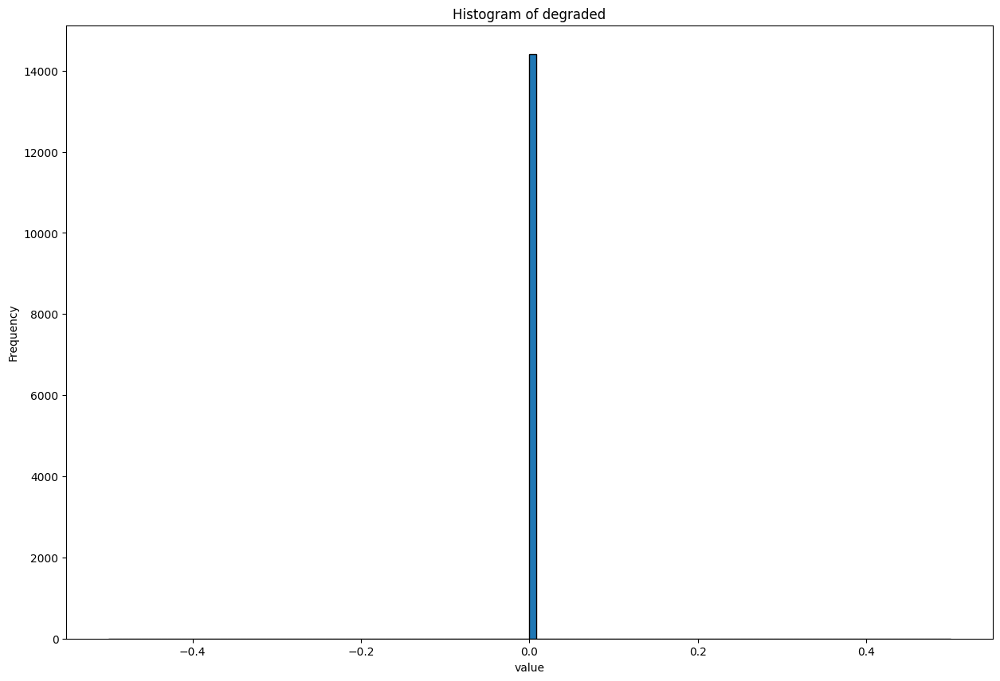

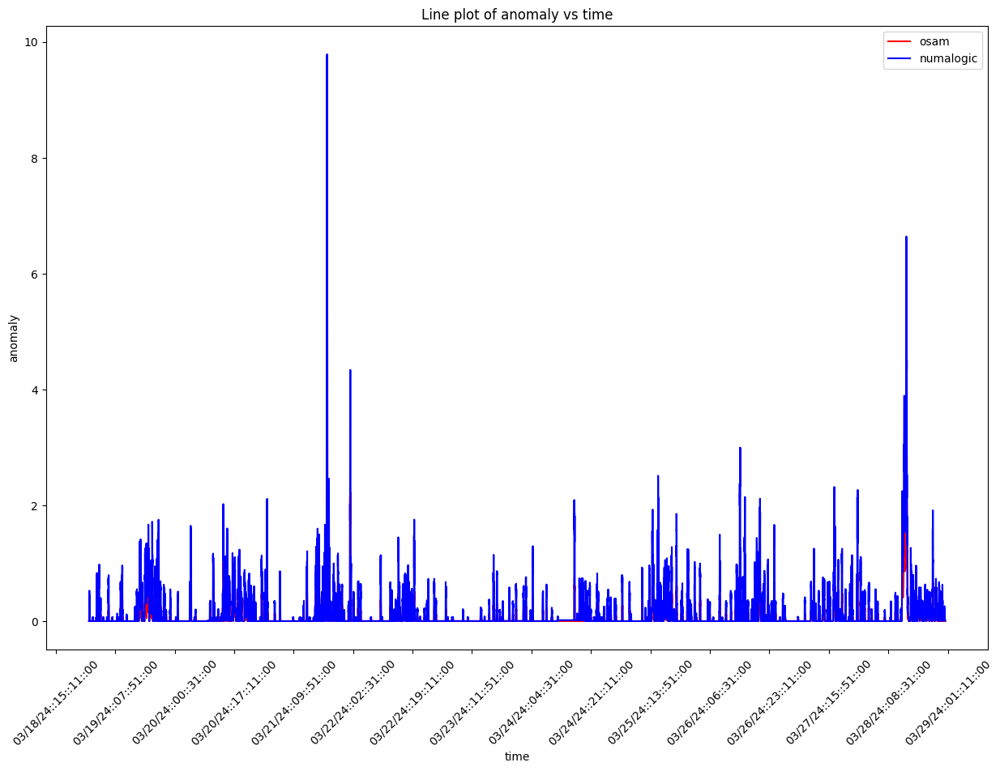

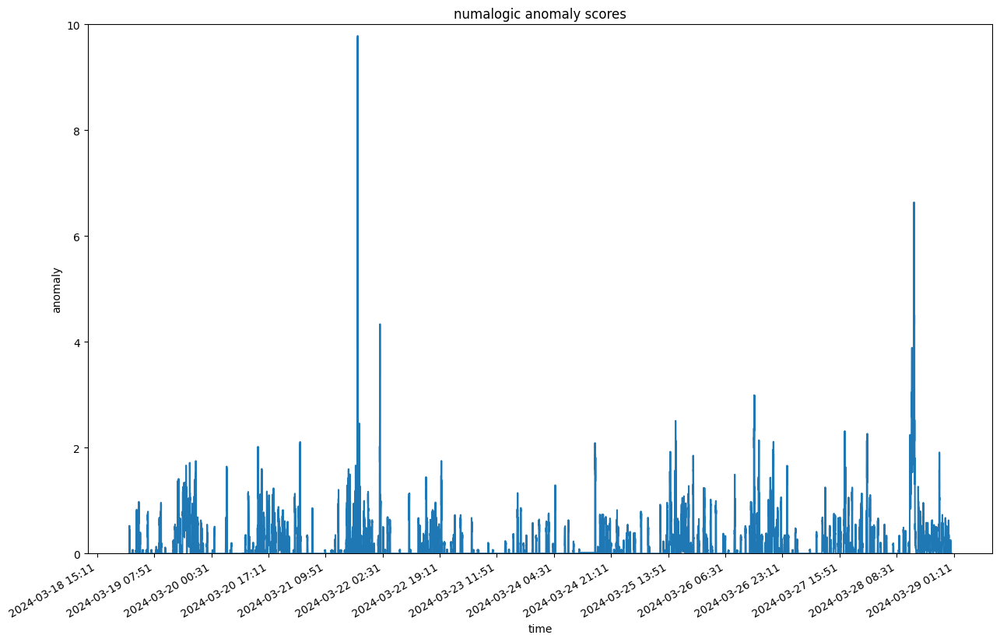

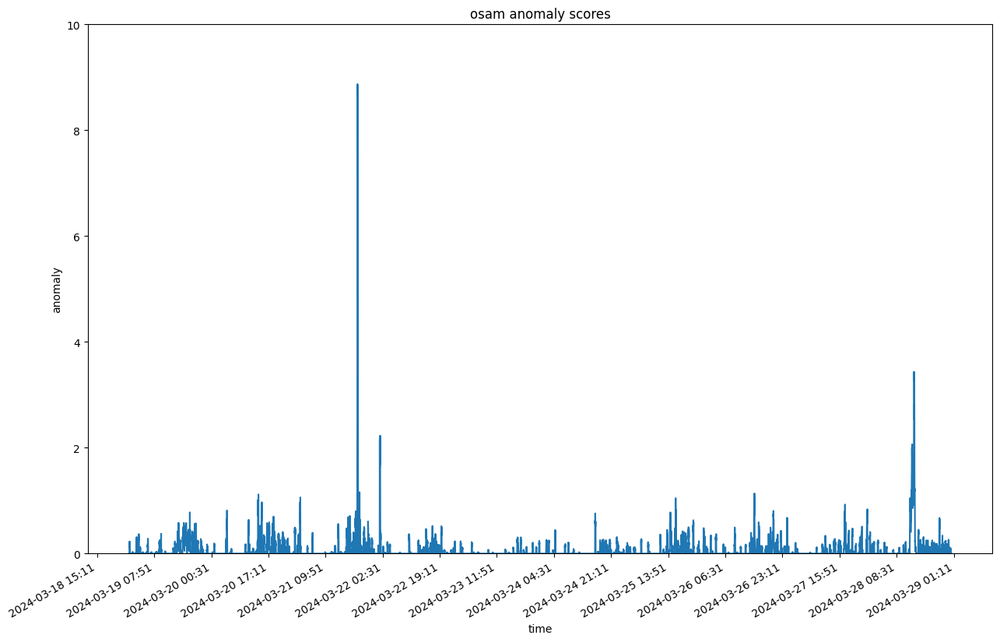

DEBUG:numalogic.connectors.druid._druid:Querying with end_dt: 2024-03-29 03:29:54.841192+00:00, that is with delay of 3 hrs


------------------------------------------------------------
------------------------------------------------------------        ModelId: fciPluginAppInteractions:metrics:2453353489468585843:5984175597303660107:paymentMethodMonolithOnSearch       ---------------------------------------------


DEBUG:numalogic.connectors.druid._druid:Druid params: {'datasource': 'tech-ip-customer-interaction-metrics', 'granularity': 'minute', 'intervals': ['2024-03-19T03:29:54.841192+00:00/2024-03-29T03:29:54.841192+00:00'], 'aggregations': {'count': {'type': 'doubleSum', 'fieldName': 'count', 'name': 'count'}}, 'post_aggregations': {}, 'filter': <pydruid.utils.filters.Filter object at 0x2cb9f9450>, 'dimensions': <map object at 0x2cb9d2830>, 'context': {'timeout': 10000, 'configIds': ['pluginAssetId', 'assetId', 'interactionName'], 'source': 'numalogic'}}, fetch time: 1.0362s
DEBUG:numalogic.udfs.tools:Querying with end_dt: 2024-03-29 00:29:57.878136+00:00, that is with delay of 3 hrs
DEBUG:numalogic.udfs.tools:Querying with end_dt: 2024-03-29 00:29:57.878136+00:00, that is with delay of 3 hrs


--- 3.918562173843384 seconds ---
--- 3.1933000087738037 seconds ---


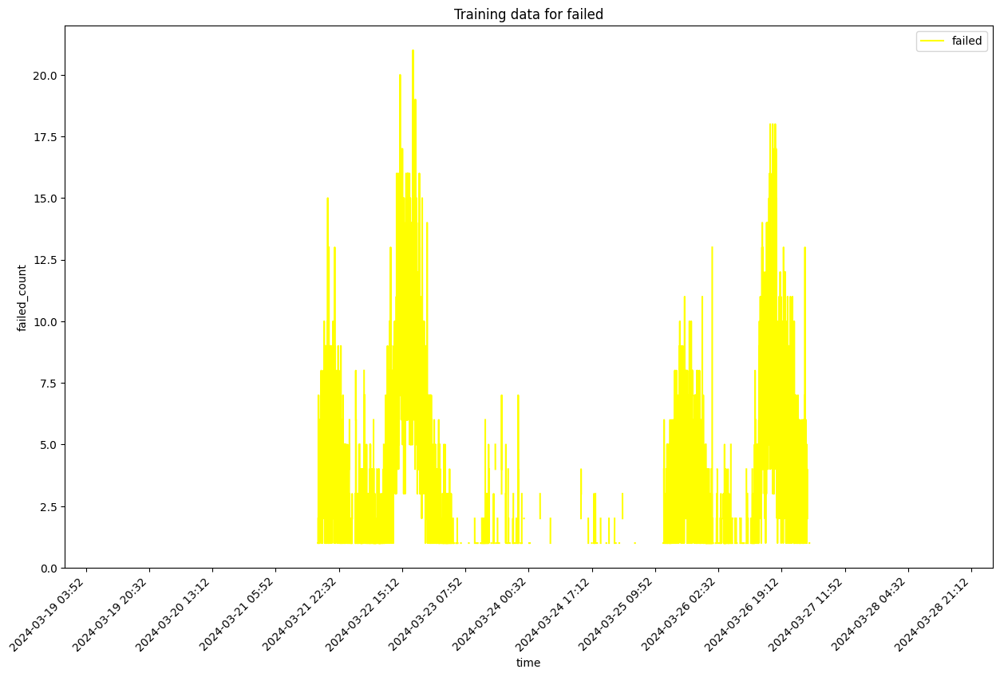

self.df_training shape  10185
Sum of histogram frequencies:  3950.0
Number of non-NaN records in column x:  3950


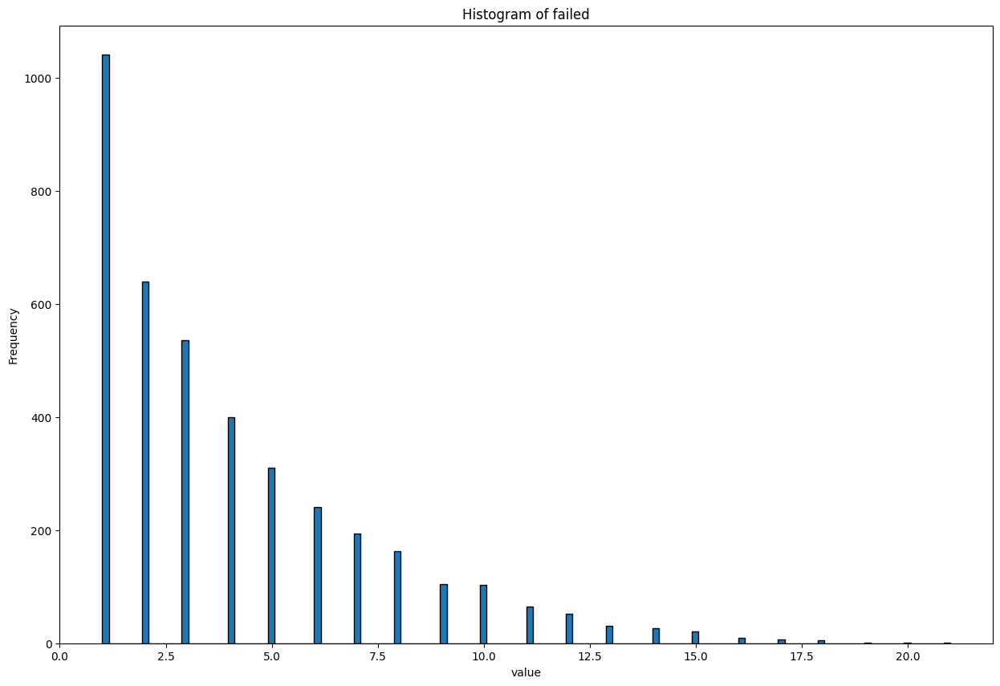

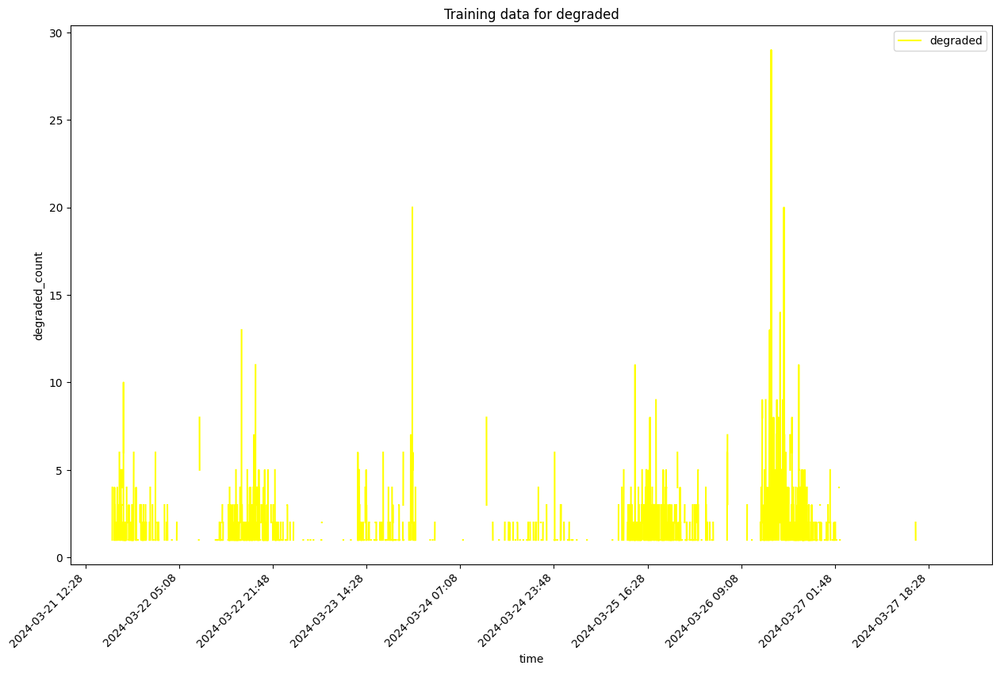

self.df_training shape  10185
Sum of histogram frequencies:  2212.0
Number of non-NaN records in column x:  2212


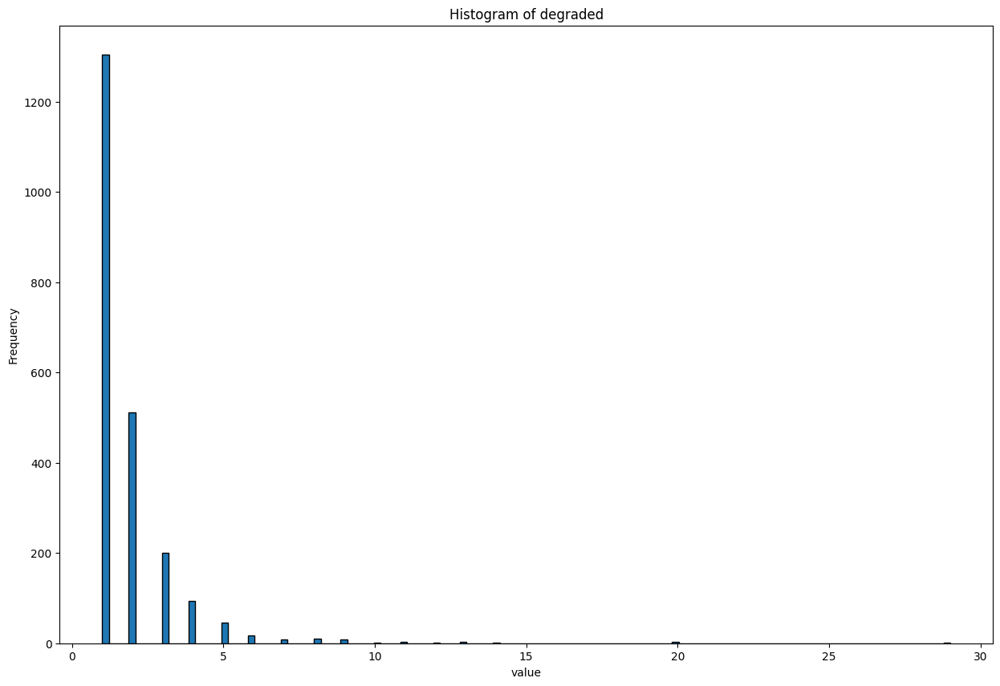

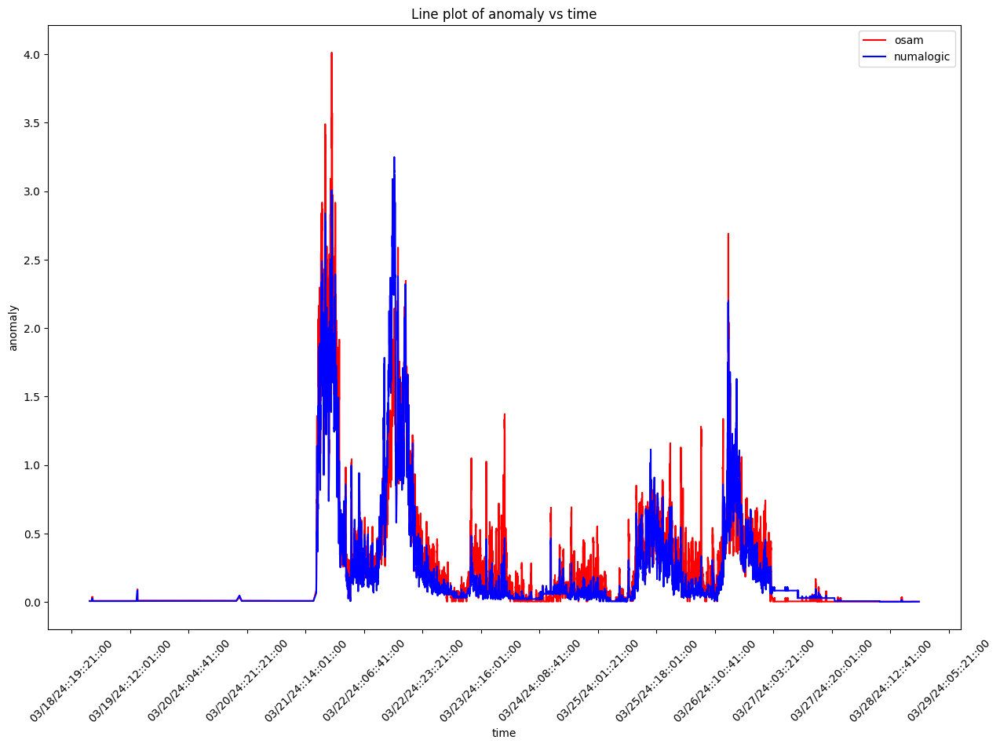

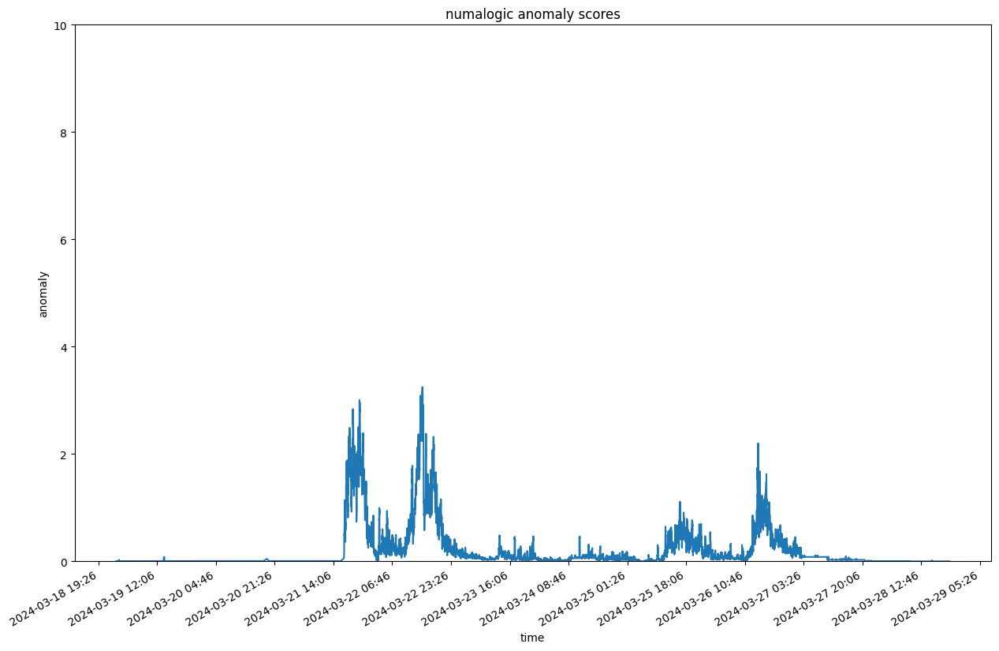

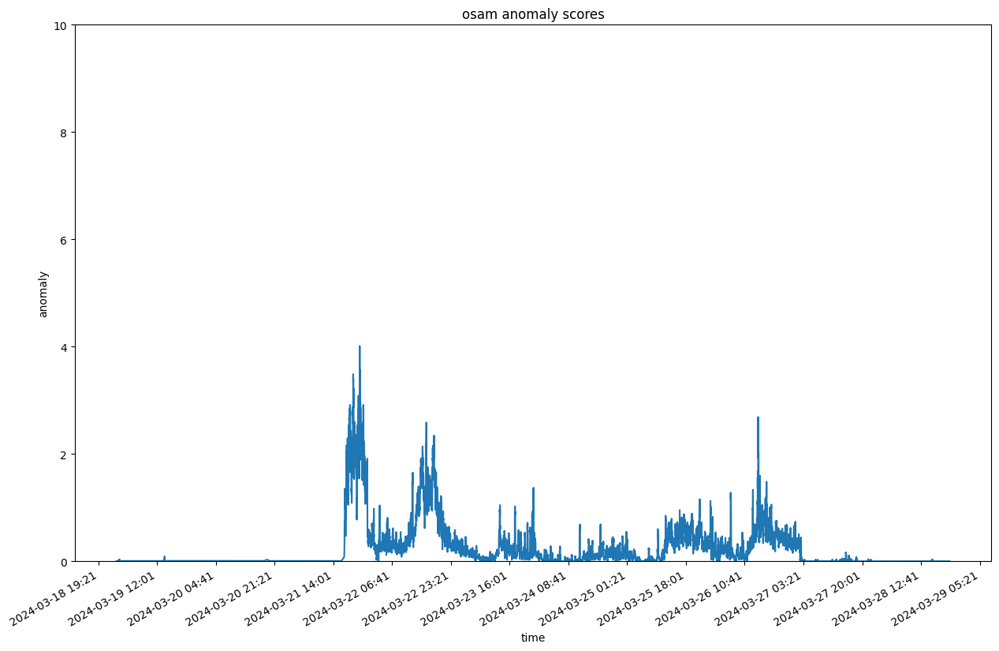

DEBUG:numalogic.connectors.druid._druid:Querying with end_dt: 2024-03-29 03:30:09.649030+00:00, that is with delay of 3 hrs


------------------------------------------------------------
------------------------------------------------------------        ModelId: fciPluginAsset:metricsFailed:8290018606576915479       ---------------------------------------------


DEBUG:numalogic.connectors.druid._druid:Druid params: {'datasource': 'tech-ip-customer-interaction-metrics', 'granularity': 'minute', 'intervals': ['2024-03-19T03:30:09.649030+00:00/2024-03-29T03:30:09.649030+00:00'], 'aggregations': {'count': {'type': 'doubleSum', 'fieldName': 'count', 'name': 'count'}}, 'post_aggregations': {}, 'filter': <pydruid.utils.filters.Filter object at 0x2cb83dba0>, 'dimensions': <map object at 0x2cb8d3910>, 'context': {'timeout': 10000, 'configIds': ['pluginAssetId'], 'source': 'numalogic'}}, fetch time: 1.3002s
DEBUG:numalogic.udfs.tools:Querying with end_dt: 2024-03-29 00:30:12.953484+00:00, that is with delay of 3 hrs
DEBUG:numalogic.udfs.tools:Querying with end_dt: 2024-03-29 00:30:12.953484+00:00, that is with delay of 3 hrs


--- 4.5618507862091064 seconds ---
--- 4.550598859786987 seconds ---


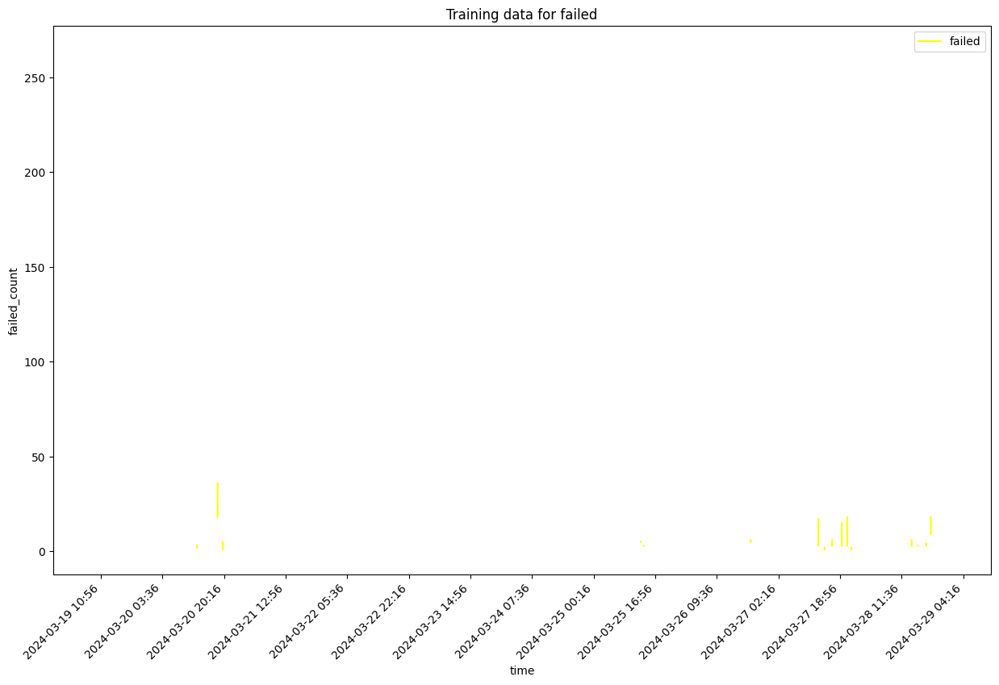

self.df_training shape  13910
Sum of histogram frequencies:  228.0
Number of non-NaN records in column x:  228


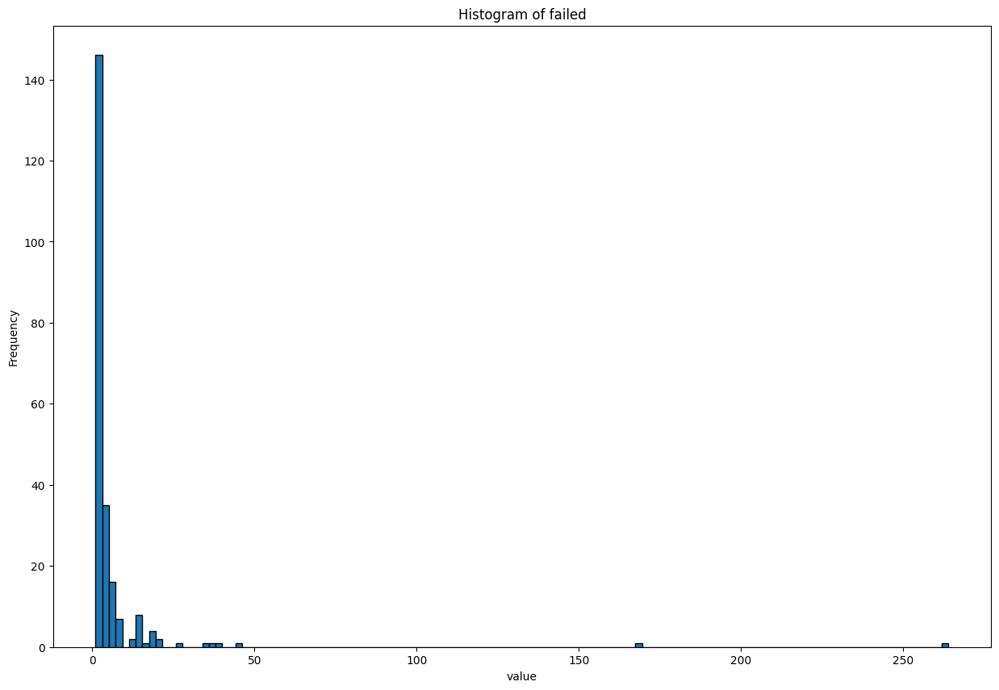

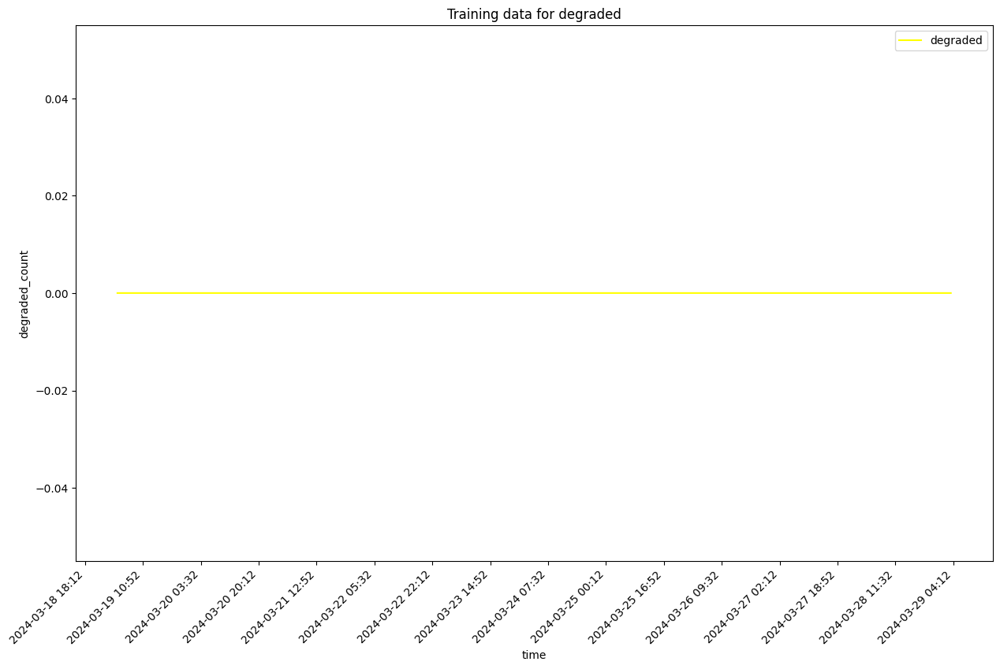

self.df_training shape  13910
Sum of histogram frequencies:  13910.0
Number of non-NaN records in column x:  13910


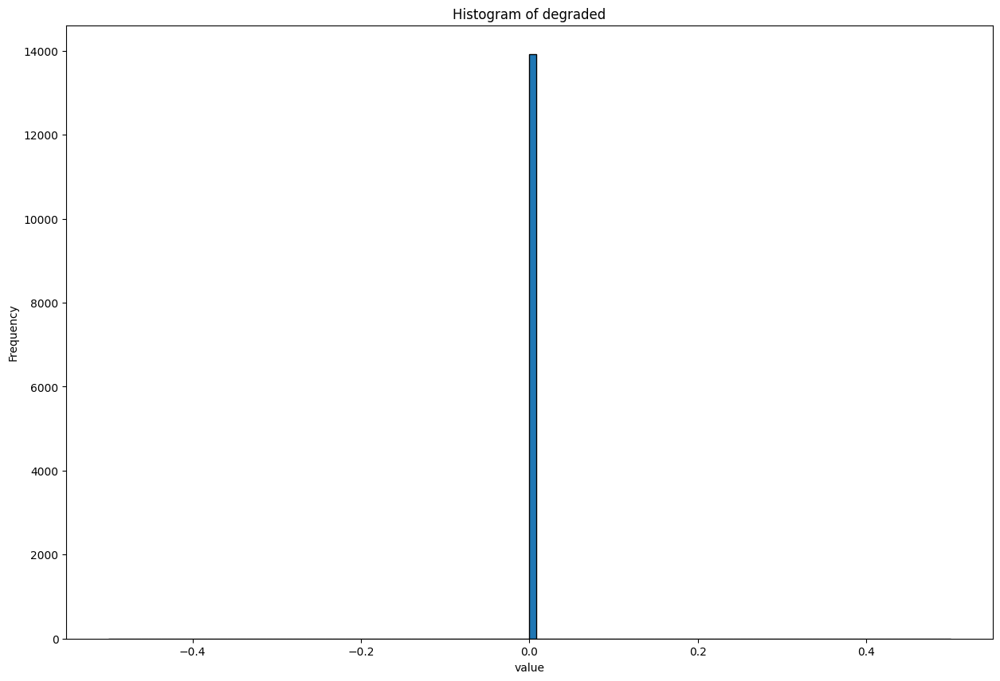

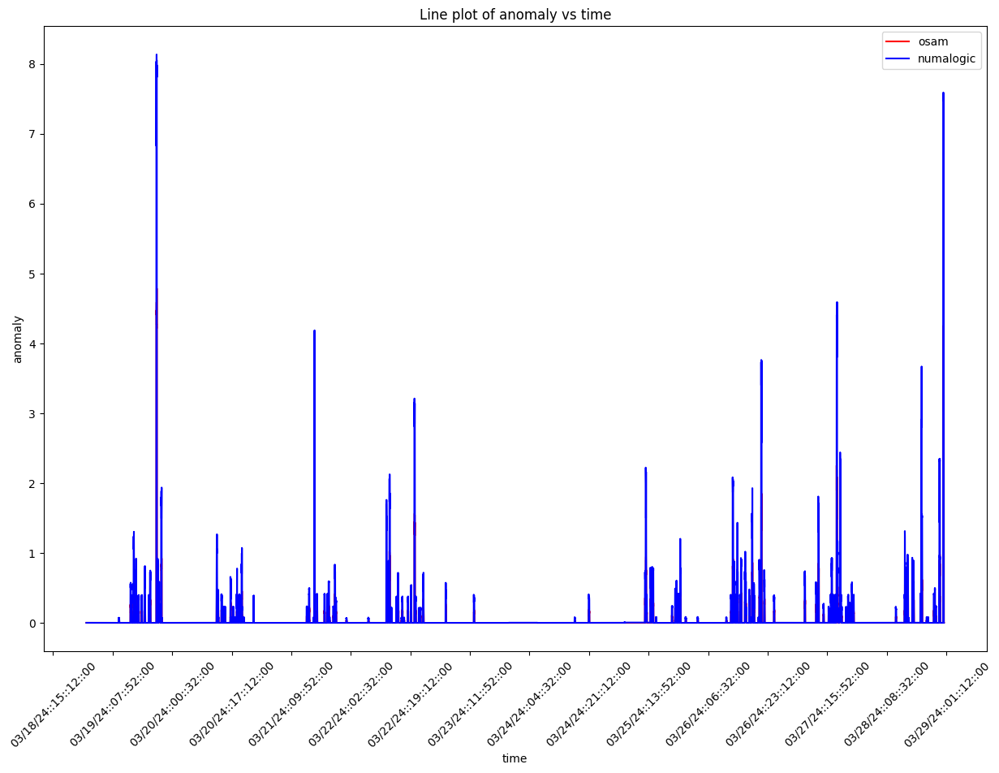

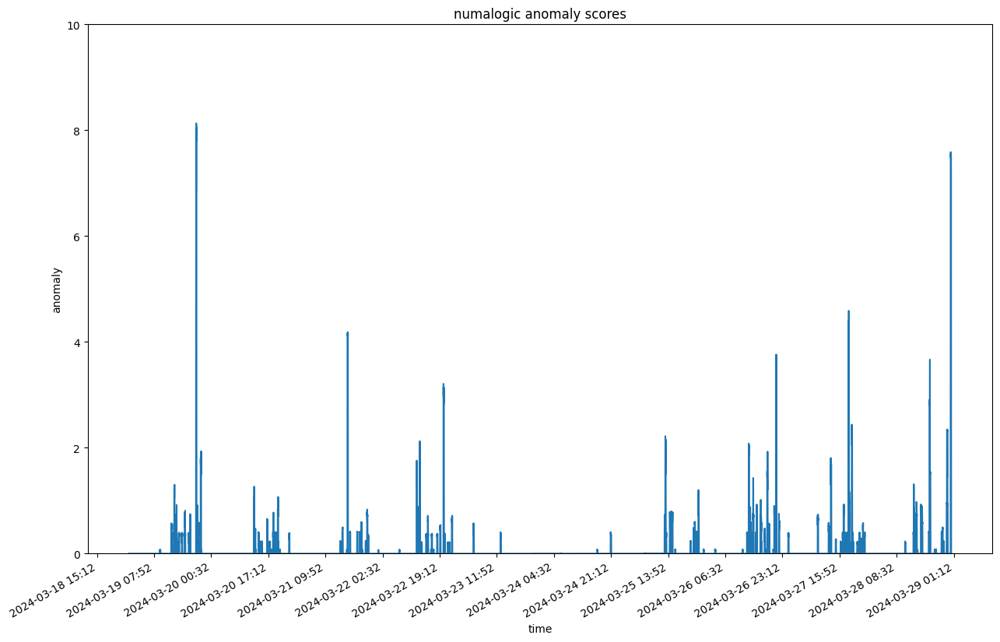

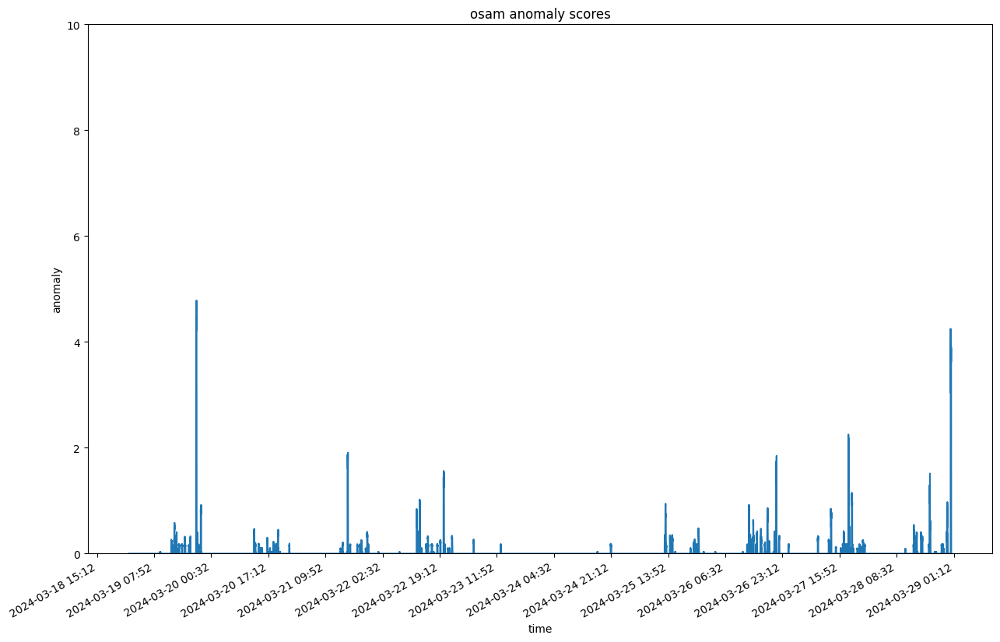

DEBUG:numalogic.connectors.druid._druid:Querying with end_dt: 2024-03-29 03:30:26.351444+00:00, that is with delay of 3 hrs


------------------------------------------------------------
------------------------------------------------------------        ModelId: fciPluginInteractions:metrics:1012201608902407753:lookup-address-ss       ---------------------------------------------


DEBUG:numalogic.connectors.druid._druid:Druid params: {'datasource': 'tech-ip-customer-interaction-metrics', 'granularity': 'minute', 'intervals': ['2024-03-19T03:30:26.351444+00:00/2024-03-29T03:30:26.351444+00:00'], 'aggregations': {'count': {'type': 'doubleSum', 'fieldName': 'count', 'name': 'count'}}, 'post_aggregations': {}, 'filter': <pydruid.utils.filters.Filter object at 0x2cb024940>, 'dimensions': <map object at 0x2cb026b60>, 'context': {'timeout': 10000, 'configIds': ['pluginAssetId', 'interactionName'], 'source': 'numalogic'}}, fetch time: 1.6286s
DEBUG:numalogic.udfs.tools:Querying with end_dt: 2024-03-29 00:30:29.980828+00:00, that is with delay of 3 hrs
DEBUG:numalogic.udfs.tools:Querying with end_dt: 2024-03-29 00:30:29.980828+00:00, that is with delay of 3 hrs


--- 4.1728410720825195 seconds ---
--- 2.9745259284973145 seconds ---


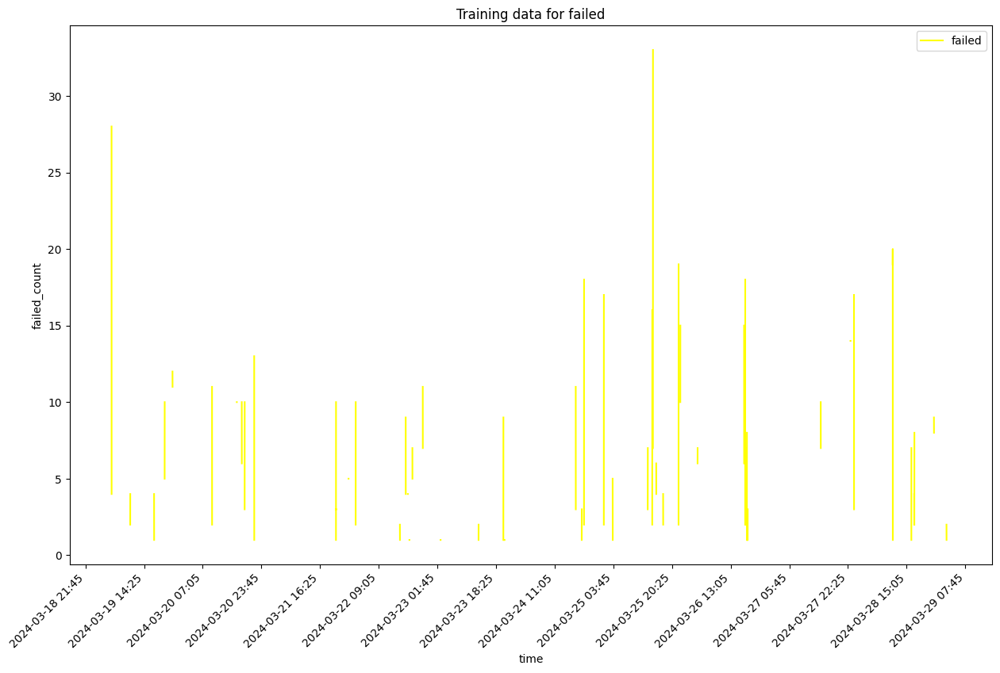

self.df_training shape  12774
Sum of histogram frequencies:  347.0
Number of non-NaN records in column x:  347


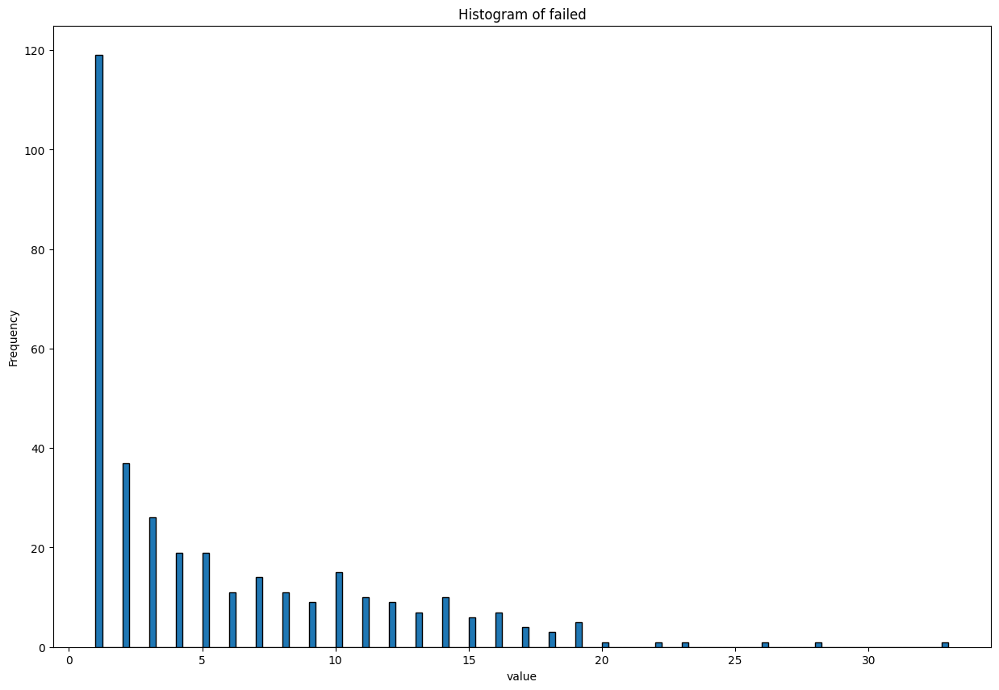

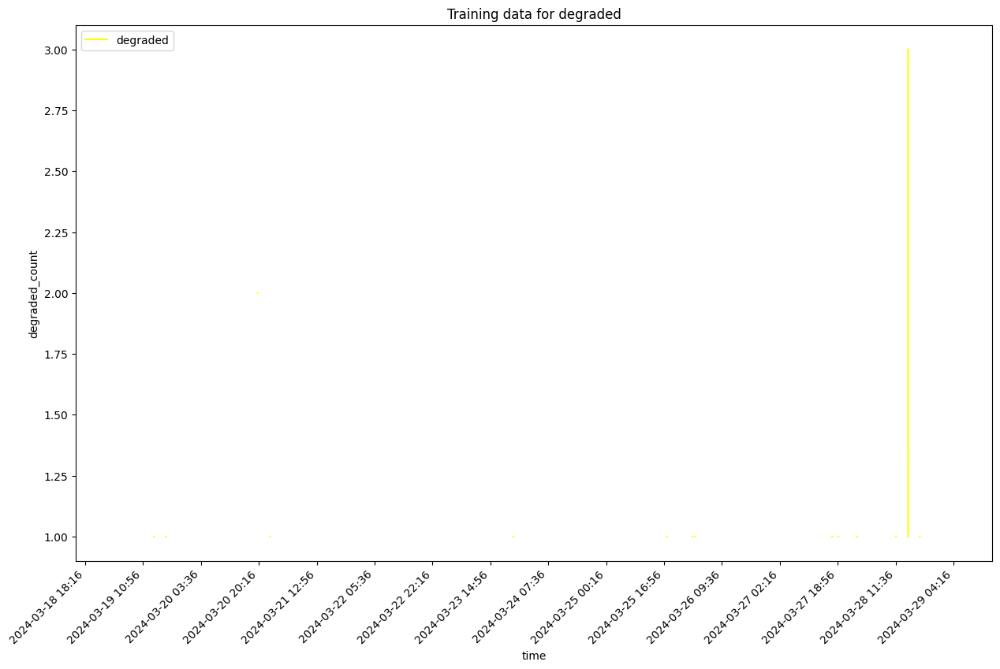

self.df_training shape  12774
Sum of histogram frequencies:  330.0
Number of non-NaN records in column x:  330


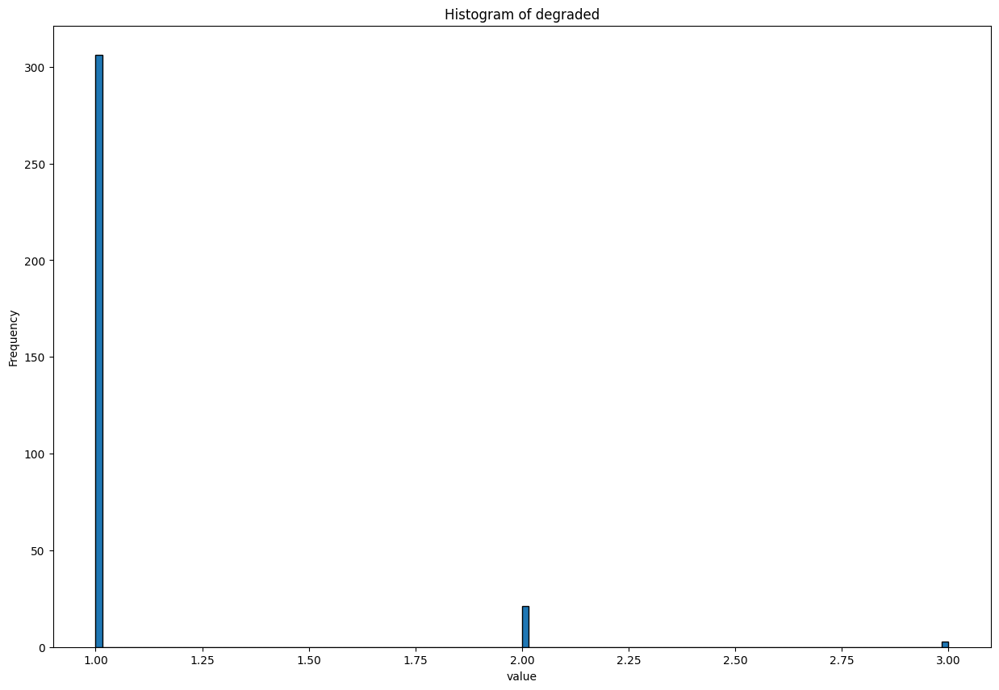

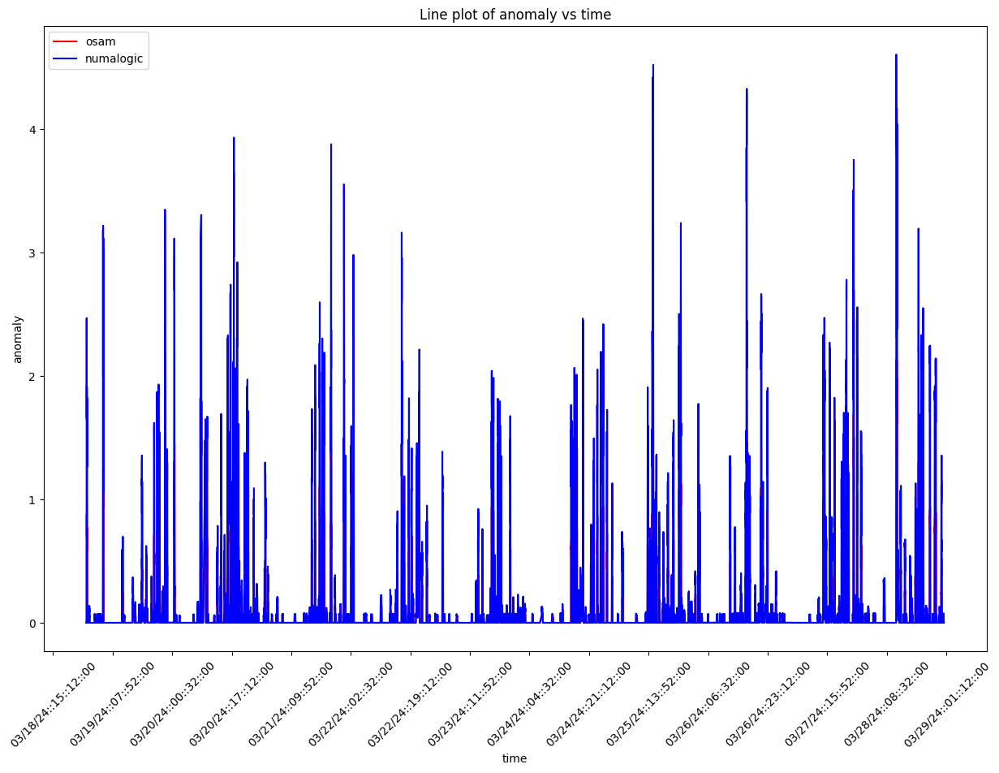

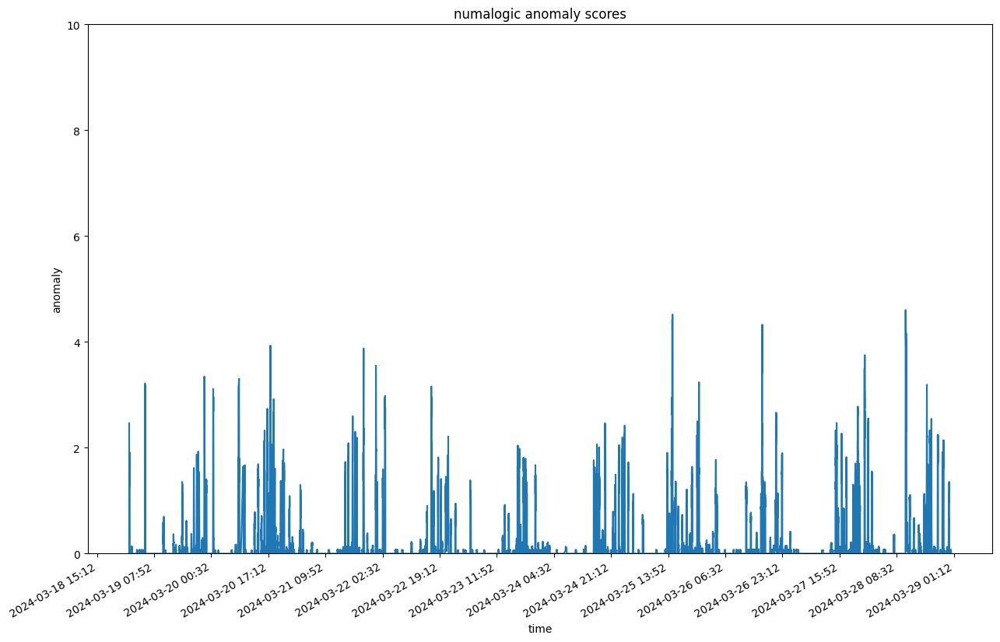

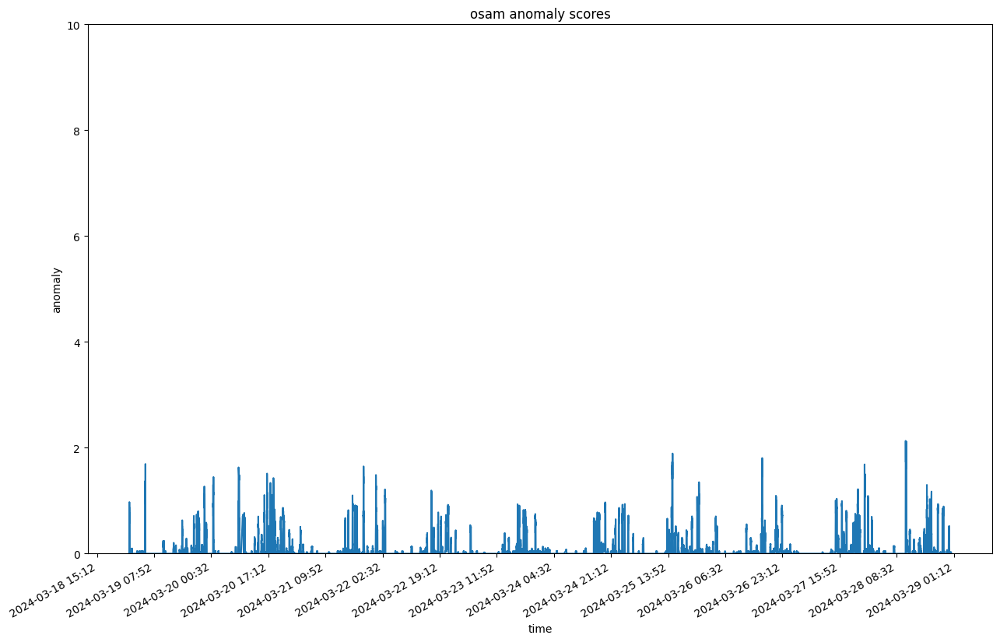

DEBUG:numalogic.connectors.druid._druid:Querying with end_dt: 2024-03-29 03:30:41.630824+00:00, that is with delay of 3 hrs


------------------------------------------------------------
------------------------------------------------------------        ModelId: fci:interactionsFailed:5984175597303660107:Collab_Vep_UI_GET_CONFIG_FILE       ---------------------------------------------


DEBUG:numalogic.connectors.druid._druid:Druid params: {'datasource': 'tech-ip-customer-interaction-metrics', 'granularity': 'minute', 'intervals': ['2024-03-19T03:30:41.630824+00:00/2024-03-29T03:30:41.630824+00:00'], 'aggregations': {'count': {'type': 'doubleSum', 'fieldName': 'count', 'name': 'count'}}, 'post_aggregations': {}, 'filter': <pydruid.utils.filters.Filter object at 0x2cb8b66b0>, 'dimensions': <map object at 0x2cb1f7970>, 'context': {'timeout': 10000, 'configIds': ['assetId', 'interactionName'], 'source': 'numalogic'}}, fetch time: 1.0343s
DEBUG:numalogic.udfs.tools:Querying with end_dt: 2024-03-29 00:30:44.670757+00:00, that is with delay of 3 hrs
DEBUG:numalogic.udfs.tools:Querying with end_dt: 2024-03-29 00:30:44.670757+00:00, that is with delay of 3 hrs


--- 4.20877480506897 seconds ---
--- 2.8432931900024414 seconds ---


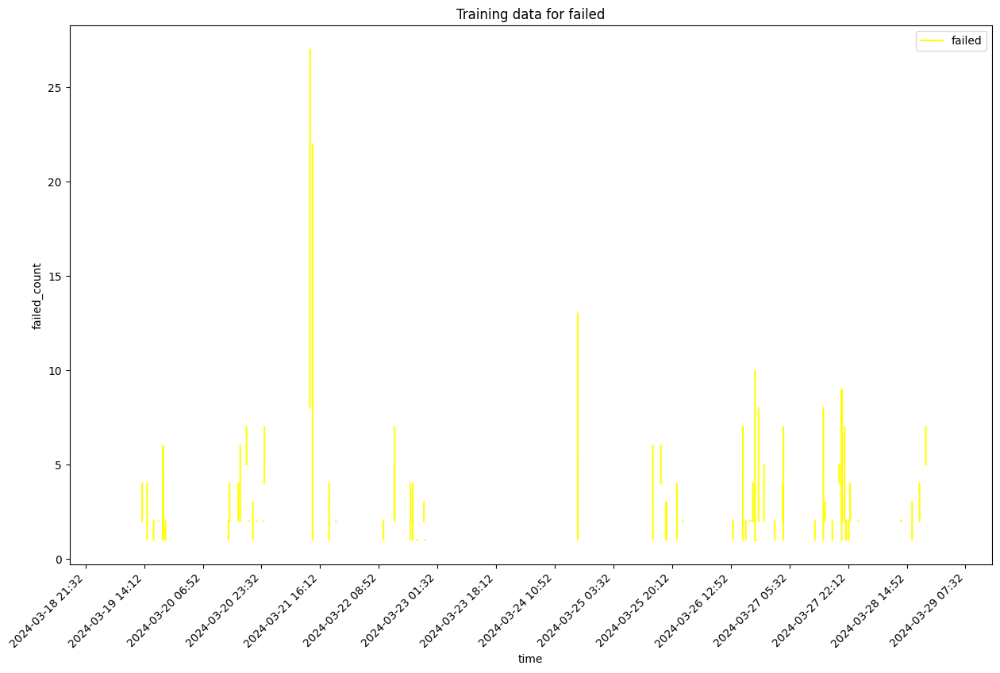

self.df_training shape  12012
Sum of histogram frequencies:  521.0
Number of non-NaN records in column x:  521


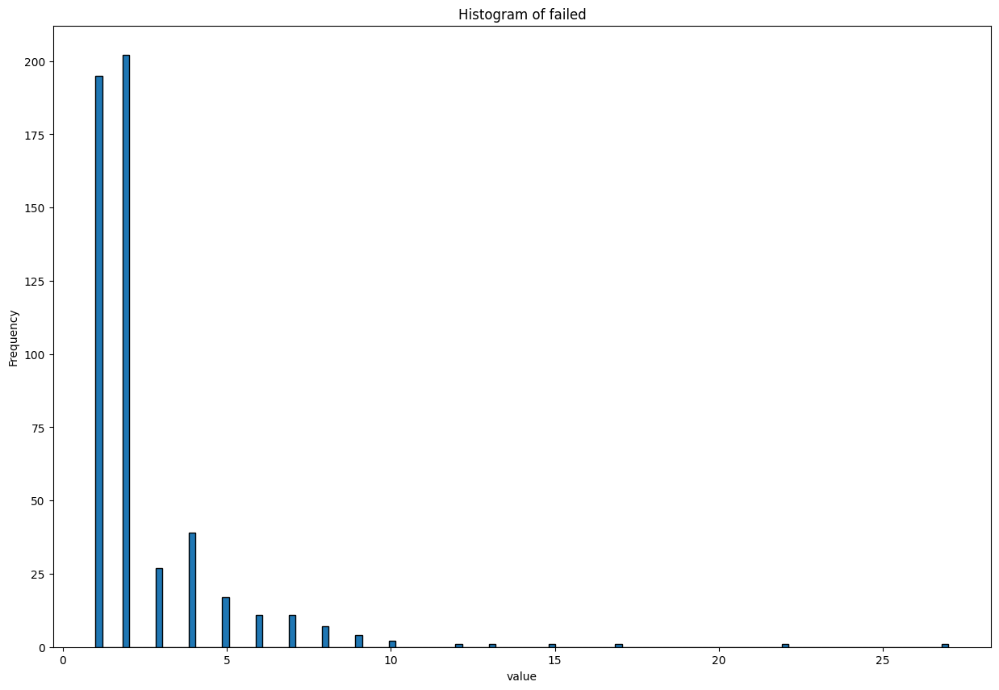

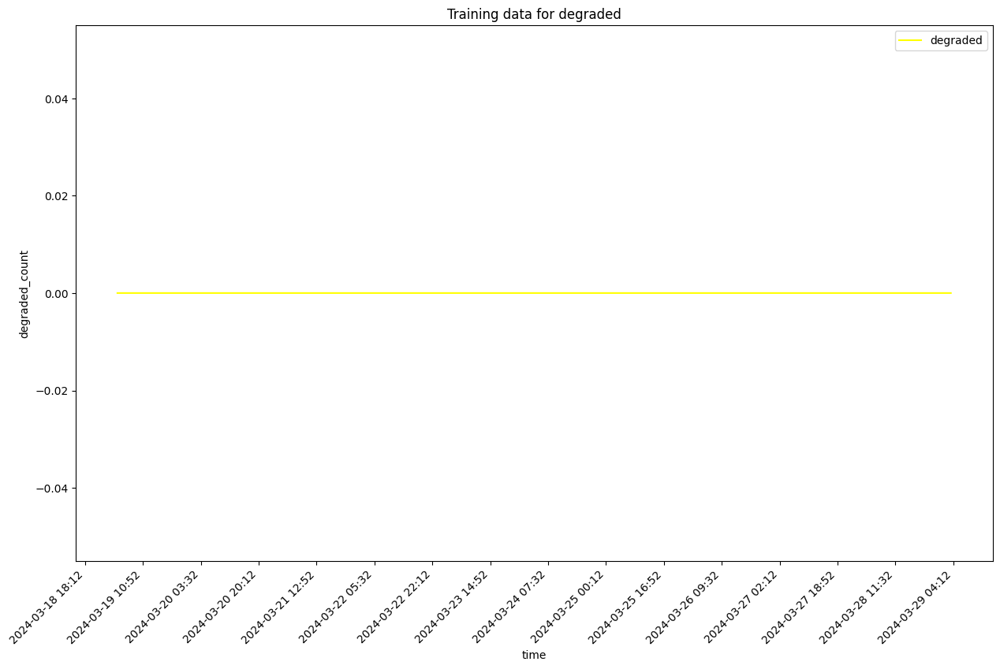

self.df_training shape  12012
Sum of histogram frequencies:  12012.0
Number of non-NaN records in column x:  12012


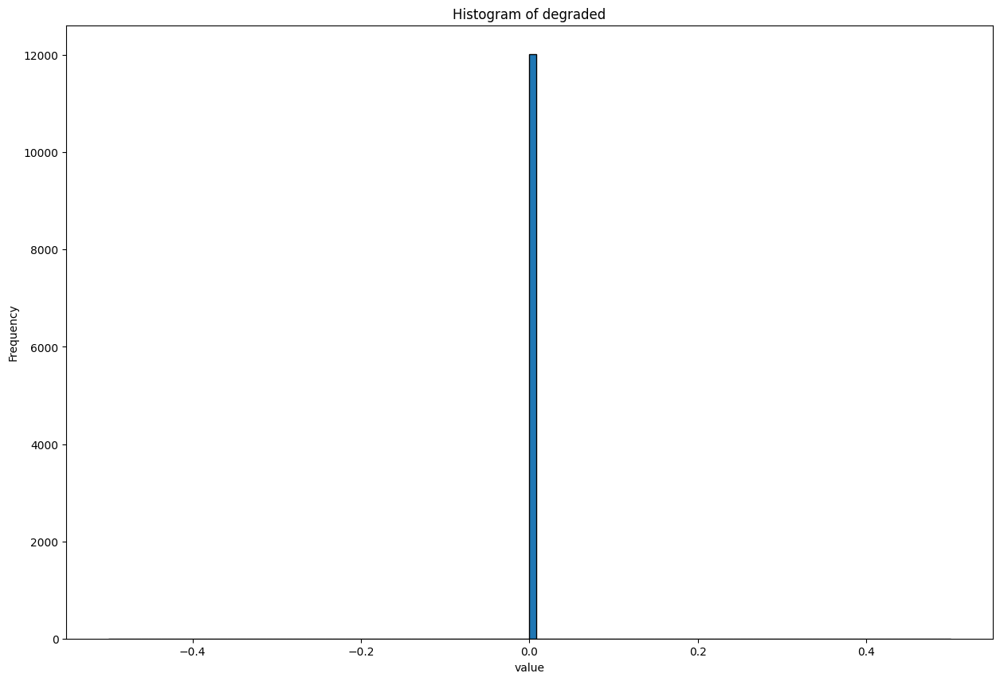

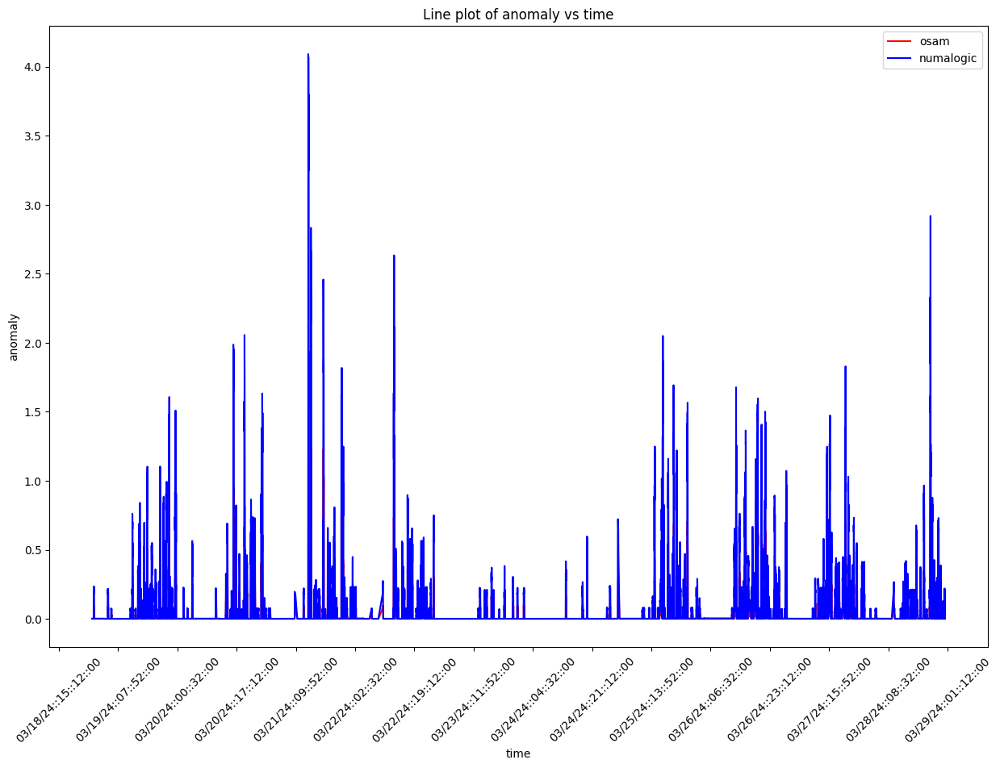

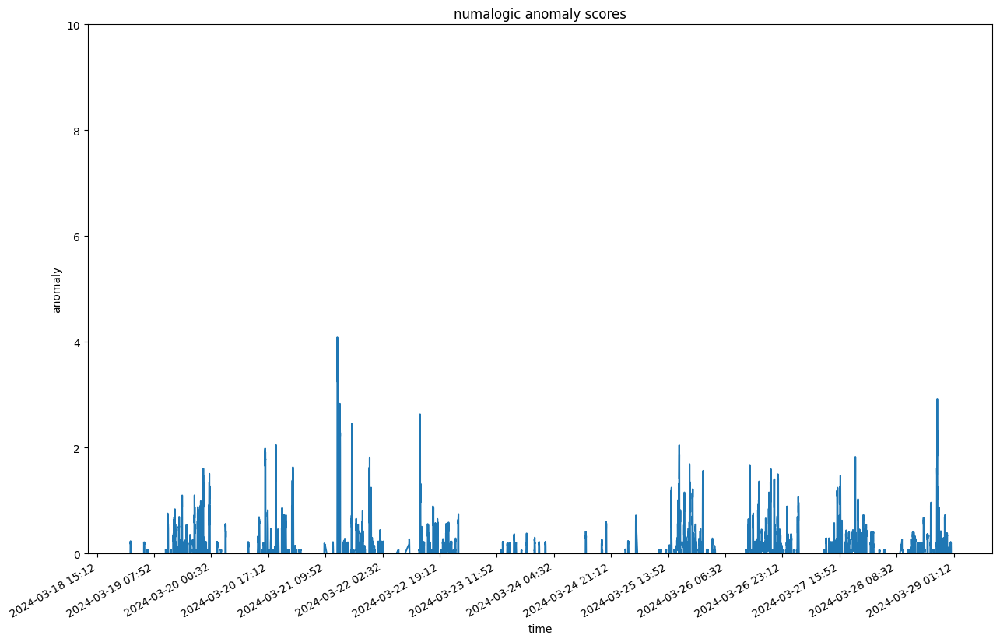

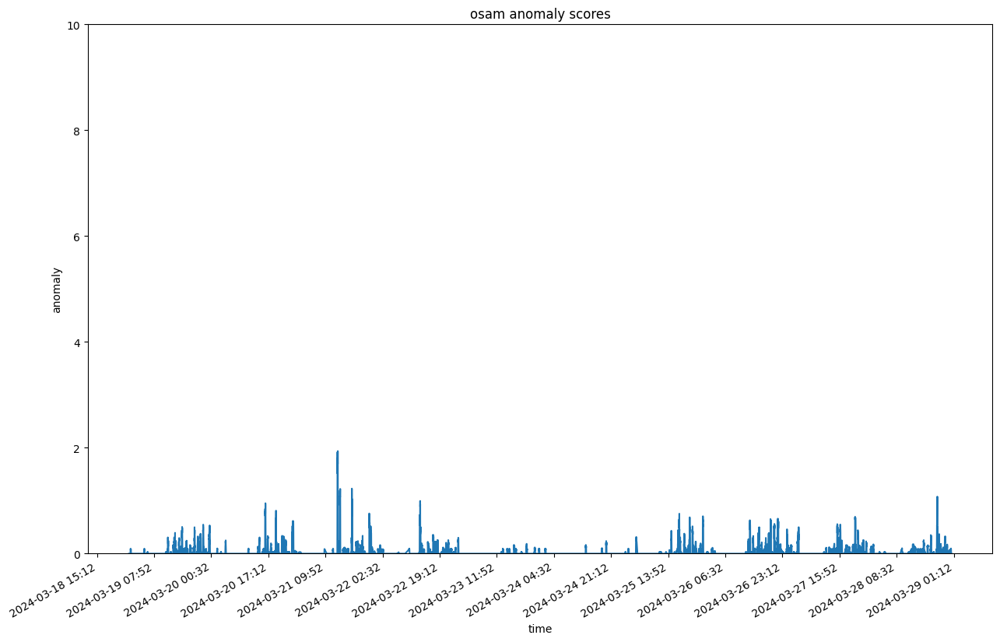

DEBUG:numalogic.connectors.druid._druid:Querying with end_dt: 2024-03-29 03:30:56.099811+00:00, that is with delay of 3 hrs


------------------------------------------------------------
------------------------------------------------------------        ModelId: fci:interactionsFailed:4831254092648450521:w-2-post-main-entry-celebration-empathy-views-0.irsw2.Prev       ---------------------------------------------


DEBUG:numalogic.connectors.druid._druid:Druid params: {'datasource': 'tech-ip-customer-interaction-metrics', 'granularity': 'minute', 'intervals': ['2024-03-19T03:30:56.099811+00:00/2024-03-29T03:30:56.099811+00:00'], 'aggregations': {'count': {'type': 'doubleSum', 'fieldName': 'count', 'name': 'count'}}, 'post_aggregations': {}, 'filter': <pydruid.utils.filters.Filter object at 0x2cb4a33d0>, 'dimensions': <map object at 0x14723ba90>, 'context': {'timeout': 10000, 'configIds': ['assetId', 'interactionName'], 'source': 'numalogic'}}, fetch time: 0.9774s
DEBUG:numalogic.udfs.tools:Querying with end_dt: 2024-03-29 00:30:59.081157+00:00, that is with delay of 3 hrs
DEBUG:numalogic.udfs.tools:Querying with end_dt: 2024-03-29 00:30:59.081157+00:00, that is with delay of 3 hrs


--- 3.3030500411987305 seconds ---
--- 3.4323959350585938 seconds ---


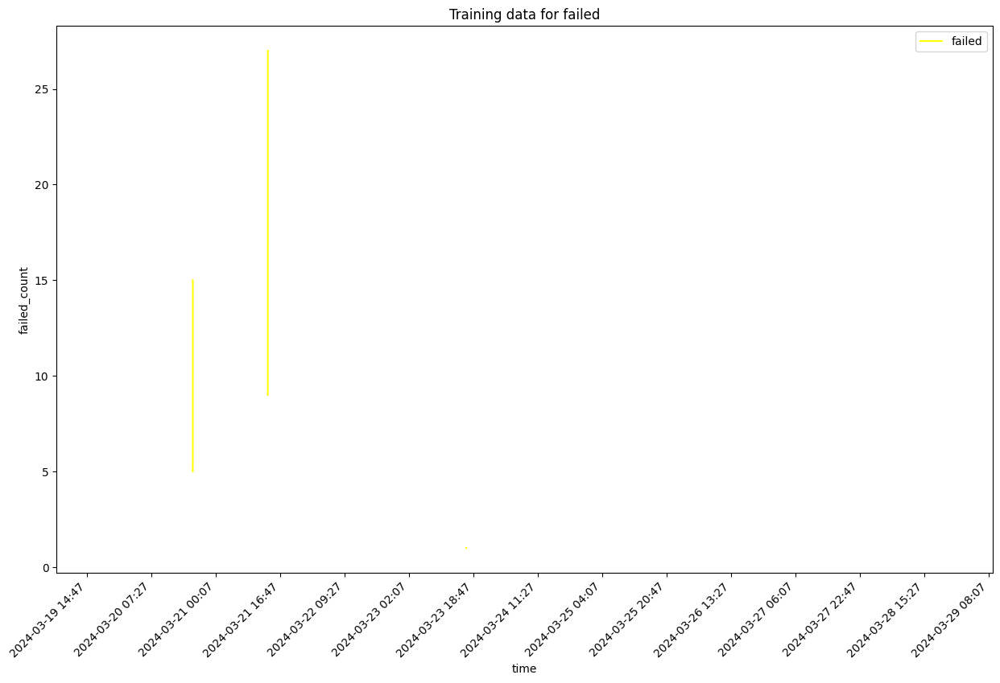

self.df_training shape  9568
Sum of histogram frequencies:  54.0
Number of non-NaN records in column x:  54


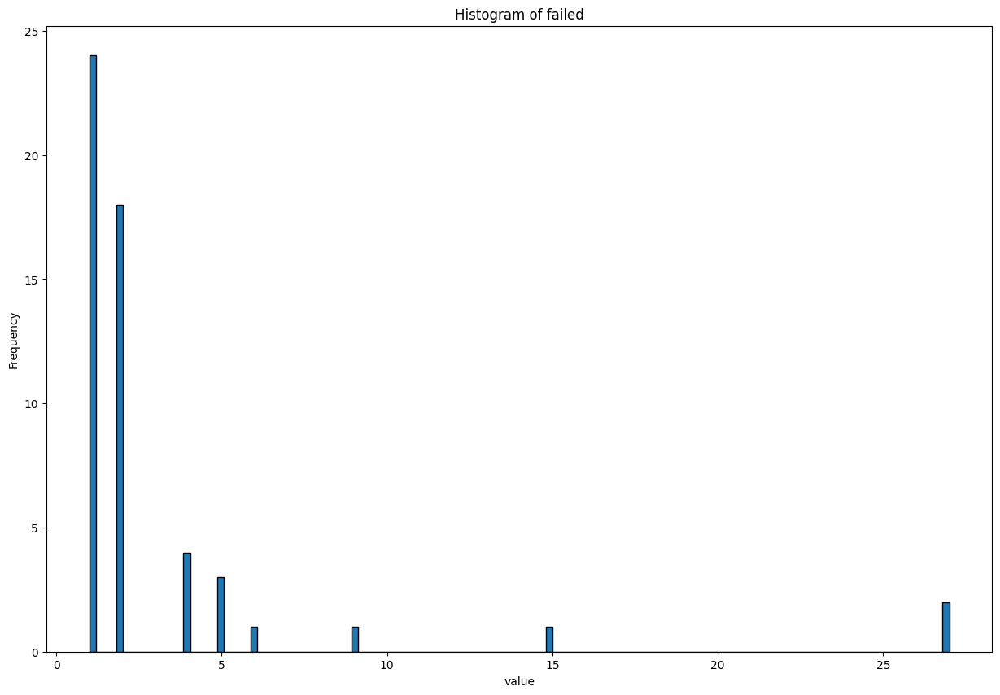

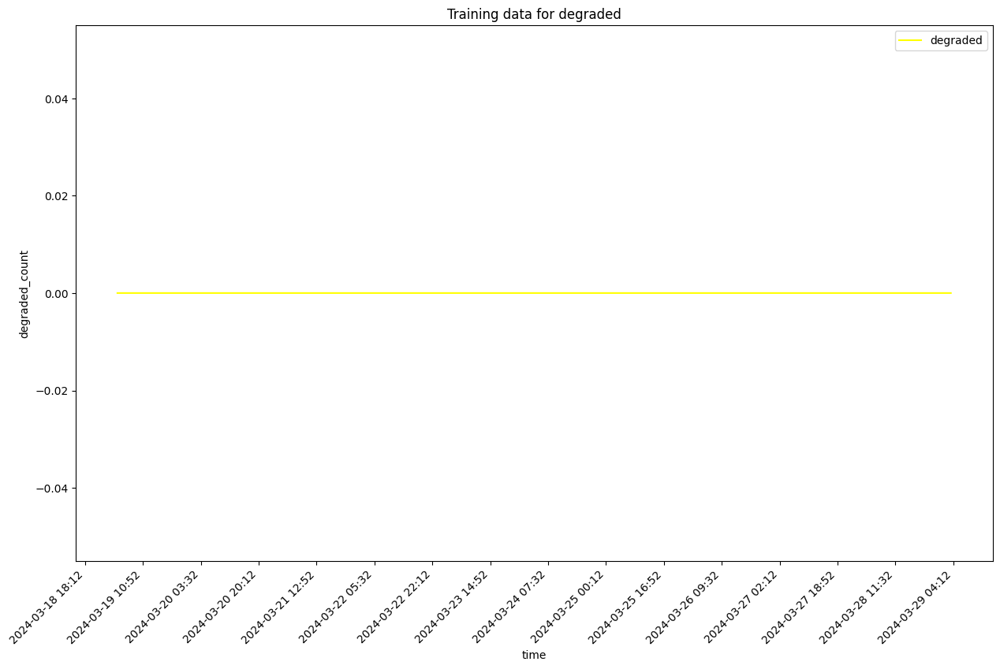

self.df_training shape  9568
Sum of histogram frequencies:  9568.0
Number of non-NaN records in column x:  9568


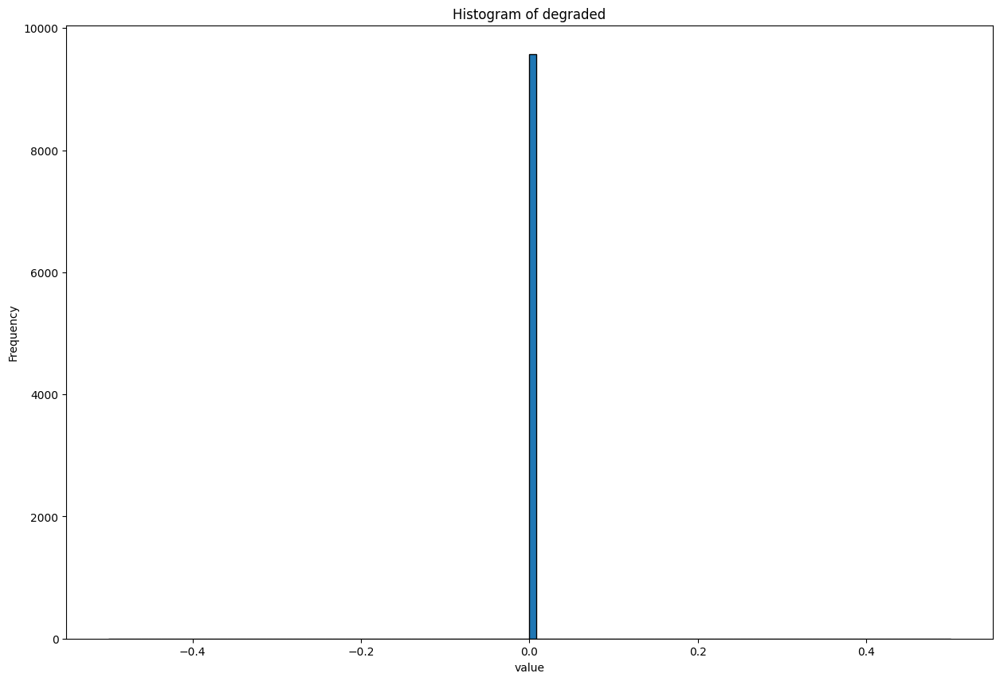

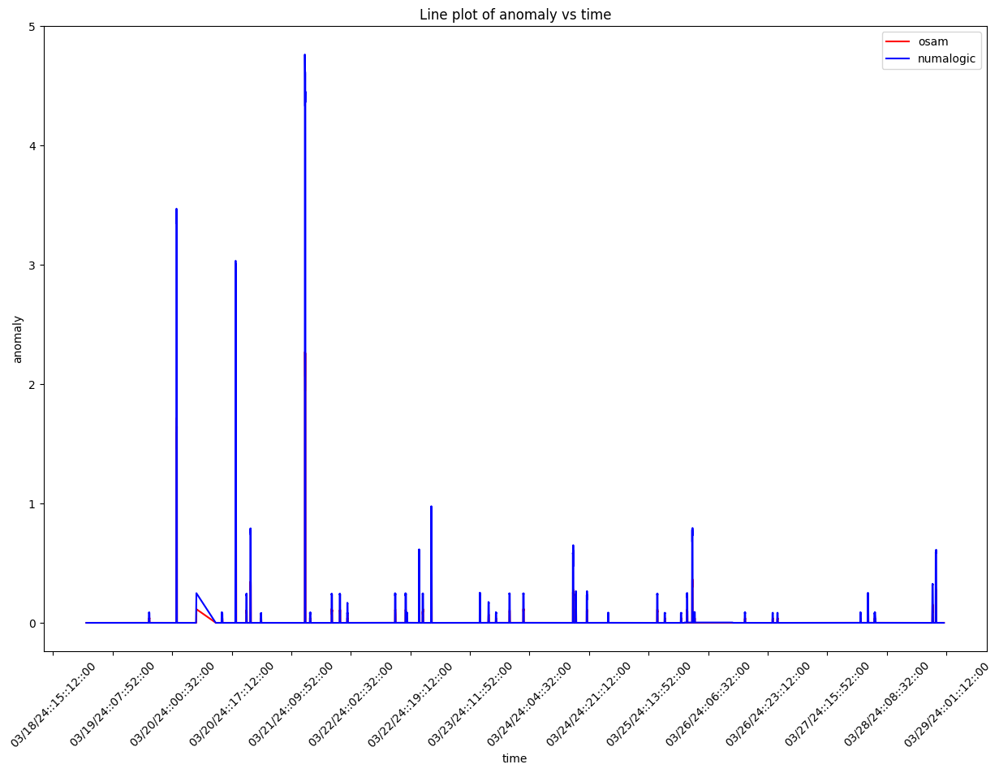

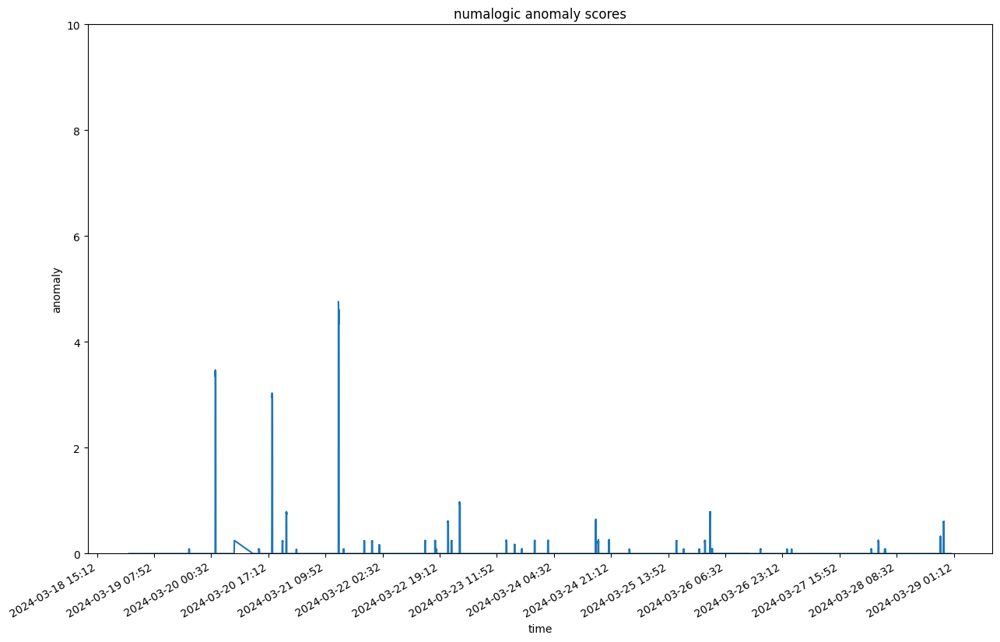

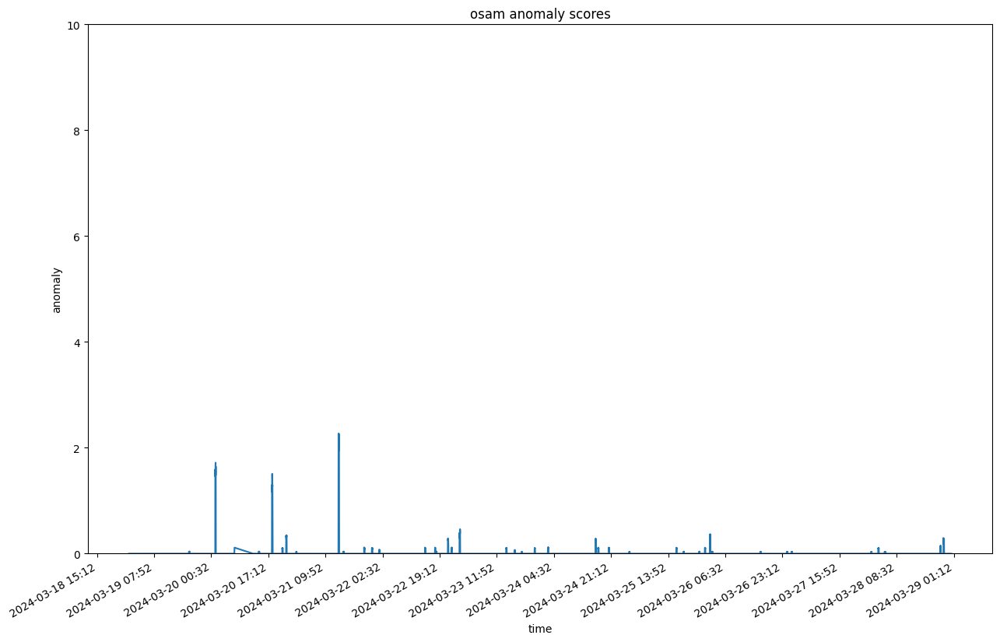

DEBUG:numalogic.connectors.druid._druid:Querying with end_dt: 2024-03-29 03:31:10.062743+00:00, that is with delay of 3 hrs


------------------------------------------------------------
------------------------------------------------------------        ModelId: fci:interactionsFailed:5984175597303660107:newAccountMlSuggestedIds       ---------------------------------------------


DEBUG:numalogic.connectors.druid._druid:Druid params: {'datasource': 'tech-ip-customer-interaction-metrics', 'granularity': 'minute', 'intervals': ['2024-03-19T03:31:10.062743+00:00/2024-03-29T03:31:10.062743+00:00'], 'aggregations': {'count': {'type': 'doubleSum', 'fieldName': 'count', 'name': 'count'}}, 'post_aggregations': {}, 'filter': <pydruid.utils.filters.Filter object at 0x2cb1cc580>, 'dimensions': <map object at 0x2cb1cce80>, 'context': {'timeout': 10000, 'configIds': ['assetId', 'interactionName'], 'source': 'numalogic'}}, fetch time: 1.2457s
DEBUG:numalogic.udfs.tools:Querying with end_dt: 2024-03-29 00:31:13.311966+00:00, that is with delay of 3 hrs
DEBUG:numalogic.udfs.tools:Querying with end_dt: 2024-03-29 00:31:13.311966+00:00, that is with delay of 3 hrs


--- 2.07737398147583 seconds ---
--- 2.0796921253204346 seconds ---


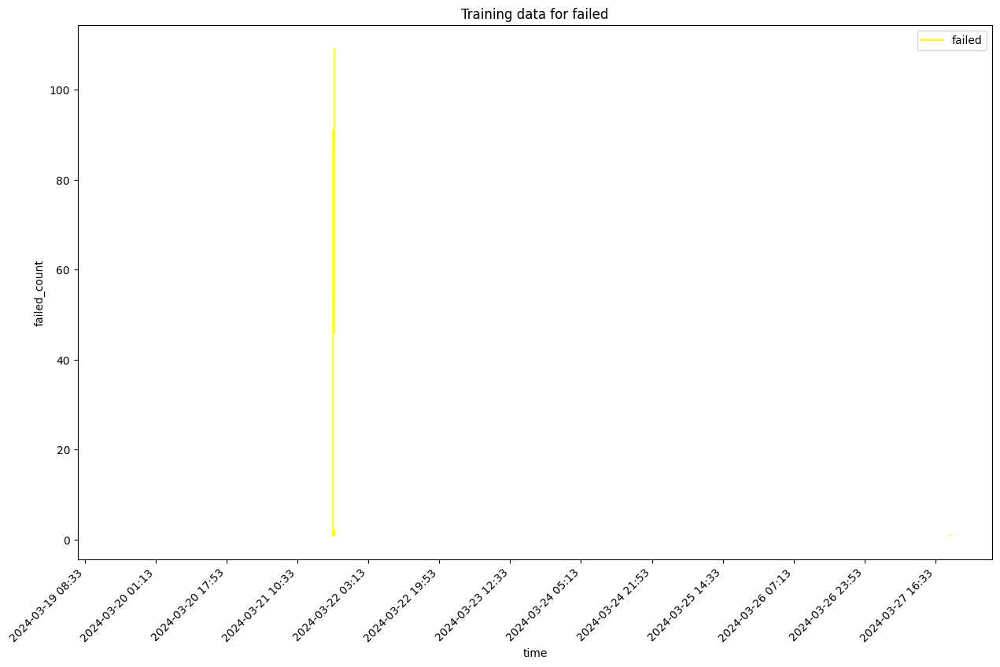

self.df_training shape  14400
Sum of histogram frequencies:  22.0
Number of non-NaN records in column x:  22


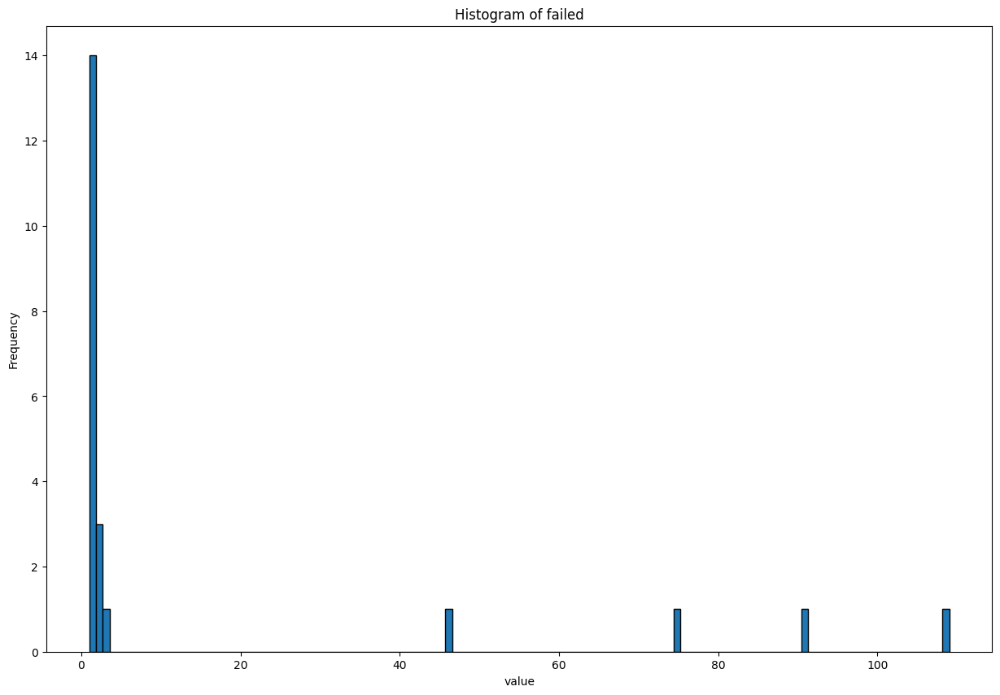

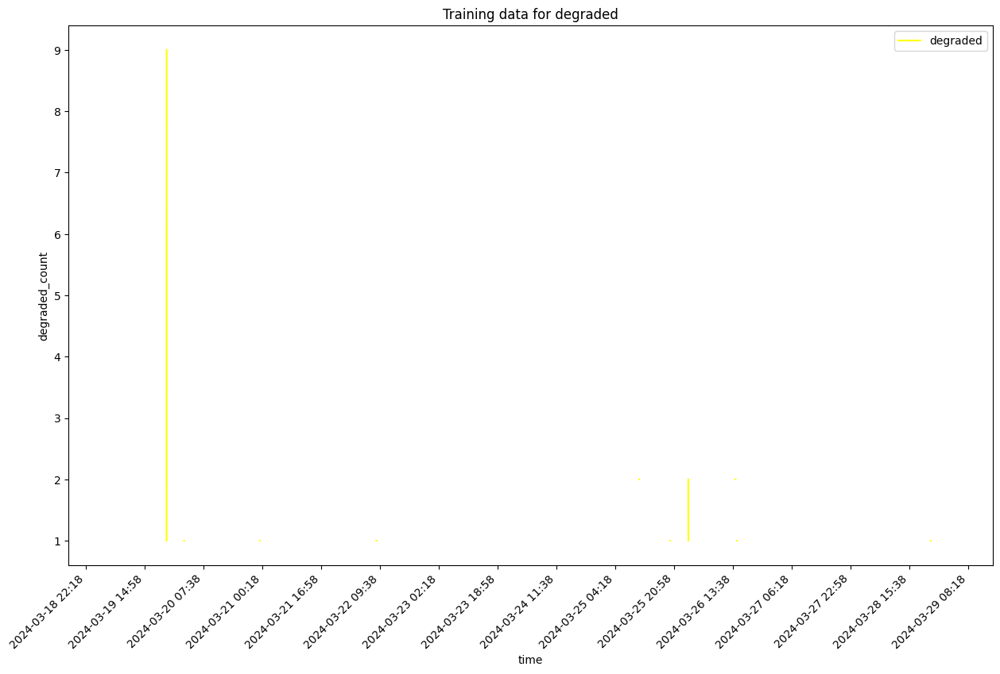

self.df_training shape  14400
Sum of histogram frequencies:  297.0
Number of non-NaN records in column x:  297


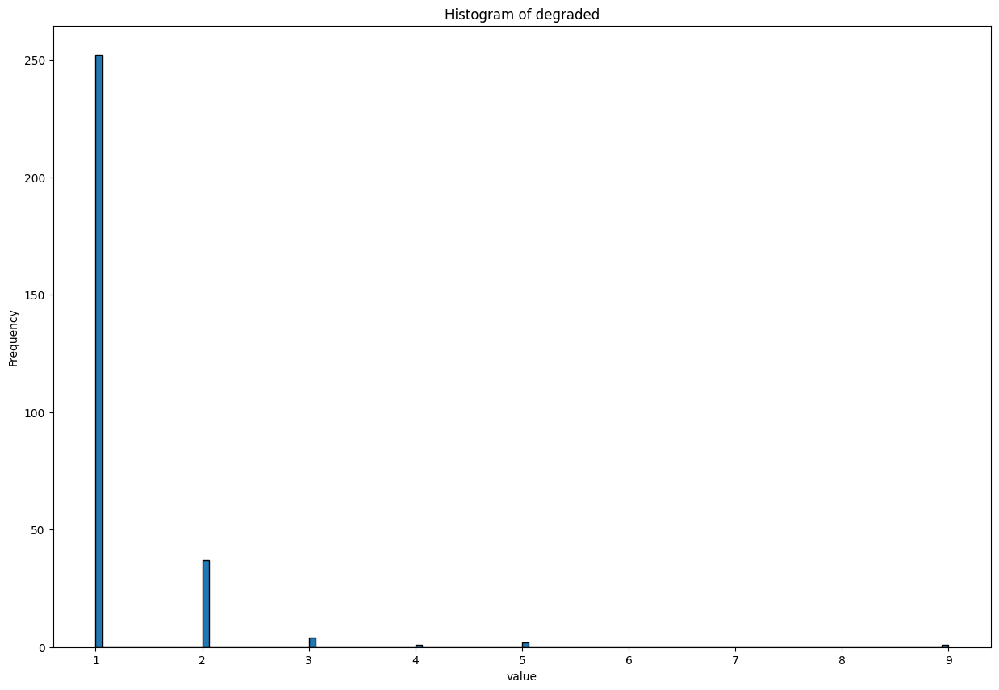

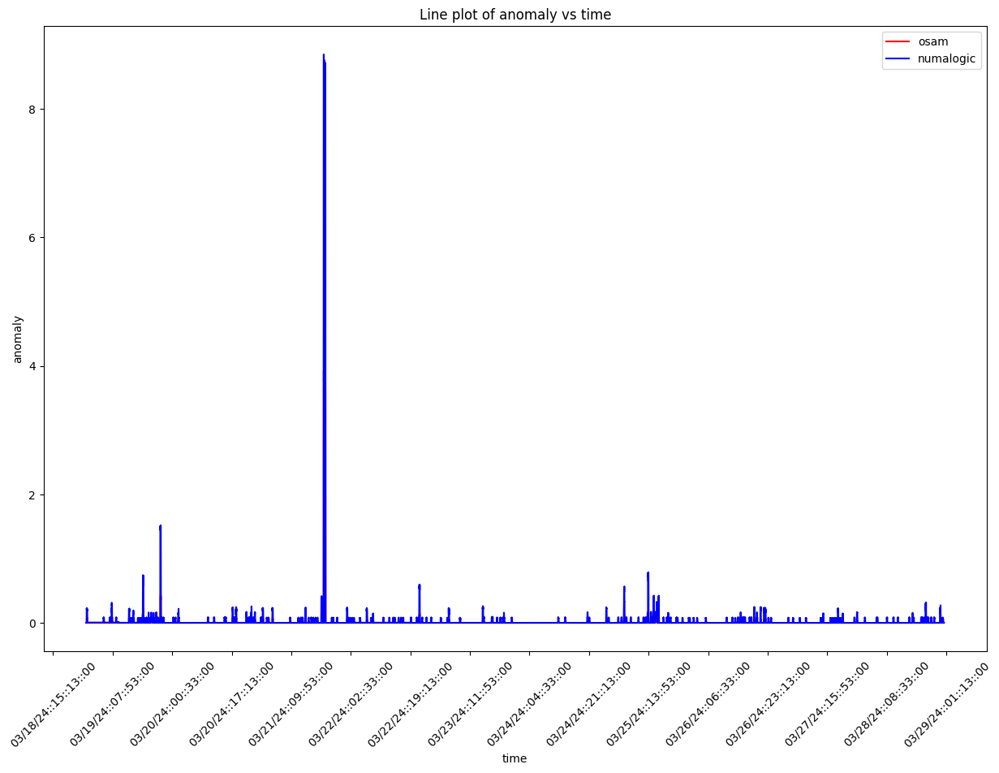

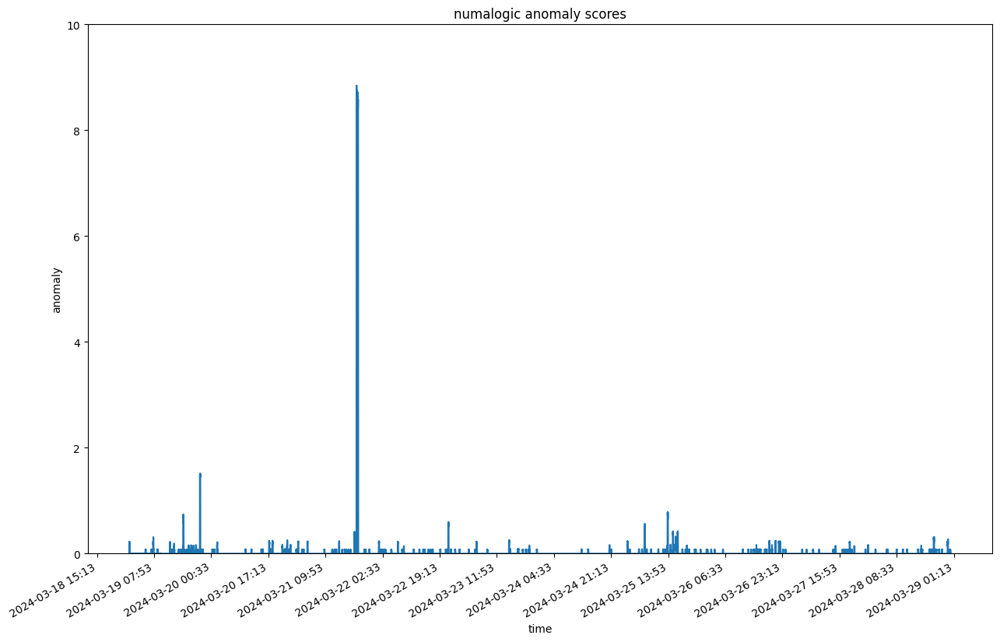

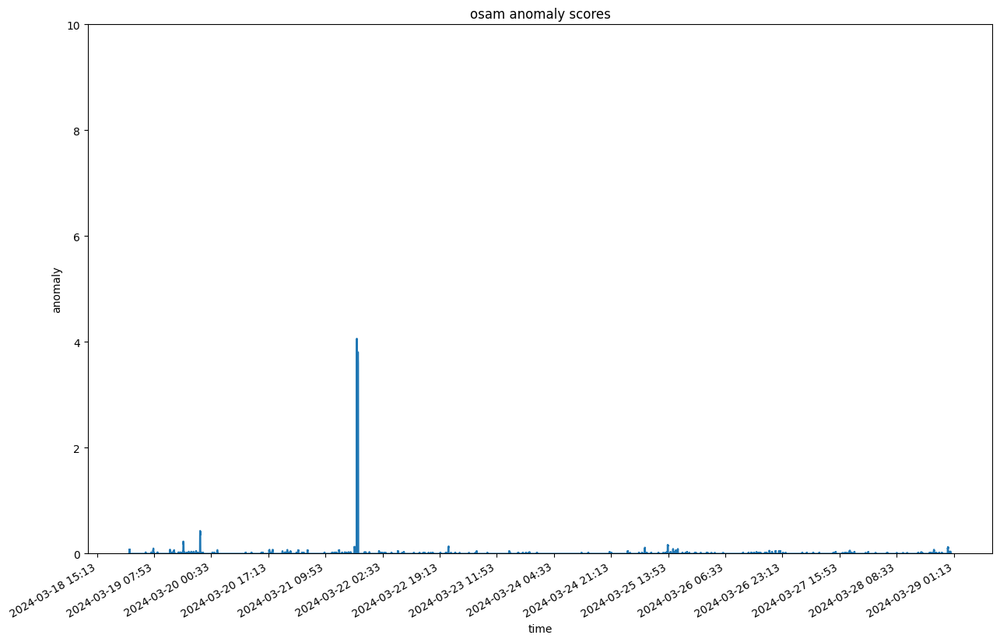

DEBUG:numalogic.connectors.druid._druid:Querying with end_dt: 2024-03-29 03:31:21.983841+00:00, that is with delay of 3 hrs


------------------------------------------------------------
------------------------------------------------------------        ModelId: fci:interactionsFailed:5984175597303660107:PAGINATE_REPORT       ---------------------------------------------


DEBUG:numalogic.connectors.druid._druid:Druid params: {'datasource': 'tech-ip-customer-interaction-metrics', 'granularity': 'minute', 'intervals': ['2024-03-19T03:31:21.983841+00:00/2024-03-29T03:31:21.983841+00:00'], 'aggregations': {'count': {'type': 'doubleSum', 'fieldName': 'count', 'name': 'count'}}, 'post_aggregations': {}, 'filter': <pydruid.utils.filters.Filter object at 0x2cb70eb60>, 'dimensions': <map object at 0x2cb664f70>, 'context': {'timeout': 10000, 'configIds': ['assetId', 'interactionName'], 'source': 'numalogic'}}, fetch time: 1.2022s
DEBUG:numalogic.udfs.tools:Querying with end_dt: 2024-03-29 00:31:25.189673+00:00, that is with delay of 3 hrs
DEBUG:numalogic.udfs.tools:Querying with end_dt: 2024-03-29 00:31:25.189673+00:00, that is with delay of 3 hrs


--- 3.2989768981933594 seconds ---
--- 2.6020169258117676 seconds ---


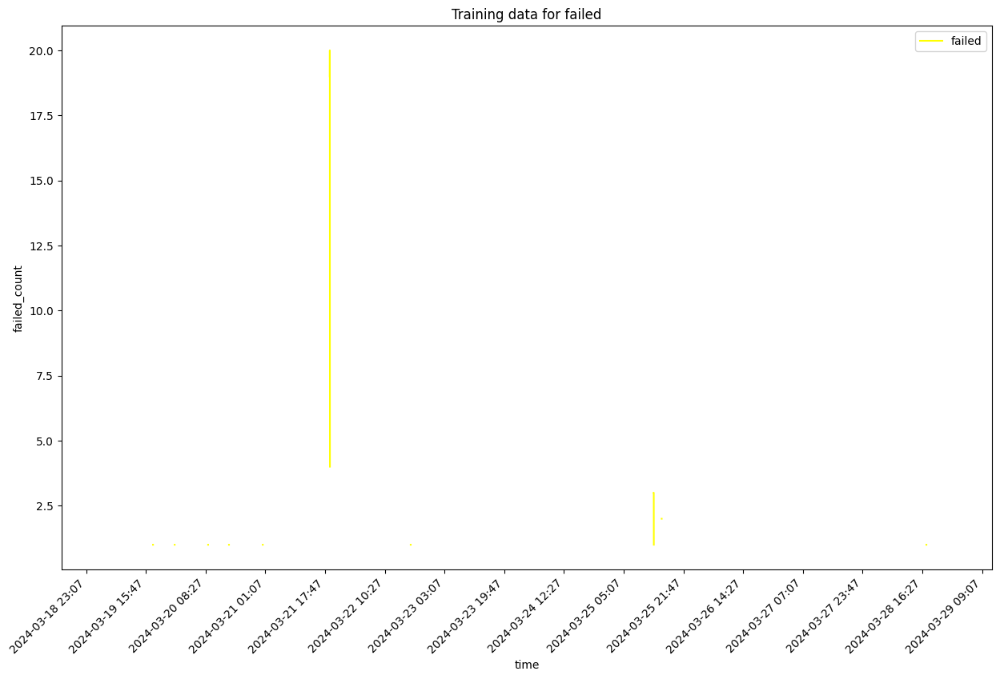

self.df_training shape  14400
Sum of histogram frequencies:  168.0
Number of non-NaN records in column x:  168


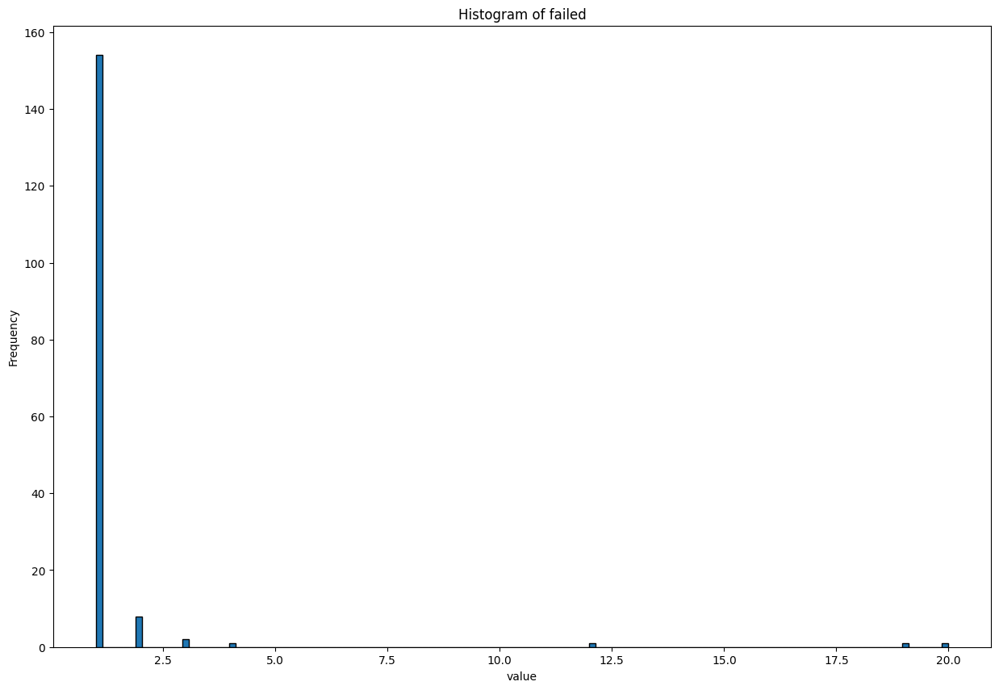

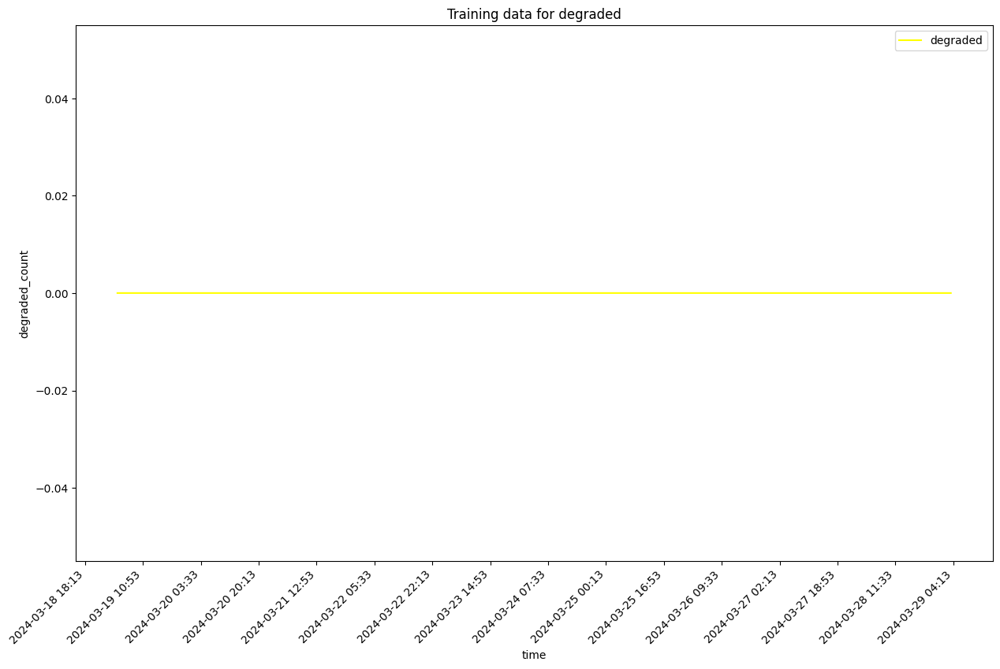

self.df_training shape  14400
Sum of histogram frequencies:  14400.0
Number of non-NaN records in column x:  14400


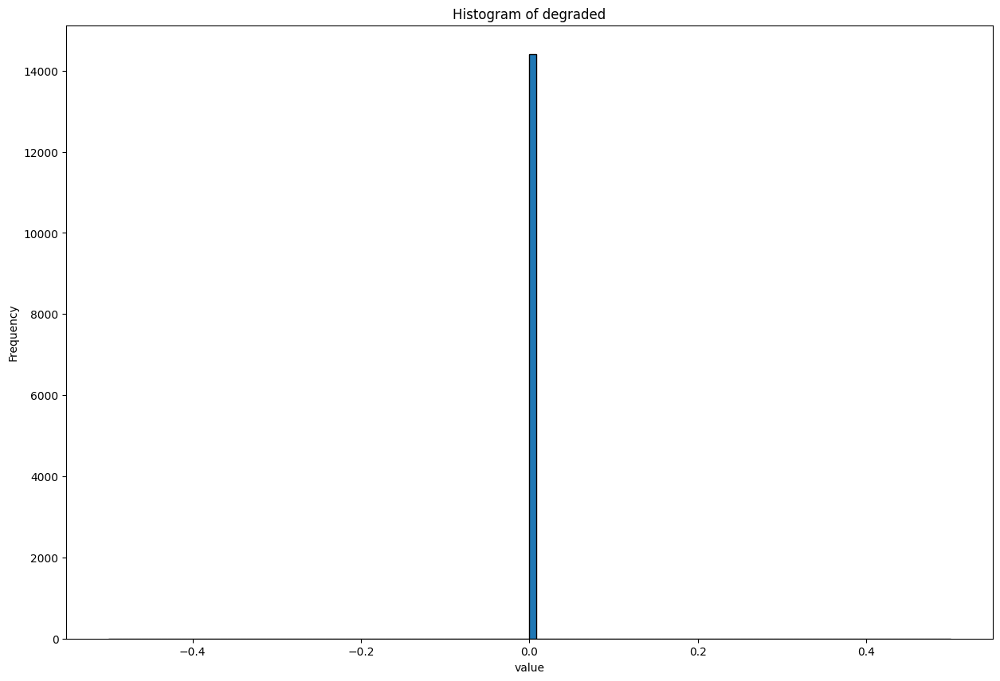

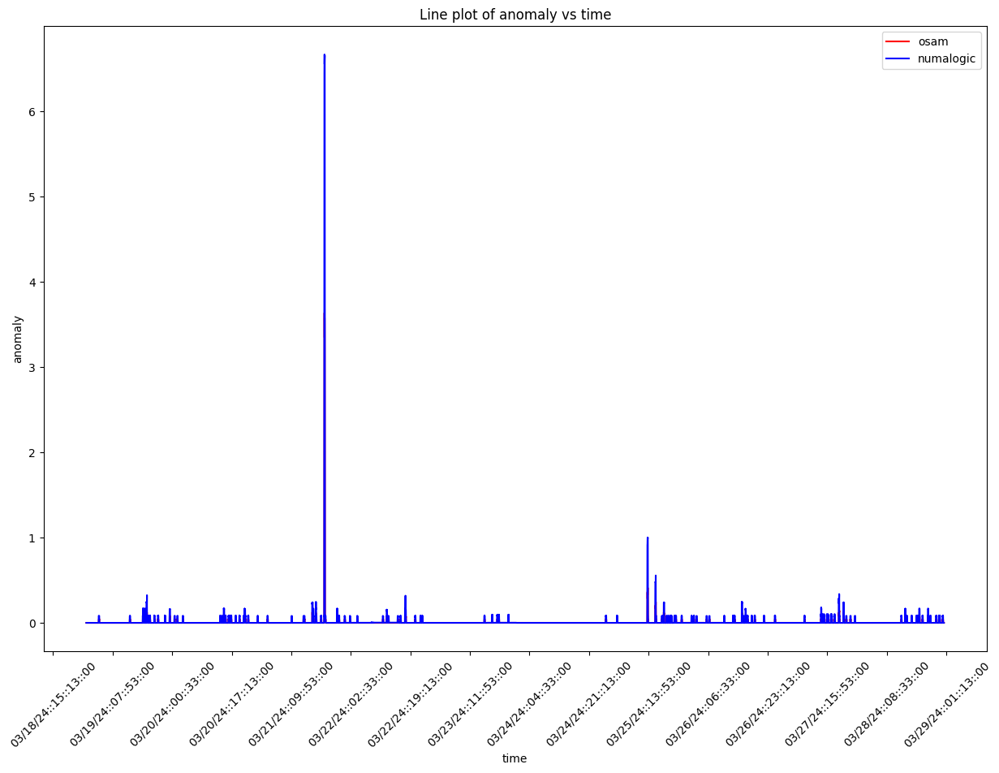

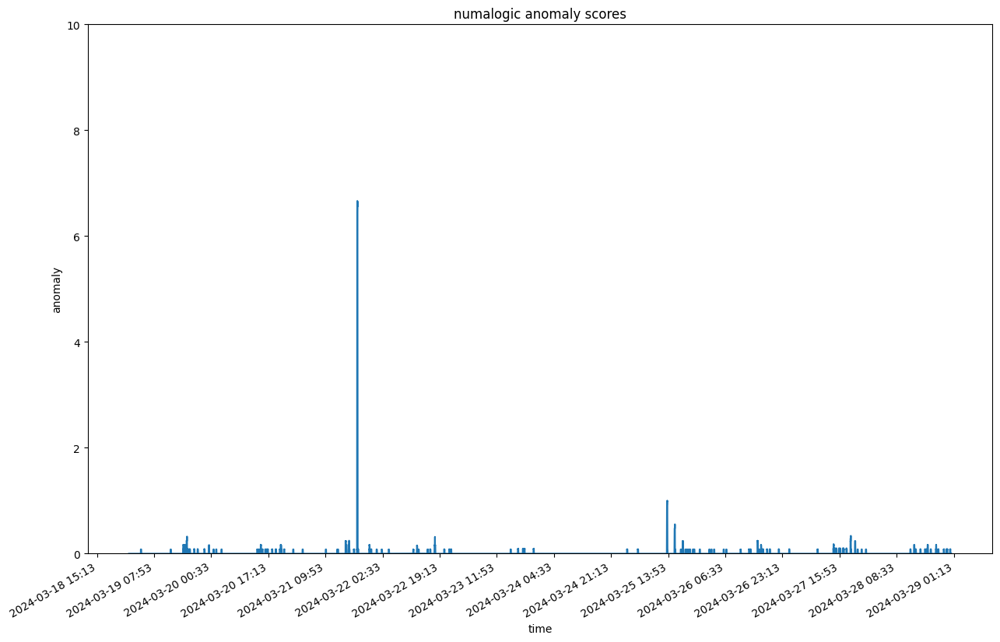

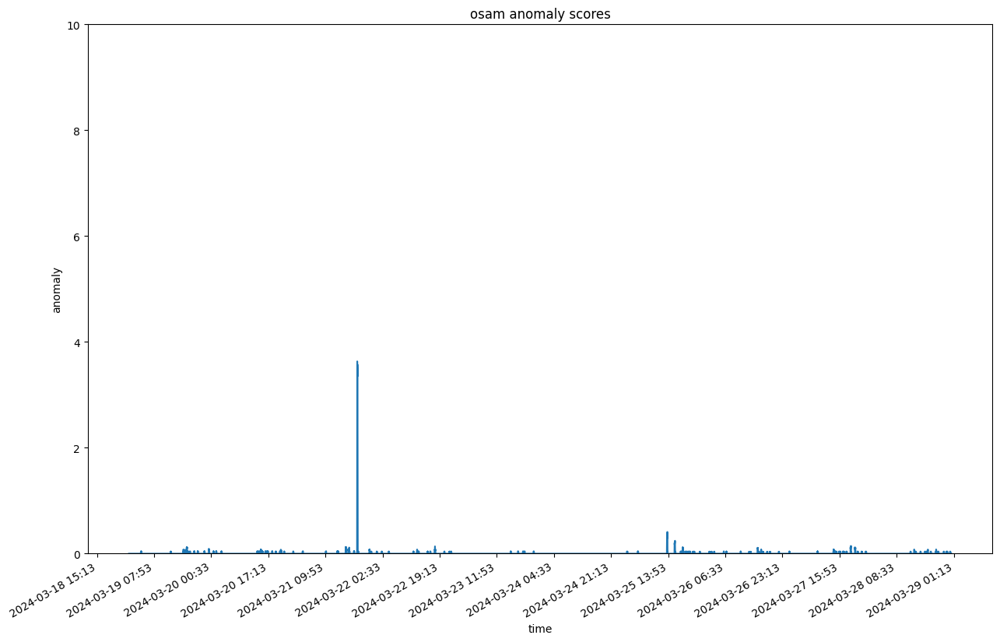

DEBUG:numalogic.connectors.druid._druid:Querying with end_dt: 2024-03-29 03:31:35.805771+00:00, that is with delay of 3 hrs


------------------------------------------------------------
------------------------------------------------------------        ModelId: fciPluginInteractions:metrics:8217961012385696693:Collab_Docmgmt_UI_Get_Folder_Metadata_By_Id_Elastic_Search       ---------------------------------------------


DEBUG:numalogic.connectors.druid._druid:Druid params: {'datasource': 'tech-ip-customer-interaction-metrics', 'granularity': 'minute', 'intervals': ['2024-03-19T03:31:35.805771+00:00/2024-03-29T03:31:35.805771+00:00'], 'aggregations': {'count': {'type': 'doubleSum', 'fieldName': 'count', 'name': 'count'}}, 'post_aggregations': {}, 'filter': <pydruid.utils.filters.Filter object at 0x2cbc9d450>, 'dimensions': <map object at 0x2cbc9c880>, 'context': {'timeout': 10000, 'configIds': ['pluginAssetId', 'interactionName'], 'source': 'numalogic'}}, fetch time: 1.5601s
DEBUG:numalogic.udfs.tools:Querying with end_dt: 2024-03-29 00:31:39.369401+00:00, that is with delay of 3 hrs
DEBUG:numalogic.udfs.tools:Querying with end_dt: 2024-03-29 00:31:39.369401+00:00, that is with delay of 3 hrs


--- 3.2128961086273193 seconds ---
--- 4.011321067810059 seconds ---


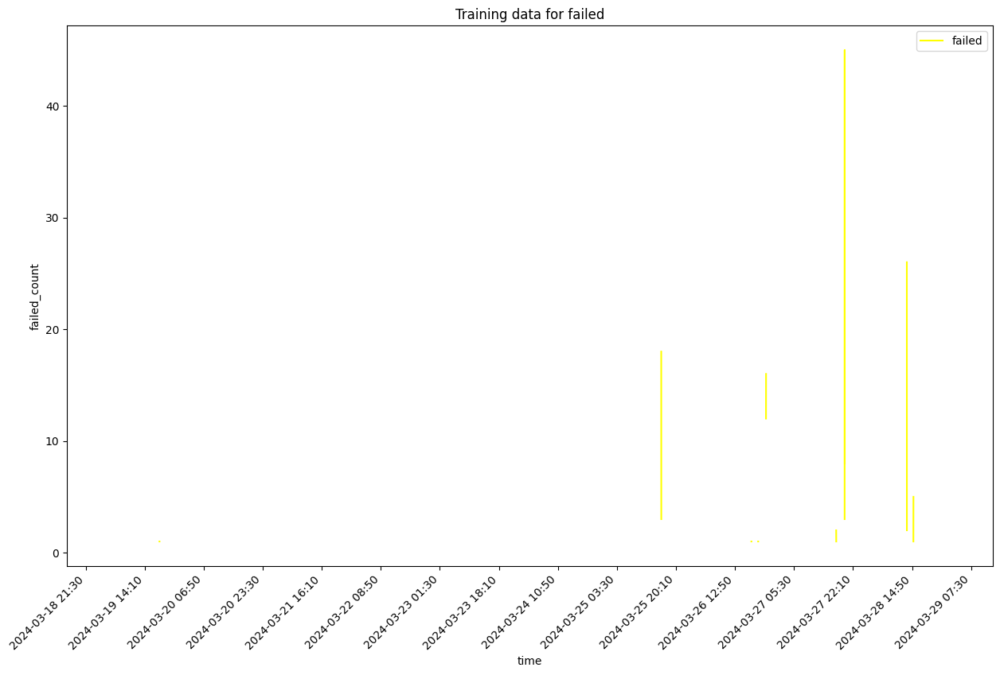

self.df_training shape  14395
Sum of histogram frequencies:  153.0
Number of non-NaN records in column x:  153


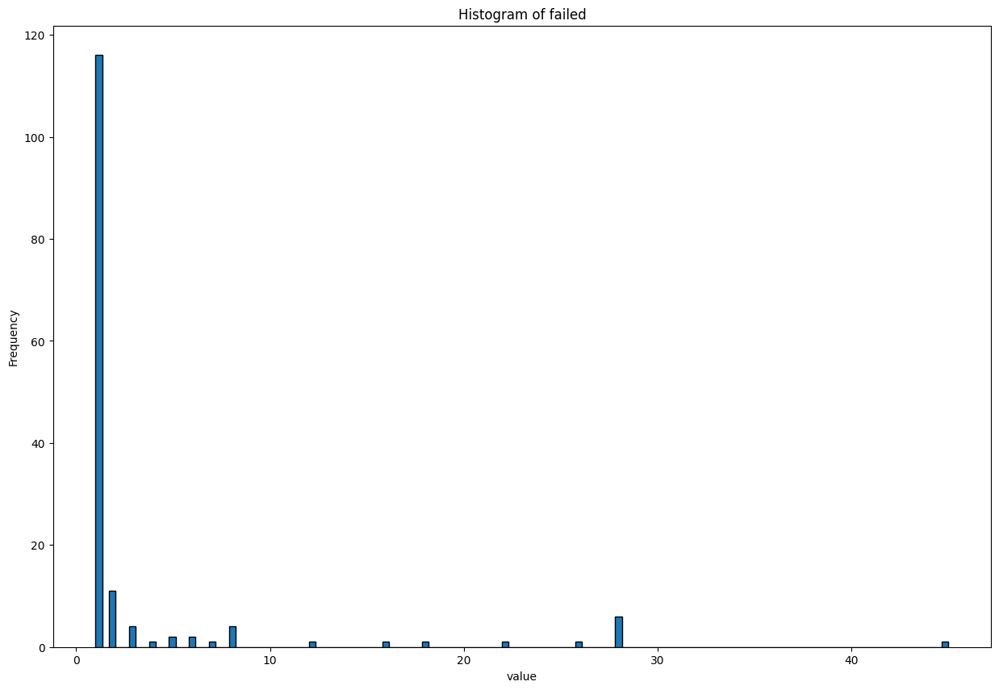

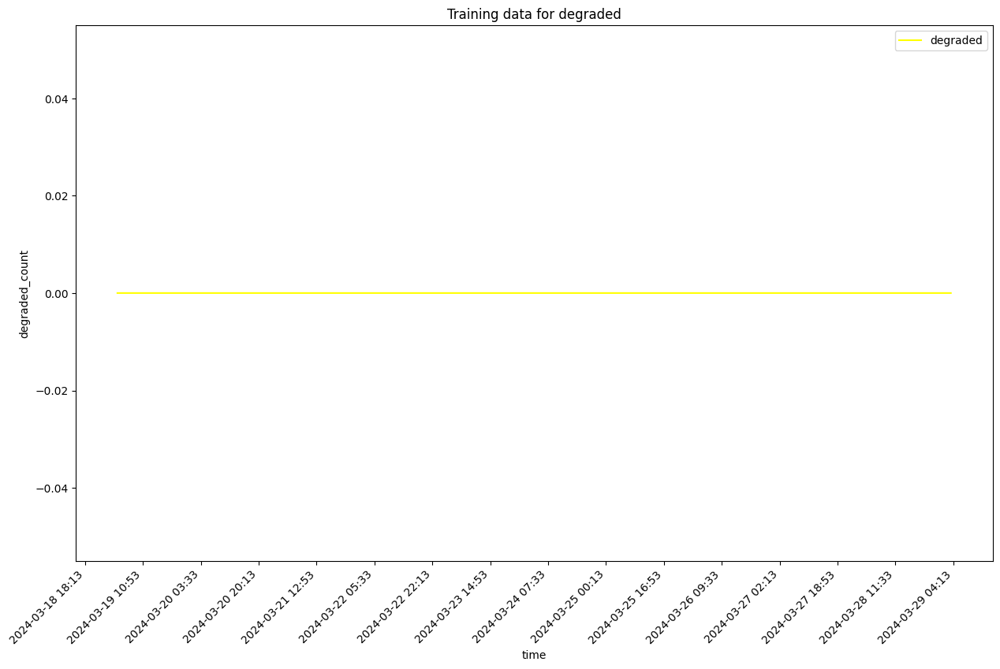

self.df_training shape  14395
Sum of histogram frequencies:  14395.0
Number of non-NaN records in column x:  14395


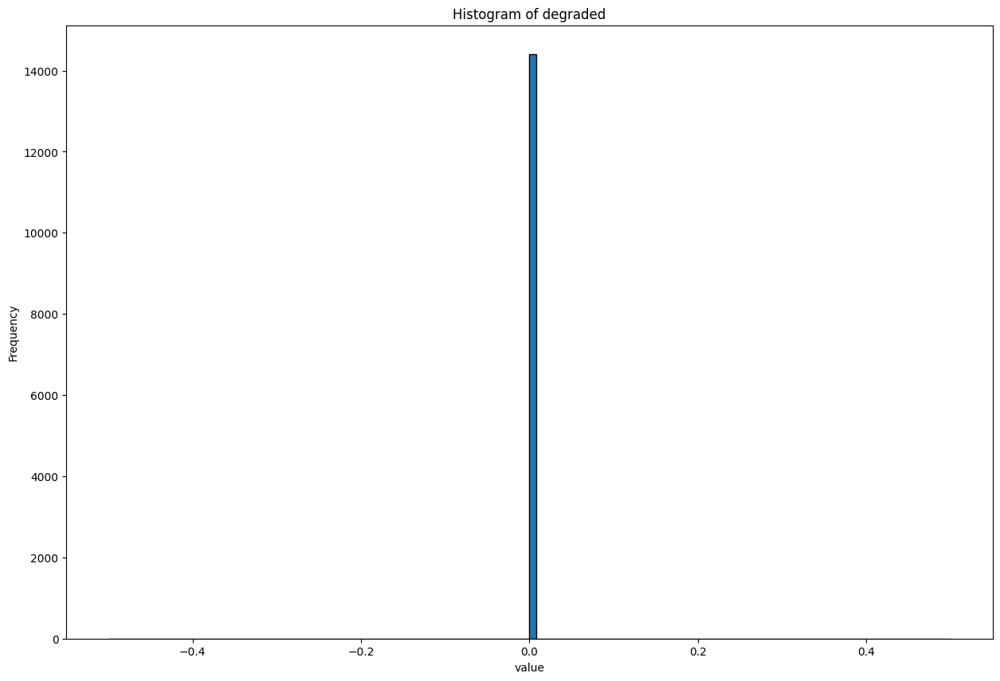

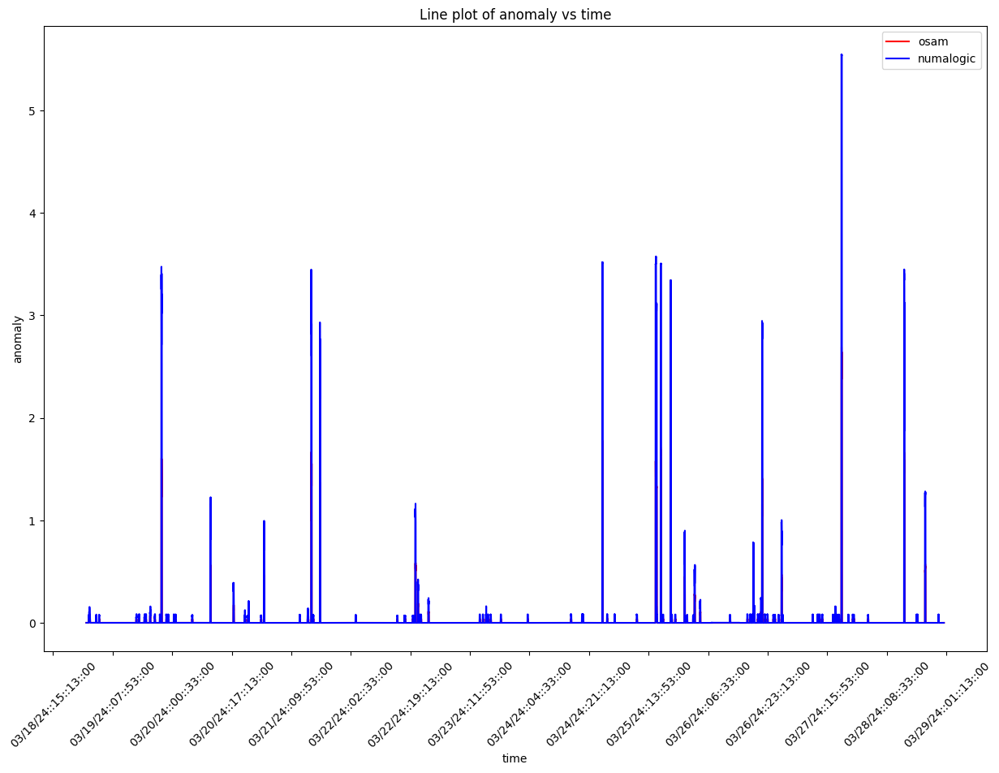

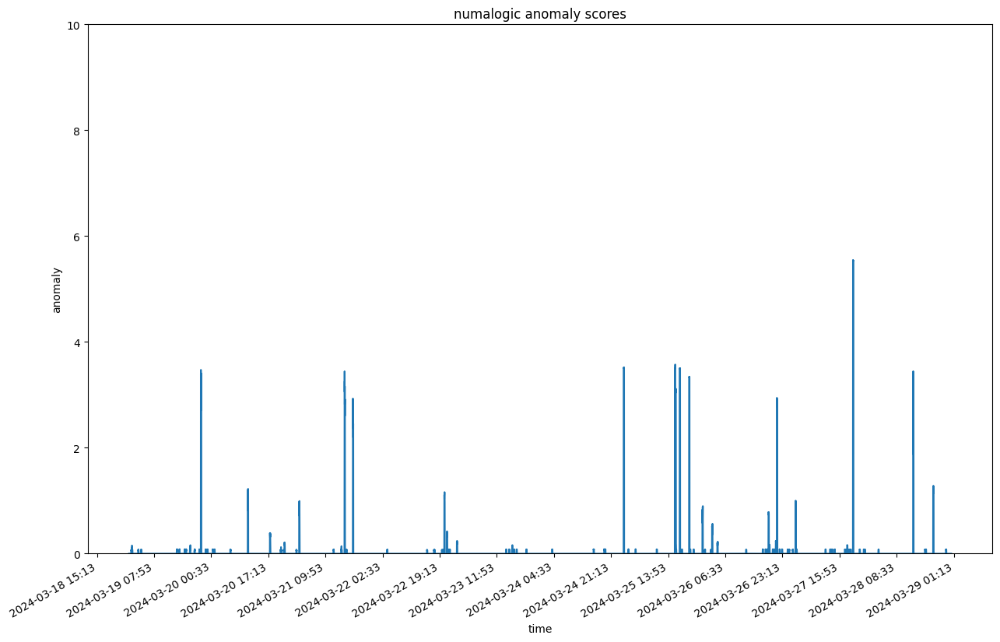

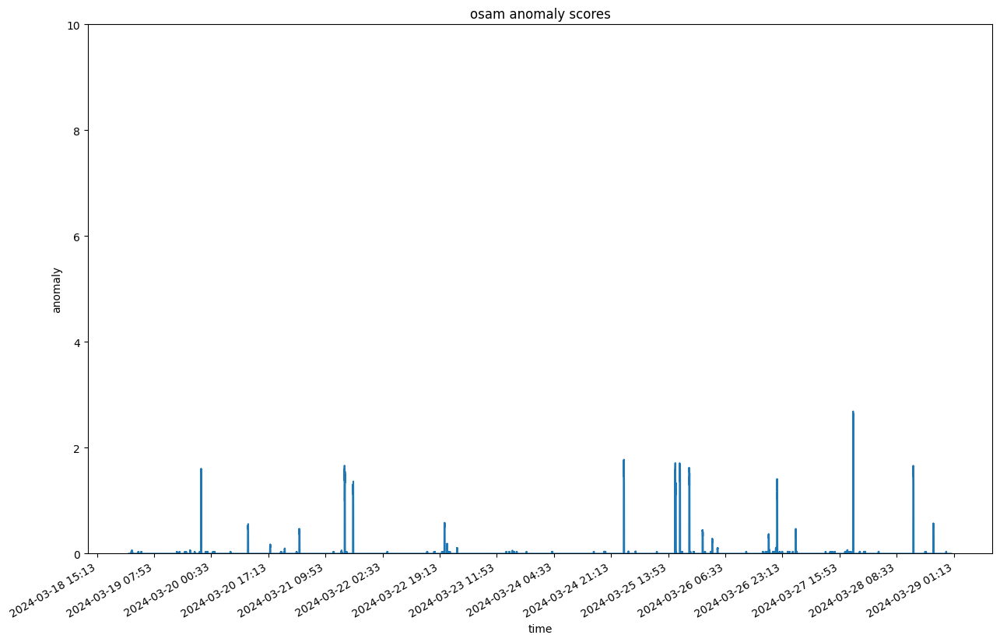

DEBUG:numalogic.connectors.druid._druid:Querying with end_dt: 2024-03-29 03:31:50.992014+00:00, that is with delay of 3 hrs


------------------------------------------------------------
------------------------------------------------------------        ModelId: fciPluginInteractions:metrics:4398908529054951215:PAGE_LIVE_PREVIEW       ---------------------------------------------


DEBUG:numalogic.connectors.druid._druid:Druid params: {'datasource': 'tech-ip-customer-interaction-metrics', 'granularity': 'minute', 'intervals': ['2024-03-19T03:31:50.992014+00:00/2024-03-29T03:31:50.992014+00:00'], 'aggregations': {'count': {'type': 'doubleSum', 'fieldName': 'count', 'name': 'count'}}, 'post_aggregations': {}, 'filter': <pydruid.utils.filters.Filter object at 0x2cb179810>, 'dimensions': <map object at 0x1473f7cd0>, 'context': {'timeout': 10000, 'configIds': ['pluginAssetId', 'interactionName'], 'source': 'numalogic'}}, fetch time: 1.1262s
DEBUG:numalogic.udfs.tools:Querying with end_dt: 2024-03-29 00:31:54.120959+00:00, that is with delay of 3 hrs
DEBUG:numalogic.udfs.tools:Querying with end_dt: 2024-03-29 00:31:54.120959+00:00, that is with delay of 3 hrs


--- 1.8233790397644043 seconds ---
--- 2.332180976867676 seconds ---


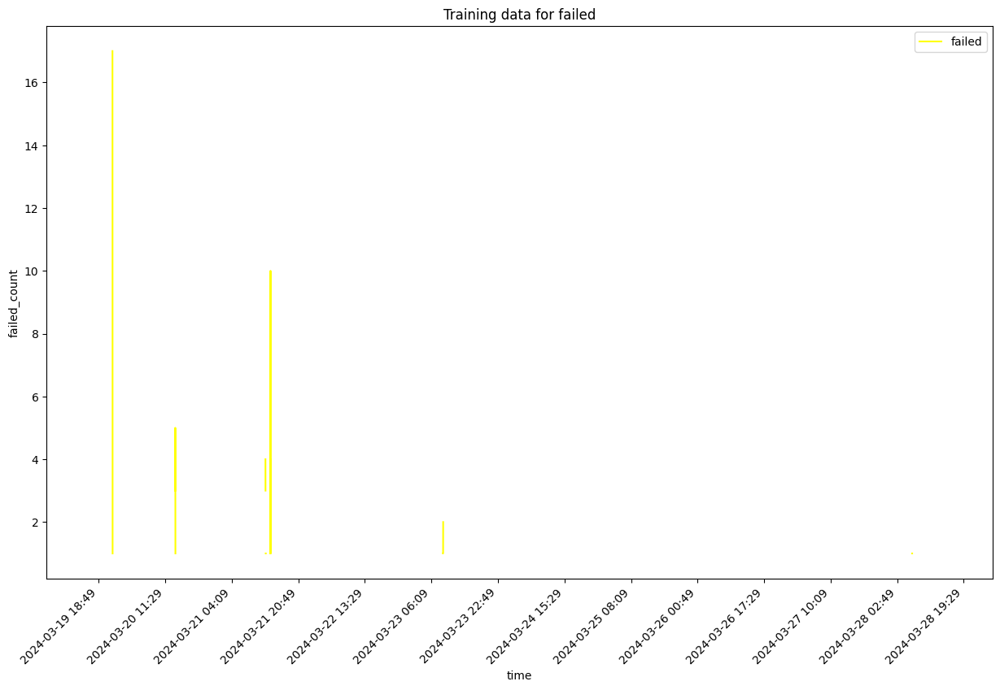

self.df_training shape  13785
Sum of histogram frequencies:  45.0
Number of non-NaN records in column x:  45


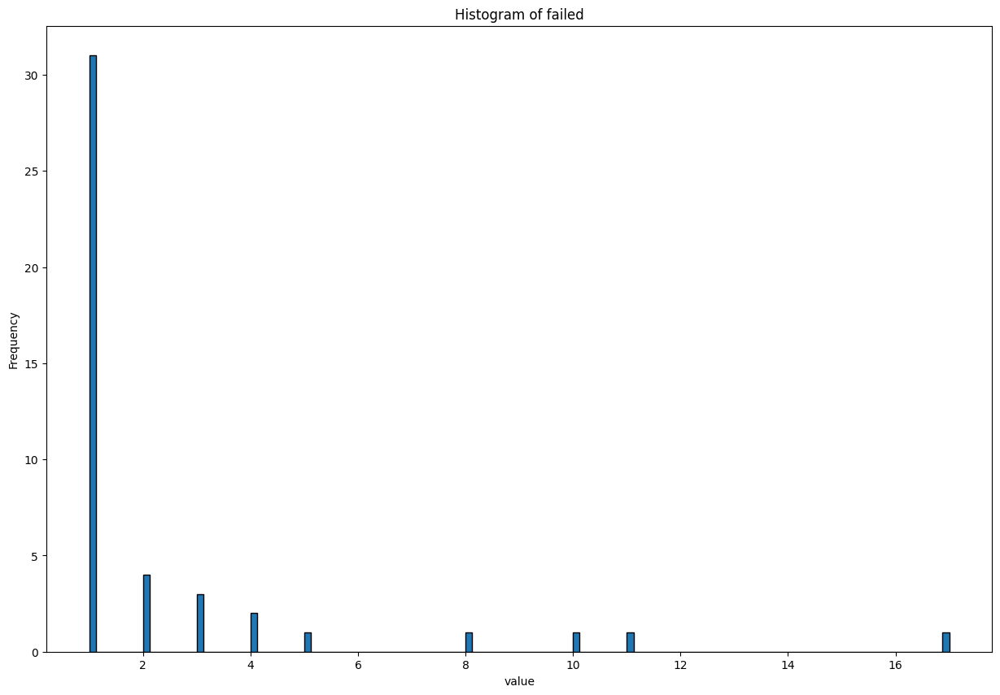

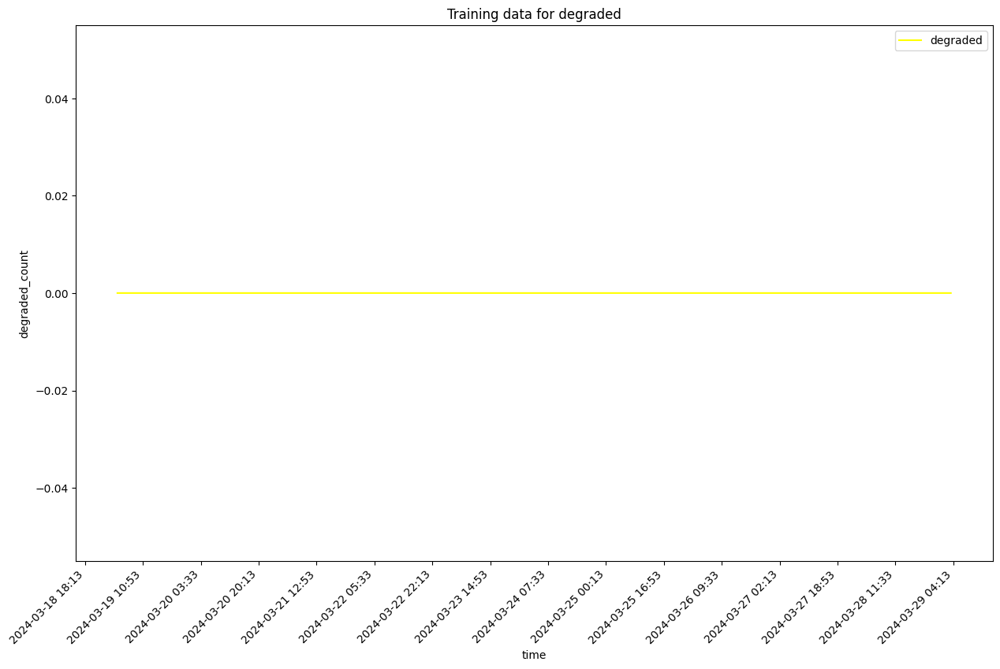

self.df_training shape  13785
Sum of histogram frequencies:  13785.0
Number of non-NaN records in column x:  13785


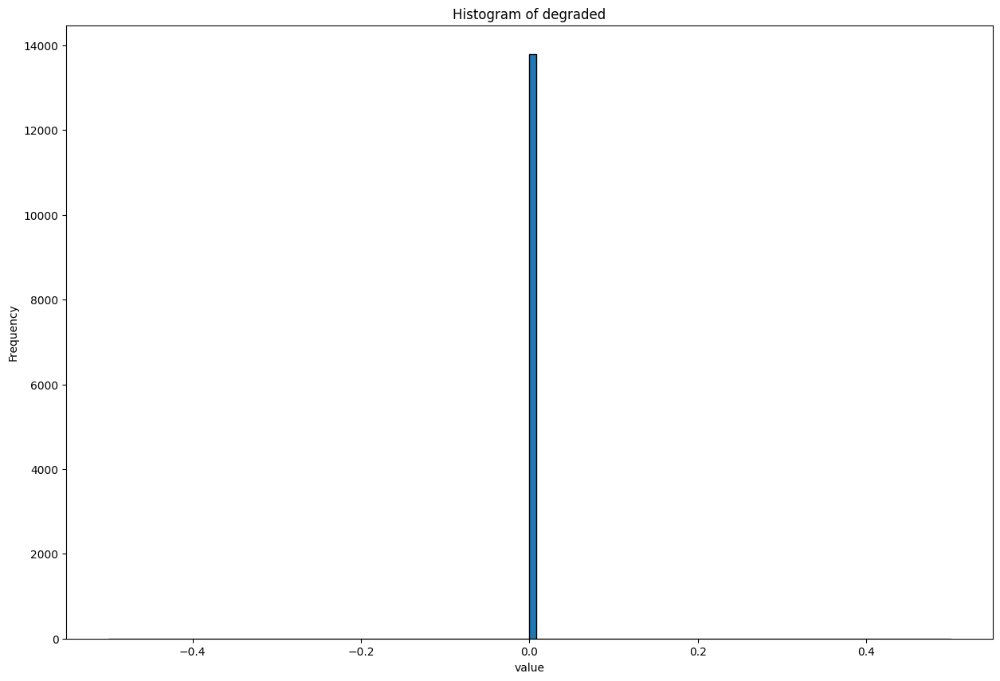

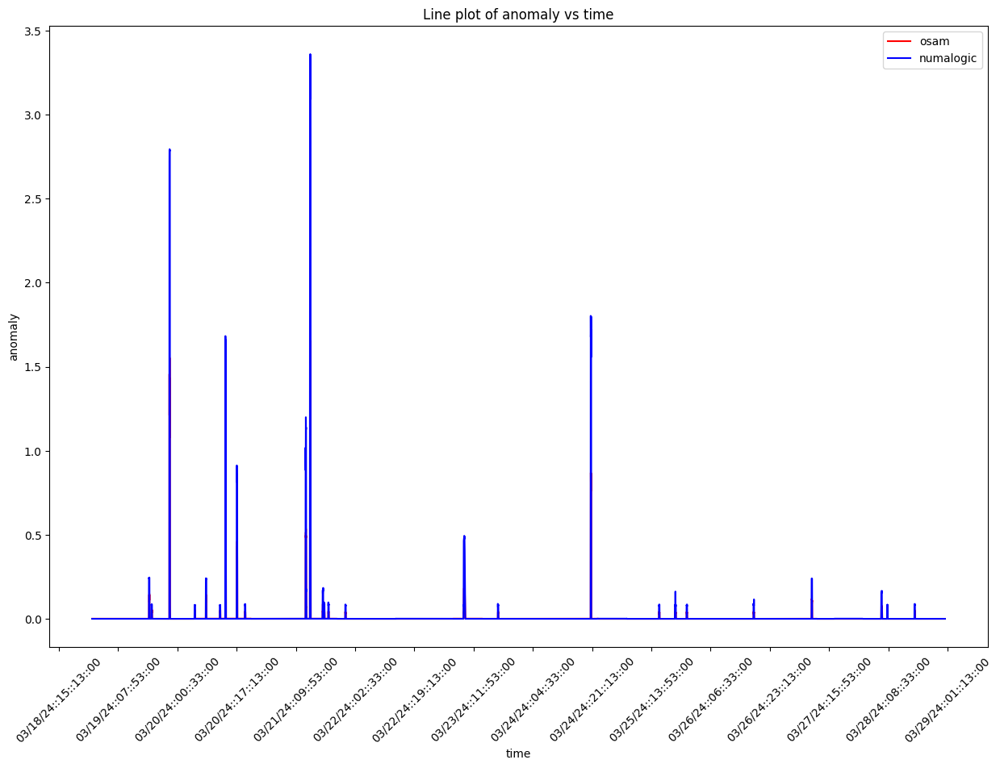

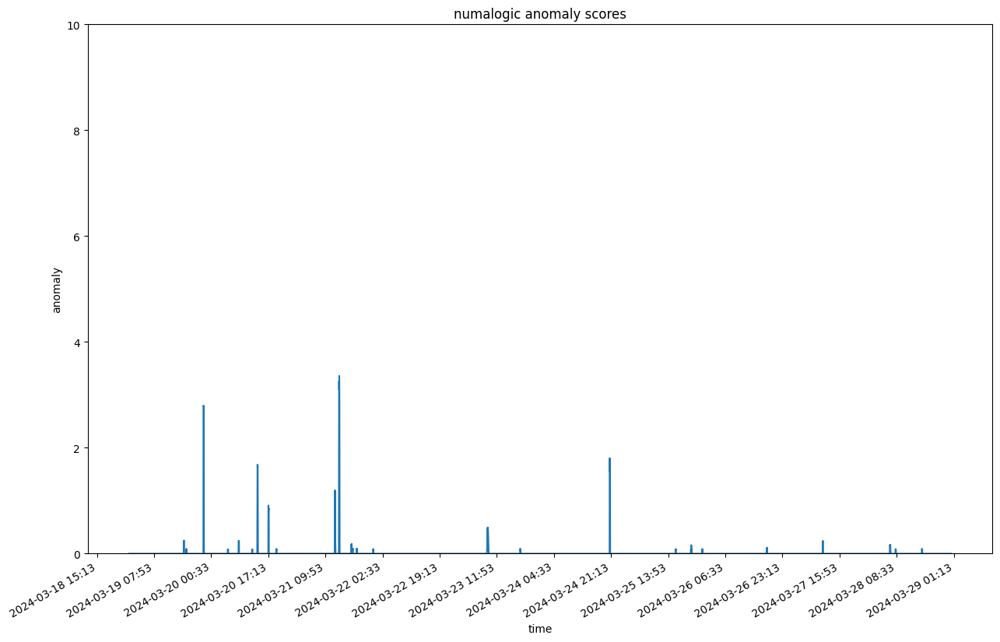

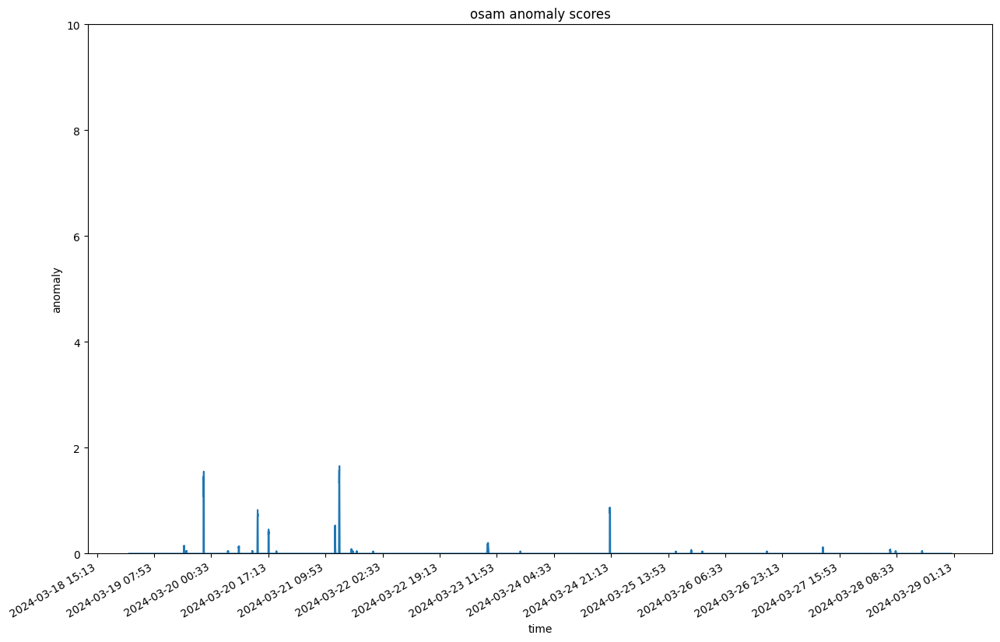

DEBUG:numalogic.connectors.druid._druid:Querying with end_dt: 2024-03-29 03:32:02.824850+00:00, that is with delay of 3 hrs


------------------------------------------------------------
------------------------------------------------------------        ModelId: fciPluginAppInteractions:metrics:2453353489679220423:5984175597303660107:REVIEW_RECIPIENTS       ---------------------------------------------


DEBUG:numalogic.connectors.druid._druid:Druid params: {'datasource': 'tech-ip-customer-interaction-metrics', 'granularity': 'minute', 'intervals': ['2024-03-19T03:32:02.824850+00:00/2024-03-29T03:32:02.824850+00:00'], 'aggregations': {'count': {'type': 'doubleSum', 'fieldName': 'count', 'name': 'count'}}, 'post_aggregations': {}, 'filter': <pydruid.utils.filters.Filter object at 0x2cb299810>, 'dimensions': <map object at 0x2cb07cb50>, 'context': {'timeout': 10000, 'configIds': ['pluginAssetId', 'assetId', 'interactionName'], 'source': 'numalogic'}}, fetch time: 1.0212s
DEBUG:numalogic.udfs.tools:Querying with end_dt: 2024-03-29 00:32:05.847818+00:00, that is with delay of 3 hrs
DEBUG:numalogic.udfs.tools:Querying with end_dt: 2024-03-29 00:32:05.847818+00:00, that is with delay of 3 hrs


--- 2.630479097366333 seconds ---
--- 2.286900043487549 seconds ---


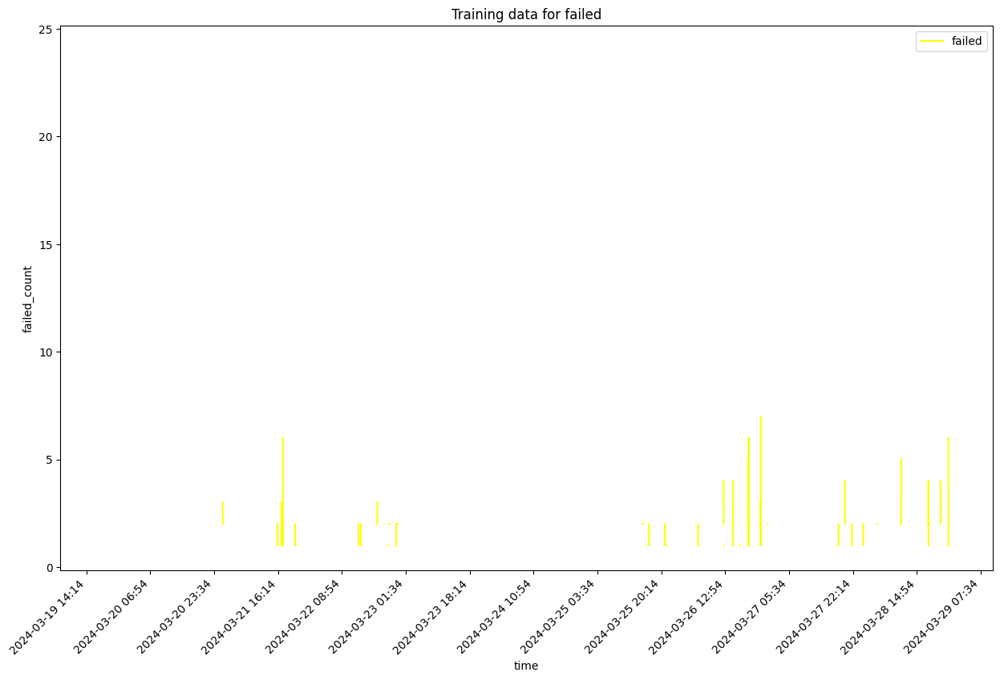

self.df_training shape  9065
Sum of histogram frequencies:  236.0
Number of non-NaN records in column x:  236


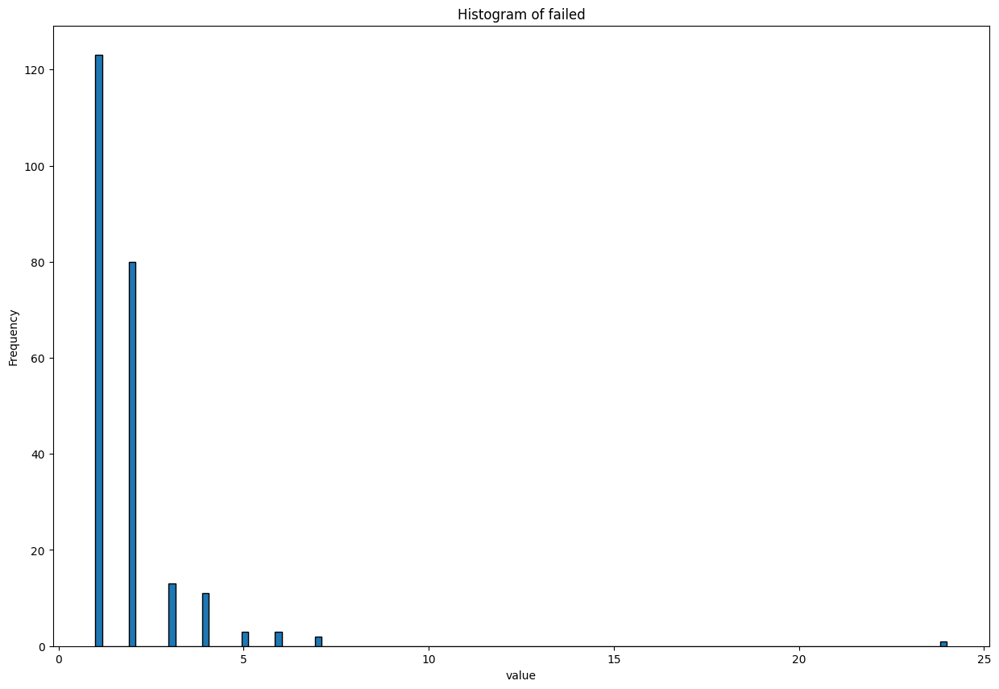

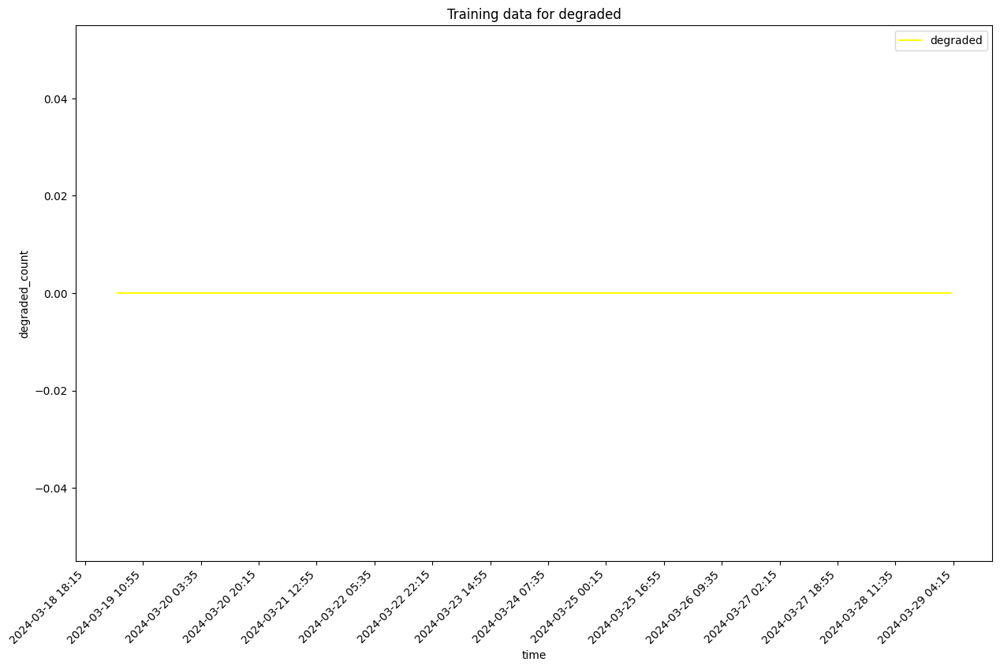

self.df_training shape  9065
Sum of histogram frequencies:  9065.0
Number of non-NaN records in column x:  9065


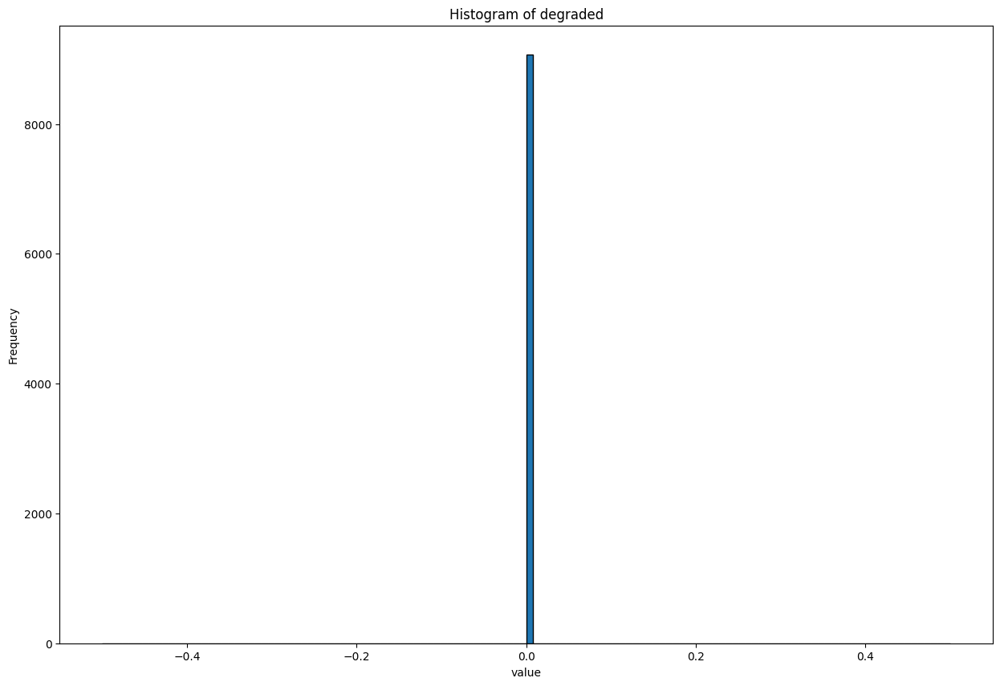

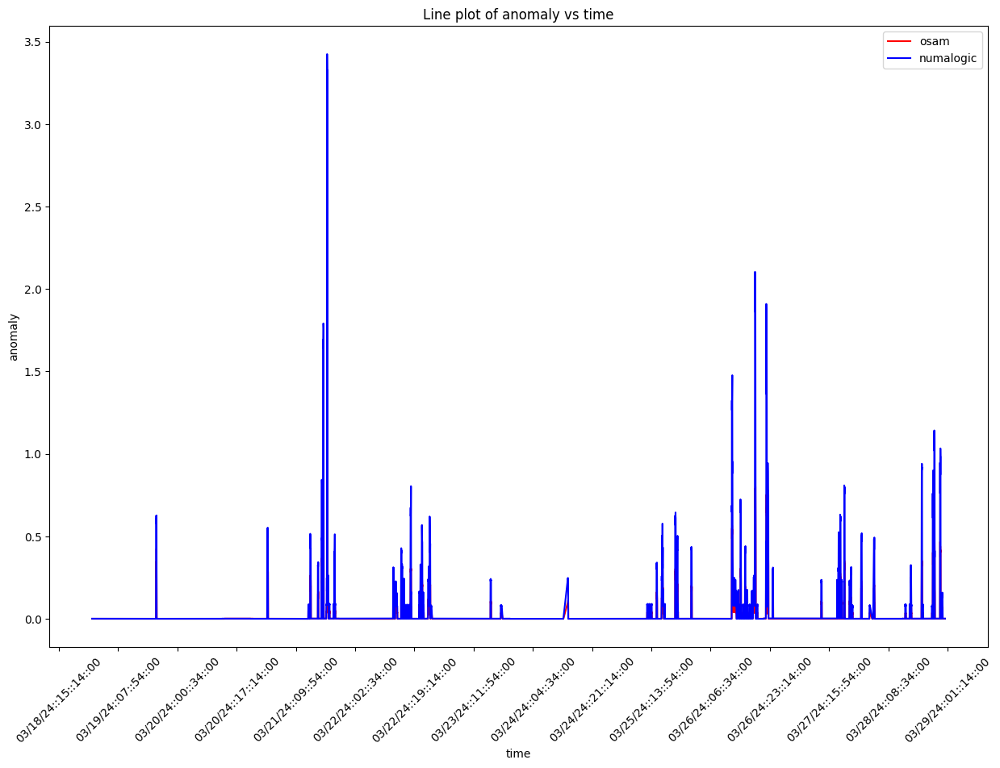

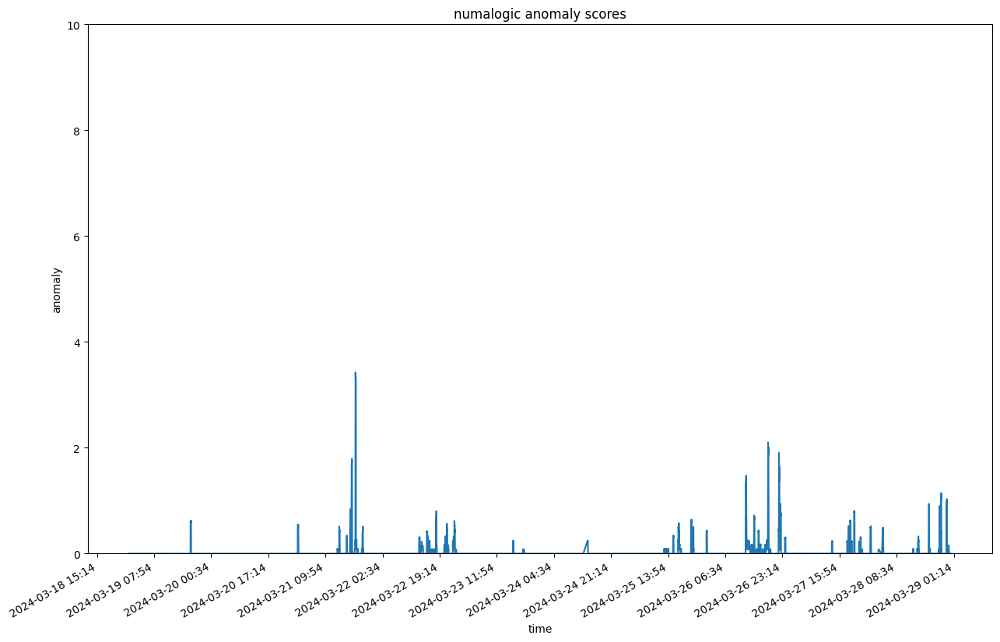

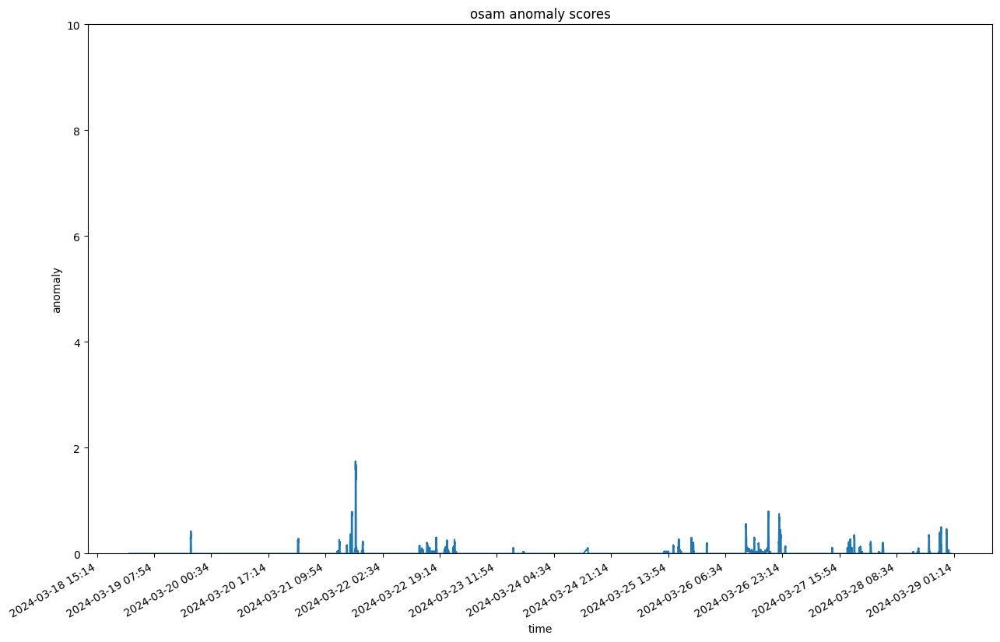

DEBUG:numalogic.connectors.druid._druid:Querying with end_dt: 2024-03-29 03:32:15.114061+00:00, that is with delay of 3 hrs


------------------------------------------------------------
------------------------------------------------------------        ModelId: fciPluginAppInteractions:metrics:3101871835697829167:1876892737053055605:transferToVoicemail       ---------------------------------------------


DEBUG:numalogic.connectors.druid._druid:Druid params: {'datasource': 'tech-ip-customer-interaction-metrics', 'granularity': 'minute', 'intervals': ['2024-03-19T03:32:15.114061+00:00/2024-03-29T03:32:15.114061+00:00'], 'aggregations': {'count': {'type': 'doubleSum', 'fieldName': 'count', 'name': 'count'}}, 'post_aggregations': {}, 'filter': <pydruid.utils.filters.Filter object at 0x2cb954370>, 'dimensions': <map object at 0x1473d0af0>, 'context': {'timeout': 10000, 'configIds': ['pluginAssetId', 'assetId', 'interactionName'], 'source': 'numalogic'}}, fetch time: 0.7621s
DEBUG:numalogic.udfs.tools:Querying with end_dt: 2024-03-29 00:32:17.881763+00:00, that is with delay of 3 hrs
DEBUG:numalogic.udfs.tools:Querying with end_dt: 2024-03-29 00:32:17.881763+00:00, that is with delay of 3 hrs


--- 2.647310972213745 seconds ---
--- 1.4752418994903564 seconds ---


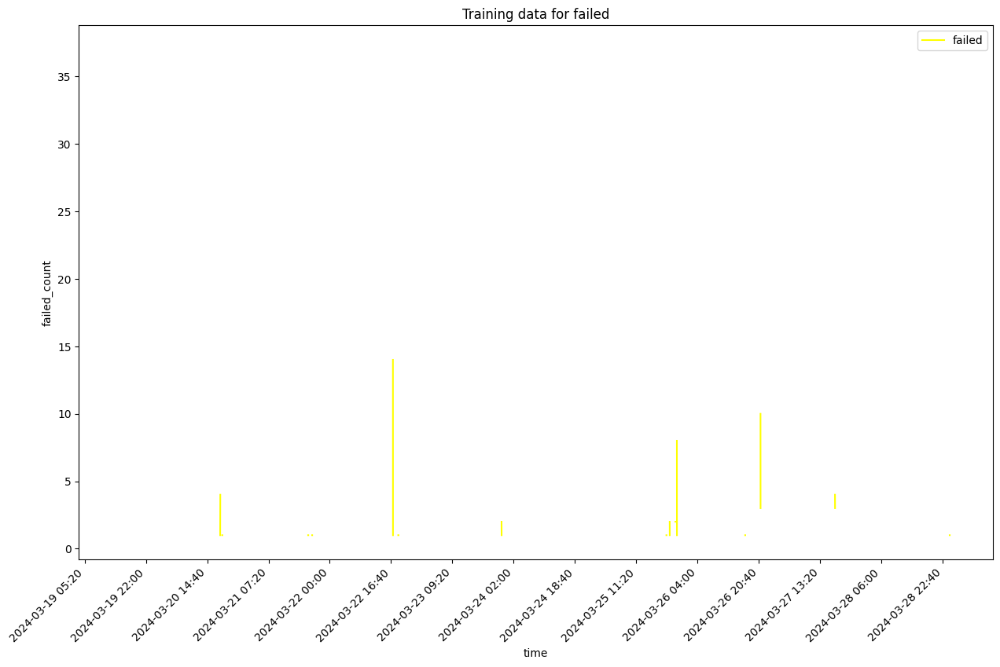

self.df_training shape  6476
Sum of histogram frequencies:  218.0
Number of non-NaN records in column x:  218


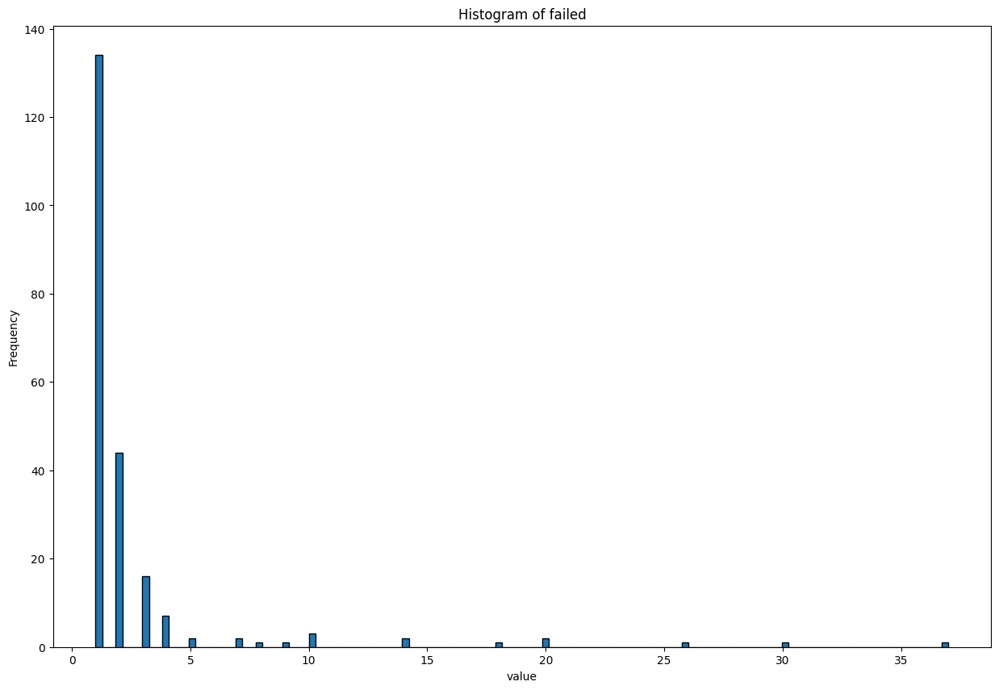

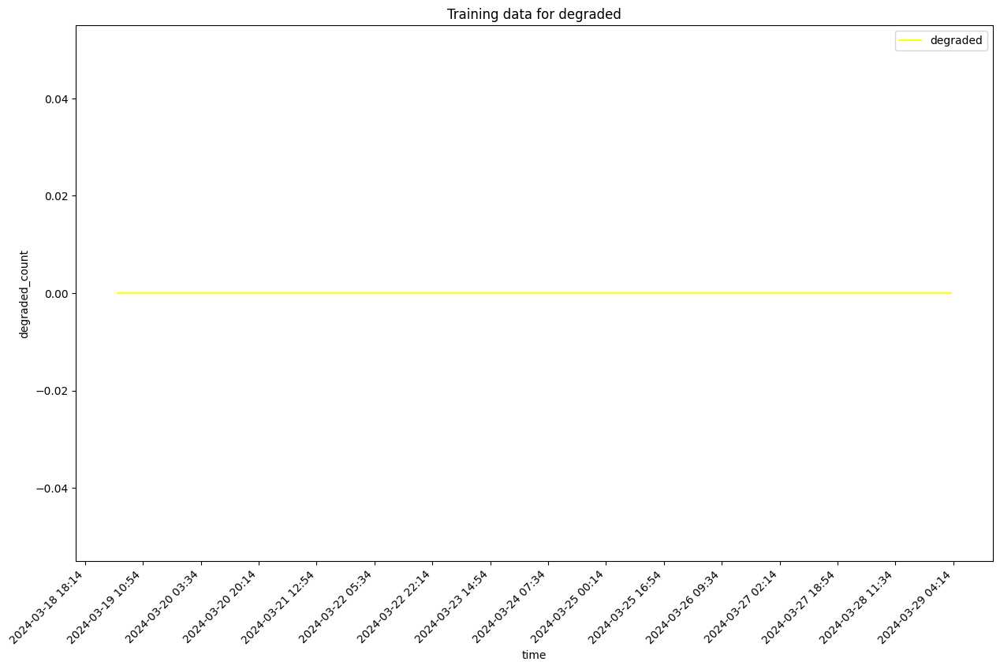

self.df_training shape  6476
Sum of histogram frequencies:  6476.0
Number of non-NaN records in column x:  6476


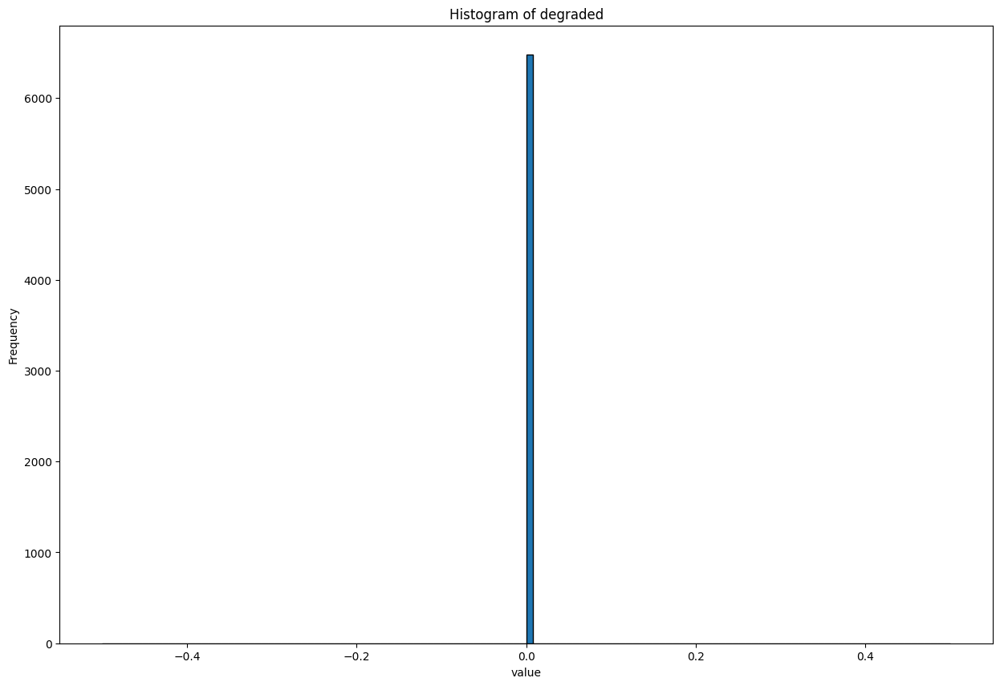

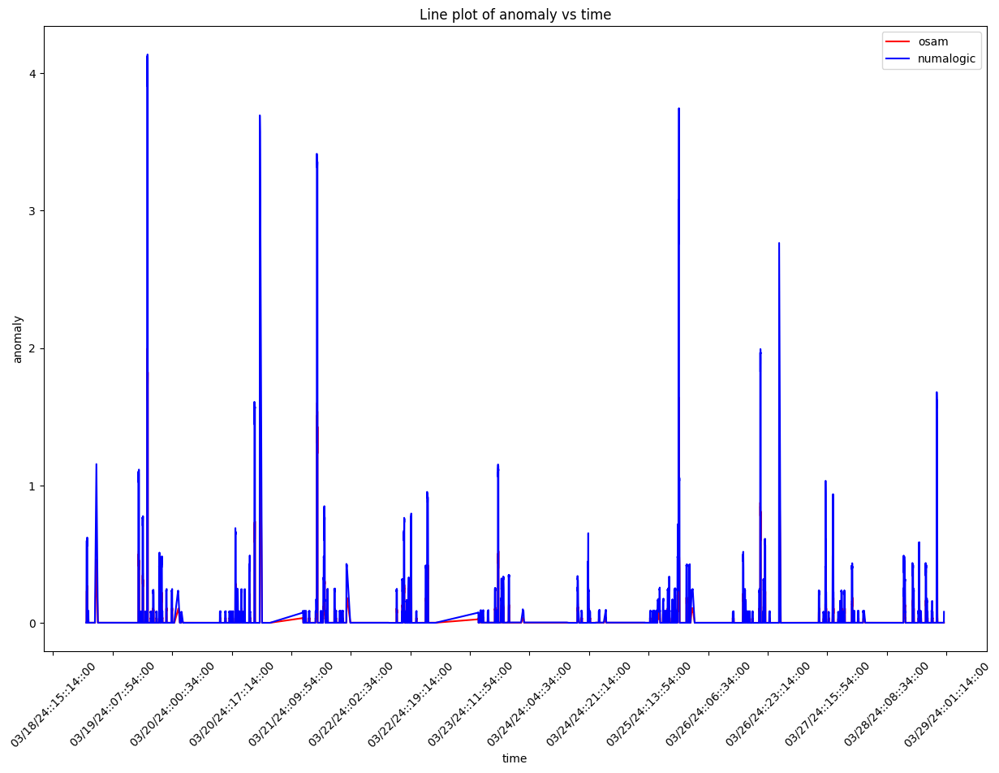

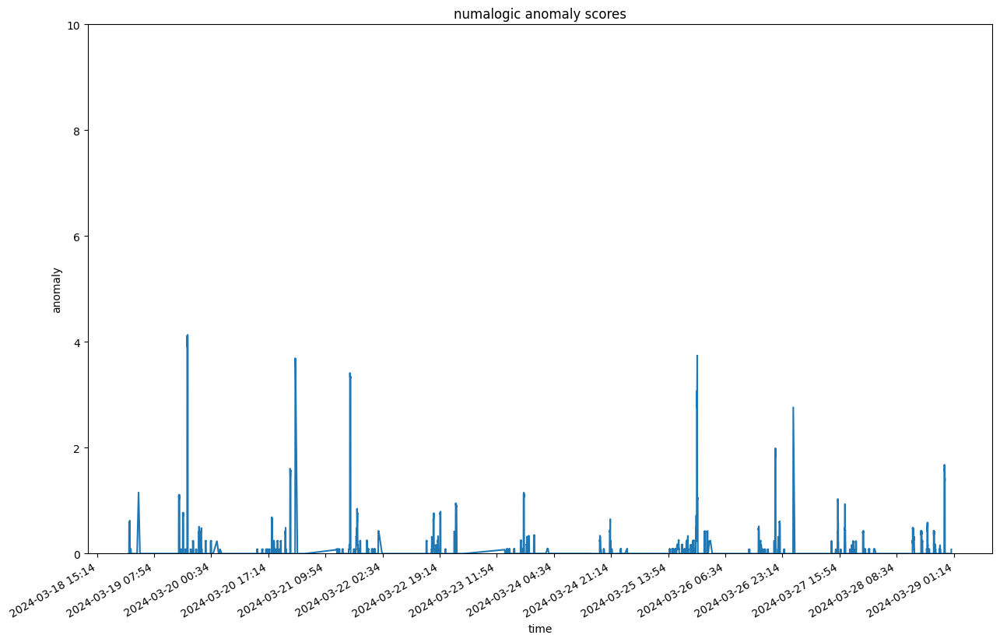

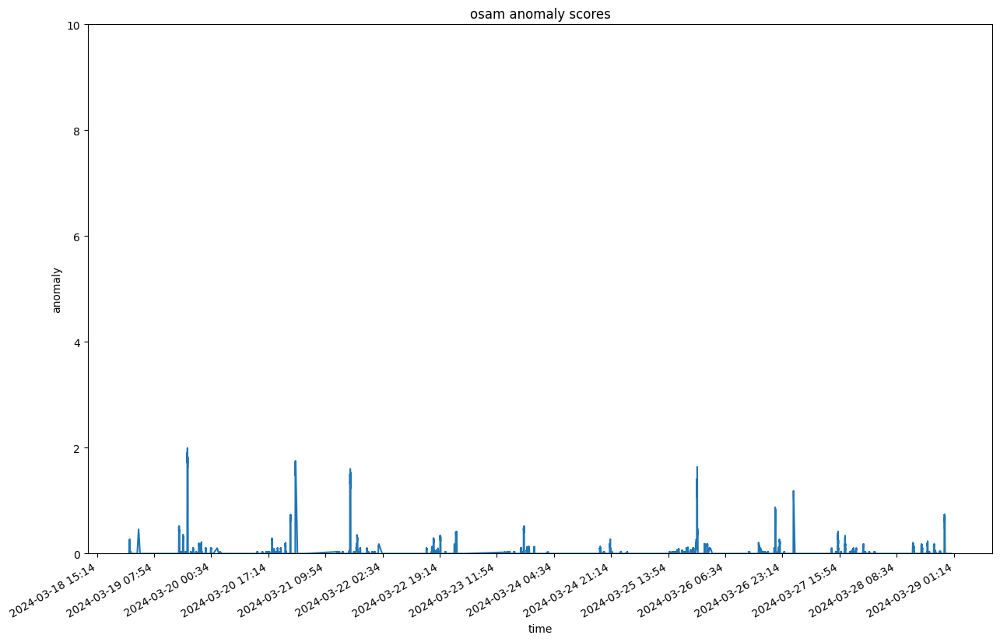

DEBUG:numalogic.connectors.druid._druid:Querying with end_dt: 2024-03-29 03:32:26.245688+00:00, that is with delay of 3 hrs


------------------------------------------------------------
------------------------------------------------------------        ModelId: fciPluginInteractions:metrics:8217961012385696693:Collab_Docmgmt_UI_Get_Files_By_Ids_Elastic_Search       ---------------------------------------------


DEBUG:numalogic.connectors.druid._druid:Druid params: {'datasource': 'tech-ip-customer-interaction-metrics', 'granularity': 'minute', 'intervals': ['2024-03-19T03:32:26.245688+00:00/2024-03-29T03:32:26.245688+00:00'], 'aggregations': {'count': {'type': 'doubleSum', 'fieldName': 'count', 'name': 'count'}}, 'post_aggregations': {}, 'filter': <pydruid.utils.filters.Filter object at 0x2cb0b1750>, 'dimensions': <map object at 0x2cb0b3490>, 'context': {'timeout': 10000, 'configIds': ['pluginAssetId', 'interactionName'], 'source': 'numalogic'}}, fetch time: 1.2858s
DEBUG:numalogic.udfs.tools:Querying with end_dt: 2024-03-29 00:32:29.537710+00:00, that is with delay of 3 hrs
DEBUG:numalogic.udfs.tools:Querying with end_dt: 2024-03-29 00:32:29.537710+00:00, that is with delay of 3 hrs


--- 2.8549742698669434 seconds ---
--- 2.678244113922119 seconds ---


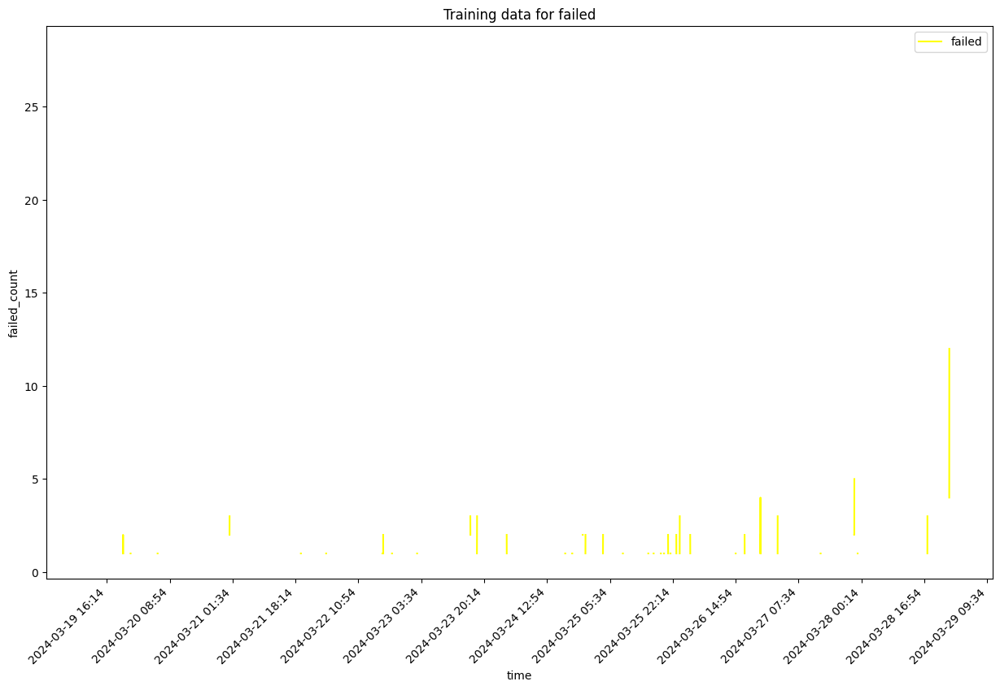

self.df_training shape  13930
Sum of histogram frequencies:  263.0
Number of non-NaN records in column x:  263


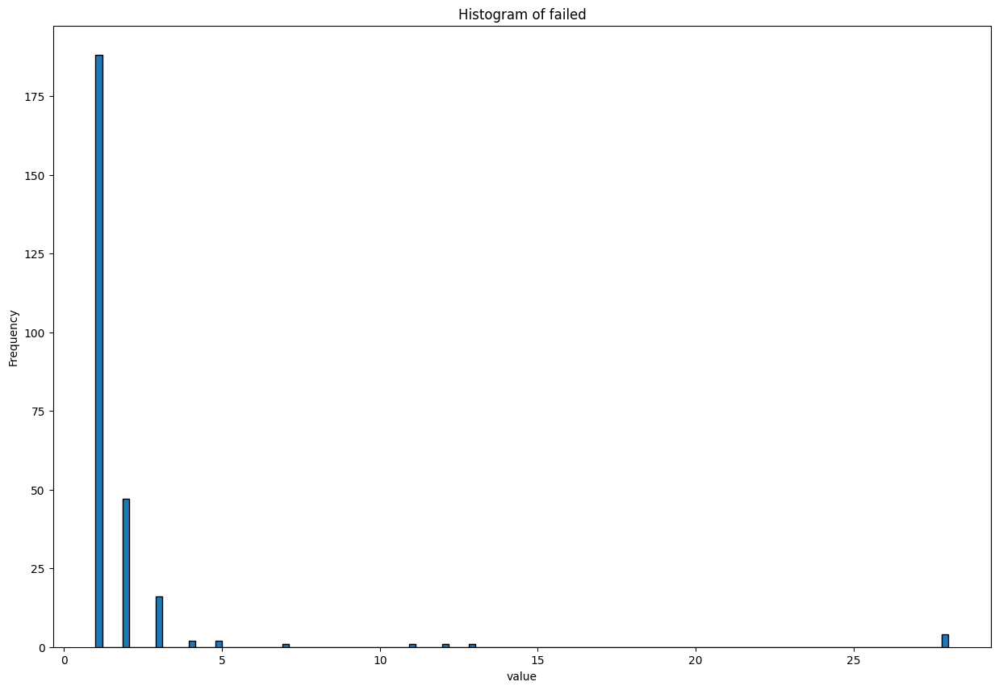

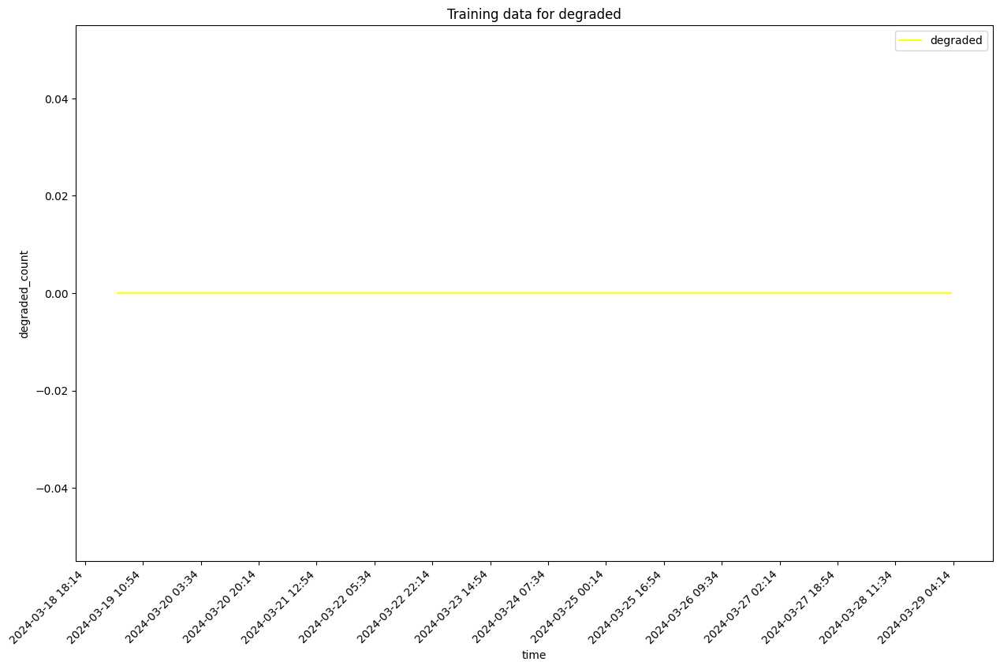

self.df_training shape  13930
Sum of histogram frequencies:  13930.0
Number of non-NaN records in column x:  13930


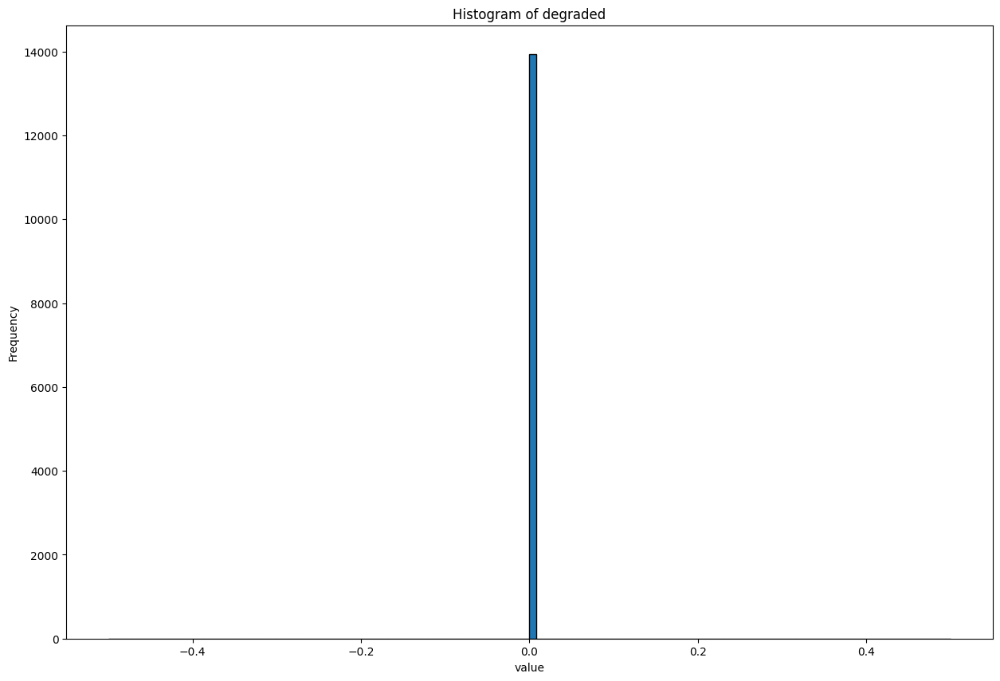

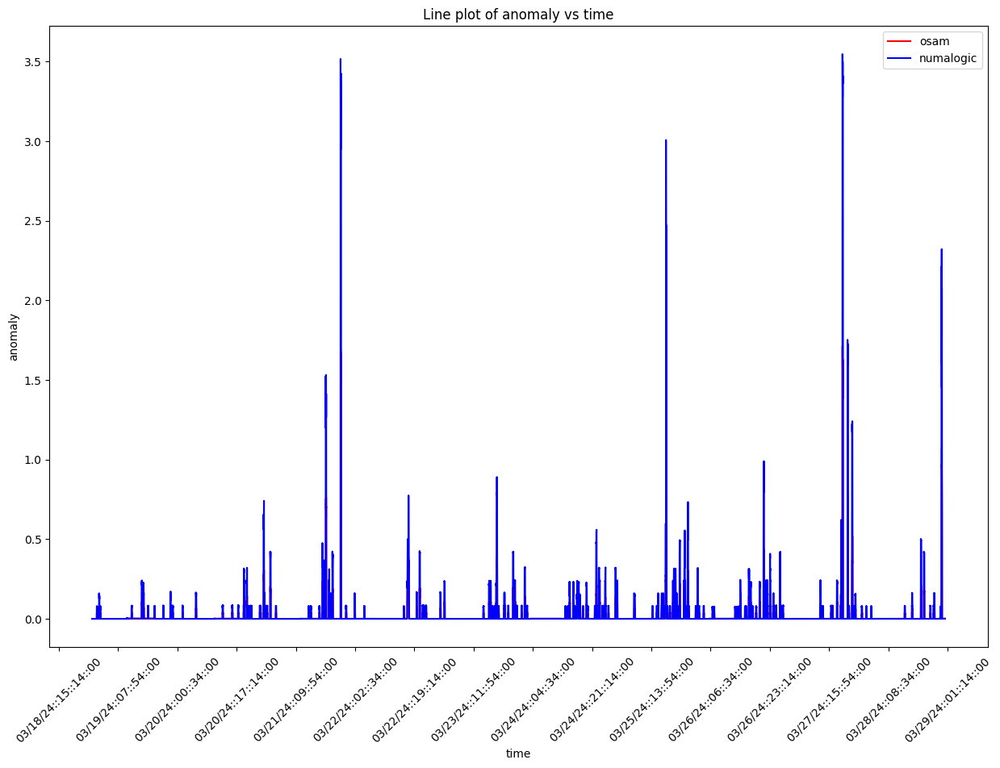

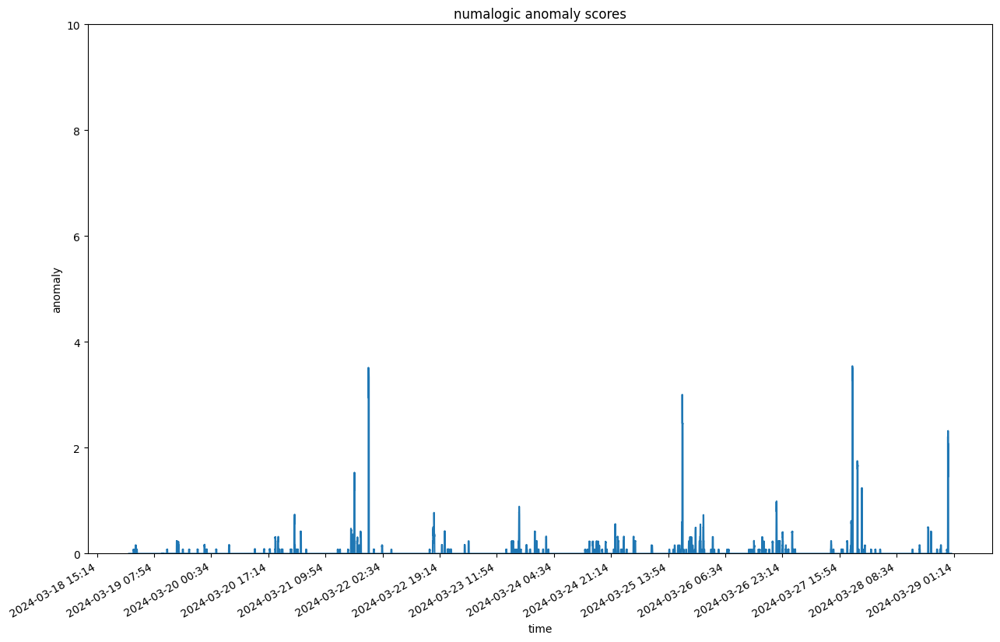

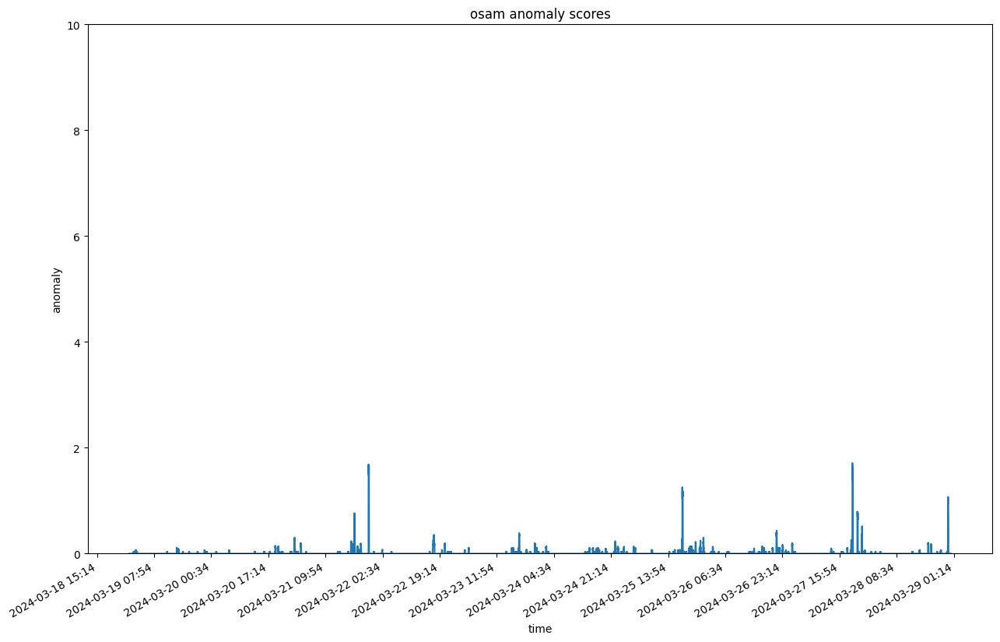

DEBUG:numalogic.connectors.druid._druid:Querying with end_dt: 2024-03-29 03:32:39.690366+00:00, that is with delay of 3 hrs


------------------------------------------------------------
------------------------------------------------------------        ModelId: fciPluginAppInteractions:metrics:3750390182735137211:5984175597303660107:EXECUTE_PAGINATED_REPORT       ---------------------------------------------


DEBUG:numalogic.connectors.druid._druid:Druid params: {'datasource': 'tech-ip-customer-interaction-metrics', 'granularity': 'minute', 'intervals': ['2024-03-19T03:32:39.690366+00:00/2024-03-29T03:32:39.690366+00:00'], 'aggregations': {'count': {'type': 'doubleSum', 'fieldName': 'count', 'name': 'count'}}, 'post_aggregations': {}, 'filter': <pydruid.utils.filters.Filter object at 0x2cb219570>, 'dimensions': <map object at 0x2cb04e7a0>, 'context': {'timeout': 10000, 'configIds': ['pluginAssetId', 'assetId', 'interactionName'], 'source': 'numalogic'}}, fetch time: 1.4377s
DEBUG:numalogic.udfs.tools:Querying with end_dt: 2024-03-29 00:32:43.133109+00:00, that is with delay of 3 hrs
DEBUG:numalogic.udfs.tools:Querying with end_dt: 2024-03-29 00:32:43.133109+00:00, that is with delay of 3 hrs


--- 2.753722906112671 seconds ---
--- 3.0524842739105225 seconds ---


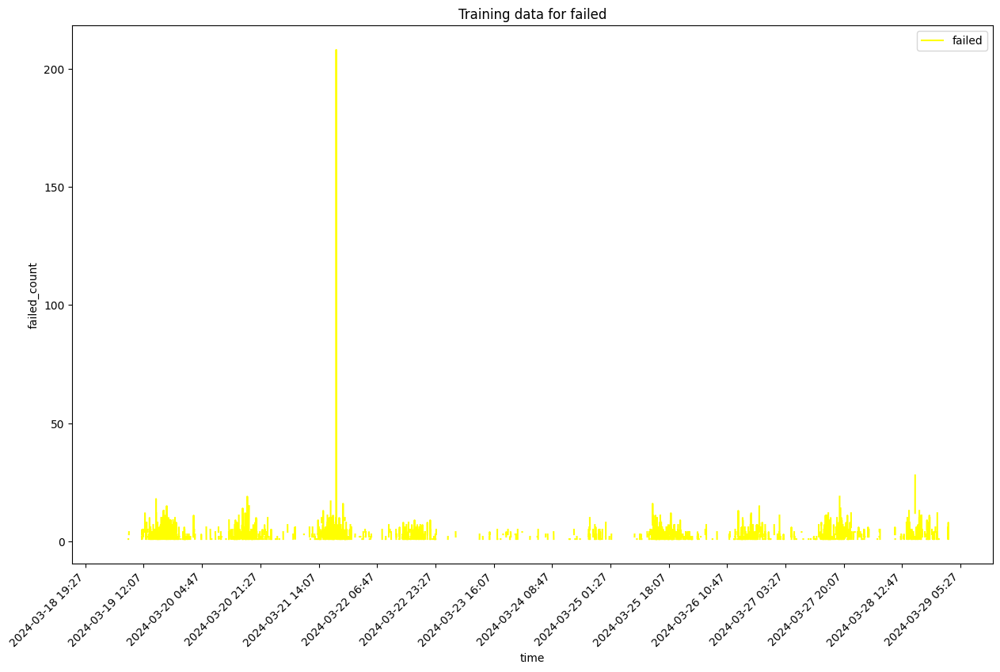

self.df_training shape  14400
Sum of histogram frequencies:  3226.0
Number of non-NaN records in column x:  3226


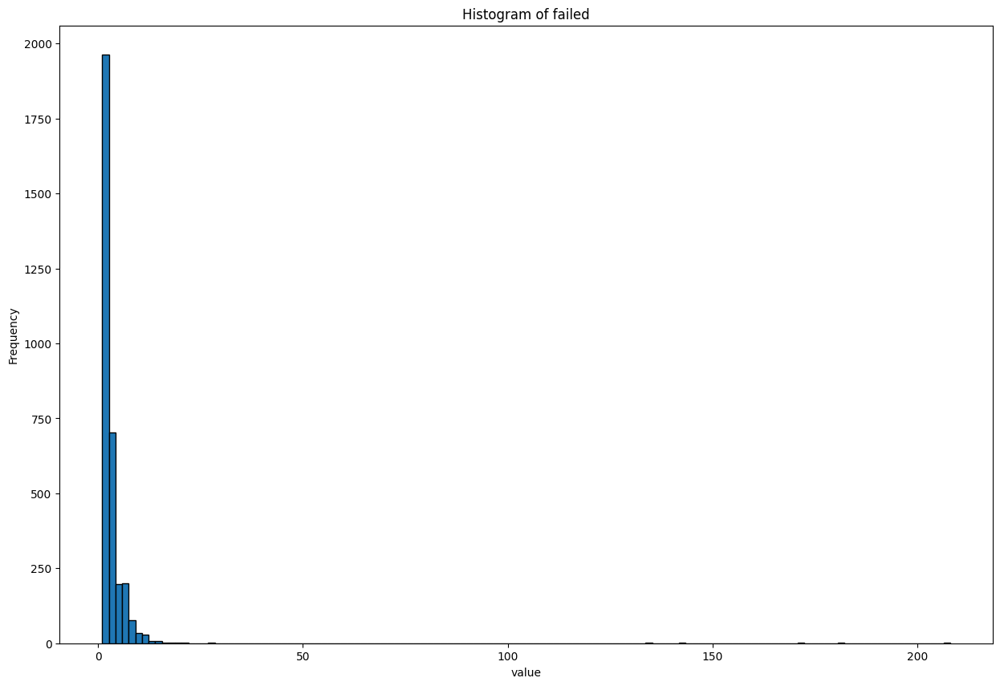

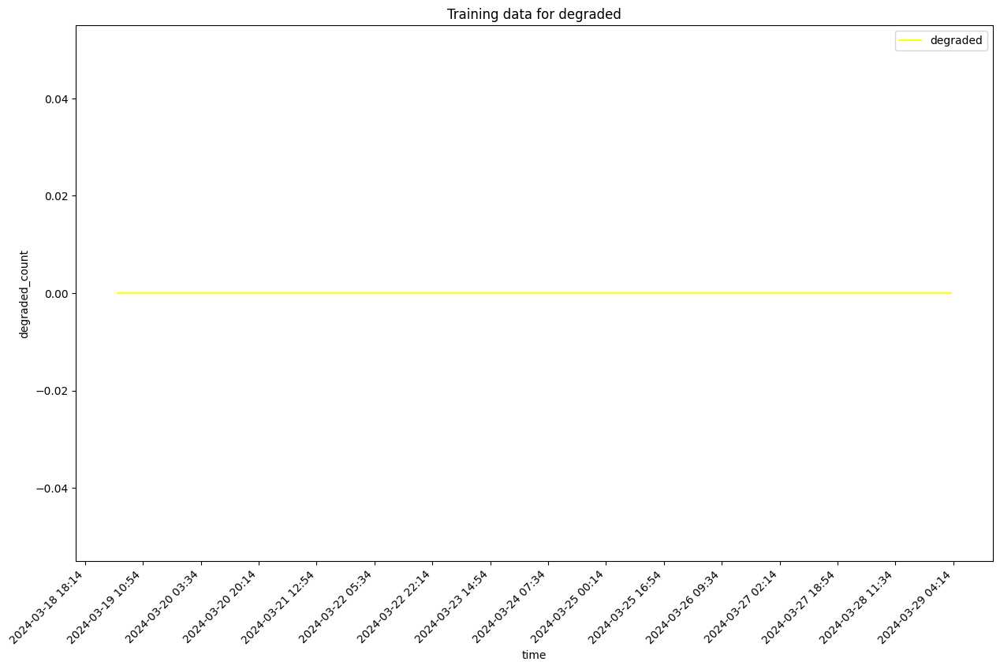

self.df_training shape  14400
Sum of histogram frequencies:  14400.0
Number of non-NaN records in column x:  14400


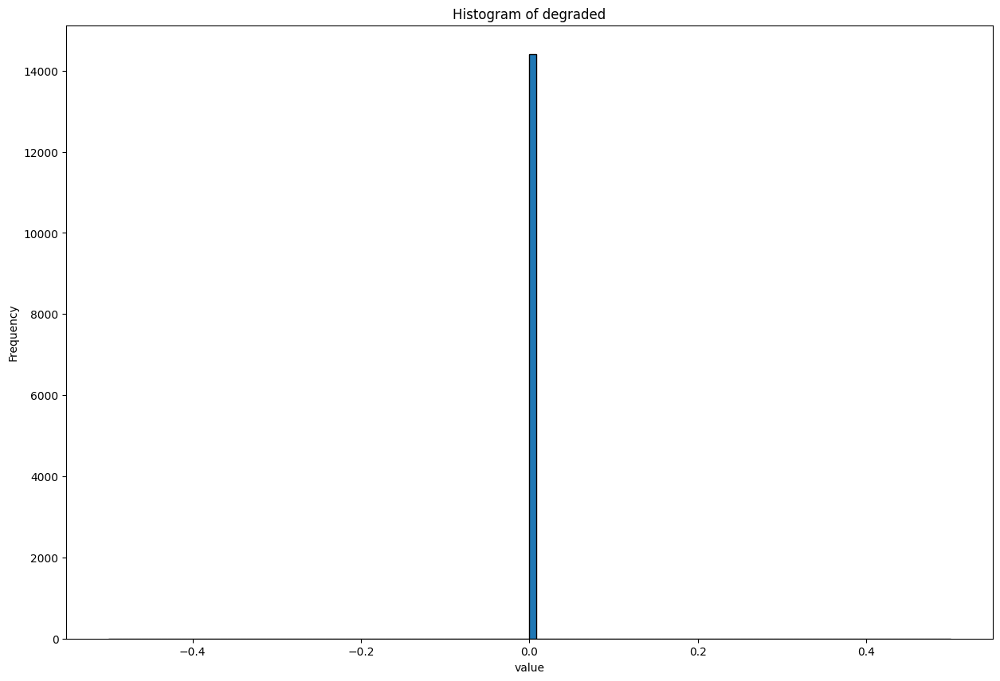

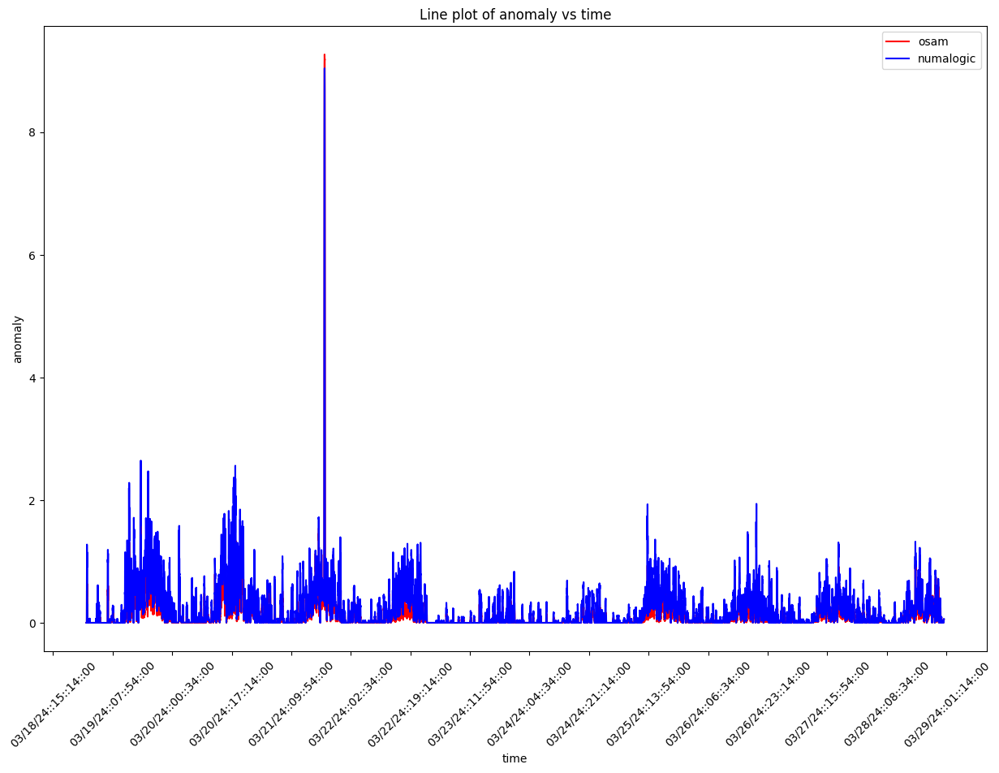

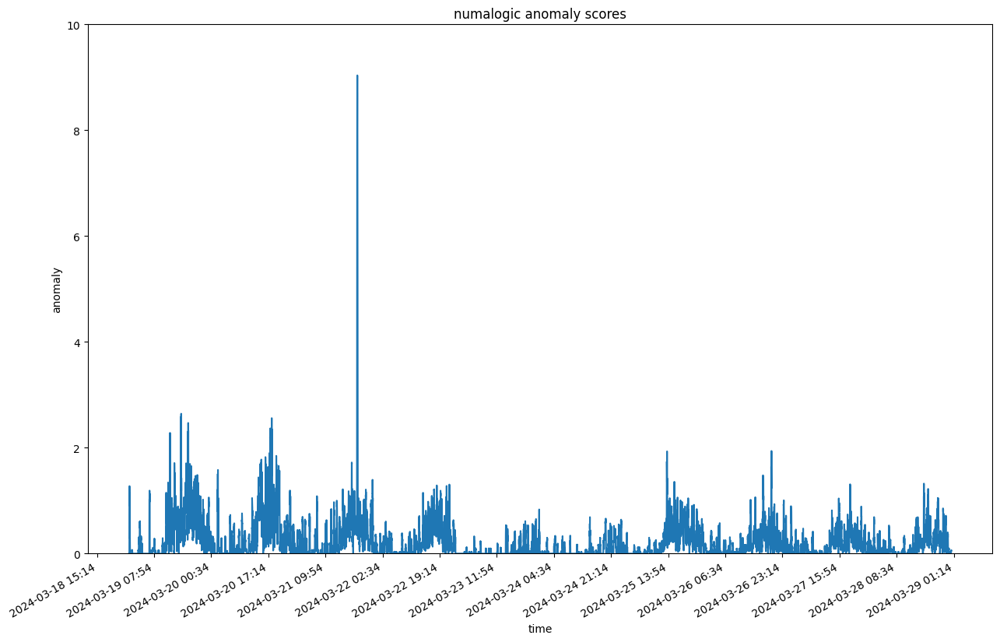

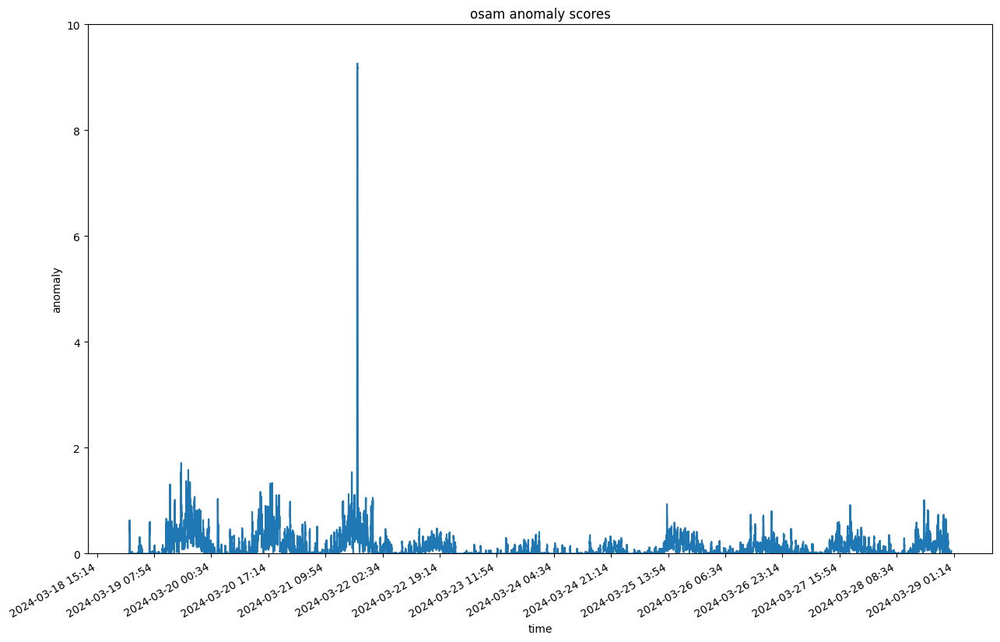

DEBUG:numalogic.connectors.druid._druid:Querying with end_dt: 2024-03-29 03:32:53.587598+00:00, that is with delay of 3 hrs


------------------------------------------------------------
------------------------------------------------------------        ModelId: fci:interactionsFailed:1876892737053055605:transferToVoicemail       ---------------------------------------------


DEBUG:numalogic.connectors.druid._druid:Druid params: {'datasource': 'tech-ip-customer-interaction-metrics', 'granularity': 'minute', 'intervals': ['2024-03-19T03:32:53.587598+00:00/2024-03-29T03:32:53.587598+00:00'], 'aggregations': {'count': {'type': 'doubleSum', 'fieldName': 'count', 'name': 'count'}}, 'post_aggregations': {}, 'filter': <pydruid.utils.filters.Filter object at 0x2cb2836d0>, 'dimensions': <map object at 0x2cb282f80>, 'context': {'timeout': 10000, 'configIds': ['assetId', 'interactionName'], 'source': 'numalogic'}}, fetch time: 0.7376s
DEBUG:numalogic.udfs.tools:Querying with end_dt: 2024-03-29 00:32:56.328475+00:00, that is with delay of 3 hrs
DEBUG:numalogic.udfs.tools:Querying with end_dt: 2024-03-29 00:32:56.328475+00:00, that is with delay of 3 hrs


--- 1.9967479705810547 seconds ---
--- 3.4009268283843994 seconds ---


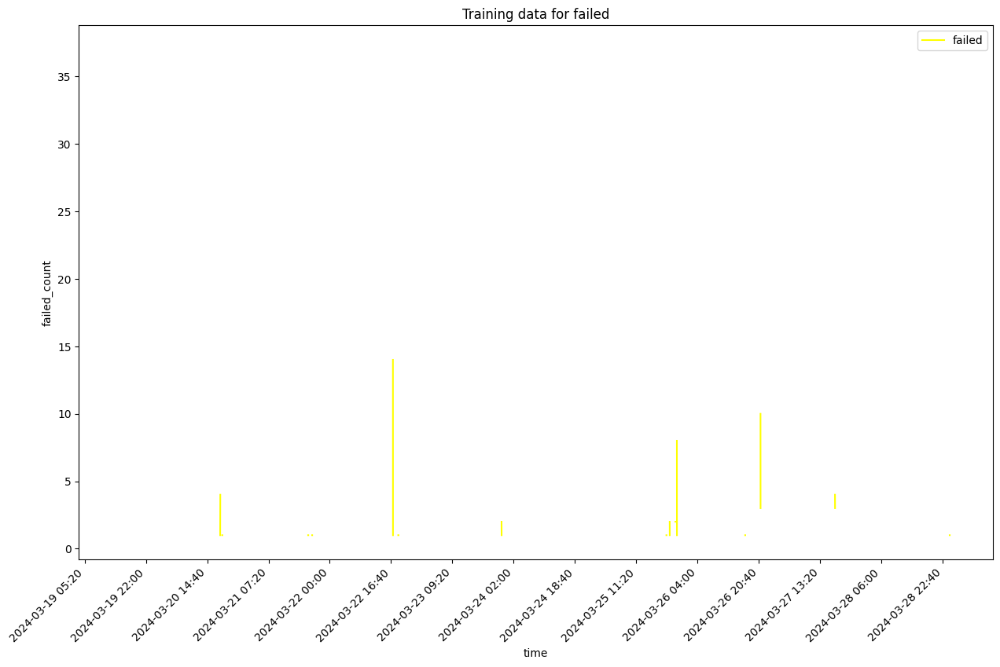

self.df_training shape  6476
Sum of histogram frequencies:  218.0
Number of non-NaN records in column x:  218


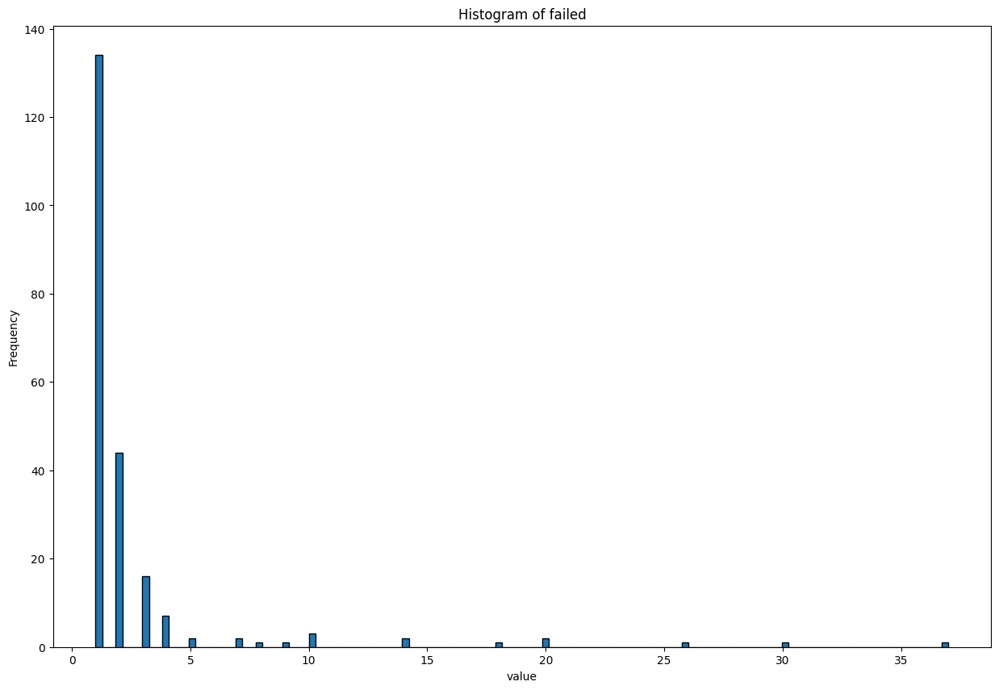

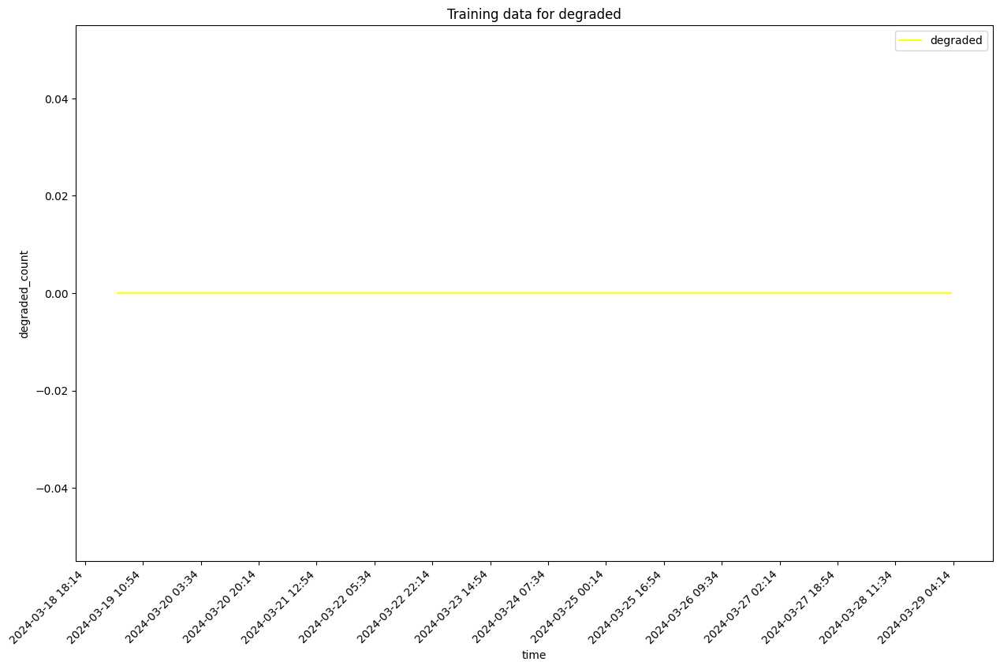

self.df_training shape  6476
Sum of histogram frequencies:  6476.0
Number of non-NaN records in column x:  6476


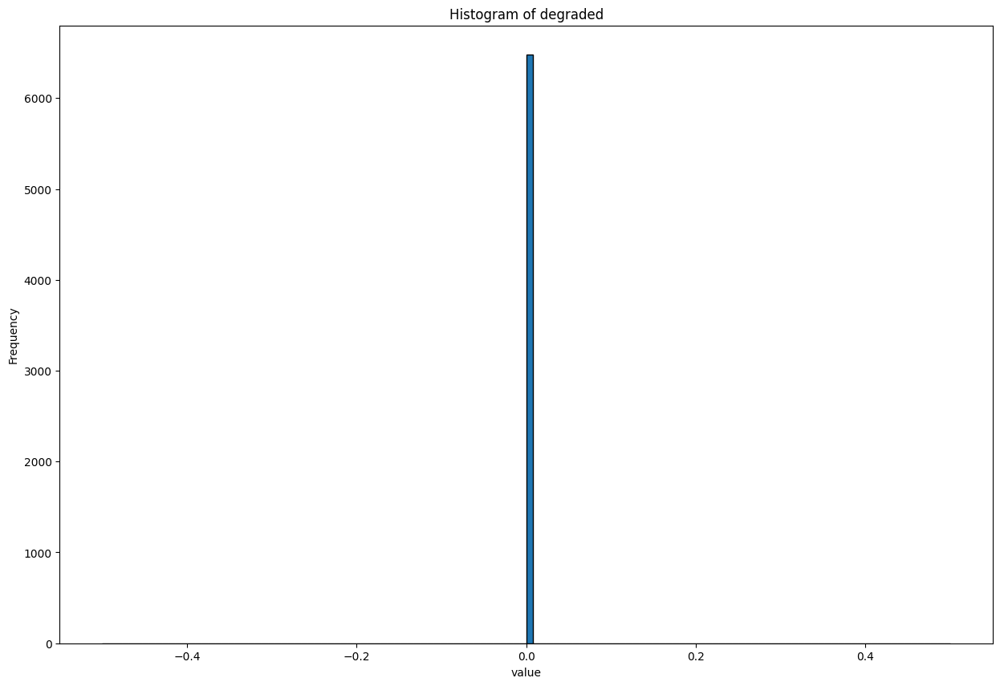

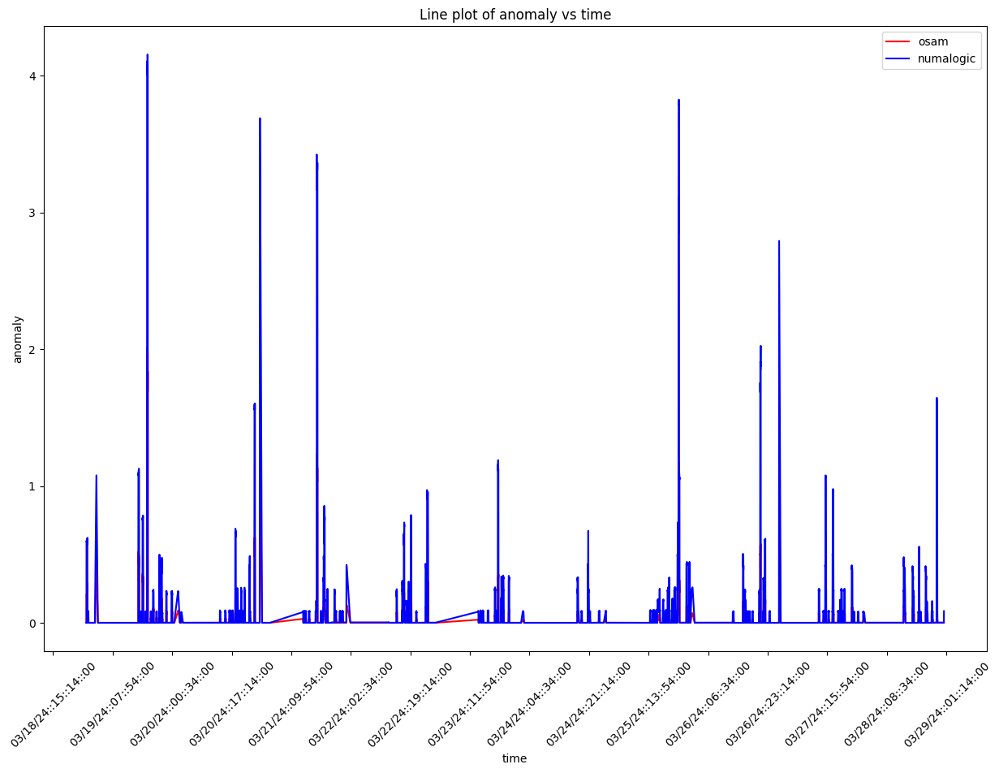

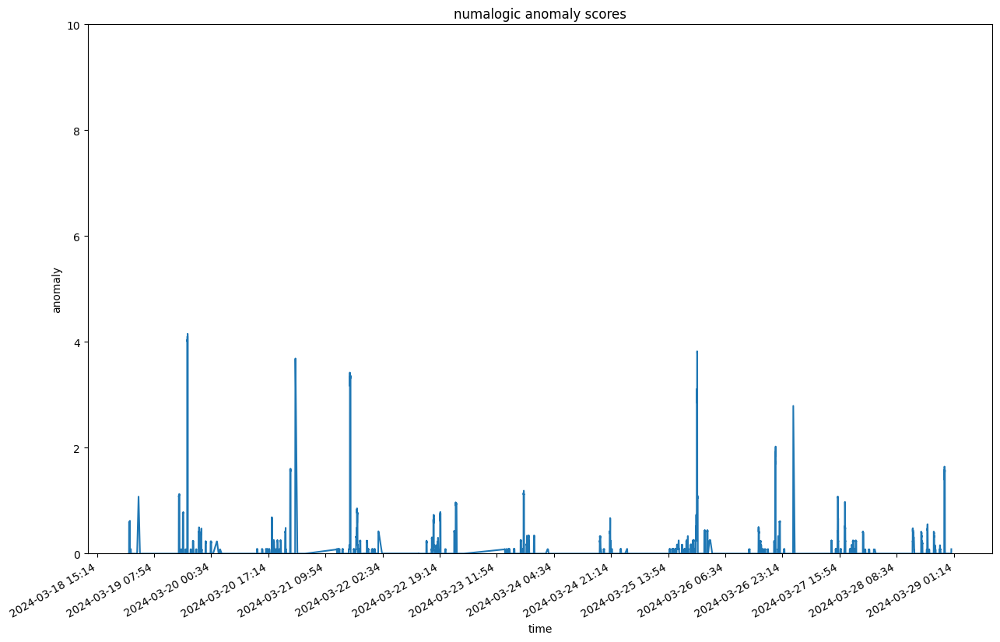

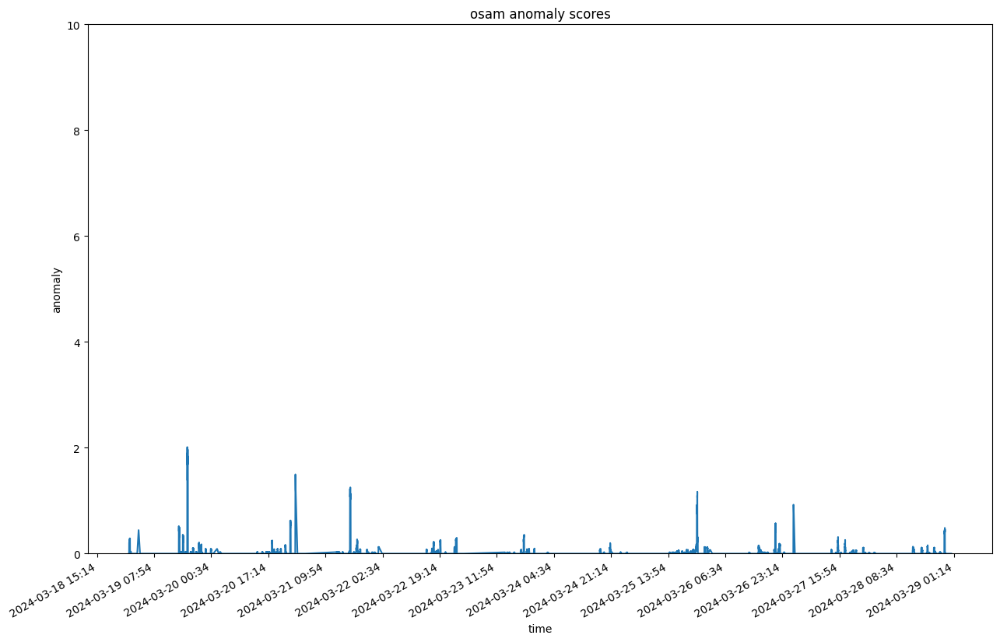

DEBUG:numalogic.connectors.druid._druid:Querying with end_dt: 2024-03-29 03:33:05.972484+00:00, that is with delay of 3 hrs


------------------------------------------------------------
------------------------------------------------------------        ModelId: fciPluginAppInteractions:metrics:579856044409078427:5477520638979968238:GenAi Explanations       ---------------------------------------------


DEBUG:numalogic.connectors.druid._druid:Druid params: {'datasource': 'tech-ip-customer-interaction-metrics', 'granularity': 'minute', 'intervals': ['2024-03-19T03:33:05.972484+00:00/2024-03-29T03:33:05.972484+00:00'], 'aggregations': {'count': {'type': 'doubleSum', 'fieldName': 'count', 'name': 'count'}}, 'post_aggregations': {}, 'filter': <pydruid.utils.filters.Filter object at 0x2cb0b3fa0>, 'dimensions': <map object at 0x2cb4f3fa0>, 'context': {'timeout': 10000, 'configIds': ['pluginAssetId', 'assetId', 'interactionName'], 'source': 'numalogic'}}, fetch time: 1.4087s
DEBUG:numalogic.udfs.tools:Querying with end_dt: 2024-03-29 00:33:09.385699+00:00, that is with delay of 3 hrs
DEBUG:numalogic.udfs.tools:Querying with end_dt: 2024-03-29 00:33:09.385699+00:00, that is with delay of 3 hrs


--- 2.9533212184906006 seconds ---
--- 2.731799840927124 seconds ---


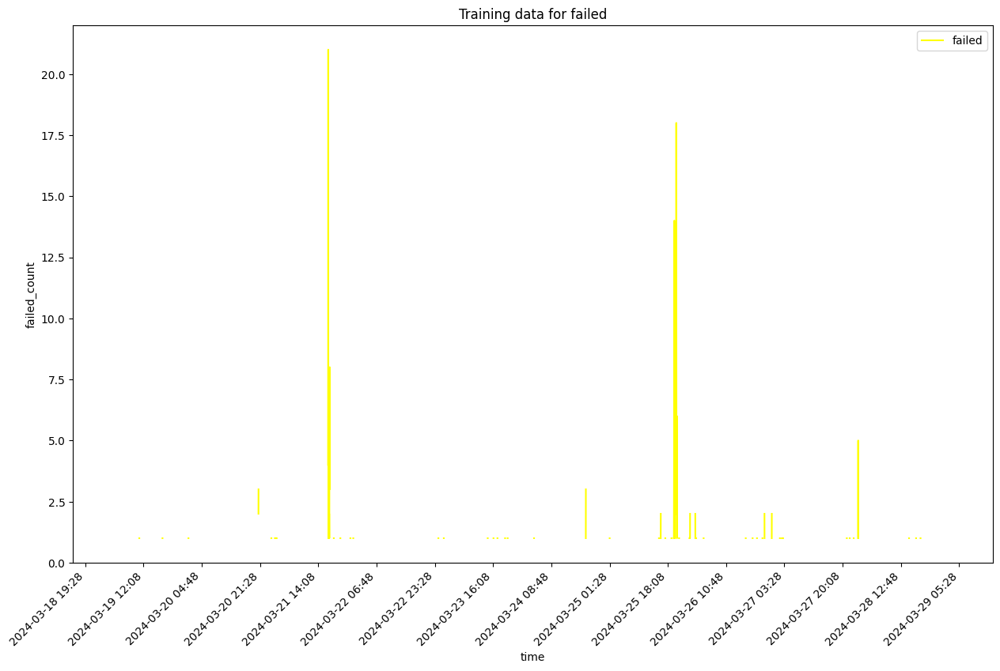

self.df_training shape  14201
Sum of histogram frequencies:  757.0
Number of non-NaN records in column x:  757


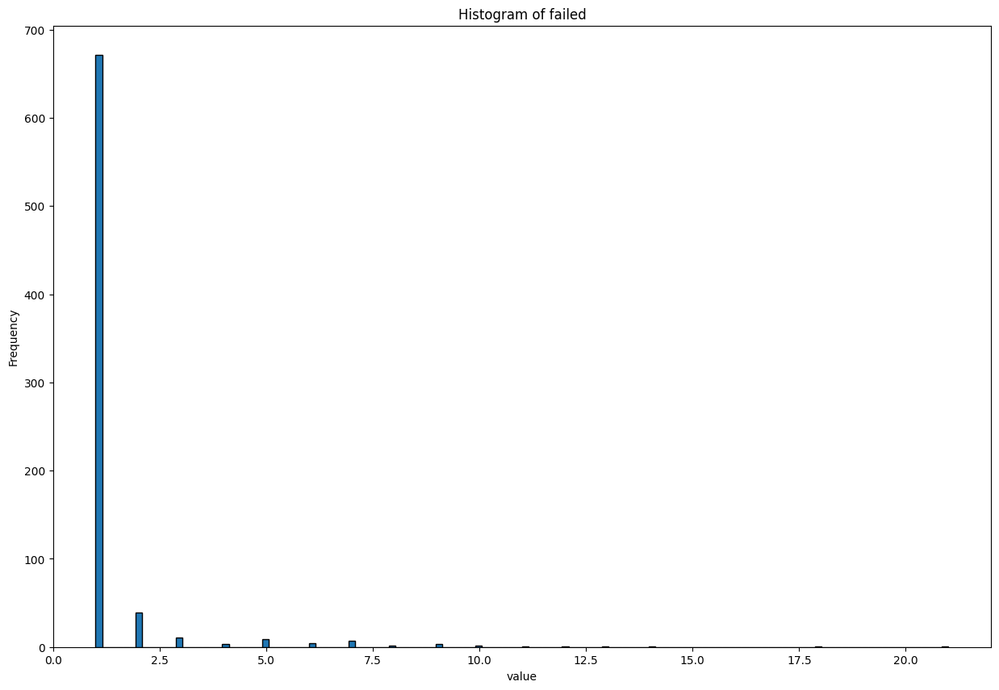

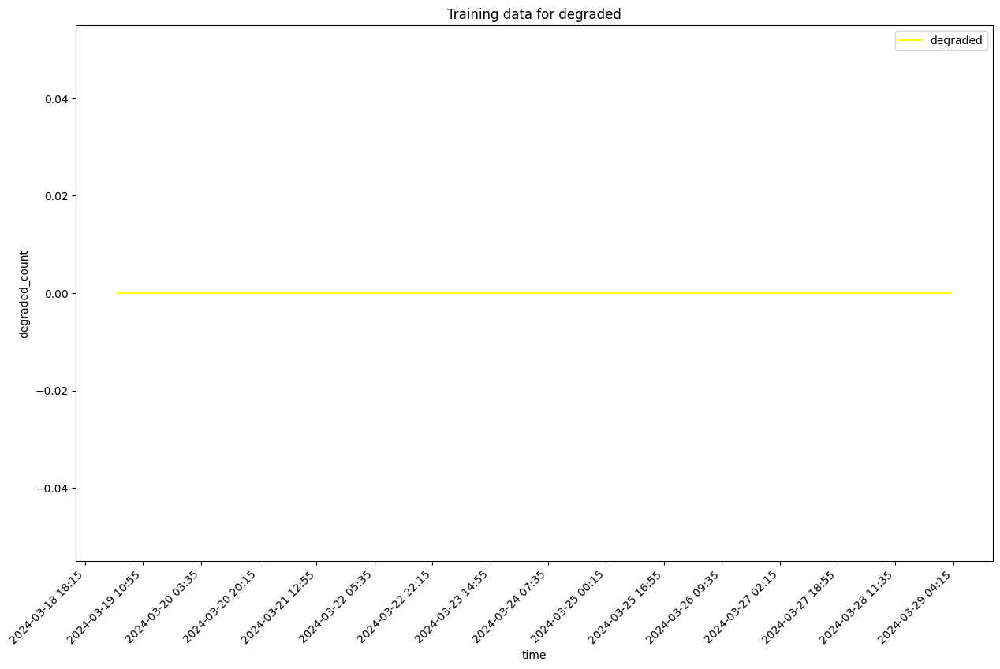

self.df_training shape  14201
Sum of histogram frequencies:  14201.0
Number of non-NaN records in column x:  14201


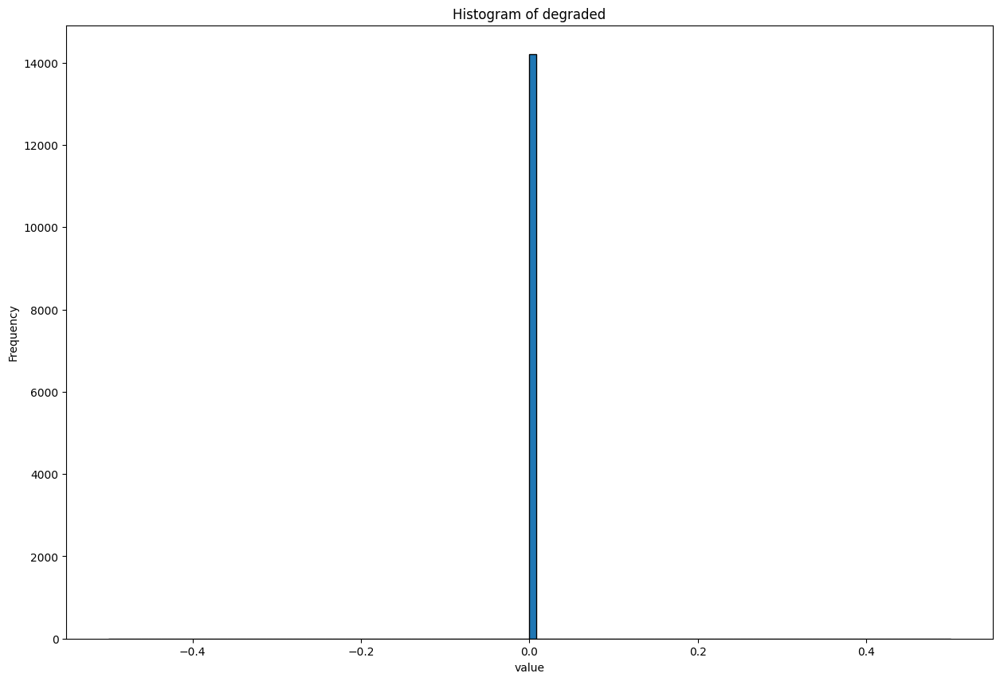

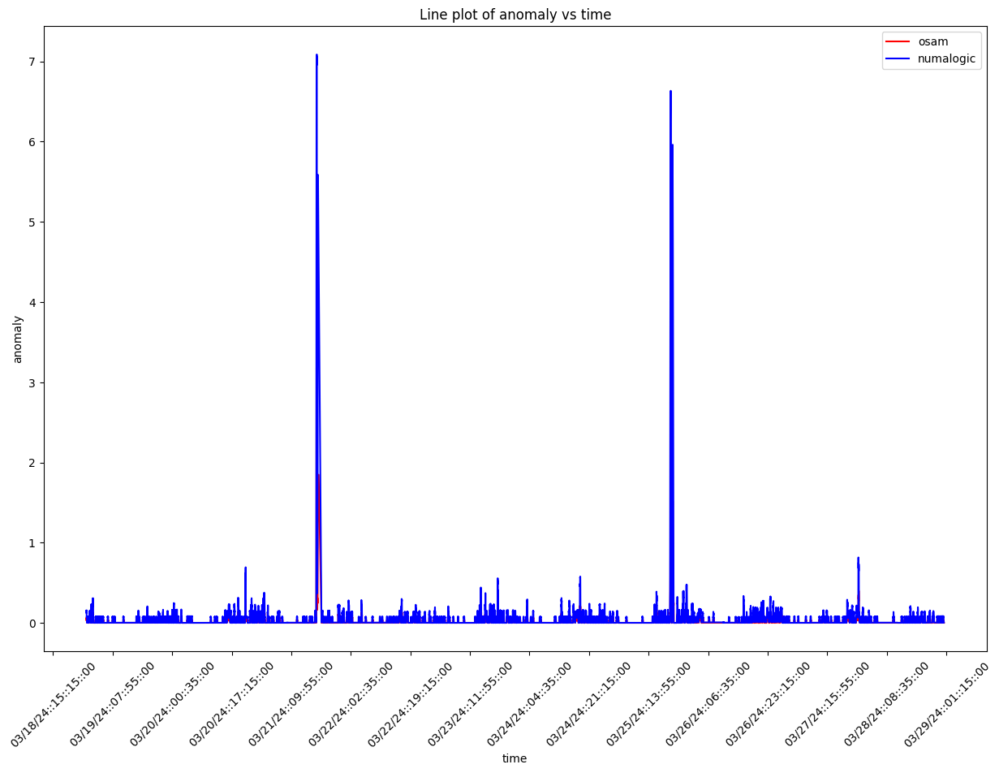

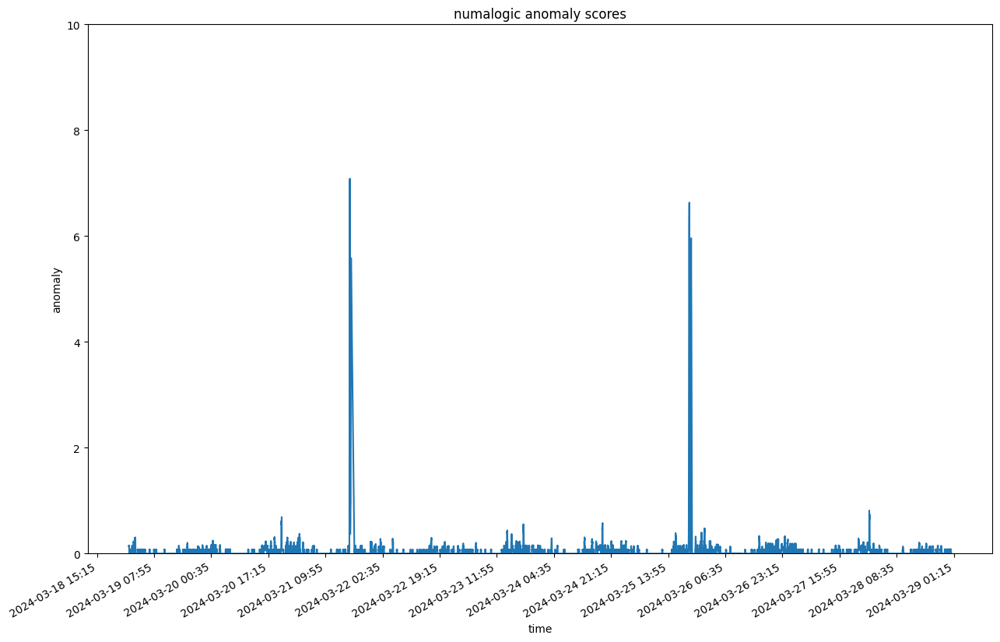

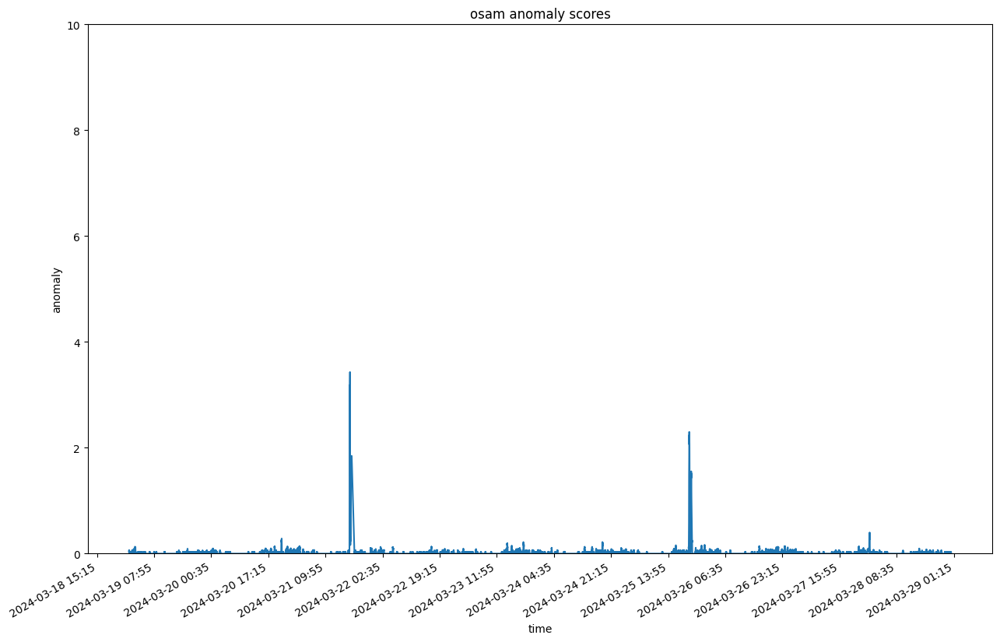

DEBUG:numalogic.connectors.druid._druid:Querying with end_dt: 2024-03-29 03:33:19.581585+00:00, that is with delay of 3 hrs


------------------------------------------------------------
------------------------------------------------------------        ModelId: fciPlugin:requestsFailed:868086420502860411:iep-workspace       ---------------------------------------------


DEBUG:numalogic.connectors.druid._druid:Druid params: {'datasource': 'tech-ip-customer-interaction-metrics', 'granularity': 'minute', 'intervals': ['2024-03-19T03:33:19.581585+00:00/2024-03-29T03:33:19.581585+00:00'], 'aggregations': {'count': {'type': 'doubleSum', 'fieldName': 'count', 'name': 'count'}}, 'post_aggregations': {}, 'filter': <pydruid.utils.filters.Filter object at 0x2cb303ee0>, 'dimensions': <map object at 0x2cb129840>, 'context': {'timeout': 10000, 'configIds': ['assetId', 'pluginId'], 'source': 'numalogic'}}, fetch time: 1.2279s
DEBUG:numalogic.udfs.tools:Querying with end_dt: 2024-03-29 00:33:22.813347+00:00, that is with delay of 3 hrs
DEBUG:numalogic.udfs.tools:Querying with end_dt: 2024-03-29 00:33:22.813347+00:00, that is with delay of 3 hrs


--- 1.977705955505371 seconds ---
--- 2.9279730319976807 seconds ---


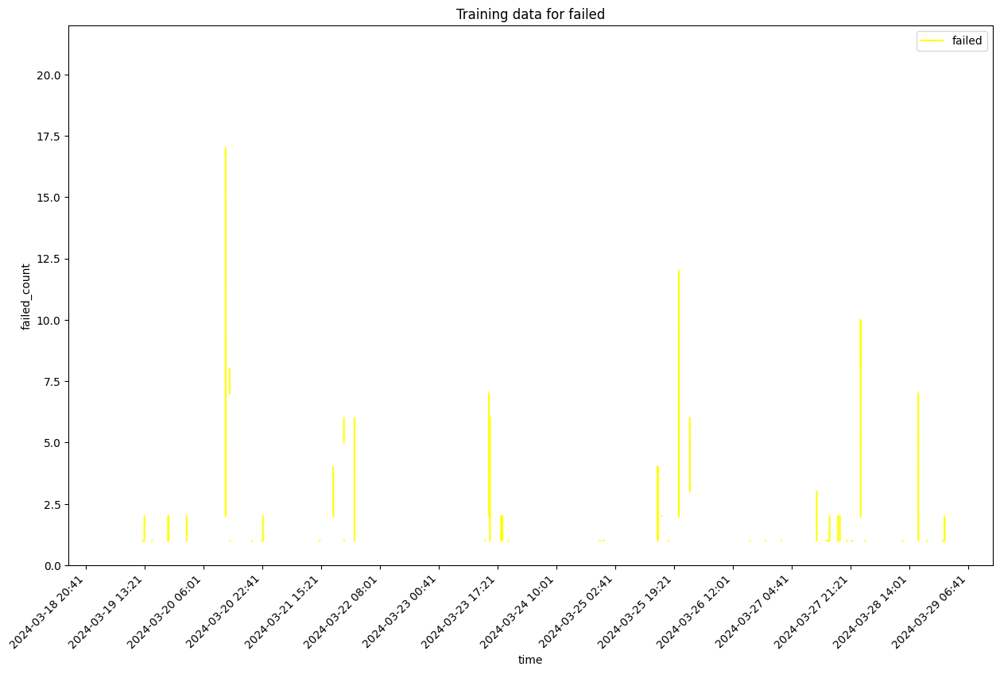

self.df_training shape  14365
Sum of histogram frequencies:  499.0
Number of non-NaN records in column x:  499


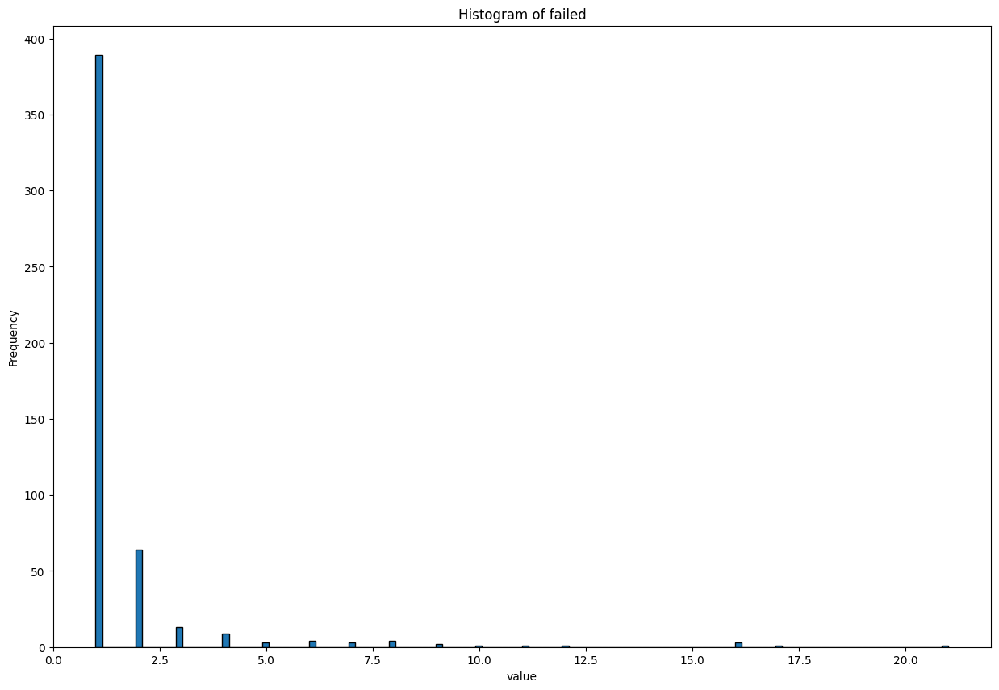

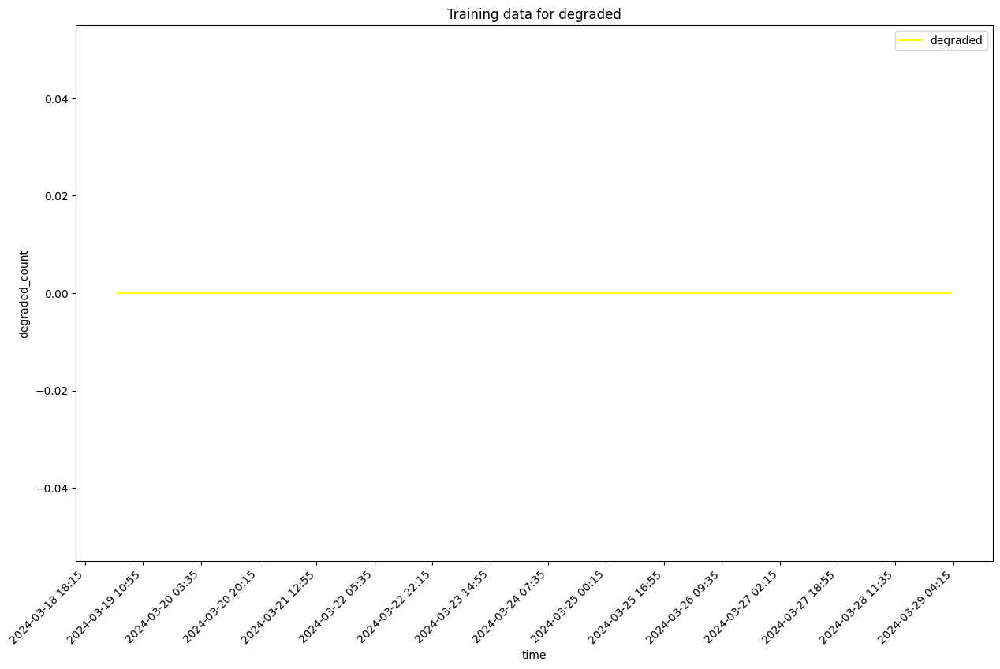

self.df_training shape  14365
Sum of histogram frequencies:  14365.0
Number of non-NaN records in column x:  14365


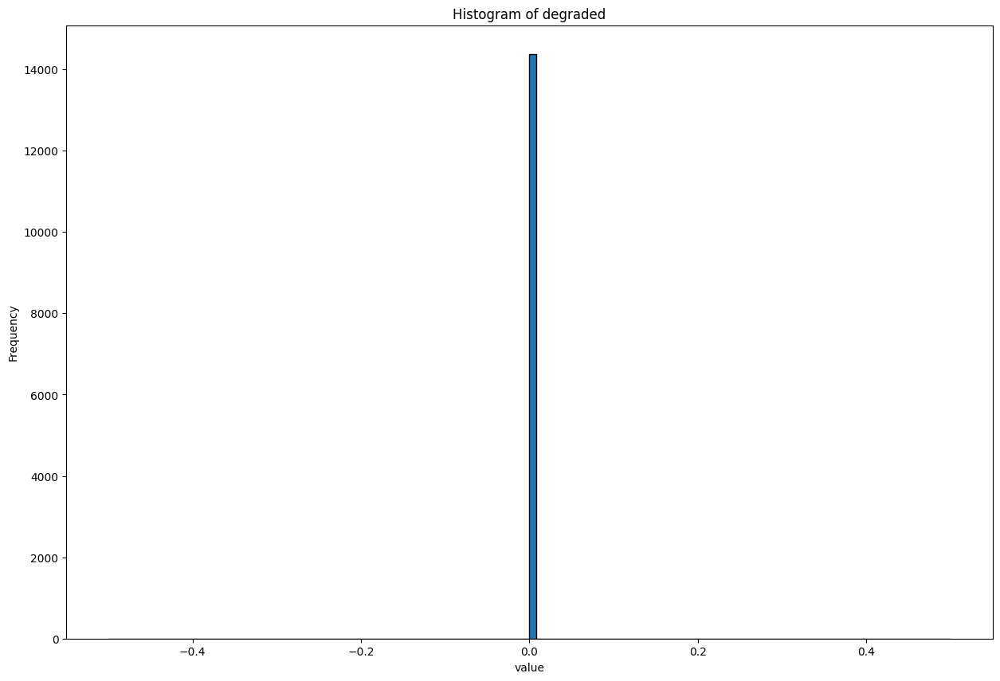

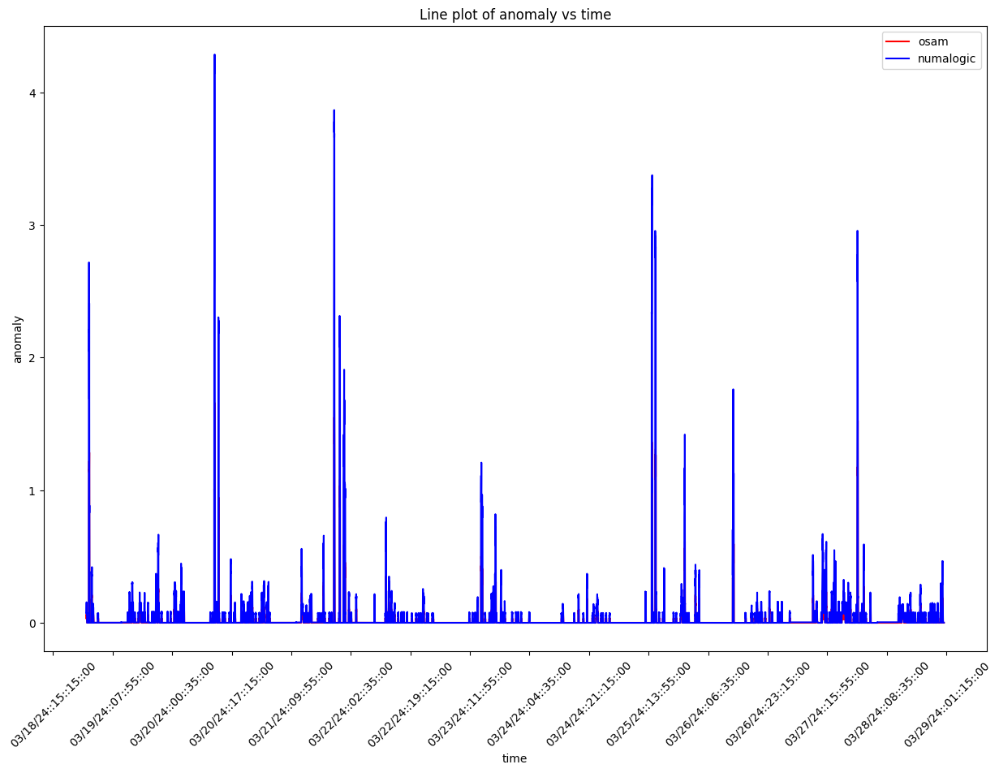

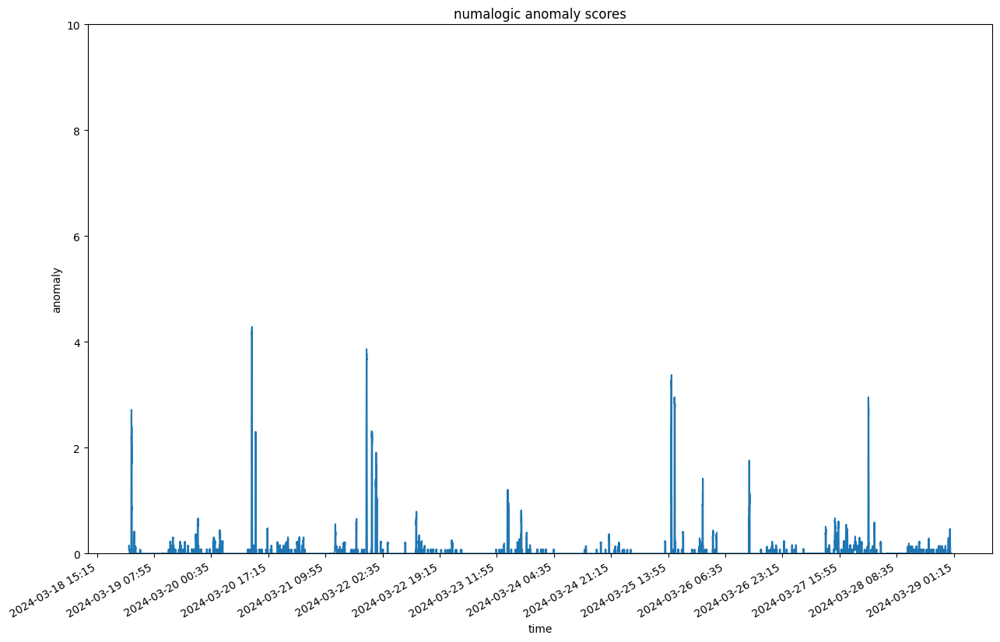

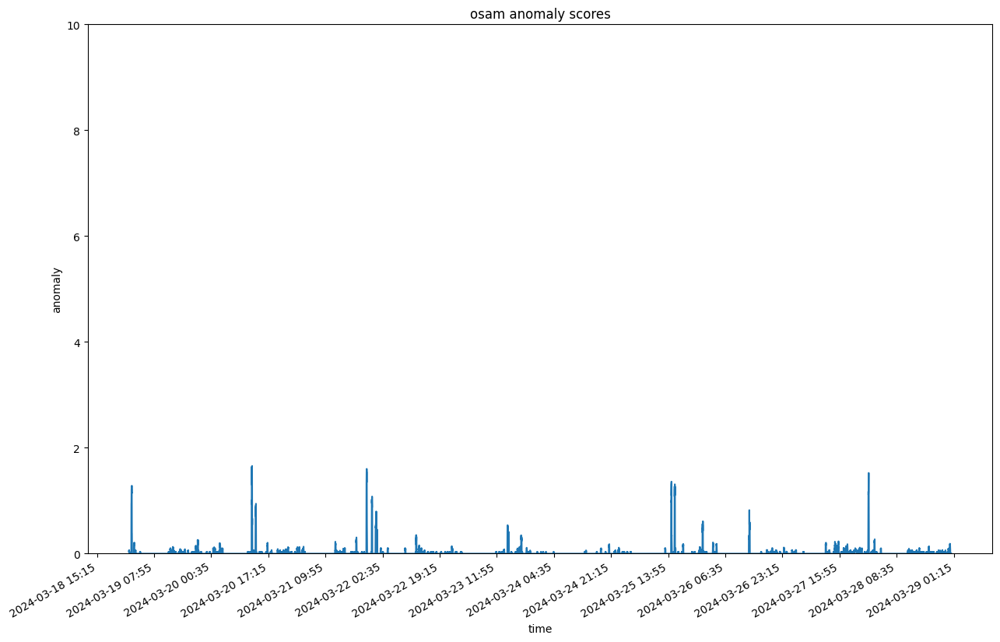

DEBUG:numalogic.connectors.druid._druid:Querying with end_dt: 2024-03-29 03:33:31.944780+00:00, that is with delay of 3 hrs


------------------------------------------------------------
------------------------------------------------------------        ModelId: fciPluginInteractions:metrics:2453353489468585843:cachedContactOnSearch       ---------------------------------------------


DEBUG:numalogic.connectors.druid._druid:Druid params: {'datasource': 'tech-ip-customer-interaction-metrics', 'granularity': 'minute', 'intervals': ['2024-03-19T03:33:31.944780+00:00/2024-03-29T03:33:31.944780+00:00'], 'aggregations': {'count': {'type': 'doubleSum', 'fieldName': 'count', 'name': 'count'}}, 'post_aggregations': {}, 'filter': <pydruid.utils.filters.Filter object at 0x2cb003850>, 'dimensions': <map object at 0x147260d00>, 'context': {'timeout': 10000, 'configIds': ['pluginAssetId', 'interactionName'], 'source': 'numalogic'}}, fetch time: 1.3094s
DEBUG:numalogic.udfs.tools:Querying with end_dt: 2024-03-29 00:33:35.258136+00:00, that is with delay of 3 hrs
DEBUG:numalogic.udfs.tools:Querying with end_dt: 2024-03-29 00:33:35.258136+00:00, that is with delay of 3 hrs


--- 2.7793757915496826 seconds ---
--- 2.93540620803833 seconds ---


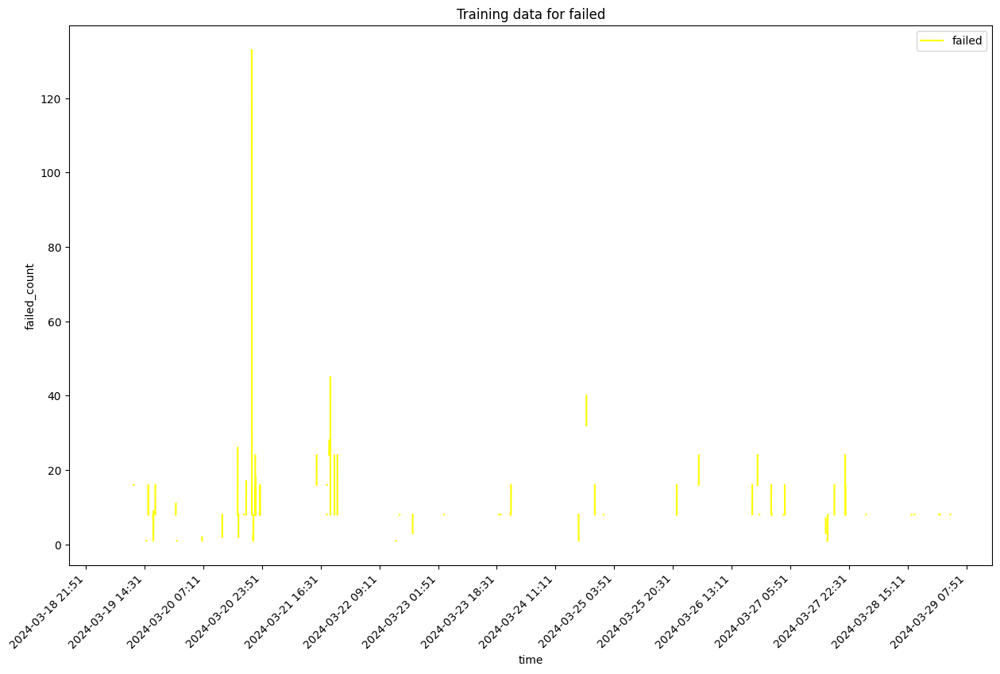

self.df_training shape  14394
Sum of histogram frequencies:  302.0
Number of non-NaN records in column x:  302


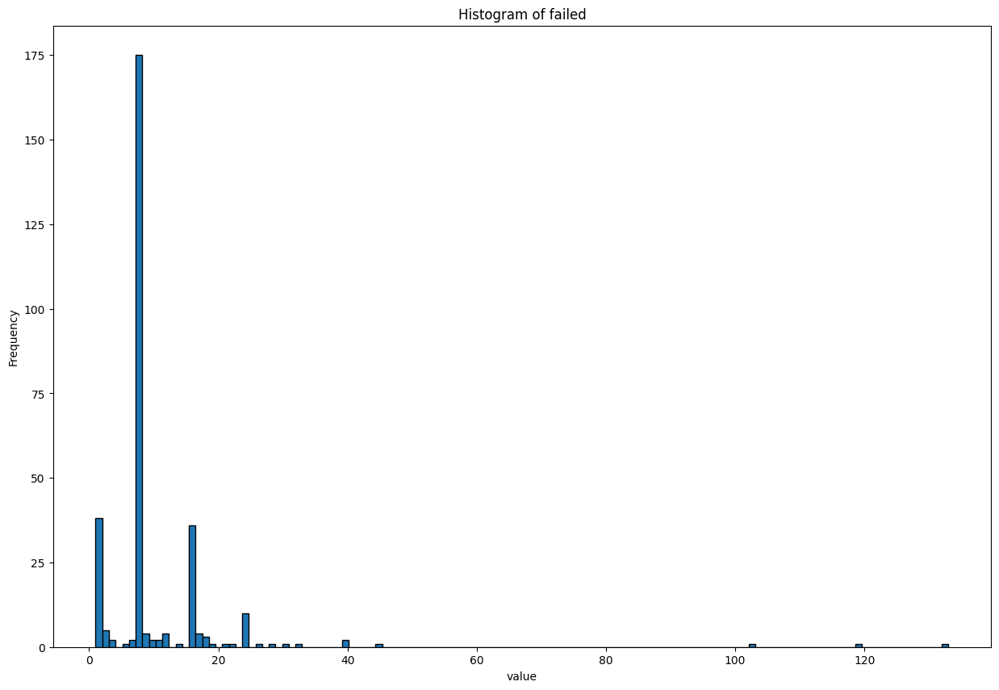

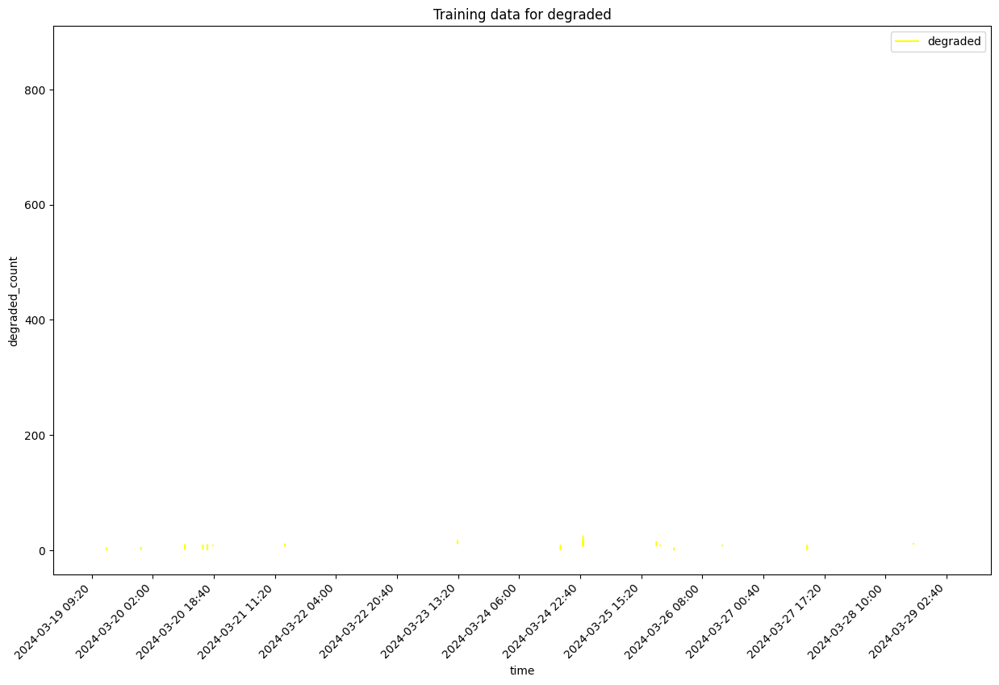

self.df_training shape  14394
Sum of histogram frequencies:  230.0
Number of non-NaN records in column x:  230


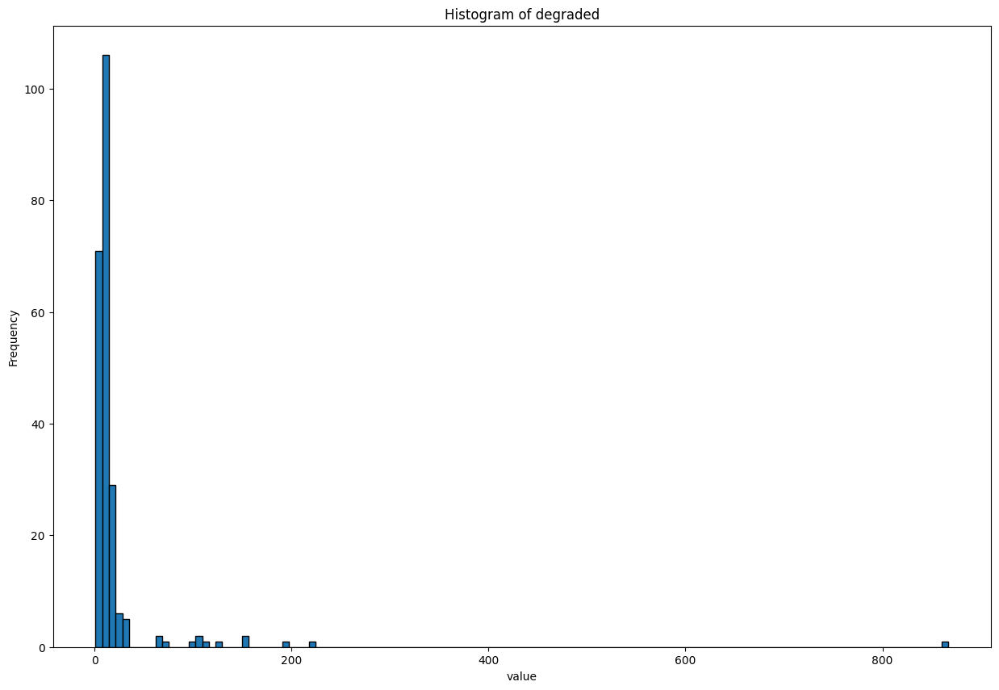

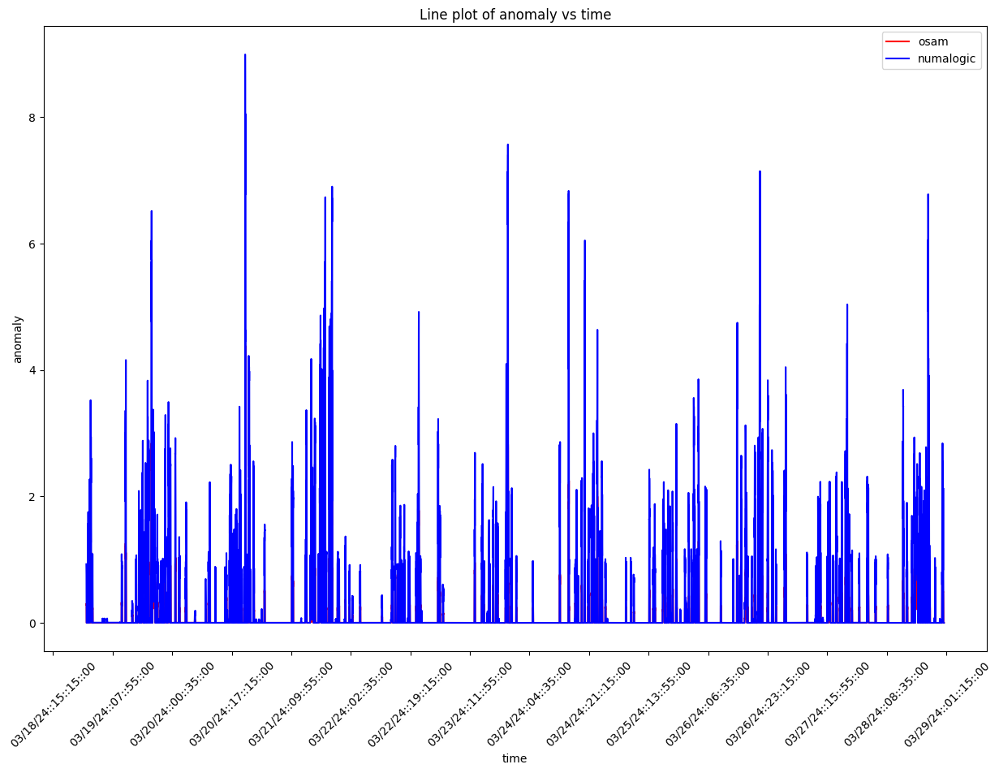

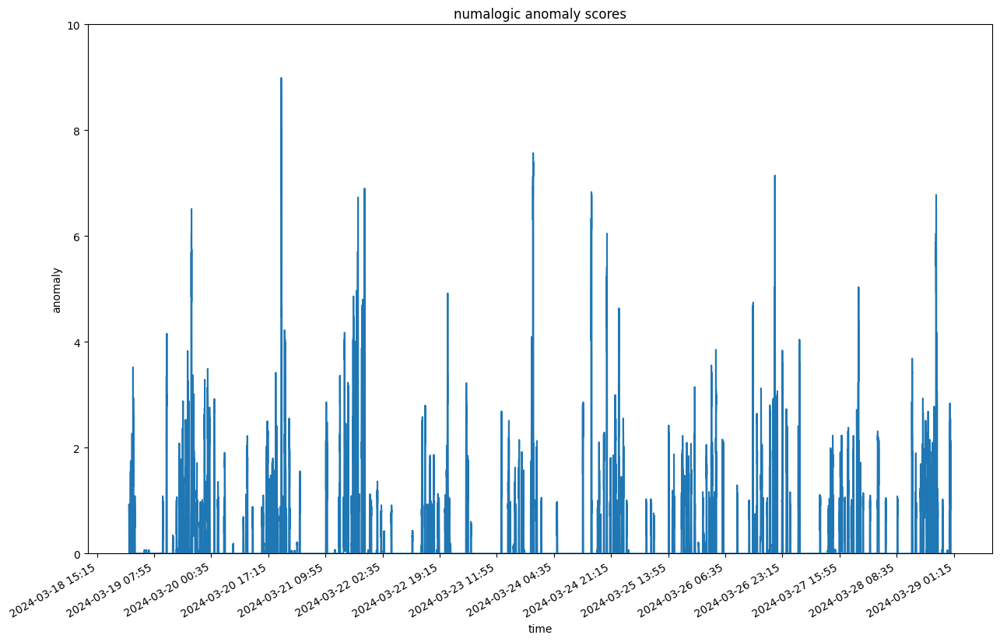

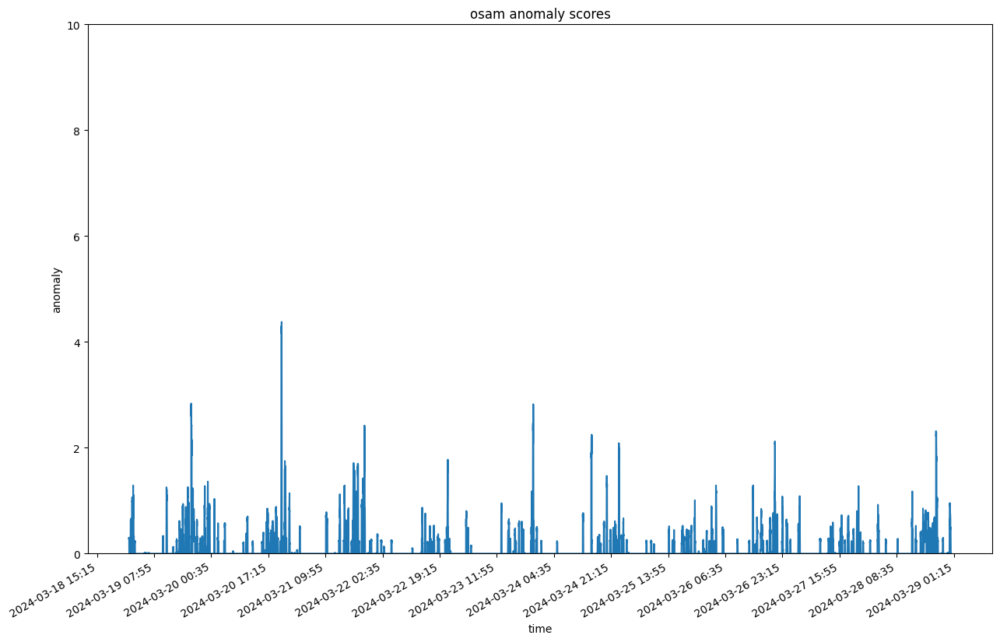

DEBUG:numalogic.connectors.druid._druid:Querying with end_dt: 2024-03-29 03:33:45.236042+00:00, that is with delay of 3 hrs


------------------------------------------------------------
------------------------------------------------------------        ModelId: fciPluginAppInteractions:metrics:5695945221779243793:5984175597303660107:personal_info_card_loaded       ---------------------------------------------


DEBUG:numalogic.connectors.druid._druid:Druid params: {'datasource': 'tech-ip-customer-interaction-metrics', 'granularity': 'minute', 'intervals': ['2024-03-19T03:33:45.236042+00:00/2024-03-29T03:33:45.236042+00:00'], 'aggregations': {'count': {'type': 'doubleSum', 'fieldName': 'count', 'name': 'count'}}, 'post_aggregations': {}, 'filter': <pydruid.utils.filters.Filter object at 0x2cbb9fa30>, 'dimensions': <map object at 0x2cbb9dd80>, 'context': {'timeout': 10000, 'configIds': ['pluginAssetId', 'assetId', 'interactionName'], 'source': 'numalogic'}}, fetch time: 1.1544s
DEBUG:numalogic.udfs.tools:Querying with end_dt: 2024-03-29 00:33:48.395925+00:00, that is with delay of 3 hrs
DEBUG:numalogic.udfs.tools:Querying with end_dt: 2024-03-29 00:33:48.395925+00:00, that is with delay of 3 hrs


--- 3.043606996536255 seconds ---
--- 2.537114143371582 seconds ---


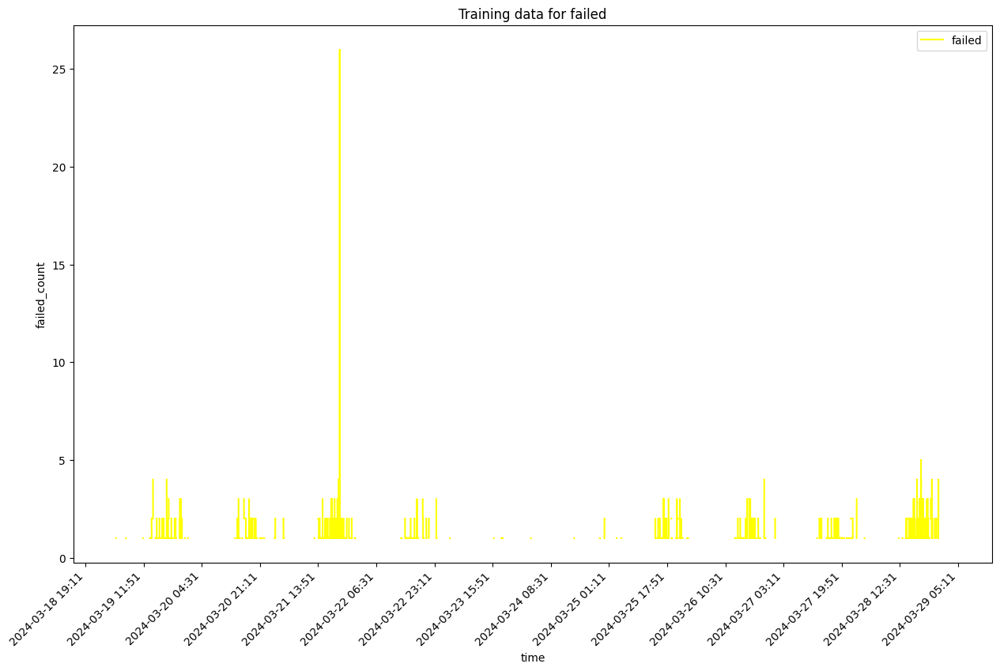

self.df_training shape  14365
Sum of histogram frequencies:  1757.0
Number of non-NaN records in column x:  1757


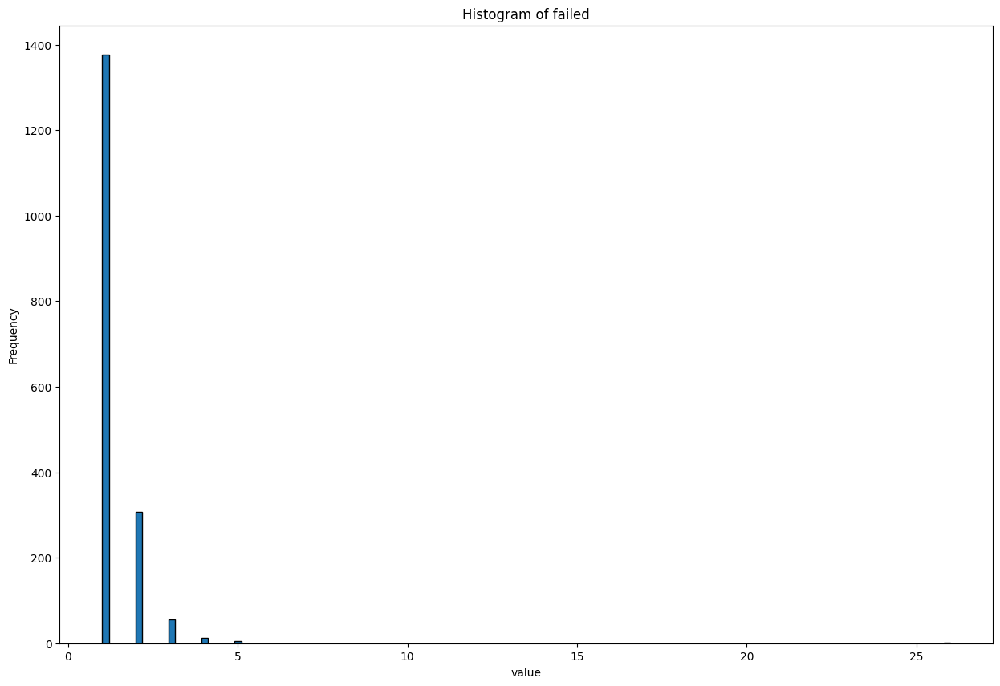

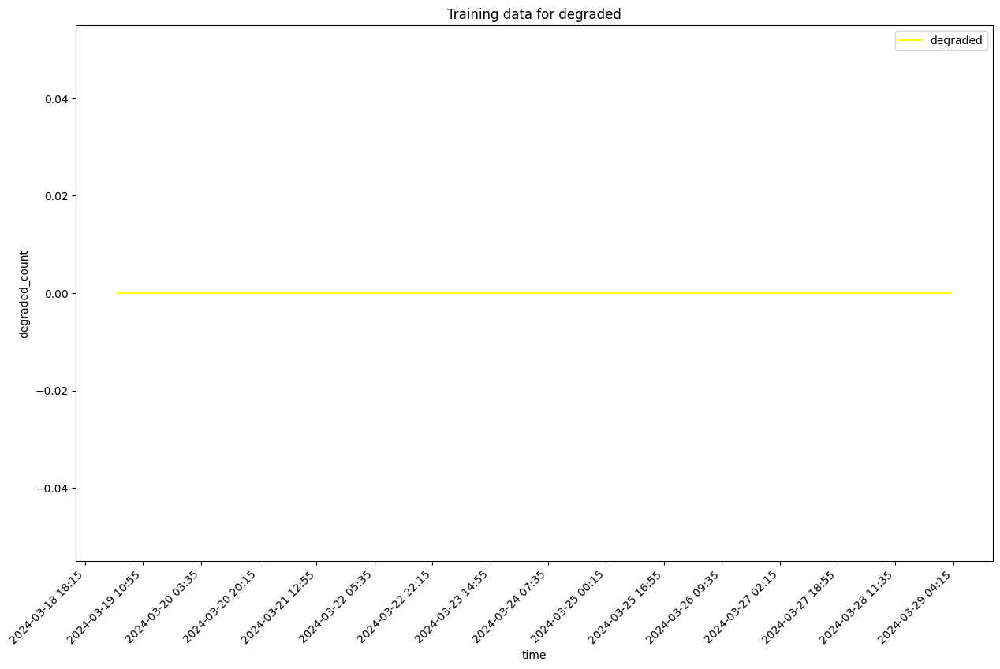

self.df_training shape  14365
Sum of histogram frequencies:  14365.0
Number of non-NaN records in column x:  14365


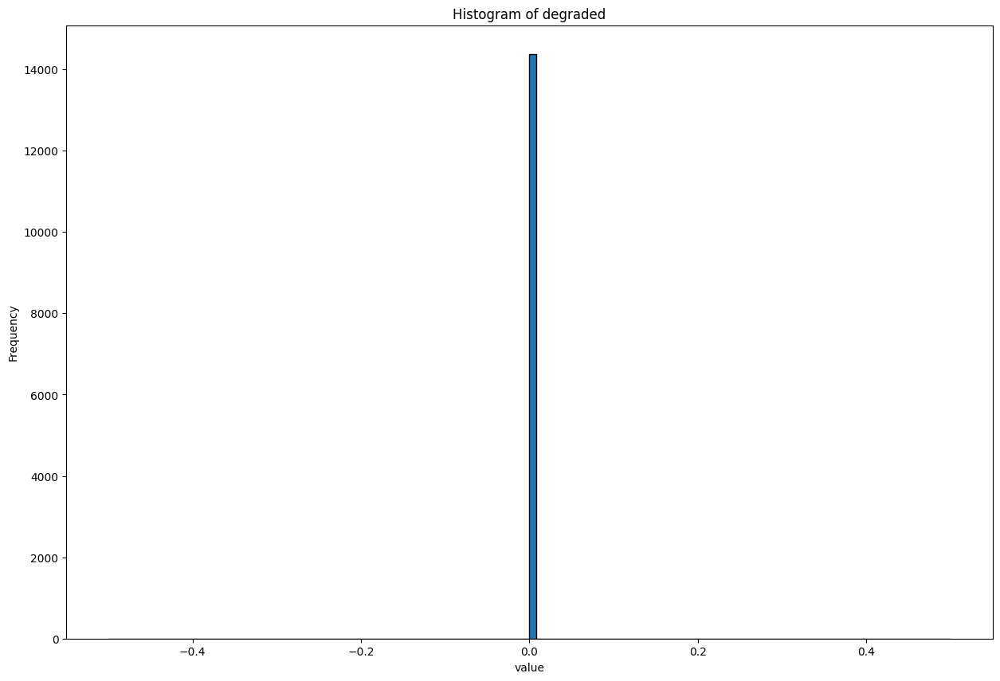

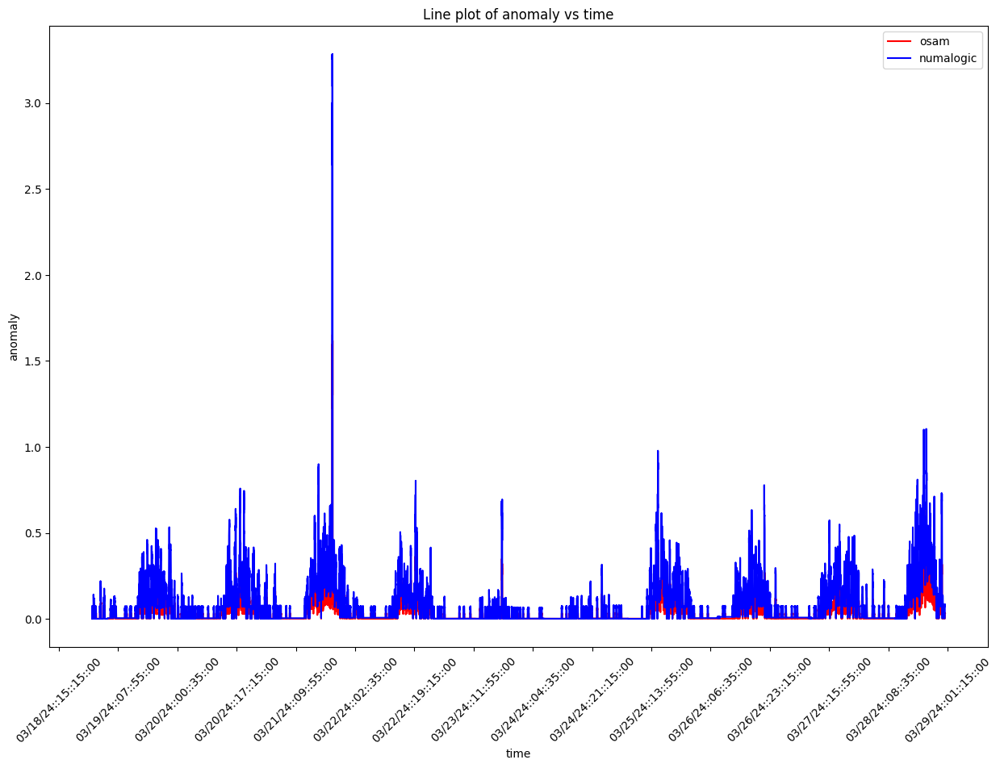

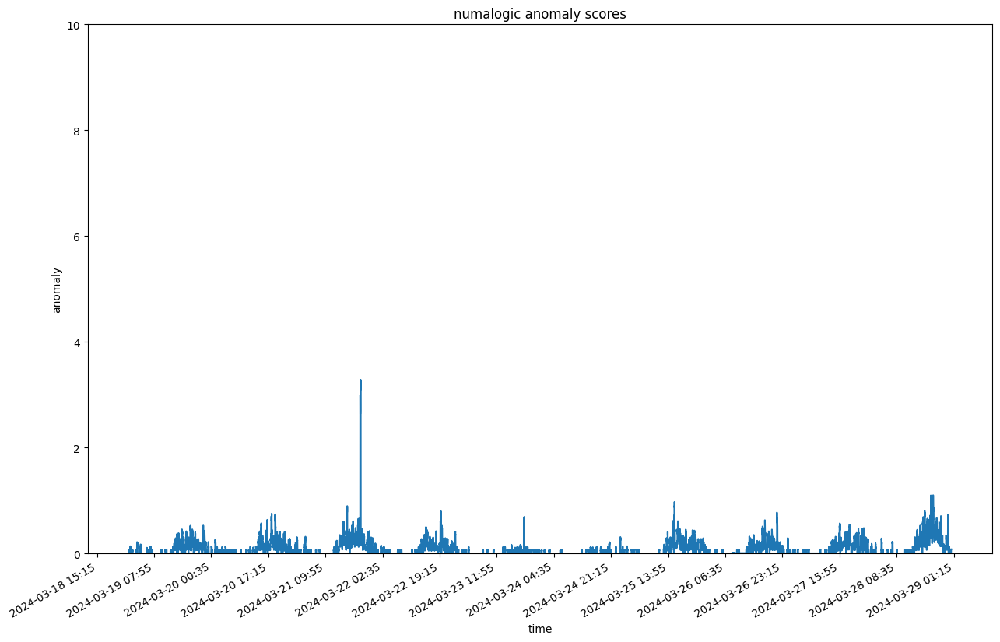

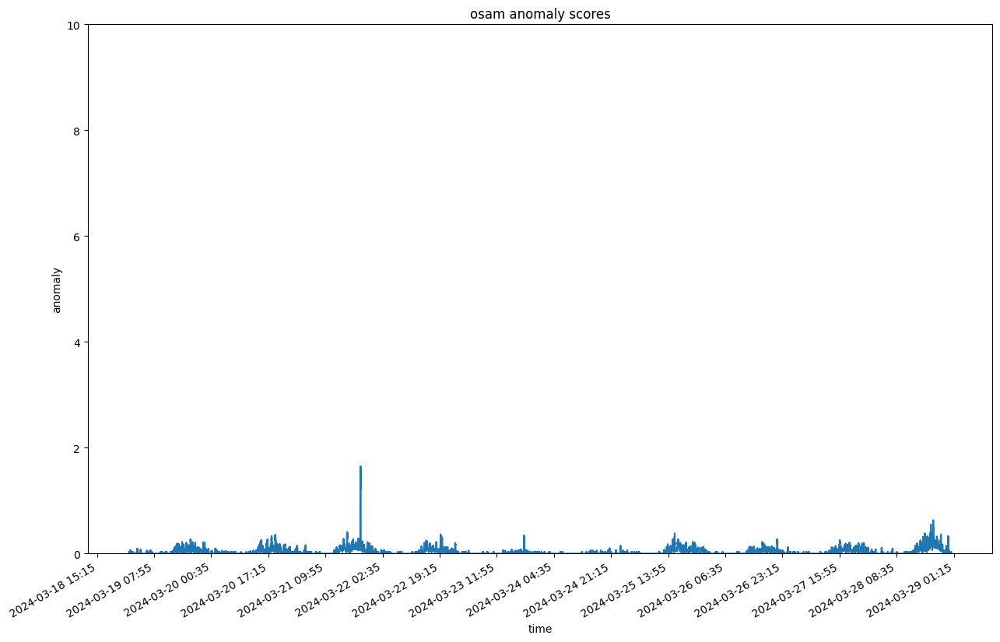

DEBUG:numalogic.connectors.druid._druid:Querying with end_dt: 2024-03-29 03:33:58.734536+00:00, that is with delay of 3 hrs


------------------------------------------------------------
------------------------------------------------------------        ModelId: fciPlugin:requests:5984175597303660107:crb-core       ---------------------------------------------


DEBUG:numalogic.connectors.druid._druid:Druid params: {'datasource': 'tech-ip-customer-interaction-metrics', 'granularity': 'minute', 'intervals': ['2024-03-19T03:33:58.734536+00:00/2024-03-29T03:33:58.734536+00:00'], 'aggregations': {'count': {'type': 'doubleSum', 'fieldName': 'count', 'name': 'count'}}, 'post_aggregations': {}, 'filter': <pydruid.utils.filters.Filter object at 0x1472cd900>, 'dimensions': <map object at 0x1472ce8c0>, 'context': {'timeout': 10000, 'configIds': ['assetId', 'pluginId'], 'source': 'numalogic'}}, fetch time: 1.2596s
DEBUG:numalogic.udfs.tools:Querying with end_dt: 2024-03-29 00:34:01.997253+00:00, that is with delay of 3 hrs
DEBUG:numalogic.udfs.tools:Querying with end_dt: 2024-03-29 00:34:01.997253+00:00, that is with delay of 3 hrs


--- 2.226957082748413 seconds ---


DEBUG:numalogic.connectors.druid._druid:Querying with end_dt: 2024-03-29 03:34:06.568448+00:00, that is with delay of 3 hrs


--- 0.29128599166870117 seconds ---
------------------------------------------------------------        ModelId: fciPluginAppInteractions:metrics:4398908529054951215:5984175597303660107:PAGE_LIVE_PREVIEW       ---------------------------------------------


DEBUG:numalogic.connectors.druid._druid:Druid params: {'datasource': 'tech-ip-customer-interaction-metrics', 'granularity': 'minute', 'intervals': ['2024-03-19T03:34:06.568448+00:00/2024-03-29T03:34:06.568448+00:00'], 'aggregations': {'count': {'type': 'doubleSum', 'fieldName': 'count', 'name': 'count'}}, 'post_aggregations': {}, 'filter': <pydruid.utils.filters.Filter object at 0x1472aba60>, 'dimensions': <map object at 0x2cbc42650>, 'context': {'timeout': 10000, 'configIds': ['pluginAssetId', 'assetId', 'interactionName'], 'source': 'numalogic'}}, fetch time: 1.4177s
DEBUG:numalogic.udfs.tools:Querying with end_dt: 2024-03-29 00:34:09.989949+00:00, that is with delay of 3 hrs
DEBUG:numalogic.udfs.tools:Querying with end_dt: 2024-03-29 00:34:09.989949+00:00, that is with delay of 3 hrs


--- 2.6528890132904053 seconds ---
--- 2.2371671199798584 seconds ---


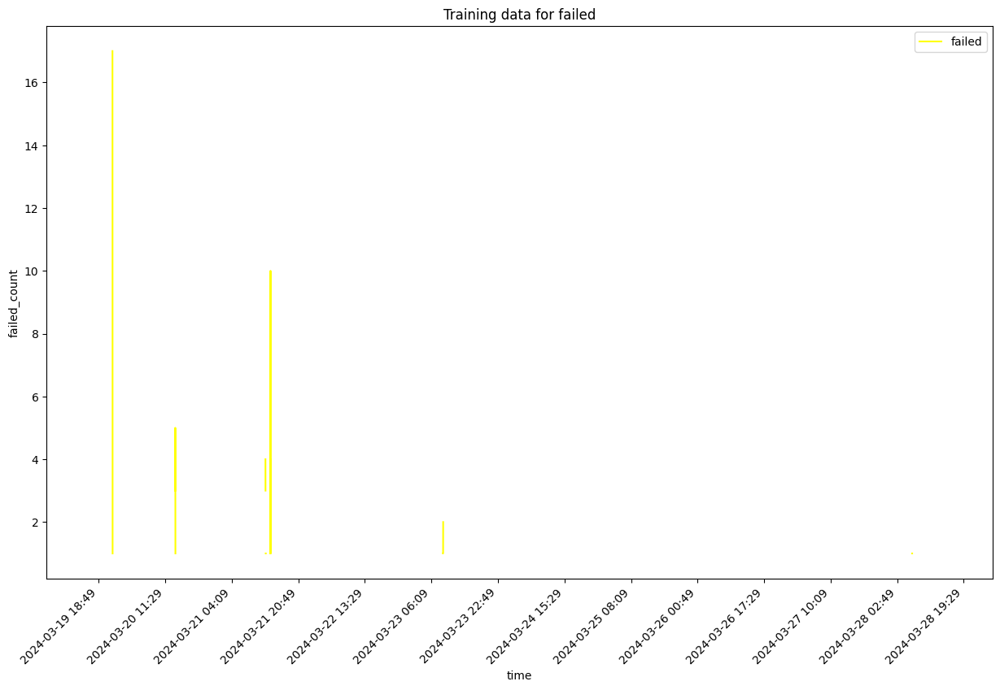

self.df_training shape  13785
Sum of histogram frequencies:  45.0
Number of non-NaN records in column x:  45


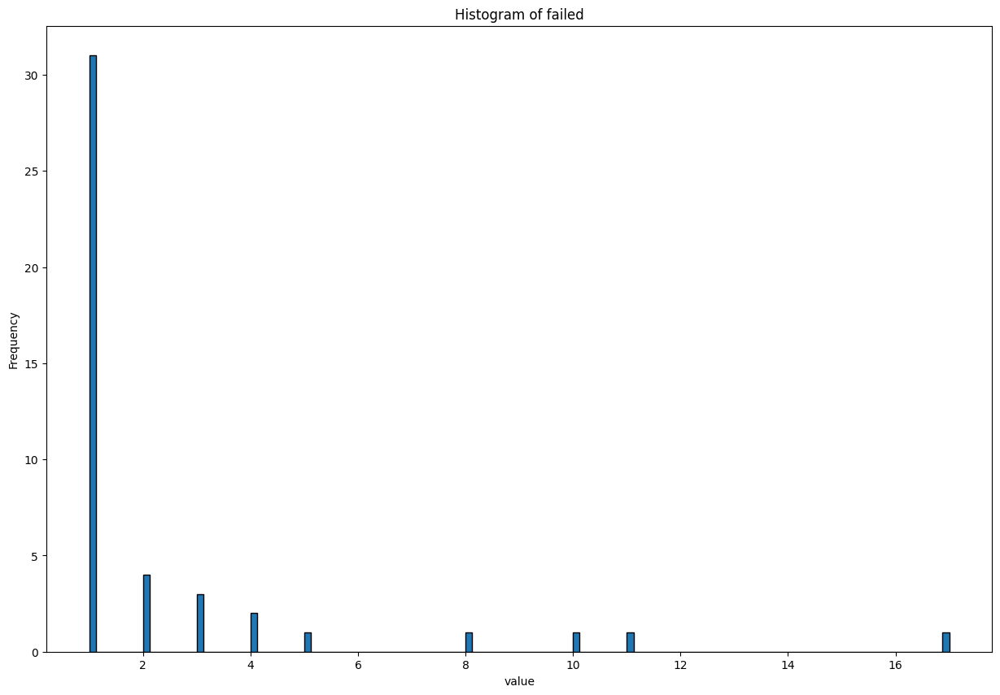

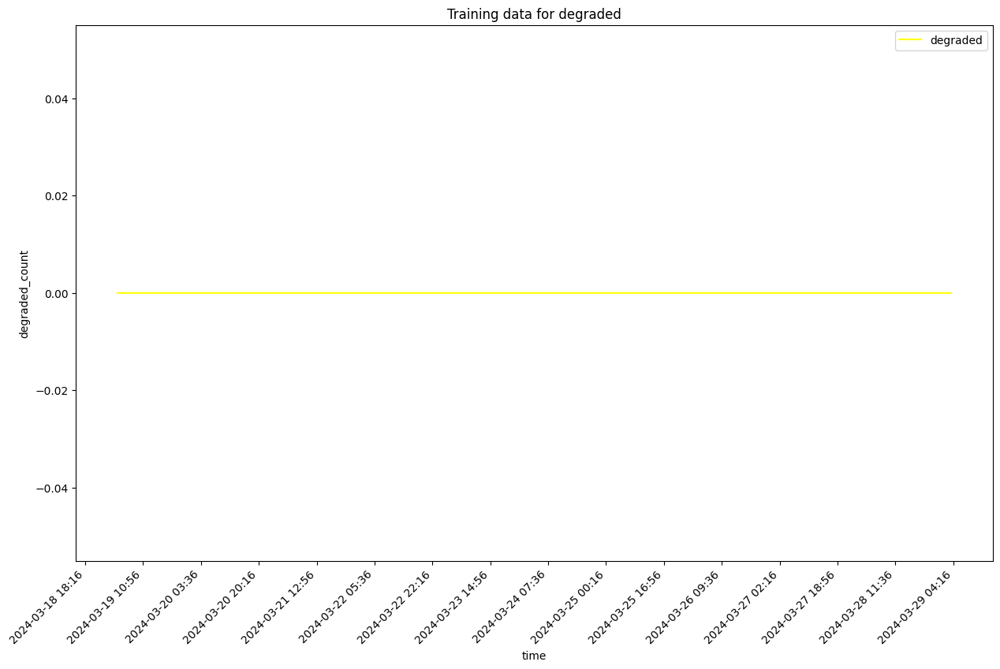

self.df_training shape  13785
Sum of histogram frequencies:  13785.0
Number of non-NaN records in column x:  13785


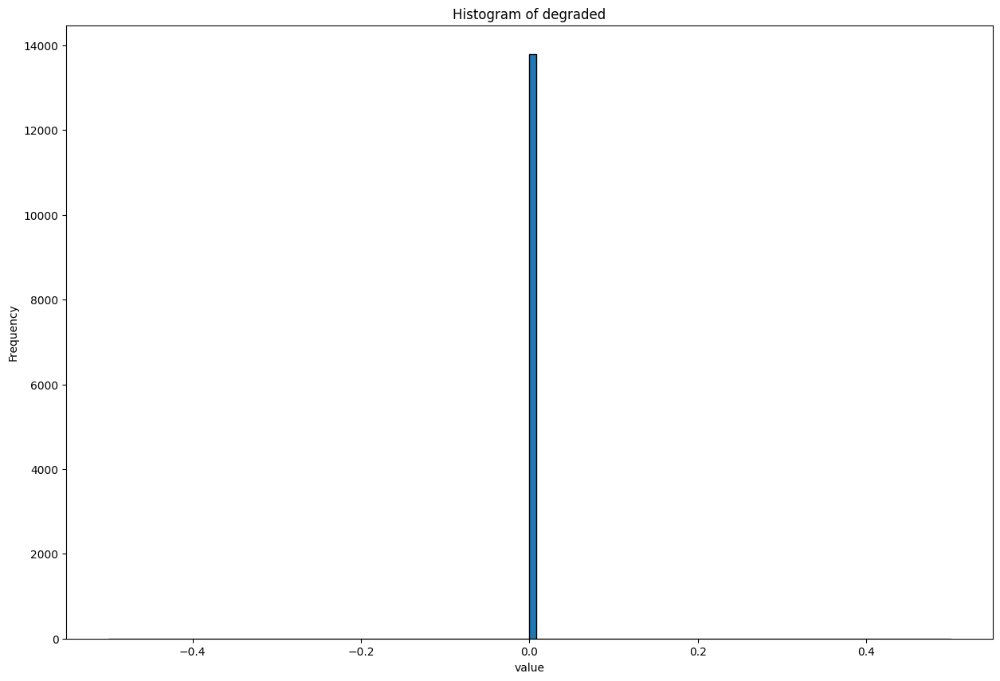

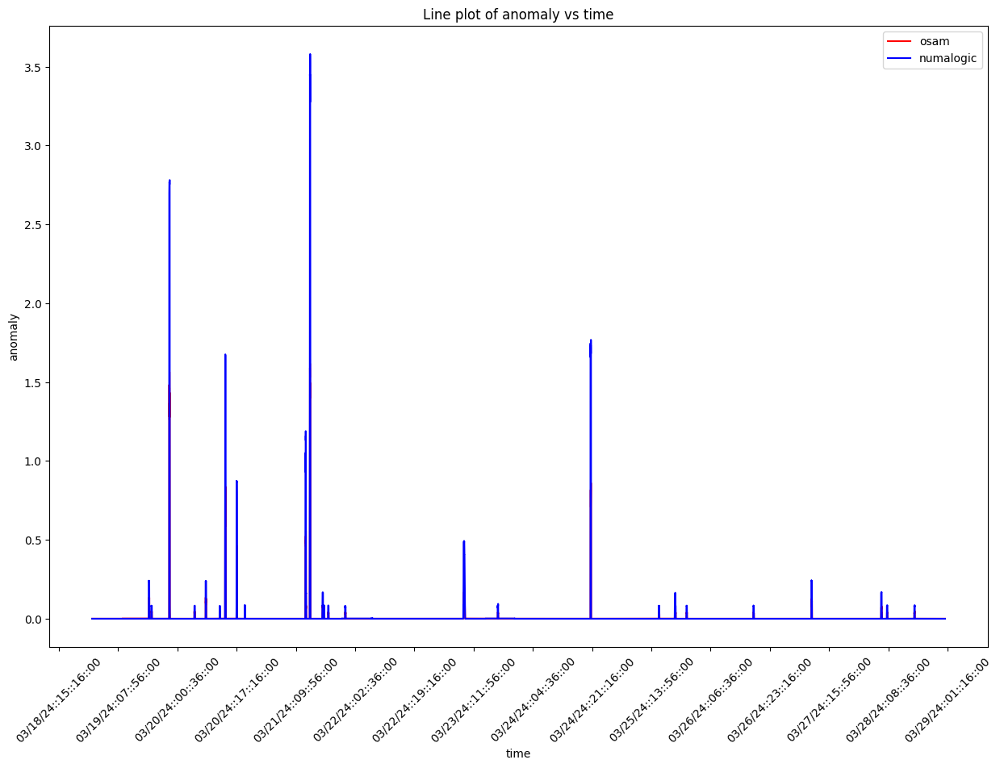

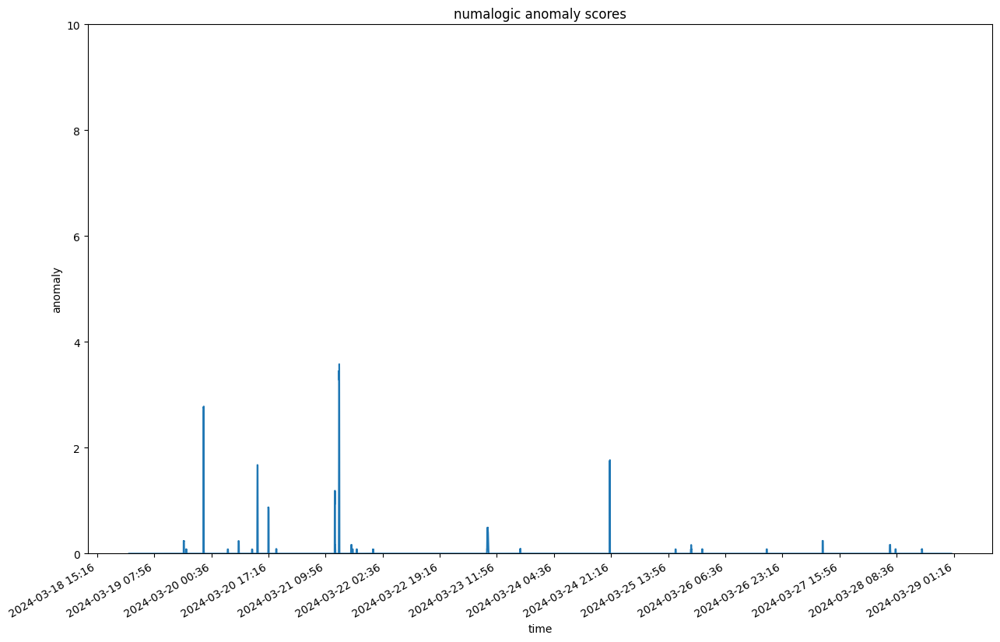

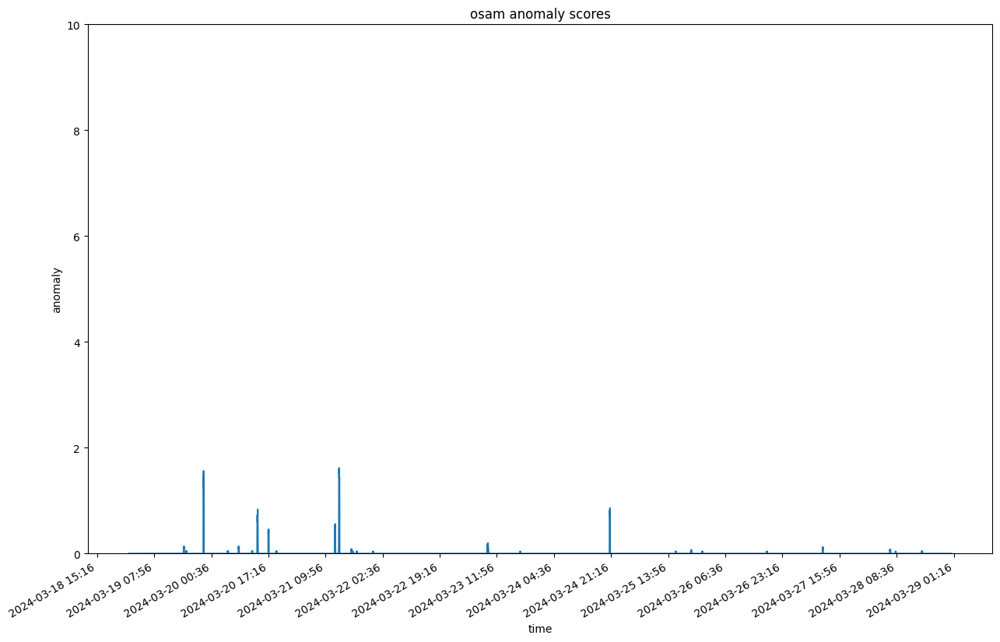

DEBUG:numalogic.connectors.druid._druid:Querying with end_dt: 2024-03-29 03:34:19.169423+00:00, that is with delay of 3 hrs


------------------------------------------------------------
------------------------------------------------------------        ModelId: fci:interactionsFailed:5984175597303660107:paymentMethodMonolithOnSearch       ---------------------------------------------


DEBUG:numalogic.connectors.druid._druid:Druid params: {'datasource': 'tech-ip-customer-interaction-metrics', 'granularity': 'minute', 'intervals': ['2024-03-19T03:34:19.169423+00:00/2024-03-29T03:34:19.169423+00:00'], 'aggregations': {'count': {'type': 'doubleSum', 'fieldName': 'count', 'name': 'count'}}, 'post_aggregations': {}, 'filter': <pydruid.utils.filters.Filter object at 0x2cb43c6a0>, 'dimensions': <map object at 0x2cb43e440>, 'context': {'timeout': 10000, 'configIds': ['assetId', 'interactionName'], 'source': 'numalogic'}}, fetch time: 0.9306s
DEBUG:numalogic.udfs.tools:Querying with end_dt: 2024-03-29 00:34:22.102285+00:00, that is with delay of 3 hrs
DEBUG:numalogic.udfs.tools:Querying with end_dt: 2024-03-29 00:34:22.102285+00:00, that is with delay of 3 hrs


--- 2.1795170307159424 seconds ---
--- 1.382660150527954 seconds ---


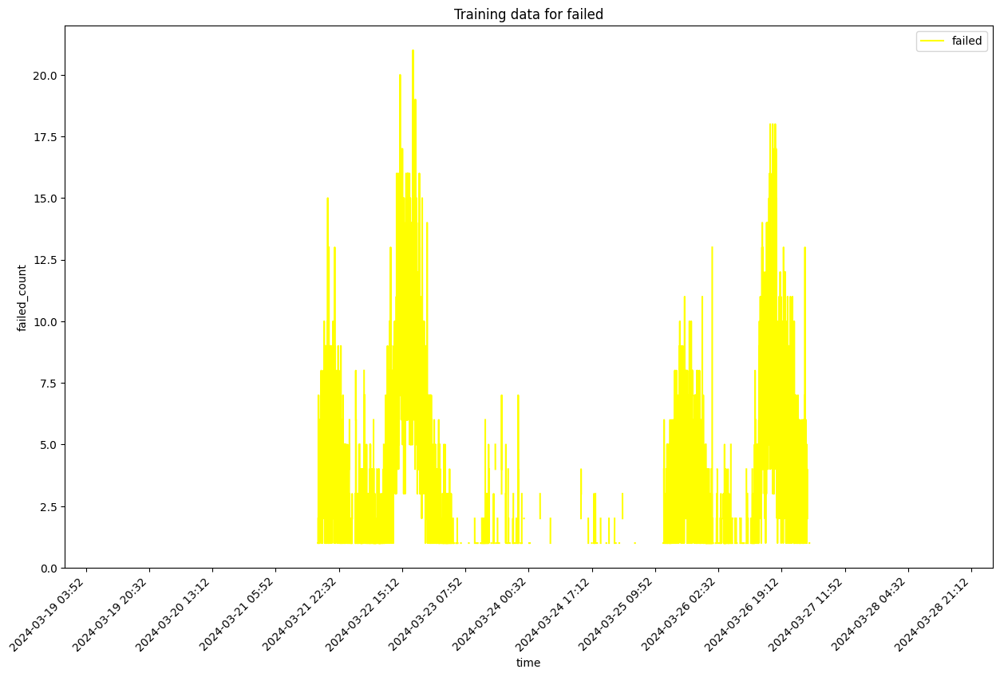

self.df_training shape  10184
Sum of histogram frequencies:  3950.0
Number of non-NaN records in column x:  3950


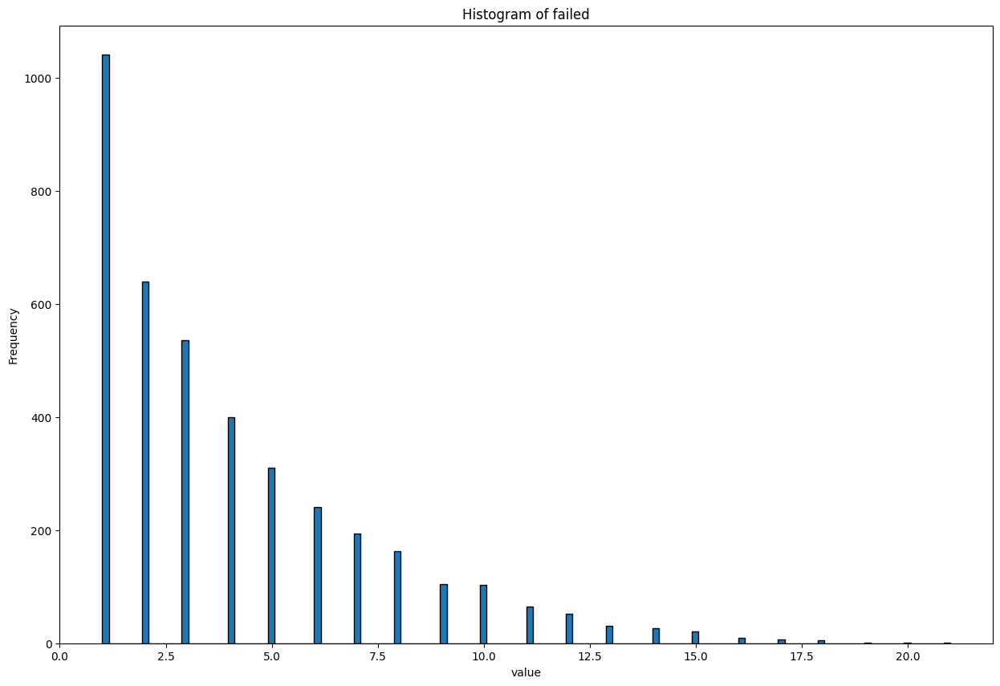

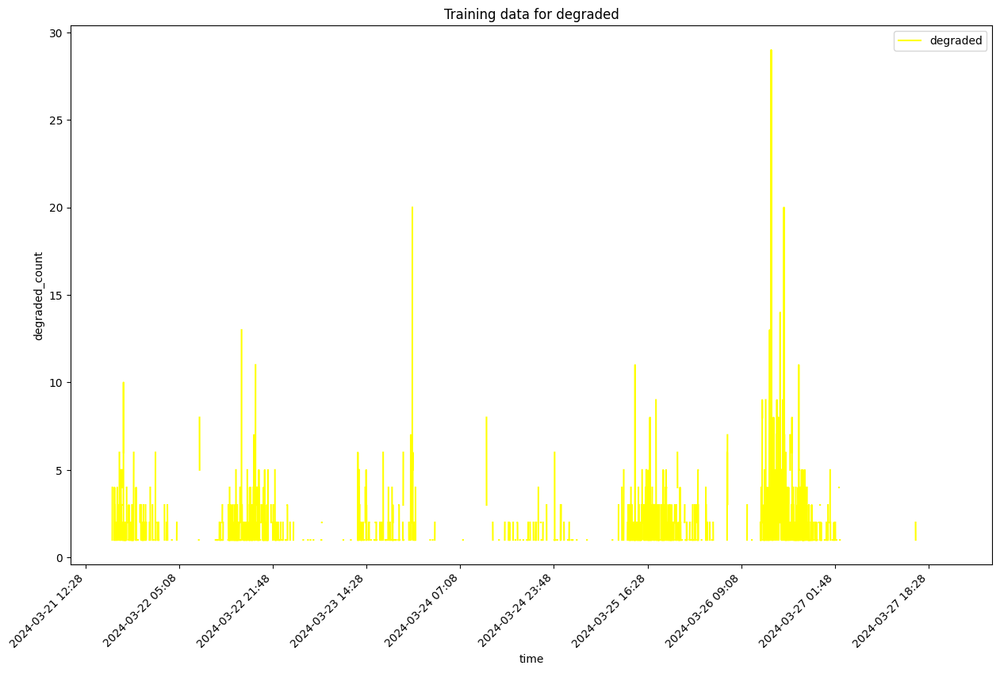

self.df_training shape  10184
Sum of histogram frequencies:  2212.0
Number of non-NaN records in column x:  2212


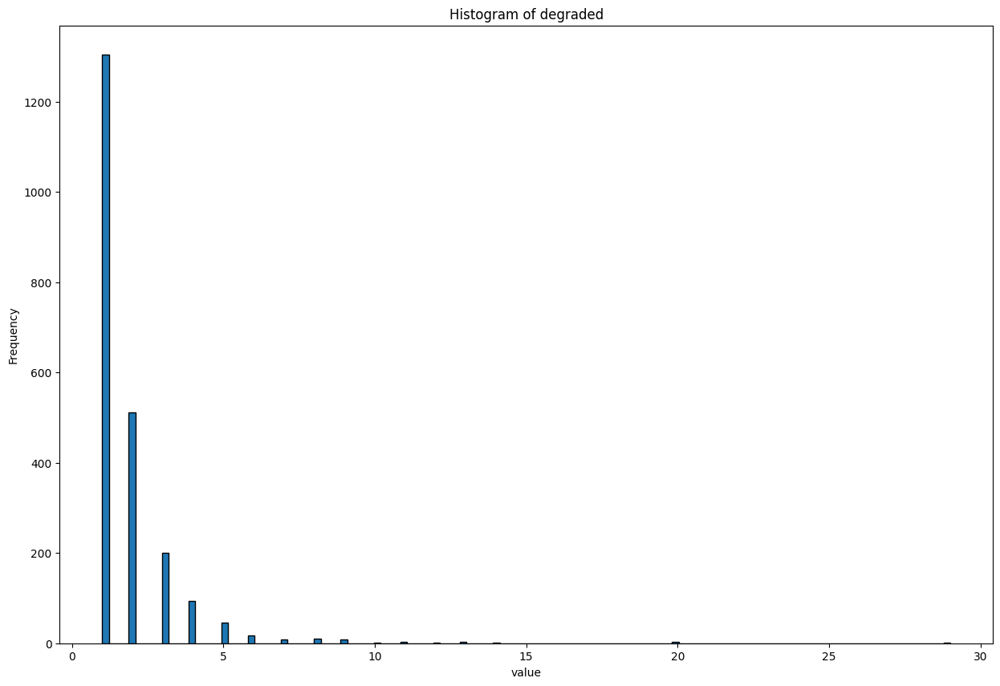

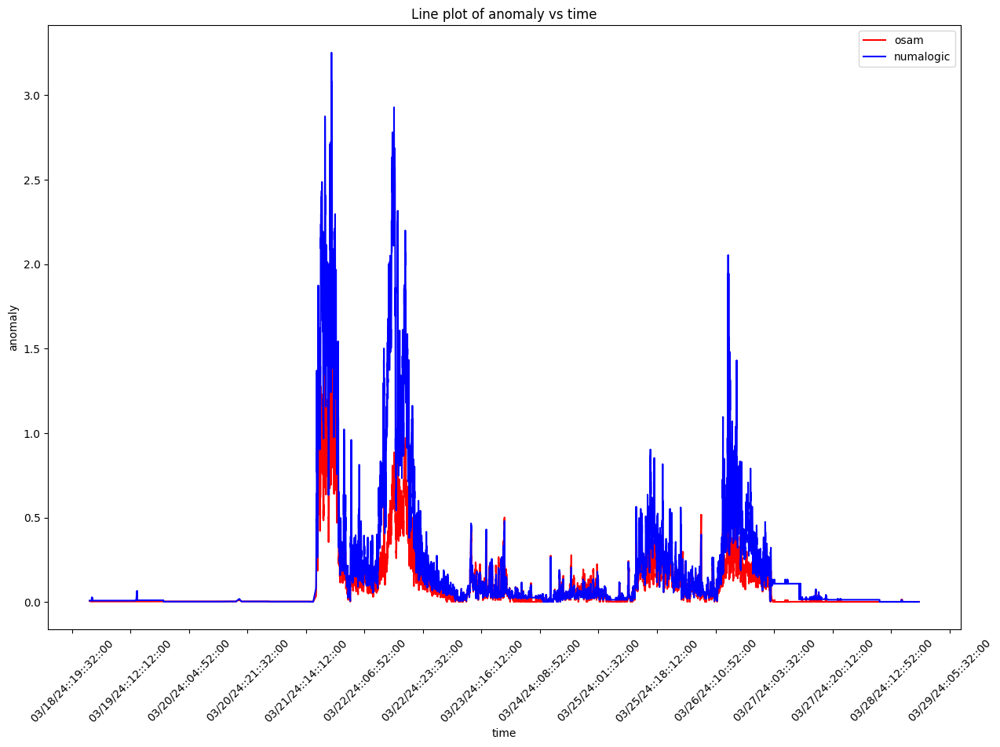

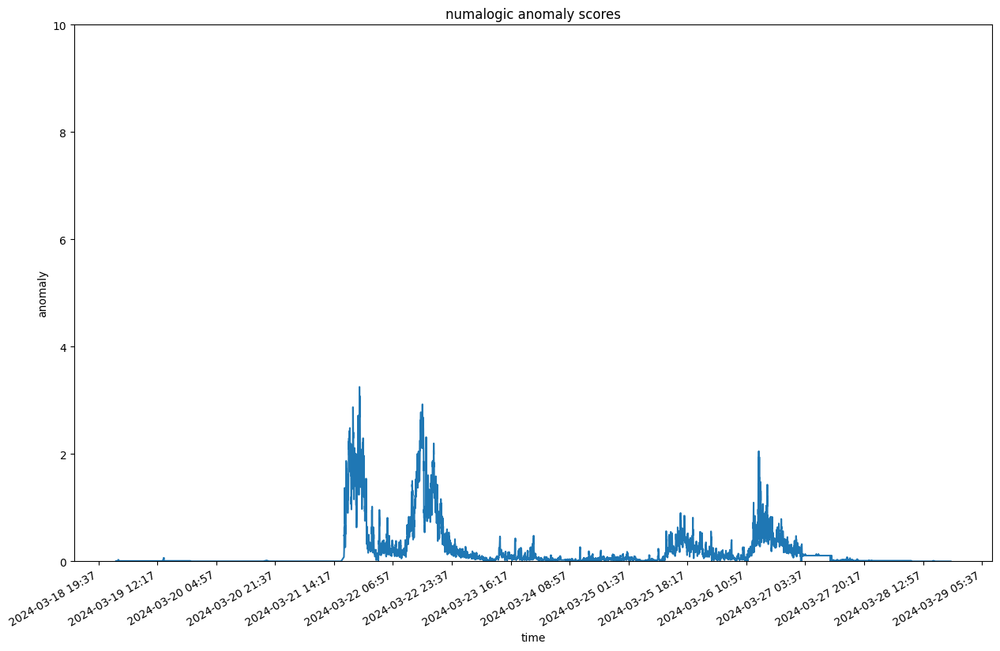

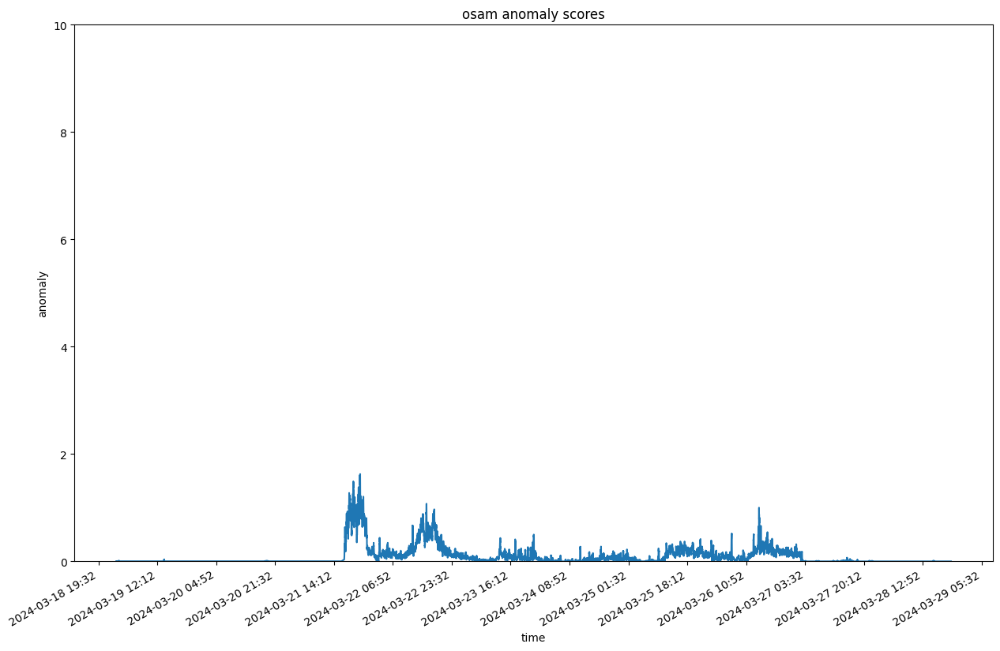

DEBUG:numalogic.connectors.druid._druid:Querying with end_dt: 2024-03-29 03:34:30.111847+00:00, that is with delay of 3 hrs


------------------------------------------------------------
------------------------------------------------------------        ModelId: fciPluginAppInteractions:metrics:3750390182735137211:5984175597303660107:PAGINATE_REPORT       ---------------------------------------------


DEBUG:numalogic.connectors.druid._druid:Druid params: {'datasource': 'tech-ip-customer-interaction-metrics', 'granularity': 'minute', 'intervals': ['2024-03-19T03:34:30.111847+00:00/2024-03-29T03:34:30.111847+00:00'], 'aggregations': {'count': {'type': 'doubleSum', 'fieldName': 'count', 'name': 'count'}}, 'post_aggregations': {}, 'filter': <pydruid.utils.filters.Filter object at 0x2cb747a00>, 'dimensions': <map object at 0x2cb7462f0>, 'context': {'timeout': 10000, 'configIds': ['pluginAssetId', 'assetId', 'interactionName'], 'source': 'numalogic'}}, fetch time: 1.1765s
DEBUG:numalogic.udfs.tools:Querying with end_dt: 2024-03-29 00:34:33.292307+00:00, that is with delay of 3 hrs
DEBUG:numalogic.udfs.tools:Querying with end_dt: 2024-03-29 00:34:33.292307+00:00, that is with delay of 3 hrs


--- 2.4517502784729004 seconds ---
--- 2.030245065689087 seconds ---


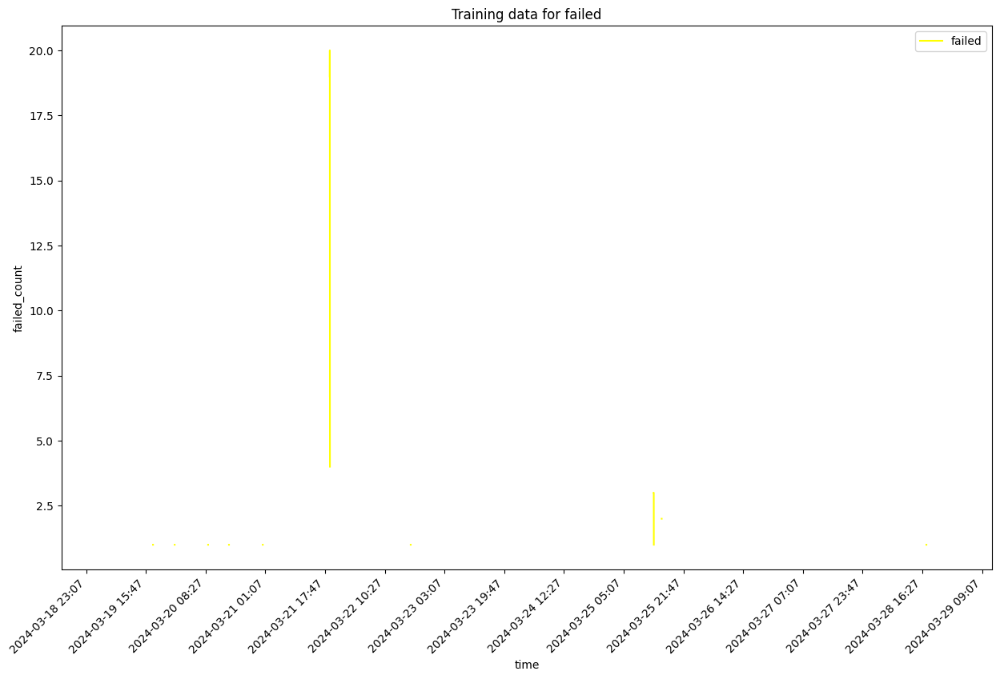

self.df_training shape  14400
Sum of histogram frequencies:  168.0
Number of non-NaN records in column x:  168


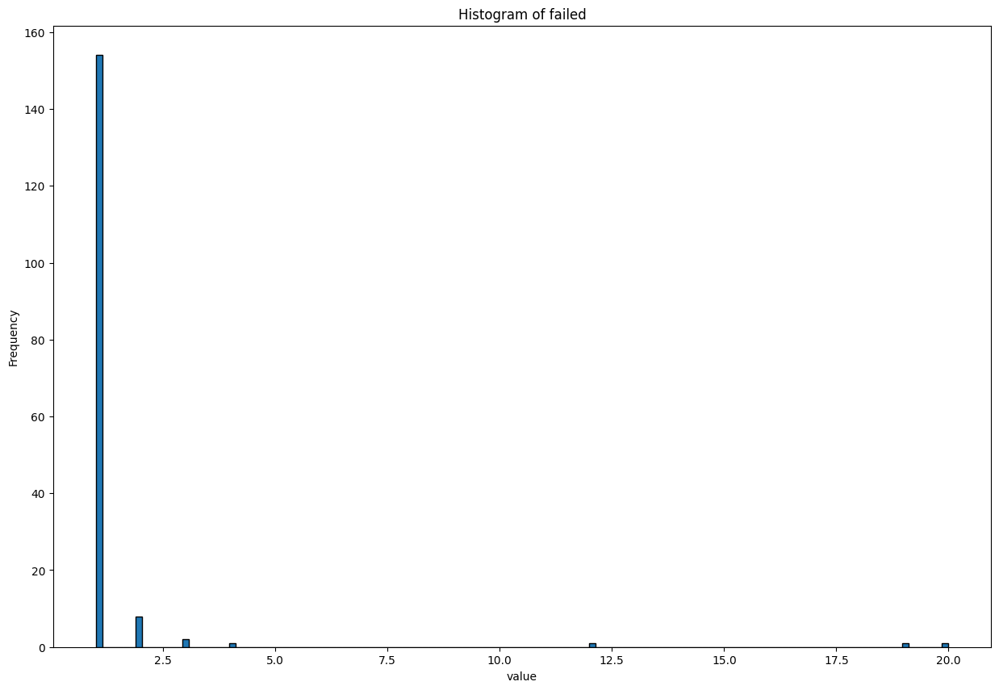

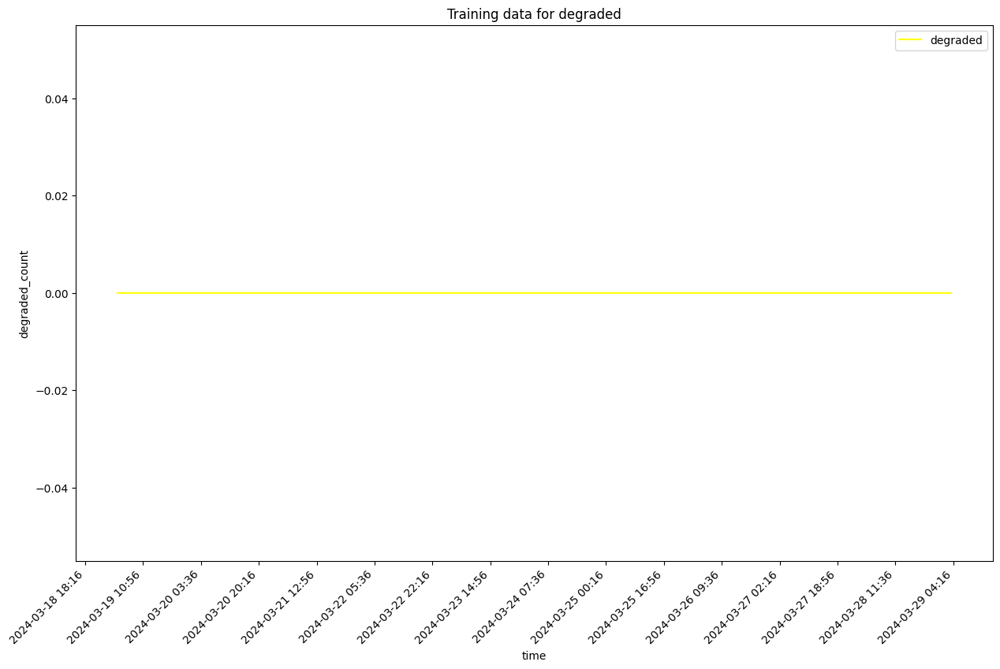

self.df_training shape  14400
Sum of histogram frequencies:  14400.0
Number of non-NaN records in column x:  14400


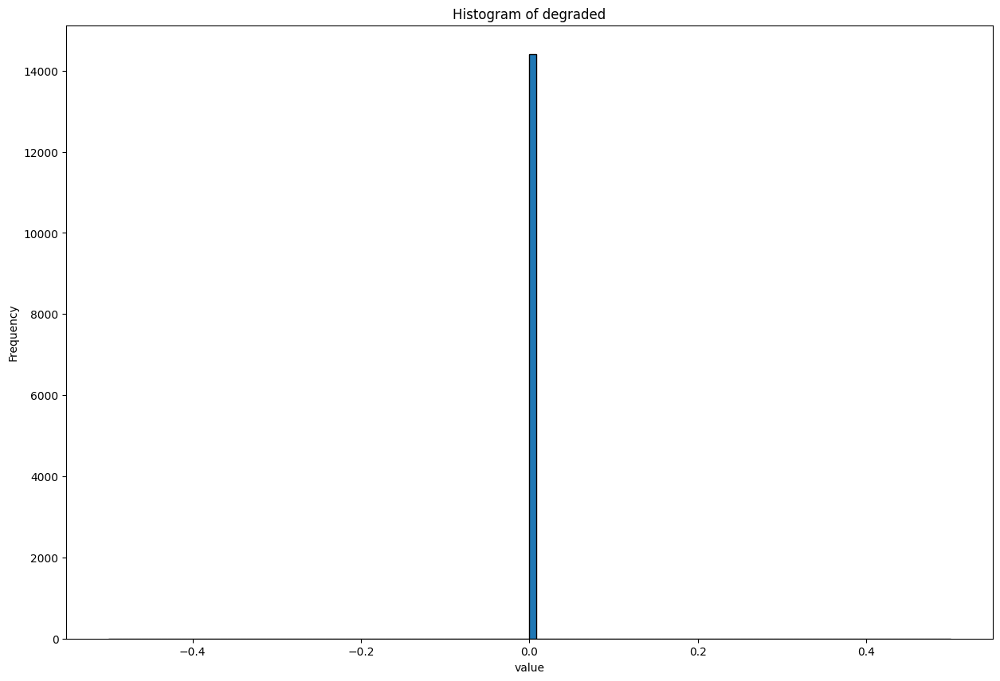

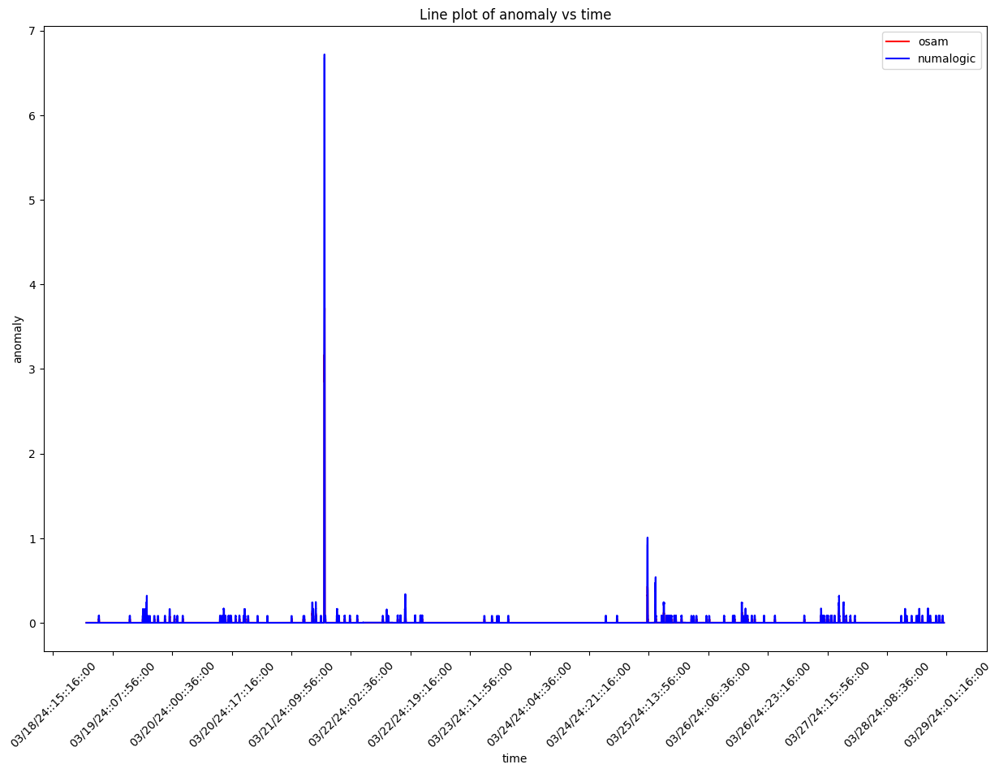

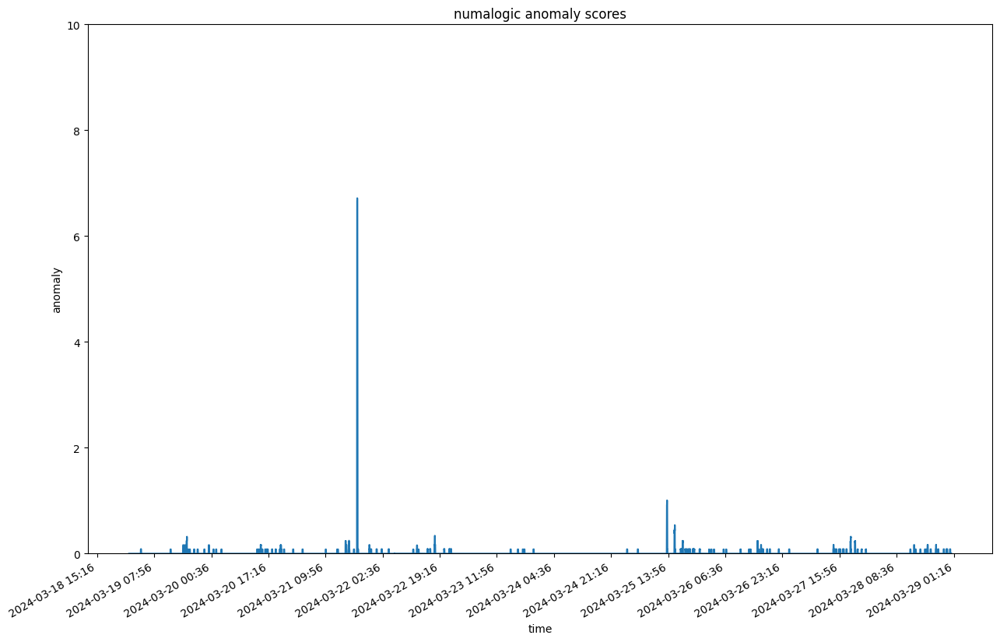

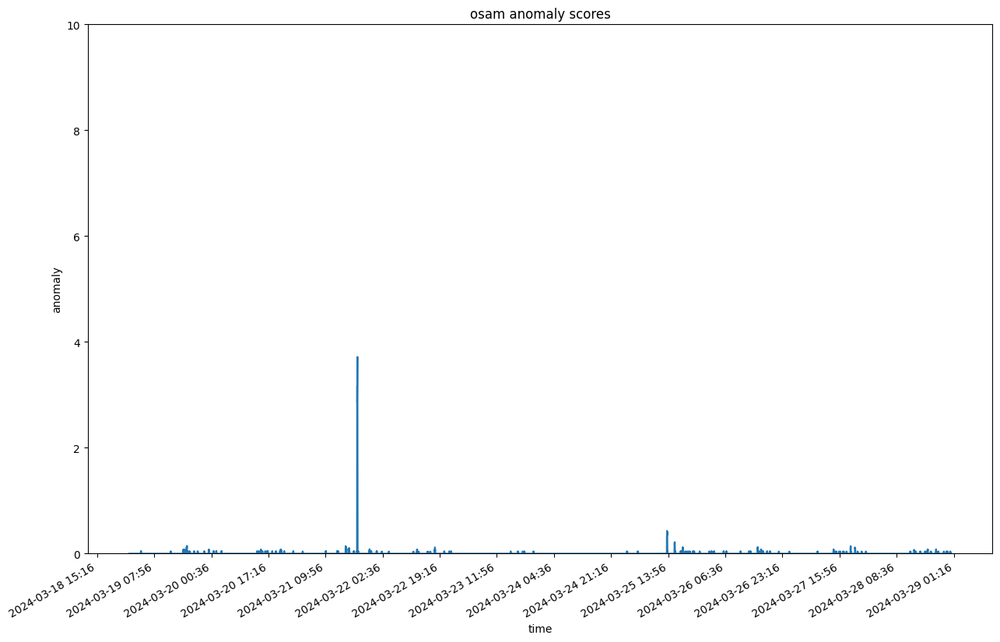

DEBUG:numalogic.connectors.druid._druid:Querying with end_dt: 2024-03-29 03:34:42.223746+00:00, that is with delay of 3 hrs


------------------------------------------------------------
------------------------------------------------------------        ModelId: fciPlugin:requestsFailed:5984175597303660107:collab-docmgmt-ui       ---------------------------------------------


DEBUG:numalogic.connectors.druid._druid:Druid params: {'datasource': 'tech-ip-customer-interaction-metrics', 'granularity': 'minute', 'intervals': ['2024-03-19T03:34:42.223746+00:00/2024-03-29T03:34:42.223746+00:00'], 'aggregations': {'count': {'type': 'doubleSum', 'fieldName': 'count', 'name': 'count'}}, 'post_aggregations': {}, 'filter': <pydruid.utils.filters.Filter object at 0x2cb56d5d0>, 'dimensions': <map object at 0x2cb43d030>, 'context': {'timeout': 10000, 'configIds': ['assetId', 'pluginId'], 'source': 'numalogic'}}, fetch time: 1.3350s
DEBUG:numalogic.udfs.tools:Querying with end_dt: 2024-03-29 00:34:45.561077+00:00, that is with delay of 3 hrs
DEBUG:numalogic.udfs.tools:Querying with end_dt: 2024-03-29 00:34:45.561077+00:00, that is with delay of 3 hrs


--- 2.480354070663452 seconds ---
--- 1.8887460231781006 seconds ---


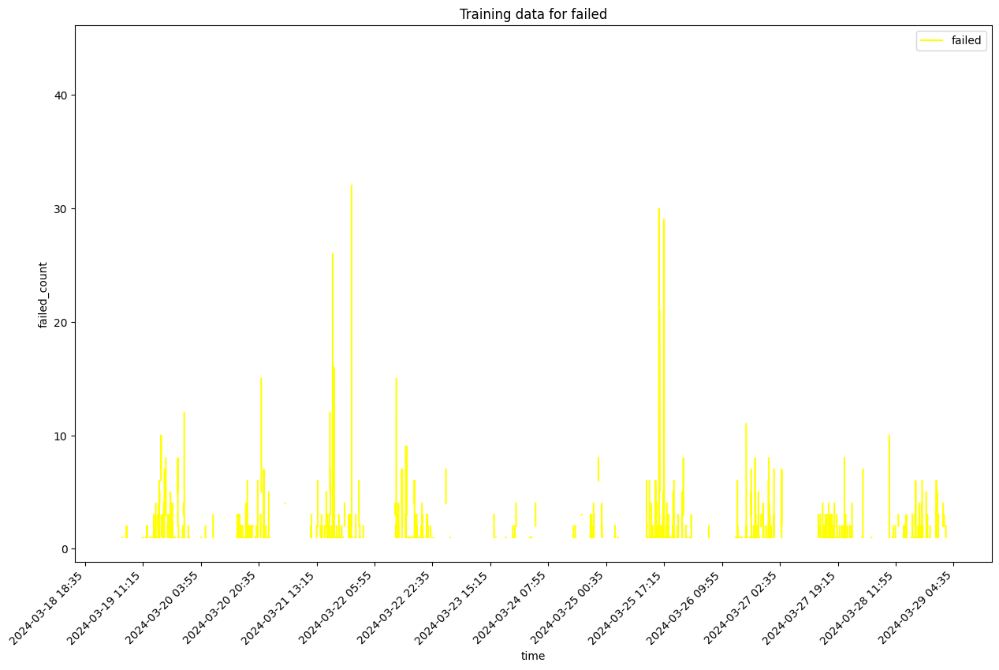

self.df_training shape  14289
Sum of histogram frequencies:  1989.0
Number of non-NaN records in column x:  1989


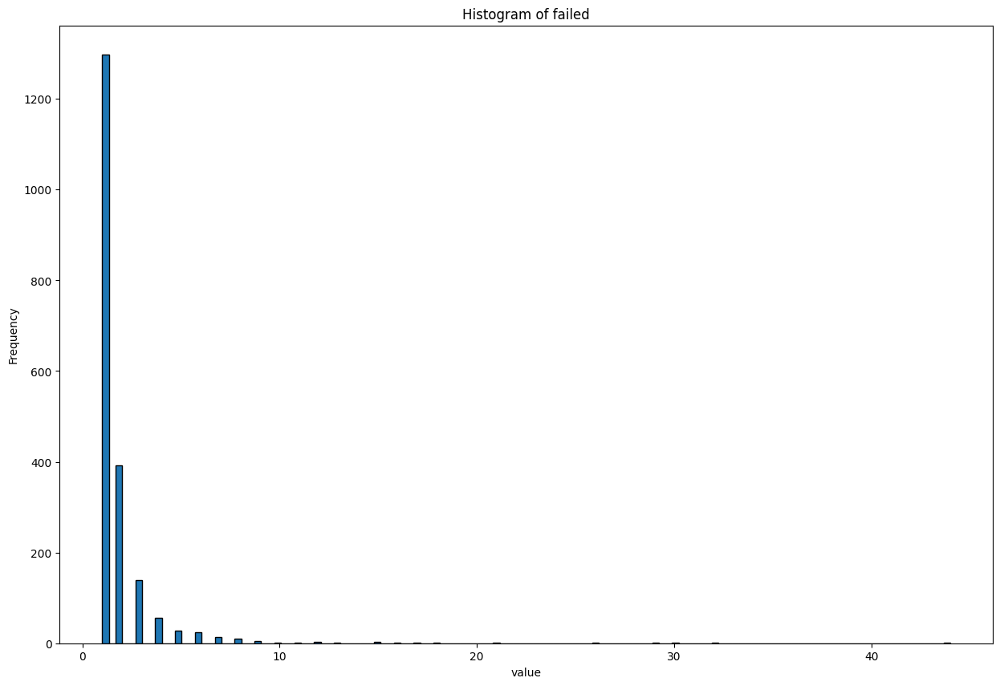

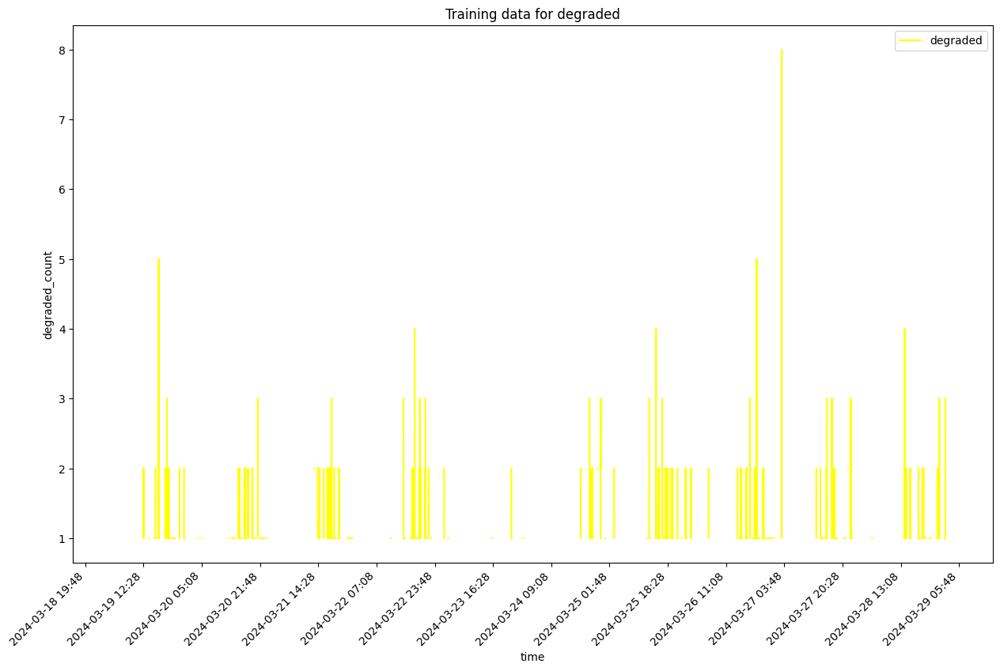

self.df_training shape  14289
Sum of histogram frequencies:  1369.0
Number of non-NaN records in column x:  1369


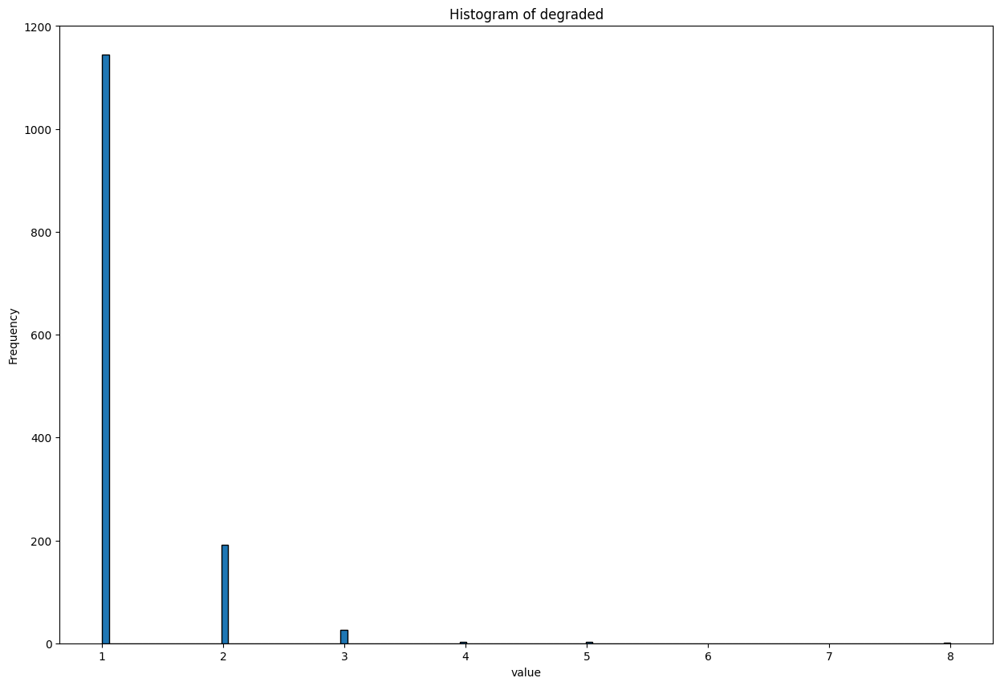

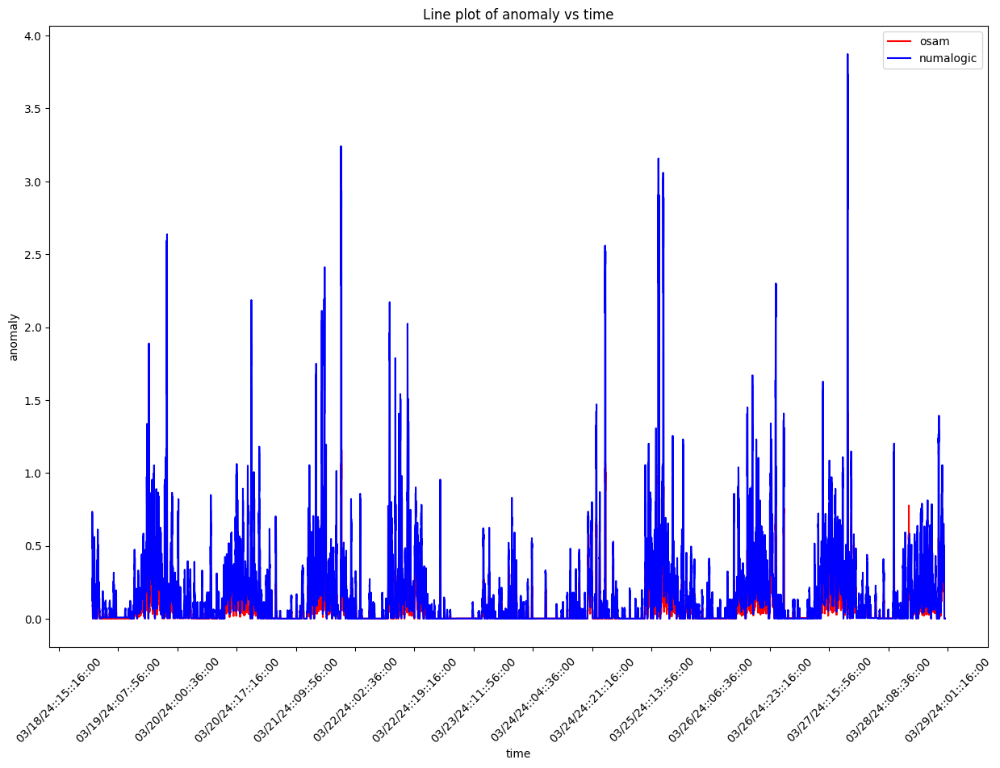

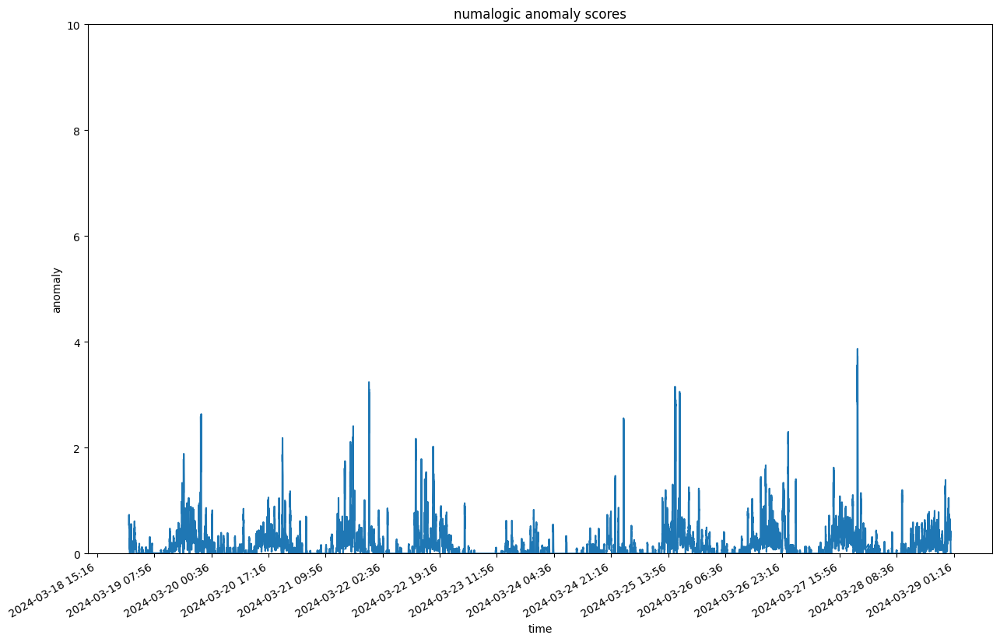

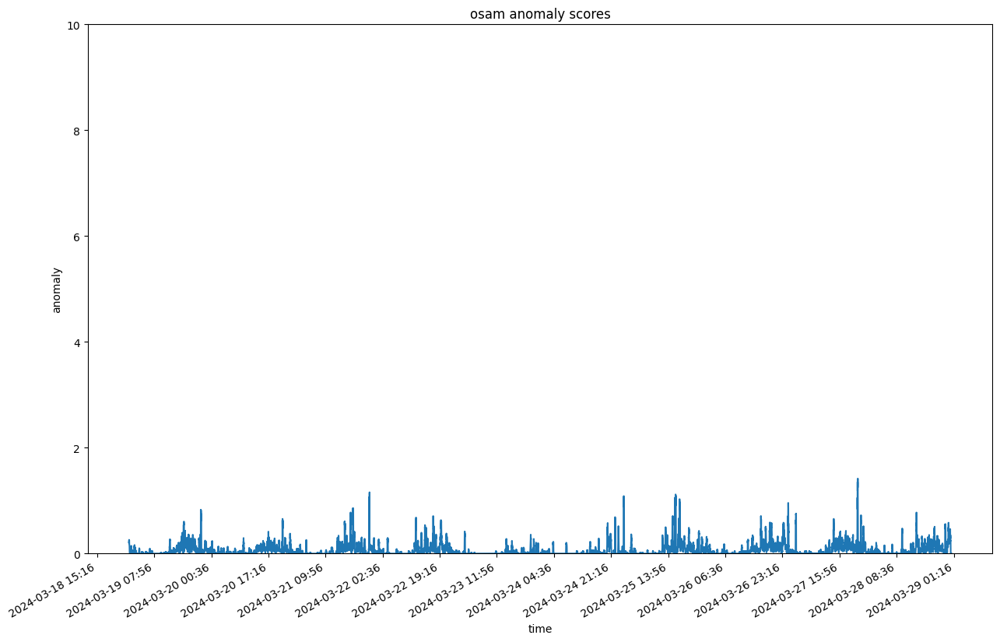

DEBUG:numalogic.connectors.druid._druid:Querying with end_dt: 2024-03-29 03:34:54.544603+00:00, that is with delay of 3 hrs


------------------------------------------------------------
------------------------------------------------------------        ModelId: fci:interactionsFailed:5984175597303660107:trsnsactionsfc-update-style-preferences       ---------------------------------------------


DEBUG:numalogic.connectors.druid._druid:Druid params: {'datasource': 'tech-ip-customer-interaction-metrics', 'granularity': 'minute', 'intervals': ['2024-03-19T03:34:54.544603+00:00/2024-03-29T03:34:54.544603+00:00'], 'aggregations': {'count': {'type': 'doubleSum', 'fieldName': 'count', 'name': 'count'}}, 'post_aggregations': {}, 'filter': <pydruid.utils.filters.Filter object at 0x2cb0ffbb0>, 'dimensions': <map object at 0x2cb12b6a0>, 'context': {'timeout': 10000, 'configIds': ['assetId', 'interactionName'], 'source': 'numalogic'}}, fetch time: 1.3986s
DEBUG:numalogic.udfs.tools:Querying with end_dt: 2024-03-29 00:34:57.948329+00:00, that is with delay of 3 hrs
DEBUG:numalogic.udfs.tools:Querying with end_dt: 2024-03-29 00:34:57.948329+00:00, that is with delay of 3 hrs


--- 2.1475281715393066 seconds ---
--- 1.8787448406219482 seconds ---


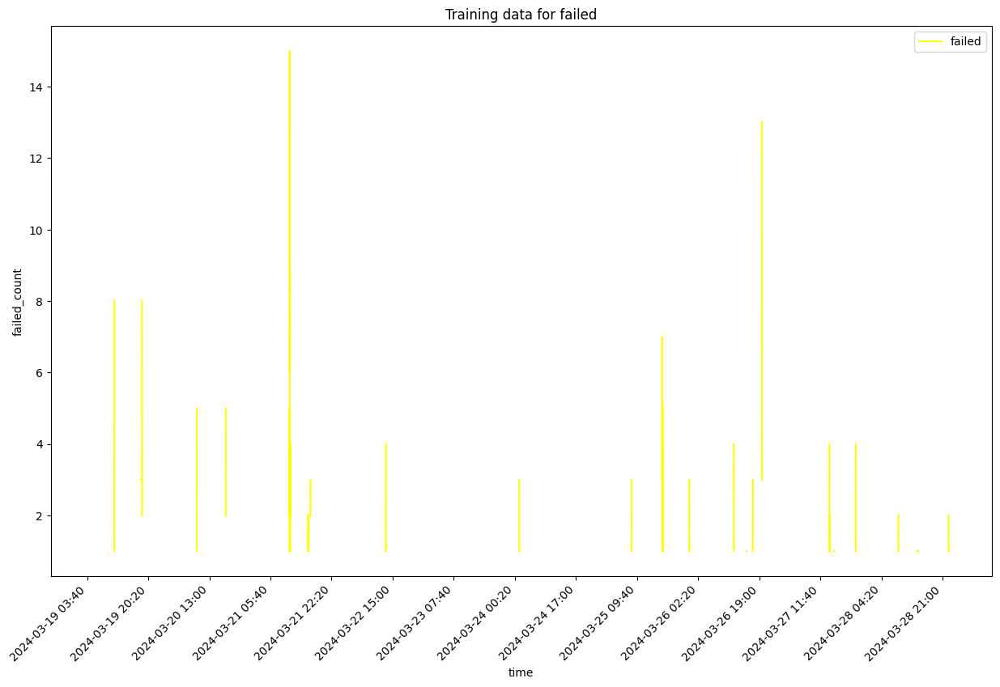

self.df_training shape  14296
Sum of histogram frequencies:  148.0
Number of non-NaN records in column x:  148


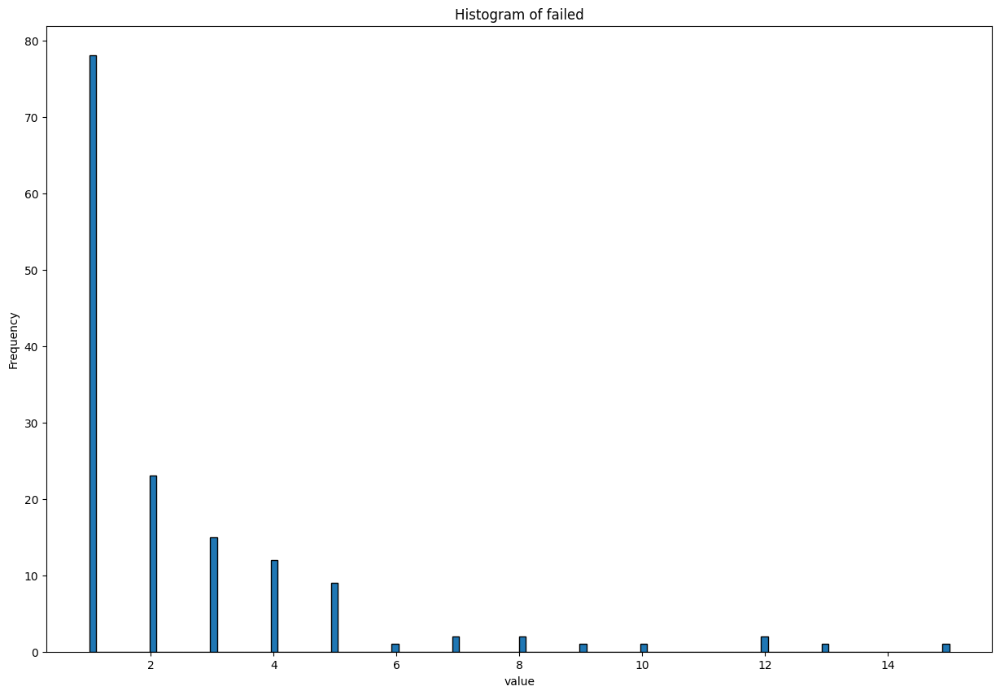

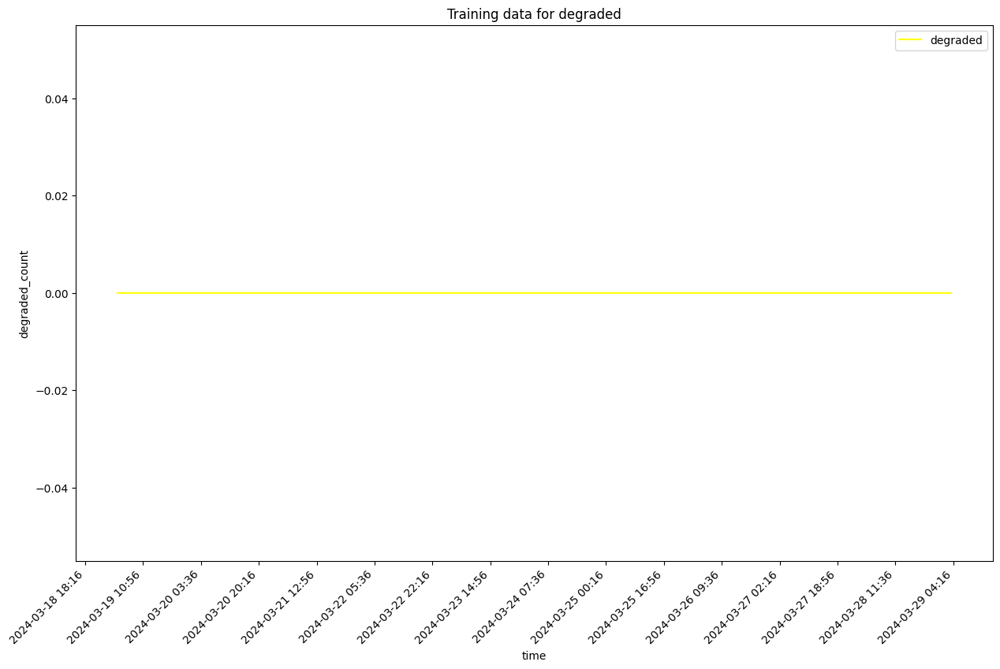

self.df_training shape  14296
Sum of histogram frequencies:  14296.0
Number of non-NaN records in column x:  14296


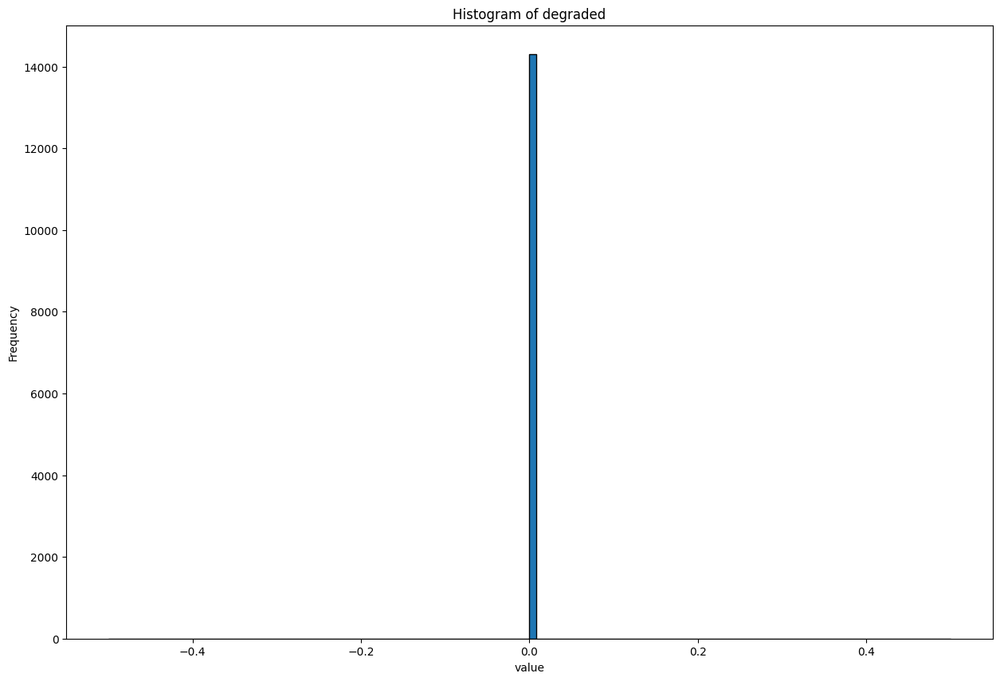

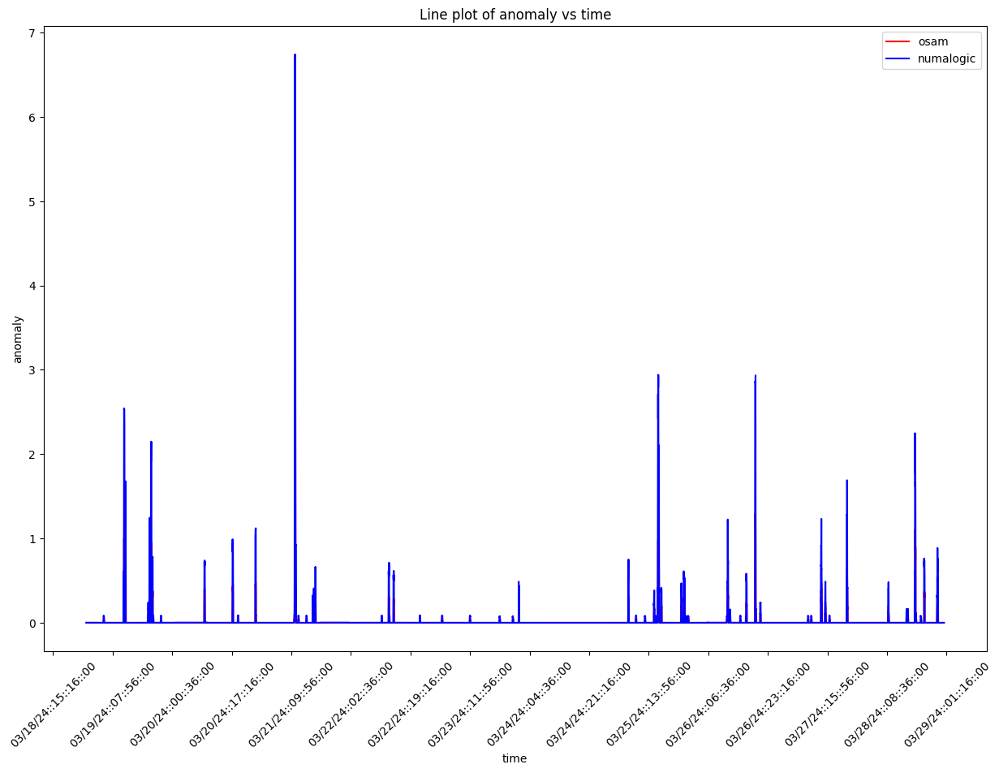

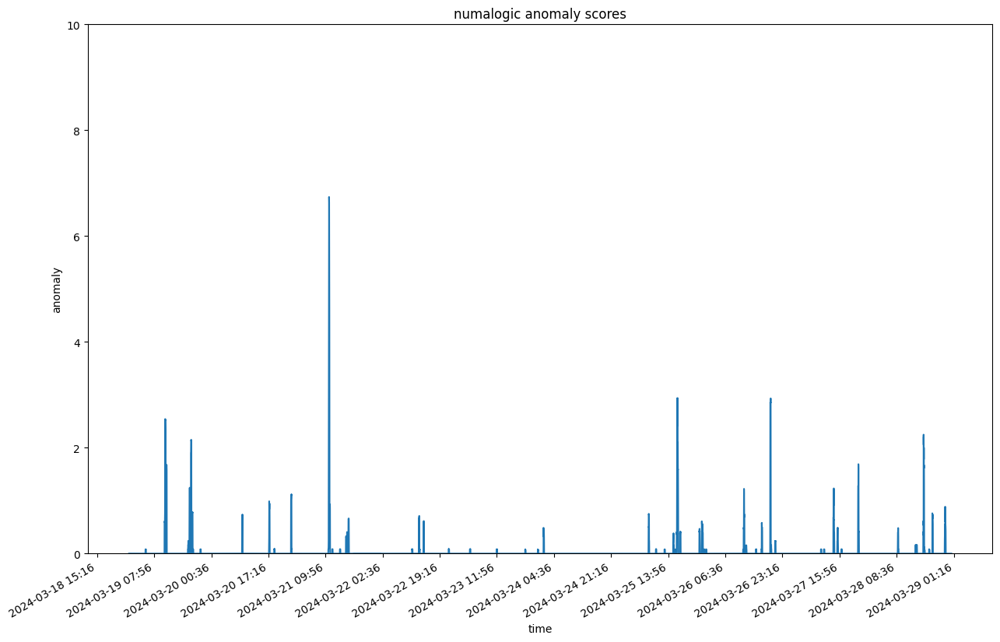

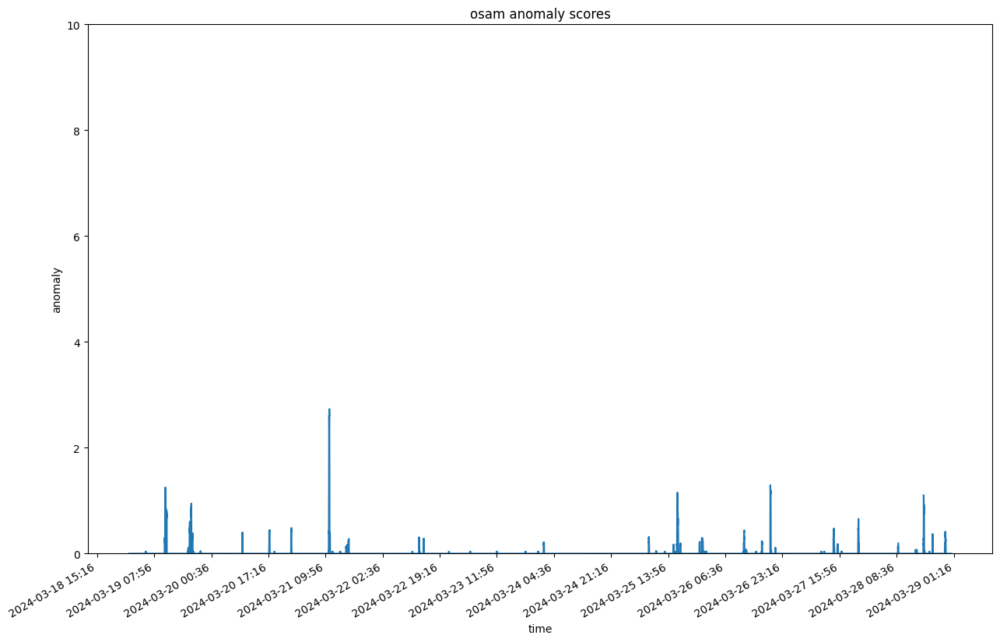

DEBUG:numalogic.connectors.druid._druid:Querying with end_dt: 2024-03-29 03:35:06.284774+00:00, that is with delay of 3 hrs


------------------------------------------------------------
------------------------------------------------------------        ModelId: fciPluginAppInteractions:metrics:8217961012385696693:868086420502860411:Collab_Docmgmt_UI_Get_Files_By_Ids_Elastic_Search       ---------------------------------------------


DEBUG:numalogic.connectors.druid._druid:Druid params: {'datasource': 'tech-ip-customer-interaction-metrics', 'granularity': 'minute', 'intervals': ['2024-03-19T03:35:06.284774+00:00/2024-03-29T03:35:06.284774+00:00'], 'aggregations': {'count': {'type': 'doubleSum', 'fieldName': 'count', 'name': 'count'}}, 'post_aggregations': {}, 'filter': <pydruid.utils.filters.Filter object at 0x2cb301ea0>, 'dimensions': <map object at 0x2cb5c04c0>, 'context': {'timeout': 10000, 'configIds': ['pluginAssetId', 'assetId', 'interactionName'], 'source': 'numalogic'}}, fetch time: 0.9418s
DEBUG:numalogic.udfs.tools:Querying with end_dt: 2024-03-29 00:35:09.229014+00:00, that is with delay of 3 hrs
DEBUG:numalogic.udfs.tools:Querying with end_dt: 2024-03-29 00:35:09.229014+00:00, that is with delay of 3 hrs


--- 2.1632256507873535 seconds ---
--- 2.6848928928375244 seconds ---


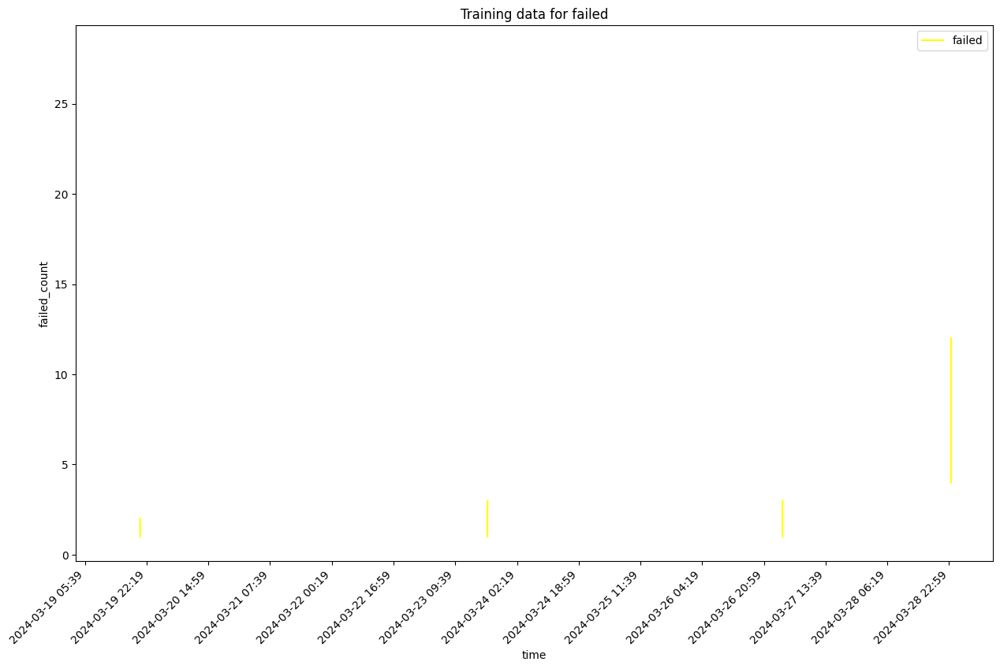

self.df_training shape  11911
Sum of histogram frequencies:  49.0
Number of non-NaN records in column x:  49


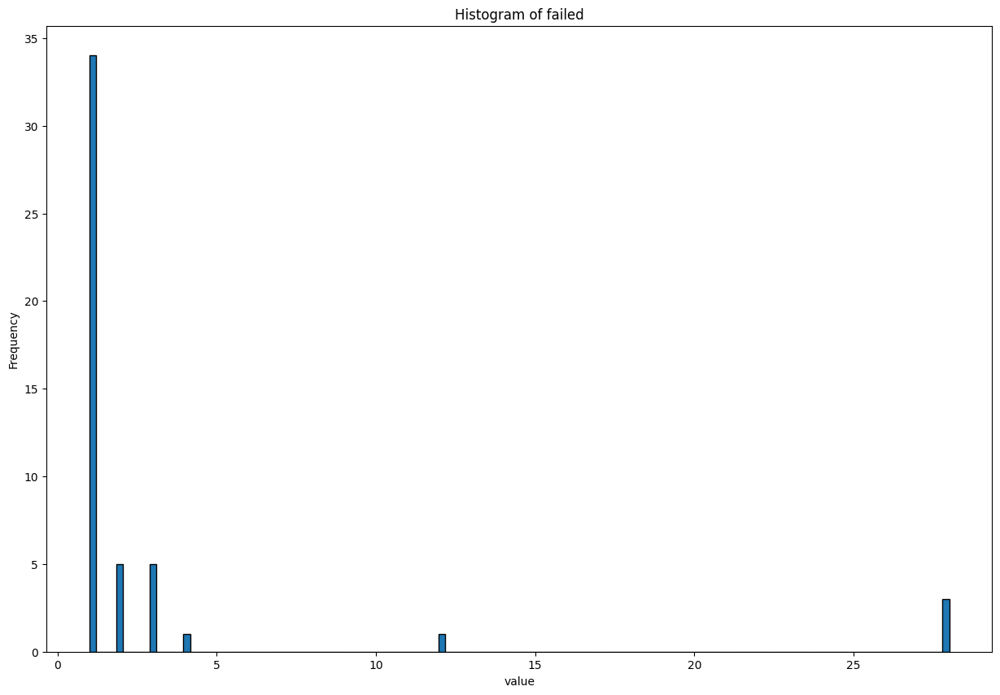

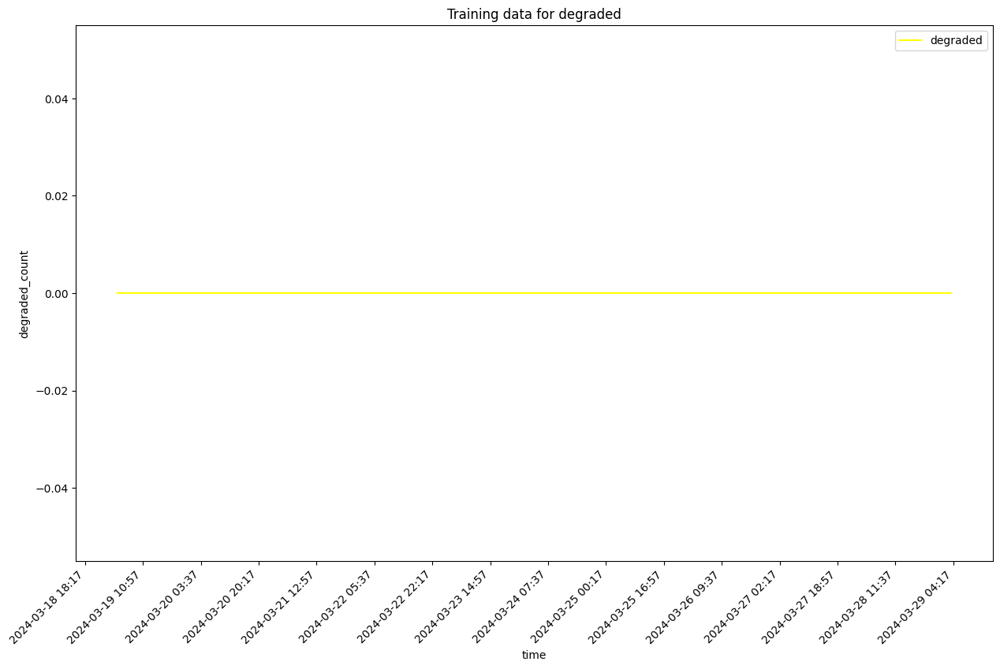

self.df_training shape  11911
Sum of histogram frequencies:  11911.0
Number of non-NaN records in column x:  11911


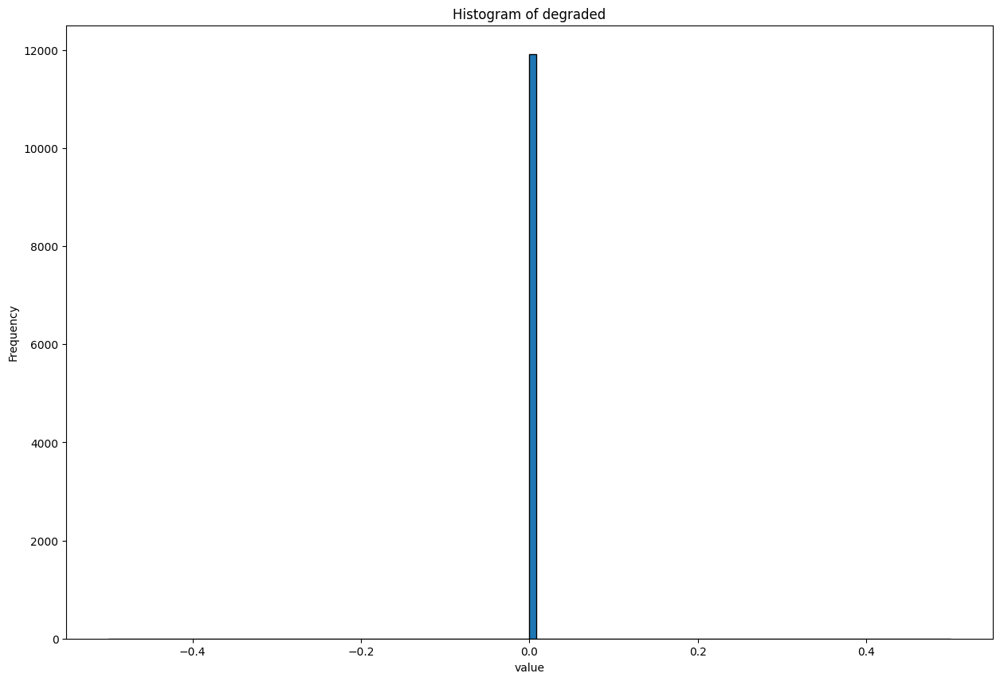

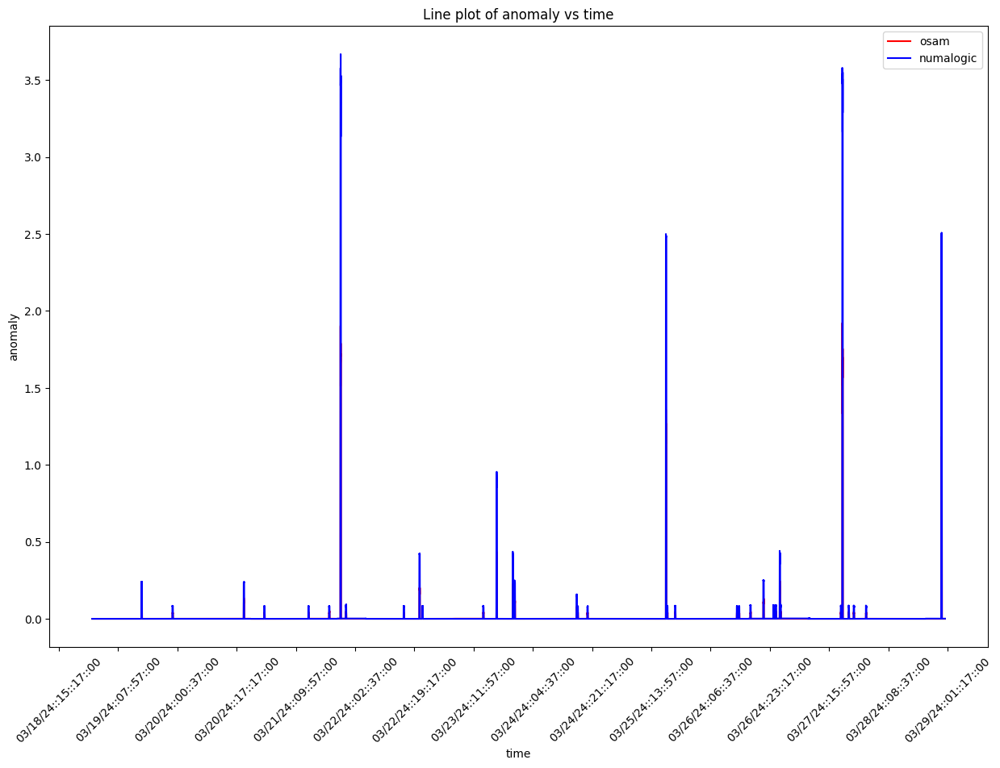

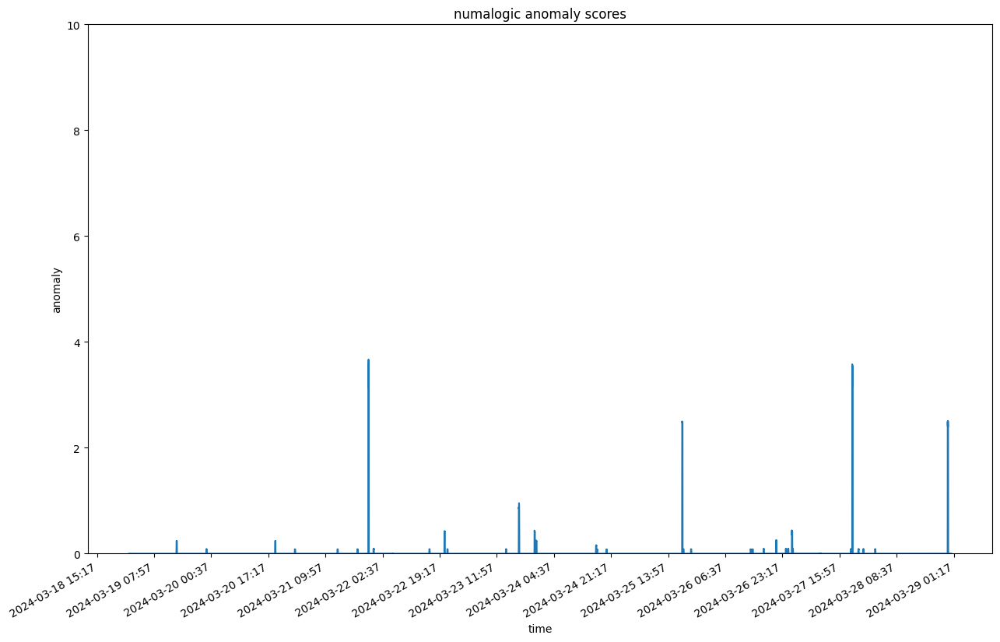

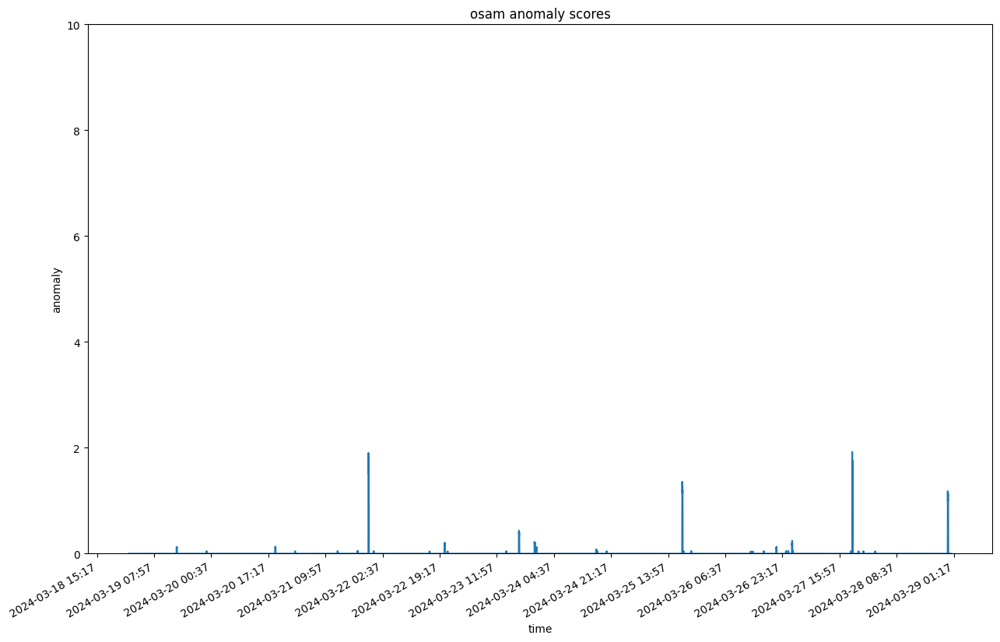

DEBUG:numalogic.connectors.druid._druid:Querying with end_dt: 2024-03-29 03:35:18.461226+00:00, that is with delay of 3 hrs


------------------------------------------------------------
------------------------------------------------------------        ModelId: fciAsset:assetFailed:8434133794656866131       ---------------------------------------------


DEBUG:numalogic.connectors.druid._druid:Druid params: {'datasource': 'tech-ip-customer-interaction-metrics', 'granularity': 'minute', 'intervals': ['2024-03-19T03:35:18.461226+00:00/2024-03-29T03:35:18.461226+00:00'], 'aggregations': {'count': {'type': 'doubleSum', 'fieldName': 'count', 'name': 'count'}}, 'post_aggregations': {}, 'filter': <pydruid.utils.filters.Filter object at 0x2cb344460>, 'dimensions': <map object at 0x2cb8d18a0>, 'context': {'timeout': 10000, 'configIds': ['assetId'], 'source': 'numalogic'}}, fetch time: 1.2801s
DEBUG:numalogic.udfs.tools:Querying with end_dt: 2024-03-29 00:35:21.743736+00:00, that is with delay of 3 hrs
DEBUG:numalogic.udfs.tools:Querying with end_dt: 2024-03-29 00:35:21.743736+00:00, that is with delay of 3 hrs


--- 2.3705570697784424 seconds ---
--- 2.3617818355560303 seconds ---


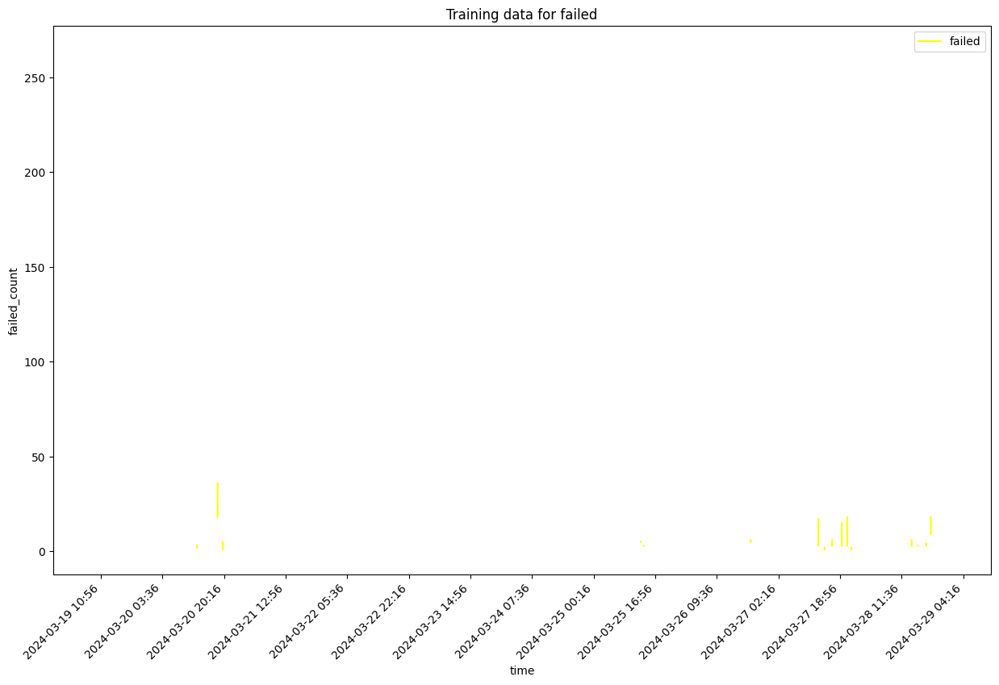

self.df_training shape  13910
Sum of histogram frequencies:  228.0
Number of non-NaN records in column x:  228


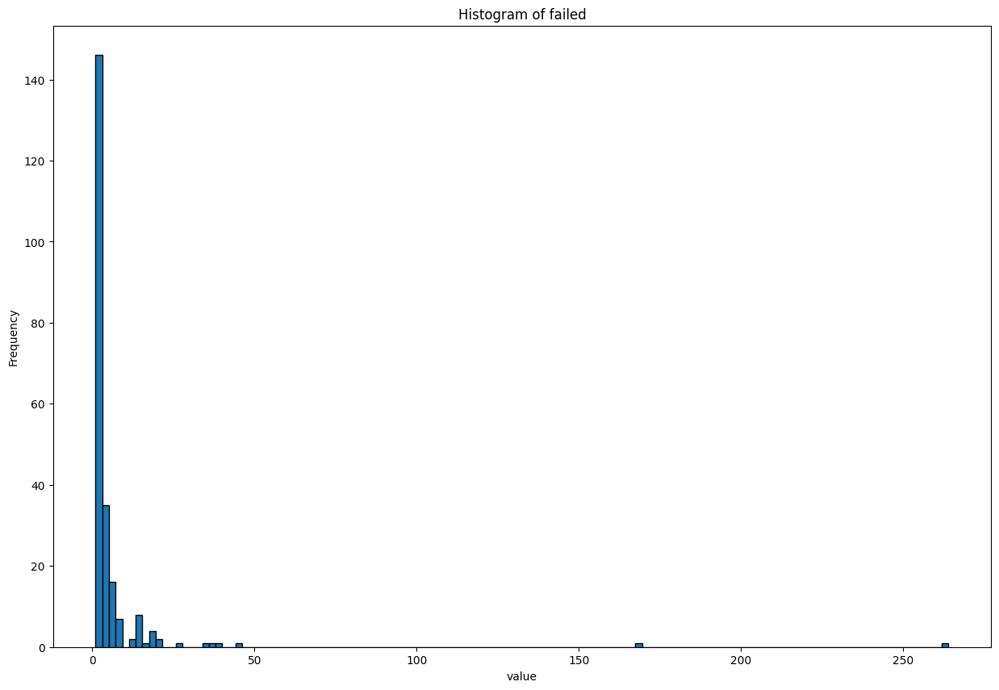

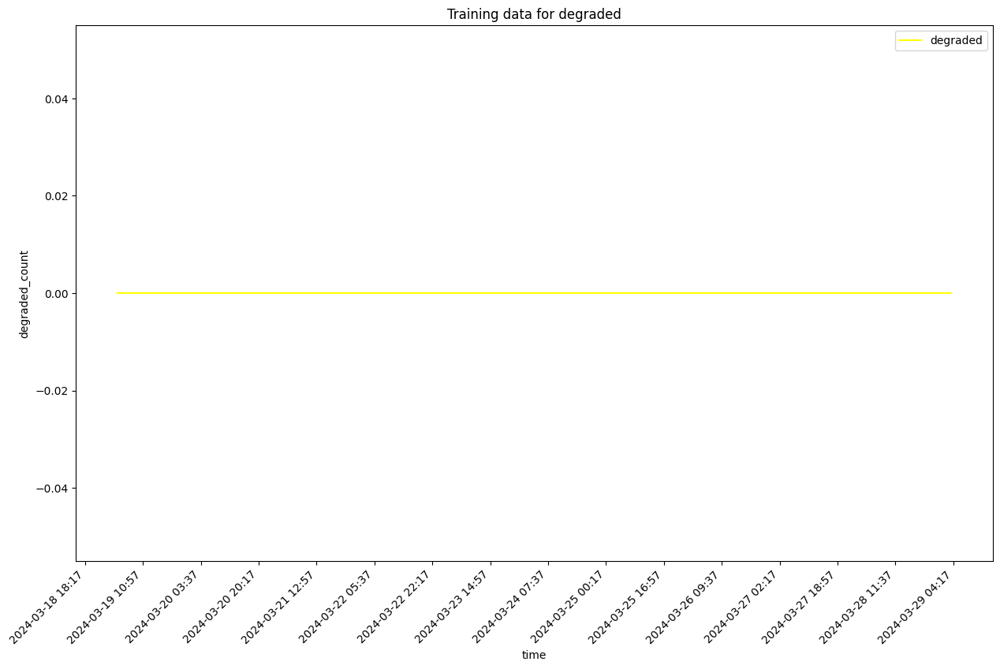

self.df_training shape  13910
Sum of histogram frequencies:  13910.0
Number of non-NaN records in column x:  13910


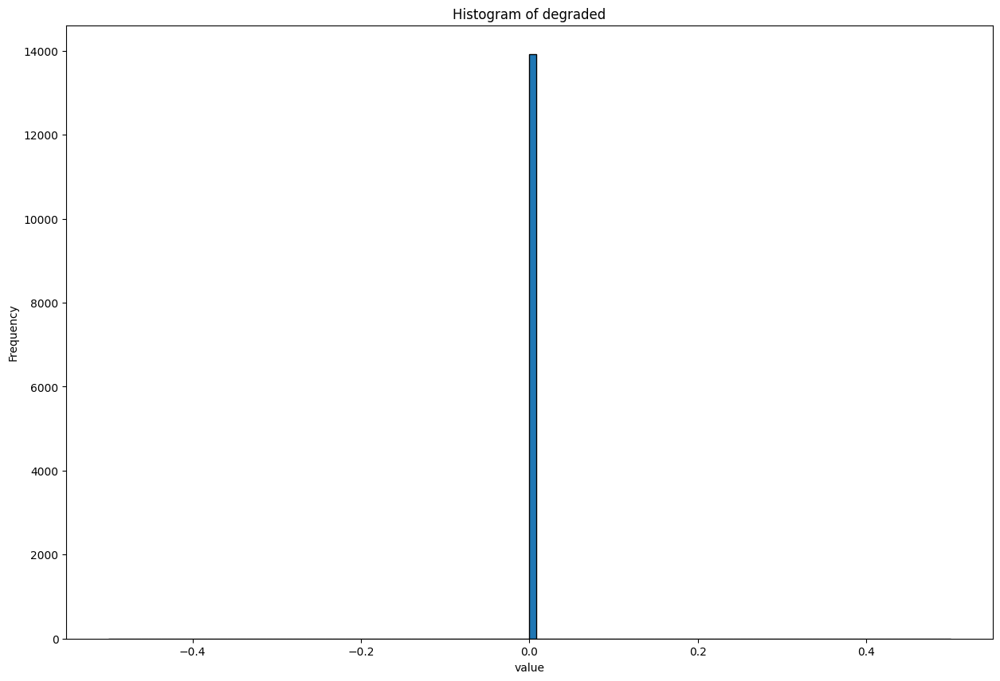

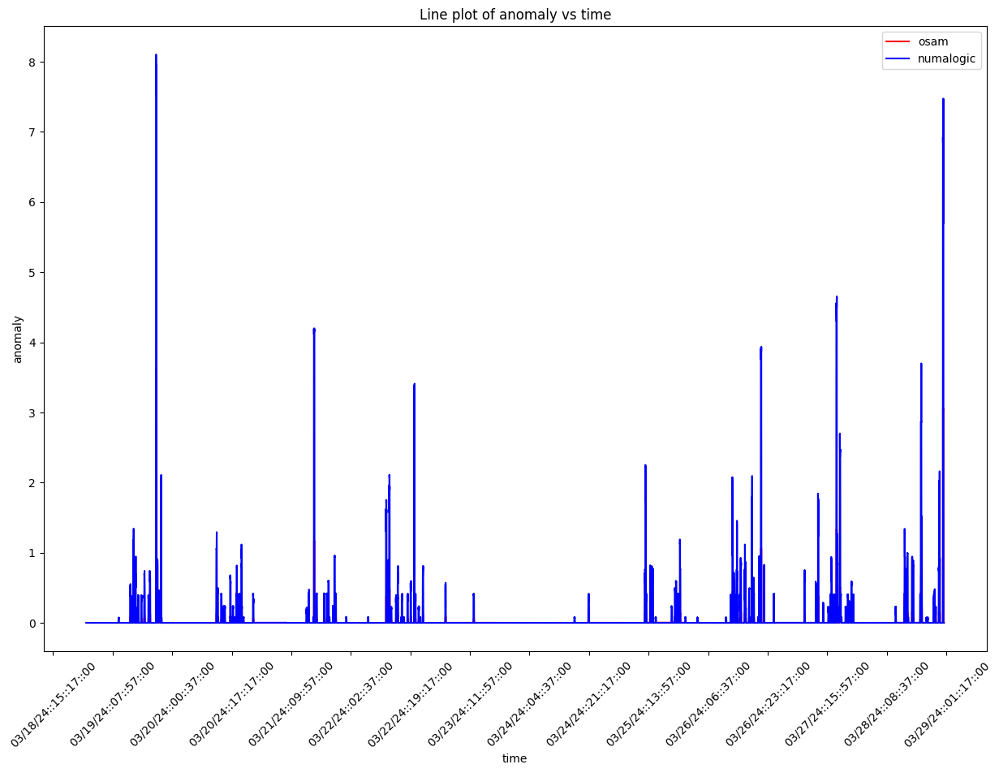

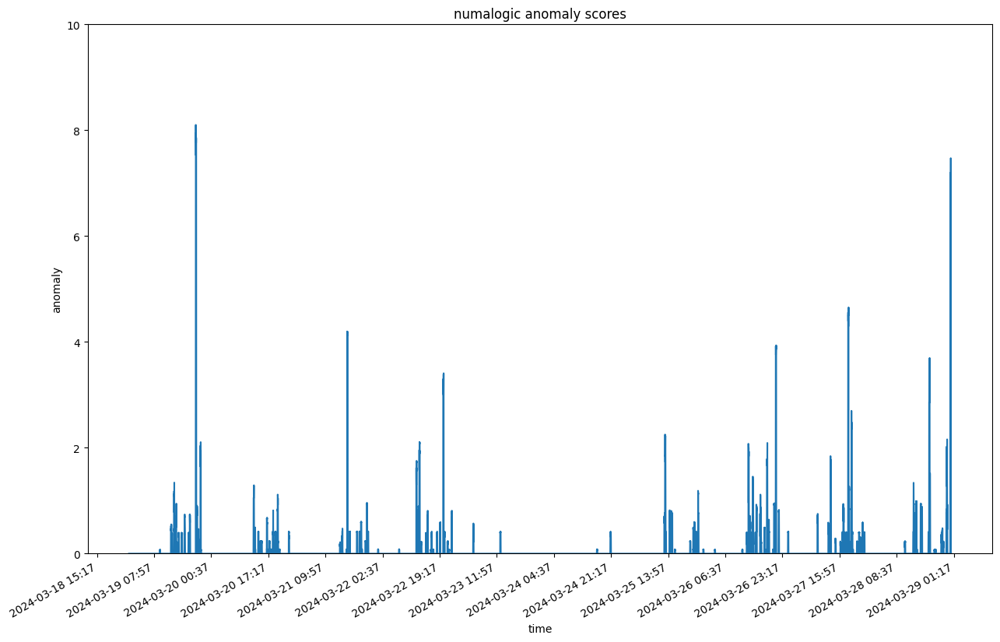

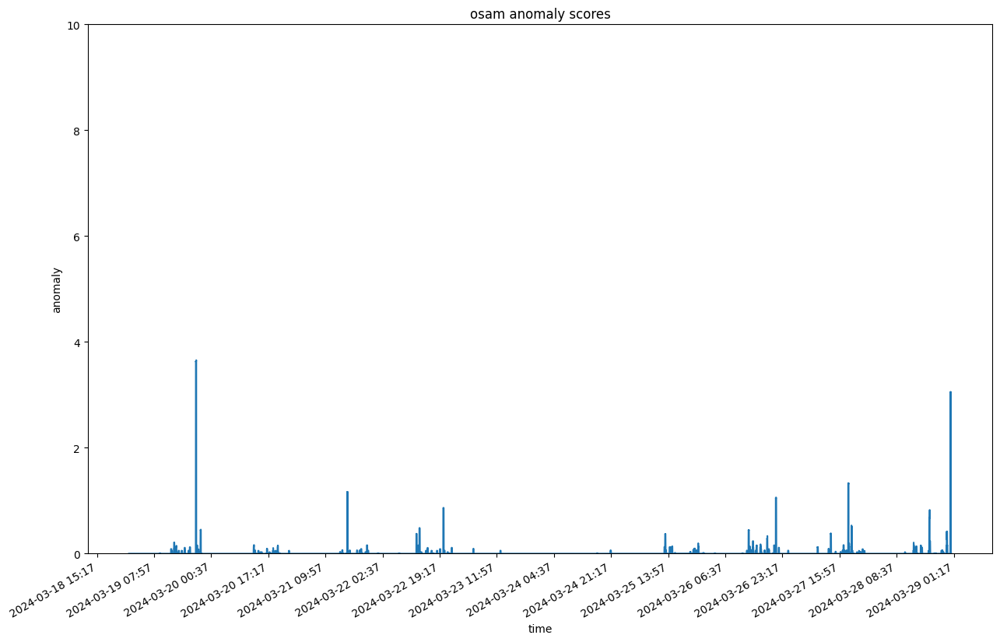

DEBUG:numalogic.connectors.druid._druid:Querying with end_dt: 2024-03-29 03:35:30.728495+00:00, that is with delay of 3 hrs


------------------------------------------------------------
------------------------------------------------------------        ModelId: fciPlugin:requestsFailed:5477520638979968238:tto-shell-ui       ---------------------------------------------


DEBUG:numalogic.connectors.druid._druid:Druid params: {'datasource': 'tech-ip-customer-interaction-metrics', 'granularity': 'minute', 'intervals': ['2024-03-19T03:35:30.728495+00:00/2024-03-29T03:35:30.728495+00:00'], 'aggregations': {'count': {'type': 'doubleSum', 'fieldName': 'count', 'name': 'count'}}, 'post_aggregations': {}, 'filter': <pydruid.utils.filters.Filter object at 0x2cbcc8d30>, 'dimensions': <map object at 0x2cbcca980>, 'context': {'timeout': 10000, 'configIds': ['assetId', 'pluginId'], 'source': 'numalogic'}}, fetch time: 1.6306s
DEBUG:numalogic.udfs.tools:Querying with end_dt: 2024-03-29 00:35:34.361075+00:00, that is with delay of 3 hrs
DEBUG:numalogic.udfs.tools:Querying with end_dt: 2024-03-29 00:35:34.361075+00:00, that is with delay of 3 hrs


--- 2.184174060821533 seconds ---
--- 1.5822279453277588 seconds ---


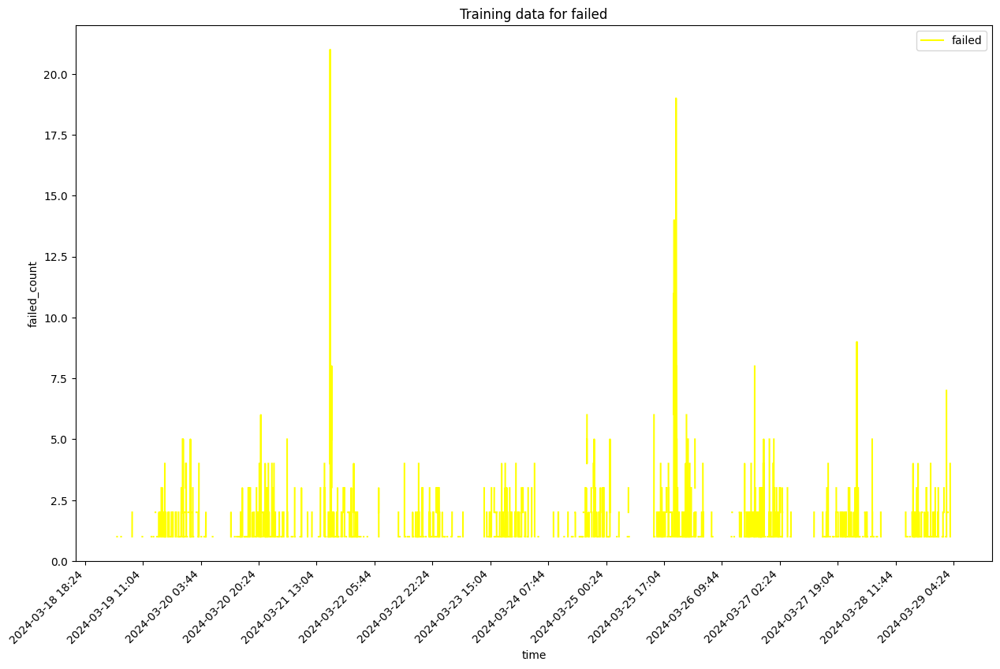

self.df_training shape  14297
Sum of histogram frequencies:  2855.0
Number of non-NaN records in column x:  2855


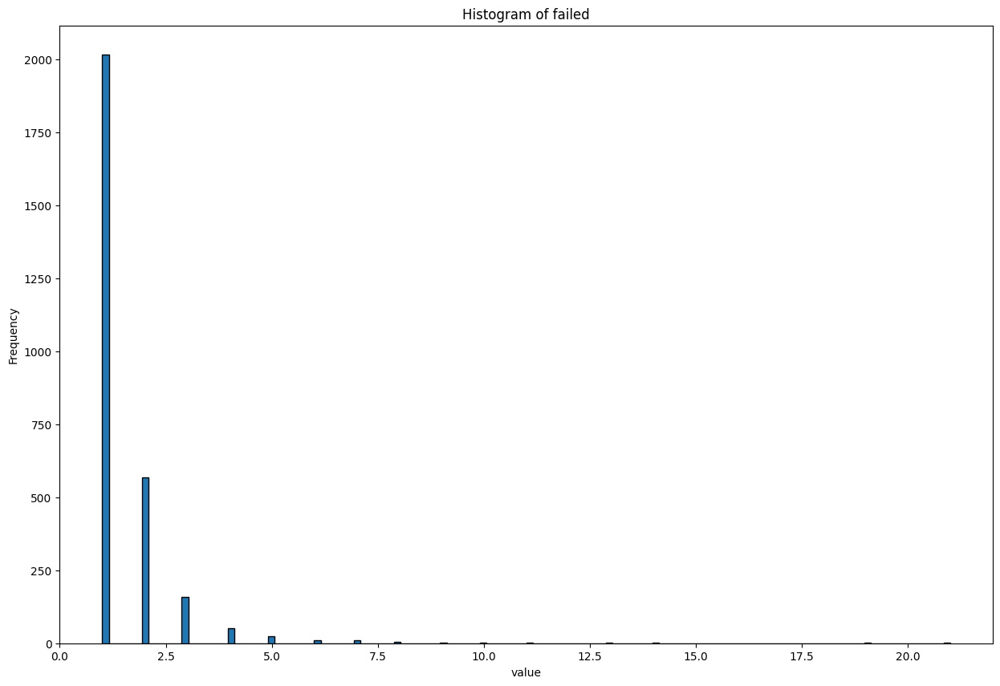

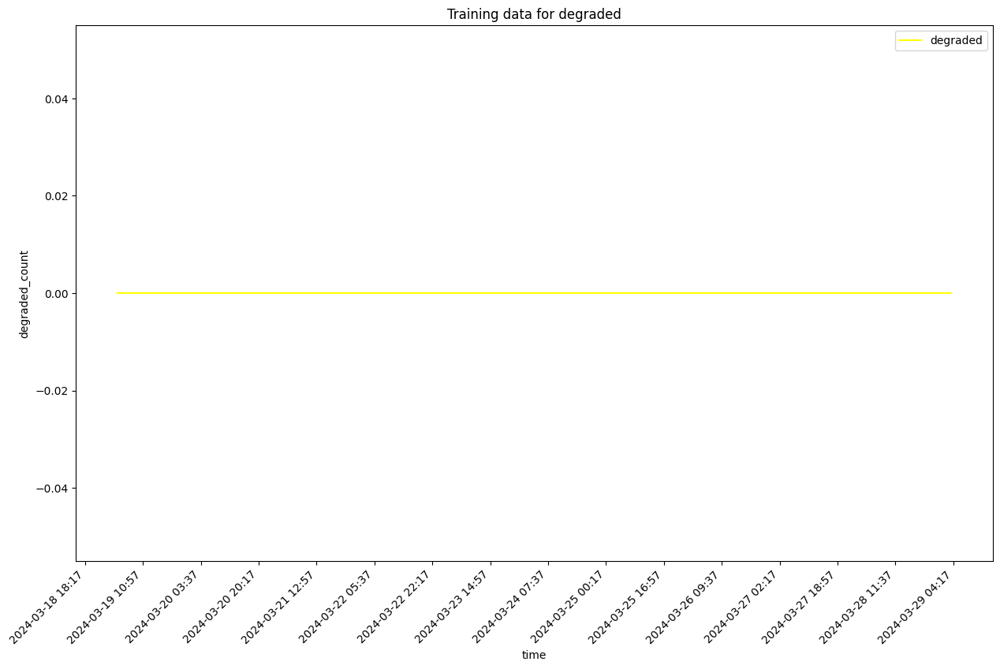

self.df_training shape  14297
Sum of histogram frequencies:  14297.0
Number of non-NaN records in column x:  14297


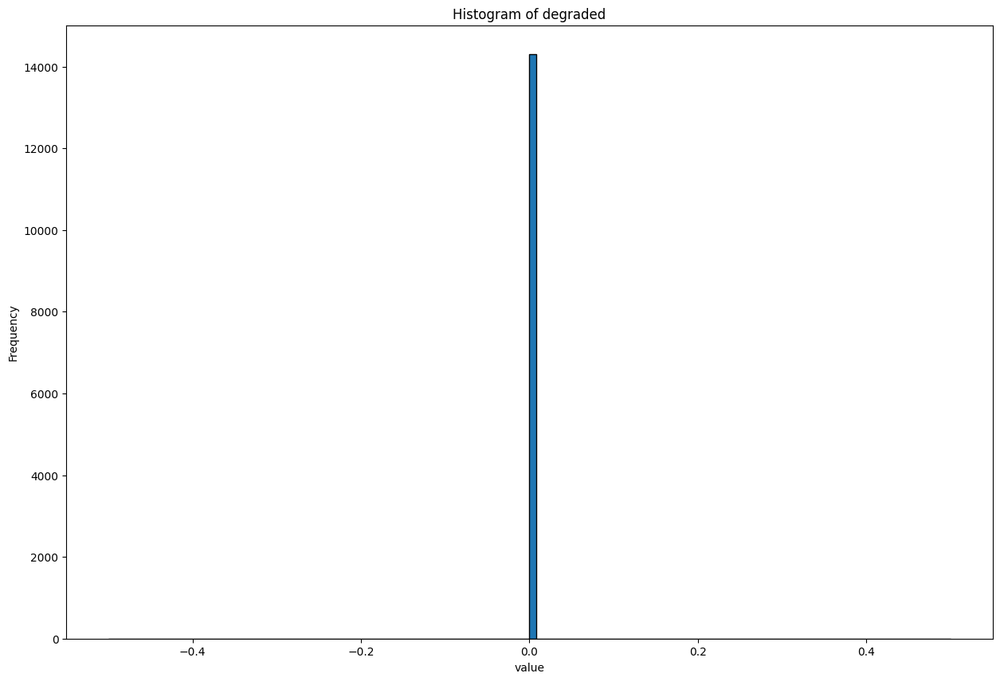

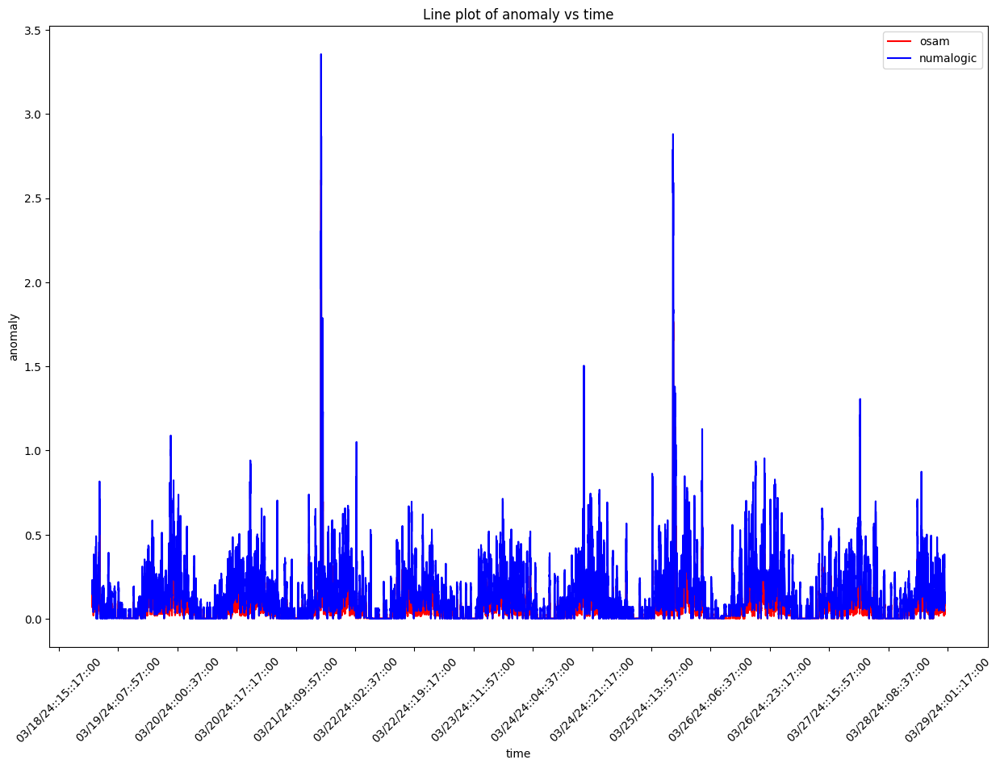

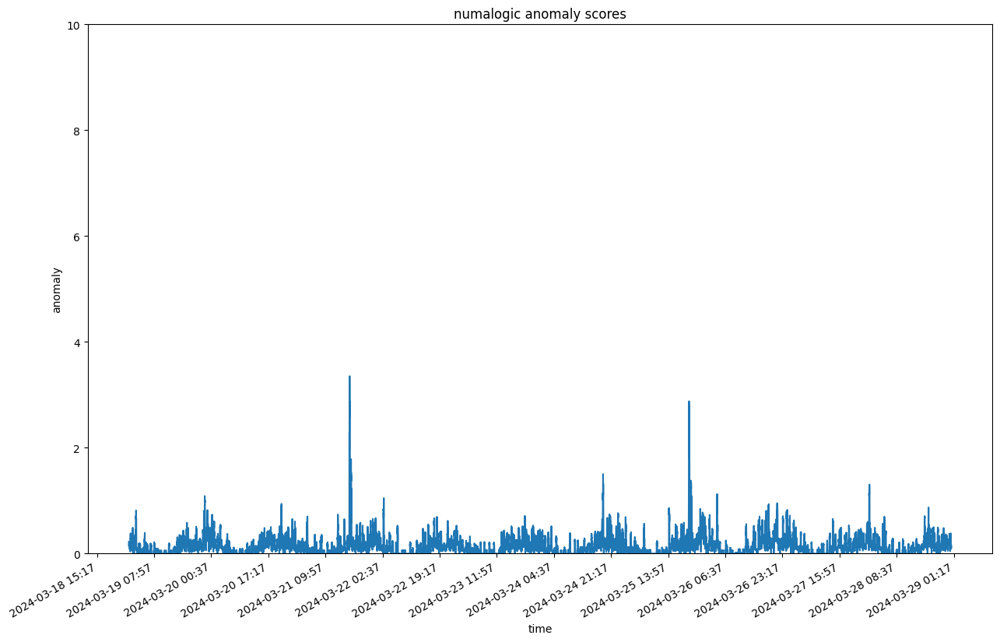

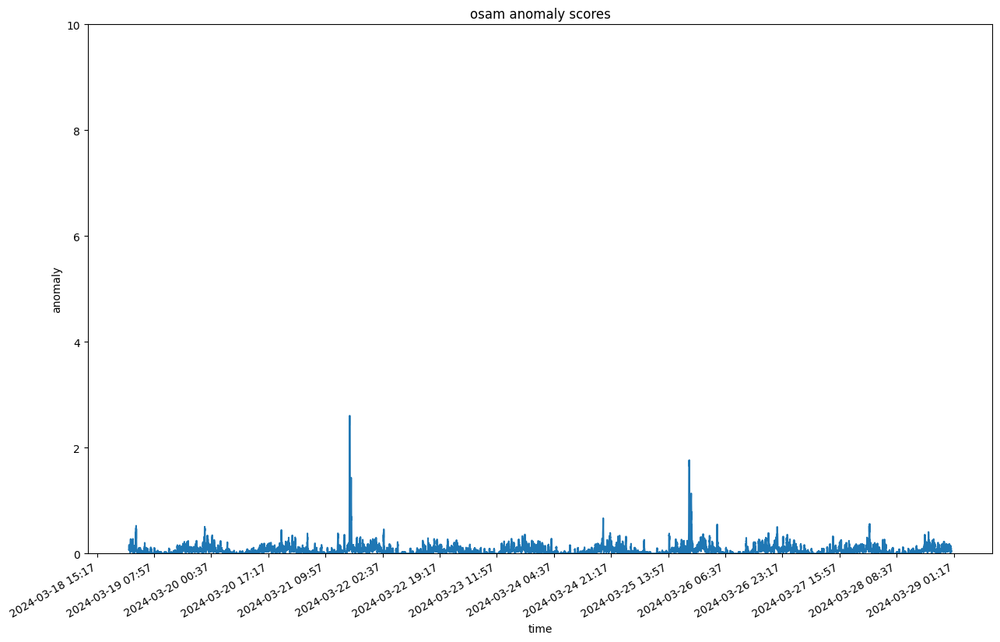

DEBUG:numalogic.connectors.druid._druid:Querying with end_dt: 2024-03-29 03:35:42.615037+00:00, that is with delay of 3 hrs


------------------------------------------------------------
------------------------------------------------------------        ModelId: fciPluginAppInteractions:metrics:2453353489468585843:5984175597303660107:newAccountMlSuggestedIds       ---------------------------------------------


DEBUG:numalogic.connectors.druid._druid:Druid params: {'datasource': 'tech-ip-customer-interaction-metrics', 'granularity': 'minute', 'intervals': ['2024-03-19T03:35:42.615037+00:00/2024-03-29T03:35:42.615037+00:00'], 'aggregations': {'count': {'type': 'doubleSum', 'fieldName': 'count', 'name': 'count'}}, 'post_aggregations': {}, 'filter': <pydruid.utils.filters.Filter object at 0x2cbbc4f70>, 'dimensions': <map object at 0x2cb0dfb50>, 'context': {'timeout': 10000, 'configIds': ['pluginAssetId', 'assetId', 'interactionName'], 'source': 'numalogic'}}, fetch time: 1.3532s
DEBUG:numalogic.udfs.tools:Querying with end_dt: 2024-03-29 00:35:45.974001+00:00, that is with delay of 3 hrs
DEBUG:numalogic.udfs.tools:Querying with end_dt: 2024-03-29 00:35:45.974001+00:00, that is with delay of 3 hrs


--- 2.1216981410980225 seconds ---
--- 1.9813380241394043 seconds ---


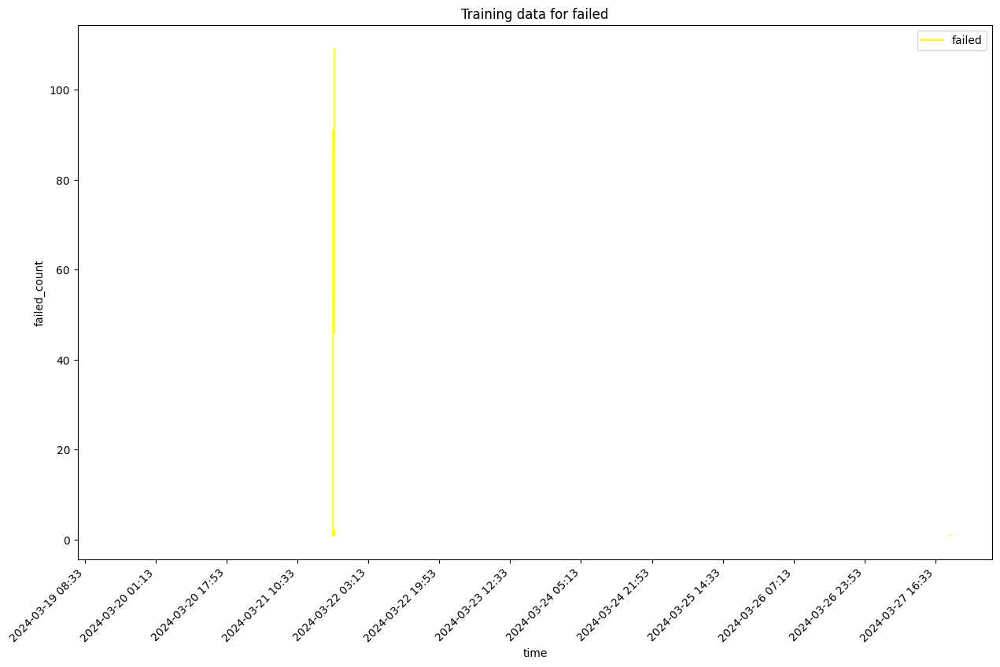

self.df_training shape  14400
Sum of histogram frequencies:  22.0
Number of non-NaN records in column x:  22


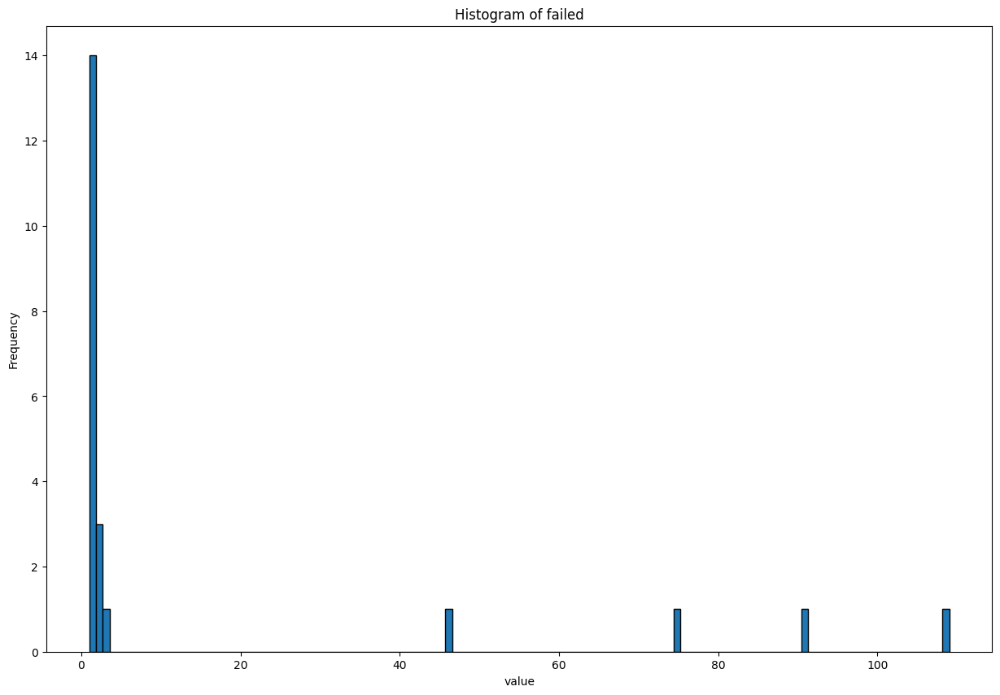

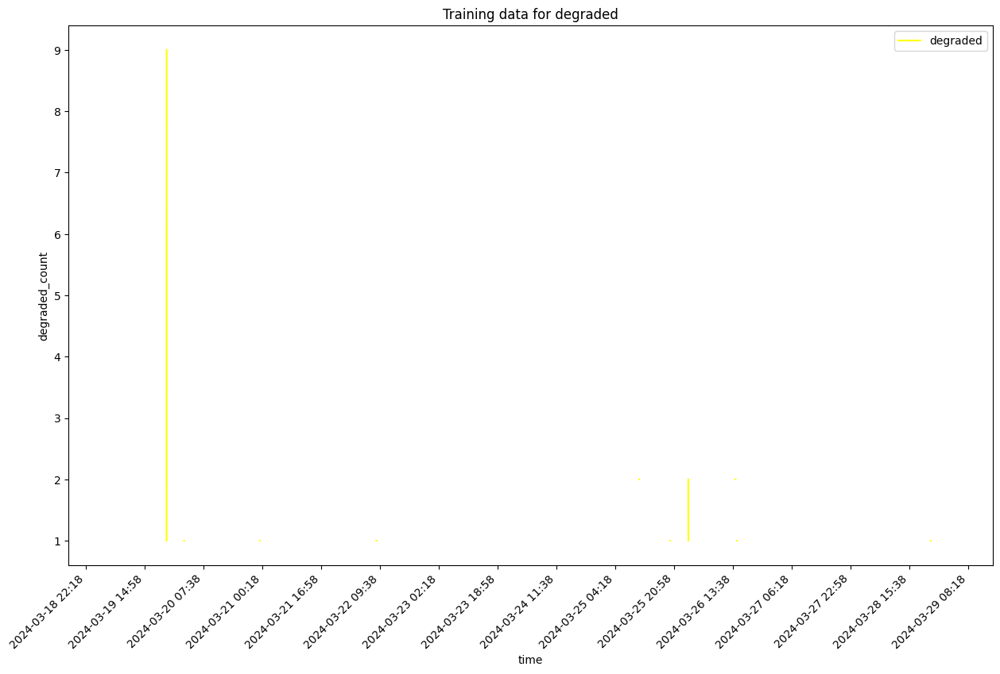

self.df_training shape  14400
Sum of histogram frequencies:  297.0
Number of non-NaN records in column x:  297


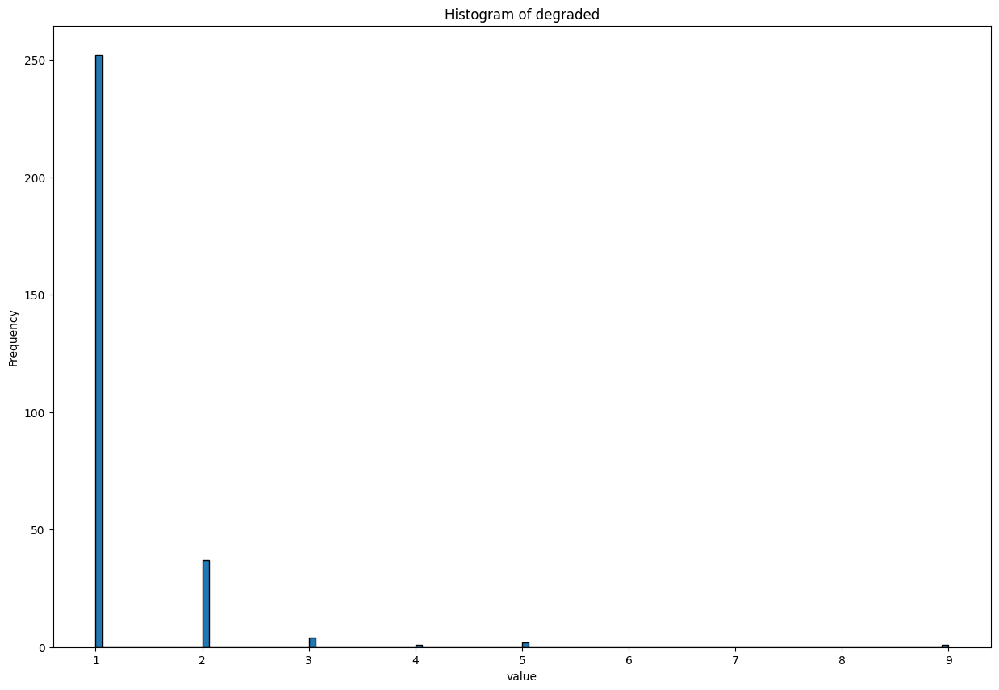

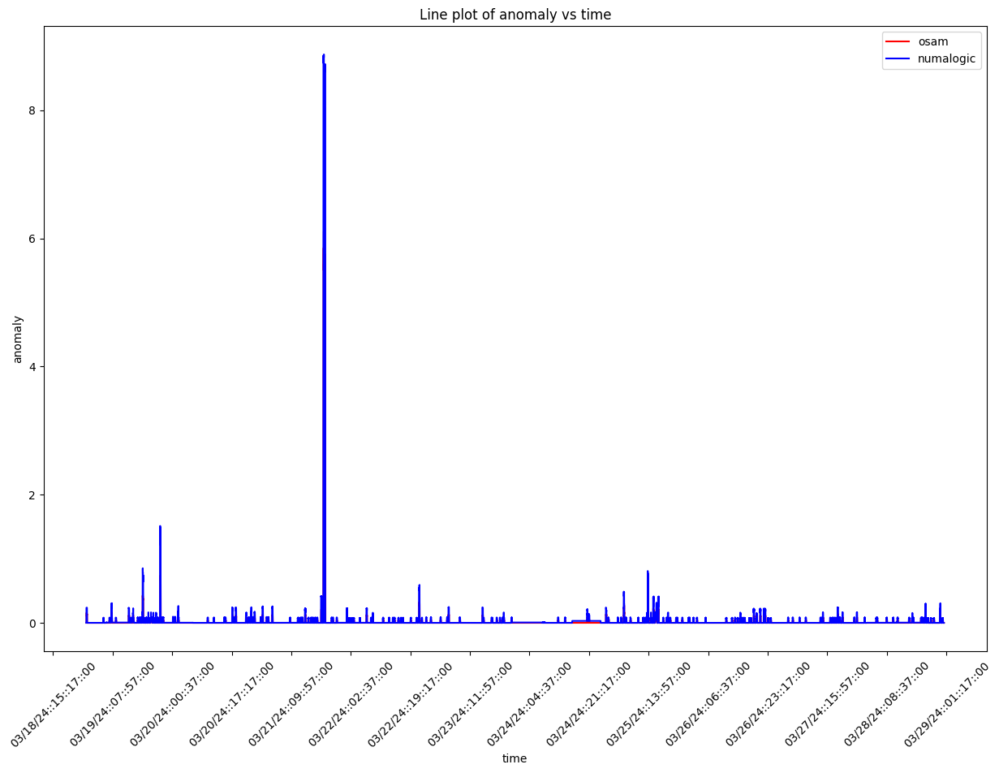

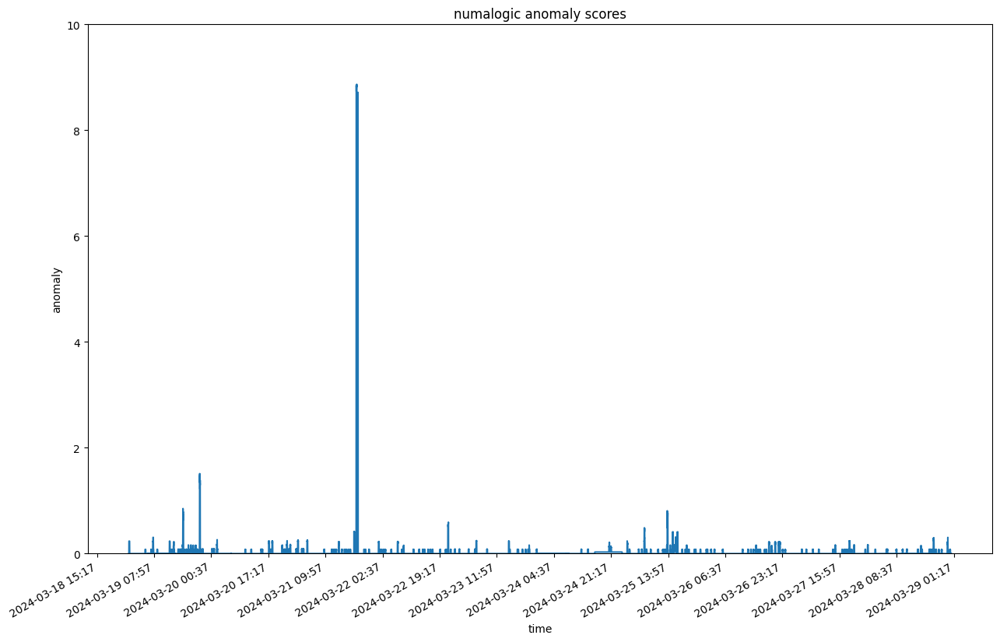

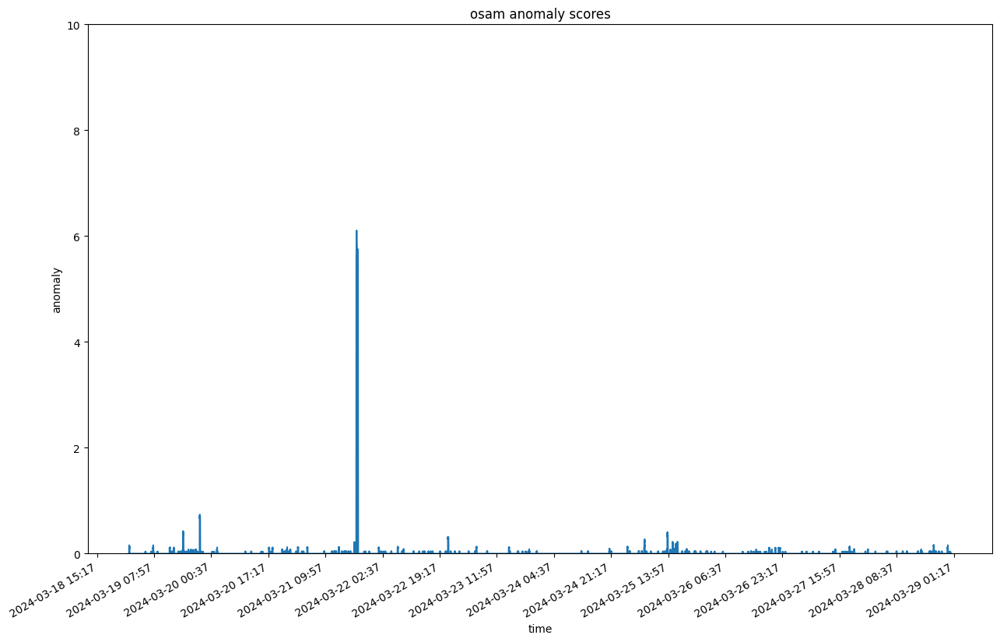

DEBUG:numalogic.connectors.druid._druid:Querying with end_dt: 2024-03-29 03:35:54.325727+00:00, that is with delay of 3 hrs


------------------------------------------------------------
------------------------------------------------------------        ModelId: fci:interactionsFailed:5984175597303660107:TXP/expenses-forms-ui/onLineItemsProductChange       ---------------------------------------------


DEBUG:numalogic.connectors.druid._druid:Druid params: {'datasource': 'tech-ip-customer-interaction-metrics', 'granularity': 'minute', 'intervals': ['2024-03-19T03:35:54.325727+00:00/2024-03-29T03:35:54.325727+00:00'], 'aggregations': {'count': {'type': 'doubleSum', 'fieldName': 'count', 'name': 'count'}}, 'post_aggregations': {}, 'filter': <pydruid.utils.filters.Filter object at 0x2cb219480>, 'dimensions': <map object at 0x2cb21b460>, 'context': {'timeout': 10000, 'configIds': ['assetId', 'interactionName'], 'source': 'numalogic'}}, fetch time: 0.9628s
DEBUG:numalogic.udfs.tools:Querying with end_dt: 2024-03-29 00:35:57.292902+00:00, that is with delay of 3 hrs
DEBUG:numalogic.udfs.tools:Querying with end_dt: 2024-03-29 00:35:57.292902+00:00, that is with delay of 3 hrs


--- 2.6517932415008545 seconds ---
--- 2.1316370964050293 seconds ---


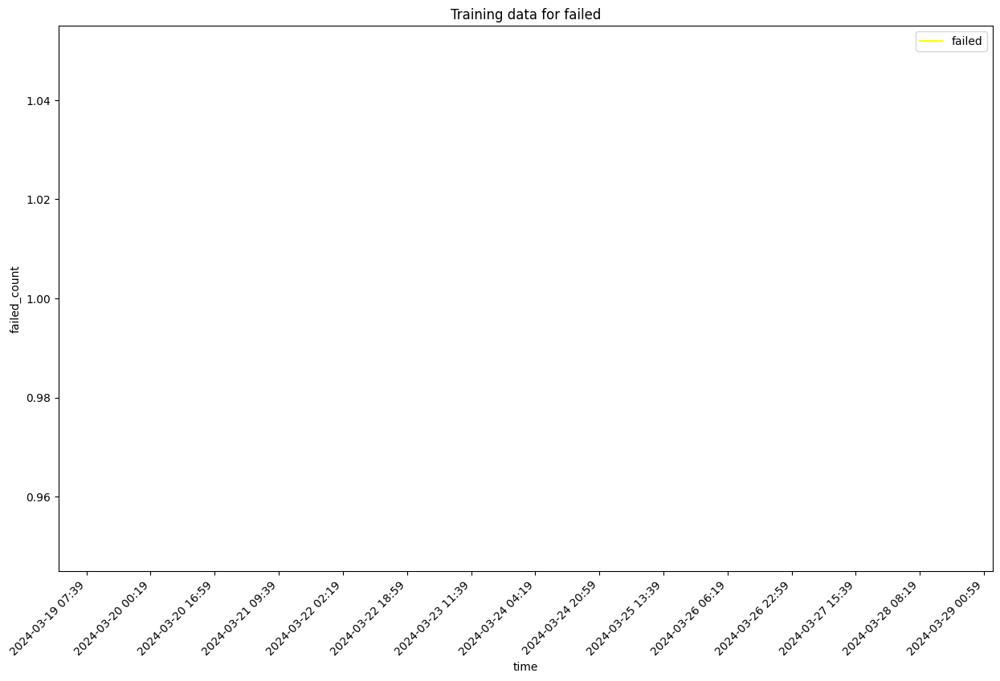

self.df_training shape  14244
Sum of histogram frequencies:  14.0
Number of non-NaN records in column x:  14


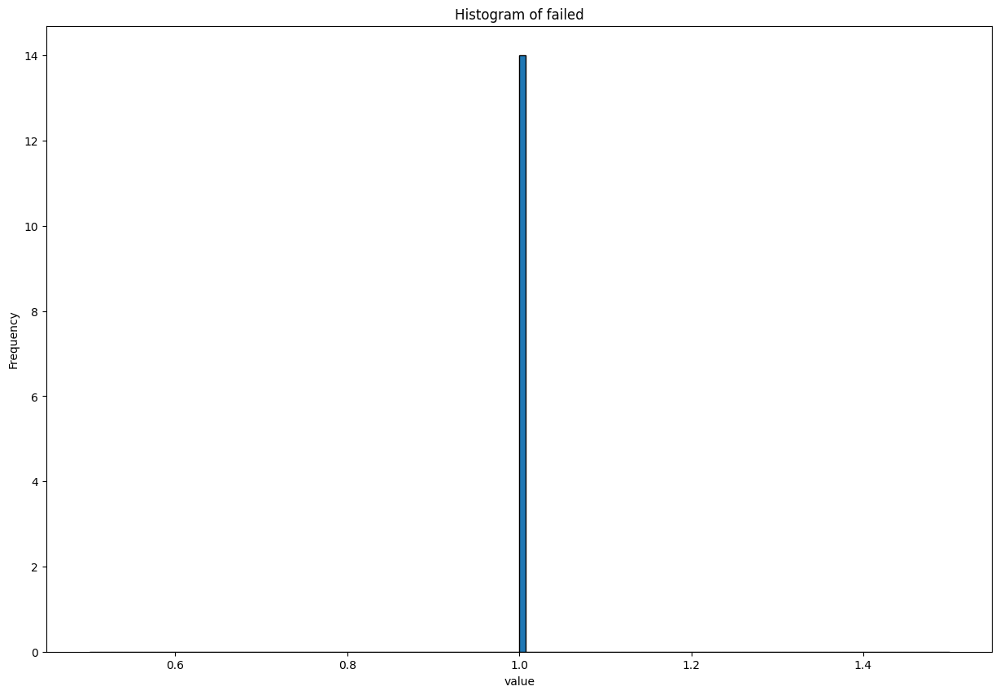

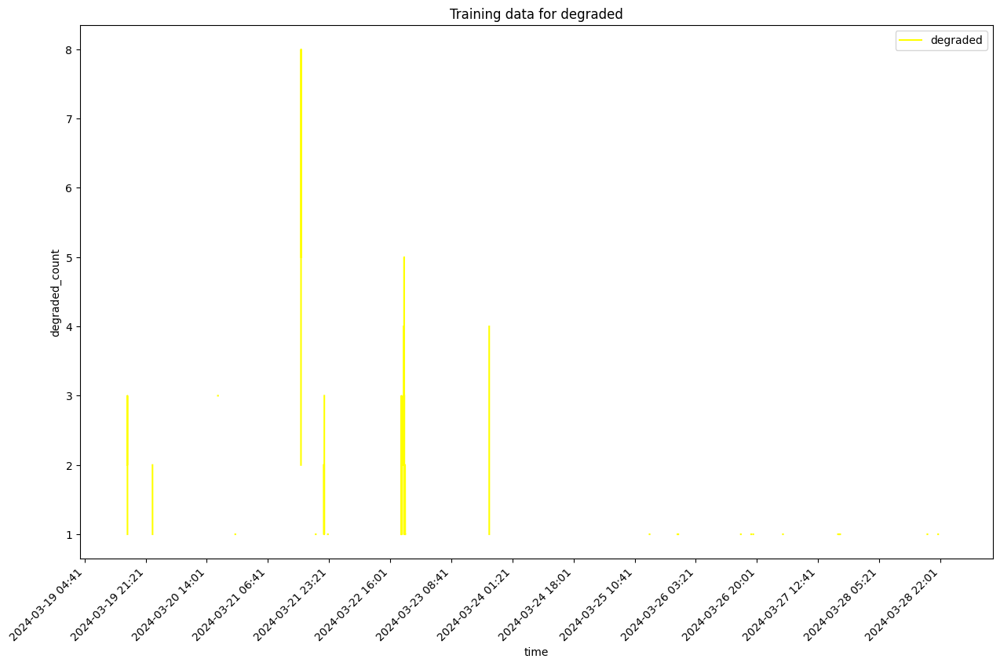

self.df_training shape  14244
Sum of histogram frequencies:  315.0
Number of non-NaN records in column x:  315


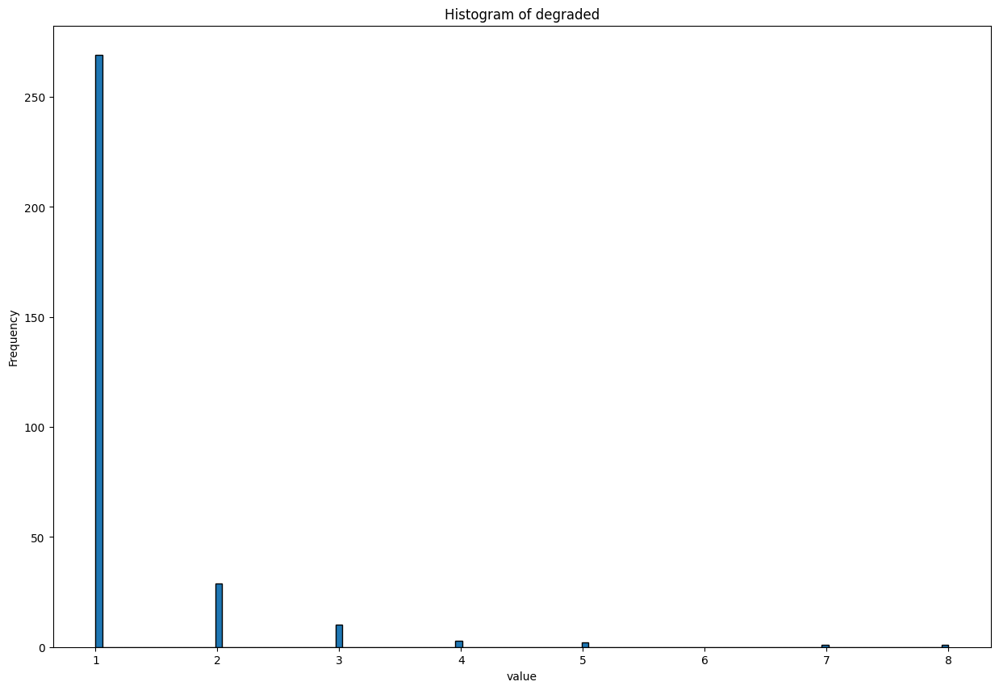

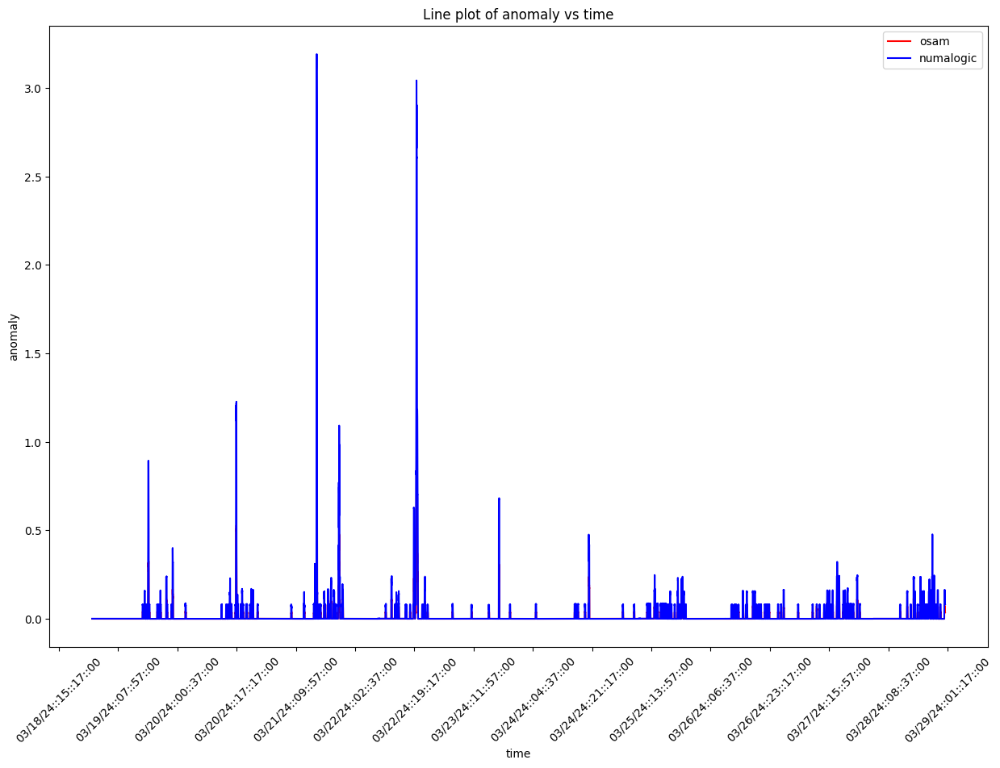

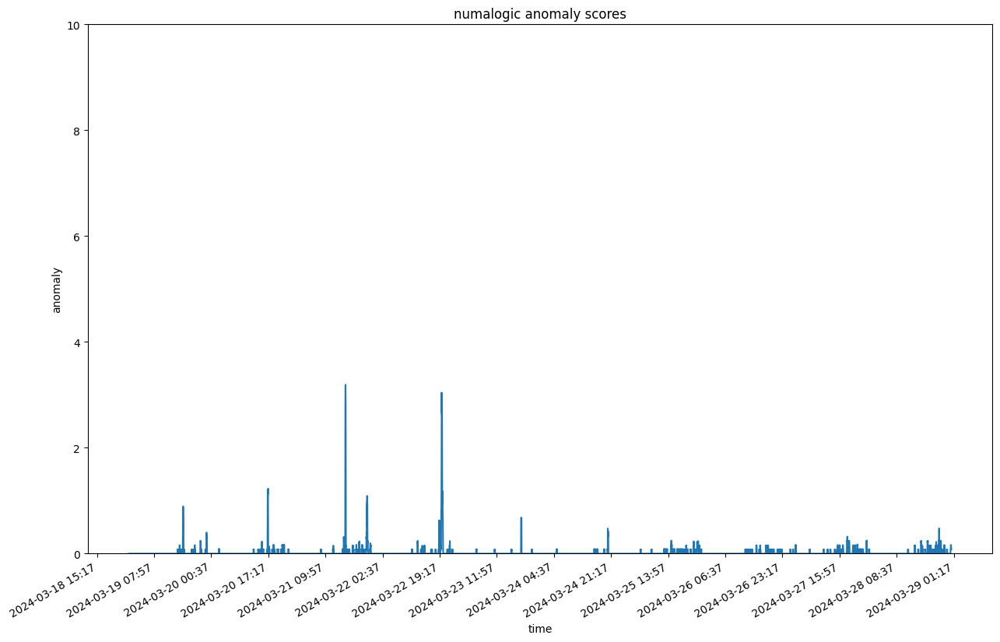

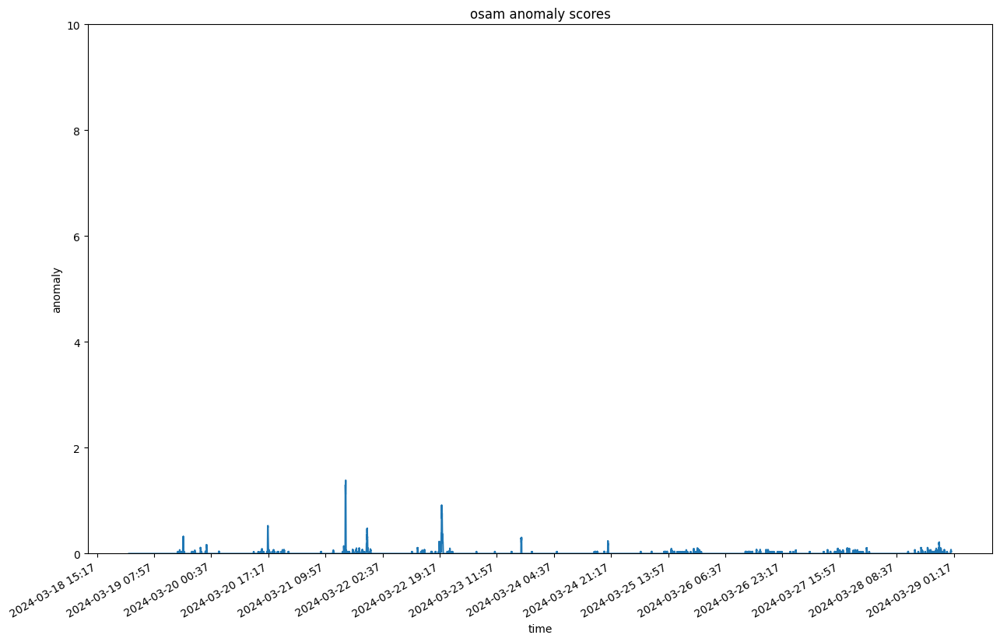

DEBUG:numalogic.connectors.druid._druid:Querying with end_dt: 2024-03-29 03:36:06.540004+00:00, that is with delay of 3 hrs


------------------------------------------------------------
------------------------------------------------------------        ModelId: fci:interactionsFailed:5477520638979968238:player_topic_educatorexpenses       ---------------------------------------------


DEBUG:numalogic.connectors.druid._druid:Druid params: {'datasource': 'tech-ip-customer-interaction-metrics', 'granularity': 'minute', 'intervals': ['2024-03-19T03:36:06.540004+00:00/2024-03-29T03:36:06.540004+00:00'], 'aggregations': {'count': {'type': 'doubleSum', 'fieldName': 'count', 'name': 'count'}}, 'post_aggregations': {}, 'filter': <pydruid.utils.filters.Filter object at 0x2cb955ed0>, 'dimensions': <map object at 0x2cb1f6290>, 'context': {'timeout': 10000, 'configIds': ['assetId', 'interactionName'], 'source': 'numalogic'}}, fetch time: 0.6409s
DEBUG:numalogic.udfs.tools:Querying with end_dt: 2024-03-29 00:36:09.183330+00:00, that is with delay of 3 hrs
DEBUG:numalogic.udfs.tools:Querying with end_dt: 2024-03-29 00:36:09.183330+00:00, that is with delay of 3 hrs


--- 1.752875804901123 seconds ---
--- 1.2338128089904785 seconds ---


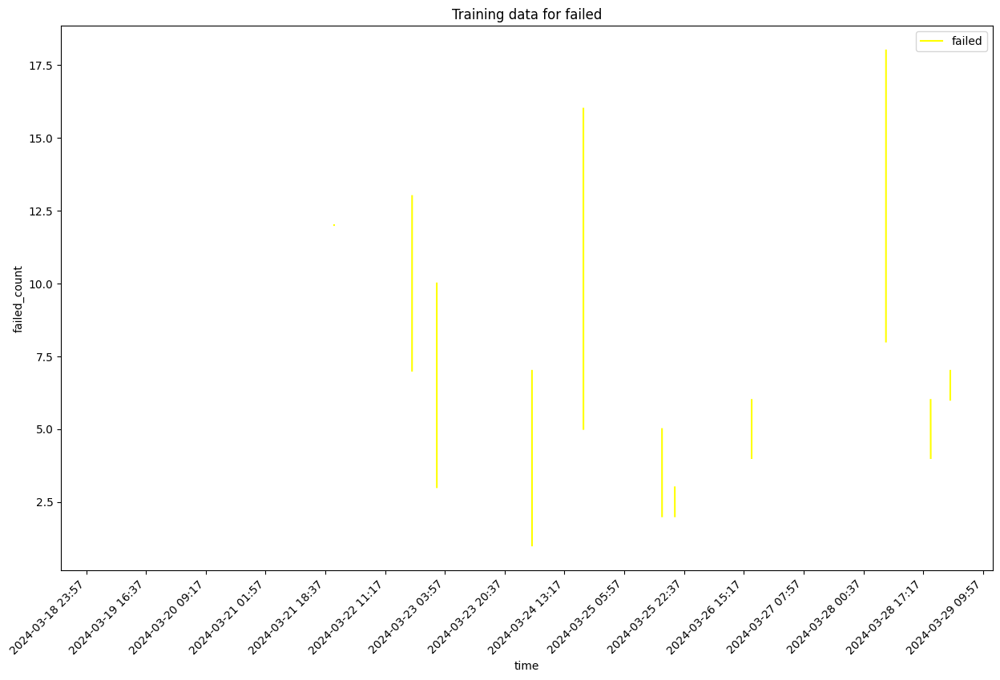

self.df_training shape  7485
Sum of histogram frequencies:  38.0
Number of non-NaN records in column x:  38


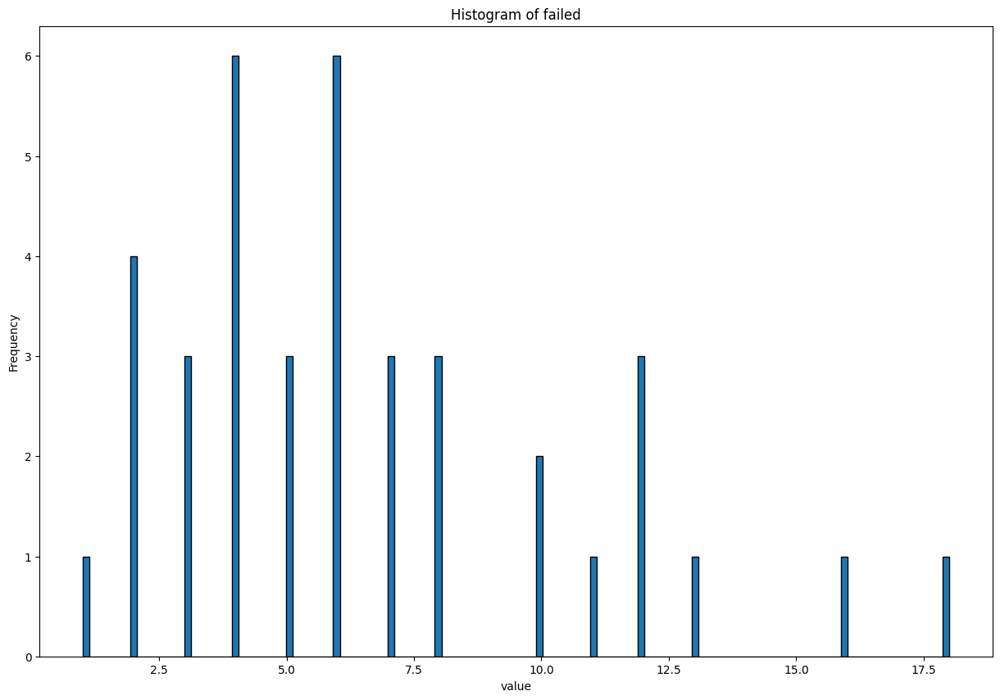

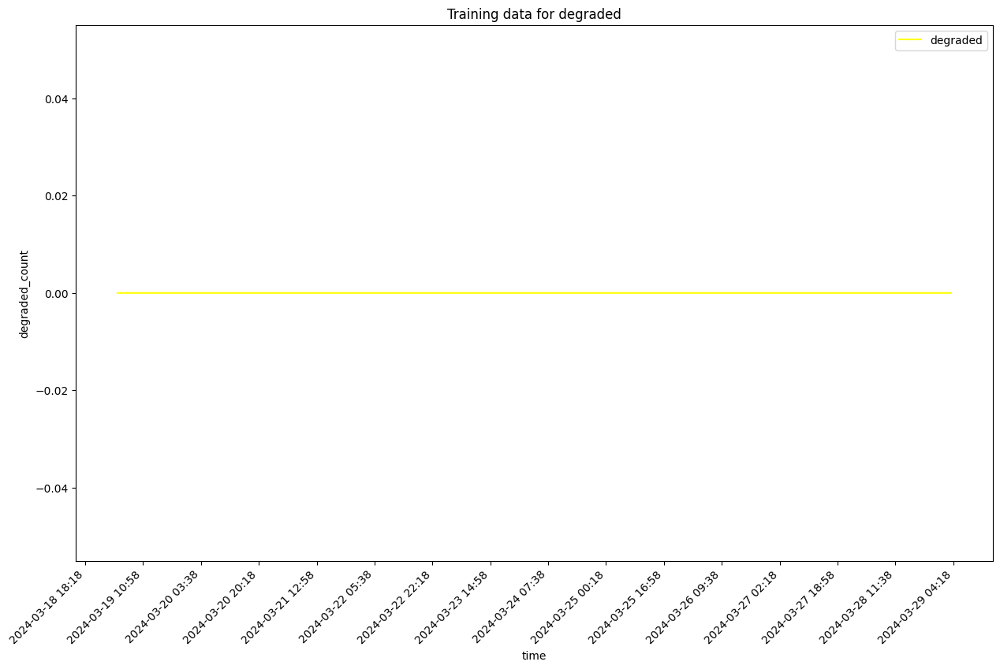

self.df_training shape  7485
Sum of histogram frequencies:  7485.0
Number of non-NaN records in column x:  7485


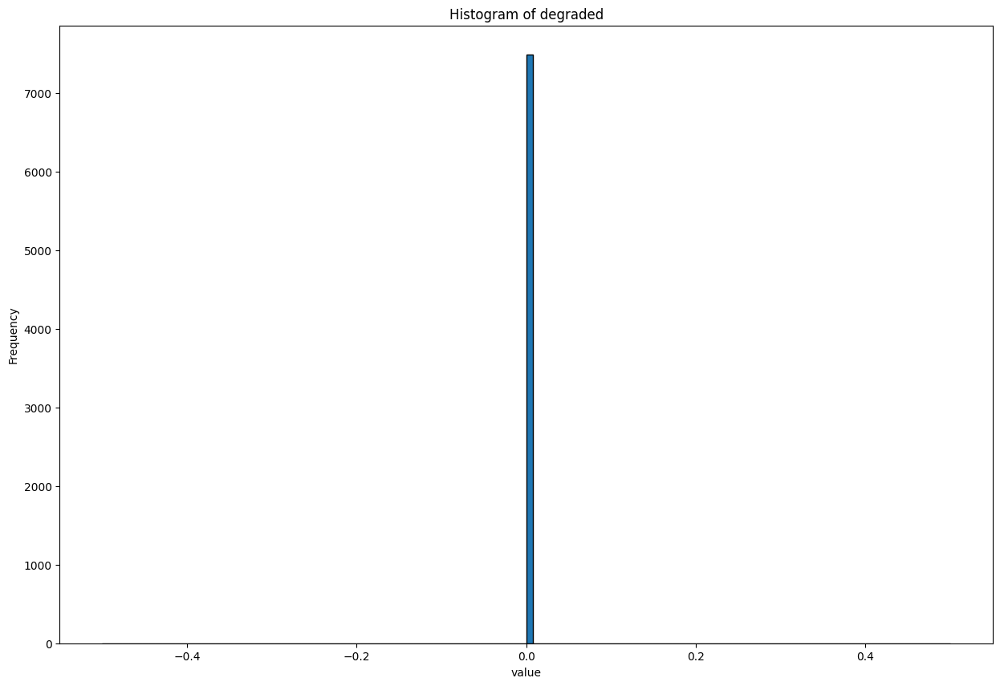

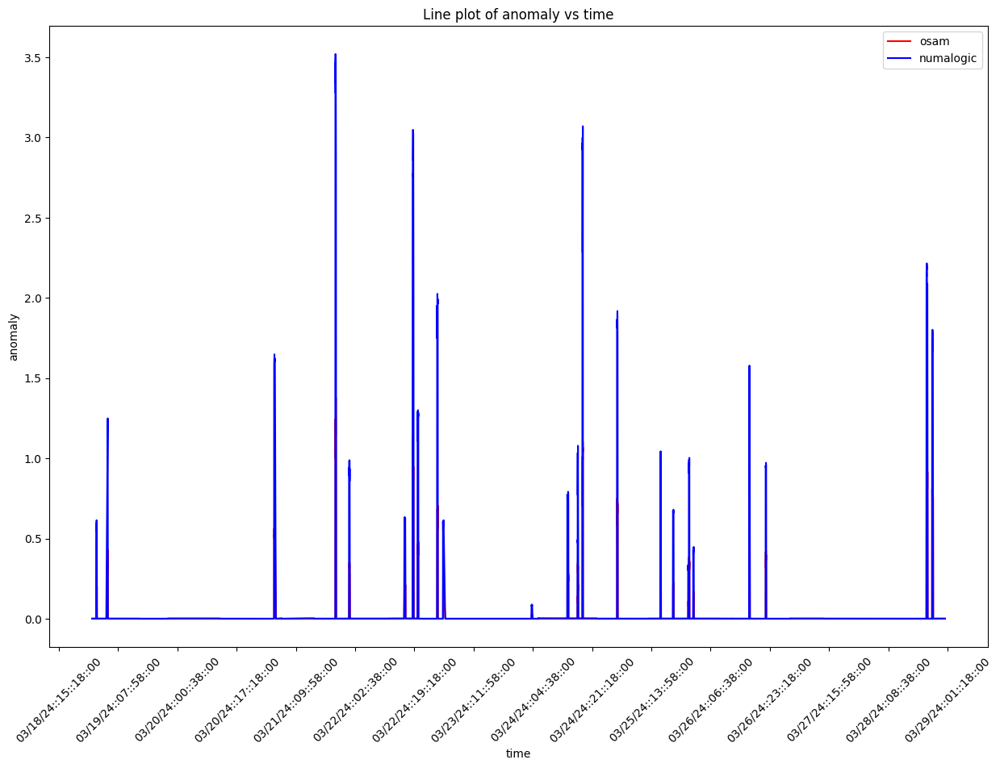

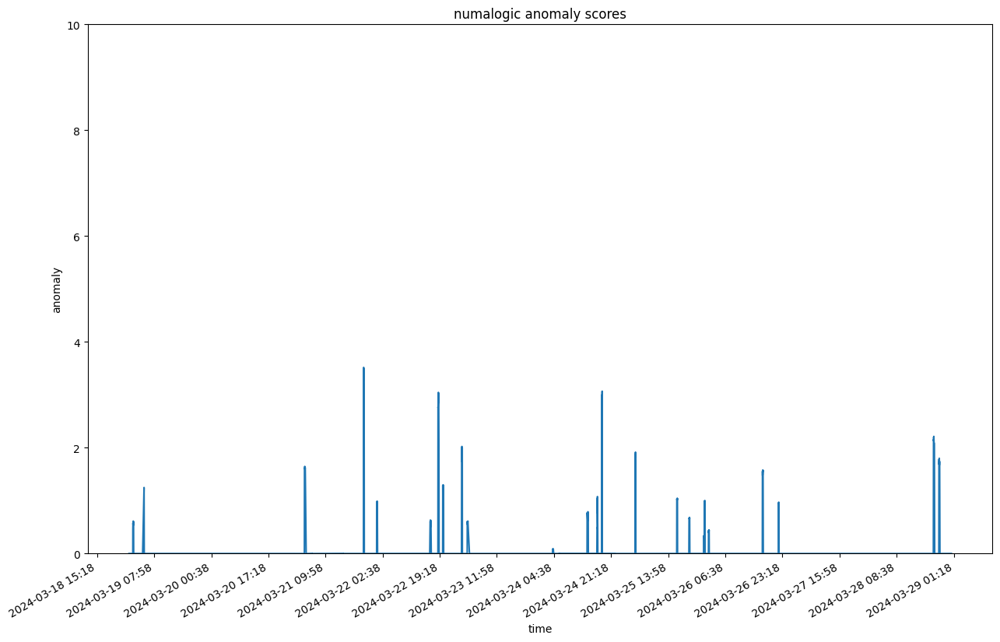

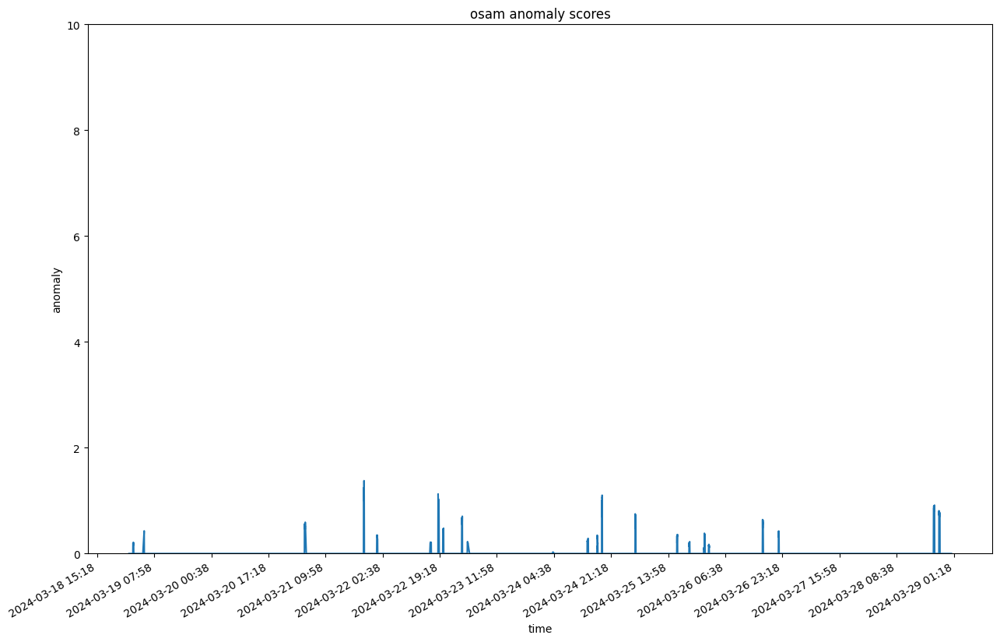

DEBUG:numalogic.connectors.druid._druid:Querying with end_dt: 2024-03-29 03:36:16.443401+00:00, that is with delay of 3 hrs


------------------------------------------------------------
------------------------------------------------------------        ModelId: fci:interactionsFailed:5984175597303660107:Smartdocs_Web_Platform_FCI_IMPORT_DOCUMENT       ---------------------------------------------


DEBUG:numalogic.connectors.druid._druid:Druid params: {'datasource': 'tech-ip-customer-interaction-metrics', 'granularity': 'minute', 'intervals': ['2024-03-19T03:36:16.443401+00:00/2024-03-29T03:36:16.443401+00:00'], 'aggregations': {'count': {'type': 'doubleSum', 'fieldName': 'count', 'name': 'count'}}, 'post_aggregations': {}, 'filter': <pydruid.utils.filters.Filter object at 0x14723ba90>, 'dimensions': <map object at 0x2cb198ee0>, 'context': {'timeout': 10000, 'configIds': ['assetId', 'interactionName'], 'source': 'numalogic'}}, fetch time: 0.5170s
DEBUG:numalogic.udfs.tools:Querying with end_dt: 2024-03-29 00:36:18.961370+00:00, that is with delay of 3 hrs
DEBUG:numalogic.udfs.tools:Querying with end_dt: 2024-03-29 00:36:18.961370+00:00, that is with delay of 3 hrs


--- 0.7571802139282227 seconds ---
--- 0.6455280780792236 seconds ---


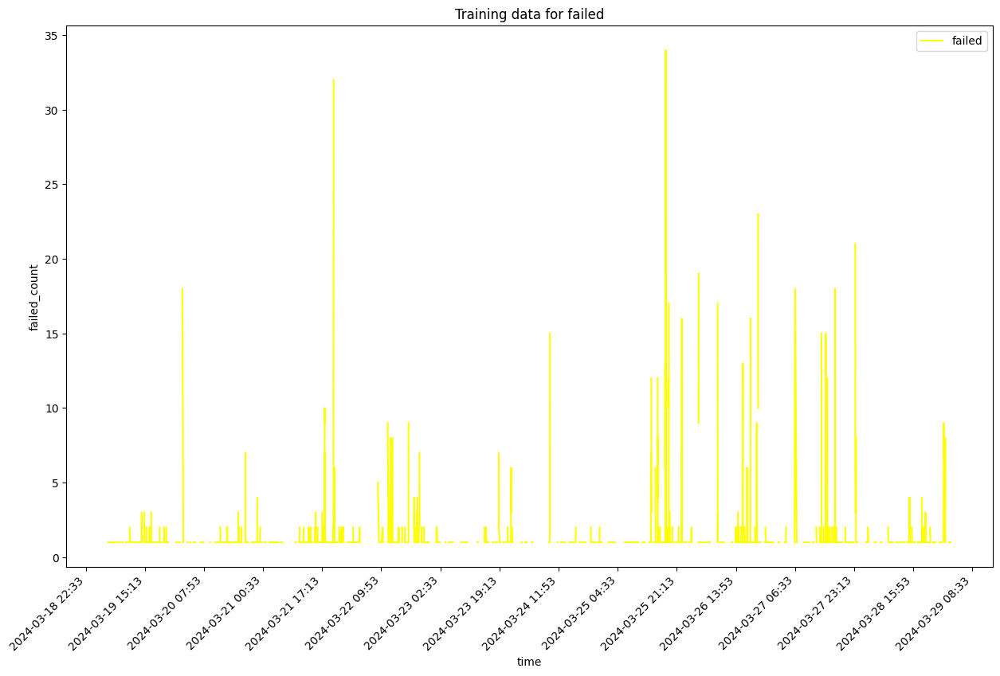

self.df_training shape  3343
Sum of histogram frequencies:  1517.0
Number of non-NaN records in column x:  1517


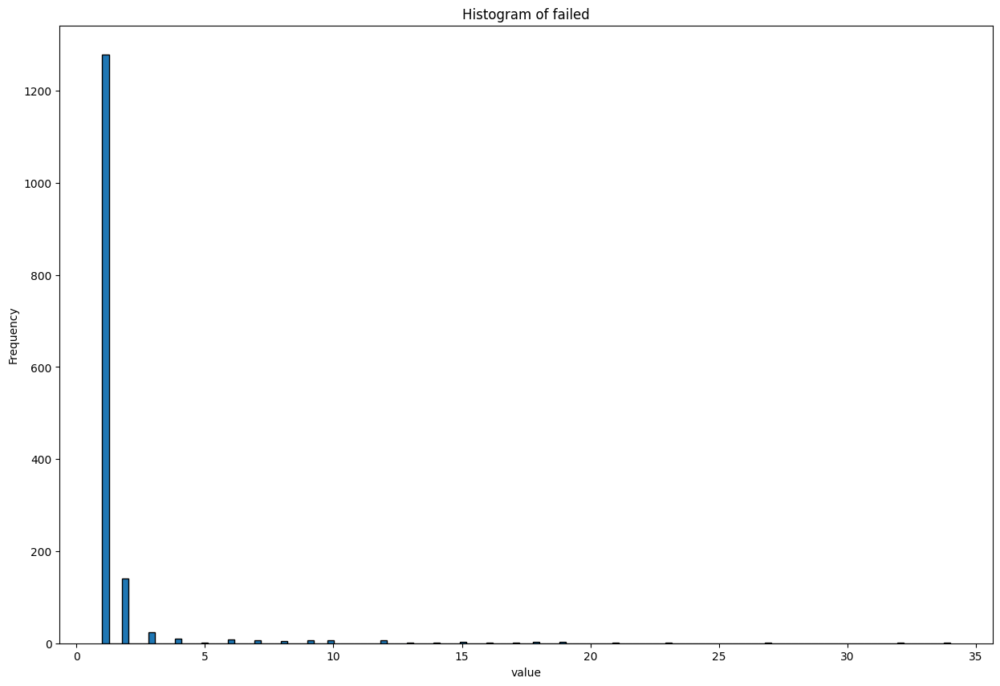

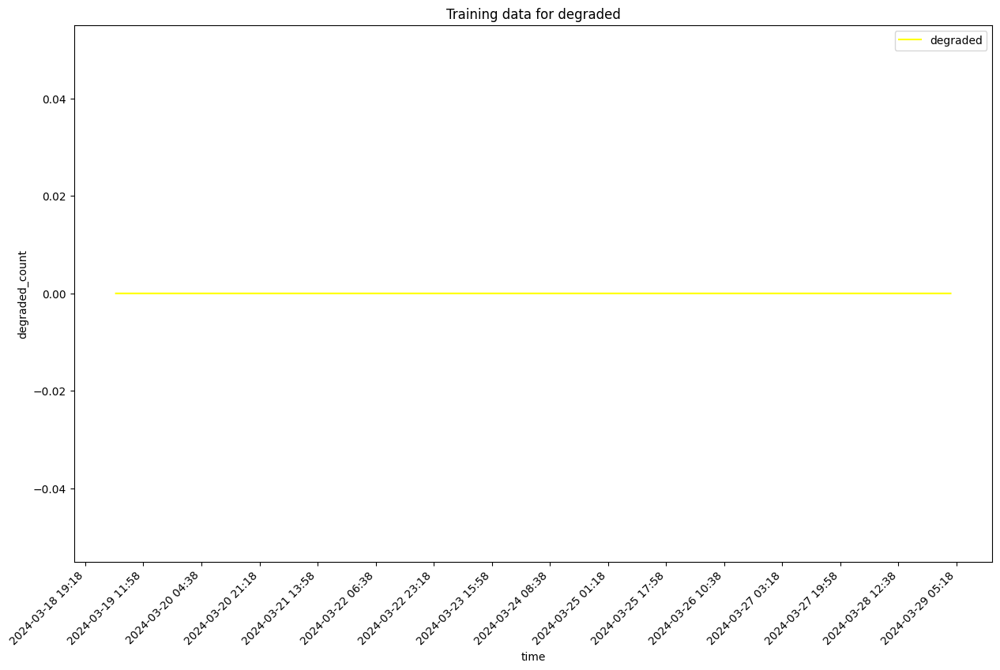

self.df_training shape  3343
Sum of histogram frequencies:  3343.0
Number of non-NaN records in column x:  3343


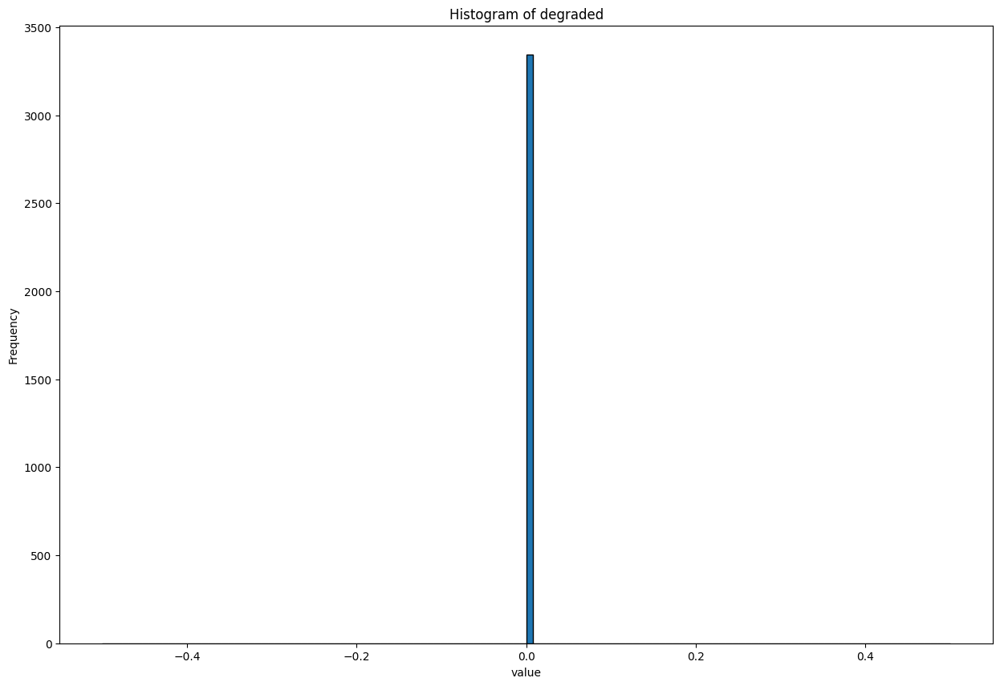

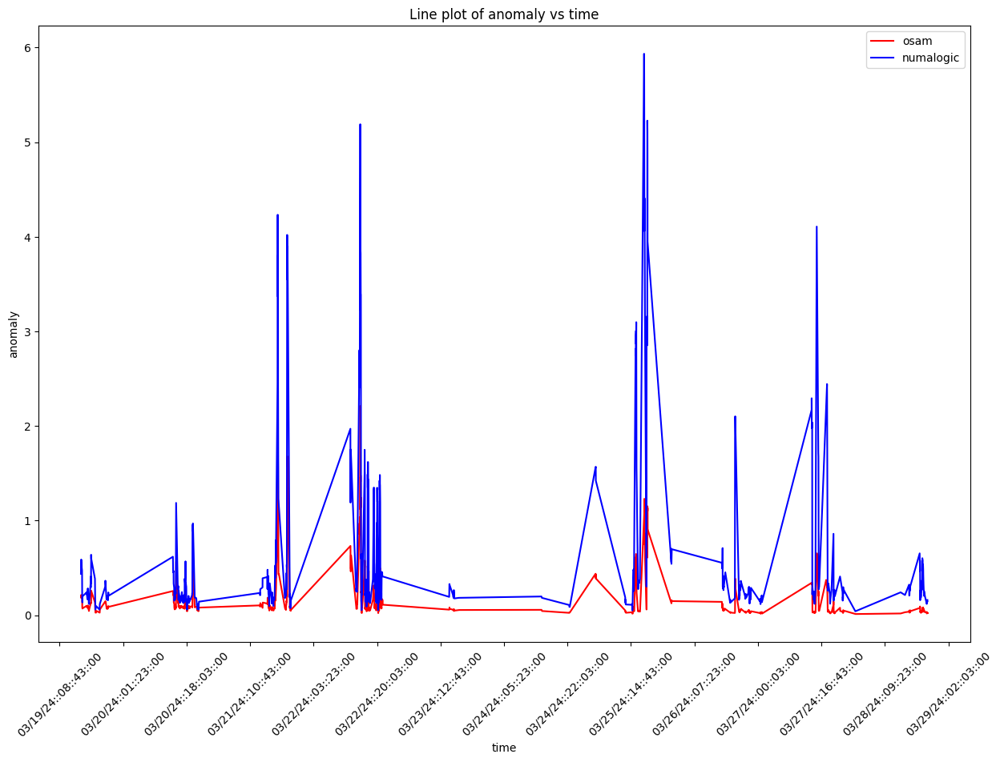

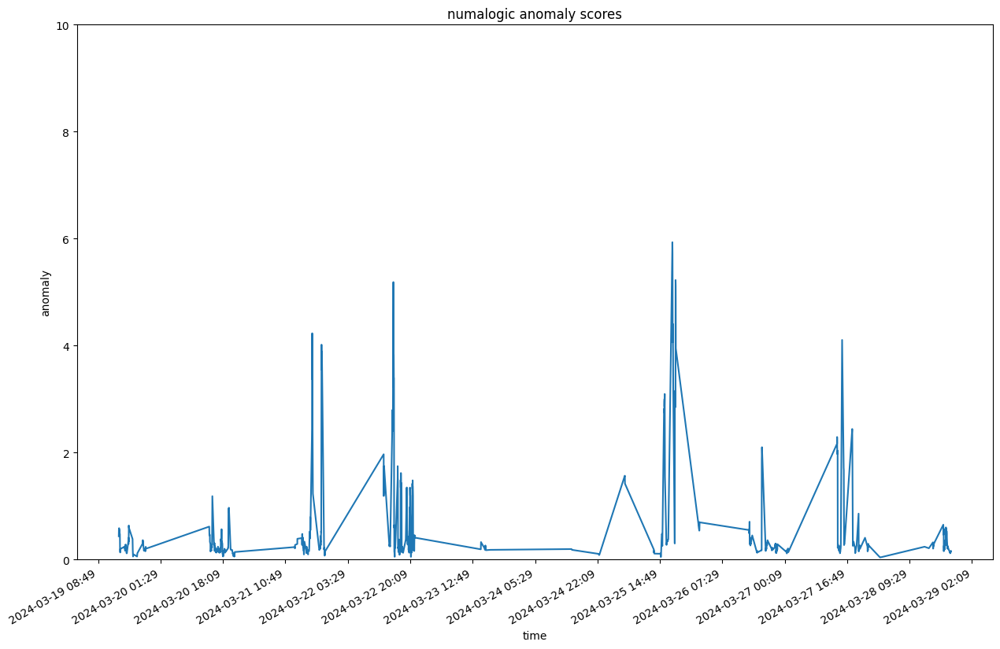

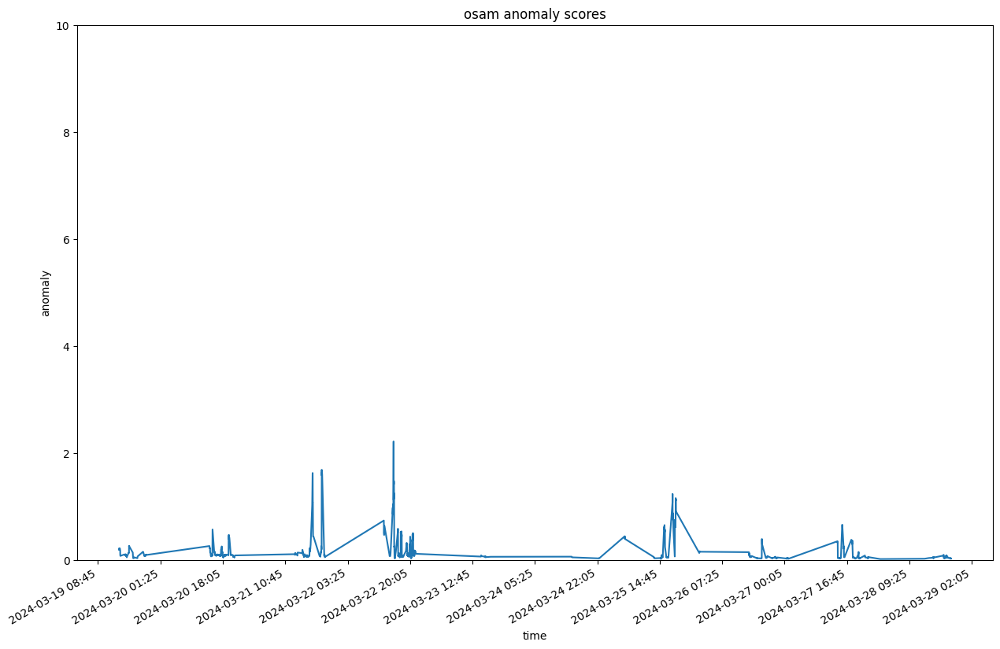

DEBUG:numalogic.connectors.druid._druid:Querying with end_dt: 2024-03-29 03:36:24.773281+00:00, that is with delay of 3 hrs


------------------------------------------------------------
------------------------------------------------------------        ModelId: fci:interactionsFailed:1876892737053055605:resumeAllConnections       ---------------------------------------------


DEBUG:numalogic.connectors.druid._druid:Druid params: {'datasource': 'tech-ip-customer-interaction-metrics', 'granularity': 'minute', 'intervals': ['2024-03-19T03:36:24.773281+00:00/2024-03-29T03:36:24.773281+00:00'], 'aggregations': {'count': {'type': 'doubleSum', 'fieldName': 'count', 'name': 'count'}}, 'post_aggregations': {}, 'filter': <pydruid.utils.filters.Filter object at 0x2de336470>, 'dimensions': <map object at 0x2cb9d1db0>, 'context': {'timeout': 10000, 'configIds': ['assetId', 'interactionName'], 'source': 'numalogic'}}, fetch time: 0.9559s
DEBUG:numalogic.udfs.tools:Querying with end_dt: 2024-03-29 00:36:27.734937+00:00, that is with delay of 3 hrs
DEBUG:numalogic.udfs.tools:Querying with end_dt: 2024-03-29 00:36:27.734937+00:00, that is with delay of 3 hrs


--- 1.4505548477172852 seconds ---
--- 2.5373129844665527 seconds ---


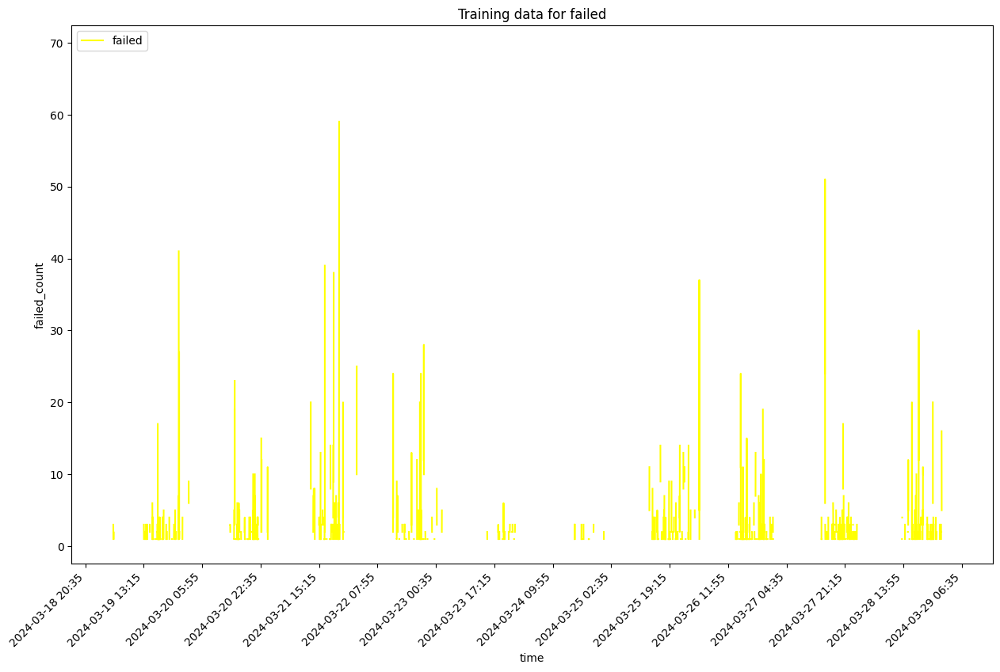

self.df_training shape  10897
Sum of histogram frequencies:  1660.0
Number of non-NaN records in column x:  1660


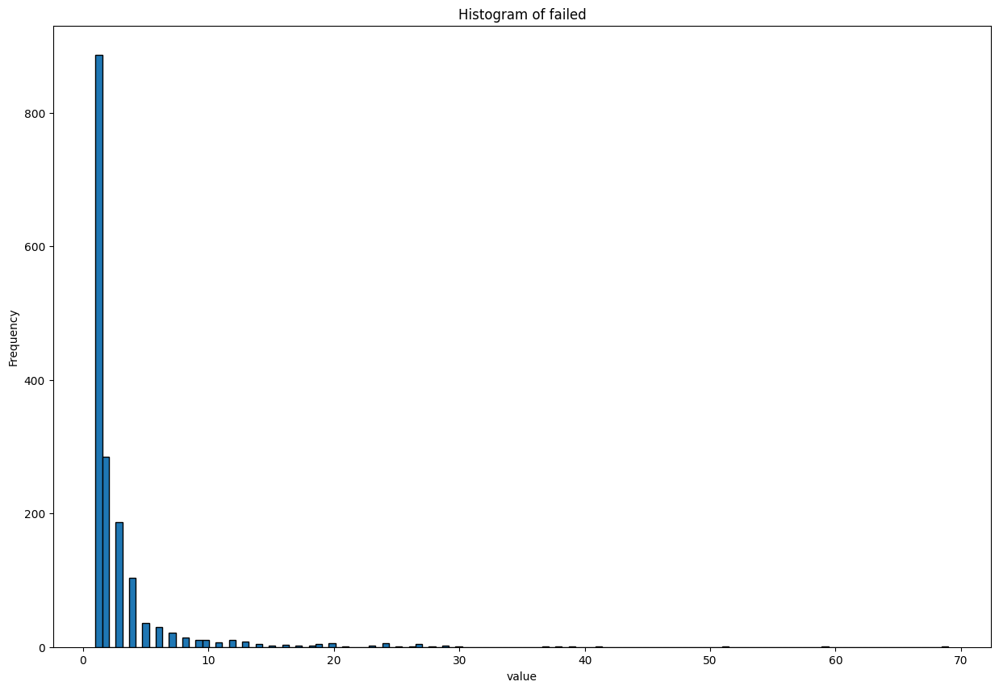

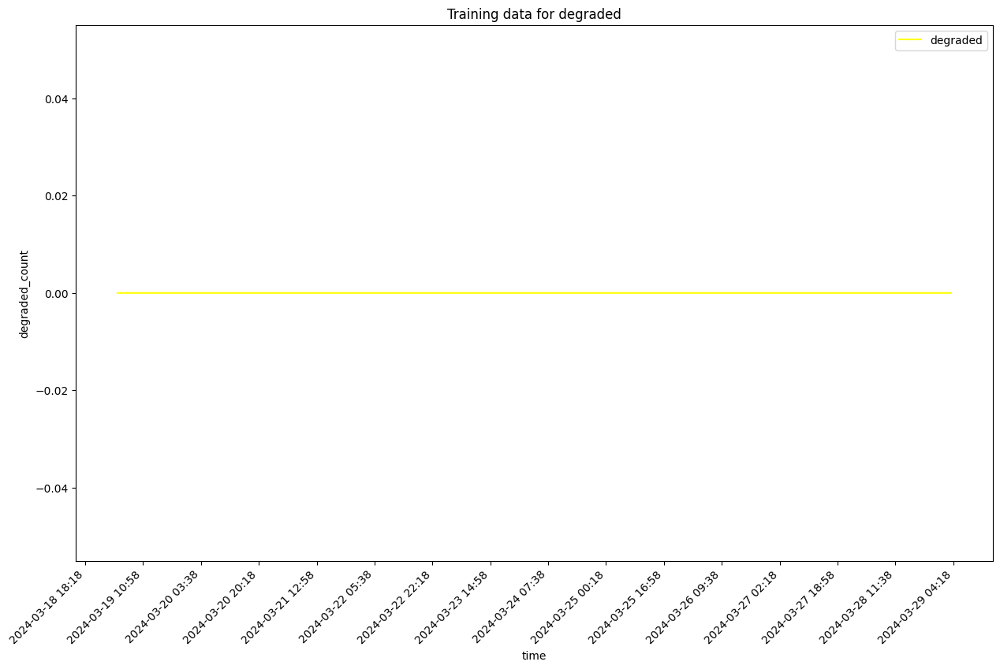

self.df_training shape  10897
Sum of histogram frequencies:  10897.0
Number of non-NaN records in column x:  10897


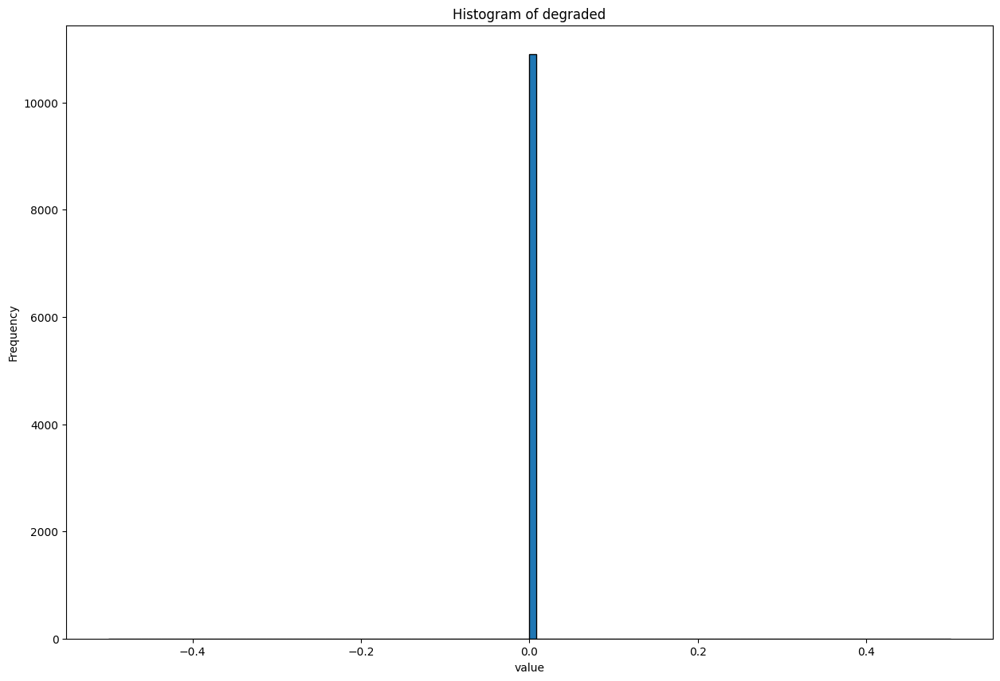

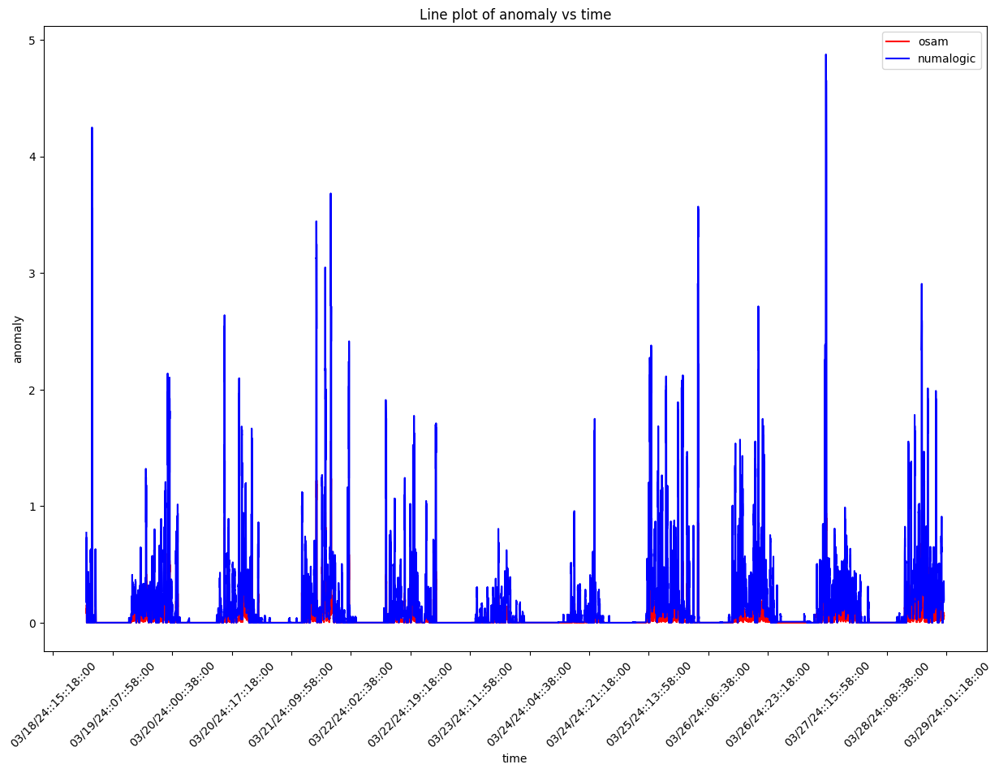

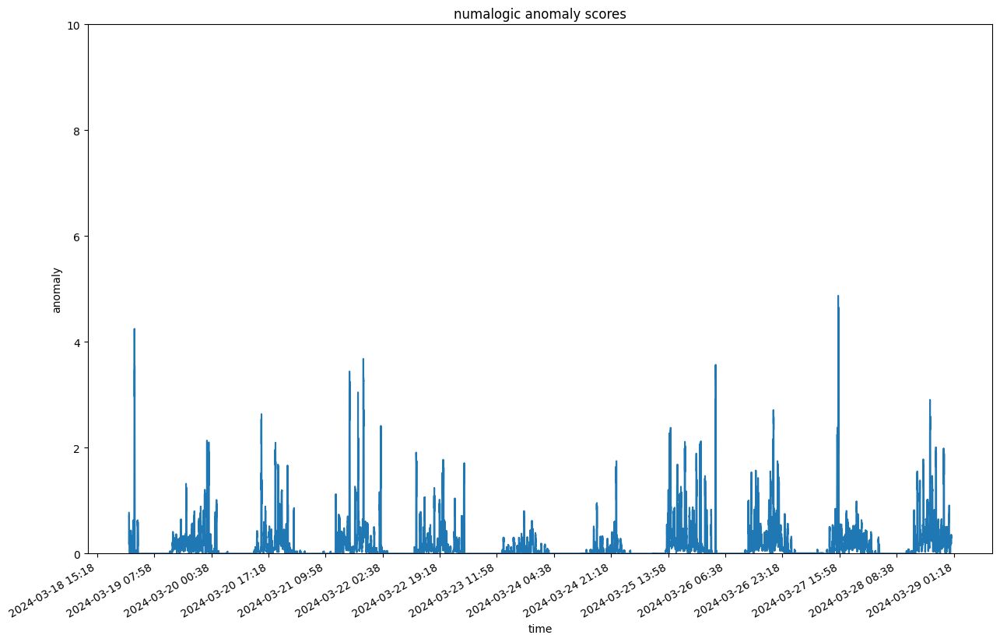

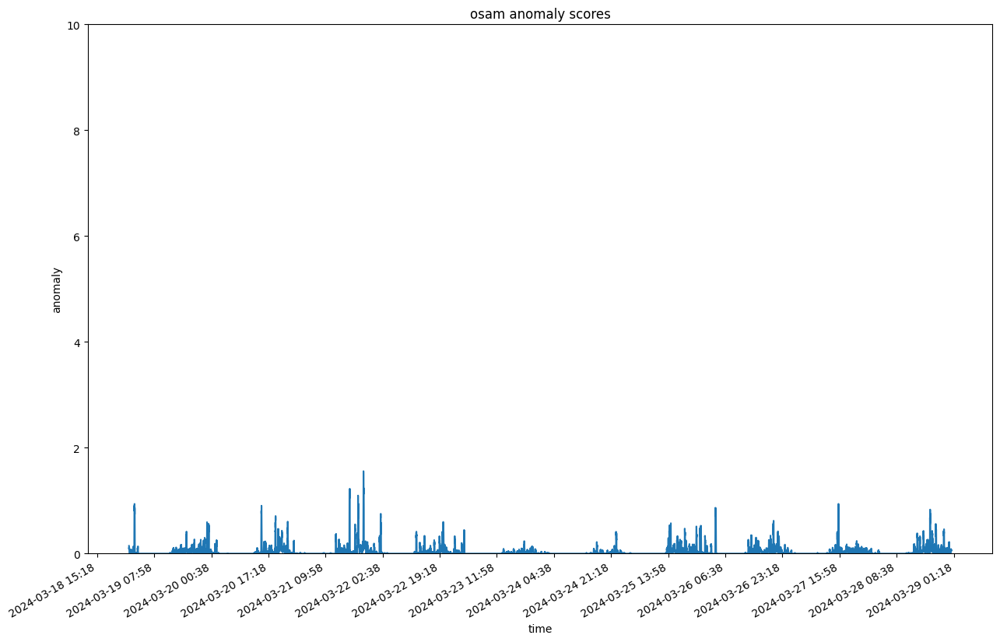

DEBUG:numalogic.connectors.druid._druid:Querying with end_dt: 2024-03-29 03:36:36.173313+00:00, that is with delay of 3 hrs


------------------------------------------------------------
------------------------------------------------------------        ModelId: fciPluginInteractions:metrics:3966562964805320729:Customer_info_gathering_Update_Specification       ---------------------------------------------


DEBUG:numalogic.connectors.druid._druid:Druid params: {'datasource': 'tech-ip-customer-interaction-metrics', 'granularity': 'minute', 'intervals': ['2024-03-19T03:36:36.173313+00:00/2024-03-29T03:36:36.173313+00:00'], 'aggregations': {'count': {'type': 'doubleSum', 'fieldName': 'count', 'name': 'count'}}, 'post_aggregations': {}, 'filter': <pydruid.utils.filters.Filter object at 0x2cb8b4f70>, 'dimensions': <map object at 0x14737f880>, 'context': {'timeout': 10000, 'configIds': ['pluginAssetId', 'interactionName'], 'source': 'numalogic'}}, fetch time: 0.7334s
DEBUG:numalogic.udfs.tools:Querying with end_dt: 2024-03-29 00:36:38.912311+00:00, that is with delay of 3 hrs
DEBUG:numalogic.udfs.tools:Querying with end_dt: 2024-03-29 00:36:38.912311+00:00, that is with delay of 3 hrs


--- 3.762448787689209 seconds ---
--- 2.9905340671539307 seconds ---


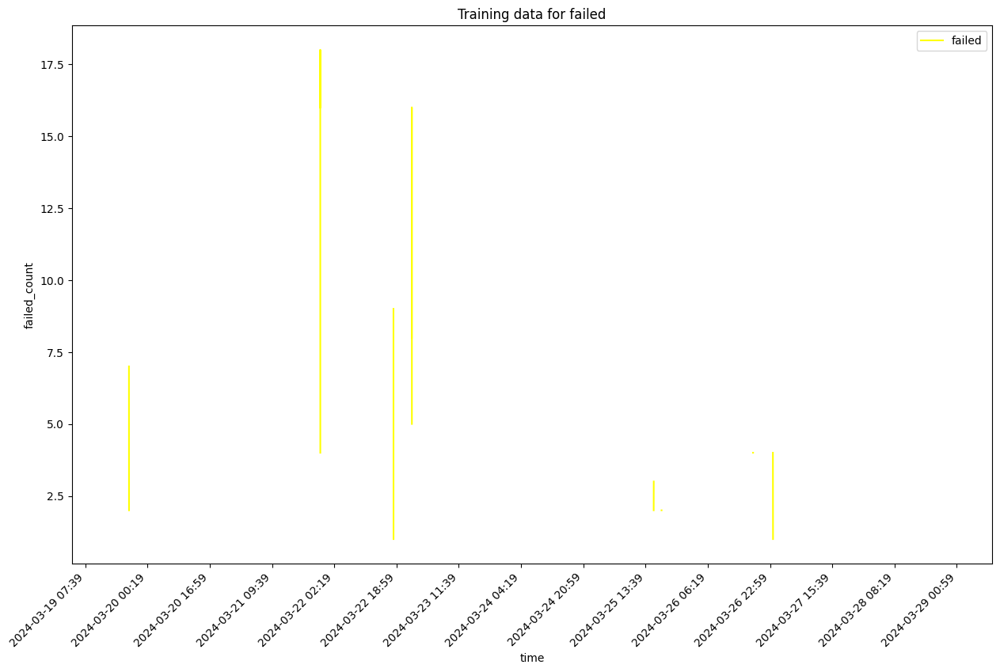

self.df_training shape  4090
Sum of histogram frequencies:  34.0
Number of non-NaN records in column x:  34


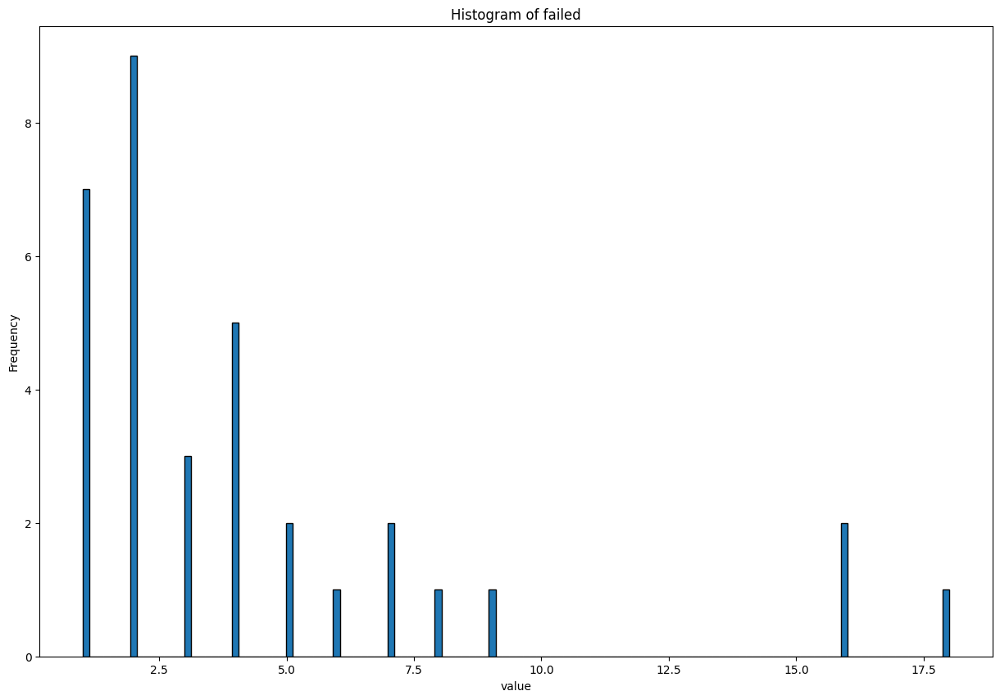

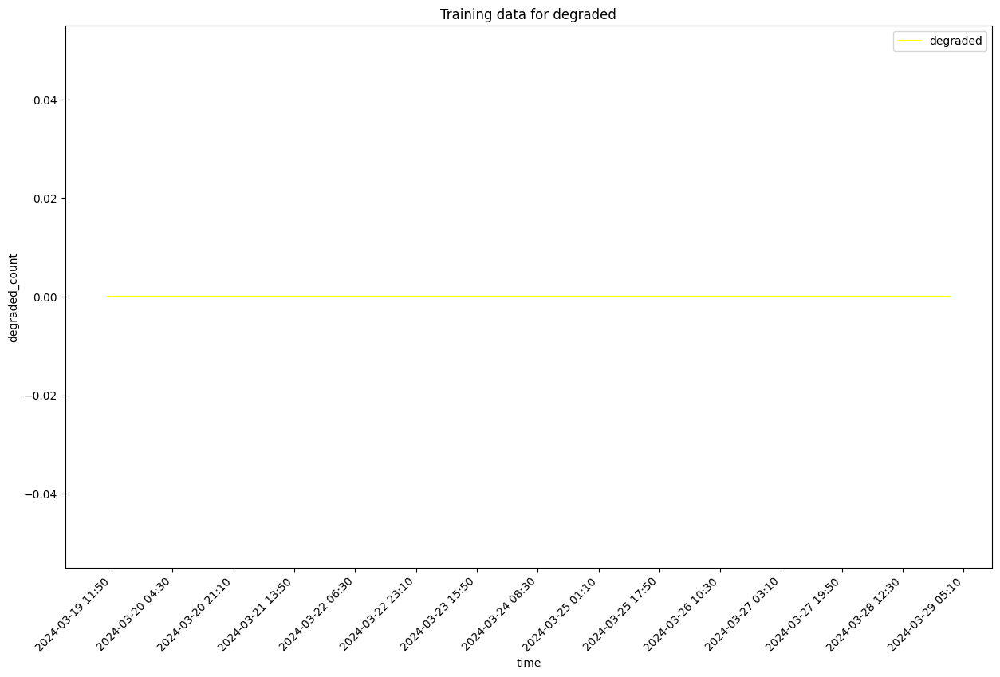

self.df_training shape  4090
Sum of histogram frequencies:  4090.0
Number of non-NaN records in column x:  4090


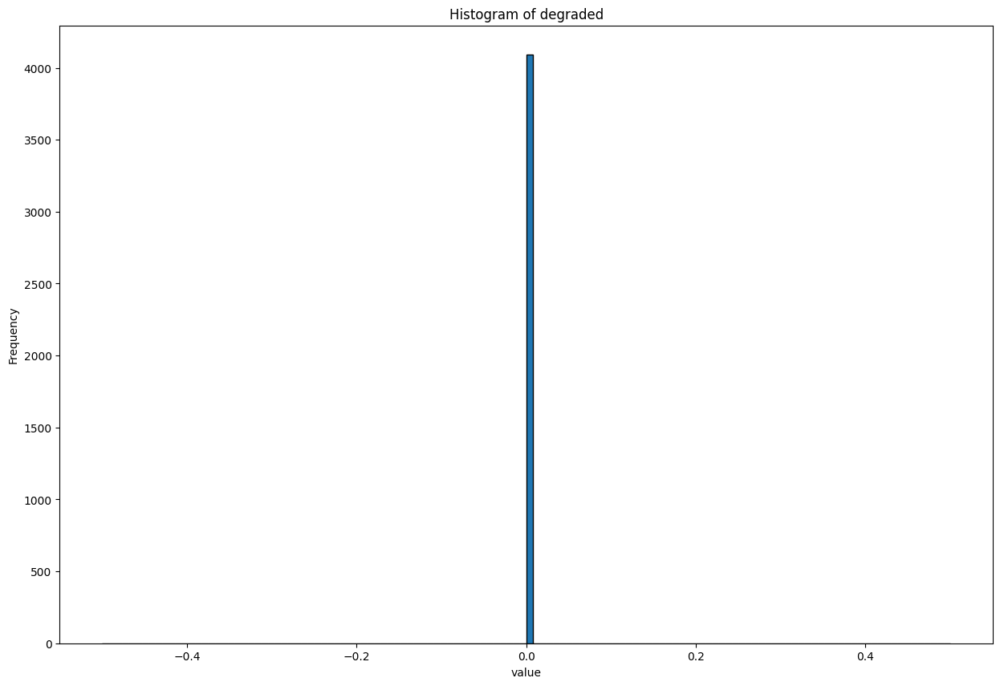

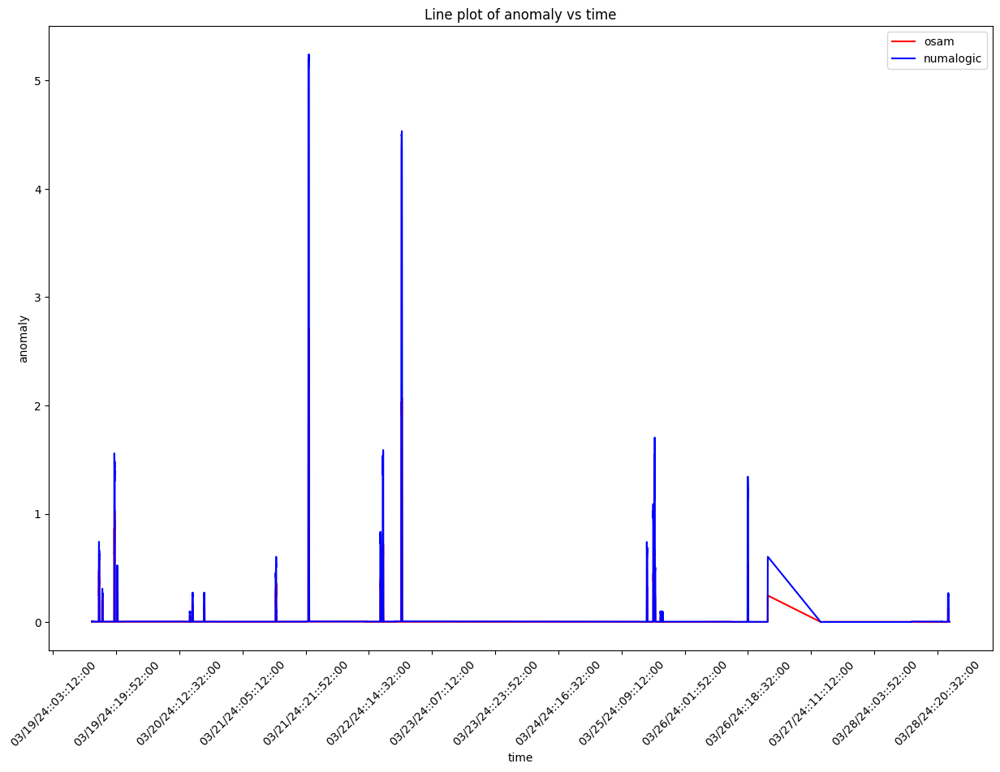

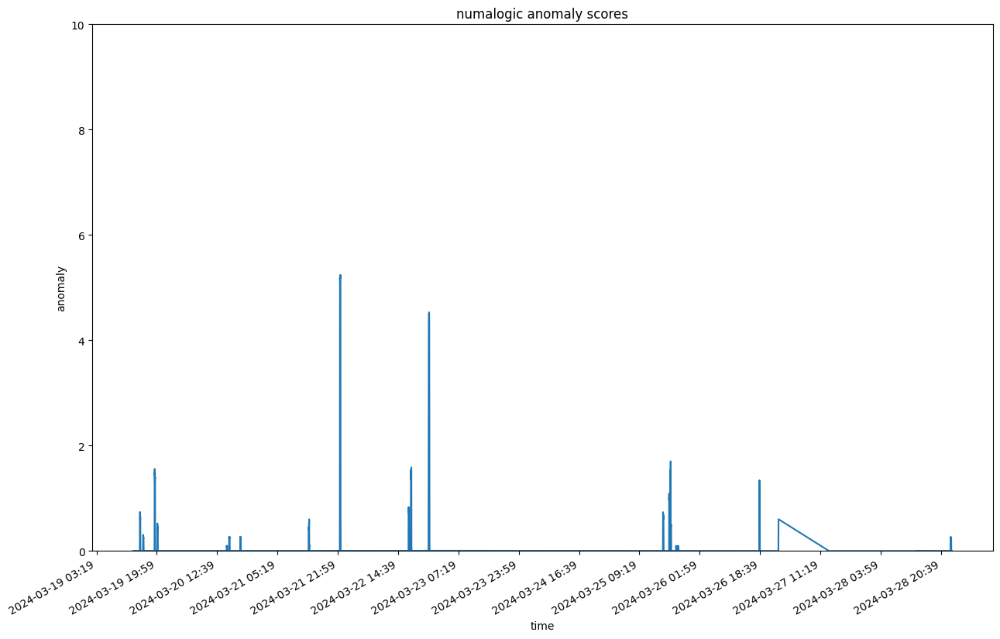

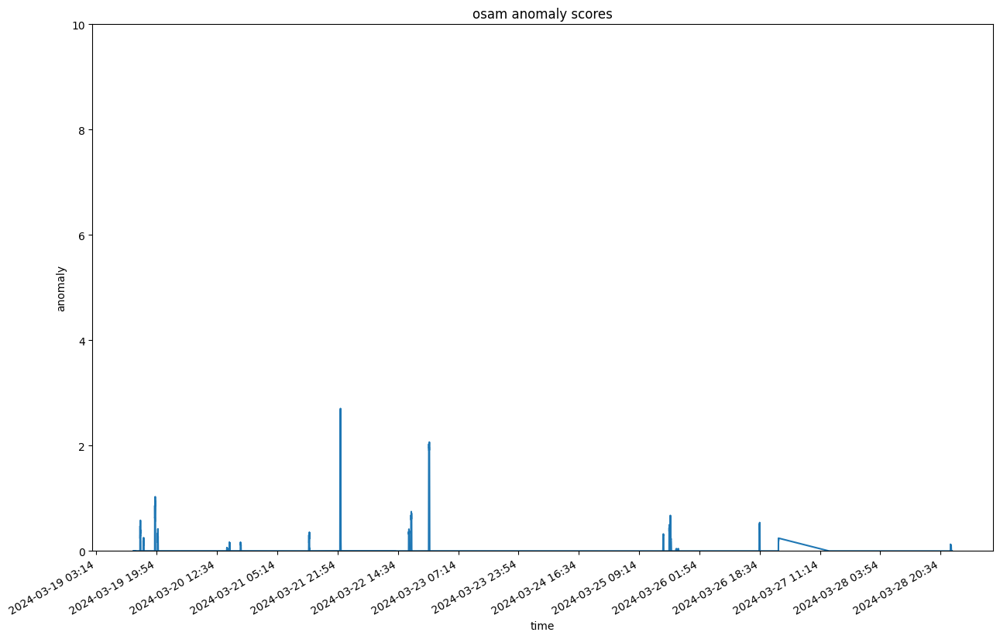

DEBUG:numalogic.connectors.druid._druid:Querying with end_dt: 2024-03-29 03:36:50.156893+00:00, that is with delay of 3 hrs


------------------------------------------------------------
------------------------------------------------------------        ModelId: fciPluginInteractions:metrics:2453353489468585843:productServiceOnSearch       ---------------------------------------------


DEBUG:numalogic.connectors.druid._druid:Druid params: {'datasource': 'tech-ip-customer-interaction-metrics', 'granularity': 'minute', 'intervals': ['2024-03-19T03:36:50.156893+00:00/2024-03-29T03:36:50.156893+00:00'], 'aggregations': {'count': {'type': 'doubleSum', 'fieldName': 'count', 'name': 'count'}}, 'post_aggregations': {}, 'filter': <pydruid.utils.filters.Filter object at 0x2cb83c9a0>, 'dimensions': <map object at 0x2cb419210>, 'context': {'timeout': 10000, 'configIds': ['pluginAssetId', 'interactionName'], 'source': 'numalogic'}}, fetch time: 1.5930s
DEBUG:numalogic.udfs.tools:Querying with end_dt: 2024-03-29 00:36:53.752560+00:00, that is with delay of 3 hrs
DEBUG:numalogic.udfs.tools:Querying with end_dt: 2024-03-29 00:36:53.752560+00:00, that is with delay of 3 hrs


--- 1.744277000427246 seconds ---
--- 1.4334721565246582 seconds ---


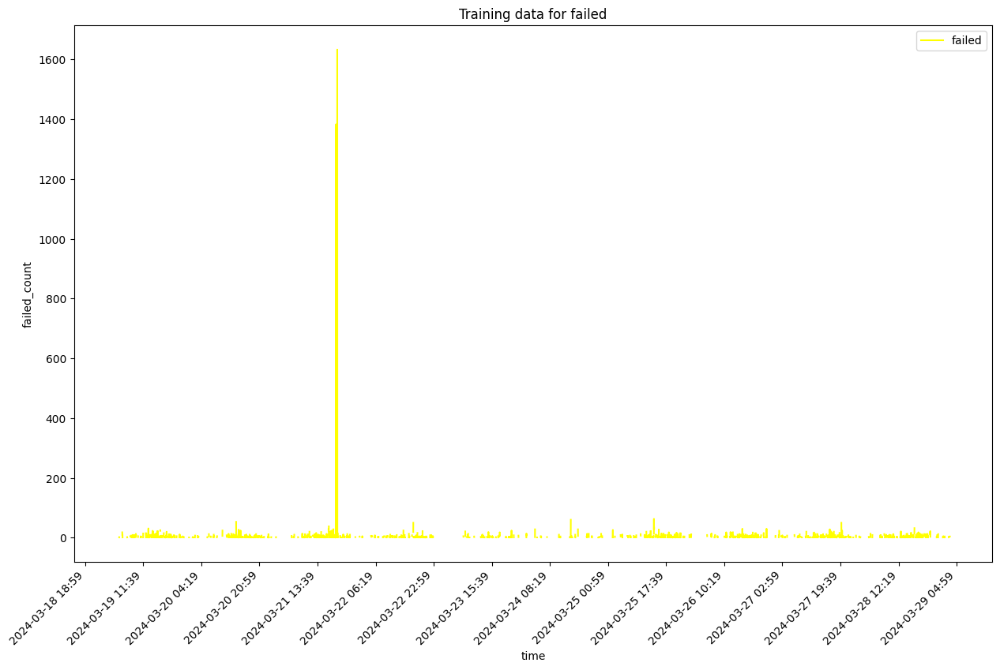

self.df_training shape  14400
Sum of histogram frequencies:  2891.0
Number of non-NaN records in column x:  2891


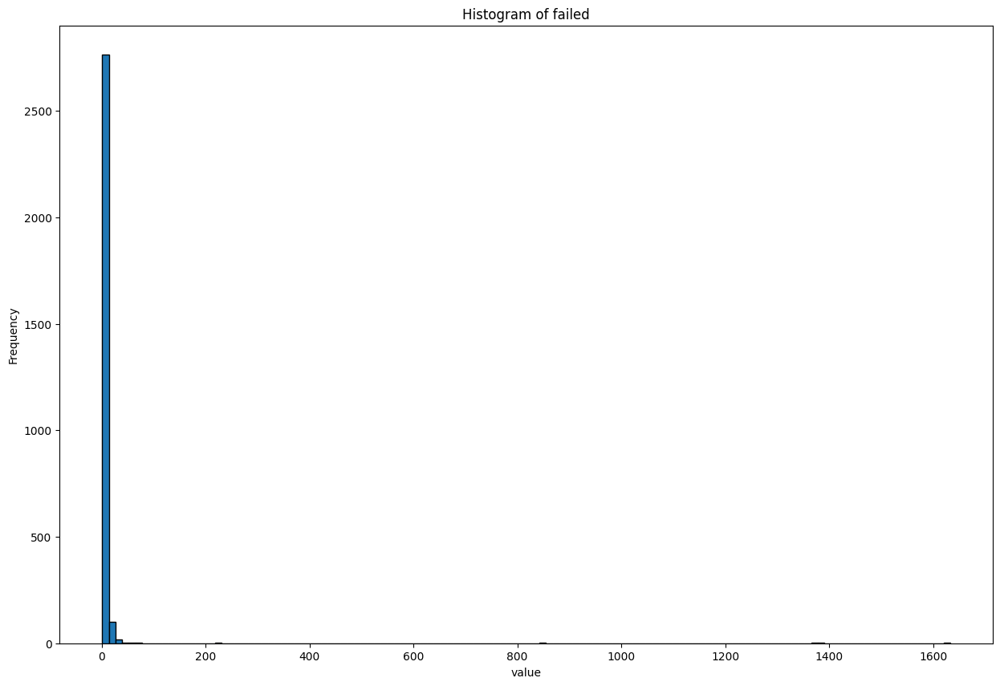

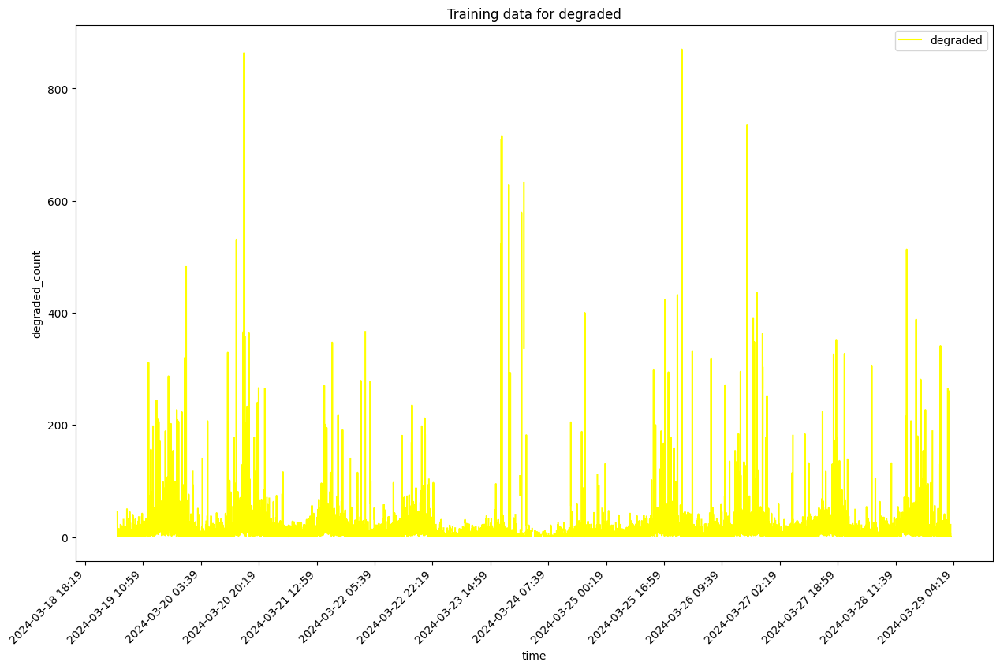

self.df_training shape  14400
Sum of histogram frequencies:  12345.0
Number of non-NaN records in column x:  12345


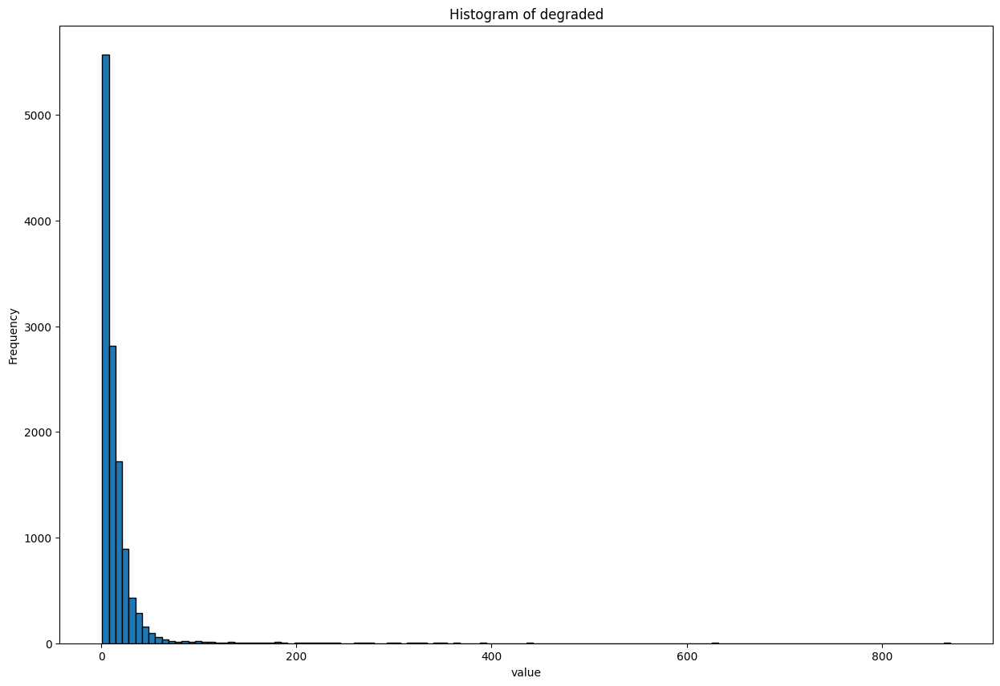

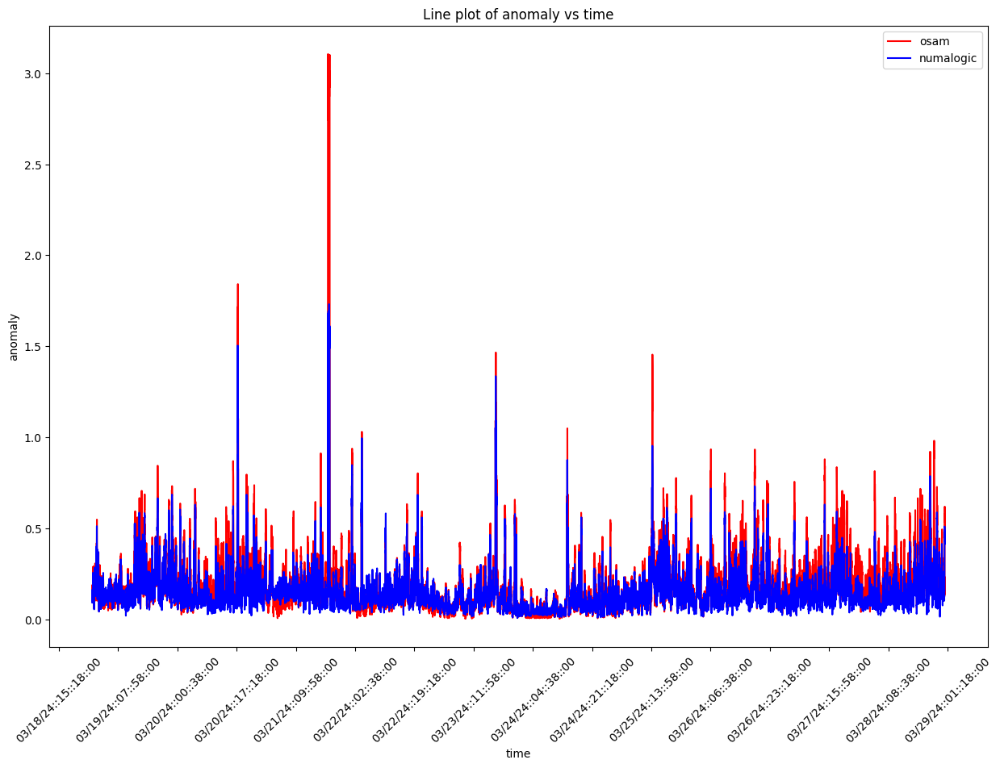

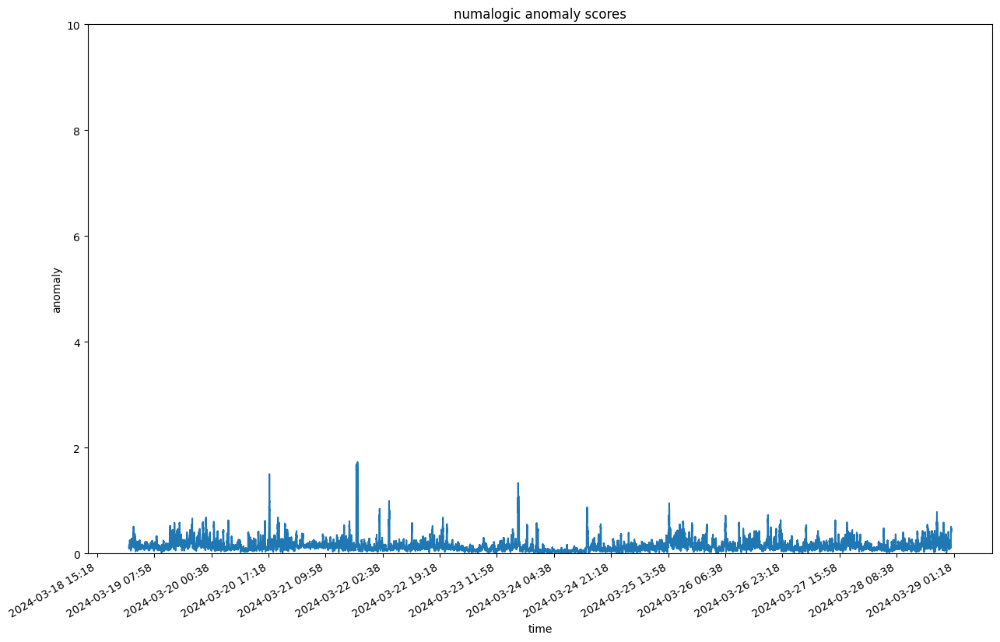

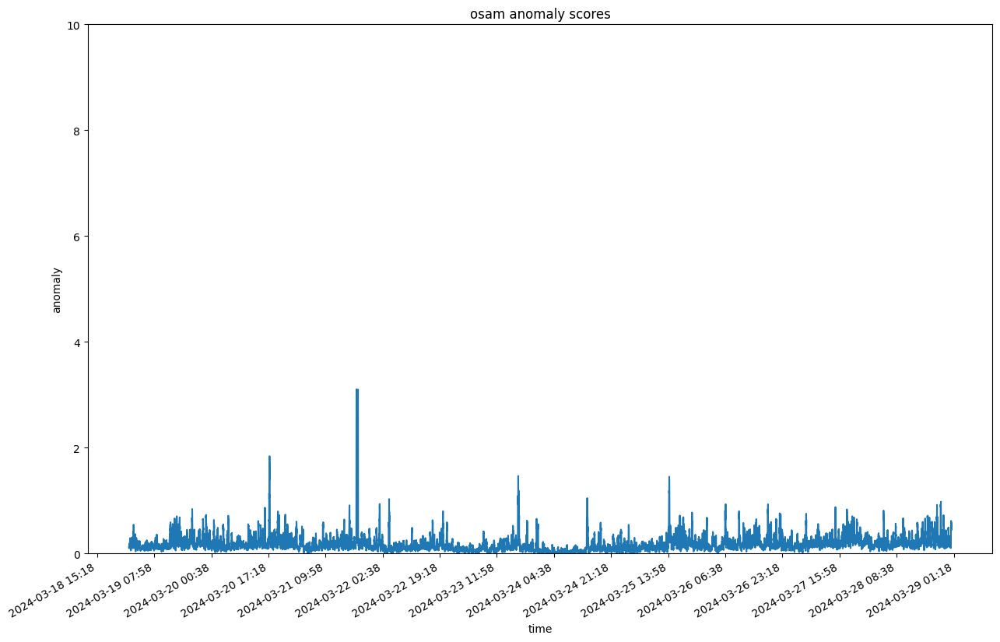

DEBUG:numalogic.connectors.druid._druid:Querying with end_dt: 2024-03-29 03:37:01.273026+00:00, that is with delay of 3 hrs


------------------------------------------------------------
------------------------------------------------------------        ModelId: fci:interactionsFailed:5984175597303660107:PAGE_LIVE_PREVIEW       ---------------------------------------------


DEBUG:numalogic.connectors.druid._druid:Druid params: {'datasource': 'tech-ip-customer-interaction-metrics', 'granularity': 'minute', 'intervals': ['2024-03-19T03:37:01.273026+00:00/2024-03-29T03:37:01.273026+00:00'], 'aggregations': {'count': {'type': 'doubleSum', 'fieldName': 'count', 'name': 'count'}}, 'post_aggregations': {}, 'filter': <pydruid.utils.filters.Filter object at 0x1472f0070>, 'dimensions': <map object at 0x1472f2a70>, 'context': {'timeout': 10000, 'configIds': ['assetId', 'interactionName'], 'source': 'numalogic'}}, fetch time: 1.0657s
DEBUG:numalogic.udfs.tools:Querying with end_dt: 2024-03-29 00:37:04.342524+00:00, that is with delay of 3 hrs
DEBUG:numalogic.udfs.tools:Querying with end_dt: 2024-03-29 00:37:04.342524+00:00, that is with delay of 3 hrs


--- 2.0047550201416016 seconds ---
--- 1.3224101066589355 seconds ---


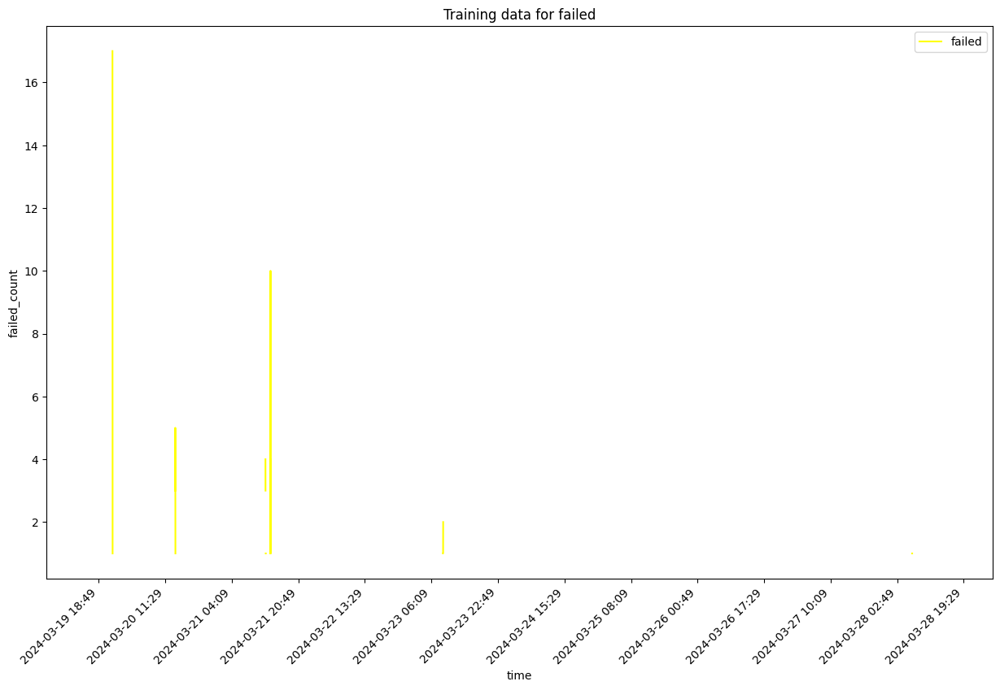

self.df_training shape  13785
Sum of histogram frequencies:  45.0
Number of non-NaN records in column x:  45


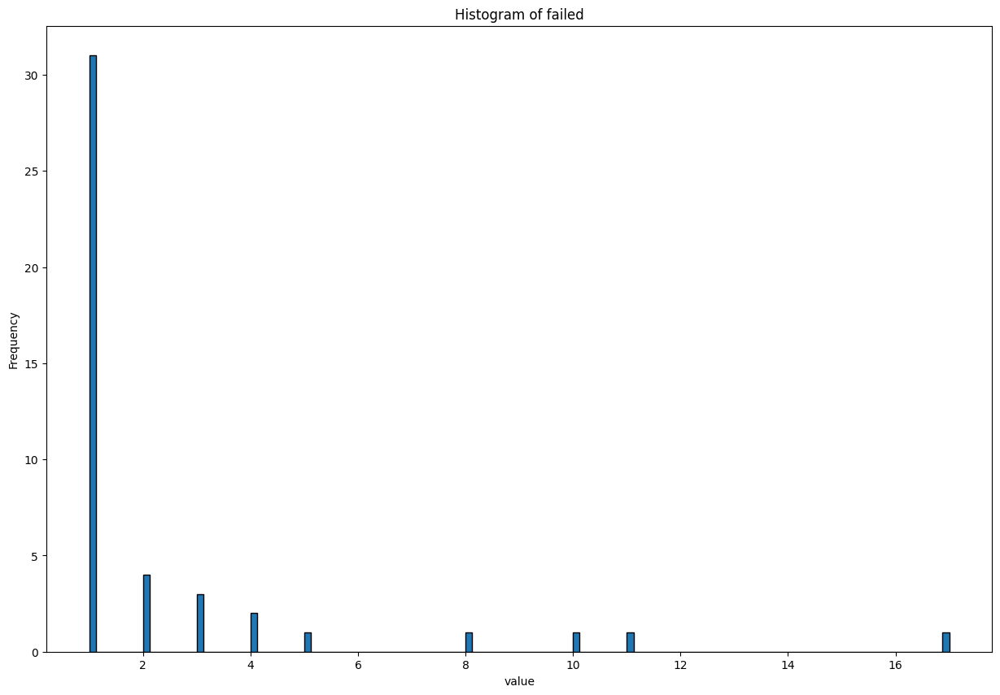

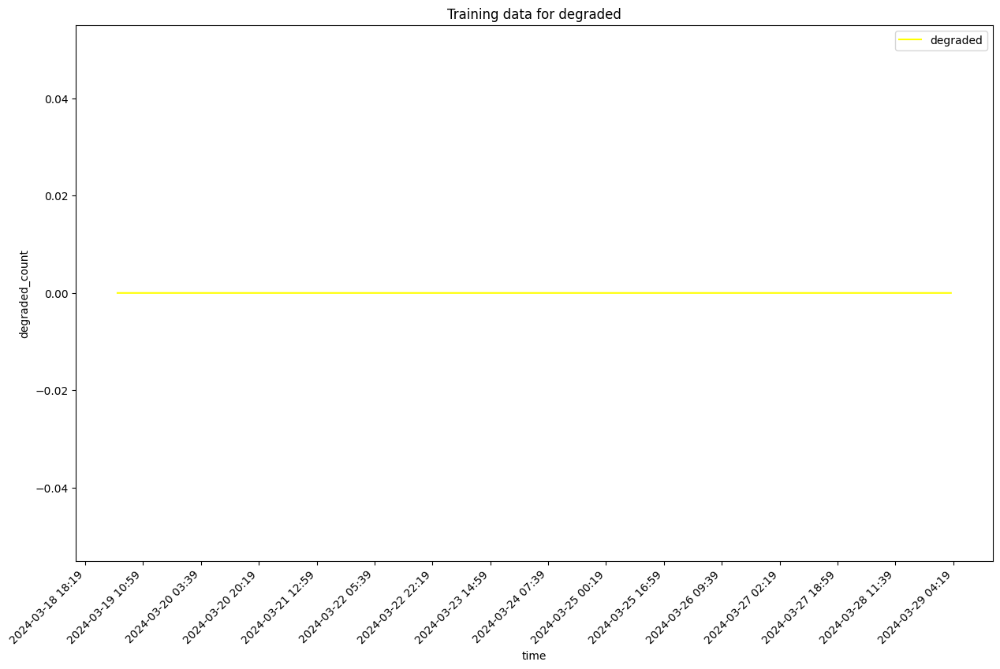

self.df_training shape  13785
Sum of histogram frequencies:  13785.0
Number of non-NaN records in column x:  13785


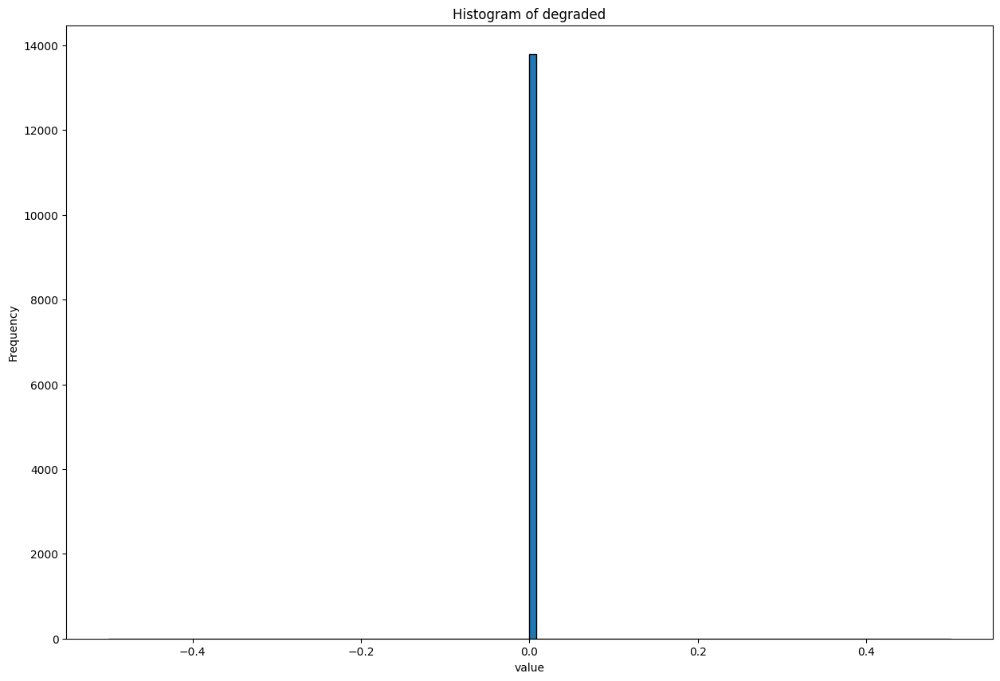

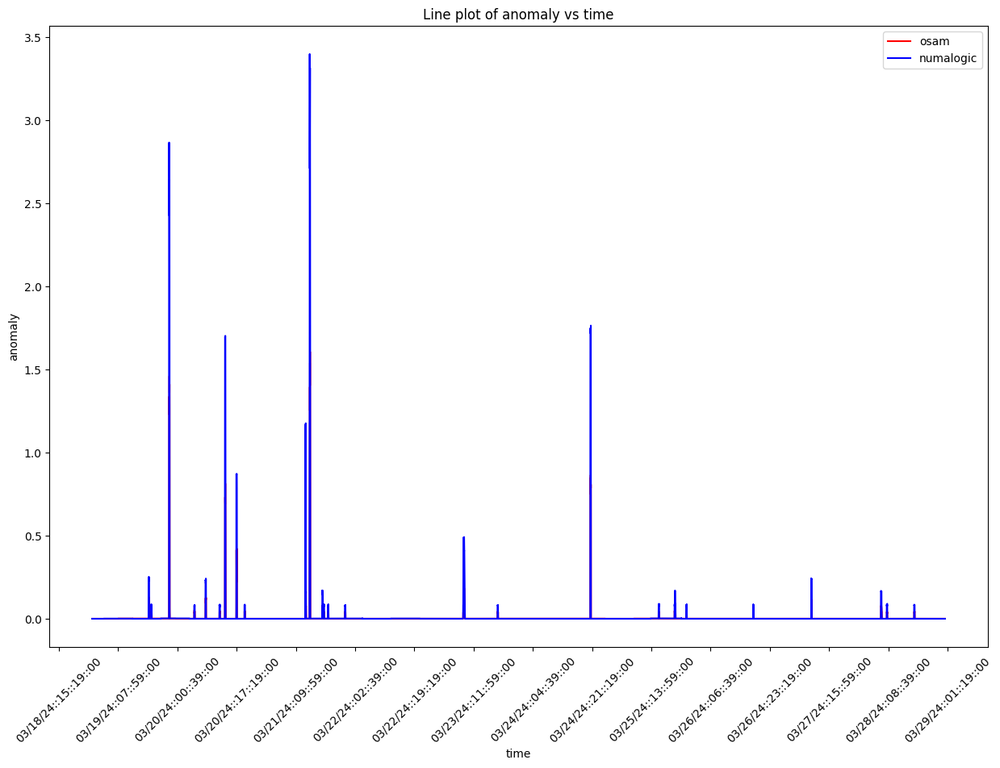

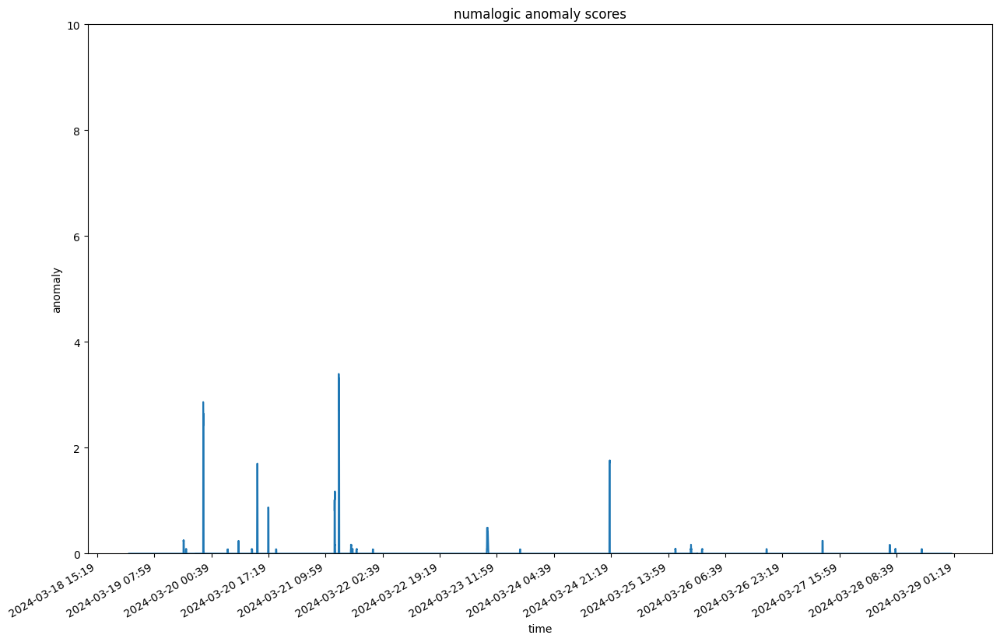

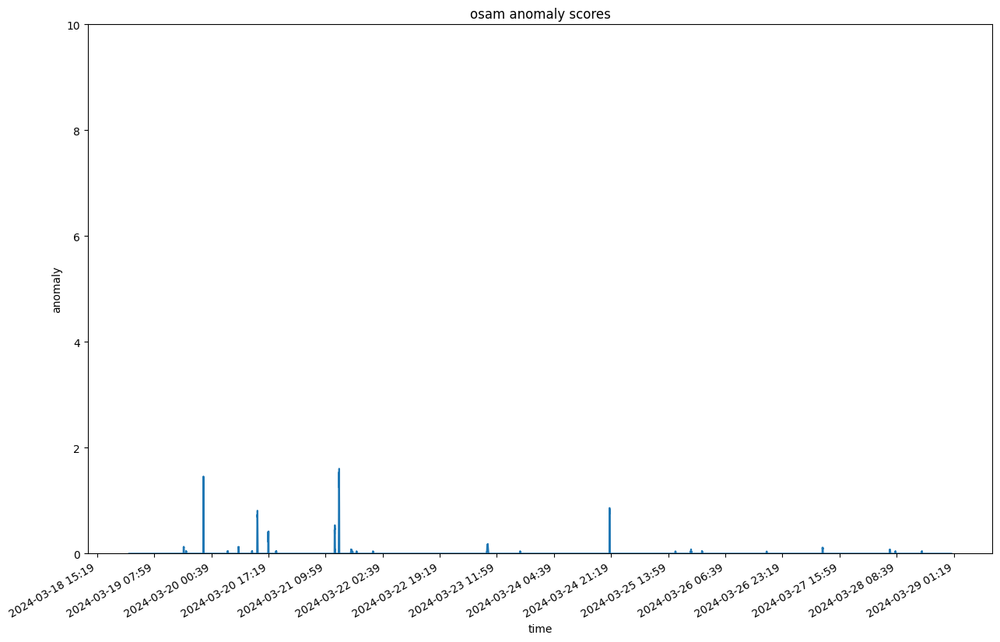

DEBUG:numalogic.connectors.druid._druid:Querying with end_dt: 2024-03-29 03:37:11.745593+00:00, that is with delay of 3 hrs


------------------------------------------------------------
------------------------------------------------------------        ModelId: fci:interactionsFailed:1156316797376513545:contact-profile:profile-modal:submit       ---------------------------------------------


DEBUG:numalogic.udfs.tools:Querying with end_dt: 2024-03-29 00:37:14.152476+00:00, that is with delay of 3 hrs
DEBUG:numalogic.udfs.tools:Querying with end_dt: 2024-03-29 00:37:14.152476+00:00, that is with delay of 3 hrs


KeyError: 'timestamp'

In [8]:
verify_obj_dict = {}
quality_analysis(summary, plot=True)
verify_obj_dict

In [ ]:
for k in anomaly_time_periods_numalogic:
    intervals = anomaly_time_periods_numalogic[k]
    if len(intervals)==1:
        continue
    else:
        print("----  Before Merging: ", anomaly_time_periods_numalogic[k])
        anomaly_time_periods_numalogic[k] = merge_intervals(intervals)
        print("----  After Merging: ", anomaly_time_periods_numalogic[k])

for k in anomaly_time_periods_osam:
    intervals = anomaly_time_periods_osam[k]
    if len(intervals)==1:
        continue
    else:
        print("----  Before Merging: ", anomaly_time_periods_osam[k])
        anomaly_time_periods_osam[k] = merge_intervals(intervals)
        print("----  After Merging: ", anomaly_time_periods_osam[k])

In [9]:
TP = FP = TN = FN = 0

for k1 in anomaly_time_periods_osam:
    if k1 not in anomaly_time_periods_numalogic:
        if ("authTypeSuccess" in k1) or ("metricsFailedAEV2" in k1) or ("fciPlugin:requests:" in k1) or ("fciAsset:asset:" in k1):
            continue
        intervals_numa = []
    else:
        intervals_numa = anomaly_time_periods_numalogic[k1]
    intervals_osam = anomaly_time_periods_osam[k1]

    for interval_1 in intervals_osam:
        flag = False
        for interval_2 in intervals_numa:
            if is_overlapping(interval_1, interval_2):
                flag = True
                break
        if flag:
            continue
            # TP += 1
        else:
            FN += 1
            print("k1 contributes to FN: ", k1)

for k1 in anomaly_time_periods_numalogic:
    if k1 not in anomaly_time_periods_osam:
        intervals_osam = []
    else:
        intervals_osam = anomaly_time_periods_osam[k1]

    intervals_numa = anomaly_time_periods_numalogic[k1]

    for interval_1 in intervals_numa:
        flag = False
        for interval_2 in intervals_osam:
            if is_overlapping(interval_1, interval_2):
                # print(interval_1, interval_2, k1)
                flag = True
                break
        if flag:
            TP += 1
            print("k1 contributes to TP: ", k1)
        else:
            FP += 1
            print("k1 contributes to FP: ", k1)

PRECISION = TP/(TP+FP)
RECALL = TP / (TP + FN)

print("PRECISION: ", PRECISION)
print("RECALL: ", RECALL)
print(TP, FP, FN, TN)

k1 contributes to FN:  fciPluginAppInteractions:metrics:2453353489468585843:5984175597303660107:paymentMethodMonolithOnSearch
k1 contributes to FN:  fciPluginAppInteractions:metrics:2453353489468585843:5984175597303660107:paymentMethodMonolithOnSearch
k1 contributes to FN:  fciPluginInteractions:metrics:2453353489468585843:productServiceOnSearch
k1 contributes to FN:  fciPlugin:requestsFailed:6560636350152934195:search-widget
k1 contributes to FN:  fci:interactionsFailed:2091939619214868921:ShellABTestDelegateInitialize
k1 contributes to FN:  fci:interactionsFailed:2091939619214868921:ShellABTestDelegateInitialize
k1 contributes to FN:  fci:interactionsFailed:2091939619214868921:ShellABTestDelegateInitialize
k1 contributes to FN:  fci:interactionsFailed:2091939619214868921:ShellABTestDelegateInitialize
k1 contributes to FN:  fci:interactionsFailed:2091939619214868921:ShellABTestDelegateInitialize
k1 contributes to FN:  fci:interactionsFailed:2091939619214868921:ShellABTestDelegateIniti

In [ ]:
len(summary['anomalies_list'])